### Check whether the pre-processed data has been de-meaned

In [4]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [5]:
data_dir = '/vols/Data/HCP/Phase2/group1200/node_timeseries/3T_HCP1200_MSMAll_d15_ts2/'
data = np.loadtxt(f"{data_dir}100206.txt")
print(data.shape)

(4800, 15)


In [14]:
print(np.std(data[:1200,5]))
print(np.std(data[1200:2400,5]))
print(np.std(data[2400:3600,5]))
print(np.std(data[3600:4800,5]))

73.97078169525533
71.50405805815484
59.740868684702896
60.80229374610422


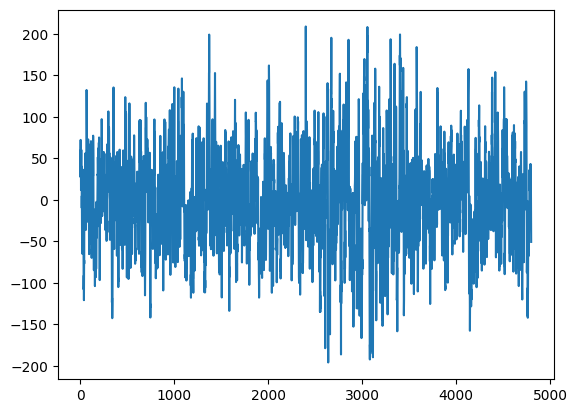

In [7]:
plt.plot(np.squeeze(data[:,0]))

So we need to z-score each session (1200 time points). Let's write a function for this!

In [72]:
def z_score(data:np.ndarray,n_session:int = 1):
    """
    z_score the input data.
    If n_session = 1, then z_score directly
    If n_session > 1, then divide the data into different sessions,
    z-score separately, and then concatenate back.
    
    Parameters:
    data (np.ndarray): (n_timepoints,n_channel)
    n_session (int): the number of sessions
    
    Returns
    np.ndarray: z-scored data
    """
    import scipy.stats as stats
    
    if n_session == 1:
        return stats.zscore(data,axis=0)
    else:
        if len(data) % n_session > 0:
            raise ValueError('Number of time points is not divisible by n_session!')
        n_timepoint, n_channel = data.shape
        
        #  Split to n sessions
        data = np.reshape(data,(n_session,-1,n_channel))
        
        # z-score
        data = stats.zscore(data,axis=1)
        
        # Concatenate and reshape
        return np.reshape(data,(n_timepoint,n_channel))
        
        

In [79]:
def test_z_score():
    import numpy as np
    import numpy.testing as npt
    
    # Example 1: one session
    x = np.array([[0.5,1.5,2.5],[-2.0,-1.0,0.0]]).T
    y = z_score(x)
    npt.assert_equal(y[:,0], y[:,1])
    
    # Example 2: two sessions
    np.random.seed(42)
    x1 = np.random.normal(loc=100.0,scale=100.0,size=(100,2))
    x2 = np.random.normal(loc=0.0,scale=2.0,size=(100,2))
    x = np.concatenate([x1,x2])
    y = z_score(x,n_session=2)
    
    # Check the data are z-scored
    npt.assert_almost_equal(np.mean(y[:100,:]),0.0,decimal=3)
    npt.assert_almost_equal(np.std(y[:100,:]),1.0,decimal=3)
    npt.assert_almost_equal(np.mean(y[100:,:]),0.0,decimal=3)
    npt.assert_almost_equal(np.std(y[100:,:]),1.0,decimal=3)
    

In [80]:
test_z_score()

### Write a function to load data

In [81]:
import pathlib
from osl_dynamics.data import Data
class PrepareData():
    def __init__(self,data_dir:pathlib.Path,n_session:int=4):
        self.data_dir = data_dir
        self.n_session = n_session
        
    def load(self,):
        '''
        Load data from specified directories
        Returns:
        tuple: A tuple containing the following
            - subjs (list): A list of read-in subjects
            - dataset (osl_dynamics.data.Data): the wrappeed dataset
        '''
        subjs = []
        data_list = []
        for file in self.data_dir.glob('*.txt'):
            subjs.append(file.stem)
            data_list.append(z_score(np.loadtxt(file),self.n_session))
        
        print('Read from directory: ',self.data_dir)
        print('Number of subjects: ',len(subjs))
        
        return subjs, Data(data_list)

/home/fs0/lmh182/.conda/envs/osld/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [83]:
import pathlib
data_dir = pathlib.Path('/vols/Data/HCP/Phase2/group1200/node_timeseries/3T_HCP1200_MSMAll_d15_ts2/')
prepare_data = PrepareData(data_dir)
subjs, dataset = prepare_data.load()

Read from directory:  /vols/Data/HCP/Phase2/group1200/node_timeseries/3T_HCP1200_MSMAll_d15_ts2
Number of subjects:  1003


Loading files: 100%|██████| 1003/1003 [00:13<00:00, 76.75it/s]


In [84]:
print(len(subjs))

1003


Attention: We need to sort the input files otherwise something would go wrong. Let's give it a try here!

In [90]:
data_dir = pathlib.Path('/vols/Data/HCP/Phase2/group1200/node_timeseries/3T_HCP1200_MSMAll_d15_ts2/')

In [91]:
print(data_dir.glob('*.txt'))

<generator object Path.glob at 0x7f3ce767b120>


In [93]:
for file in sorted(data_dir.glob('*.txt')):
    print(file)

/vols/Data/HCP/Phase2/group1200/node_timeseries/3T_HCP1200_MSMAll_d15_ts2/100206.txt
/vols/Data/HCP/Phase2/group1200/node_timeseries/3T_HCP1200_MSMAll_d15_ts2/100307.txt
/vols/Data/HCP/Phase2/group1200/node_timeseries/3T_HCP1200_MSMAll_d15_ts2/100408.txt
/vols/Data/HCP/Phase2/group1200/node_timeseries/3T_HCP1200_MSMAll_d15_ts2/100610.txt
/vols/Data/HCP/Phase2/group1200/node_timeseries/3T_HCP1200_MSMAll_d15_ts2/101006.txt
/vols/Data/HCP/Phase2/group1200/node_timeseries/3T_HCP1200_MSMAll_d15_ts2/101107.txt
/vols/Data/HCP/Phase2/group1200/node_timeseries/3T_HCP1200_MSMAll_d15_ts2/101309.txt
/vols/Data/HCP/Phase2/group1200/node_timeseries/3T_HCP1200_MSMAll_d15_ts2/101915.txt
/vols/Data/HCP/Phase2/group1200/node_timeseries/3T_HCP1200_MSMAll_d15_ts2/102008.txt
/vols/Data/HCP/Phase2/group1200/node_timeseries/3T_HCP1200_MSMAll_d15_ts2/102109.txt
/vols/Data/HCP/Phase2/group1200/node_timeseries/3T_HCP1200_MSMAll_d15_ts2/102311.txt
/vols/Data/HCP/Phase2/group1200/node_timeseries/3T_HCP1200_MSMAll

In [94]:
1118 / 4

279.5

In [99]:
x = np.reshape(np.arange(24),(6,4))
print(x)
print('####################')
y = np.split(x,3)
print(y)

[[ 0  1  2  3]
 [ 4  5  6  7]
 [ 8  9 10 11]
 [12 13 14 15]
 [16 17 18 19]
 [20 21 22 23]]
####################
[array([[0, 1, 2, 3],
       [4, 5, 6, 7]]), array([[ 8,  9, 10, 11],
       [12, 13, 14, 15]]), array([[16, 17, 18, 19],
       [20, 21, 22, 23]])]


In [3]:
stats.zscore(np.array([-1,1]))

NameError: name 'stats' is not defined

In [10]:
import numpy as np
import numpy.testing as npt

def test_prepare_data():
    import shutil, os
    import pathlib
    from rotation.preprocessing import PrepareData
    temp_dir = './test_temp/'
    # Create the directory if not exists
    if not os.path.exists(temp_dir):
        print(f'Create the temporary directory {temp_dir}')
        os.makedirs(temp_dir)
    
    # Create a subject
    subj_name = '10001'
    data = np.array([[-1,1,-1,1],[1,-1,1,-1]]).T
    np.savetxt(f'{temp_dir}{subj_name}.txt', data)
    
    # Use the PrepareData class
    prepare_data = PrepareData(pathlib.Path(temp_dir),2)
    subj,result = prepare_data.load()
    npt.assert_equal(subj[0],'10001')
    npt.assert_equal(result[0],np.array([[-1,1],[1,-1]]))
    npt.assert_equal(result[1],np.array([[-1,1],[1,-1]]))
    
    # Delete the directory
    if os.path.exists(temp_dir):
        shutil.rmtree(temp_dir)
        print(f'Delete temporary directory {temp_dir}')

In [11]:
test_prepare_data()

Create the temporary directory ./test_temp/
Read from directory:  test_temp
Number of subjects:  1
Delete temporary directory ./test_temp/


In [14]:
4800 * 300 * 1003

1444320000

In [15]:
4000 * 300 * 300 * 1200

432000000000

### training on HMM

In [ ]:
def HMM_training(dataset,n_states,n_channels,save_dir):
    from osl_dynamics.models.hmm import Config, Model
    # Create a config object
    config = Config(
        n_states=n_states,
        n_channels=n_channels,
        sequence_length=600,
        learn_means=True,
        learn_covariances=True,
        batch_size=32,
        learning_rate=1e-3,
        n_epochs=40,
    )
    
    # Initiate a Model class and print a summary
    model = Model(config)
    model.summary()
    
    # Initialization
    init_history = model.random_state_time_course_initialization(training_data, n_epochs=1, n_init=3)
    
    # Full training
    history = model.fit(training_data)
    model.save(save_dir)

## Post-training analysis

### Question: What does the model look like?

In [5]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import seaborn
%matplotlib inline

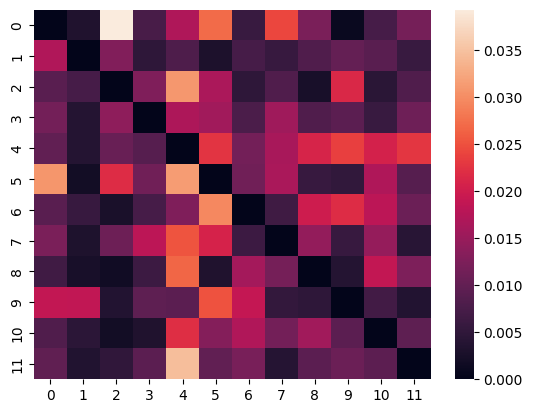

In [21]:
result_dir = './results/'
result_1_dir = f'{result_dir}HMM_ICA_15_state_12/'
trans_prob = np.load(f'{result_1_dir}trans_prob.npy')
np.fill_diagonal(trans_prob,0)
seaborn.heatmap(trans_prob)
plt.show()

In [22]:
import yaml
with open(f'{result_1_dir}config.yml','r') as file:
    config = yaml.safe_load(file)
    
print(config)

{'batch_size': 32, 'covariances_epsilon': 1e-06, 'covariances_regularizer': None, 'diagonal_covariances': False, 'gradient_clip': None, 'initial_covariances': None, 'initial_means': None, 'initial_trans_prob': None, 'learn_covariances': True, 'learn_means': True, 'learn_trans_prob': True, 'learning_rate': 0.001, 'means_regularizer': None, 'model_name': 'HMM', 'multi_gpu': False, 'multiple_dynamics': False, 'n_channels': 15, 'n_epochs': 40, 'n_modes': None, 'n_states': 12, 'observation_update_decay': 0.1, 'optimizer': 'adam', 'sequence_length': 600, 'state_probs_t0': None, 'strategy': None, 'trans_prob_update_delay': 5, 'trans_prob_update_forget': 0.7}


### Question: how to load the model and infer the hidden states?

In [23]:
from osl_dynamics.models import load

model = load(result_1_dir)

2023-07-10 14:49:54 INFO osl-dynamics [mod_base.py:485:load]: Loading model: ./results/HMM_ICA_15_state_12/


In [24]:
import pathlib
from rotation.preprocessing import PrepareData
n_channels = 15
data_dir = pathlib.Path(f'/vols/Data/HCP/Phase2/group1200/node_timeseries/3T_HCP1200_MSMAll_d{n_channels}_ts2/')
prepare_data = PrepareData(data_dir)
subj,dataset = prepare_data.load()
    
alpha = model.get_alpha(dataset)

Read from directory:  /vols/Data/HCP/Phase2/group1200/node_timeseries/3T_HCP1200_MSMAll_d15_ts2
Number of subjects:  1003


Loading files: 100%|█████| 4012/4012 [00:29<00:00, 136.52it/s]
2023-07-10 14:50:57 INFO osl-dynamics [hmm.py:1093:get_alpha]: Getting alpha
2023-07-10 14:50:57.301349: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:51:03 INFO numba.core.transforms [transforms.py:58:_extract_loop_lifting_candidates]: finding looplift candidates
2023-07-10 14:51:05.718853: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:51:05.971241: I tensorflow

2023-07-10 14:51:16.227648: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:51:16.857340: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:51:17.421342: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:51:28.035225: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:51:28.372031: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:51:28.610290: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:51:39.814941: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:51:40.366794: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:51:41.028605: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:51:52.982565: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:51:53.365637: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:51:53.864192: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:52:05.623308: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:52:06.129105: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:52:06.540725: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:52:16.955174: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:52:17.629527: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:52:18.191423: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:52:27.870218: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:52:28.284571: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:52:28.622601: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:52:36.543952: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:52:37.114423: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:52:37.627824: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:52:45.414560: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:52:45.655916: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:52:45.895600: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:52:53.659843: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:52:54.238366: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:52:54.911754: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:53:04.422015: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:53:04.659115: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:53:04.894723: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:53:14.128828: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:53:14.728812: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:53:15.335146: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:53:22.737688: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:53:22.987227: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:53:23.309887: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:53:30.619117: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:53:30.882907: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:53:31.148365: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:53:39.063680: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:53:39.509478: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:53:39.880748: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:53:50.073229: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:53:50.697802: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:53:51.360161: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:54:02.121476: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:54:02.429683: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:54:02.728643: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:54:13.173047: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:54:13.702200: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:54:13.952903: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:54:22.843552: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:54:23.502980: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:54:24.130020: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:54:35.192506: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:54:35.445920: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:54:35.707039: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:54:46.330705: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:54:47.018921: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:54:47.610421: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:54:57.435497: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:54:57.685069: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:54:57.926999: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:55:07.953815: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:55:08.210921: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:55:08.841260: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:55:18.909897: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:55:19.220937: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:55:19.478259: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:55:31.232387: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:55:31.477754: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:55:32.058577: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:55:40.329653: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:55:40.585091: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:55:41.094621: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:55:49.197203: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:55:49.455436: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:55:49.721055: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:56:01.472225: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:56:01.870994: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:56:02.632931: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:56:11.618003: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:56:12.100868: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:56:12.535209: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:56:23.958863: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:56:24.357158: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:56:24.708329: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:56:33.528099: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:56:34.216005: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:56:34.882885: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:56:45.905320: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:56:46.476400: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:56:47.133962: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:56:57.231367: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:56:57.870271: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:56:58.352148: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:57:09.162260: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:57:09.592389: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:57:09.959155: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:57:18.362865: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:57:19.034060: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:57:19.603894: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:57:29.208222: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:57:29.796459: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:57:30.272675: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:57:40.123238: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:57:40.576599: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:57:40.958105: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:57:50.365974: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:57:51.005923: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:57:51.569306: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:58:00.996527: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:58:01.424300: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:58:02.115866: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:58:09.366426: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:58:09.620271: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:58:10.193879: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:58:16.228036: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:58:16.469089: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:58:16.709533: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:58:25.088989: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:58:25.594226: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:58:26.007576: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:58:35.963652: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:58:36.343538: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:58:36.676928: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:58:44.721583: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:58:45.022620: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:58:45.299158: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:58:52.165535: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:58:52.418520: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:58:52.661227: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:59:02.640380: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:59:03.199823: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:59:03.439790: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:59:10.558340: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:59:11.003149: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:59:11.381182: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:59:19.219041: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:59:19.839524: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:59:20.329550: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:59:29.477262: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:59:29.939076: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:59:30.321974: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:59:36.223833: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:59:36.859683: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:59:37.425096: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:59:47.650796: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:59:47.908042: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:59:48.149407: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 14:59:56.011716: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:59:56.672016: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:59:57.196891: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:00:03.729750: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:00:03.972191: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:00:04.239918: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:00:14.135438: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:00:14.713188: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:00:14.971259: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:00:22.408532: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:00:22.648391: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:00:23.219484: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:00:32.177278: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:00:32.418977: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:00:32.662840: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:00:44.605389: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:00:45.262178: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:00:45.801596: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:00:56.183445: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:00:56.435956: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:00:56.684767: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:01:08.005268: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:01:08.357219: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:01:09.043570: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:01:20.735159: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:01:20.982843: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:01:21.232959: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:01:30.020542: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:01:30.421027: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:01:31.095214: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:01:40.642190: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:01:41.226036: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:01:41.471694: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:01:50.445971: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:01:50.740616: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:01:50.994344: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:01:59.224348: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:01:59.472542: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:01:59.719825: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:02:10.369353: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:02:11.033152: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:02:11.696241: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:02:18.930768: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:02:19.178071: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:02:19.423079: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:02:27.165234: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:02:27.733184: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:02:27.981381: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:02:36.719682: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:02:36.978493: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:02:37.230622: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:02:47.651505: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:02:48.097776: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:02:48.512431: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:02:57.890490: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:02:58.378402: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:02:59.032197: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:03:07.642078: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:03:07.890586: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:03:08.135112: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:03:19.198941: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:03:19.454770: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:03:20.149610: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:03:29.457198: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:03:29.738497: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:03:30.431297: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:03:39.451684: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:03:39.718065: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:03:40.399374: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:03:50.519799: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:03:50.889213: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:03:51.214905: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:03:59.964132: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:04:00.210022: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:04:00.461947: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:04:10.449597: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:04:10.696370: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:04:11.252190: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:04:20.449169: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:04:20.693073: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:04:20.935353: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:04:30.415988: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:04:30.783677: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:04:31.029002: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:04:38.834696: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:04:39.090181: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:04:39.333001: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:04:48.532462: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:04:48.991371: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:04:49.382095: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:04:58.682554: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:04:59.243775: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:04:59.490190: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:05:08.349296: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:05:08.964917: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:05:09.584546: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:05:17.870459: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:05:18.561432: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:05:19.234729: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:05:27.464789: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:05:27.710283: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:05:27.955686: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:05:36.059934: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:05:36.433298: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:05:36.853932: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:05:48.315233: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:05:48.576861: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:05:48.832852: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:05:56.480904: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:05:56.724077: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:05:56.967805: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:06:05.703808: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:06:05.943687: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:06:06.187642: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:06:15.582939: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:06:16.205122: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:06:16.446138: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:06:24.884520: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:06:25.274817: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:06:25.887774: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:06:34.086398: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:06:34.332026: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:06:34.575091: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:06:42.544314: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:06:43.203974: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:06:43.456450: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:06:51.485773: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:06:51.751699: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:06:51.992600: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:07:03.738690: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:07:04.083595: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:07:04.655524: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:07:13.704355: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:07:13.952188: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:07:14.200104: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:07:23.935991: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:07:24.627332: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:07:25.232828: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:07:35.495509: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:07:36.181649: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:07:36.433976: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:07:45.681489: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:07:46.133655: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:07:46.712674: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:07:53.902335: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:07:54.153501: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:07:54.397037: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:08:02.628992: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:08:02.874417: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:08:03.114121: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:08:10.481392: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:08:10.717654: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:08:10.961311: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:08:19.682395: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:08:20.248880: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:08:20.492248: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:08:28.794657: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:08:29.062780: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:08:29.317046: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:08:37.444309: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:08:38.053805: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:08:38.703626: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:08:49.023136: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:08:49.571783: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:08:50.145338: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:08:59.725285: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:09:00.366138: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:09:01.047873: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:09:09.611015: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:09:10.155384: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:09:10.581180: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:09:20.347532: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:09:20.610653: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:09:20.856165: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:09:29.969161: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:09:30.213889: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:09:30.456012: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:09:40.973989: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:09:41.338347: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:09:41.583174: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:09:50.263994: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:09:50.500493: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:09:50.744599: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:09:59.667911: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:10:00.205209: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:10:00.455867: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:10:09.595611: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:10:09.980348: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:10:10.458263: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:10:18.624367: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:10:19.063036: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:10:19.528282: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:10:26.148091: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:10:26.805954: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:10:27.407330: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:10:34.164482: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:10:34.417653: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:10:34.662006: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:10:42.570757: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:10:43.212960: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:10:43.458788: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:10:49.246555: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:10:49.506362: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:10:49.757207: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:10:58.886221: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:10:59.523612: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:10:59.862971: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:11:07.426467: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:11:08.102523: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:11:08.732284: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:11:17.737702: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:11:17.988266: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:11:18.239306: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:11:25.152203: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:11:25.394283: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:11:25.634498: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:11:34.139439: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:11:34.422518: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:11:34.671649: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:11:42.692829: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:11:42.951731: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:11:43.198993: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:11:52.062718: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:11:52.374167: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:11:52.657442: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:12:00.716899: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:12:00.960611: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:12:01.202883: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:12:09.259908: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:12:09.500363: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:12:09.828031: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:12:19.438809: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:12:19.704343: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:12:20.276242: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:12:26.699241: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:12:26.951905: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:12:27.648071: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:12:37.731887: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:12:37.984518: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:12:38.277092: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:12:48.212677: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:12:48.906218: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:12:49.592504: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:12:58.927515: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:12:59.436398: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:13:00.028178: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:13:11.161343: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:13:11.441978: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:13:11.737252: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:13:20.616672: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:13:21.160534: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:13:21.721540: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:13:30.535428: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:13:30.995744: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:13:31.372437: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:13:40.207637: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:13:40.457671: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:13:40.704122: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:13:48.457189: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:13:48.705261: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:13:48.948216: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:13:57.750721: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:13:58.377776: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:13:58.870801: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:14:07.213369: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:14:07.463868: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:14:07.717513: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:14:16.980954: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:14:17.586784: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:14:18.219947: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:14:25.942300: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:14:26.187549: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:14:26.430539: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:14:34.103461: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:14:34.727212: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:14:34.967345: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:14:46.075381: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:14:46.718572: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:14:46.966629: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:14:57.356947: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:14:57.854644: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:14:58.264150: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:15:05.965512: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:15:06.294818: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:15:06.577819: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:15:17.214728: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:15:17.861222: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:15:18.491336: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:15:27.229111: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:15:27.864793: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:15:28.298241: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:15:38.847947: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:15:39.427412: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:15:40.056939: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:15:46.702683: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:15:46.941621: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:15:47.186901: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:15:57.128903: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:15:57.672191: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:15:58.088442: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:16:09.021593: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:16:09.431166: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:16:10.087511: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:16:17.192837: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:16:17.720609: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:16:17.962321: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:16:27.407406: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:16:28.008666: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:16:28.585126: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:16:37.253200: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:16:37.516146: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:16:37.905446: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:16:46.854933: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:16:47.243147: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:16:47.554808: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:16:56.277931: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:16:56.670153: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:16:57.255382: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:17:06.610389: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:17:07.059521: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:17:07.644783: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:17:16.665390: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:17:17.088333: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:17:17.442406: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:17:26.226873: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:17:26.468889: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:17:26.737041: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:17:36.760850: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:17:37.014957: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:17:37.684082: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:17:47.637713: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:17:48.207087: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:17:48.753875: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:18:01.607604: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:18:02.239867: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:18:02.495684: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:18:13.310917: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:18:13.798786: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:18:14.202952: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:18:23.728489: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:18:24.058890: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:18:24.717492: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:18:32.674840: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:18:33.298403: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:18:33.935601: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

2023-07-10 15:18:44.460900: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:18:45.079574: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1200,15]
	 [[{{node Placeholder/_0}}]]
2023-07-10 15:18:45.758030: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [1

In [25]:
type(alpha)

list

In [26]:
type(alpha[0])

numpy.ndarray

In [27]:
alpha[0].shape

(1200, 12)

In [28]:
len(alpha)

4012

In [29]:
import pickle
pickle.dump(alpha, open(f'{result_1_dir}alpha.pkl', "wb"))

In [30]:
alpha[0]

array([[2.9256483e-04, 2.1780960e-03, 6.2531843e-03, ..., 2.4948446e-03,
        7.9063408e-04, 3.1569682e-04],
       [1.4581109e-05, 8.3765259e-04, 5.9707104e-03, ..., 1.4968008e-03,
        1.6649136e-03, 1.2321266e-05],
       [1.1396520e-05, 6.6842531e-06, 7.3152315e-04, ..., 8.4383806e-05,
        7.1660667e-03, 5.6155511e-07],
       ...,
       [7.1074951e-01, 4.1825572e-08, 3.1663360e-05, ..., 4.8747900e-04,
        1.8685320e-09, 5.9881685e-08],
       [8.2679802e-01, 7.4637230e-09, 2.7055499e-05, ..., 8.5863030e-07,
        2.5648489e-10, 2.9916586e-10],
       [9.1423517e-01, 7.6308275e-08, 4.1581033e-04, ..., 2.3310297e-06,
        1.9075143e-08, 2.3776222e-07]], dtype=float32)

In [35]:
alpha[0][300,:]

array([2.2677984e-10, 1.9777464e-07, 3.3698305e-07, 1.0830148e-06,
       9.6019214e-08, 5.5629685e-06, 9.5552868e-01, 1.8513897e-06,
       2.0398751e-08, 4.4461805e-02, 1.4254192e-08, 3.5274979e-07],
      dtype=float32)

### Understanding summary statistics

In [36]:
print(type(alpha))

<class 'list'>


(<Figure size 1200x250 with 2 Axes>, [<Axes: xlabel='Sample'>])

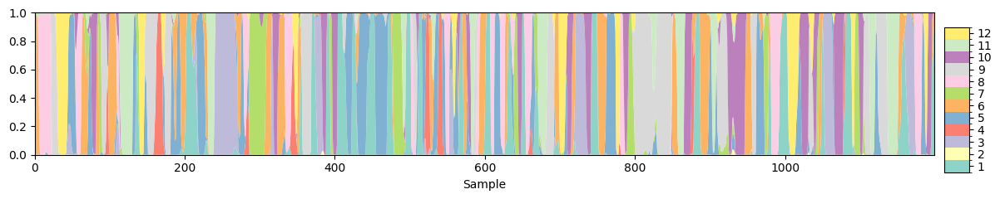

In [37]:
from osl_dynamics.utils import plotting

# Plot the state probability time course for the first subject
plotting.plot_alpha(alpha[0],n_samples=1200)

(<Figure size 1200x250 with 2 Axes>, [<Axes: xlabel='Sample'>])

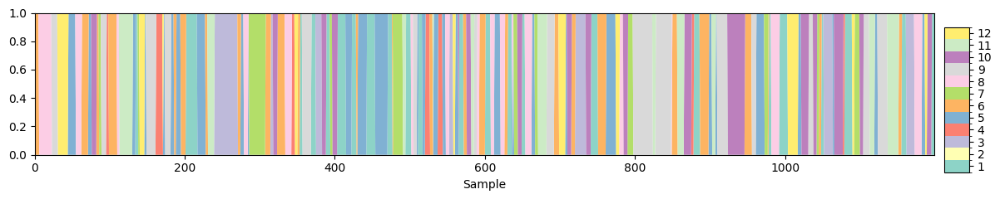

In [38]:
from osl_dynamics.inference import modes

# Hard classify the state probabilities
stc = modes.argmax_time_courses(alpha)
plotting.plot_alpha(stc[0],n_samples=1200)

### Fractional occupancy

In [39]:
# Calculate fractional occupancies
fo = modes.fractional_occupancies(stc)
print(fo.shape)

(4012, 12)


In [40]:
import numpy as np
print(np.mean(fo,axis=0))

[0.07360523 0.06035041 0.08186378 0.06777231 0.11493582 0.09527522
 0.07094965 0.07823488 0.09277812 0.0869288  0.09690512 0.08040067]


(<Figure size 700x400 with 1 Axes>, <Axes: xlabel='State', ylabel='FO'>)

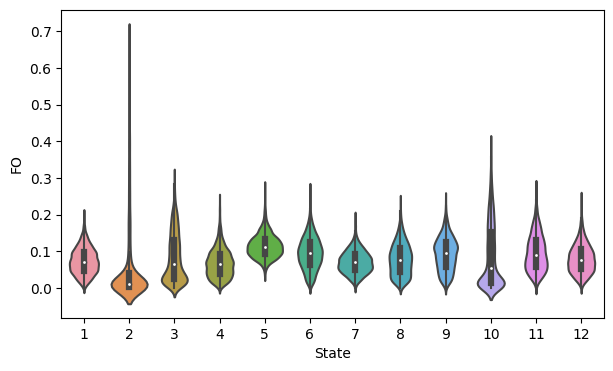

In [41]:
# Plot the distribution of fractional occupancy (FO) across subjects
plotting.plot_violin(fo.T, x_label="State", y_label="FO")

### Mean Lifetime

[4.67132269 4.79102603 5.32466506 6.06323505 4.45195085 4.54564241
 5.22813657 5.37935488 6.70049335 4.94312067 6.28557787 6.32329685]


(<Figure size 700x400 with 1 Axes>,
 <Axes: xlabel='State', ylabel='Mean Lifetime (s)'>)

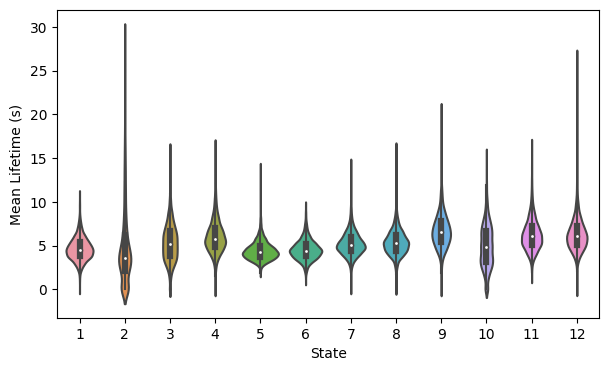

In [42]:
# Calculate mean lifetimes (in seconds)
mlt = modes.mean_lifetimes(stc, sampling_frequency=1/0.72)

# Convert to ms
#mlt *= 1000

# Print the group average
print(np.mean(mlt, axis=0))

# Plot distribution across subjects
plotting.plot_violin(mlt.T, x_label="State", y_label="Mean Lifetime (s)")

### Mean Interval


[65.76852283 95.07600701 92.34632847 98.83552669 35.05508174 52.21079136
 73.15320108 80.92260451 77.35193795 89.73243718 69.88843844 81.15131273]


(<Figure size 700x400 with 1 Axes>,
 <Axes: xlabel='State', ylabel='Mean Interval (s)'>)

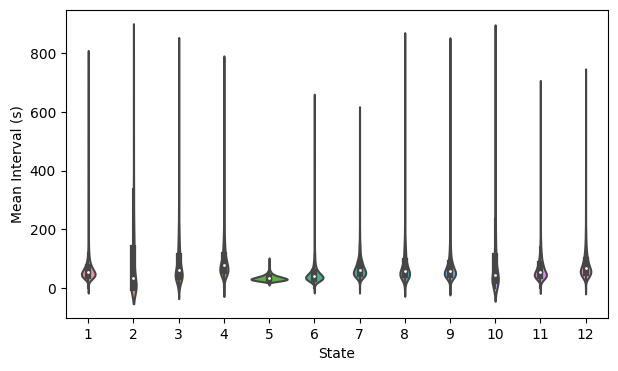

In [43]:
# Calculate mean intervals (in seconds)
mintv = modes.mean_intervals(stc, sampling_frequency=1/0.72)

# Print the group average
print(np.mean(mintv, axis=0))

# Plot distribution across subjects
plotting.plot_violin(mintv.T, x_label="State", y_label="Mean Interval (s)")

In [44]:
50 * 50 *126 * 405

127575000

In [45]:
4012 * 300 * 300 * 1116

402965280000

In [46]:
50 * 49 / 2

1225.0

The partition is:  {0: 0, 1: 0, 2: 0, 3: 0, 4: 2, 5: 2, 6: 2, 7: 0, 8: 1, 9: 1, 10: 2, 11: 0, 12: 0, 13: 0, 14: 1, 15: 1, 16: 2, 17: 0, 18: 1, 19: 0, 20: 1, 21: 0, 22: 1, 23: 3, 24: 3, 25: 3, 26: 1, 27: 3, 28: 3, 29: 1, 30: 1, 31: 3, 32: 1, 33: 1}


/tmp/slurm-22854570/ipykernel_336595/3638768981.py:17: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap('viridis', max(partition.values()) + 1)


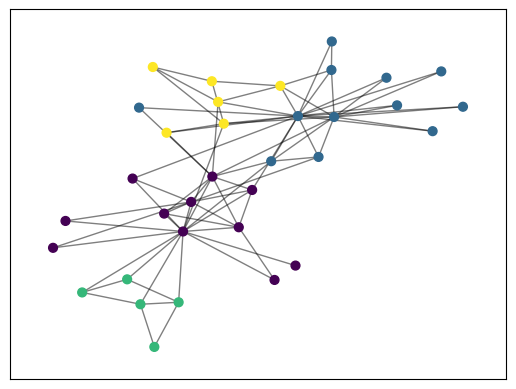

In [1]:
from community import community_louvain
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import networkx as nx
%matplotlib inline

# load the karate club graph
G = nx.karate_club_graph()

# compute the best partition
partition = community_louvain.best_partition(G)

print('The partition is: ',partition)
# draw the graph
pos = nx.spring_layout(G)
# color the nodes according to their partition
cmap = cm.get_cmap('viridis', max(partition.values()) + 1)
nx.draw_networkx_nodes(G, pos, partition.keys(), node_size=40,
                       cmap=cmap, node_color=list(partition.values()))
nx.draw_networkx_edges(G, pos, alpha=0.5)
plt.show()

In [2]:
import numpy as np
data_dir = './results/HMM_ICA_100_state_12/'
tpm = np.load(f'{data_dir}trans_prob.npy')
print(tpm)

[[8.49689927e-01 2.15284653e-02 1.19195069e-02 1.54485338e-05
  2.77014542e-12 1.37034552e-02 2.02857930e-02 2.61173983e-02
  1.73635491e-02 6.59600873e-03 1.27933011e-02 1.99871467e-02]
 [4.79083359e-02 8.55376697e-01 1.15627801e-02 5.28669526e-04
  6.66584300e-03 4.93814862e-03 2.43874492e-02 9.30345589e-03
  1.21323045e-02 6.77407477e-03 8.57175995e-03 1.18504817e-02]
 [1.41233283e-02 1.05032523e-02 8.93749375e-01 2.29123417e-04
  1.10931641e-03 1.79559309e-02 1.45212626e-02 3.50934095e-03
  2.47075221e-02 5.19086912e-05 4.80684142e-03 1.47327976e-02]
 [1.57715744e-04 1.53065570e-03 2.94738585e-04 9.41656736e-01
  3.34574605e-02 1.69650598e-03 4.35216258e-04 9.58674644e-04
  4.30217763e-04 1.86982730e-02 3.41186259e-05 6.49687266e-04]
 [1.06665419e-35 1.02306734e-02 2.93840760e-03 2.77247536e-02
  8.50642440e-01 1.25564639e-02 2.22954519e-03 3.92910590e-03
  2.33229645e-03 6.23344522e-02 2.32952751e-02 1.78658685e-03]
 [1.65657802e-02 4.95731722e-03 1.57759241e-02 1.20766136e-03
  7

In [6]:
# For directed weighted graph
G = nx.DiGraph()

for i in range(len(tpm)):
    G.add_node(i)  # Add nodes to the graph

    for j in range(i + 1, len(tpm)):
        weight = tpm[i][j]

        if weight > 0:
            G.add_edge(i, j, weight=weight)  # Add edge with weight to the graph

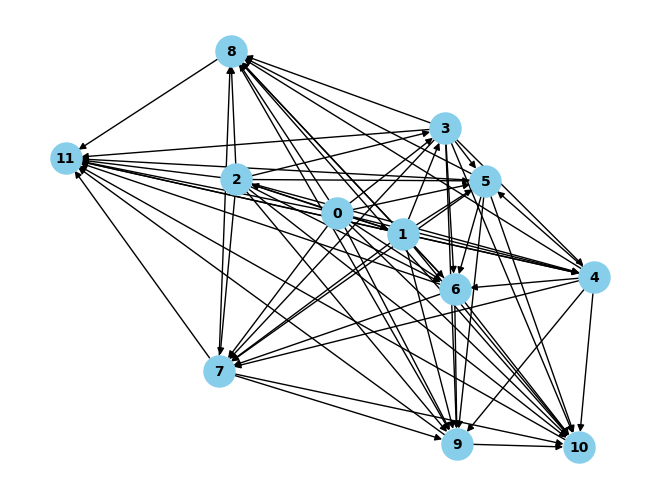

In [8]:
import matplotlib.pyplot as plt

# Draw the graph
pos = nx.spring_layout(G, seed=42)
nx.draw(G, pos, with_labels=True, node_size=500, node_color='skyblue', font_size=10, font_weight='bold')
labels = nx.get_edge_attributes(G, 'weight')
#nx.draw_networkx_edge_labels(G, pos, edge_labels=labels)

plt.show()

In [10]:
nx.community.louvain_communities(G, seed=123)

[{0, 1, 6, 7}, {3, 4, 5, 9, 10}, {2, 8, 11}]

## Learn how to use Keras and tensorflow

In [1]:
import tensorflow as tf
fashion_mnist = tf.keras.datasets.fashion_mnist.load_data()

2023-11-04 12:58:01.765041: I tensorflow/core/util/util.cc:169] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-11-04 12:58:02.256567: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2023-11-04 12:58:02.256603: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


In [2]:
(X_train_full,y_train_full),(X_test,y_test)=fashion_mnist

In [3]:
X_train_full.shape

(60000, 28, 28)

In [4]:
X_train,y_train = X_train_full[:-5000],y_train_full[:-5000]

In [5]:
X_train.shape

(55000, 28, 28)

In [6]:
X_valid, y_valid = X_train_full[-5000:],y_train_full[-5000:]

In [7]:
X_valid.shape

(5000, 28, 28)

In [8]:
X_train.dtype

dtype('uint8')

In [9]:
X_train,X_valid,X_test = X_train/255.,X_valid/255., X_test/255.

In [11]:
X_train.dtype

dtype('float64')

### Build a model

In [12]:
tf.random.set_seed(42)

In [13]:
model = tf.keras.Sequential()

2023-11-04 13:07:37.706983: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory
2023-11-04 13:07:37.707082: W tensorflow/stream_executor/cuda/cuda_driver.cc:269] failed call to cuInit: UNKNOWN ERROR (303)
2023-11-04 13:07:37.707117: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (win002.hpc.in.bmrc.ox.ac.uk): /proc/driver/nvidia/version does not exist
2023-11-04 13:07:37.708268: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [15]:
model

In [16]:
model.add(tf.keras.layers.Input(shape=[28,28]))
model.add(tf.keras.layers.Flatten())
model.add(tf.keras.layers.Dense(300,activation="relu"))
model.add(tf.keras.layers.Dense(100,activation="relu"))
model.add(tf.keras.layers.Dense(10,activation="softmax"))

In [17]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten (Flatten)           (None, 784)               0         
                                                                 
 dense (Dense)               (None, 300)               235500    
                                                                 
 dense_1 (Dense)             (None, 100)               30100     
                                                                 
 dense_2 (Dense)             (None, 10)                1010      
                                                                 
Total params: 266,610
Trainable params: 266,610
Non-trainable params: 0
_________________________________________________________________


In [18]:
model.layers

In [23]:
hidden1 = model.layers[1]

In [24]:
hidden1.name

'dense'

In [25]:
model.get_layer('dense')

In [27]:
weights,biases = hidden1.get_weights()

In [28]:
type(weights)

numpy.ndarray

In [29]:
weights.shape

(784, 300)

In [30]:
model.compile(loss='sparse_categorical_crossentropy',optimizer='sgd',metrics=['accuracy'])

In [31]:
history = model.fit(X_train,y_train,epochs=30,validation_data=(X_valid,y_valid))

Epoch 1/30
1719/1719 [==============================] - 8s 4ms/step - loss: 0.7220 - accuracy: 0.7649 - val_loss: 0.4959 - val_accuracy: 0.8332
Epoch 2/30
1719/1719 [==============================] - 8s 5ms/step - loss: 0.4825 - accuracy: 0.8331 - val_loss: 0.4561 - val_accuracy: 0.8384
Epoch 3/30
1719/1719 [==============================] - 6s 4ms/step - loss: 0.4369 - accuracy: 0.8478 - val_loss: 0.4233 - val_accuracy: 0.8556
Epoch 4/30
1719/1719 [==============================] - 5s 3ms/step - loss: 0.4121 - accuracy: 0.8562 - val_loss: 0.3964 - val_accuracy: 0.8620
Epoch 5/30
1719/1719 [==============================] - 6s 4ms/step - loss: 0.3911 - accuracy: 0.8629 - val_loss: 0.3884 - val_accuracy: 0.8618
Epoch 6/30
1719/1719 [==============================] - 10s 6ms/step - loss: 0.3751 - accuracy: 0.8691 - val_loss: 0.3906 - val_accuracy: 0.8612
Epoch 7/30
1719/1719 [==============================] - 9s 5ms/step - loss: 0.3629 - accuracy: 0.8713 - val_loss: 0.3705 - val_accuracy

In [32]:
type(history)

keras.callbacks.History

In [33]:
history.params

{'verbose': 1, 'epochs': 30, 'steps': 1719}

In [34]:
history.epoch

[0,
 1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26,
 27,
 28,
 29]

In [35]:
history.history

{'loss': [0.7220436930656433,
  0.4824713170528412,
  0.43688449263572693,
  0.41214630007743835,
  0.39105069637298584,
  0.37510666251182556,
  0.36293289065361023,
  0.3515531122684479,
  0.34076106548309326,
  0.3307875990867615,
  0.32248005270957947,
  0.3145117163658142,
  0.3071031868457794,
  0.30024799704551697,
  0.29380178451538086,
  0.28680941462516785,
  0.2825373113155365,
  0.27591708302497864,
  0.27105581760406494,
  0.26641565561294556,
  0.26140710711479187,
  0.25638970732688904,
  0.25194916129112244,
  0.24683190882205963,
  0.2427404671907425,
  0.23913021385669708,
  0.23387159407138824,
  0.23126818239688873,
  0.22658641636371613,
  0.2233859747648239],
 'accuracy': [0.7648727297782898,
  0.8331454396247864,
  0.8478000164031982,
  0.856218159198761,
  0.8629090785980225,
  0.8691090941429138,
  0.871254563331604,
  0.8755818009376526,
  0.8791818022727966,
  0.8815454840660095,
  0.885345458984375,
  0.887218177318573,
  0.8906000256538391,
  0.892309069633

In [37]:
import matplotlib.pyplot as plt
import pandas as pd
%matplotlib inline

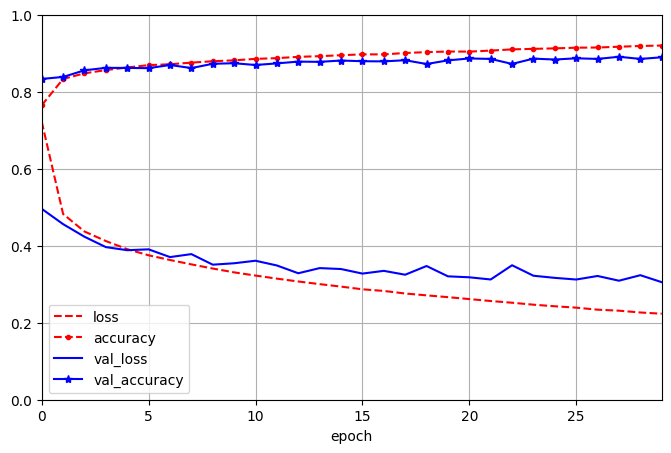

In [38]:
pd.DataFrame(history.history).plot(figsize=(8,5),xlim=[0,29],ylim=[0,1],grid=True,xlabel='epoch',style=['r--','r--.','b-','b-*'])
plt.show()

In [39]:
model.evaluate(X_test,y_test)

313/313 [==============================] - 2s 6ms/step - loss: 0.3251 - accuracy: 0.8856


[0.3251431882381439, 0.8855999708175659]

In [40]:
X_new = X_test[:3]

In [41]:
y_proba = model.predict(X_new)

y_proba.round(2)

1/1 [==============================] - 0s 219ms/step


array([[0.  , 0.  , 0.  , 0.  , 0.  , 0.01, 0.  , 0.02, 0.  , 0.97],
       [0.  , 0.  , 0.99, 0.  , 0.01, 0.  , 0.  , 0.  , 0.  , 0.  ],
       [0.  , 1.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ]],
      dtype=float32)

In [42]:
y_pred = y_proba.argmax(axis=-1)

In [43]:
y_pred

array([9, 2, 1])

### Build Complex Models Using the Functional API

In [45]:
normalization_layer = tf.keras.layers.Normalization()
hidden_layer1 = tf.keras.layers.Dense(30,activation="relu")
hidden_layer2 = tf.keras.layers.Dense(30,activation="relu")
concat_layer = tf.keras.layers.Concatenate()
output_layer = tf.keras.layers.Dense(1)

input_ = tf.keras.layers.Input(shape=X_train.shape[1:])
normalized = normalization_layer(input_)
hidden1 = hidden_layer1(normalized)
hidden2 = hidden_layer2(hidden1)
concat = concat_layer([normalized,hidden2])
output = output_layer(concat)

model = tf.keras.Model(inputs=[input_],outputs=[output])

In [46]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 28, 28)]     0           []                               
                                                                                                  
 normalization (Normalization)  (None, 28, 28)       57          ['input_2[0][0]']                
                                                                                                  
 dense_3 (Dense)                (None, 28, 30)       870         ['normalization[0][0]']          
                                                                                                  
 dense_4 (Dense)                (None, 28, 30)       930         ['dense_3[0][0]']                
                                                                                              

### Subclassing API

In [47]:
class WideAndDeepModel(tf.keras.Model):
    def __init__(self,units=30,activation="relu",**kwargs):
        super().__init__(**kwargs)
        self.norm_layer_wide = tf.keras.layers.Normalization()
        self.norm_layer_deep = tf.keras.layers.Normalization()
        self.hidden1 = tf.keras.layers.Dense(units,activation=activation)
        self.hidden2 = tf.keras.layers.Dense(units,activation=activation)
        self.main_output = tf.keras.layers.Dense(1)
        self.aux_output = tf.keras.layers.Dense(1)
        
    def call(self,inputs):
        input_wide, input_deep = inputs
        norm_wide = self.norm_layer_wide(input_wide)
        norm_deep = self.norm_layer_deep(input_deep)
        hidden1 = self.hidden1(norm_deep)
        hidden2 = self.hidden2(hidden1)
        concat = tf.keras.layers.concatenate([norm_wide,hidden2])
        output = self.main_otput(concat)
        aux_output = self.aux_output(hidden2)
        return output, aux_output
    
model = WideAndDeepModel(30,activation="relu",name="my_cool_model")

### On tensorflow dataloader

In [7]:
import tensorflow as tf
X = tf.range(10)
print(X)
dataset = tf.data.Dataset.from_tensor_slices(X)
print(dataset)

tf.Tensor([0 1 2 3 4 5 6 7 8 9], shape=(10,), dtype=int32)
<TensorSliceDataset element_spec=TensorSpec(shape=(), dtype=tf.int32, name=None)>


In [3]:
for item in dataset:
    print(item)

tf.Tensor(0, shape=(), dtype=int32)
tf.Tensor(1, shape=(), dtype=int32)
tf.Tensor(2, shape=(), dtype=int32)
tf.Tensor(3, shape=(), dtype=int32)
tf.Tensor(4, shape=(), dtype=int32)
tf.Tensor(5, shape=(), dtype=int32)
tf.Tensor(6, shape=(), dtype=int32)
tf.Tensor(7, shape=(), dtype=int32)
tf.Tensor(8, shape=(), dtype=int32)
tf.Tensor(9, shape=(), dtype=int32)


In [4]:
X_nested = {"a":([1,2,3],[4,5,6]),"b":[7,8,9]}
dataset = tf.data.Dataset.from_tensor_slices(X_nested)
for item in dataset:
    print(item)

{'a': (<tf.Tensor: shape=(), dtype=int32, numpy=1>, <tf.Tensor: shape=(), dtype=int32, numpy=4>), 'b': <tf.Tensor: shape=(), dtype=int32, numpy=7>}
{'a': (<tf.Tensor: shape=(), dtype=int32, numpy=2>, <tf.Tensor: shape=(), dtype=int32, numpy=5>), 'b': <tf.Tensor: shape=(), dtype=int32, numpy=8>}
{'a': (<tf.Tensor: shape=(), dtype=int32, numpy=3>, <tf.Tensor: shape=(), dtype=int32, numpy=6>), 'b': <tf.Tensor: shape=(), dtype=int32, numpy=9>}


2023-11-06 11:17:59.769306: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


In [6]:
type(dataset)

tensorflow.python.data.ops.dataset_ops.TensorSliceDataset

In [4]:
dataset = tf.data.Dataset.from_tensor_slices(tf.range(10))
dataset = dataset.repeat(3).batch(7)
for item in dataset:
    print(item)

tf.Tensor([0 1 2 3 4 5 6], shape=(7,), dtype=int32)
tf.Tensor([7 8 9 0 1 2 3], shape=(7,), dtype=int32)
tf.Tensor([4 5 6 7 8 9 0], shape=(7,), dtype=int32)
tf.Tensor([1 2 3 4 5 6 7], shape=(7,), dtype=int32)
tf.Tensor([8 9], shape=(2,), dtype=int32)


2023-11-06 17:21:52.917276: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


In [5]:
dataset = dataset.map(lambda x:x * 2)
for item in dataset:
    print(item)

tf.Tensor([ 0  2  4  6  8 10 12], shape=(7,), dtype=int32)
tf.Tensor([14 16 18  0  2  4  6], shape=(7,), dtype=int32)
tf.Tensor([ 8 10 12 14 16 18  0], shape=(7,), dtype=int32)
tf.Tensor([ 2  4  6  8 10 12 14], shape=(7,), dtype=int32)
tf.Tensor([16 18], shape=(2,), dtype=int32)


#### About shuffling the data

In [6]:
dataset = tf.data.Dataset.range(10).repeat(2)
for item in dataset:
    print(item)
print('################')
dataset = dataset.shuffle(buffer_size=4,seed=42).batch(7)
for item in dataset:
    print(item)

tf.Tensor(0, shape=(), dtype=int64)
tf.Tensor(1, shape=(), dtype=int64)
tf.Tensor(2, shape=(), dtype=int64)
tf.Tensor(3, shape=(), dtype=int64)
tf.Tensor(4, shape=(), dtype=int64)
tf.Tensor(5, shape=(), dtype=int64)
tf.Tensor(6, shape=(), dtype=int64)
tf.Tensor(7, shape=(), dtype=int64)
tf.Tensor(8, shape=(), dtype=int64)
tf.Tensor(9, shape=(), dtype=int64)
tf.Tensor(0, shape=(), dtype=int64)
tf.Tensor(1, shape=(), dtype=int64)
tf.Tensor(2, shape=(), dtype=int64)
tf.Tensor(3, shape=(), dtype=int64)
tf.Tensor(4, shape=(), dtype=int64)
tf.Tensor(5, shape=(), dtype=int64)
tf.Tensor(6, shape=(), dtype=int64)
tf.Tensor(7, shape=(), dtype=int64)
tf.Tensor(8, shape=(), dtype=int64)
tf.Tensor(9, shape=(), dtype=int64)
################
tf.Tensor([1 4 2 3 5 0 6], shape=(7,), dtype=int64)
tf.Tensor([9 8 2 0 3 1 4], shape=(7,), dtype=int64)
tf.Tensor([5 7 9 6 7 8], shape=(6,), dtype=int64)


2023-11-06 17:27:54.715713: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-11-06 17:27:54.722487: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


### Shuffling the Data

In [11]:
dataset = tf.data.Dataset.range(10).repeat(2)
dataset = dataset.shuffle(buffer_size=4,seed=43).batch(7)
for item in dataset:
    print(item)

tf.Tensor([3 2 1 6 4 7 8], shape=(7,), dtype=int64)
tf.Tensor([0 5 9 2 0 3 6], shape=(7,), dtype=int64)
tf.Tensor([1 7 8 5 4 9], shape=(6,), dtype=int64)


2023-11-10 11:07:06.402865: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


### Understand how Rukuang generated the simulation data

Let's use Rukuang's code.

In [28]:
print(len(time_series))
print(time_series[0].shape)


10
(25600, 40)


In [27]:
import os
import numpy as np
from osl_dynamics import data, simulation
from osl_dynamics.inference import tf_ops
from osl_dynamics.models.hmm import Config, Model
from osl_dynamics.utils import plotting
from sklearn.model_selection import KFold
from matplotlib import pyplot as plt

train = False
n_subjects = 10
n_states_list = np.array([2, 3, 4, 5, 6, 7])
n_folds = 5
#results_dir = "/well/woolrich/users/tjo747/python/sehmm/results/n_modes/hmm_vs_hmm"
#os.makedirs(results_dir, exist_ok=True)

tf_ops.gpu_growth()


time_series = []
for i in range(n_subjects):
    sim = simulation.HMM_MVN(
        n_samples=25600,
        n_states=4,
        n_channels=40,
        trans_prob="sequence",
        stay_prob=0.9,
        means="zero",
        covariances="random",
        random_seed=123,
    )
    time_series.append(sim.time_series)

training_data = data.Data(time_series,load_memmaps=True)

Loading files: 100%|████████████████████████████| 10/10 [00:00<00:00, 57.04it/s]


In [29]:
print(type((training_data.arrays)[0]))

<class 'numpy.memmap'>


### Now it's time to understand sklearn cross validation.

In [37]:
from sklearn.model_selection import KFold
kf = KFold(shuffle=True,random_state=42)

In [38]:
for i, (train_index, test_index) in enumerate(kf.split(range(20))):
    print(f"Fold {i}:")
    print(f"  Train: index={train_index}")
    print(f"  Test:  index={test_index}")


Fold 0:
  Train: index=[ 2  3  4  5  6  7  8  9 10 11 12 13 14 16 18 19]
  Test:  index=[ 0  1 15 17]
Fold 1:
  Train: index=[ 0  1  2  4  6  7  9 10 12 13 14 15 16 17 18 19]
  Test:  index=[ 3  5  8 11]
Fold 2:
  Train: index=[ 0  1  3  4  5  6  7  8  9 10 11 12 14 15 17 19]
  Test:  index=[ 2 13 16 18]
Fold 3:
  Train: index=[ 0  1  2  3  5  6  7  8 10 11 13 14 15 16 17 18]
  Test:  index=[ 4  9 12 19]
Fold 4:
  Train: index=[ 0  1  2  3  4  5  8  9 11 12 13 15 16 17 18 19]
  Test:  index=[ 6  7 10 14]


### Understand the relationship between "true" states and inferred states

This is really important. We have generated the data using ground truth with 4 states. Our model has states as many as 11. So how will these states look like?

In [30]:
import numpy as np
true_dir = './results_HCP_202311_no_mean/HMM_ICA_50_state_4/'
true_means = np.load(f'{true_dir}state_means.npy')
true_correlations = np.load(f'{true_dir}state_correlations.npy')
print(true_means.shape)
print(true_correlations.shape)

Object `like` not found.


In [10]:
n_states = 11
fit_dir = f'./results_simulation_202311_no_mean/HMM_ICA_50_state_{n_states}/'
fit_means = np.load(f'{fit_dir}state_means.npy')
fit_correlations = np.load(f'{fit_dir}state_correlations.npy')
print(fit_means.shape)
print(fit_correlations.shape)

(11, 50)
(11, 50, 50)


In [11]:
from rotation.utils import twopair_riemannian_distance, twopair_vector_correlation

In [12]:
import seaborn as sns

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/numpy/lib/function_base.py:2853: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/seaborn/matrix.py:202: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/seaborn/matrix.py:207: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)


<Axes: >

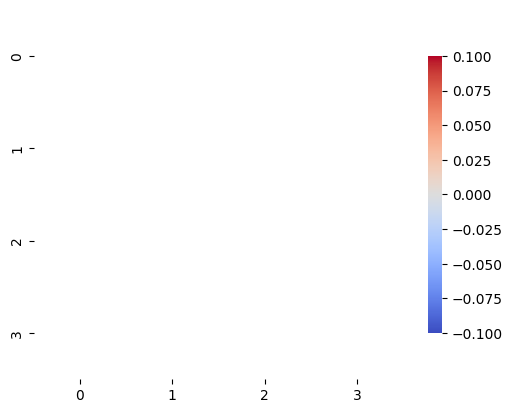

In [13]:
true_mean_correlation = twopair_vector_correlation(true_means,true_means)
sns.heatmap(true_mean_correlation, cmap="coolwarm", square=True,
                linewidths=.5, cbar_kws={"shrink": 0.75}, annot=True, fmt=".2f")

<Axes: >

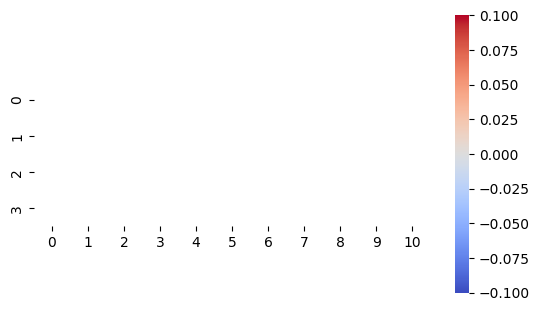

In [14]:
mean_correlation = twopair_vector_correlation(true_means,fit_means)
sns.heatmap(mean_correlation, cmap="coolwarm", square=True,
                linewidths=.5, cbar_kws={"shrink": 0.75}, annot=True, fmt=".2f")

Computing Riemannian distances: 100%|████████████| 4/4 [00:00<00:00, 361.48it/s]


<Axes: >

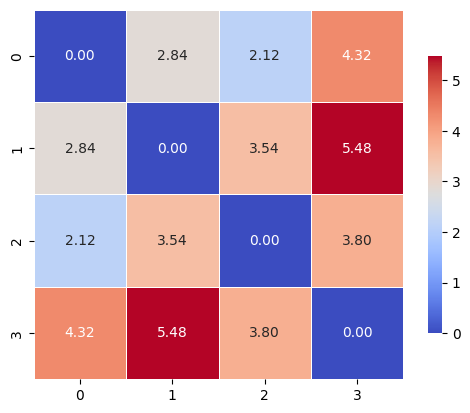

In [15]:
true_correlation_distance = twopair_riemannian_distance(true_correlations,true_correlations)
sns.heatmap(true_correlation_distance, cmap="coolwarm", square=True,
                linewidths=.5, cbar_kws={"shrink": 0.75}, annot=True, fmt=".2f")

Computing Riemannian distances: 100%|████████████| 4/4 [00:00<00:00, 203.96it/s]


<Axes: >

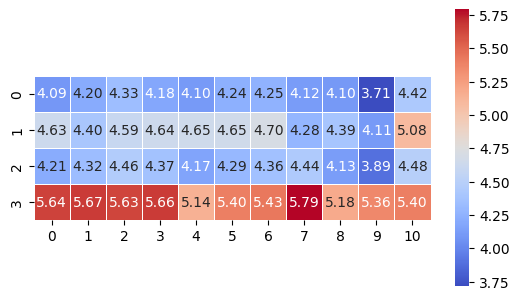

In [16]:
correlation_distance = twopair_riemannian_distance(true_correlations,fit_correlations)
sns.heatmap(correlation_distance, cmap="coolwarm", square=True,
                linewidths=.5, cbar_kws={"shrink": 0.75}, annot=True, fmt=".2f")

### Calculate the free energy

In [1]:
from rotation.analysis import comparison_analysis
models = ['HMM']
list_channels = [50,200,300]
list_states = [2,3,4,5,6,7,8,10,11]
result_dir = './results_simulation_202311_no_mean/'
save_dir = f'{result_dir}comparison/'
comparison_analysis(models,list_channels,list_states,result_dir,save_dir)

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [18]:
for n_state in n_states:
    

SyntaxError: incomplete input (390902673.py, line 2)

### Calculate the fractional occupancy across different number of states

In [9]:
import numpy as np

def fo_correlation(fo:np.ndarray):
    # Calculate the fractional occupancy of different fo vectors
    # Assuming 'data' is your numpy array with shape (N, M) N vectors with length M

    # Calculate the correlation matrix
    correlation_matrix = np.corrcoef(fo.T, rowvar=False)

    # Exclude the diagonal elements (self-correlations) and get the upper triangular part
    upper_triangle = np.triu(correlation_matrix, k=1)

    # Count the number of non-zero elements in the upper triangle
    num_pairs = np.count_nonzero(upper_triangle)
 
    # Calculate the sum of all pairwise correlations
    sum_of_correlations = np.sum(upper_triangle)

    # Calculate the average pairwise correlation
    return sum_of_correlations / num_pairs

In [12]:
states = [2,3,4,5,6,7,8,9,10,11]
fo_correlations = np.zeros((10,5))
for i in range(len(states)):
    print(f'i={i}')
    for j in range(5):
        fo = np.load(f'./results_simulation_202311_toy_2/HMM_ICA_2_state_{states[i]}/cross_validation_{j}/validation/fo.npy')
        print(fo_correlation(fo))
        fo_correlations[i,j] = fo_correlation(fo)
print(np.mean(fo_correlations,axis=1))

i=0
0.042105263157894736
0.21052631578947367
-0.042105263157894736
0.8
nan
i=1
0.9183370386832441
0.9463488740095206
0.9411147483720742
0.9479281312823751
0.9556415158536743
i=2
0.9511191383429114
0.9556662976776074
0.948607280170677
0.9669538225835946
0.9240976070927012
i=3
0.9375842311066614
0.9525775952206605
0.9699362796469595
0.9542083909222998
0.9135600820495006
i=4
0.9111264550715703
0.9491493528236157
0.9634356466876499
0.9713298524011053
0.9367415043867453
i=5
0.9340361617828553
0.9626198044627088
0.9641395686266944
0.9551746258113176
0.9526132969356207
i=6
0.949777726880377
0.9595423443698502
0.9631031288761055
0.9696107537292914
0.9202475966719372
i=7
0.9410888269148104
0.9568535377496098
0.9708032262313706
0.9375470465690332
0.9574928518485503
i=8
0.949532571760413
0.9371033825853317
0.9615600972648601
0.9694784170409859
0.9110265025318101
i=9
0.9541858315465755
0.957618093117654
0.9626041581868663
0.9713708376961047
0.9536545075497675
[       nan 0.94187406 0.94928883 0.94

In [10]:
test_fo = np.array([[0.3,0.5,0.2],[0.31,0.49,0.2]])
print(fo_correlation(test_fo))

0.9986660732168026


In [3]:
import numpy as np
import json
states = [2,3,4,5,6,7,8,9,10,11,12,13,14,15,16]
free_energy = np.zeros((15,5))
for i in range(len(states)):
    print(f'i={i}')
    for j in range(5):
        with open(f'./results_simulation_202311_toy_5/HMM_ICA_25_state_{states[i]}/cross_validation_{j}/metrics.json', 'r') as file:
        # Load the JSON data from the file
            data = json.load(file)
        print(data['free_energy'])
        free_energy[i,j] = data ['free_energy']
print(np.mean(free_energy,axis=1))

i=0
18820.51122430424
18782.153813231864
18780.841405648996
18775.62434233668
18767.98849251772
i=1
18724.1065514451
18733.49469636096
18738.084964307363
18715.404912188344
18718.402158949175
i=2
18722.885068781037
18696.135788137897
18705.13166627112
18693.672438870202
18678.349688922415
i=3
18668.82389817432
18679.142361001654
18683.204304575465
18671.608178990136
18674.836264112902
i=4
18671.705090399613
18689.503478831884
18680.233481246483
18670.97798611928
18677.027130241506
i=5
18689.107597432627
18671.14019175027
18668.723368922827
18667.38634036229
18659.258738979228
i=6
18662.602186571345
18669.79750533006
18676.8635364364
18663.506920928776
18655.42425720338
i=7
18664.66346765958
18702.333462930077
18669.004252332907
18673.91737320727
18651.488141422025
i=8
18658.82845534392
18666.882401369206
18664.032669724565
18662.826929013587
18647.9126888127
i=9
18655.47791142228
18659.068787866043
18665.929507294004
18676.623428440722
18647.32099139024
i=10
18660.02333126184
18655.658

In [7]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

# Calculate mean and standard deviation along axis 1 (across the 5 repetitions)
mean_free_energy = np.mean(free_energy, axis=1)
std_dev_free_energy = np.std(free_energy, axis=1)

# Number of states (assuming it ranges from 2 to 16)
num_states = np.arange(2, 17)

# Plotting the mean free energy with error bars
plt.errorbar(num_states, mean_free_energy, yerr=std_dev_free_energy, fmt='o-', label='Free Energy')

# Customize the plot
plt.title('Free Energy vs Number of States')
plt.xlabel('Number of States')
plt.ylabel('Free Energy')
plt.grid(True)
plt.legend()
plt.savefig('./temp_plot_20231121/free_energy.pdf')
plt.savefig('./temp_plot_20231121/free_energy.jpg')
plt.close()



### Plot the reproducibility analysis for new data

In [10]:
import os
import numpy as np
import matplotlib.pyplot as plt

# Directory path
base_directory = './results_simulation_202311_toy_5/'

# Number of states range
num_states_range = np.arange(2, 17)

# List to store average diagonal values
average_diagonal_values = []

# Loop through different numbers of states
for n_state in num_states_range:
    # File path
    file_path = os.path.join(base_directory, f'HMM_ICA_25_state_{n_state}/reproduce_analysis/FCs_fisher_correlation_reorder_split_1.npy')
    
    # Check if the file exists
    if os.path.exists(file_path):
        # Load the 2D numpy array from the file
        data = np.load(file_path)
        
        # Calculate the average value of diagonals and append to the list
        average_diagonal = np.mean(np.diagonal(data))
        average_diagonal_values.append(average_diagonal)
    else:
        print(f"File not found for {n_state} states.")

# Plotting the average diagonal values against the number of states
plt.plot(num_states_range, average_diagonal_values, 'o-')

# Customize the plot
plt.title('Average Diagonal vs Number of States')
plt.xlabel('Number of States')
plt.ylabel('Average Diagonal Value')
plt.grid(True)
plt.savefig('./temp_plot_20231121/reproduce_analysis.pdf')
plt.savefig('./temp_plot_20231121/reproduce_analysis.jpg')
plt.close()

In [14]:
from osl_dynamics.analysis.modes import calc_trans_prob_matrix

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [16]:
import pickle
with open('./results_simulation_202311_toy_2/HMM_ICA_2_state_5/cross_validation_0/validation/alpha.pkl','rb') as file:
    alpha = pickle.load(file)


(1200, 5)


In [17]:
alpha[0]

array([[0.20776352, 0.19857886, 0.23280662, 0.17427129, 0.1865797 ],
       [0.21297948, 0.1951258 , 0.2378353 , 0.16826051, 0.1857989 ],
       [0.2206108 , 0.19000335, 0.24536414, 0.161661  , 0.18236071],
       ...,
       [0.17803954, 0.21357319, 0.1828571 , 0.17252667, 0.2530035 ],
       [0.1780189 , 0.21357313, 0.18247892, 0.17248656, 0.2534425 ],
       [0.1794829 , 0.21233372, 0.18231668, 0.17321044, 0.25265625]],
      dtype=float32)

In [18]:
calc_trans_prob_matrix(alpha[0])

array([[0.94789579, 0.        , 0.02204409, 0.        , 0.03006012],
       [0.        , 0.        , 0.        , 0.        , 0.        ],
       [0.0625    , 0.        , 0.9       , 0.        , 0.0375    ],
       [0.5       , 0.        , 0.        , 0.5       , 0.        ],
       [0.02788104, 0.        , 0.00743494, 0.00185874, 0.96282528]])

In [19]:
calc_trans_prob_matrix(alpha[1])

array([[0.97667638, 0.        , 0.00874636, 0.        , 0.01457726],
       [0.        , 0.        , 0.        , 0.        , 0.        ],
       [0.05839416, 0.        , 0.9270073 , 0.        , 0.01459854],
       [0.        , 0.        , 0.        , 0.        , 0.        ],
       [0.0212766 , 0.        , 0.0106383 , 0.        , 0.96808511]])

In [20]:
calc_trans_prob_matrix(alpha[2])

array([[0.96174863, 0.        , 0.0136612 , 0.        , 0.02459016],
       [0.        , 0.        , 0.        , 0.        , 0.        ],
       [0.03333333, 0.        , 0.88333333, 0.        , 0.08333333],
       [0.        , 0.        , 0.        , 0.        , 0.        ],
       [0.01423027, 0.        , 0.00258732, 0.        , 0.98318241]])

In [21]:
calc_trans_prob_matrix(alpha[3])

array([[0.9673913 , 0.        , 0.01086957, 0.        , 0.02173913],
       [0.        , 0.        , 0.        , 0.        , 0.        ],
       [0.04724409, 0.        , 0.93700787, 0.        , 0.01574803],
       [0.        , 0.        , 0.        , 0.        , 0.        ],
       [0.01470588, 0.        , 0.00326797, 0.        , 0.98202614]])

### Calculate the Fractional Occupancy across scans in the same subject in real data

In [26]:
save_dir = './results_202309/'
N_channels = [15,25,50,100]
N_states = [4,8,12,16,20]
fo_correlation = np.zeros((4,5))
for i in range(len(N_channels)):
    for j in range(len(N_states)):
        fo = np.load(f'{save_dir}HMM_ICA_{N_channels[i]}_state_{N_states[j]}/fo.npy')
        temp = np.zeros(1003)
        for k in range(1003):
            temp[k] = np.corrcoef(fo[4*k+1,:],fo[4*k+2,:])[0,1]
        fo_correlation[i,j] = np.mean(temp[k])

print(fo_correlation)

[[0.97950602 0.95918963 0.93670589 0.86264682 0.53929757]
 [0.99130442 0.9369285  0.88698215 0.8225825  0.75641117]
 [0.97339019 0.98070914 0.93987138 0.89433092 0.88025788]
 [0.952394   0.95726558 0.92490503 0.8963217  0.9219986 ]]


In [27]:
save_dir = './results_simulation_202311_no_mean/'
N_states = [2,3,4,5,6,7,8,9,10,11]
for N_state in N_states:
    print(f'Number of states: {N_state}')
    for i in range(5):
        state_covariances = np.load(f'{save_dir}HMM_ICA_2_state_{N_state}/cross_validation_{i}/state_covariances.npy')
        print(state_covariances)

Number of states: 2
[[[1.08675    0.79293466]
  [0.79293466 0.9776847 ]]

 [[0.9148042  0.8080214 ]
  [0.8080214  1.0383565 ]]]
[[[1.0810381  0.8155787 ]
  [0.8155787  1.0047741 ]]

 [[0.92099375 0.7886471 ]
  [0.7886471  1.0076351 ]]]
[[[0.93030304 0.77806693]
  [0.77806693 0.9832886 ]]

 [[1.0721947  0.8260784 ]
  [0.8260784  1.0260663 ]]]
[[[1.0838544  0.784845  ]
  [0.784845   0.95867985]]

 [[0.9233475  0.81727713]
  [0.81727713 1.0550208 ]]]
[[[1.095637   0.81208014]
  [0.81208014 0.99377495]]

 [[0.90951    0.7931748 ]
  [0.7931748  1.0220174 ]]]
Number of states: 3
[[[1.1032157  0.7987267 ]
  [0.7987267  0.9879487 ]]

 [[0.8952596  0.79460204]
  [0.79460204 1.0230927 ]]

 [[1.0007254  0.8182104 ]
  [0.8182104  1.0128049 ]]]
[[[1.0669298  0.82418317]
  [0.82418317 1.0236919 ]]

 [[1.0958679  0.81990016]
  [0.81990016 1.0085359 ]]

 [[0.8995982  0.7878066 ]
  [0.7878066  1.0147293 ]]]
[[[1.0885408  0.80925983]
  [0.80925983 1.0021284 ]]

 [[0.9954629  0.8204736 ]
  [0.8204736  1.

FileNotFoundError: [Errno 2] No such file or directory: './results_simulation_202311_no_mean/HMM_ICA_2_state_11/cross_validation_1/state_covariances.npy'

In [29]:
save_dir = './results_simulation_202311_toy_2/'
N_states = [2,3,4,5,6,7,8,9,10,11]
for N_state in N_states:
    print(f'Number of states: {N_state}')
    for i in range(5):
        state_correlations = np.load(f'{save_dir}HMM_ICA_2_state_{N_state}/cross_validation_{i}/state_correlations.npy')
        print(state_correlations[:,0,1])

Number of states: 2
[ 0.05378785 -0.05817798]
[ 0.03055509 -0.03699611]
[ 0.03142449 -0.053673  ]
[ 0.00698425 -0.01987016]
[-0.07265587  0.05860319]
Number of states: 3
[ 0.0032953   0.02264835 -0.03192652]
[ 0.00457314  0.04954706 -0.05906602]
[ 0.06761466 -0.0995445   0.03209297]
[-0.03605026  0.0521932  -0.05851068]
[-0.06545039 -0.05777635  0.07059249]
Number of states: 4
[-0.04064161  0.06690485  0.07405905 -0.08863751]
[ 0.02542547  0.02809798  0.0671682  -0.08260437]
[ 0.05866564  0.05036159 -0.0081642  -0.09026714]
[ 0.04701238 -0.07437423 -0.06356851  0.05871381]
[-0.05338547 -0.07001888  0.03161782  0.05346838]
Number of states: 5
[-0.08420586  0.06099431 -0.08054513  0.04679568  0.08057624]
[ 0.07587091 -0.0709579  -0.05981565 -0.06444271  0.06637251]
[-0.0656861   0.06845136 -0.05104404  0.04163178 -0.07282606]
[ 0.07013366 -0.09021921 -0.03429725 -0.06053928  0.05789986]
[ 0.02650632 -0.07583283  0.06019732 -0.0878945   0.06101407]
Number of states: 6
[ 0.06913672 -0.0744

In [31]:
save_dir = './results_simulation_202311_toy_4/'
N_states = [7,8,9,10,11]
for N_state in N_states:
    print(f'Number of states: {N_state}')
    for i in range(5):
        state_correlations = np.load(f'{save_dir}HMM_ICA_2_state_{N_state}/cross_validation_{i}/state_correlations.npy')
        print(state_correlations[:,0,1])

Number of states: 7
[ 0.00977522 -0.00216067 -0.04186209 -0.00309481 -0.01425217  0.00180625
 -0.00749647]
[ 0.00697951 -0.02204215 -0.01073844 -0.00860576 -0.00532291 -0.0174249
 -0.00679664]
[ 0.00836213 -0.01460998  0.02311867  0.01421786 -0.02223931  0.00256739
 -0.03726145]
[ 0.00063448 -0.04301171 -0.01582496 -0.00191165 -0.02111614  0.01215602
  0.01461784]
[-0.0091382  -0.01258997 -0.02721128 -0.01043992  0.00412478 -0.003901
  0.00160206]
Number of states: 8
[ 0.02120858  0.00138292 -0.00860462 -0.04425818 -0.02230405 -0.01213971
  0.01356055 -0.01442865]
[-0.00314609 -0.0276848  -0.02269739 -0.01341339  0.00860837 -0.0143698
  0.00391661 -0.00491389]
[ 0.00709645 -0.00814363  0.00938956 -0.00922521 -0.01709046  0.00981777
 -0.01093454 -0.01117289]
[-3.04418802e-03 -1.06103225e-02  1.50493262e-02 -5.17292414e-03
 -5.50436052e-05 -2.81314943e-02 -1.07052019e-02 -1.92632992e-02]
[ 0.01360544 -0.03258251  0.00748951 -0.02245267 -0.02273977  0.01826198
 -0.01254019 -0.01618685]
Nu

### Generate some real time series

In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
data_dir ='./data/node_timeseries/3T_HCP1200_MSMAll_d15_ts2/100307.txt'
data = np.loadtxt(data_dir)
save_dir = './temp_plot_202311_grey/'
if not os.path.exists(save_dir):
    os.makedirs(save_dir)

In [3]:
print(data.shape)

(4800, 15)


In [4]:
T, N_channels = data.shape

In [5]:
for i in range(N_channels):
    plt.plot(data[:1000,i],color='grey')
    plt.savefig(f'{save_dir}time_series_{i}.pdf')
    plt.close()

In [9]:
import seaborn as sns
swc_dir = './results_202309/SWC_ICA_50/cor_swc.npy'
data = np.load(swc_dir)
cmap = sns.color_palette("RdBu_r",as_cmap=True)
for subject in range(2):
    for i in range(9):
        seaborn.heatmap(data[subject,i,:,:],vmin=-1.0,vmax=1.0,square=True,cmap=cmap,xticklabels=False,yticklabels=False,cbar=False)
        plt.savefig(f'{save_dir}swc_cor_subject_{subject}_index_{i}.pdf')
        plt.close()

### Look at your data! Check the ground truth

In [17]:
import numpy as np
import seaborn
import matplotlib.pyplot as plt
%matplotlib inline

In [10]:
covariances = np.load('./results_HCP_202311_no_mean/HMM_ICA_25_state_8/state_covariances.npy')
correlations = np.load('./results_HCP_202311_no_mean/HMM_ICA_25_state_8/state_correlations.npy')

In [11]:
covariances.shape

(8, 25, 25)

In [12]:
from rotation.utils import pairwise_fisher_z_correlations
fisher_z = pairwise_fisher_z_correlations(correlations)


Compute Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 942.62it/s


In [13]:
fisher_z.shape

(8, 8)

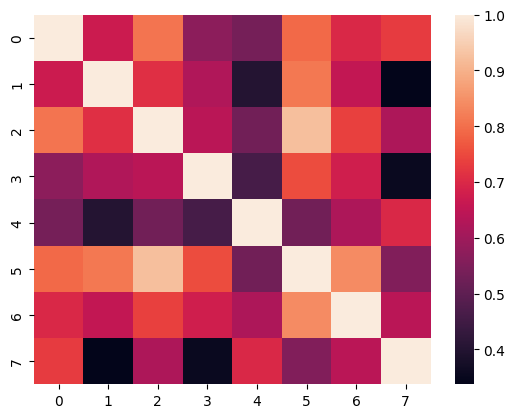

In [18]:
seaborn.heatmap(fisher_z)
plt.show()

In [22]:
correlations_fit = np.load('./results_simulation_202311_toy_5/HMM_ICA_25_state_8/state_correlations.npy')

In [23]:
correlations_fit.shape

(8, 25, 25)

Compute Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 979.92it/s


<Axes: >

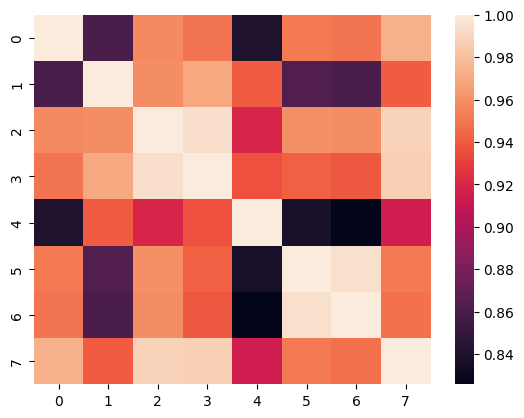

In [24]:
fisher_z_fit = pairwise_fisher_z_correlations(correlations_fit)
seaborn.heatmap(fisher_z_fit)

Compute twopair Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 46


Text(50.722222222222214, 0.5, 'Truth')

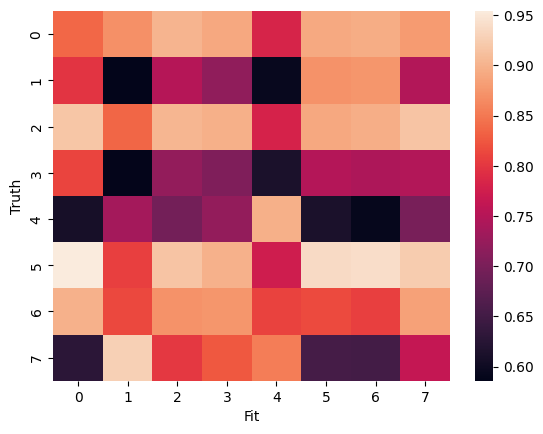

In [29]:
from rotation.utils import twopair_fisher_z_transformed_correlation
correlation_truth_fit = twopair_fisher_z_transformed_correlation(correlations,correlations_fit)
seaborn.heatmap(correlation_truth_fit)
plt.xlabel('Fit')
plt.ylabel('Truth')

In [27]:
correlation_truth_fit

array([[0.83624251, 0.87012094, 0.90166191, 0.89066245, 0.78281659,
        0.89151127, 0.89456208, 0.87908712],
       [0.79781565, 0.5858404 , 0.75091116, 0.71923662, 0.59430407,
        0.87088876, 0.87367178, 0.74740529],
       [0.91702652, 0.83562061, 0.90244091, 0.89670103, 0.78085487,
        0.89063369, 0.89573097, 0.91516119],
       [0.8103752 , 0.58814984, 0.72152761, 0.70510112, 0.61213004,
        0.7483853 , 0.74353096, 0.74833301],
       [0.6085179 , 0.73552822, 0.69491321, 0.72115188, 0.89684871,
        0.61288534, 0.59125805, 0.69913748],
       [0.95398829, 0.80609457, 0.91538969, 0.89929312, 0.77331355,
        0.93748001, 0.94056036, 0.92279008],
       [0.89885839, 0.81364203, 0.87124894, 0.87434477, 0.80985473,
        0.8150764 , 0.8061176 , 0.88355588],
       [0.6283374 , 0.92686738, 0.80095794, 0.82506889, 0.85472505,
        0.65338245, 0.65070348, 0.76353957]])

### Test with Riemannian distance

In [31]:
from rotation.utils import twopair_riemannian_distance
covariances_fit = np.load('./results_simulation_202311_toy_5/HMM_ICA_25_state_8/state_covariances.npy')

In [32]:
riemann_truth = twopair_riemannian_distance(covariances,covariances)
riemann_fit = twopair_riemannian_distance(covariances_fit,covariances_fit)
riemann_truth_fit = twopair_riemannian_distance(covariances,covariances_fit)

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 464.47it/s]


<Axes: >

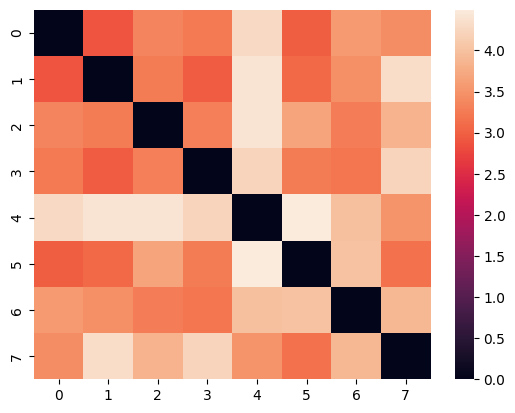

In [33]:
seaborn.heatmap(riemann_truth)

<Axes: >

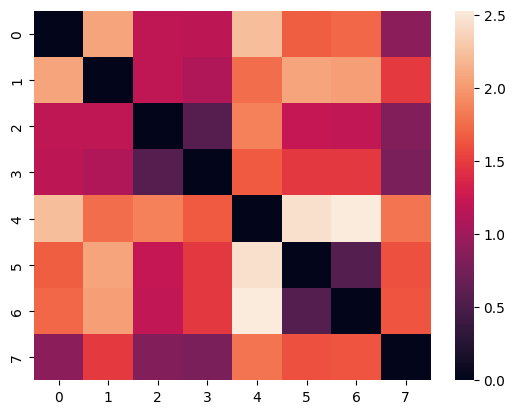

In [34]:
seaborn.heatmap(riemann_fit)

<Axes: >

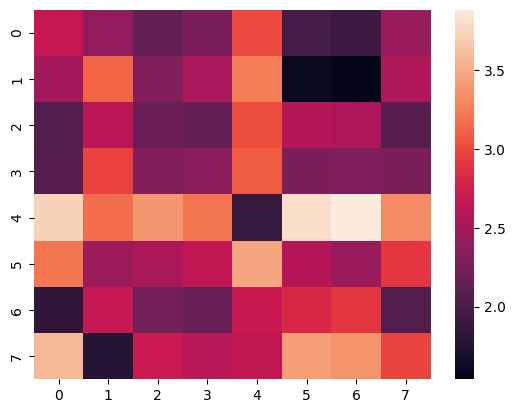

In [35]:
seaborn.heatmap(riemann_truth_fit)

In [21]:
from rotation.utils import hungarian_pair

In [38]:
fisher_indices, fisher_reordered = hungarian_pair(correlation_truth_fit)

<Axes: >

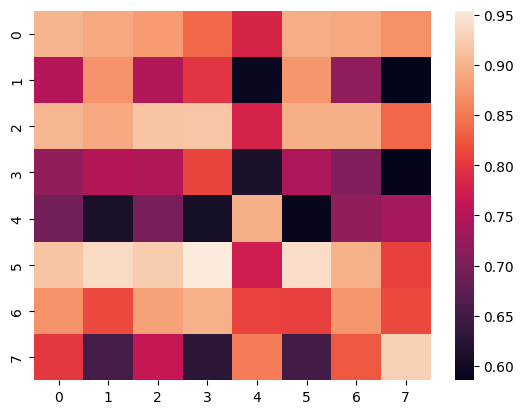

In [39]:
seaborn.heatmap(fisher_reordered)

### Check the effect of z_score

In [3]:
import pathlib
import numpy as np
from rotation.preprocessing import PrepareData
original_data = np.loadtxt('data/node_timeseries/simulation_toy_5/10001.txt')


In [4]:
original_data.shape

(120000, 25)

In [12]:
data_dir = pathlib.Path('data/node_timeseries/simulation_toy_5/')
prepare_data = PrepareData(data_dir)
subj,dataset = prepare_data.load(z_score_data=True)


Read from directory:  data/node_timeseries/simulation_toy_5
Number of subjects:  1


Loading files: 100%|███████████████████████| 100/100 [00:00<00:00, 10272.86it/s]


In [13]:
subj

['10001']

In [14]:
dataset

In [15]:
np.sum(dataset[0]!=original_data[:1200,:])

30000

In [16]:
covariances_no_z_score = np.load('./results_simulation_playground/no_z_score/HMM_ICA_25_state_8/state_covariances.npy')

In [17]:
correlations_no_z_score = np.load('./results_simulation_playground/no_z_score/HMM_ICA_25_state_8/state_correlations.npy')

Compute Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 58.45it/s]


<Axes: >

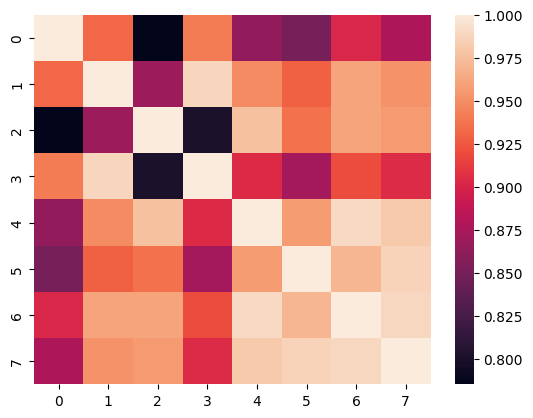

In [20]:
import seaborn
from rotation.utils import pairwise_fisher_z_correlations
seaborn.heatmap(pairwise_fisher_z_correlations(correlations_no_z_score))

In [22]:
from rotation.utils import twopair_riemannian_distance
covariances = np.load('./results_HCP_202311_no_mean/HMM_ICA_25_state_8/state_covariances.npy')
covariances_no_z_score_truth = twopair_riemannian_distance(covariances_no_z_score,covariances)

Computing Riemannian distances: 100%|█████████████| 8/8 [00:00<00:00, 50.33it/s]


<Axes: >

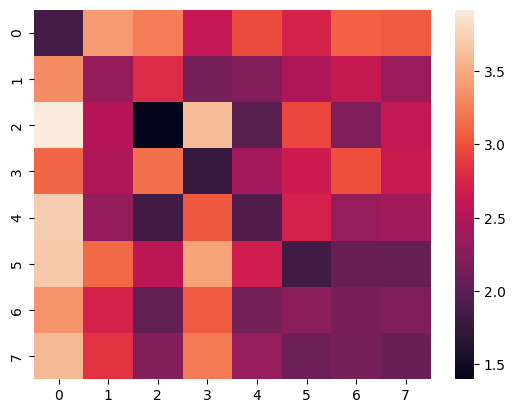

In [23]:
fisher_indices, fisher_reordered = hungarian_pair(covariances_no_z_score_truth,distance=True)
seaborn.heatmap(fisher_reordered)

### Update 29th November 2023: Using Sliding window correlation to check model simulation

#### Step 1: read in the ground-truth correlations and covariances.

In [1]:
import numpy as np
correlations_truth = np.load('./results_HCP_202311_no_mean/HMM_ICA_25_state_8/state_correlations.npy')
covariances_truth = np.load('./results_HCP_202311_no_mean/HMM_ICA_25_state_8/state_covariances.npy')

#### Step 2: read in the sliding window correlations and covariances.

In [2]:
correlations_SWC = np.load('./results_simulation_202311_toy_6/SWC_ICA_25_state_8/state_correlations.npy')
covariances_SWC = np.load('./results_simulation_202311_toy_6/SWC_ICA_25_state_8/state_covariances.npy')

In [3]:
from rotation.utils import twopair_riemannian_distance, twopair_fisher_z_transformed_correlation, hungarian_pair

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [4]:
### Riemannian distance of ground truth correlations/covariances
riemannian_cor_truth = twopair_riemannian_distance(correlations_truth,correlations_truth)
riemannian_cov_truth = twopair_riemannian_distance(covariances_truth,covariances_truth)
riemannian_cor_SWC = twopair_riemannian_distance(correlations_SWC,correlations_SWC)
riemannian_cov_SWC = twopair_riemannian_distance(covariances_SWC,covariances_SWC)
riemannian_cor_truth_SWC = twopair_riemannian_distance(correlations_truth,correlations_SWC)
riemannian_cov_truth_SWC = twopair_riemannian_distance(covariances_truth,covariances_SWC)

Computing Riemannian distances:   0%|                     | 0/8 [00:00<?, ?it/s]
/gpfs3/well/win-fmrib-analysis/users/uap971/osl-dynamics/rotation/utils.py:427: UserWarning: Calculation of Riemannian distance failed for eps=0
  warnings.warn(f'Calculation of Riemannian distance failed for eps={eps}')
Computing Riemannian distances:   0%|                     | 0/8 [00:00<?, ?it/s]
/gpfs3/well/win-fmrib-analysis/users/uap971/osl-dynamics/rotation/utils.py:427: UserWarning: Calculation of Riemannian distance failed for eps=1e-09
  warnings.warn(f'Calculation of Riemannian distance failed for eps={eps}')
Computing Riemannian distances:   0%|                     | 0/8 [00:00<?, ?it/s]
/gpfs3/well/win-fmrib-analysis/users/uap971/osl-dynamics/rotation/utils.py:427: UserWarning: Calculation of Riemannian distance failed for eps=1e-08
  warnings.warn(f'Calculation of Riemannian distance failed for eps={eps}')
Computing Riemannian distances:   0%|                     | 0/8 [00:00<?, ?it/s]
/gpfs

ValueError: Riemannian distance failed for all eps values!

In [6]:
### Fisher-z transformed of ground truth correlations/covariances
fisher_cor_truth = twopair_fisher_z_transformed_correlation(correlations_truth,correlations_truth)
fisher_cor_SWC = twopair_fisher_z_transformed_correlation(correlations_SWC,correlations_SWC)
fisher_cor_truth_SWC = twopair_fisher_z_transformed_correlation(correlations_truth,correlations_SWC)

Compute twopair Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 43
Compute twopair Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 27
Compute twopair Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 44


<Axes: >

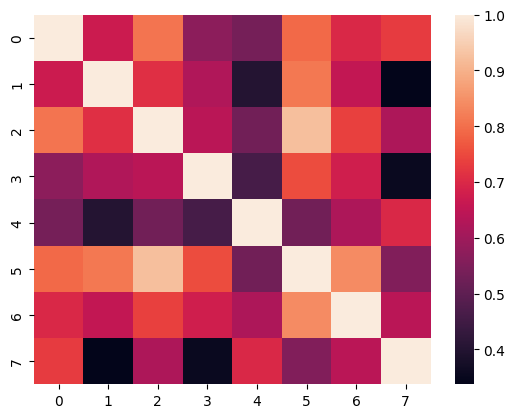

In [7]:
import seaborn
seaborn.heatmap(fisher_cor_truth)

<Axes: >

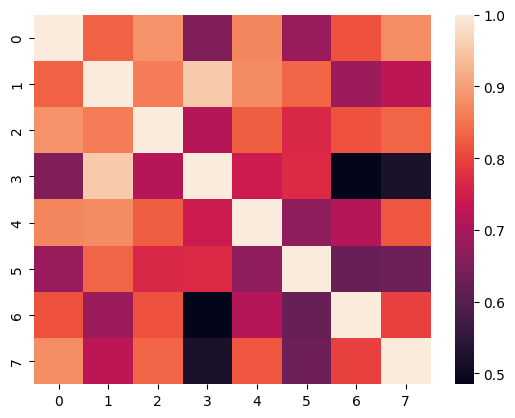

In [8]:
seaborn.heatmap(fisher_cor_SWC)

In [11]:
indices, fisher_cor_truth_SWC_reordered = hungarian_pair(fisher_cor_truth_SWC)

<Axes: >

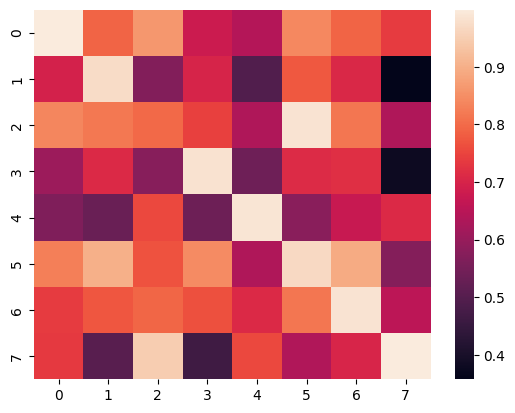

In [12]:
seaborn.heatmap(fisher_cor_truth_SWC_reordered)

In [13]:
fisher_cor_truth_SWC_reordered

array([[0.99665347, 0.79065424, 0.86175603, 0.67923163, 0.64137114,
        0.83951469, 0.79072613, 0.73808677],
       [0.69531901, 0.97180593, 0.56825185, 0.69969413, 0.49478473,
        0.77561   , 0.70770739, 0.35748703],
       [0.83670896, 0.81624049, 0.79788602, 0.74443762, 0.63394945,
        0.98448696, 0.81566564, 0.63466101],
       [0.606599  , 0.70847455, 0.57585796, 0.98390002, 0.53809844,
        0.71286777, 0.71860203, 0.37846639],
       [0.56450886, 0.531393  , 0.75437802, 0.53637612, 0.98684594,
        0.57883474, 0.67088507, 0.71001059],
       [0.82633156, 0.89953065, 0.76747896, 0.84420265, 0.63545595,
        0.96842436, 0.89347347, 0.57129213],
       [0.73816928, 0.77253745, 0.79246946, 0.76510963, 0.71058002,
        0.81414476, 0.98449903, 0.65564675],
       [0.73440623, 0.50396578, 0.94752085, 0.462748  , 0.75510815,
        0.63700018, 0.70084349, 0.99896867]])

#### Step 3: read in the HMM states 

In [20]:
correlations_HMM = np.load('./results_simulation_202311_toy_6/HMM_ICA_25_state_8/state_correlations.npy')
covariances_HMM = np.load('./results_simulation_202311_toy_6/HMM_ICA_25_state_8/state_covariances.npy')

In [21]:
fisher_cor_HMM = twopair_fisher_z_transformed_correlation(correlations_HMM,correlations_HMM)
fisher_cor_truth_HMM = twopair_fisher_z_transformed_correlation(correlations_truth,correlations_HMM)

Compute twopair Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 42
Compute twopair Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 46


In [22]:
indices, fisher_cor_truth_HMM_reordered = hungarian_pair(fisher_cor_truth_HMM)

<Axes: >

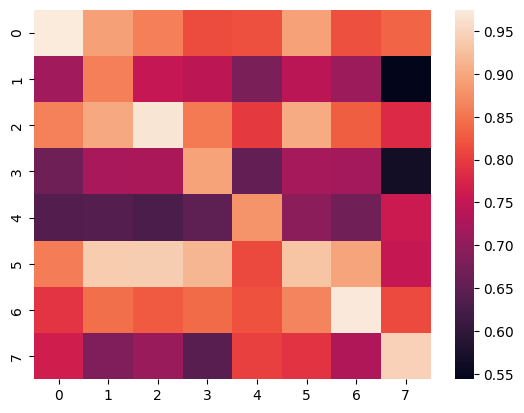

In [23]:
seaborn.heatmap(fisher_cor_truth_HMM_reordered)

<Axes: >

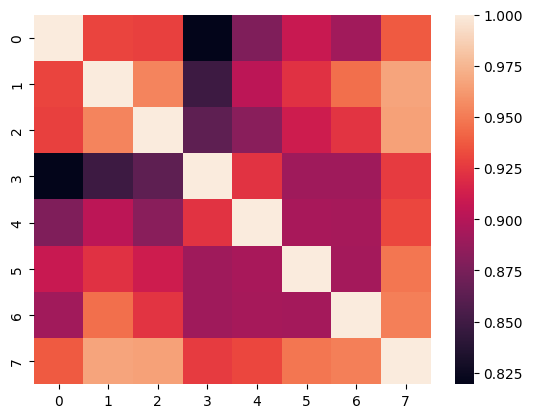

In [24]:
seaborn.heatmap(fisher_cor_HMM)

### Update 1st Dec 2023

As suggested by Chet, now let's check whether the osl-dynamics HMM inference is correct. First, check the non-trainable case.

In [13]:
import numpy as np
import seaborn
from rotation.utils import twopair_riemannian_distance, hungarian_pair

In [14]:
state_covariance_fit = np.load('./results_simulation_202311_toy_6/HMM_ICA_25_state_8_final/state_covariances.npy')
state_correlation_fit = np.load('./results_simulation_202311_toy_6/HMM_ICA_25_state_8_final/state_correlations.npy')
state_covariance_truth = np.load('./results_HCP_202311_no_mean/HMM_ICA_25_state_8/state_covariances.npy')
state_correlation_truth = np.load('./results_HCP_202311_no_mean/HMM_ICA_25_state_8/state_correlations.npy')

In [15]:
riemannian_fit_truth = twopair_riemannian_distance(state_covariance_fit,state_covariance_truth)

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 703.06it/s]


[[3.40165214 4.30717011 3.84038278 4.20373658 3.51038735 3.12401759
  3.87697419 0.2220812 ]
 [3.52225279 3.43193624 3.2468047  3.18809499 3.97682885 3.94893485
  0.27046988 3.8413184 ]
 [3.34266174 3.25839884 0.22693022 3.28144366 4.3971542  3.68080528
  3.27287083 3.84530398]
 [2.99361127 3.09763207 3.6748324  3.28287213 4.49290185 0.2408669
  4.00648284 3.13329171]
 [4.28933351 4.40521676 4.40702048 4.23416973 0.23888105 4.52361696
  3.96486466 3.53856864]
 [2.91095785 0.24518114 3.26954234 2.98285989 4.41633575 3.08779298
  3.48844738 4.34197844]
 [3.27353471 2.99365311 3.3194696  0.23079059 4.24406806 3.27762597
  3.23906169 4.25418187]
 [0.18944531 2.91233698 3.35909665 3.24848635 4.30739919 2.99555427
  3.6033023  3.45915863]]


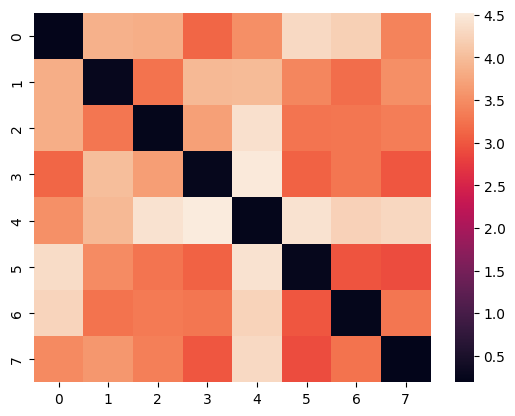

In [16]:
_, riemannian_fit_truth_reordered = hungarian_pair(riemannian_fit_truth,distance=True)
seaborn.heatmap(riemannian_fit_truth_reordered)
print(riemannian_fit_truth)

Compute Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 1076.43it/


<Axes: >

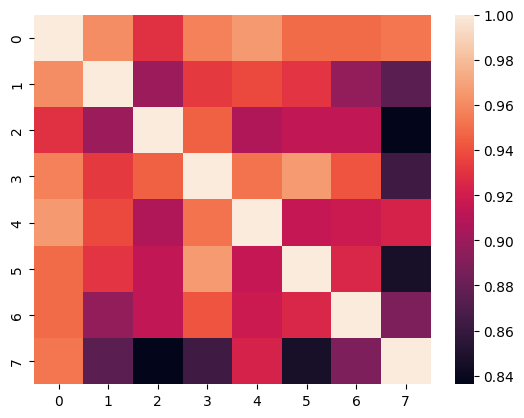

In [13]:
from rotation.utils import pairwise_fisher_z_correlations
seaborn.heatmap(pairwise_fisher_z_correlations(state_correlation_fit))

Compute Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 1026.95it/


<Axes: >

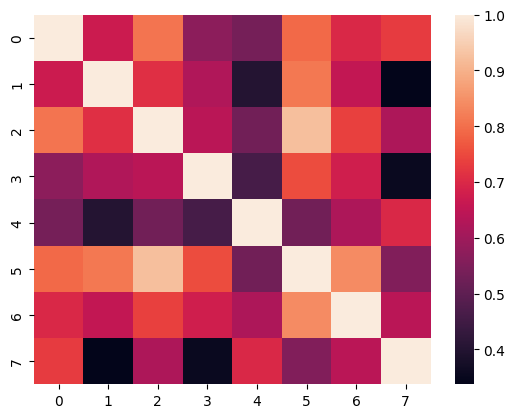

In [6]:
seaborn.heatmap(pairwise_fisher_z_correlations(state_correlation_truth))

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 675.18it/s]


<Axes: >

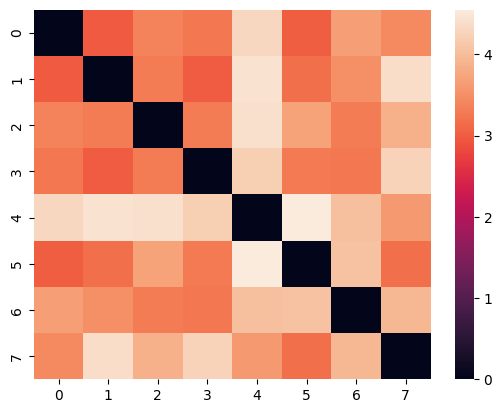

In [7]:
seaborn.heatmap(twopair_riemannian_distance(state_covariance_fit,state_covariance_fit))

In [12]:
import pickle

In [13]:
with open('./results_simulation_202311_toy_6/HMM_ICA_25_state_8/alpha.pkl','rb') as file:
    posterior = pickle.load(file)

In [48]:
posterior_hard = np.argmax(posterior[7],axis=1)
print(posterior_hard.shape)

(1200,)


In [22]:
truth = np.load('data/node_timeseries/simulation_toy_6/10001_state_time_course.npy')

In [51]:
truth_0 = np.argmax(truth[8400:9600,:],axis=1)

In [52]:
np.sum(truth_0!=posterior_hard)

1000

In [53]:
for i in range(100):
    posterior_hard = np.argmax(posterior[i],axis=1)
    truth_0 = np.argmax(truth[i*1200:i*1200+1200,:],axis=1)
    print(np.sum(truth_0!=posterior_hard))

13
4
5
13
13
5
68
14
17
18
26
12
22
19
23
10
3
10
15
5
10
14
2
10
13
17
16
3
27
11
13
18
10
6
26
23
21
17
17
31
16
20
8
43
13
18
19
17
6
18
11
25
11
20
18
10
10
25
20
16
36
12
17
21
5
14
10
5
22
36
18
18
9
10
20
14
18
12
12
17
22
11
13
10
6
13
25
12
15
13
16
35
6
8
7
25
9
12
18
18


### Understand the different training configurations and loss function

In [54]:
sequence_lengths = [600,400,200,100,50,25]
batch_sizes = [1024,512,256,128,64,32]
learning_rates = [0.0005,0.001,0.005,0.01]

In [56]:
import os
import numpy as np

In [57]:
for sequence_length in sequence_lengths:
    for batch_size in batch_sizes:
        for learning_rate in learning_rates:
            if not os.path.exists(f'./results_training_config/sl_{sequence_length}_bs_{batch_size}_lr_{learning_rate}/trans_prob.npy'):
                print(f'sequence_length_{sequence_length}_batch_size_{batch_size}_learning_rate_{learning_rate}')

sequence_length_25_batch_size_32_learning_rate_0.0005
sequence_length_25_batch_size_32_learning_rate_0.001
sequence_length_25_batch_size_32_learning_rate_0.005
sequence_length_25_batch_size_32_learning_rate_0.01


### Update the state covariances after initialised training

In [7]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn
%matplotlib inline
from rotation.utils import cov2stdcor, pairwise_fisher_z_correlations, twopair_riemannian_distance

Compute Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 862.83it/s


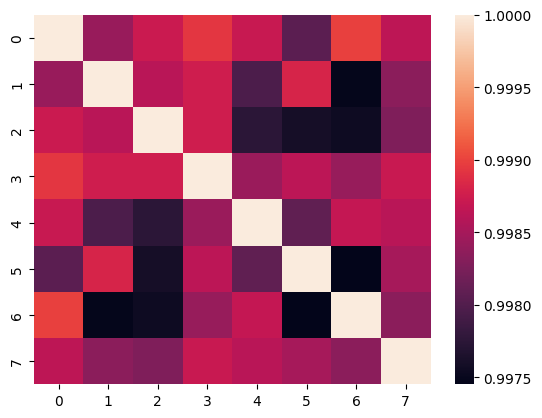

In [20]:
save_dir = './results_simulation_202311_toy_6/HMM_ICA_25_state_8_miscellaneous_real/'
n_init = 10
for i in range(1,2):
    covariances = np.load(f'{save_dir}covariances_{i}.npy')
    _, correlations = cov2stdcor(covariances)
    seaborn.heatmap(pairwise_fisher_z_correlations(correlations))
    plt.show()

### Check Chet's simulation - What these covariance matrices look like

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn
%matplotlib inline
from rotation.utils import twopair_riemannian_distance, pairwise_fisher_z_correlations, cov2stdcor

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
covariances = np.load('./data/node_timeseries/simulation_toy_8/10001_state_covariances.npy')

In [3]:
_,correlations = cov2stdcor(covariances)

Computing Riemannian distances: 100%|█████████████| 5/5 [00:00<00:00, 28.93it/s]


<Axes: >

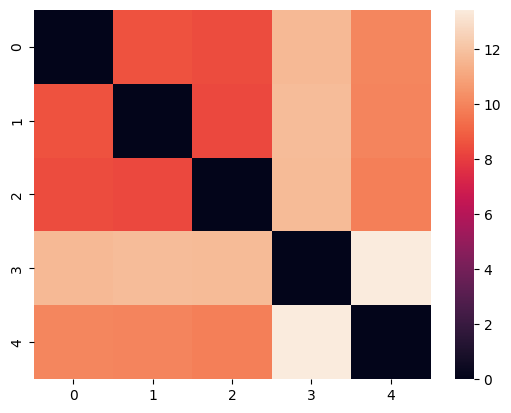

In [4]:
seaborn.heatmap(twopair_riemannian_distance(covariances, covariances))

Compute Fisher-z transformated correlation: 100%|█| 5/5 [00:00<00:00, 1758.47it/


<Axes: >

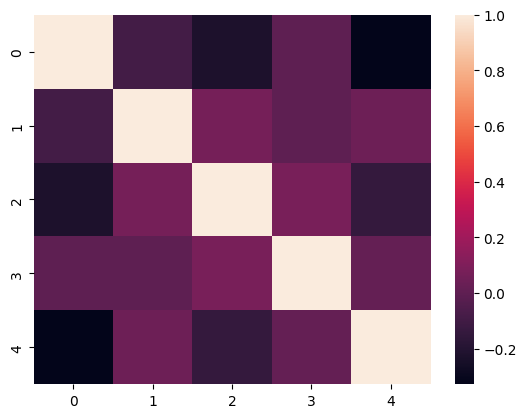

In [5]:
seaborn.heatmap(pairwise_fisher_z_correlations(correlations))

Compute Fisher-z transformated correlation: 100%|█| 5/5 [00:00<00:00, 1686.36it/


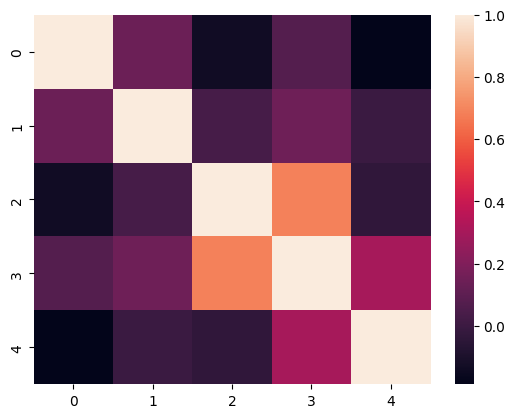

Compute Fisher-z transformated correlation: 100%|█| 5/5 [00:00<00:00, 2539.85it/


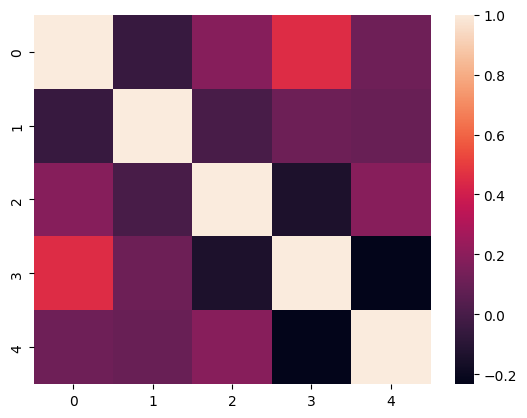

Compute Fisher-z transformated correlation: 100%|█| 5/5 [00:00<00:00, 1579.30it/


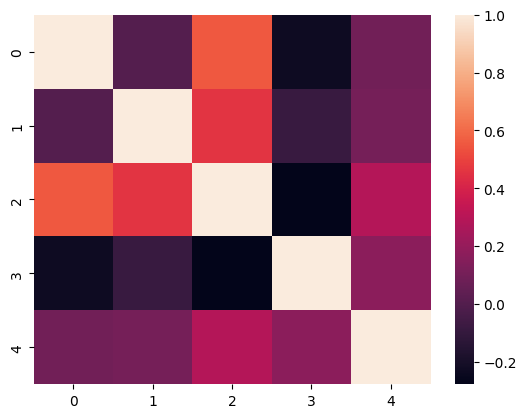

Compute Fisher-z transformated correlation: 100%|█| 5/5 [00:00<00:00, 1889.84it/


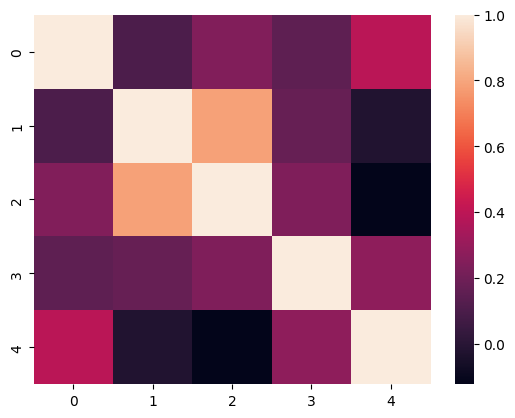

Compute Fisher-z transformated correlation: 100%|█| 5/5 [00:00<00:00, 1555.17it/


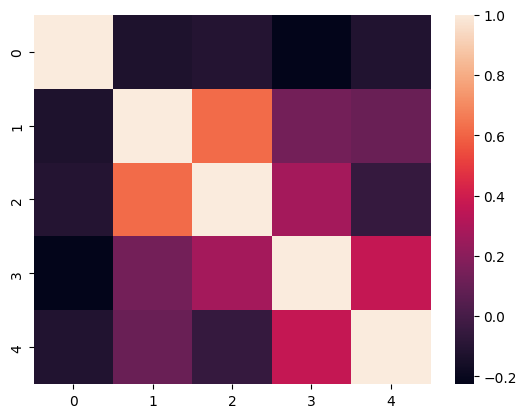

Compute Fisher-z transformated correlation: 100%|█| 5/5 [00:00<00:00, 1830.77it/


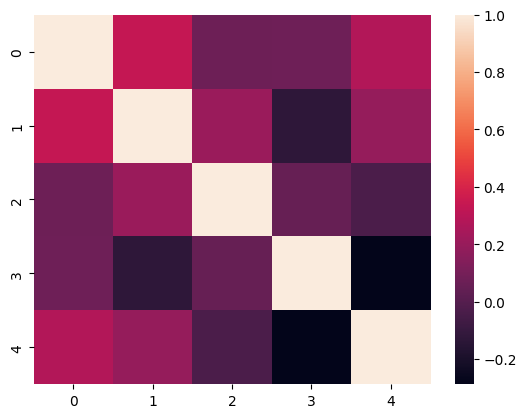

Compute Fisher-z transformated correlation: 100%|█| 5/5 [00:00<00:00, 1892.22it/


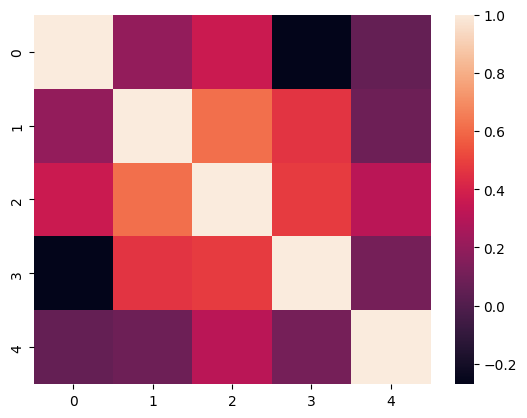

Compute Fisher-z transformated correlation: 100%|█| 5/5 [00:00<00:00, 1795.35it/


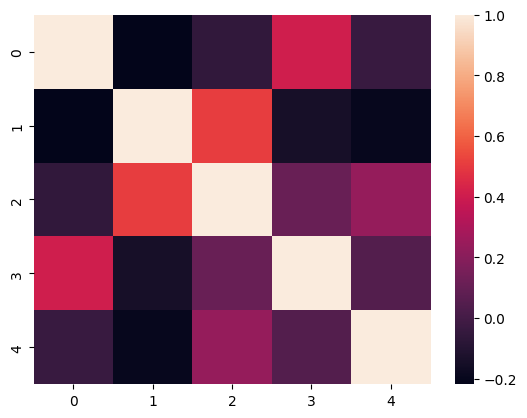

Compute Fisher-z transformated correlation: 100%|█| 5/5 [00:00<00:00, 1858.52it/


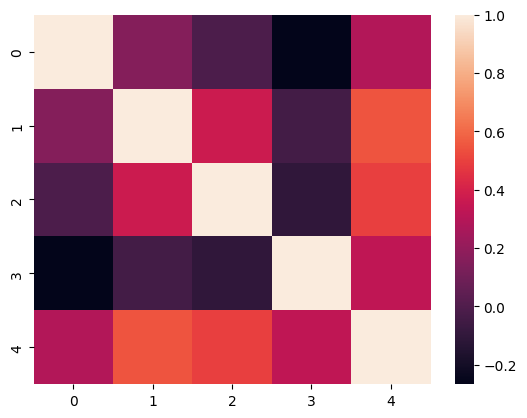

Compute Fisher-z transformated correlation: 100%|█| 5/5 [00:00<00:00, 1958.67it/


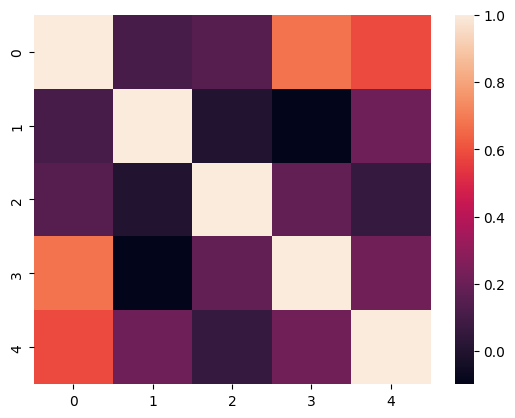

In [6]:
save_dir = './results_simulation_202311_toy_8/'
n_init = 10
for i in range(n_init):
    covariances = np.load(f'{save_dir}covariances_{i}.npy')
    _, correlations = cov2stdcor(covariances)
    seaborn.heatmap(pairwise_fisher_z_correlations(correlations))
    plt.show()

Computing Riemannian distances: 100%|███████████| 5/5 [00:00<00:00, 1592.37it/s]


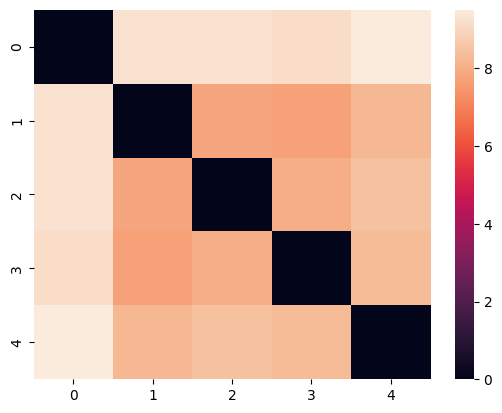

In [7]:
results_covariance = np.load(f'{save_dir}HMM_ICA_11_state_5/state_covariances.npy')
seaborn.heatmap(twopair_riemannian_distance(results_covariance,results_covariance))
plt.show()

Computing Riemannian distances: 100%|███████████| 5/5 [00:00<00:00, 1654.17it/s]


[[7.48701844 6.75399839 7.17971632 7.91314317 7.60459501]
 [5.89449839 6.6039659  6.08214241 6.20640782 3.83590764]
 [5.71553436 6.57674421 6.36538851 4.12601537 6.65066772]
 [5.14404274 6.70249356 4.57809857 6.55693776 6.41183871]
 [6.37435824 5.69786049 6.67285536 6.69623953 6.98998333]]


AttributeError: QuadMesh.set() got an unexpected keyword argument 'distance'

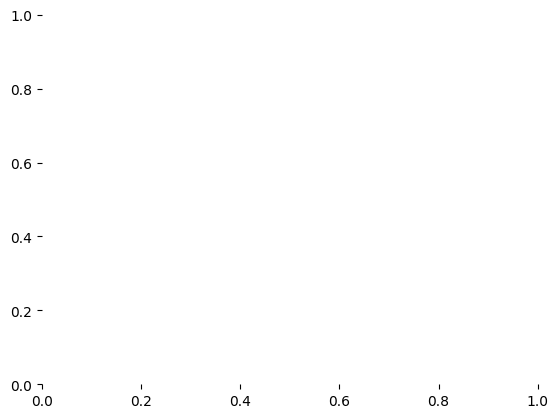

In [12]:
from rotation.utils import hungarian_pair
riem = twopair_riemannian_distance(results_covariance,covariances)
_, riem_reordered = hungarian_pair(riem)
print(riem_reordered)
seaborn.heatmap(riem_reordered,distance=True)
plt.show()

Now we have finished the training. Just look at your data!

In [14]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn
from rotation.utils import twopair_riemannian_distance, twopair_fisher_z_transformed_correlation, cov2stdcor,hungarian_pair

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 517.44it/s]


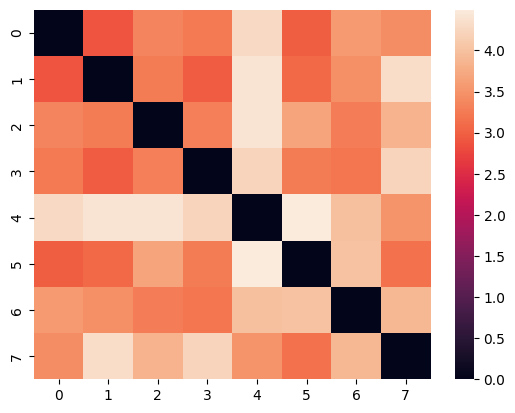

Compute twopair Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 56


<Axes: >

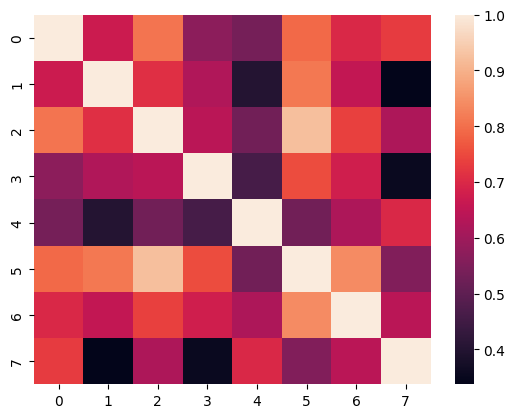

In [17]:
ground_truth_dir = './results_HCP_202311_no_mean/'
covariances_ground_truth = np.load(f'{ground_truth_dir}HMM_ICA_25_state_8/state_covariances.npy')
correlations_ground_truth = np.load(f'{ground_truth_dir}HMM_ICA_25_state_8/state_correlations.npy')
seaborn.heatmap(twopair_riemannian_distance(covariances_ground_truth,covariances_ground_truth))
plt.show()
seaborn.heatmap(twopair_fisher_z_transformed_correlation(correlations_ground_truth,correlations_ground_truth))

Computing Riemannian distances: 100%|██████████| 16/16 [00:00<00:00, 292.92it/s]


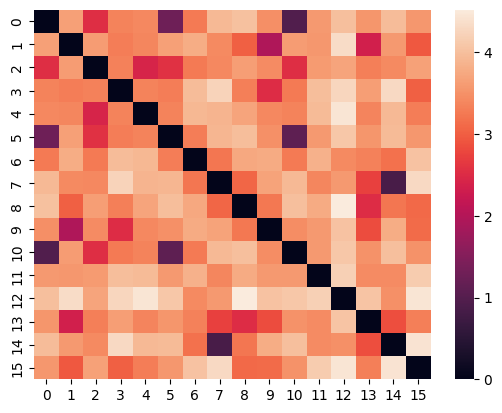

Compute twopair Fisher-z transformated correlation: 100%|█| 16/16 [00:00<00:00, 


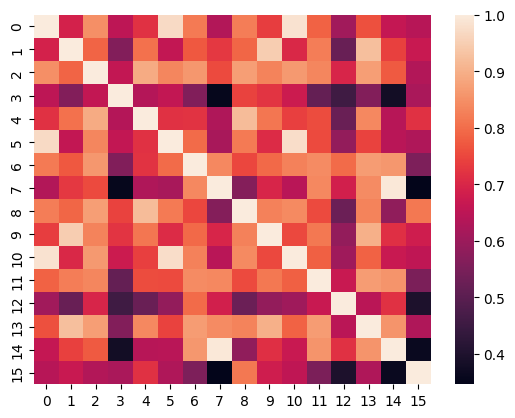

Computing Riemannian distances: 100%|██████████| 16/16 [00:00<00:00, 787.76it/s]


<Axes: >

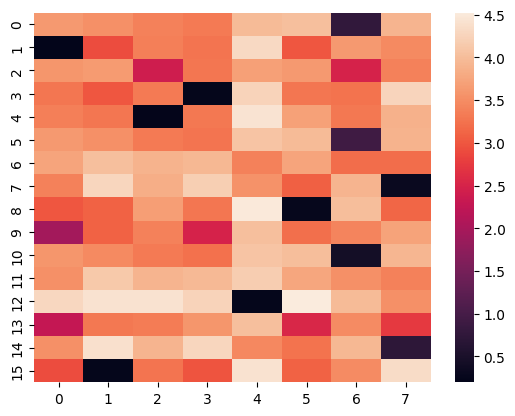

In [36]:
save_dir = './results_simulation_202311_toy_6/'
n_states = [2,3,4,5,6,7,8,9,10,11,12,13,14,15,16]
covariances = np.load(f'{save_dir}HMM_ICA_25_state_16/state_covariances.npy')
correlations = np.load(f'{save_dir}HMM_ICA_25_state_16/state_correlations.npy')
seaborn.heatmap(twopair_riemannian_distance(covariances,covariances))
plt.show()
seaborn.heatmap(twopair_fisher_z_transformed_correlation(correlations,correlations))
plt.show()
covariance_fit_truth = twopair_riemannian_distance(covariances,covariances_ground_truth)
seaborn.heatmap(covariance_fit_truth)

check the fractional occupancy when the states are very large

In [39]:
fo = np.load(f'{save_dir}HMM_ICA_25_state_16/fo.npy')
print(np.mean(fo,axis=0))

[0.02820833 0.17531667 0.00204167 0.12139167 0.111325   0.02111667
 0.00235833 0.10115    0.10949167 0.00215833 0.07358333 0.00185
 0.10640833 0.00259167 0.03178333 0.109225  ]


### Check the results of all training configurations

In [8]:
import numpy as np
import json
import os
import matplotlib.pyplot as plt
%matplotlib inline

In [10]:
sequence_lengths = [25,50,100,200,400,600]
batch_sizes = [32,64,128,256,512,1024]
#learning_rates = [0.0005,0.001,0.005,0.01]
learning_rates = [0.001]

Check whether the training has finished

In [7]:
save_dir = './results_training_config/'
for sequence_length in sequence_lengths:
    for batch_size in batch_sizes:
        for learning_rate in learning_rates:
            if not os.path.isfile(f'{save_dir}sl_{sequence_length}_bs_{batch_size}_lr_{learning_rate}/time.json'):
                print(f'sl_{sequence_length}_bs_{batch_size}_lr_{learning_rate}')

sl_25_bs_32_lr_0.0005
sl_25_bs_32_lr_0.001
sl_25_bs_32_lr_0.005
sl_25_bs_32_lr_0.01


/tmp/slurm-39097824/ipykernel_37046/3657015509.py:32: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(configurations, rotation=45, ha='right')


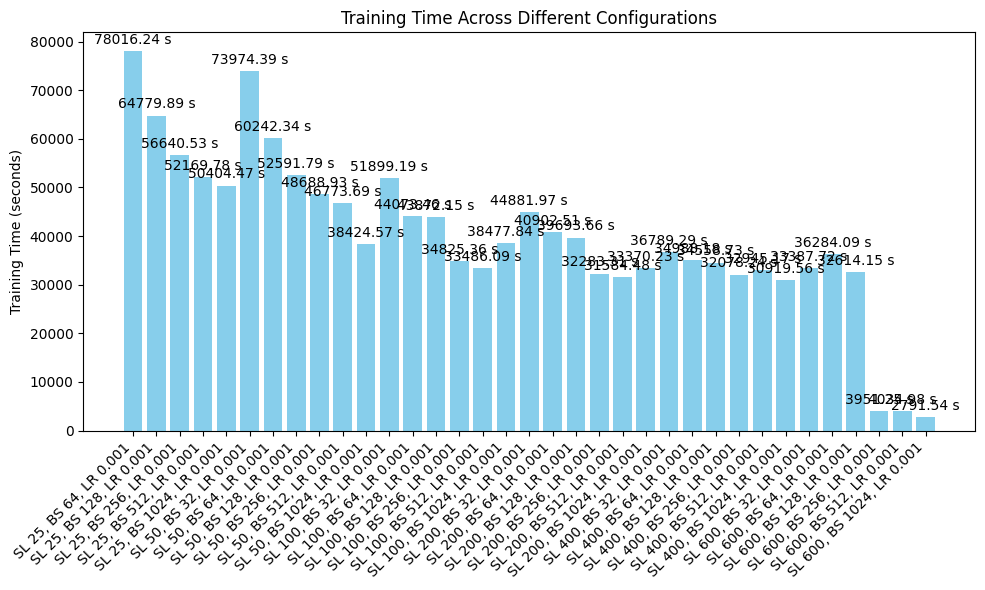

In [11]:
# Initialize lists to store data
configurations = []
durations = []

# Loop through configurations and read JSON files
for sequence_length in sequence_lengths:
    for batch_size in batch_sizes:
        for learning_rate in learning_rates:
            # Skip the missing file
            if sequence_length == 25 and batch_size == 32:
                continue
            
            # Construct the file path
            file_path = f'./results_training_config/sl_{sequence_length}_bs_{batch_size}_lr_{learning_rate}/time.json'
            
            # Check if the file exists
            if os.path.exists(file_path):
                # Read the JSON file
                with open(file_path, 'r') as json_file:
                    data = json.load(json_file)
                    duration = data['duration']
                    
                    # Append data to lists
                    configurations.append(f'SL {sequence_length}, BS {batch_size}, LR {learning_rate}')
                    durations.append(duration)

# Create a bar plot
fig, ax = plt.subplots(figsize=(10, 6))
bars = ax.bar(configurations, durations, color='skyblue')
ax.set_ylabel('Training Time (seconds)')
ax.set_title('Training Time Across Different Configurations')
ax.set_xticklabels(configurations, rotation=45, ha='right')

# Add data labels
for bar, duration in zip(bars, durations):
    height = bar.get_height()
    ax.annotate(f'{duration:.2f} s', xy=(bar.get_x() + bar.get_width() / 2, height),
                xytext=(0, 3),  # 3 points vertical offset
                textcoords="offset points",
                ha='center', va='bottom')

plt.tight_layout()
plt.show()


## Update 8th Dec 2023

### Step 1: Show our current training model is successful

Method: use the ground-truth HMM model obtained from HCP (results_HCP_202311_no_mean), generate some simulation data (results_simulation_202311_toy_6), and then compare the fitted states with respect to the ground truth.

In [168]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn
from rotation.utils import *

first read through the ground truth

covariances ground truth shape: (8, 25, 25)
correlations_truth shape: (8, 25, 25)


Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 695.04it/s]
Compute twopair Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 46


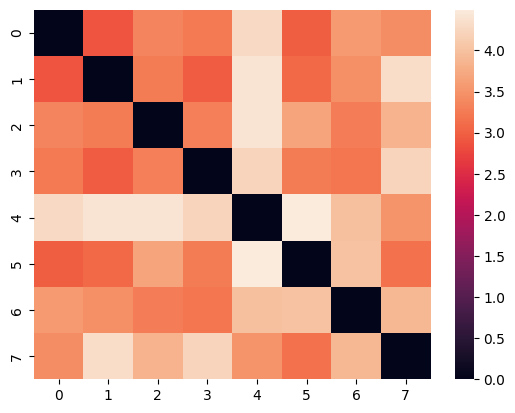

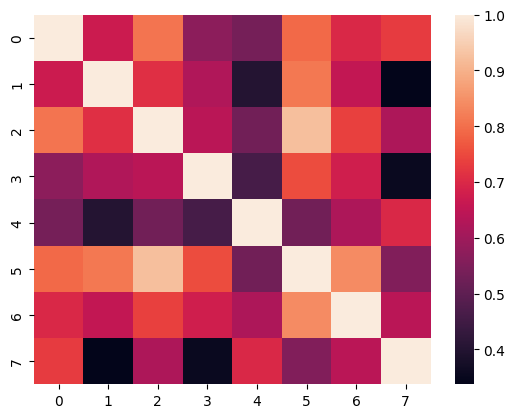

In [169]:
save_dir_truth = './results_HCP_202311_no_mean/HMM_ICA_25_state_8/'
covariances_truth = np.load(f'{save_dir_truth}state_covariances.npy')
correlations_truth = np.load(f'{save_dir_truth}state_correlations.npy')
print(f'covariances ground truth shape: {covariances_truth.shape}')
print(f'correlations_truth shape: {correlations_truth.shape}')
riemannian_truth = twopair_riemannian_distance(covariances_truth,covariances_truth)
fisher_z_truth = twopair_fisher_z_transformed_correlation(correlations_truth,correlations_truth)
seaborn.heatmap(riemannian_truth)
plt.show()
seaborn.heatmap(fisher_z_truth)
plt.show()

then read the model fitting (HMM_ICA_25_state_8)

In [170]:
save_dir_fit ='./results_simulation_202311_toy_9/HMM_ICA_25_state_8/'

covariances fit shape: (8, 25, 25)
correlations fit shape: (8, 25, 25)


Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 681.72it/s]
Compute twopair Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 50


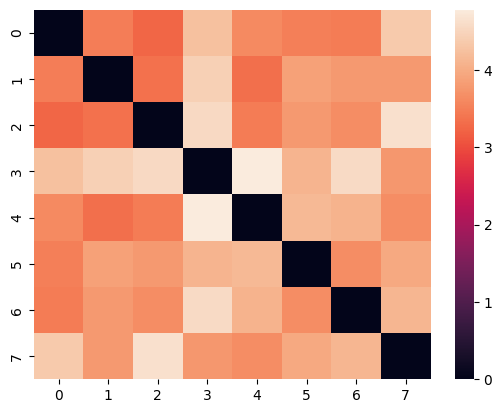

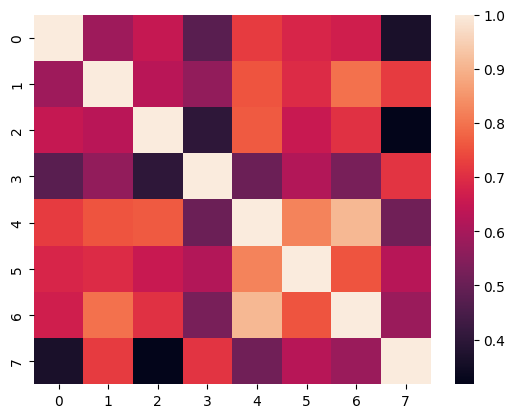

In [171]:
covariances_fit = np.load(f'{save_dir_fit}state_covariances.npy')
correlations_fit = np.load(f'{save_dir_fit}state_correlations.npy')
print(f'covariances fit shape: {covariances_fit.shape}')
print(f'correlations fit shape: {correlations_fit.shape}')
riemannian_fit = twopair_riemannian_distance(covariances_fit,covariances_fit)
fisher_z_fit = twopair_fisher_z_transformed_correlation(correlations_fit,correlations_fit)
seaborn.heatmap(riemannian_fit)
plt.show()
seaborn.heatmap(fisher_z_fit)
plt.show()

At least, the within-model distance/similarity distribution are similar.
Now try to pair them!

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 720.35it/s]


[[1.163 3.347 3.119 4.247 3.421 3.345 3.327 4.34 ]
 [3.356 1.226 3.121 4.355 3.152 3.706 3.545 3.588]
 [3.081 3.12  1.264 4.543 3.225 3.639 3.523 4.51 ]
 [4.222 4.341 4.39  1.298 4.625 3.869 4.339 3.702]
 [3.485 3.201 3.378 4.678 1.366 4.053 3.962 3.515]
 [3.327 3.76  3.614 4.184 4.12  1.155 3.413 4.052]
 [3.42  3.607 3.412 4.615 3.867 3.519 1.252 4.134]
 [4.27  3.691 4.459 3.622 3.385 3.847 3.892 1.439]]


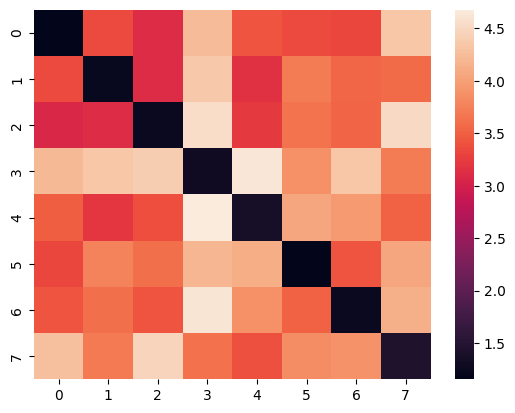

In [172]:
riemannian_fit_truth = twopair_riemannian_distance(covariances_fit,covariances_truth)
_,riemannian_fit_truth_reorder = hungarian_pair(riemannian_fit_truth,distance=True)
print(riemannian_fit_truth_reorder)
seaborn.heatmap(riemannian_fit_truth_reorder)
plt.show()

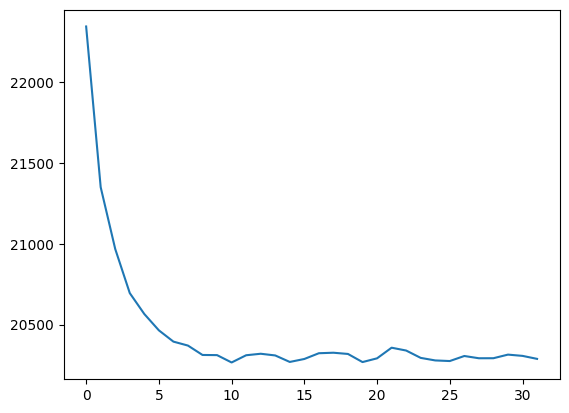

In [141]:
loss_history = np.load(f'{save_dir_fit}loss_history.npy')
plt.plot(loss_history)

I should say the model recover the majority of states quite well! So we can confirm that the model training on simulation is successful.

### Step 2: Compare across different number of states

#### Question 1: Has training converged?

In [165]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

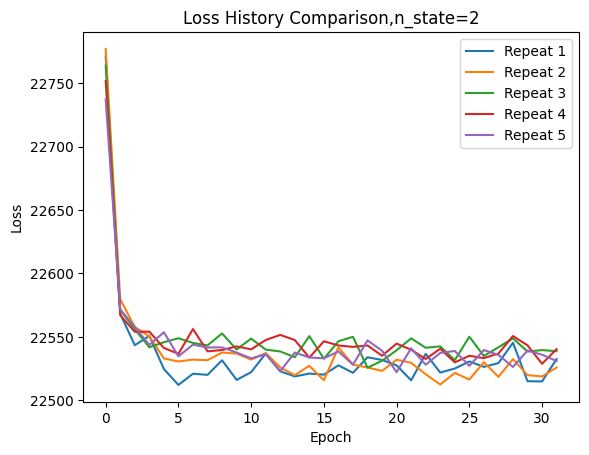

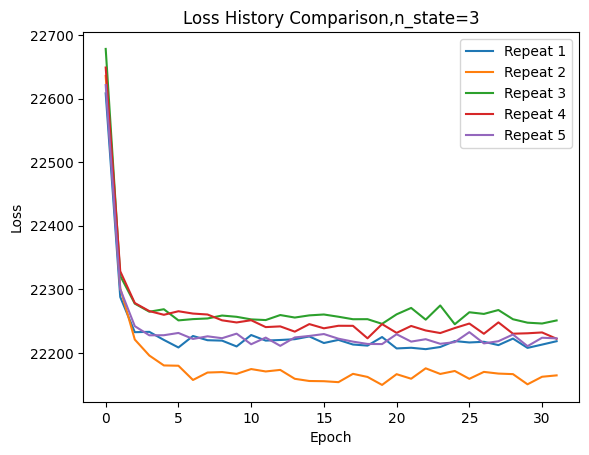

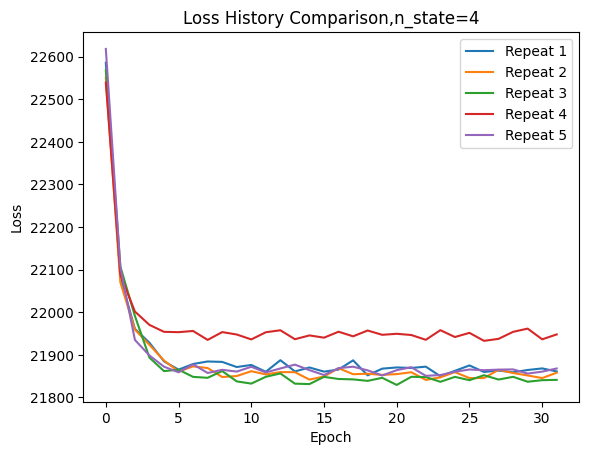

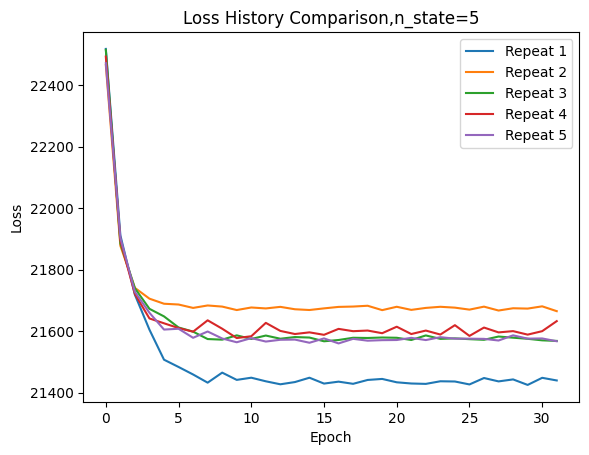

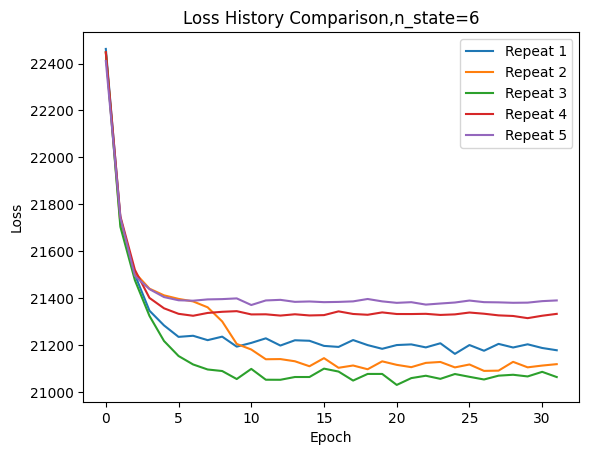

...

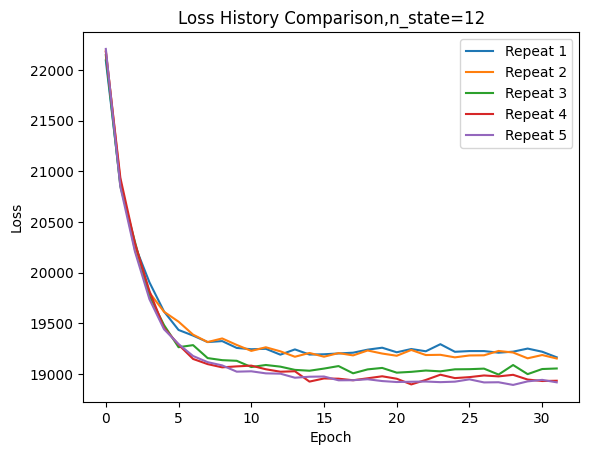

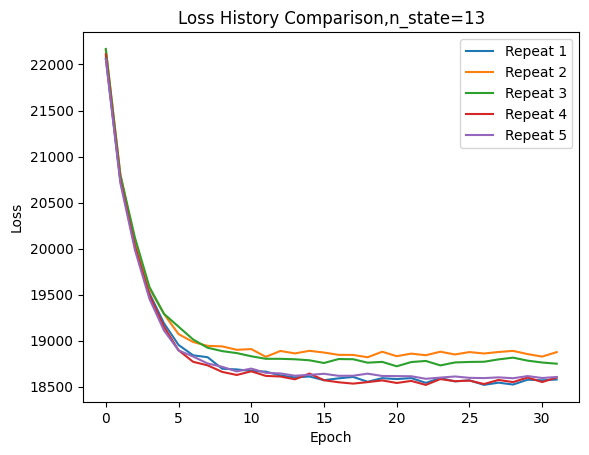

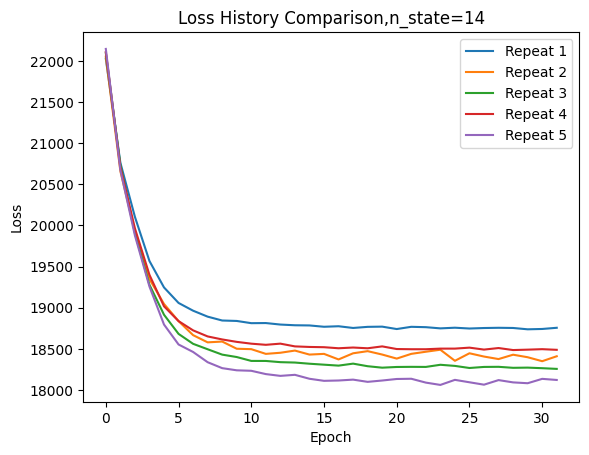

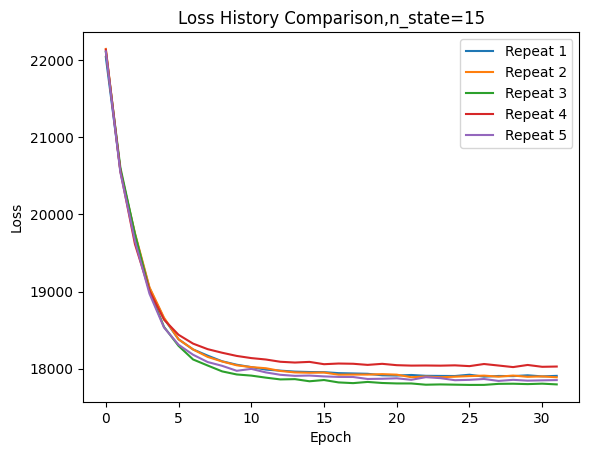

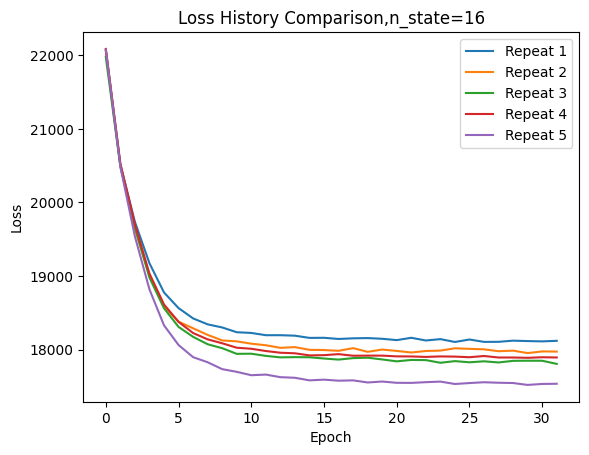

In [167]:
save_dir = './results_simulation_202311_toy_12/'
n_states = [2,3,4,5,6,7,8,9,10,11,12,13,14,15,16]
for n_state in n_states:
    for i in range(1, 6):
        # Load the numpy array from each file
        file_path = f"repeat_{i}/loss_history.npy"
        loss_history = np.load(f'{save_dir}HMM_ICA_25_state_{n_state}/repeat_{i}/loss_history.npy')

        # Plot the loss history
        plt.plot(loss_history, label=f'Repeat {i}')

    # Add labels and title
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title(f'Loss History Comparison,n_state={n_state}')
    plt.legend()  # Add legend to differentiate between repeat runs

    # Show the plot
    plt.show()

#### Question 2: Do these states all look very similar to each other?

Note here we should make use of the original './results_simulation_202311_toy_6'

In [147]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn
from rotation.utils import twopair_fisher_z_transformed_correlation, twopair_riemannian_distance

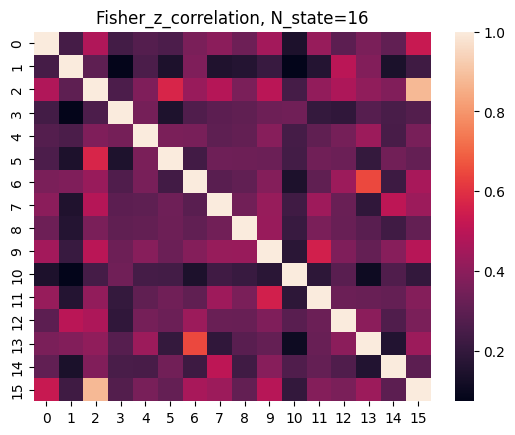

In [149]:
save_dir = './results_simulation_202311_toy_12/'
n_states = [16]#[2,3,4,5,6,7,8,9,10,11,12,13,14,15,16]
for n_state in n_states:
    fisher_z_correlation_cor = np.load(f'{save_dir}HMM_ICA_25_state_{n_state}/distance/fisher_z_correlation_cor.npy')
    seaborn.heatmap(fisher_z_correlation_cor)
    plt.title(f'Fisher_z_correlation, N_state={n_state}')
    plt.show()

Conclusion: These states do not look similar to each other. The model training across all n_states is successful.

#### Question 3: How does free energy change with respect to training data? (No validation involved).

In [150]:
from rotation.analysis import comparison_analysis

In [174]:
models = ['HMM']
list_channels = [25,100,200]
list_states = [2,3,4,5,6,7,8,9,10,11,12,13,14,15,16]
result_dir = './results_HCP_202312_no_mean/'
save_dir = './results_HCP_202312_no_mean/comparison/'
comparison_analysis(models,list_channels,list_states,result_dir,save_dir)

FileNotFoundError: [Errno 2] No such file or directory: './results_HCP_202312_no_mean/HMM_ICA_25_state_2/cross_validation_0/validation/metrics.json'

#### Step 9: Simulate a slightly more complicated case.

There are two subjects '10001.txt','10002.txt'. Their covariances are perturbation from the ground truth './results_HCP_202311_no_mean'. We aim to generate these two subjects first and compare their state covariances.

Ask ChatGPT how to do some perturbation on the covariance matrices first

In [163]:
import numpy as np

# Assuming cov_matrix is your original covariance matrix
cov_matrix = np.array([[1.0, 0.5, 0.3],
                      [0.5, 2.0, 0.2],
                      [0.3, 0.2, 0.8]])

# Define a small perturbation factor (adjust as needed)
perturbation_factor = 0.01

# Generate a random perturbation matrix
perturbation_matrix = np.random.normal(0, perturbation_factor, cov_matrix.shape)

# Add the perturbation to the original covariance matrix
perturbed_cov_matrix = cov_matrix + perturbation_matrix

# Ensure the resulting matrix is still positive definite (optional)
perturbed_cov_matrix = np.dot(perturbed_cov_matrix, perturbed_cov_matrix.T) 

print("Original Covariance Matrix:")
print(cov_matrix)
print("\nPerturbed Covariance Matrix:")
print(perturbed_cov_matrix)


Original Covariance Matrix:
[[1.  0.5 0.3]
 [0.5 2.  0.2]
 [0.3 0.2 0.8]]

Perturbed Covariance Matrix:
[[1.348 1.557 0.635]
 [1.557 4.272 0.738]
 [0.635 0.738 0.772]]


In [158]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn
from rotation.utils import cov2stdcor, twopair_riemannian_distance, twopair_fisher_z_transformed_correlation

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 426.60it/s]


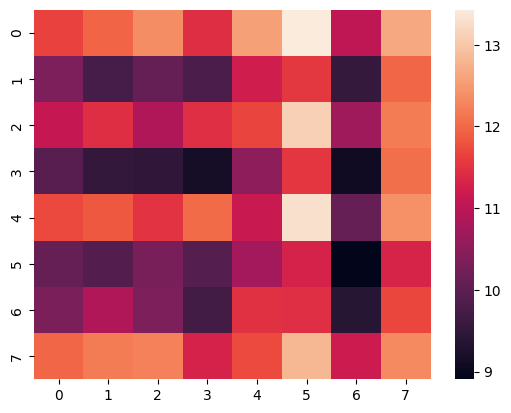

In [164]:
data_dir = './data/node_timeseries/simulation_toy_12/'
covariances = np.load('./results_HCP_202311_no_mean/HMM_ICA_25_state_8/state_covariances.npy')
covariances_1 = np.load(f'{data_dir}10001_state_covariances.npy')
covariances_2 = np.load(f'{data_dir}10002_state_covariances.npy')

#seaborn.heatmap(twopair_riemannian_distance(covariances,covariances))
#plt.show()
#seaborn.heatmap(twopair_riemannian_distance(covariances_1,covariances_1))
#plt.show()
#seaborn.heatmap(twopair_riemannian_distance(covariances_2,covariances_2))
#plt.show()
seaborn.heatmap(twopair_riemannian_distance(covariances_1,covariances_2))
plt.show()
#print(twopair_riemannian_distance(covariances_1,covariances_2))
#stds_1, correlations_1 = cov2stdcor(covariances_1)
#stds_2, correlations_2 = cov2stdcor(covariances_2)
#seaborn.heatmap(twopair_fisher_z_transformed_correlation(correlations_1,correlations_2))
#plt.show()
#print(f'stds_1: {stds_1}')
#print(f'stds_2: {stds_2}')

#### Step 6: Understand different components of free energy 

In [3]:
import pathlib
from osl_dynamics.models import load
from rotation.preprocessing import PrepareData
model = load('./results_simulation_202311_toy_6/HMM_ICA_25_state_2')
data_dir = pathlib.Path('./data/node_timeseries/simulation_toy_6/')
prepare_data = PrepareData(data_dir)
subj, dataset = prepare_data.load(z_score_data=False)
free_energy = model.free_energy(dataset)
evidence = model.evidence(dataset)
print(f'free energy: {free_energy}, evidence: {evidence}')

2023-12-12 17:41:09 INFO osl-dynamics [mod_base.py:589:load]: Loading model: ./results_simulation_202311_toy_6/HMM_ICA_25_state_2


Read from directory:  data/node_timeseries/simulation_toy_6
Number of subjects:  1


Loading files: 100%|███████████████████████| 100/100 [00:00<00:00, 19400.11it/s]
2023-12-12 17:41:11 INFO osl-dynamics [hmm.py:1105:free_energy]: Getting free energy


batch size: 64
log likelihood: -1204573.6141823456
entropy: -3398.9551675731
prior: -7956.800133308694
batch size: 64
log likelihood: -1211393.6685237056
entropy: -3685.379136066971
prior: -8470.877153165018
batch size: 64
log likelihood: -1225209.2512716432
entropy: -3676.6515730986484
prior: -8587.43910372143


2023-12-12 17:41:12 INFO osl-dynamics [hmm.py:1155:evidence]: Getting model evidence


batch size: 8
log likelihood: -152295.15767775595
entropy: -441.871216345985
prior: -1039.9540452404765
Batch 1/4
600/600 [==============================] - 14s 24ms/step
Batch 2/4
600/600 [==============================] - 13s 22ms/step
Batch 3/4
600/600 [==============================] - 13s 22ms/step
Batch 4/4
600/600 [==============================] - 13s 22ms/step
free energy: 19056.939799001382, evidence: -19055.842126217503


This result is important because it tells us the main component of free energy should be log-likelihood. At least empirically.

In [2]:
10000 / 1166990

0.008569053719397767

#### Step 3: Understand the intuitive relationship between free energy, temporal_dynamics and n_states

Let's have a look at HMM_ICA_25_state_16 from './results_simulation_202311_toy_6', which have the largest number of states, smallest free energy and not very good split-half reproducibility.

In [1]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn
from rotation.utils import *

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [4]:
save_dir_truth = './results_HCP_202311_no_mean/HMM_ICA_25_state_8/'
save_dir_1 = './results_simulation_202311_toy_6/HMM_ICA_25_state_8/'
save_dir_2 = './results_simulation_202311_toy_6/HMM_ICA_25_state_16/'

Question 1: Does the split-half models recover the underlying ground truth successfully?

In [5]:
covariances_truth = np.load(f'{save_dir_truth}state_covariances.npy')

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 527.17it/s]


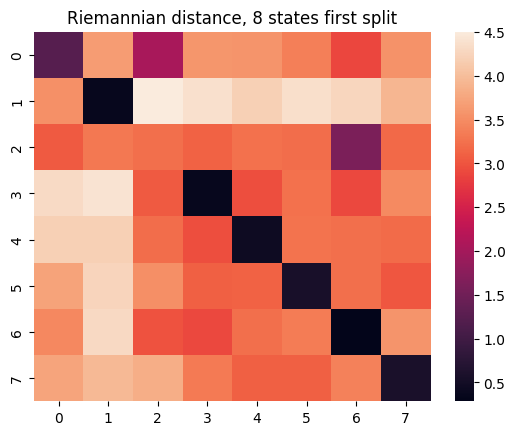

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 734.46it/s]


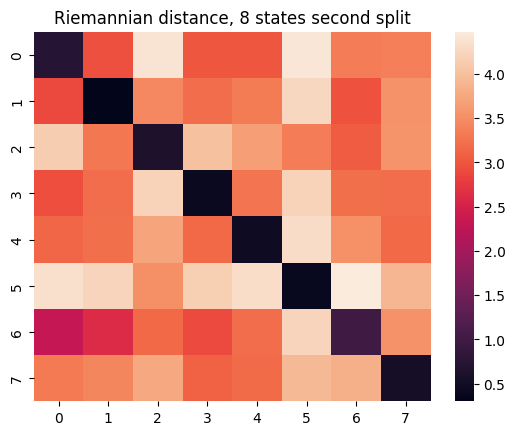

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 675.36it/s]


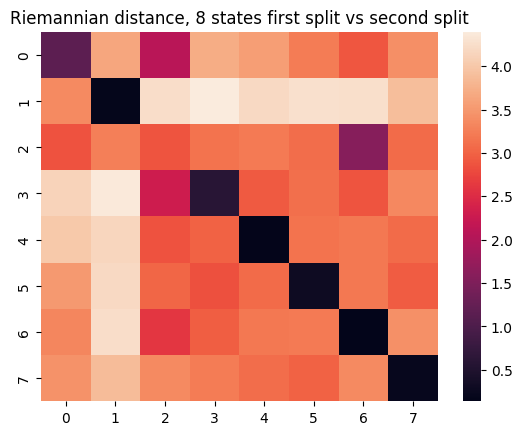

In [12]:
covariances_fit_1_first_half = np.load(f'{save_dir_1}split_1_first_half/state_covariances.npy')
covariances_fit_1_second_half = np.load(f'{save_dir_1}split_1_second_half/state_covariances.npy')

riem_fit_1_first = twopair_riemannian_distance(covariances_truth, covariances_fit_1_first_half)
index_fit_1_first, riem_fit_1_first_reorder = hungarian_pair(riem_fit_1_first,distance=True)
seaborn.heatmap(riem_fit_1_first_reorder)
plt.title('Riemannian distance, 8 states first split')
plt.show()

riem_fit_1_second = twopair_riemannian_distance(covariances_truth, covariances_fit_1_second_half)
index_fit_1_second, riem_fit_1_second_reorder = hungarian_pair(riem_fit_1_second,distance=True)
seaborn.heatmap(riem_fit_1_second_reorder)
plt.title('Riemannian distance, 8 states second split')
plt.show()

riem_fit_1_first_second = twopair_riemannian_distance(covariances_fit_1_first_half, covariances_fit_1_second_half)
index_fit_1_first_second, riem_fit_1_first_second_reorder = hungarian_pair(riem_fit_1_first_second,distance=True)
seaborn.heatmap(riem_fit_1_first_second_reorder)
plt.title('Riemannian distance, 8 states first split vs second split')
plt.show()

Conclusion: For HMM_ICA_25_state_8, 7/8 states are recovered in split 1, 8/8 states are recovered in split 1, which gives us further confidence that these states are recovered very successfully

The second question: what about state = 16 case?

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 313.70it/s]


riem_fit_2_first shape: (8, 16)
index fit_2_first: {'row': [0, 1, 2, 3, 4, 5, 6, 7], 'col': [7, 8, 13, 11, 9, 0, 10, 4]}
riem_fit_2_first_reorder_shape: (8, 8)


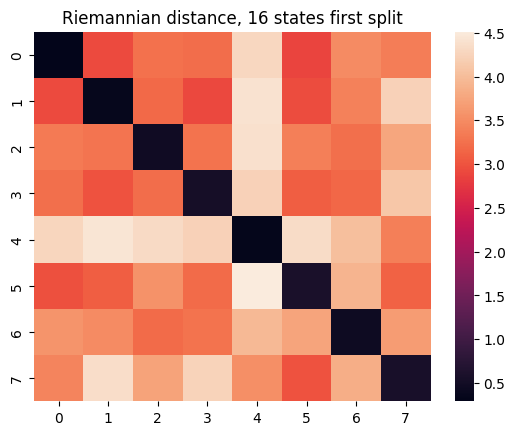

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 370.96it/s]


{'row': [0, 1, 2, 3, 4, 5, 6, 7], 'col': [4, 5, 8, 13, 10, 11, 6, 1]}


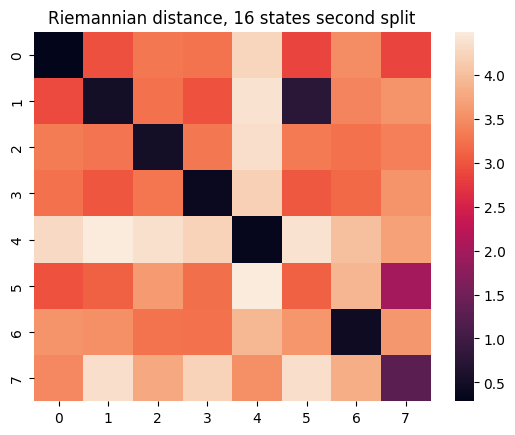

Computing Riemannian distances: 100%|██████████| 16/16 [00:00<00:00, 316.14it/s]


index_fit_2_first_second: {'row': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15], 'col': [1, 0, 7, 3, 14, 2, 9, 4, 5, 10, 6, 13, 15, 8, 11, 12]}


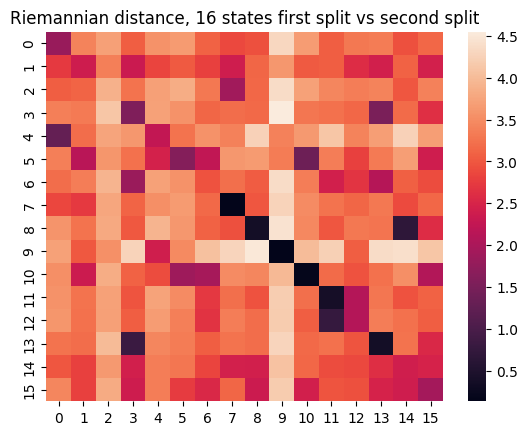

In [18]:
covariances_fit_2_first_half = np.load(f'{save_dir_2}split_1_first_half/state_covariances.npy')
covariances_fit_2_second_half = np.load(f'{save_dir_2}split_1_second_half/state_covariances.npy')

riem_fit_2_first = twopair_riemannian_distance(covariances_truth, covariances_fit_2_first_half)
print(f'riem_fit_2_first shape: {riem_fit_2_first.shape}')
index_fit_2_first, riem_fit_2_first_reorder = hungarian_pair(riem_fit_2_first,distance=True)
print(f'index fit_2_first: {index_fit_2_first}')
print(f'riem_fit_2_first_reorder_shape: {riem_fit_2_first_reorder.shape}')
seaborn.heatmap(riem_fit_2_first_reorder)
plt.title('Riemannian distance, 16 states first split')
plt.show()

riem_fit_2_second = twopair_riemannian_distance(covariances_truth, covariances_fit_2_second_half)
index_fit_2_second, riem_fit_2_second_reorder = hungarian_pair(riem_fit_2_second,distance=True)
print(index_fit_2_second)
seaborn.heatmap(riem_fit_2_second_reorder)
plt.title('Riemannian distance, 16 states second split')
plt.show()

riem_fit_2_first_second = twopair_riemannian_distance(covariances_fit_2_first_half, covariances_fit_2_second_half)
index_fit_2_first_second, riem_fit_2_first_second_reorder = hungarian_pair(riem_fit_2_first_second,distance=True)
print(f'index_fit_2_first_second: {index_fit_2_first_second}')
seaborn.heatmap(riem_fit_2_first_second_reorder)
plt.title('Riemannian distance, 16 states first split vs second split')
plt.show()

Conclusion: When n_state = 16. It seems that these the original 8 states are recovered very successfully.
OK, please take a note on the state indexes:
HMM_ICA_25_state_16: first split (7,8,13,11,9,0,10,4)
HMM_ICA_25_state_16: second split (4,5,8,13,10,11,6,1)

Question 2: temporal dynamics on these states?
Hypothesis: only the states "matched" well with ground truth should be activated.

In [20]:
fo_fit_2_first_half = np.load(f'{save_dir_2}split_1_first_half/fo.npy')
fo_fit_2_second_half = np.load(f'{save_dir_2}split_1_second_half/fo.npy')

In [23]:
np.mean(fo_fit_2_first_half,axis=0)

array([0.11555   , 0.00206667, 0.0066    , 0.0091    , 0.11955   ,
       0.00991667, 0.00348333, 0.17053333, 0.1189    , 0.12525   ,
       0.11045   , 0.07183333, 0.03326667, 0.10001667, 0.0017    ,
       0.00178333])

In [26]:
np.set_printoptions(suppress=True,precision=3)
np.mean(fo_fit_2_second_half,axis=0)

array([0.001, 0.245, 0.001, 0.011, 0.18 , 0.076, 0.132, 0.   , 0.1  ,
       0.   , 0.089, 0.022, 0.   , 0.139, 0.003, 0.   ])

Conclusion: states not paired well are not utilised. But please note that they contribute to the overall calculation of free energy even if they are not used.

Question -1: How do we implement cross-validation?
We can "pair" these states and pretend that our paired states are the same!

In [31]:
import pathlib
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn
from rotation.preprocessing import PrepareData
from osl_dynamics.models import load

2023-12-13 15:41:03.150356: I tensorflow/core/util/util.cc:169] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-12-13 15:41:04.347466: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2023-12-13 15:41:04.347495: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


In [30]:
data_dir = pathlib.Path('./data/node_timeseries/simulation_toy_6/')
prepare_data = PrepareData(data_dir)
subj, dataset_1, dataset_2 = prepare_data.load(z_score_data=False,split_strategy='1')

Read from directory:  data/node_timeseries/simulation_toy_6
Number of subjects:  1


Loading files: 100%|█████████████████████████| 50/50 [00:00<00:00, 14672.58it/s]


In [33]:
model_1_first_half = load(f'{save_dir_1}split_1_first_half/')
model_1_second_half = load(f'{save_dir_1}split_1_second_half/')

2023-12-13 15:44:15 INFO osl-dynamics [mod_base.py:607:load]: Loading model: ./results_simulation_202311_toy_6/HMM_ICA_25_state_8/split_1_first_half/
2023-12-13 15:44:17.886558: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory
2023-12-13 15:44:17.886614: W tensorflow/stream_executor/cuda/cuda_driver.cc:269] failed call to cuInit: UNKNOWN ERROR (303)
2023-12-13 15:44:17.886637: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (win002.hpc.in.bmrc.ox.ac.uk): /proc/driver/nvidia/version does not exist
2023-12-13 15:44:17.975773: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in

In [36]:
np.sum(covariances_fit_1_first_half!=model_1_first_half.get_covariances())

0

In [37]:
print(index_fit_1_first_second)

{'row': [0, 1, 2, 3, 4, 5, 6, 7], 'col': [2, 5, 6, 0, 3, 4, 1, 7]}


In [41]:
covariances_fit_1_second_half_pair = covariances_fit_1_second_half[index_fit_1_first_second['col']]

In [43]:
print(model_1_first_half.free_energy(dataset_1))
print(model_1_first_half.free_energy(dataset_1,covariances=covariances_fit_1_second_half_pair))

2023-12-13 15:55:30 INFO osl-dynamics [hmm.py:1109:free_energy]: Getting free energy
2023-12-13 15:55:34 INFO numba.core.transforms [transforms.py:58:_extract_loop_lifting_candidates]: finding looplift candidates
2023-12-13 15:55:38 INFO osl-dynamics [hmm.py:1109:free_energy]: Getting free energy


18470.062918814518
18532.93638736665


Maybe work on the model with more number of states?

In [44]:
model_2_first_half = load(f'{save_dir_2}split_1_first_half/')
model_2_second_half = load(f'{save_dir_2}split_1_second_half/')
covariances_fit_2_second_half_pair = covariances_fit_2_second_half[index_fit_2_first_second['col']]
print(model_2_first_half.free_energy(dataset_1))
print(model_2_first_half.free_energy(dataset_1,covariances=covariances_fit_2_second_half_pair))

2023-12-13 15:58:04 INFO osl-dynamics [mod_base.py:607:load]: Loading model: ./results_simulation_202311_toy_6/HMM_ICA_25_state_16/split_1_first_half/
2023-12-13 15:58:05 INFO osl-dynamics [mod_base.py:607:load]: Loading model: ./results_simulation_202311_toy_6/HMM_ICA_25_state_16/split_1_second_half/
2023-12-13 15:58:06 INFO osl-dynamics [hmm.py:1109:free_energy]: Getting free energy
2023-12-13 15:58:09 INFO osl-dynamics [hmm.py:1109:free_energy]: Getting free energy


18389.61165836891
18594.25057721719


In [50]:
save_dir_3 = './results_simulation_202311_toy_6/HMM_ICA_25_state_14/'
model_3_first_half = load(f'{save_dir_3}split_1_first_half/')
model_3_second_half = load(f'{save_dir_3}split_1_second_half/')
covariances_fit_3_first_half = np.load(f'{save_dir_3}split_1_first_half/state_covariances.npy')
covariances_fit_3_second_half = np.load(f'{save_dir_3}split_1_second_half/state_covariances.npy')
riem_fit_3_first_second = twopair_riemannian_distance(covariances_fit_3_first_half, covariances_fit_3_second_half)
index_fit_3_first_second, riem_fit_3_first_second_reorder = hungarian_pair(riem_fit_3_first_second,distance=True)


covariances_fit_3_second_half_pair = covariances_fit_3_second_half[index_fit_3_first_second['col']]
print(model_3_first_half.free_energy(dataset_1))
print(model_3_first_half.free_energy(dataset_1,covariances=covariances_fit_3_second_half_pair))

2023-12-13 16:31:11 INFO osl-dynamics [mod_base.py:607:load]: Loading model: ./results_simulation_202311_toy_6/HMM_ICA_25_state_14/split_1_first_half/
2023-12-13 16:31:12 INFO osl-dynamics [mod_base.py:607:load]: Loading model: ./results_simulation_202311_toy_6/HMM_ICA_25_state_14/split_1_second_half/
Computing Riemannian distances: 100%|██████████| 14/14 [00:00<00:00, 461.67it/s]
2023-12-13 16:31:13 INFO osl-dynamics [hmm.py:1109:free_energy]: Getting free energy
2023-12-13 16:31:16 INFO osl-dynamics [hmm.py:1109:free_energy]: Getting free energy


18391.97746429379
18453.210000027982


### Update 14th Dec 2023

### Task: visualisation of spatial maps (Using CIFTI data)

First of all, have a try on Chet's code.

In [70]:
!mkdir visualisation

In [79]:
!pip install osfclient

^C
ERROR: Operation cancelled by user


In [75]:
import os
from osl_dynamics.analysis import power, workbench

In [76]:
def get_data(name, output_dir):
    if os.path.exists(output_dir):
        print(f"{output_dir} already downloaded. Skipping..")
        return
    os.system(f"osf -p by2tc fetch trained_models/{name}.zip")
    os.system(f"unzip -o {name}.zip -d {output_dir}")
    os.remove(f"{name}.zip")
    print(f"Data downloaded to: {output_dir}")

In [78]:
get_data("ae-hmm_notts_rest_55_subj", output_dir='visualisation/MEG')

sh: osf: command not found
unzip:  cannot find or open ae-hmm_notts_rest_55_subj.zip, ae-hmm_notts_rest_55_subj.zip.zip or ae-hmm_notts_rest_55_subj.zip.ZIP.


FileNotFoundError: [Errno 2] No such file or directory: 'ae-hmm_notts_rest_55_subj.zip'

### Update 18th Dec 2023

In this part, we try direct rendering of volume-based results.

In [8]:
!module load ConnectomeWorkbench

In [1]:
import os
from osl_dynamics.analysis.workbench import render


/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [9]:
print(os.environ["PATH"])

/apps/eb/2020b/skylake/software/Anaconda3/2022.05:/apps/eb/2020b/skylake/software/Anaconda3/2022.05/sbin:/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/bin:/well/win/software/packages/fsl/5.0.11/bin:/mgmt/uge/8.6.8/bin/lx-amd64:/opt/TurboVNC/bin:/apps/eb/2020b/skylake/software/Anaconda3/2022.05/condabin:/mgmt/uge/8.6.8/bin/lx-amd64:/usr/local/bin:/bin:/usr/bin:/usr/local/sbin:/usr/sbin:/usr/lpp/mmfs/bin:/opt/ibutils/bin:/users/win-fmrib-analysis/uap971/.local/bin:/users/win-fmrib-analysis/uap971/bin:/usr/lpp/mmfs/bin:/users/win-fmrib-analysis/uap971/.local/bin:/users/win-fmrib-analysis/uap971/bin


In [10]:
import subprocess
process = subprocess.Popen("module load ConnectomeWorkbench", shell=True, stdout=subprocess.PIPE, stderr=subprocess.PIPE)

In [11]:
print(os.environ["PATH"])

/apps/eb/2020b/skylake/software/Anaconda3/2022.05:/apps/eb/2020b/skylake/software/Anaconda3/2022.05/sbin:/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/bin:/well/win/software/packages/fsl/5.0.11/bin:/mgmt/uge/8.6.8/bin/lx-amd64:/opt/TurboVNC/bin:/apps/eb/2020b/skylake/software/Anaconda3/2022.05/condabin:/mgmt/uge/8.6.8/bin/lx-amd64:/usr/local/bin:/bin:/usr/bin:/usr/local/sbin:/usr/sbin:/usr/lpp/mmfs/bin:/opt/ibutils/bin:/users/win-fmrib-analysis/uap971/.local/bin:/users/win-fmrib-analysis/uap971/bin:/usr/lpp/mmfs/bin:/users/win-fmrib-analysis/uap971/.local/bin:/users/win-fmrib-analysis/uap971/bin


In [3]:
nii = './results_HCP_202311_no_mean/HMM_ICA_25_state_8/FC_map.nii.gz'
save_dir = './visualisation_1/'
render(nii,save_dir,gui=False,inflation=0,image_name='./visualisation_1/mid_thickness')
render(nii,save_dir,gui=False,inflation=1,image_name='./visualisation_1/inflated')
render(nii,save_dir,gui=False,inflation=2,image_name='./visualisation_1/very_inflated')

Saving images: 100%|██████████████████████████████| 8/8 [00:09<00:00,  1.16s/it]


In [4]:
nii = './results_HCP_202311_no_mean/HMM_ICA_25_state_8/FC_surface_map.dscalar.nii'
save_dir = './visualisation_2/'
render(nii,save_dir,gui=False,inflation=0,image_name='./visualisation_2/mid_thickness',input_cifti=True)
render(nii,save_dir,gui=False,inflation=1,image_name='./visualisation_2/inflated',input_cifti=True)
render(nii,save_dir,gui=False,inflation=1,image_name='./visualisation_2/very_inflated',input_cifti=True)

Saving images: 100%|██████████████████████████████| 8/8 [00:09<00:00,  1.20s/it]


## Update 20th January 2024

This week we implement ten runs of ten subjects with different subject variability level $\sigma = \{0.025,0.05,0.075,0.1\}$. This would require a substantial amount of work! To start with, look at your data! i.e. do we have the expected subject variability level?

In [7]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn
%matplotlib inline
from rotation.utils import twopair_riemannian_distance

So first import the original unperturbed ground-truth Riemannian distance.

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 498.17it/s]


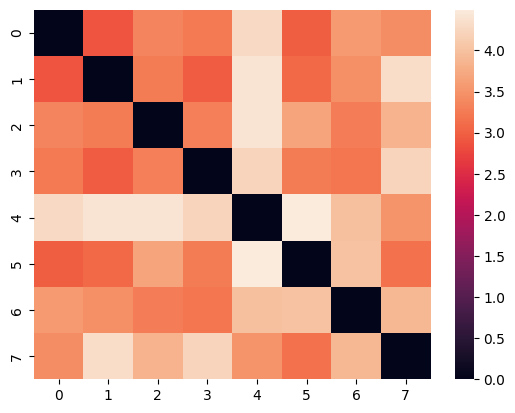

In [5]:
true_covariance = np.load('./results_HCP_202311_no_mean/HMM_ICA_25_state_8/state_covariances.npy')
seaborn.heatmap(twopair_riemannian_distance(true_covariance,true_covariance))
plt.show()

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 523.18it/s]


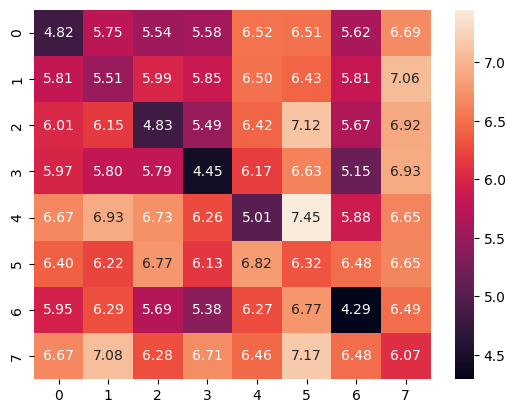

In [11]:
data_dir = './data/node_timeseries/simulation_202401/sigma_0.1/run_1/'
for i in range(10001,10002):
    for j in range(i+1,10003):
        covariance_1 = np.load(f'{data_dir}{i}_state_covariances.npy')
        covariance_2 = np.load(f'{data_dir}{j}_state_covariances.npy')
        riem = twopair_riemannian_distance(covariance_1,covariance_2)
        seaborn.heatmap(riem,annot=True,fmt='.2f')
        plt.show()

Now the second step is to see whether only run_1 works. So with run_1, have a look at the split-half reproducibility and goodness of fit. (Just to run comparison analysis)

In [1]:
from rotation.analysis import comparison_analysis

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [6]:
models =['HMM']
list_channels = [25,200,300]
list_states = [2,3,4,5,6,7,8,9,10,11,12,13,14,15,16]
result_dir = './results_simulation_202401/sigma_0.05/run_4/'
save_dir = f'{result_dir}/plot/'
comparison_analysis(models,list_channels,list_states,result_dir, save_dir)

Now we write the code to average across five runs (also add error bars).

In [25]:
import json
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import os

save_dir = './results_simulation_202401/'
plot_dir = f'{save_dir}summary_plot/'
if not os.path.exists(plot_dir):
    os.makedirs(plot_dir)
    
list_states = [2,3,4,5,6,7,8,9,10,11,12,13,14,15,16]
sigma = 0.1
split_half_correlation = {}
split_half_riem = {}
for state in list_states:
    split_half_correlation[f'state_{state}'] = []
    split_half_riem[f'state_{state}'] = []
    for i in range(1,6):
        correlation = np.load(f'{save_dir}sigma_{sigma}/run_{i}/HMM_ICA_25_state_{state}/reproduce_analysis/FCs_fisher_correlation_reorder_split_1.npy')
        riem = np.load(f'{save_dir}sigma_{sigma}/run_{i}/HMM_ICA_25_state_{state}/reproduce_analysis/FCs_distance_reorder_split_1.npy')
        split_half_correlation[f'state_{state}'].append(np.mean(np.diagonal(correlation)))
        split_half_riem[f'state_{state}'].append(np.mean(np.diagonal(riem)))

plt.figure(figsize=(10, 6))

bar_width = 0.15
colors = plt.cm.viridis(np.linspace(0, 1, len(list_states)))

means = [np.mean(split_half_correlation[f'state_{state}']) for state in range(2, 17)]
stds = [np.std(split_half_correlation[f'state_{state}']) for state in range(2, 17)]
plt.bar(list_states, means, yerr=stds, capsize=5, align='center', alpha=0.7)
plt.xticks(list_states,fontsize=15)
plt.yticks(fontsize=15)
plt.xlabel('Number of states',fontsize=20)
plt.ylabel('Mean Split-Half Correlation',fontsize=20)
plt.title(f'Split-half correlation,sigma_{sigma}',fontsize=25)
plt.tight_layout()
plt.savefig(f'{plot_dir}/sigma_{sigma}_Fisher_z_transformed_correlation_average.jpg')
plt.savefig(f'{plot_dir}/sigma_{sigma}_Fisher_z_transformed_correlation_average.pdf')
plt.close()

plt.figure(figsize=(10, 6))
bar_width = 0.15
colors = plt.cm.viridis(np.linspace(0, 1, len(list_states)))

means = [np.mean(split_half_riem[f'state_{state}']) for state in range(2, 17)]
stds = [np.std(split_half_riem[f'state_{state}']) for state in range(2, 17)]
plt.bar(list_states, means, yerr=stds, capsize=5, align='center', alpha=0.7)
plt.xticks(list_states,fontsize=15)
plt.yticks(fontsize=15)
plt.xlabel('Number of states',fontsize=20)
plt.ylabel('Mean Split-Half Riemannian distance',fontsize=20)
plt.title(f'Split-half Riemannian_distance,sigma_{sigma}',fontsize=25)
plt.tight_layout()
plt.savefig(f'{plot_dir}/sigma_{sigma}_Riemannian_distance_average.jpg')
plt.savefig(f'{plot_dir}/sigma_{sigma}_Riemannian_distance_average.pdf')
plt.close()

#plt.title(f'Comparison of {metric_name} by N_channels and N_states', fontsize=20)
#plt.xticks(np.arange(len(channel_keys)) + bar_width * (len(list_states) - 1) / 2,
#            [str(N_channels) for N_channels in list_channels], fontsize=15)
#plt.yticks(fontsize=15)
#plt.legend(prop={'size': 15})

#plt.savefig(f'{save_dir}{model_name}_{metric_name}_comparison.jpg')
#plt.savefig(f'{save_dir}{model_name}_{metric_name}_comparison.pdf')
#plt.close()

# Look at your data!

So first look at these states obtained from split_1 and split_2, and then compare against the ground truth. We start from sigma=0.025, and run_1. We should expect only 8 states.

In [11]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn
%matplotlib inline
from rotation.utils import *

In [12]:
ground_truth_dir = './results_HCP_202311_no_mean/HMM_ICA_25_state_8/'
ground_truth_FC = np.load(f'{ground_truth_dir}state_correlations.npy')

In [13]:
ground_truth_FC.shape

(8, 25, 25)

In [38]:
fit_dir = './results_simulation_202401/sigma_0.025/run_1/'
N_states = [2,3,4,5,6,7,8,9,10,11,12,13,14,15,16]
fit_FC = np.load(f'{fit_dir}HMM_ICA_25_state_{N_states[1]}/state_correlations.npy')

In [39]:
print(fit_FC.shape)

(3, 25, 25)


In [40]:
fit_FC_first = np.load(f'{fit_dir}HMM_ICA_25_state_{N_states[1]}/split_1_first_half/state_correlations.npy')
fit_FC_second = np.load(f'{fit_dir}HMM_ICA_25_state_{N_states[1]}/split_1_second_half/state_correlations.npy')

Compute twopair Fisher-z transformated correlation: 100%|█| 3/3 [00:00<00:00, 11


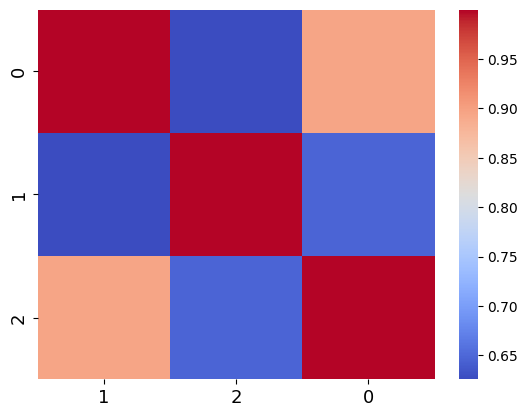

[0.99998476 0.99999353 0.99998682]


In [41]:
# Fisher-z transformated correlation
fit_FC_first_second = twopair_fisher_z_transformed_correlation(fit_FC_first,fit_FC_second)
FC_first_second_indices, fit_FC_first_second_reordered = hungarian_pair(fit_FC_first_second)
seaborn.heatmap(fit_FC_first_second_reordered, cmap="coolwarm")
plt.xticks(np.arange(len(FC_first_second_indices['col'])) + 0.5, FC_first_second_indices['col'], fontsize=13)
plt.yticks(np.arange(len(FC_first_second_indices['row'])) + 0.5, FC_first_second_indices['row'], fontsize=13)
plt.show()
print(np.diagonal(fit_FC_first_second_reordered))

Compute twopair Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 47
Compute twopair Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 29


[2 7 1 6 4 5 3 0]


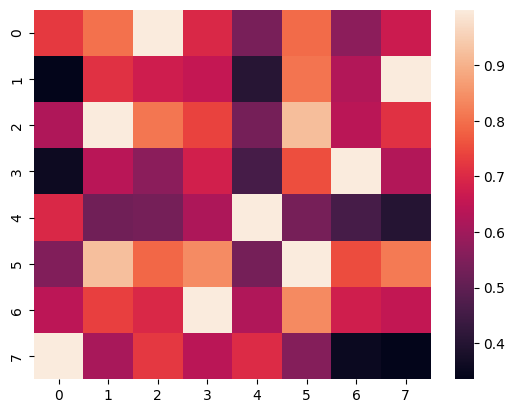

In [15]:
seaborn.heatmap(twopair_fisher_z_transformed_correlation(ground_truth_FC,fit_FC_second))
print(np.argmax(twopair_fisher_z_transformed_correlation(ground_truth_FC,fit_FC_second),axis=1))

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 698.58it/s]


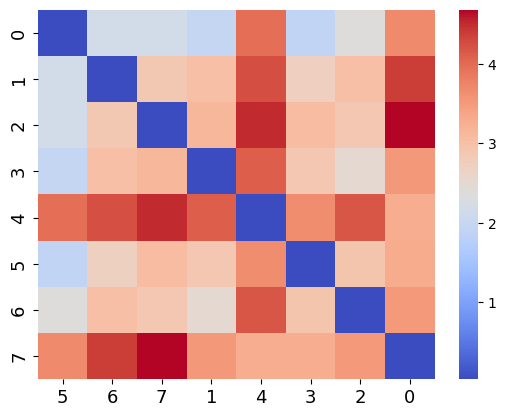

0.03947350199527376


In [16]:
# Riemannian distance
fit_riem_first_second = twopair_riemannian_distance(fit_FC_first,fit_FC_second)
riem_first_second_indices, fit_riem_first_second_reordered = hungarian_pair(fit_riem_first_second,distance=True)
seaborn.heatmap(fit_riem_first_second_reordered, cmap="coolwarm")
plt.xticks(np.arange(len(riem_first_second_indices['col'])) + 0.5, riem_first_second_indices['col'], fontsize=13)
plt.yticks(np.arange(len(riem_first_second_indices['row'])) + 0.5, riem_first_second_indices['row'], fontsize=13)
plt.show()
print(np.mean(np.diagonal(fit_riem_first_second_reordered)))

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 746.90it/s]


[2 7 1 6 4 5 3 0]


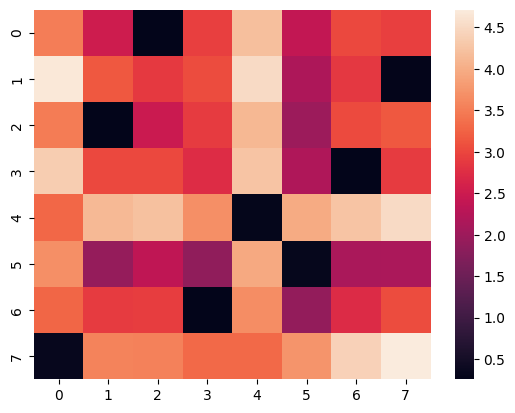

In [17]:
seaborn.heatmap(twopair_riemannian_distance(ground_truth_FC,fit_FC_second))
print(np.argmin(twopair_riemannian_distance(ground_truth_FC,fit_FC_second),axis=1))

The take-home message: there are actually 7/16 states fitted well when N_state = 16, and 8/8 states fitted well when N_state = 8. These states (7/16 and 8/8) correspond well with the ground truth. Now maybe look at the fractional occupancy?

In [62]:
fo = np.load(f'{fit_dir}HMM_ICA_25_state_{N_states[-1]}/fo.npy')
import pickle
with open(f'{fit_dir}HMM_ICA_25_state_{N_states[-1]}/alpha.pkl','rb') as file:
    alpha = pickle.load(file)

In [63]:
print(len(alpha))
print(len(fo))

1000
1000


Now answer: What's happending when the subject variability level is higher?
Short Answer: The optimal number of states still occur. But what happens to real data?


In [5]:
models =['HMM']
list_channels = [25,200,300]
list_states = [2,3,4,5,6,7,8,9,10,11,12,13,14]#,15,16,17,18,19,20]
result_dir = './results_HCP_202401/'
save_dir = f'{result_dir}/plot/'
comparison_analysis(models,list_channels,list_states,result_dir, save_dir)

FileNotFoundError: [Errno 2] No such file or directory: './results_HCP_202401/HMM_ICA_25_state_4/metrics_repeat.json'

In [6]:
from rotation.utils import *

In [8]:
models = ['HMM','Dynemo','MAGE','SWC']
list_channels = [15, 25, 50, 100, 200, 300]
list_states = [2,3,4,5,6,7,8,9,10,11,12,13,14,15,16]
index = 16
model,n_channels, n_states = parse_index(index,models,list_channels,list_states,training=True)

In [10]:
n_channels

25

### Now let's look at the temporal dynamics of our data

In [42]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn

## Update 31th January 2024

### Task 1: Understand the best training configurations of HMM model on real HCP data

Just check the loss function to see whether it converges.

In [27]:
import os
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [36]:
save_dir = './results_training_config_202402/'
sequence_lengths = [600,400,200,100,50,25]
batch_sizes = [1024,512,256,128,64,32]
learning_rates = [0.0005,0.001,0.005,0.01]

In [37]:
# Create a directory to save the plots
plot_dir = f'{save_dir}/loss_plots/'
os.makedirs(plot_dir, exist_ok=True)

for sl in sequence_lengths:
    n_cols = 2
    n_rows = (len(learning_rates) // n_cols)  # Ceiling division to get the number of rows
    
    plt.figure(figsize=(15, 6 * n_rows))

    for i, lr in enumerate(learning_rates, start=1):
        plt.subplot(n_rows, n_cols, i)
        
        # Iterate over each combination of batch size
        for bs in batch_sizes:
            # Skip the case where sequence_length=25 and batch_size=32
            if sl == 25 and bs == 32:
                continue
            
            # Load the loss history
            file_path = f'{save_dir}sl_{sl}_bs_{bs}_lr_{lr}/loss_history.npy'
            if os.path.exists(file_path):
                loss_history = np.load(file_path)
                epochs = np.arange(1, len(loss_history) + 1)

                # Plot the loss history
                plt.plot(epochs, loss_history, label=f'BS={bs}')

        # Customize subplot
        plt.title(f'Loss History for SL={sl}, LR={lr}')
        plt.xlabel('Epochs')
        plt.ylabel('Loss')
        plt.legend()
    
    # Adjust layout
    plt.tight_layout()

    # Save the plot
    plt.savefig(f'{plot_dir}loss_plots_sl_{sl}.jpg')
    plt.close()


Now choose the best ten training configurations.

In [41]:
results = []

# Iterate over each configuration
for sl in sequence_lengths:
    for lr in learning_rates:
        for bs in batch_sizes:
            
            # Load the loss history if available
            file_path = f'{save_dir}sl_{sl}_bs_{bs}_lr_{lr}/loss_history.npy'
            try:
                if os.path.exists(file_path):
                    loss_history = np.load(file_path)
                    normalized_loss = np.min(loss_history) / sl  # Normalize by sequence length

                    # Store the configuration and normalized loss
                    results.append({
                        'sequence_length': sl,
                        'batch_size': bs,
                        'learning_rate': lr,
                        'normalized_loss': normalized_loss
                    })
            except Exception as e:
                print(f"Error loading file {file_path}: {e}")
                continue

# Sort results by normalized loss in ascending order
results.sort(key=lambda x: x['normalized_loss'])

# Print the top 10 configurations
print("Top 10 Training Configurations:")
for i, result in enumerate(results[:10], start=1):
    print(f"{i}. Sequence Length: {result['sequence_length']}, Batch Size: {result['batch_size']}, "
          f"Learning Rate: {result['learning_rate']}, Normalized Loss: {result['normalized_loss']:.6f}")

Top 10 Training Configurations:
1. Sequence Length: 400, Batch Size: 256, Learning Rate: 0.001, Normalized Loss: 58.891545
2. Sequence Length: 400, Batch Size: 256, Learning Rate: 0.01, Normalized Loss: 58.901418
3. Sequence Length: 100, Batch Size: 1024, Learning Rate: 0.001, Normalized Loss: 58.911931
4. Sequence Length: 200, Batch Size: 512, Learning Rate: 0.005, Normalized Loss: 58.911981
5. Sequence Length: 100, Batch Size: 1024, Learning Rate: 0.0005, Normalized Loss: 58.912000
6. Sequence Length: 400, Batch Size: 256, Learning Rate: 0.005, Normalized Loss: 58.912208
7. Sequence Length: 200, Batch Size: 512, Learning Rate: 0.01, Normalized Loss: 58.914890
8. Sequence Length: 400, Batch Size: 128, Learning Rate: 0.0005, Normalized Loss: 58.918577
9. Sequence Length: 400, Batch Size: 128, Learning Rate: 0.001, Normalized Loss: 58.927658
10. Sequence Length: 100, Batch Size: 512, Learning Rate: 0.001, Normalized Loss: 58.928611


In [43]:
import pickle

# Save the results to a file
with open(f'{plot_dir}loss_comparison.pkl', 'wb') as f:
    pickle.dump(results, f)

We do not need complicated post analysis in this case. But please just extract the state correlations, covariances, etc

In [44]:
from osl_dynamics.models import load
from rotation.

2024-02-01 14:48:09.346043: I tensorflow/core/util/util.cc:169] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-02-01 14:48:10.412825: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /apps/eb/2020b/skylake/software/Qt5/5.15.2-GCCcore-10.3.0/lib:/apps/eb/2020b/skylake/software/JasPer/2.0.28-GCCcore-10.3.0/lib:/apps/eb/2020b/skylake/software/snappy/1.1.8-GCCcore-10.3.0/lib:/apps/eb/2020b/skylake/software/NSS/3.65-GCCcore-10.3.0/lib:/apps/eb/2020b/skylake/software/NSPR/4.30-GCCcore-10.3.0/lib:/apps/eb/2020b/skylake/software/libjpeg-turbo/2.0.6-GCCcore-10.3.0/lib:/apps/eb/2020b/skylake/software/libGLU/9.0.1-GCCcore-10.3.0/lib:/apps/eb/20

In [45]:
save_dir = './results_training_config_202402/'
sequence_lengths = [400,400,400,400,200,200,200,200,100,100,100,100]
batch_sizes = [256,256,256,256,512,512,512,512,1024,1024,1024,1024]
learning_rates = [0.0005,0.001,0.005,0.01,0.0005,0.001,0.005,0.01,0.0005,0.001,0.005,0.01,0.0005,0.001,0.005,0.01]

In [ ]:
for sl in sequence_lengths:
    for bs in batch_sizes:
        for lr in learning_rates:
            model = load(f'{save_dir}sl_{sl}_bs_{bs}_lr_{lr}')
            means, covariances = model.get_means_covariances()
            

# Update 5th February 2024

This week we have received feedbacks from all supervisors. We are advised to run the simulation with 500 subjects (each with only one session), and conduct the split-half reproducibility analysis for five times (to estimate the average). Also, check the sigma = 0 case for free energy comparison.

In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn

In [14]:
result_dir = './results_HCP_202402_single_session/'
N_states = list(range(2,37))
for N_state in N_states:
    for i in range(5):
        if not os.path.exists(f'{result_dir}/HMM_ICA_25_state_{N_state}/reproduce_analysis/FCs_distance_reorder_split_{i+1}.npy'):
            print(f'N_state={N_state},i={i}')

All necessary files seem to exist! So we can revise the code in comparison_analysis to cater to our needs!

In [15]:
from rotation.analysis import comparison_analysis
models = ['HMM']
list_channels = [25,200,300]
save_dir = f'{result_dir}/plot/'
comparison_analysis(models,list_channels,N_states,result_dir,save_dir)

FileNotFoundError: [Errno 2] No such file or directory: './results_HCP_202402_single_session/HMM_ICA_25_state_2/cross_validation_0/validation/metrics.json'

# Update 12th February 2024

Check the new covariance structure of simulated covariance matrices

In [18]:
import os
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn
from rotation.utils import twopair_riemannian_distance

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 267.67it/s]


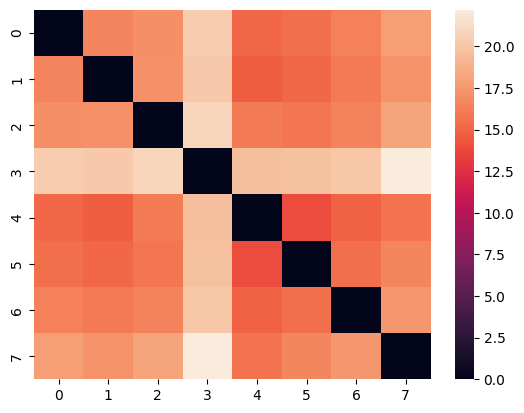

In [33]:
save_dir = './data/node_timeseries/simulation_202402_se/3_group/'
group_covariances = np.load(f'{save_dir}truth/group_state_covariances.npy')
seaborn.heatmap(twopair_riemannian_distance(group_covariances,group_covariances))
plt.show()

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 439.41it/s]


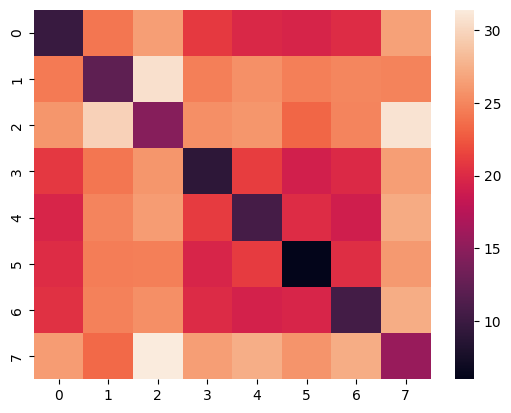

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 366.51it/s]


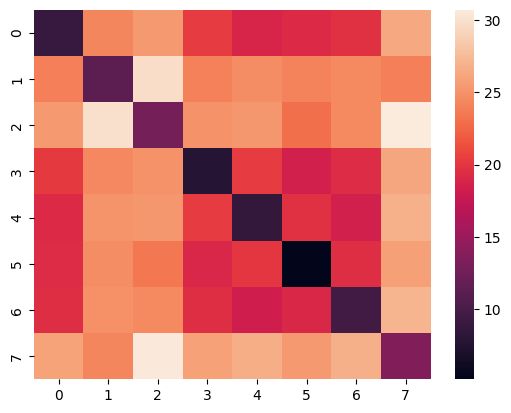

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 472.21it/s]


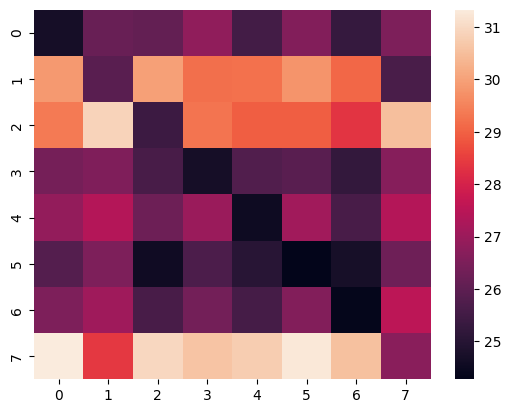

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 169.05it/s]


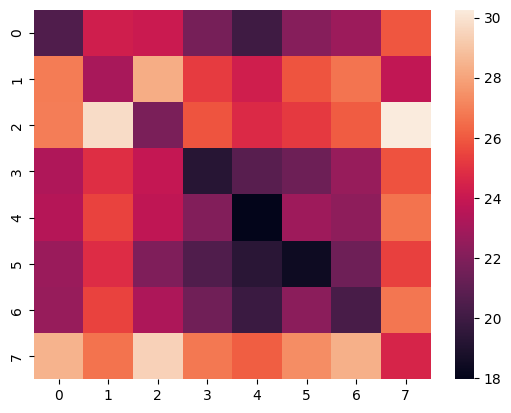

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 452.51it/s]


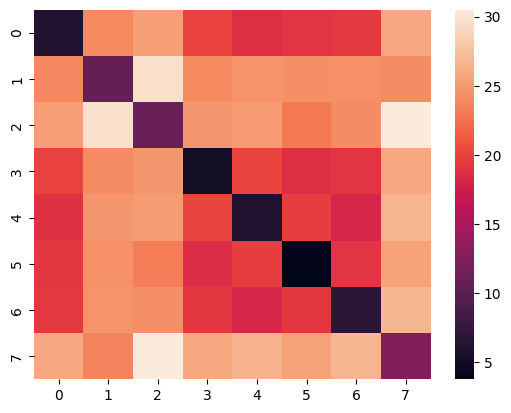

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 554.46it/s]


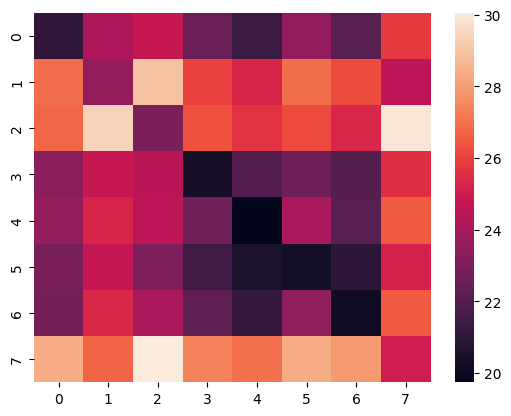

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 467.54it/s]


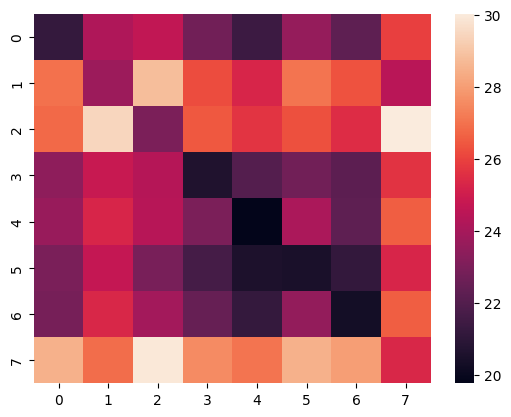

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 537.96it/s]


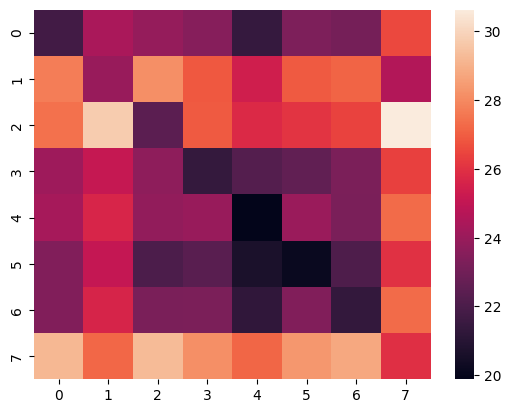

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 441.35it/s]


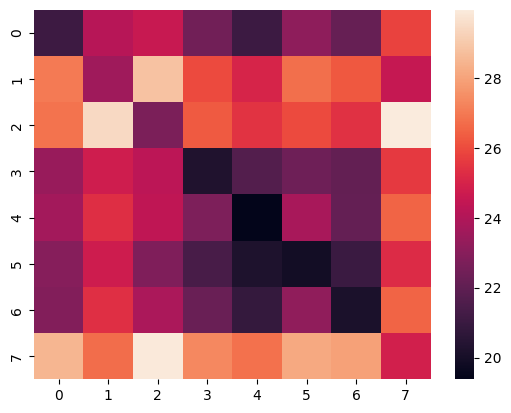

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 280.39it/s]


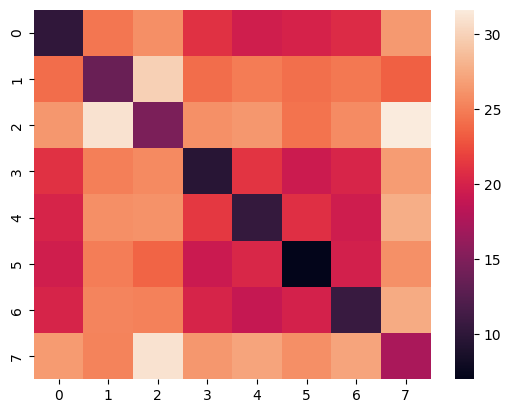

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 700.54it/s]


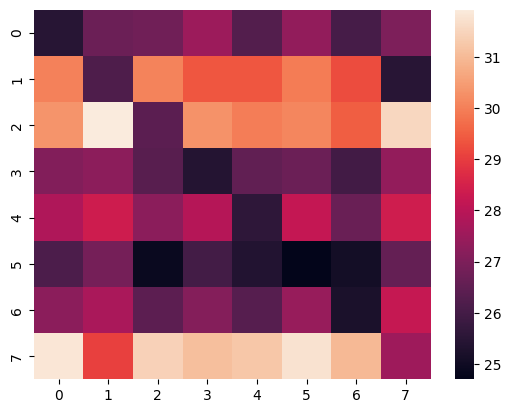

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 817.20it/s]


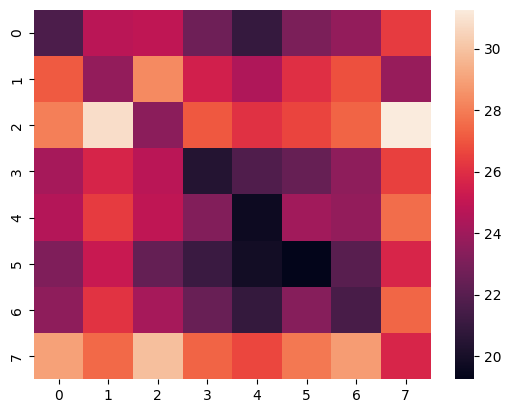

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 589.38it/s]


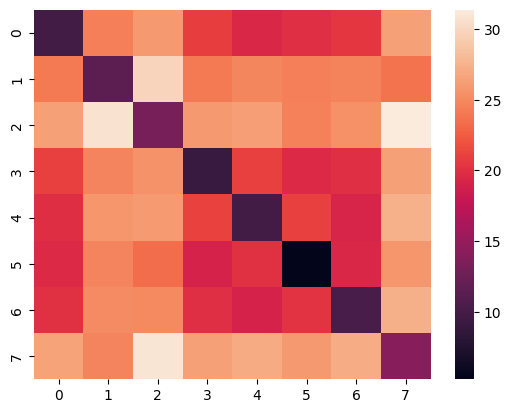

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 560.51it/s]


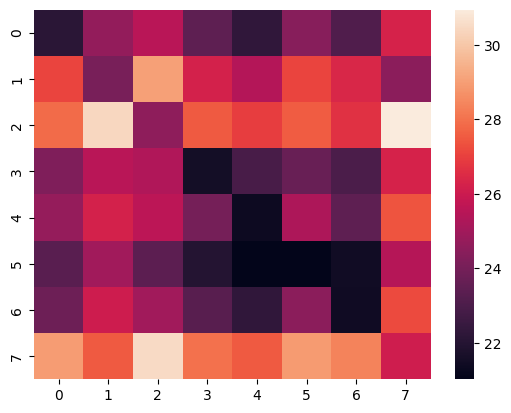

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 740.57it/s]


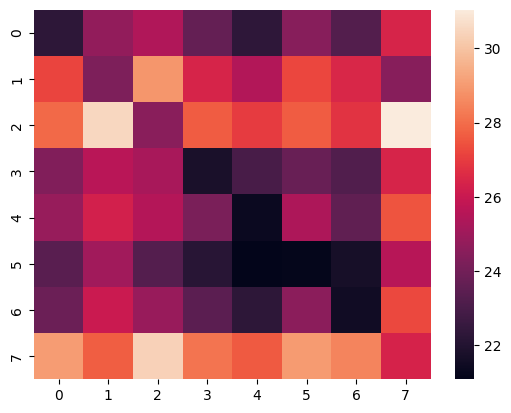

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 341.31it/s]


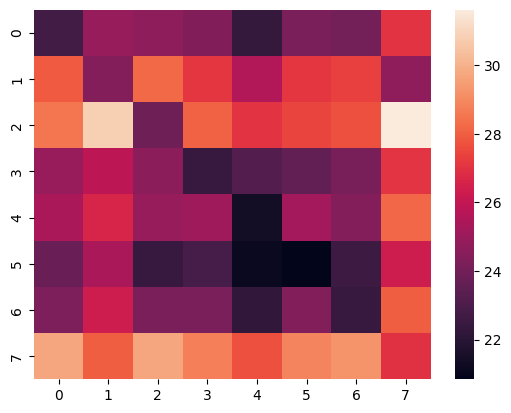

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 419.02it/s]


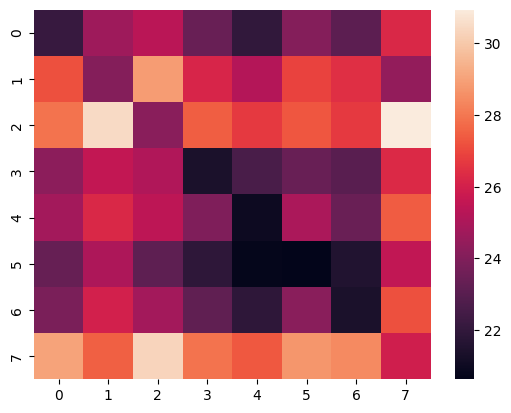

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 560.32it/s]


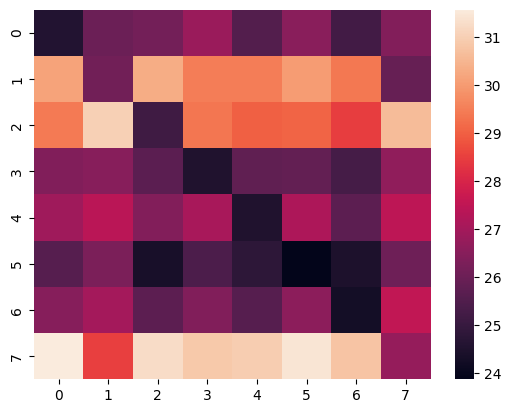

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 450.62it/s]


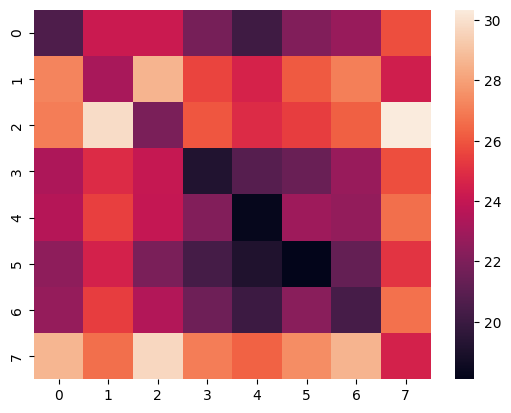

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 477.29it/s]


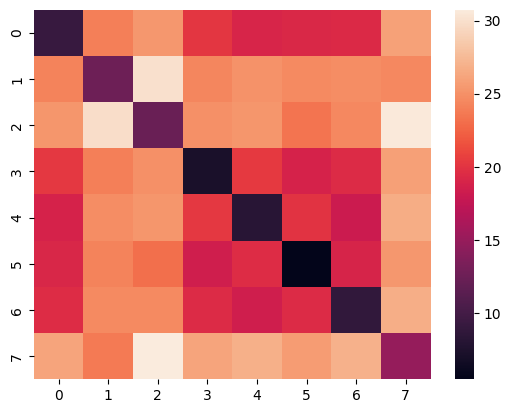

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 295.02it/s]


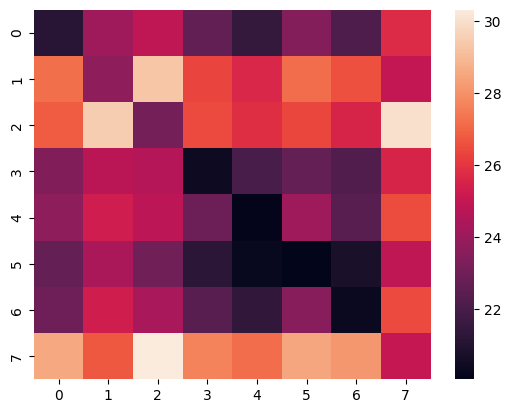

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 482.43it/s]


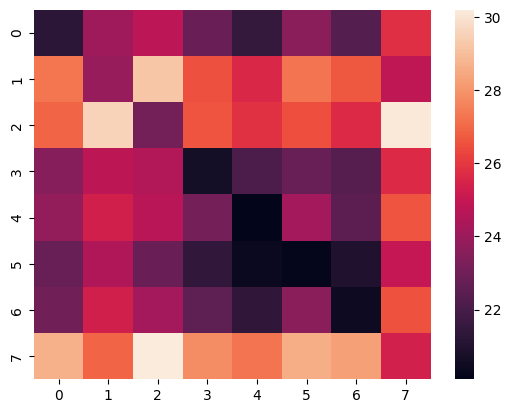

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 212.51it/s]


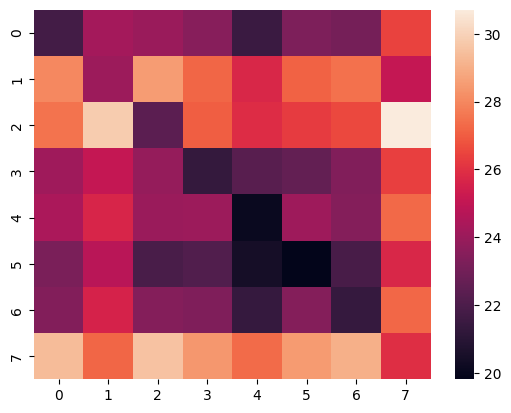

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 421.53it/s]


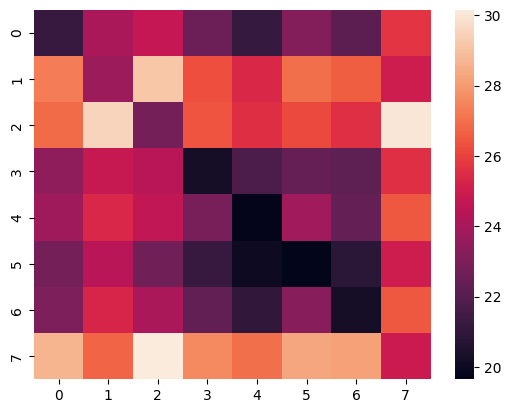

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 374.31it/s]


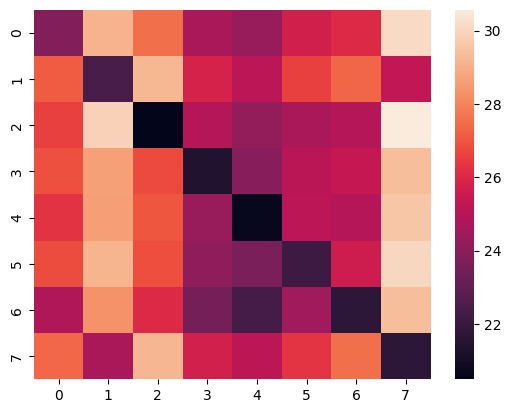

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 421.81it/s]


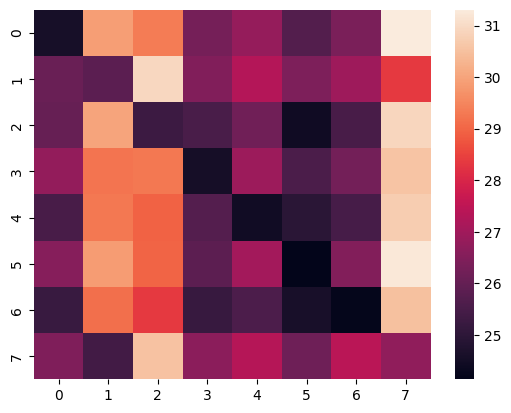

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 674.69it/s]


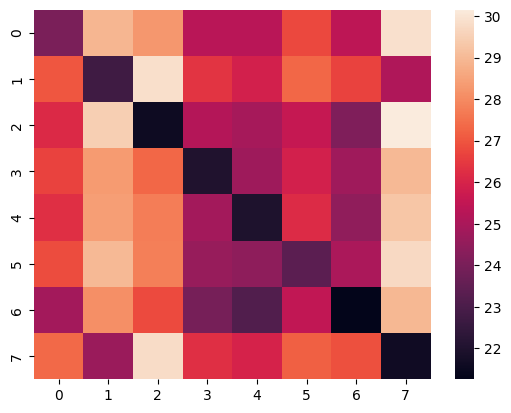

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 677.10it/s]


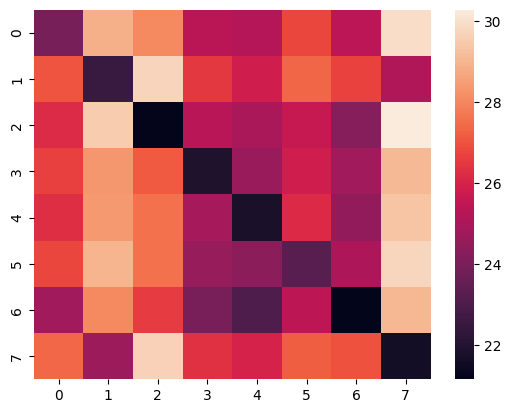

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 800.31it/s]


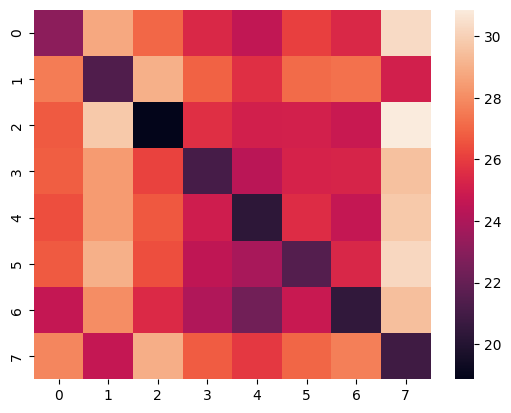

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 466.18it/s]


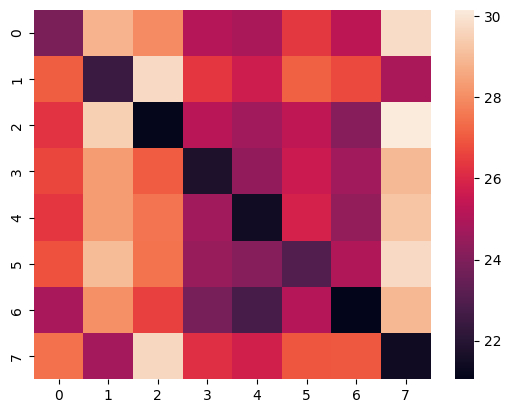

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 351.00it/s]


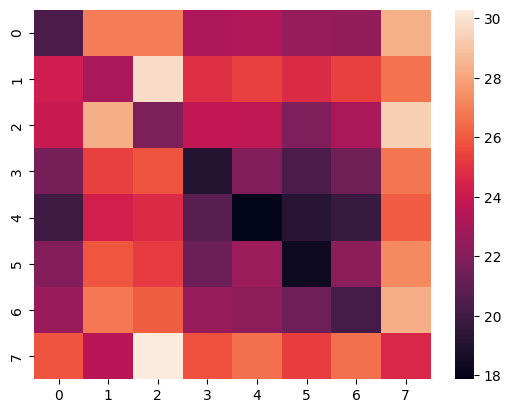

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 317.00it/s]


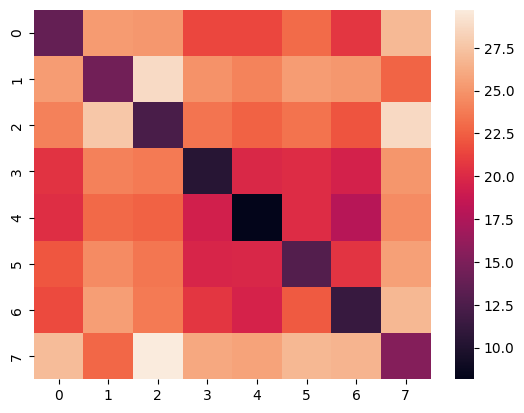

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 679.18it/s]


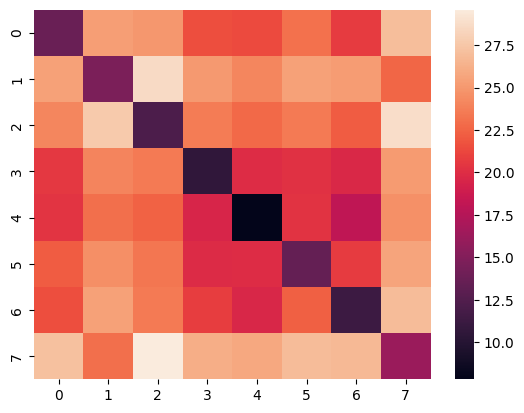

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 307.09it/s]


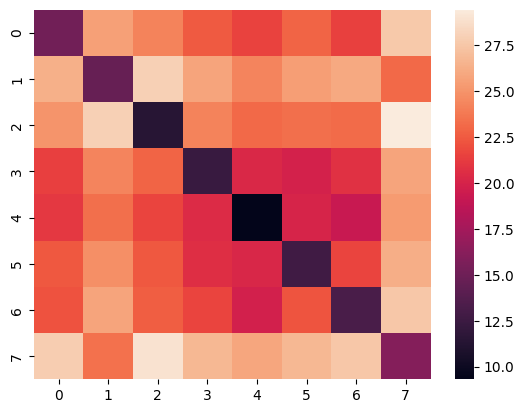

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 456.48it/s]


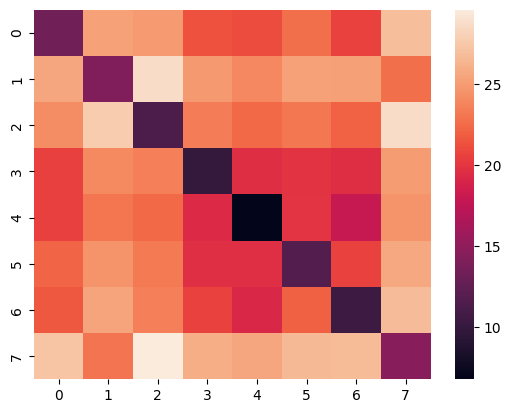

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 362.03it/s]


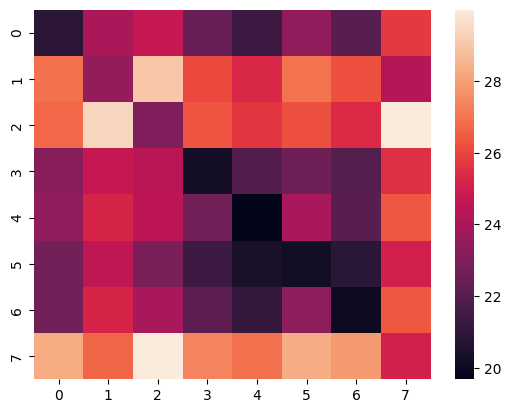

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 368.10it/s]


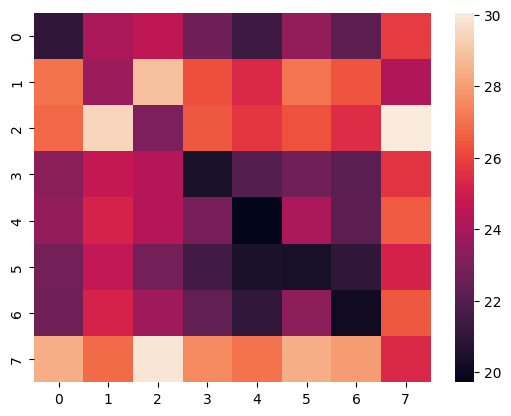

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 710.85it/s]


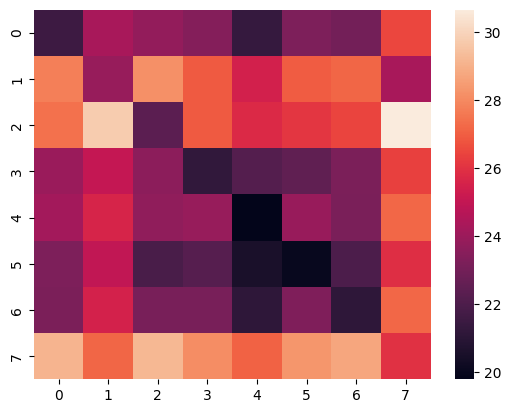

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 665.87it/s]


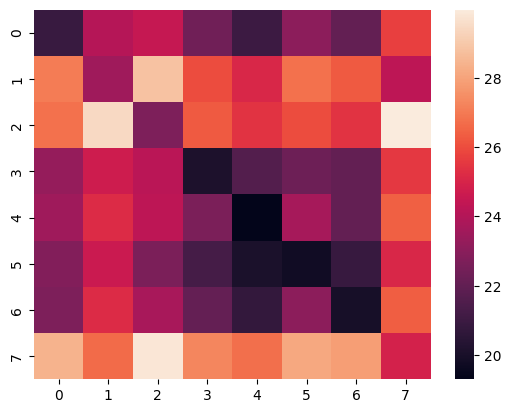

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 447.52it/s]


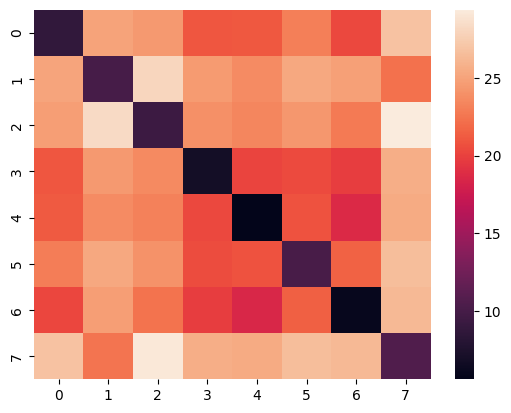

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 397.81it/s]


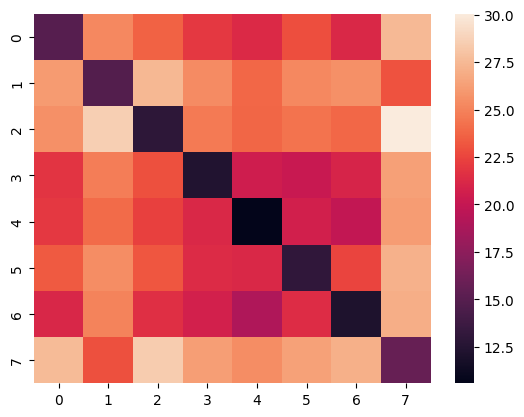

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 415.30it/s]


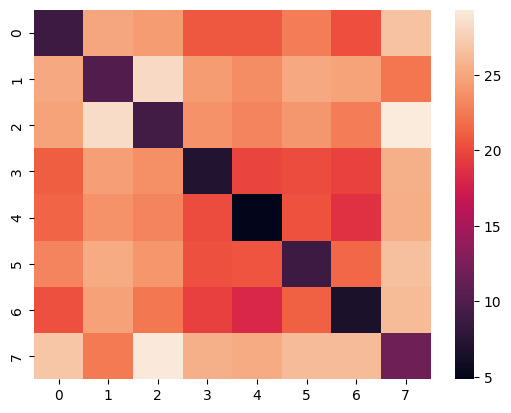

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 372.21it/s]


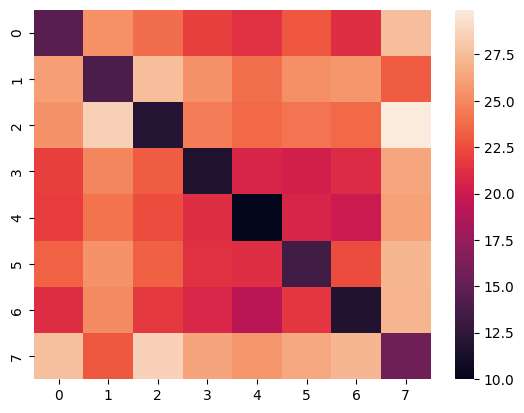

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 488.68it/s]


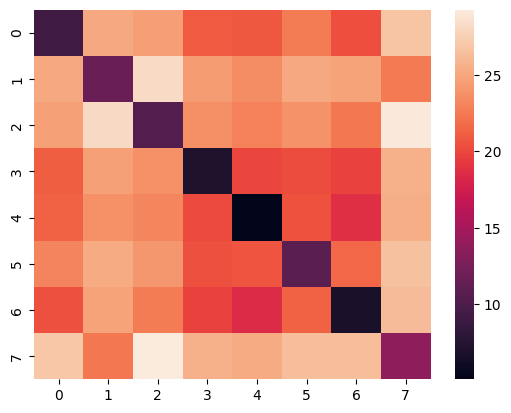

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 684.04it/s]


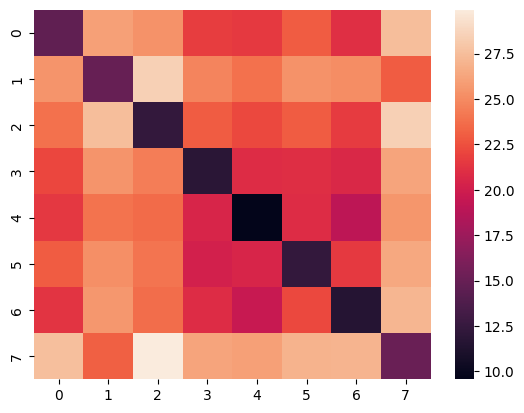

In [34]:
for i in range(10):
    for j in range(i+1,10):
        covariances_1 = np.load(f'{save_dir}truth/{10001+i}_state_covariances.npy')
        covariances_2 = np.load(f'{save_dir}truth/{10001+j}_state_covariances.npy')
        seaborn.heatmap(twopair_riemannian_distance(covariances_1,covariances_2))
        plt.show()

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 540.61it/s]


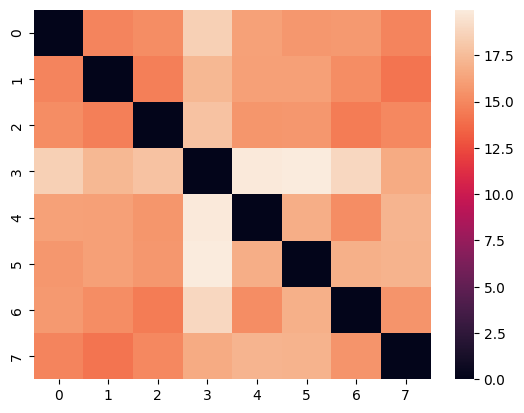

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 270.12it/s]


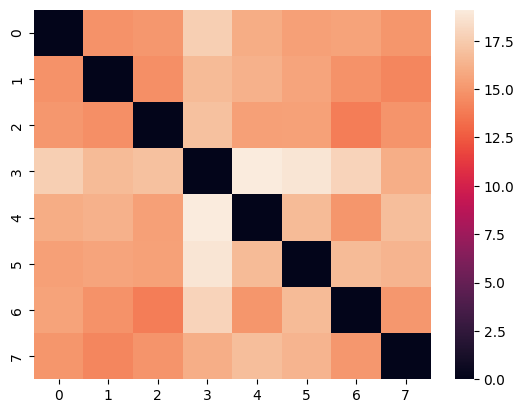

In [36]:
result_dir = './results_simulation_202402_se/small/HMM_ICA_25_state_8/'
state_covariances = np.load(f'{result_dir}state_covariances.npy')
state_correlations = np.load(f'{result_dir}state_correlations.npy')
seaborn.heatmap(twopair_riemannian_distance(state_covariances,state_covariances))
plt.show()
seaborn.heatmap(twopair_riemannian_distance(state_correlations,state_correlations))
plt.show()

In [1]:
from rotation.analysis import comparison_analysis

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
models = ['HMM']
list_channels = [25,100,200]
list_states = list(range(2,36))
result_dir = './results_HCP_202402_single_session/'
save_dir = f'{result_dir}plot/'

comparison_analysis(models,list_channels,list_states,result_dir, save_dir)

## Update 13th February 2024

Plot the fisher-z transformed correlation between ground truth and states from the first-split and second split

In [5]:
import os
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn

In [10]:
ground_truth_dir = './results_HCP_202311_no_mean/HMM_ICA_25_state_8/'
first_half_dir = './results_simulation_202402/sigma_0/HMM_ICA_25_state_16/split_1/first_half/'
second_half_dir = './results_simulation_202402/sigma_0/HMM_ICA_25_state_16/split_1/second_half/'

In [11]:
FC_ground_truth = np.load(f'{ground_truth_dir}state_correlations.npy')
FC_first_half = np.load(f'{first_half_dir}state_correlations.npy')
FC_second_half = np.load(f'{second_half_dir}state_correlations.npy')

In [12]:
from rotation.utils import twopair_fisher_z_transformed_correlation

Compute twopair Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 37


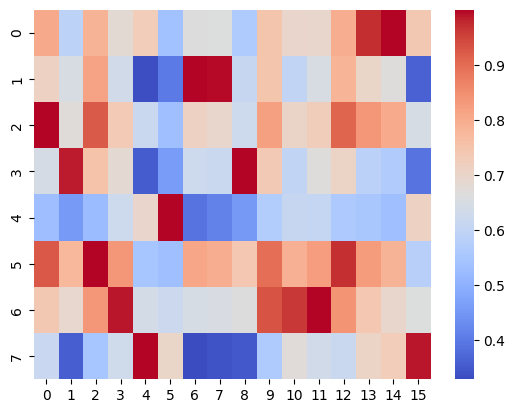

In [14]:
seaborn.heatmap(twopair_fisher_z_transformed_correlation(FC_ground_truth,FC_first_half),cmap="coolwarm")
plt.show()

Compute twopair Fisher-z transformated correlation: 100%|█| 16/16 [00:00<00:00, 


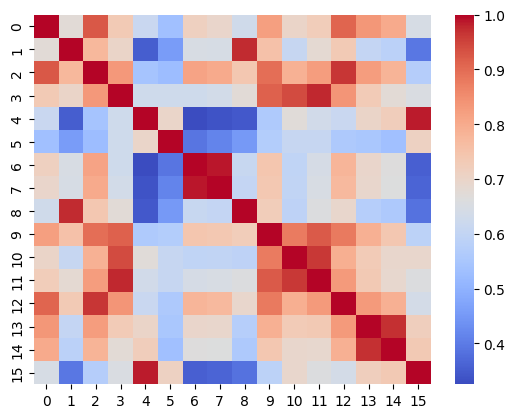

In [15]:
seaborn.heatmap(twopair_fisher_z_transformed_correlation(FC_first_half,FC_first_half),cmap="coolwarm")
plt.show()

Compute twopair Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 38


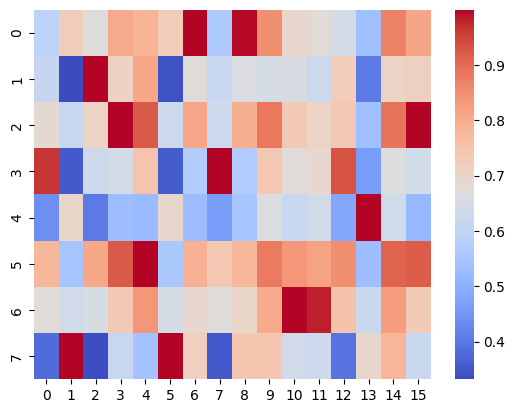

In [18]:
seaborn.heatmap(twopair_fisher_z_transformed_correlation(FC_ground_truth,FC_second_half),cmap="coolwarm")
plt.show()

Compute twopair Fisher-z transformated correlation: 100%|█| 16/16 [00:00<00:00, 


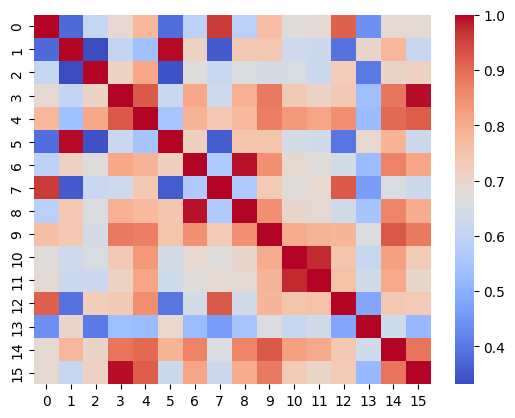

In [19]:
seaborn.heatmap(twopair_fisher_z_transformed_correlation(FC_second_half,FC_second_half),cmap="coolwarm")
plt.show()

In [21]:
first_half_HCP_dir = './results_HCP_202402_single_session/HMM_ICA_25_state_25/split_1/first_half/'
second_half_HCP_dir = './results_HCP_202402_single_session/HMM_ICA_25_state_25/split_1/second_half/'
FC_first_half_HCP = np.load(f'{first_half_HCP_dir}state_correlations.npy')
FC_second_half_HCP = np.load(f'{second_half_HCP_dir}state_correlations.npy')

Compute twopair Fisher-z transformated correlation: 100%|█| 25/25 [00:00<00:00, 


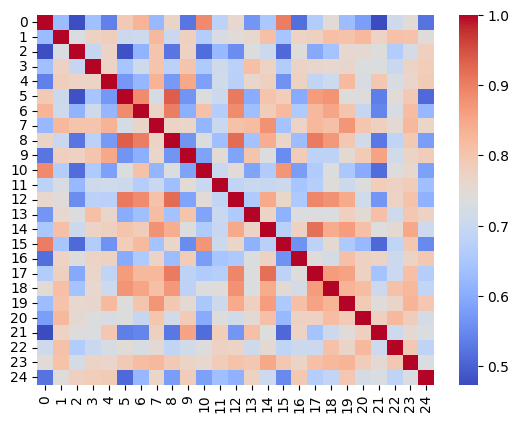

In [23]:
seaborn.heatmap(twopair_fisher_z_transformed_correlation(FC_second_half_HCP,FC_second_half_HCP),cmap="coolwarm")
plt.show()

## Update 19th February 2024

Now we explore the idea of: reproducibility of temporal dynamics. This is something we've never touched upon.

Steve has some thoughts that the uncertainty of temporal dynamics will be very high when you have very large number of states.
Maybe have a look at the perfect model first.

In [96]:
import os
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn
import pickle
from scipy.stats import multivariate_normal
from rotation.utils import twopair_riemannian_distance,twopair_fisher_z_transformed_correlation

In [63]:
save_dir = './results_simulation_202402/sigma_0.1/HMM_ICA_25_state_16/'
data_dir = './data/node_timeseries/simulation_202402/sigma_0.1/'

In [64]:
# Open the pickle file for reading
with open(f'{save_dir}alpha.pkl', 'rb') as f:
    # Load the object from the pickle file
    alpha = pickle.load(f)

In [65]:
len(alpha[0])

1200

In [66]:
ground_truth = np.load(f'{data_dir}truth/10001_state_time_course.npy')
print(ground_truth.shape)

(1200, 8)


In [67]:
posterior = alpha[0]

In [92]:
ground_truth[240:275,:]

array([[0, 0, 0, 1, 0, 0, 0, 0],
       [0, 0, 0, 1, 0, 0, 0, 0],
       [0, 0, 0, 1, 0, 0, 0, 0],
       [0, 0, 0, 1, 0, 0, 0, 0],
       [0, 0, 0, 1, 0, 0, 0, 0],
       [0, 0, 0, 1, 0, 0, 0, 0],
       [0, 0, 0, 1, 0, 0, 0, 0],
       [1, 0, 0, 0, 0, 0, 0, 0],
       [1, 0, 0, 0, 0, 0, 0, 0],
       [1, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 1],
       [0, 0, 0, 0, 0, 0, 0, 1],
       [0, 0, 0, 0, 0, 0, 0, 1],
       [0, 0, 0, 0, 0, 0, 0, 1],
       [0, 0, 0, 0, 0, 0, 0, 1],
       [0, 0, 0, 0, 0, 0, 0, 1],
       [0, 0, 0, 0, 0, 0, 0, 1],
       [0, 0, 0, 0, 0, 0, 0, 1],
       [0, 0, 0, 0, 0, 0, 0, 1],
       [0, 0, 0, 0, 0, 0, 0, 1],
       [0, 0, 0, 0, 0, 0, 0, 1],
       [0, 0, 0, 0, 0, 0, 0, 1],
       [0, 0, 0, 0, 0, 0, 0, 1],
       [0, 0, 0, 0, 0, 0, 0, 1],
       [0, 0, 0, 0, 0, 0, 0, 1],
       [0, 0, 0, 0, 0, 0, 0, 1],
       [0, 0, 0, 0, 0, 0, 0, 1],
       [0, 0, 0, 0, 0, 0, 0, 1],
       [0, 0, 0, 0, 0, 0, 0, 1],
       [0, 0, 0, 0, 0, 0, 0, 1],
       [0,

In [69]:
posterior[240:300,:]

array([[1.90452789e-03, 1.97120294e-01, 1.21697588e-02, 5.86557342e-03,
        3.69402647e-01, 3.35632056e-01, 1.02244492e-03, 1.08124816e-03,
        6.90136757e-03, 4.54479086e-05, 5.16324528e-02, 8.61273205e-04,
        2.09734881e-05, 1.30941775e-02, 1.83959462e-04, 3.06179025e-03],
       [1.81984098e-03, 4.09528166e-02, 8.65738653e-03, 1.58991609e-02,
        8.15385282e-01, 4.44197468e-02, 1.48502353e-03, 7.22922443e-04,
        1.00297723e-02, 1.85489614e-06, 5.06994501e-02, 7.79489637e-04,
        2.05283985e-04, 5.64981066e-03, 2.67158437e-04, 3.02497018e-03],
       [3.95605862e-02, 2.58128205e-03, 1.35172915e-04, 1.78670064e-01,
        7.24519432e-01, 3.69007699e-03, 3.94140230e-03, 2.24808883e-03,
        3.98046104e-03, 1.58774346e-05, 1.67038795e-02, 4.90068167e-04,
        8.56826045e-06, 2.02719428e-04, 2.18406077e-02, 1.41172751e-03],
       [4.14431095e-02, 3.69072799e-03, 2.69429665e-03, 2.01504871e-01,
        5.94935954e-01, 5.17348433e-03, 8.09553545e-03, 7.958

In [70]:
covariance_fit = np.load(f'{save_dir}state_covariances.npy')
covariance_truth = np.load(f'{data_dir}truth/10001_state_covariances.npy')
covariance_fit = np.load(f'{save_dir}state_covariances.npy')
covariance_truth = np.load(f'{data_dir}truth/10001_state_covariances.npy')

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 216.18it/s]


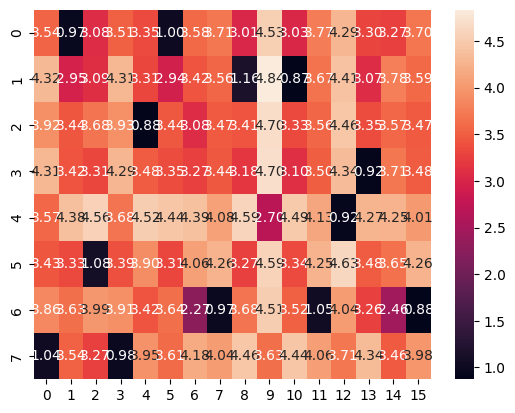

Compute twopair Fisher-z transformated correlation:   0%| | 0/8 [00:00<?, ?it/s]/gpfs3/well/win-fmrib-analysis/users/uap971/osl-dynamics/rotation/utils.py:244: RuntimeWarning: invalid value encountered in log
  return 0.5 * np.log((1 + v)/(1 - v))
Compute twopair Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 22


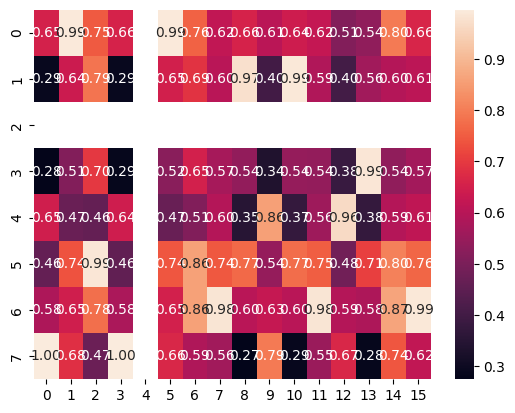

In [95]:
seaborn.heatmap(twopair_riemannian_distance(covariance_truth,covariance_fit),annot=True,fmt=".2f")
plt.show()
#seaborn.heatmap(twopair_fisher_z_transformed_correlation(covariance_truth,covariance_fit),annot=True,fmt=".2f")
#plt.show()

It seems to me that even the riemannian distance is very close, the model still have a preference over one state. Maybe look at your data to confirm that!

In [72]:
data = np.loadtxt(f'{data_dir}10001.txt')

(1200, 25)


In [80]:
logpdf_baseline = multivariate_normal(cov=covariance_truth[-1]).logpdf(data[250:275,:])

In [85]:
print(np.mean(logpdf_baseline))

-29.95887397038275


In [86]:
logpdf_0 = multivariate_normal(cov=covariance_fit[0]).logpdf(data[250:275,:])
print(np.mean(logpdf_0))

-30.533795785938437


In [87]:
logpdf_1 = multivariate_normal(cov=covariance_fit[1]).logpdf(data[250:275,:])
print(np.mean(logpdf_1))

-31.66624565540816


In [90]:
logpdf_3 = multivariate_normal(cov=covariance_fit[3]).logpdf(data[250:275,:])
print(np.mean(logpdf_3))

-30.447577862777038


In [91]:
logpdf_4 = multivariate_normal(cov=covariance_fit[4]).logpdf(data[250:275,:])
print(np.mean(logpdf_4))

-32.15634421065483


## Update 24th Feb 2024

Let's try to revise the Config so that the initial means and covariances could be read in from specific file.

In [10]:
from dataclasses import dataclass
from typing import Union

@dataclass
class Point:
    x: Union[float, str]
    #x: float
    y: float
    
    def __post_init__(self):
        # Check if x is a string, then convert it to float
        if isinstance(self.x, str):
            self.x = float(self.x)
    

In [12]:
# Test cases
point_float = Point(2.0, 3.5)  # Initialize with float
#print(point_float)  # Output: Point(x=2.0, y=3.5)

point_str = Point("2.5", 4.5)  # Initialize with str
print(type(point_str.x))  # Output: Point(x=2.5, y=4.5)
temp = None
print(f'Whether None is a instance of string?:{isinstance(temp,str)}')

<class 'str'>
Whether None is a instance of string?:False


The code shows that we can actually revise the config class so that a string can be passed in, i.e., read in that file to initialise the TPM/means/covariances

The training has finished. So let's check the results

In [120]:
import os
import numpy as np
import numpy.testing as npt
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn
from rotation.utils import *

In [121]:
save_dir = './results_simulation_202402_repeat/cov_0/sigma_0/hmm_ICA_25_state_16/'
repeats = ['train','repeat_1','repeat_2','repeat_3','repeat_4','repeat_5']
covariance_truth = np.load('./results_simulation_202402_repeat/fixed_covariances.npy')
# Check the mean activation are all zero, and covariance matrices are all identical.
for repeat in repeats:
    means = np.load(f'{save_dir}{repeat}/inf_params/means.npy')
    assert np.sum(np.abs(means)) == 0
    covariances = np.load(f'{save_dir}{repeat}/inf_params/covs.npy')
    npt.assert_almost_equal(covariances,covariance_truth,decimal=6)

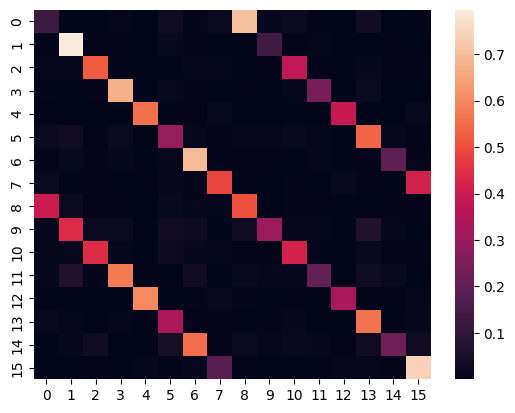

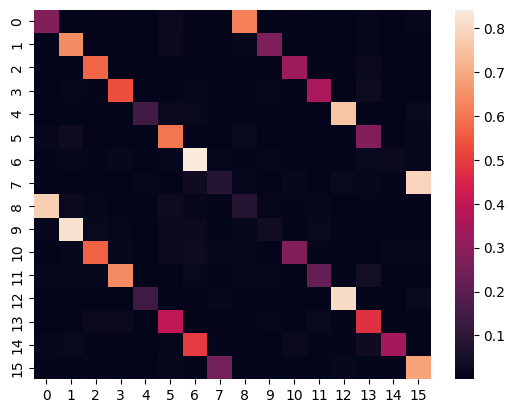

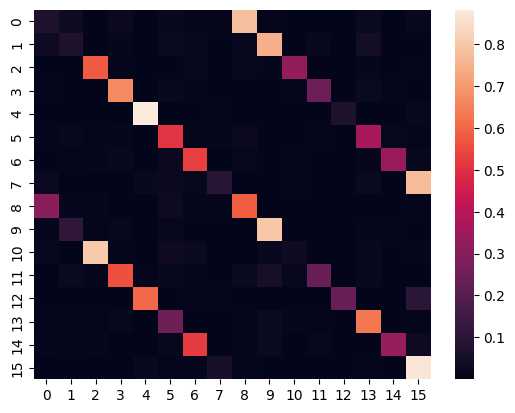

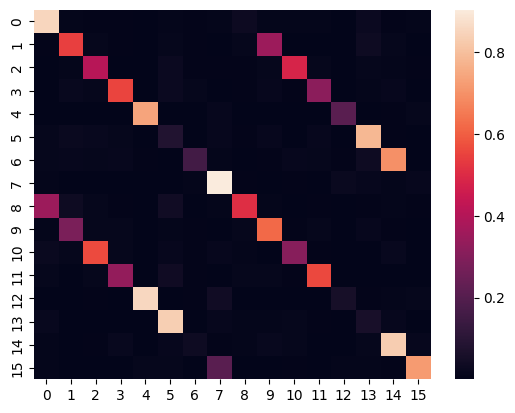

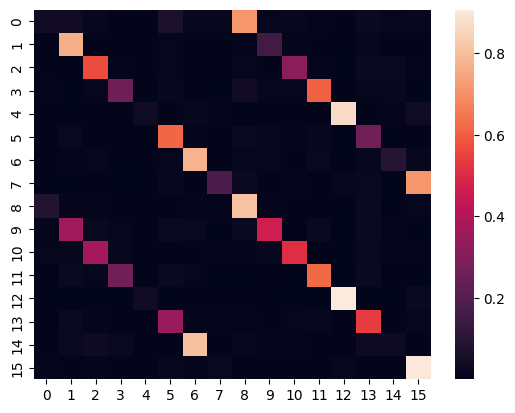

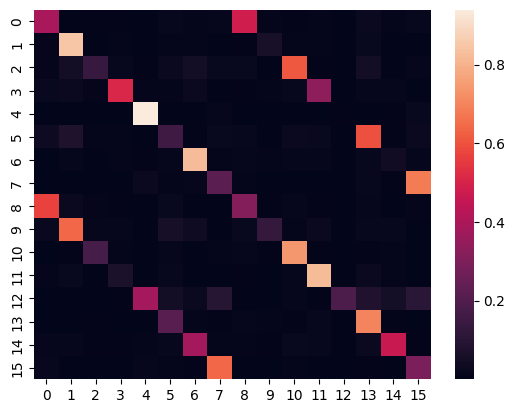

In [123]:
for repeat in repeats:
    tpm = np.load(f'{save_dir}{repeat}/model/trans_prob.npy')
    seaborn.heatmap(tpm)
    plt.show()

This is important. It tells us that with identical states, you will see the random switching between them. Now have a look at the alpha.

In [124]:
import pickle

In [125]:
with open(f'{save_dir}train/inf_params/alp.pkl','rb') as file:
    alpha = pickle.load(file)

In [126]:
with open(f'{save_dir}train/inf_params/alp.pkl','rb') as file:
    alpha = pickle.load(file)

In [127]:
print(type(alpha))

<class 'list'>


In [128]:
print(alpha[0])

[[4.81349826e-01 5.16284083e-04 3.40275379e-04 ... 8.43076705e-05
  3.41130544e-05 2.35170864e-05]
 [2.89944887e-01 4.54870635e-04 2.70671462e-05 ... 6.73804534e-05
  2.65584094e-05 1.54978716e-05]
 [3.55618507e-01 9.12061005e-05 1.09882035e-06 ... 1.80180173e-03
  9.72664384e-06 3.35799741e-05]
 ...
 [2.80968758e-04 1.73095271e-09 1.00545531e-05 ... 3.25659057e-05
  2.45787687e-05 6.99273944e-01]
 [2.19925332e-05 3.96189179e-08 1.20662498e-05 ... 1.09363555e-05
  1.02338972e-05 7.00931847e-01]
 [4.42815275e-04 7.30826832e-06 1.97023503e-04 ... 4.09335247e-04
  6.14416553e-04 6.67781532e-01]]


In [129]:
ground_truth = np.load('./data/node_timeseries/simulation_202402/sigma_0/truth/10001_state_time_course.npy')

In [130]:
print(ground_truth[:100])

[[1 0 0 0 0 0 0 0]
 [1 0 0 0 0 0 0 0]
 [1 0 0 0 0 0 0 0]
 [1 0 0 0 0 0 0 0]
 [1 0 0 0 0 0 0 0]
 [1 0 0 0 0 0 0 0]
 [1 0 0 0 0 0 0 0]
 [1 0 0 0 0 0 0 0]
 [1 0 0 0 0 0 0 0]
 [1 0 0 0 0 0 0 0]
 [1 0 0 0 0 0 0 0]
 [1 0 0 0 0 0 0 0]
 [1 0 0 0 0 0 0 0]
 [1 0 0 0 0 0 0 0]
 [0 1 0 0 0 0 0 0]
 [0 1 0 0 0 0 0 0]
 [0 1 0 0 0 0 0 0]
 [0 1 0 0 0 0 0 0]
 [0 1 0 0 0 0 0 0]
 [0 1 0 0 0 0 0 0]
 [0 1 0 0 0 0 0 0]
 [0 1 0 0 0 0 0 0]
 [0 0 0 0 0 1 0 0]
 [0 0 0 0 0 1 0 0]
 [0 0 0 0 0 1 0 0]
 [0 0 0 0 0 1 0 0]
 [0 0 0 0 0 1 0 0]
 [0 0 0 0 0 1 0 0]
 [0 0 0 0 0 1 0 0]
 [0 0 0 0 0 1 0 0]
 [0 0 1 0 0 0 0 0]
 [0 0 1 0 0 0 0 0]
 [0 0 1 0 0 0 0 0]
 [0 0 1 0 0 0 0 0]
 [0 0 1 0 0 0 0 0]
 [0 0 1 0 0 0 0 0]
 [0 0 1 0 0 0 0 0]
 [0 0 0 0 0 1 0 0]
 [0 0 0 0 0 1 0 0]
 [0 0 0 0 0 1 0 0]
 [0 0 0 0 0 1 0 0]
 [0 0 0 0 0 1 0 0]
 [0 0 0 0 0 1 0 0]
 [0 0 1 0 0 0 0 0]
 [0 0 1 0 0 0 0 0]
 [0 0 1 0 0 0 0 0]
 [0 0 1 0 0 0 0 0]
 [0 0 1 0 0 0 0 0]
 [0 0 1 0 0 0 0 0]
 [0 0 0 0 0 1 0 0]
 [0 0 0 0 0 1 0 0]
 [0 0 0 0 0 0 1 0]
 [0 0 0 0 0 

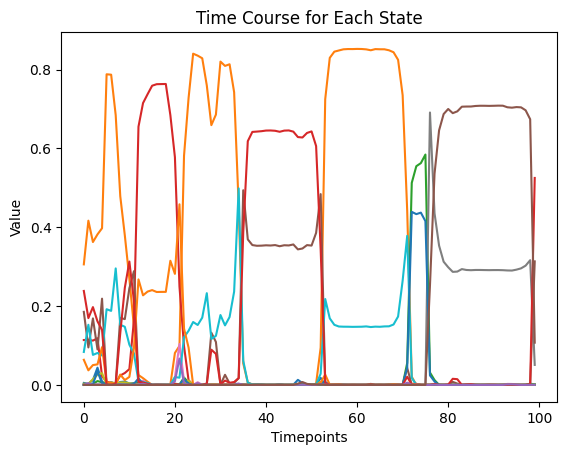

In [134]:
n_states = 16
# Plot the time course for each state
for state in range(n_states):
    plt.plot(alpha[0][100:200, state], label=f'State {state + 1}')

# Add labels and legend
plt.xlabel('Timepoints')
plt.ylabel('Value')
plt.title('Time Course for Each State')
#plt.legend()

# Add a caption
#plt.figtext(0.5, 0.01, 'Figure 1: Time course for each state in the data.', ha='center')

# Show the plot
plt.show()

This confirms Steve and Rukuang's guess that the "uncertainty" in the state time course will be high. But it's not necessarily in a "0.5-0.5" split.

What happens when there's subject variablity in the "ground truth"?

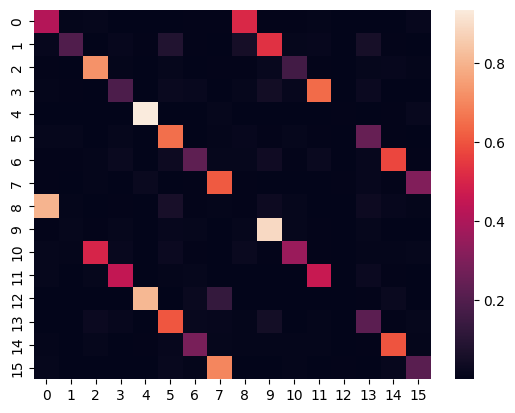

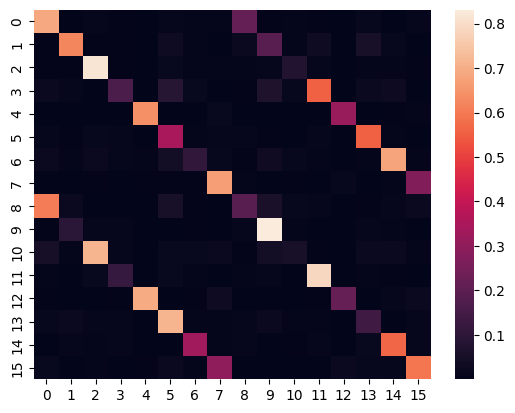

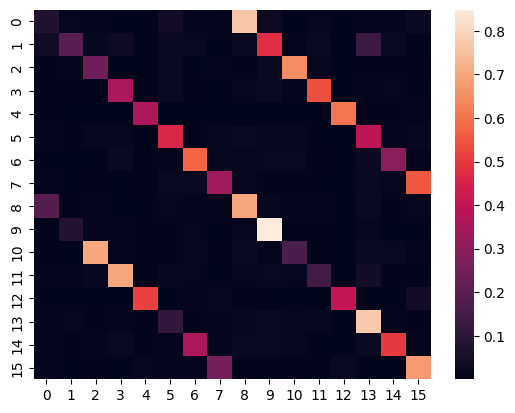

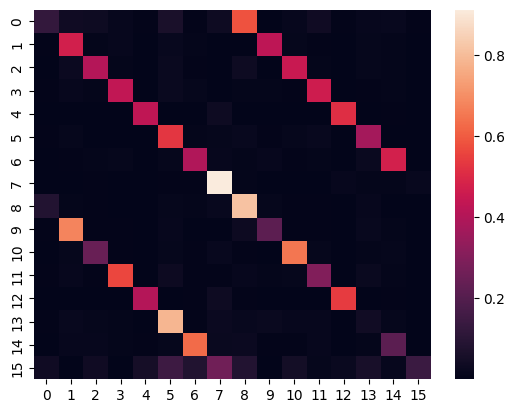

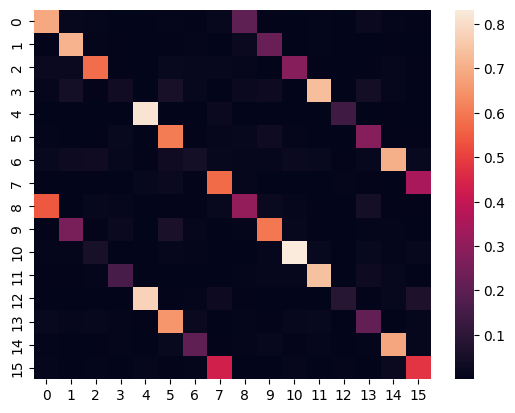

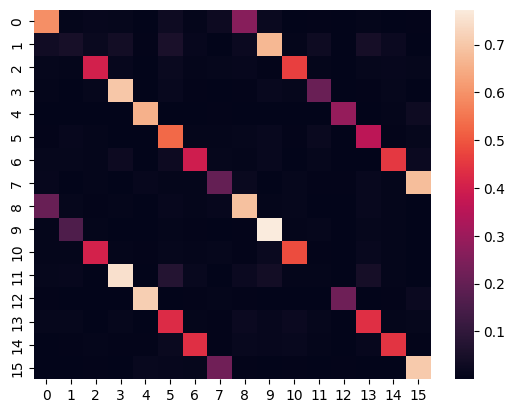

In [58]:
save_dir = './results_simulation_202402_repeat/cov_0/sigma_0.025/hmm_ICA_25_state_16/'
repeats = ['train','repeat_1','repeat_2','repeat_3','repeat_4','repeat_5']
covariance_truth = np.load('./results_simulation_202402_repeat/fixed_covariances.npy')
for repeat in repeats:
    tpm = np.load(f'{save_dir}{repeat}/model/trans_prob.npy')
    seaborn.heatmap(tpm)
    plt.show()

In [60]:
with open(f'{save_dir}train/inf_params/alp.pkl','rb') as file:
    alpha = pickle.load(file)

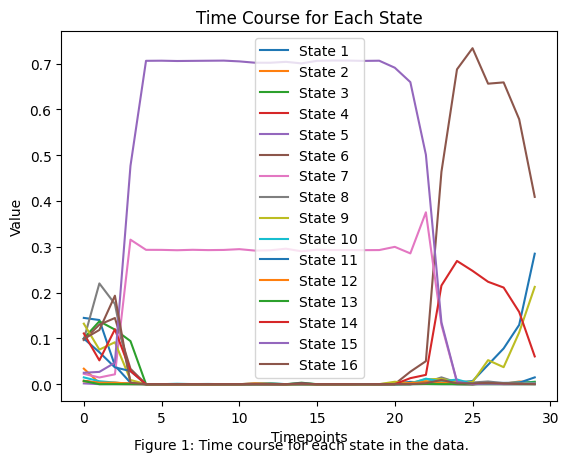

In [61]:
n_states = 16
# Plot the time course for each state
for state in range(n_states):
    plt.plot(alpha[0][:30, state], label=f'State {state + 1}')

# Add labels and legend
plt.xlabel('Timepoints')
plt.ylabel('Value')
plt.title('Time Course for Each State')
plt.legend()

# Add a caption
plt.figtext(0.5, 0.01, 'Figure 1: Time course for each state in the data.', ha='center')

# Show the plot
plt.show()

## Update 24th Feb 2024

Also, we're interested in giving some "perturbation" to the "fixed covariances"!

In [40]:
fixed_covariances = np.load('./results_simulation_202402_repeat/fixed_covariances.npy')

In [41]:
from rotation.simulation import perturb_covariances

2024-02-24 17:04:48.812257: I tensorflow/core/util/util.cc:169] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-02-24 17:04:48.817010: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2024-02-24 17:04:48.817026: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 731.16it/s]


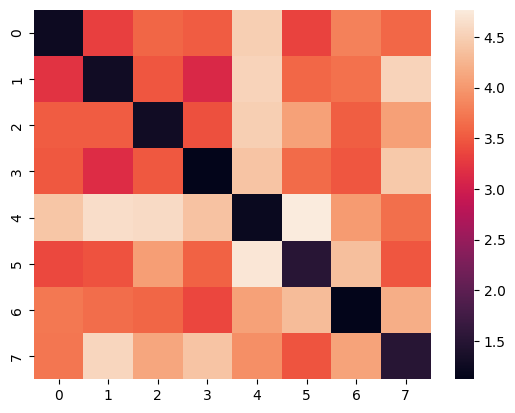

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 455.90it/s]


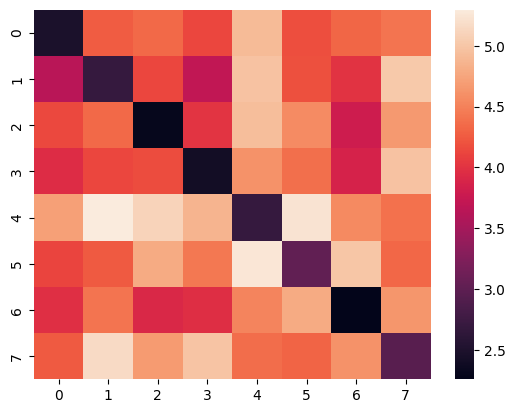

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 404.87it/s]


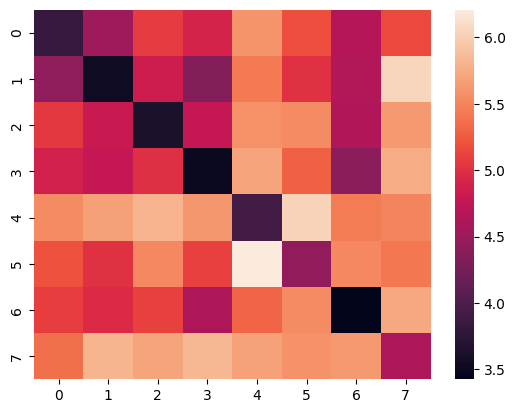

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 333.14it/s]


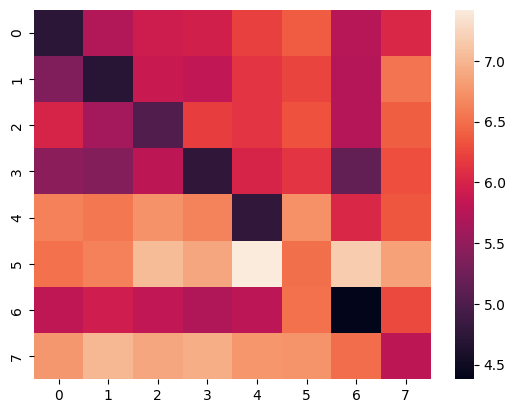

In [48]:
sigmas = [0.025,0.05,0.075,0.1]
for sigma in sigmas:
    covariances = np.concatenate((perturb_covariances(fixed_covariances[:8],perturbation_factor=sigma),
                                  perturb_covariances(fixed_covariances[:8],perturbation_factor=sigma)),axis=0)
    seaborn.heatmap(twopair_riemannian_distance(covariances[:8],covariances[8:]))
    plt.show()
    np.save(f'./results_simulation_202402_repeat/fixed_covariances_{sigma}.npy',covariances)

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 717.91it/s]


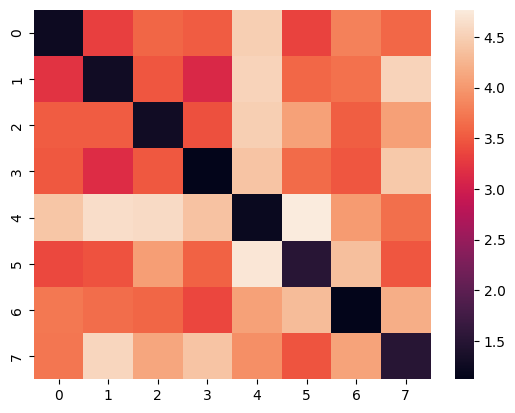

In [137]:
fixed_matrices = np.load(f'./results_simulation_202402_repeat/fixed_covariances_0.025.npy')
seaborn.heatmap(twopair_riemannian_distance(fixed_matrices[:8],fixed_matrices[8:]))
plt.show()

Now let's check the posterior "uncertainty" again.

In [140]:
import os
import pickle
import numpy as np
import numpy.testing as npt
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn

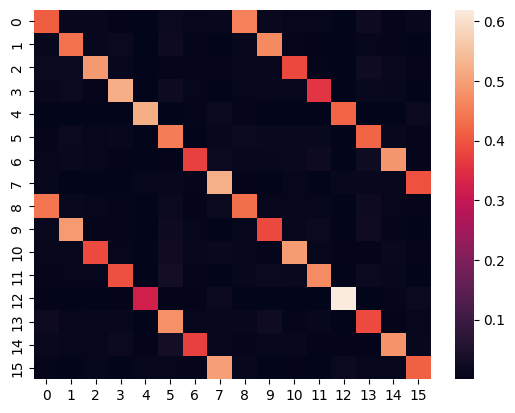

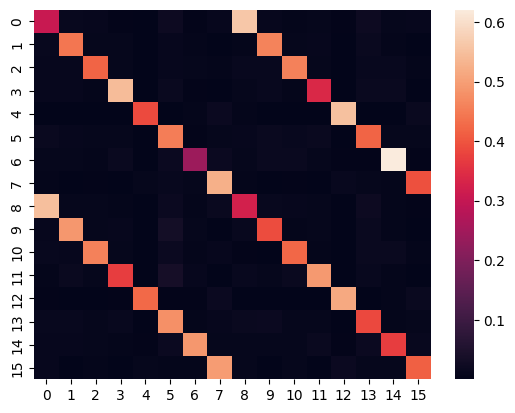

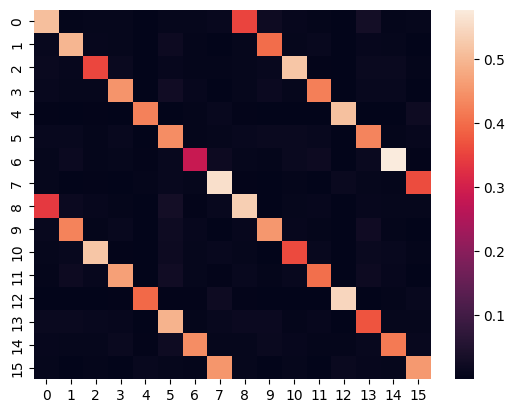

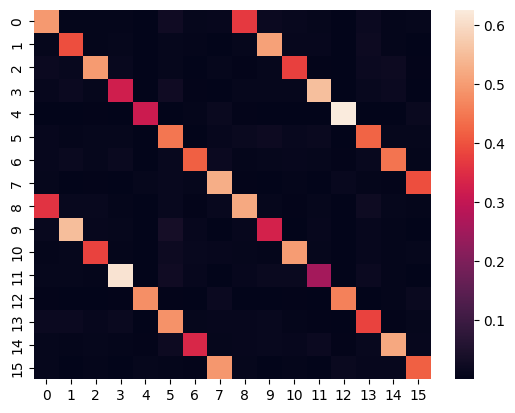

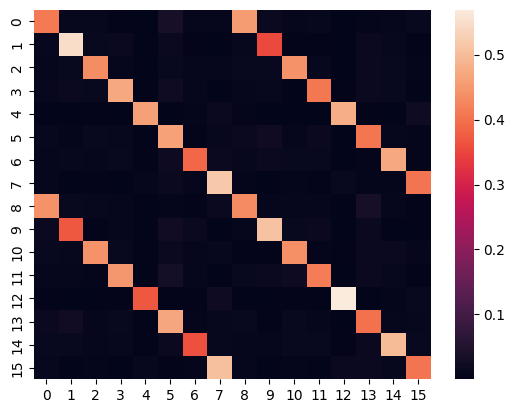

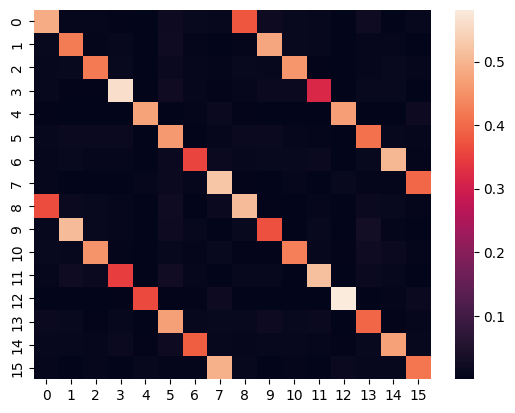

In [141]:
save_dir = './results_simulation_202402_repeat/cov_0.025/sigma_0/hmm_ICA_25_state_16/'
repeats = ['train','repeat_1','repeat_2','repeat_3','repeat_4','repeat_5']
covariance_truth = np.load('./results_simulation_202402_repeat/fixed_covariances_0.025.npy')
for repeat in repeats:
    tpm = np.load(f'{save_dir}{repeat}/model/trans_prob.npy')
    covariances = np.load(f'{save_dir}{repeat}/inf_params/covs.npy')
    means = np.load(f'{save_dir}{repeat}/inf_params/means.npy')
    npt.assert_almost_equal(means,0)
    npt.assert_almost_equal(covariance_truth,covariances,decimal=6)
    seaborn.heatmap(tpm)
    plt.show()

There are still structures in the transition probability matrix (which is good). And we still see run-to-run variability.

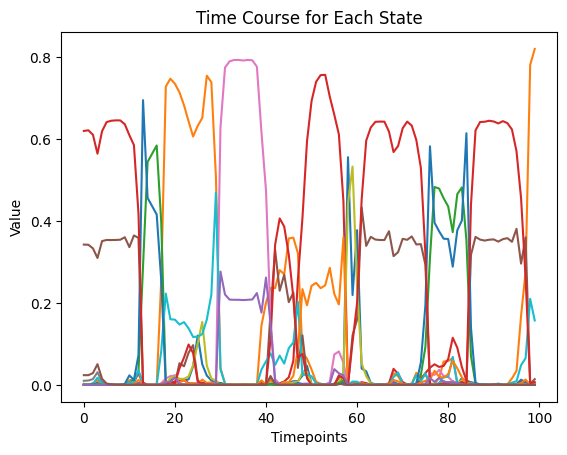

In [143]:
for repeat in ['train']:#repeats:
    with open(f'{save_dir}{repeat}/inf_params/alp.pkl','rb') as file:
        data = pickle.load(file)
        n_states = 16
        # Plot the time course for each state
        for state in range(n_states):
            plt.plot(alpha[0][200:300, state], label=f'State {state + 1}')

        # Add labels and legend
        plt.xlabel('Timepoints')
        plt.ylabel('Value')
        plt.title('Time Course for Each State')
        #plt.legend()

        # Add a caption
        #plt.figtext(0.5, 0.01, 'Figure 1: Time course for each state in the data.', ha='center')

        # Show the plot
        plt.show()

It's very clear that you can definitely see the "uncertainty" in the state time courses even when these repeated "states" are slightly different. What if when you have larger "fixed" state variability?

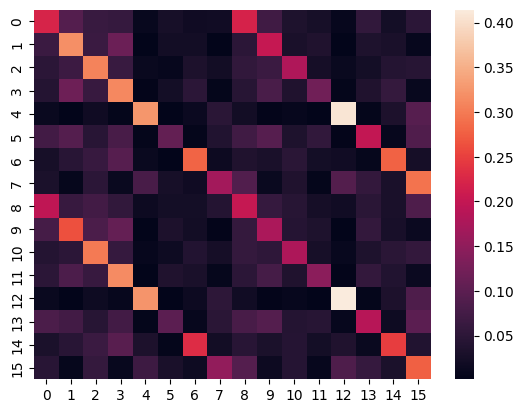

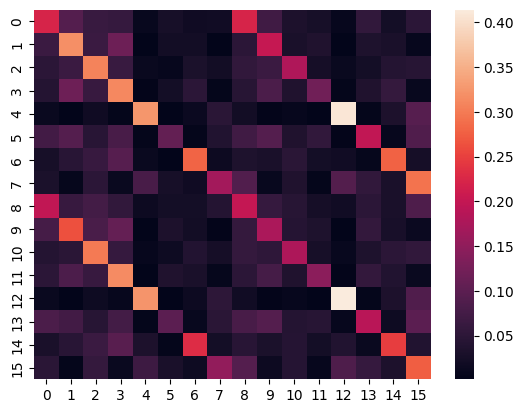

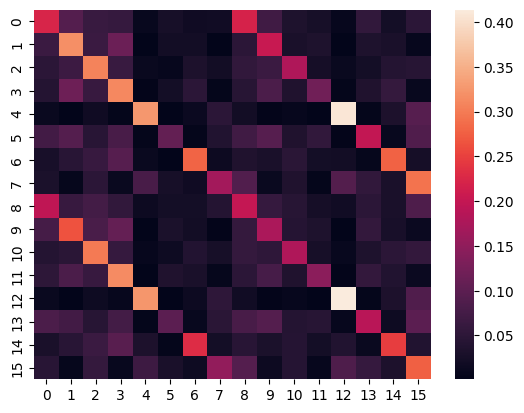

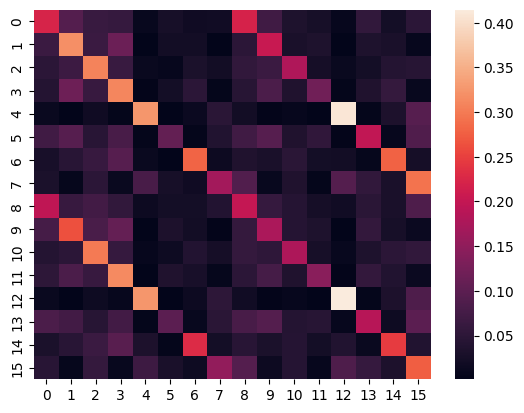

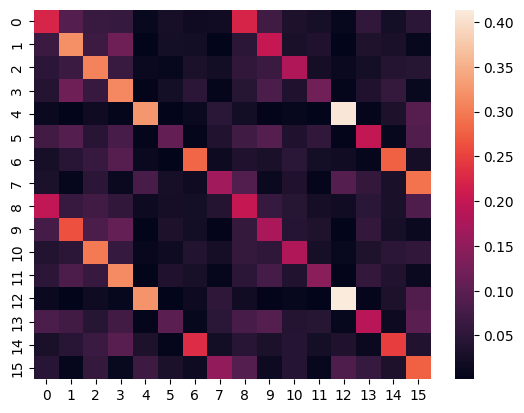

...

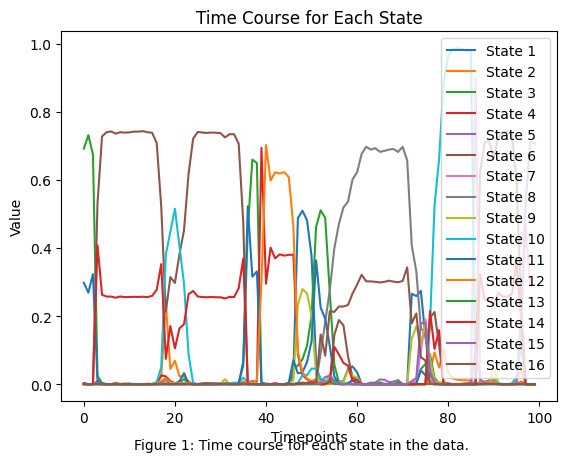

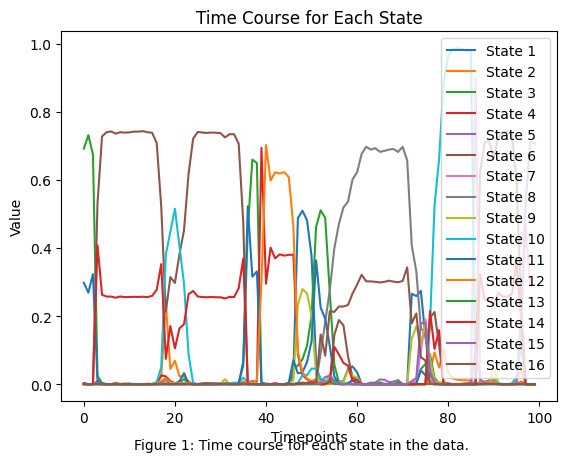

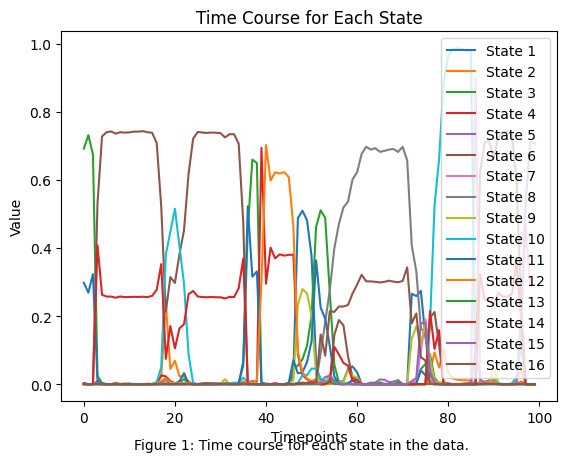

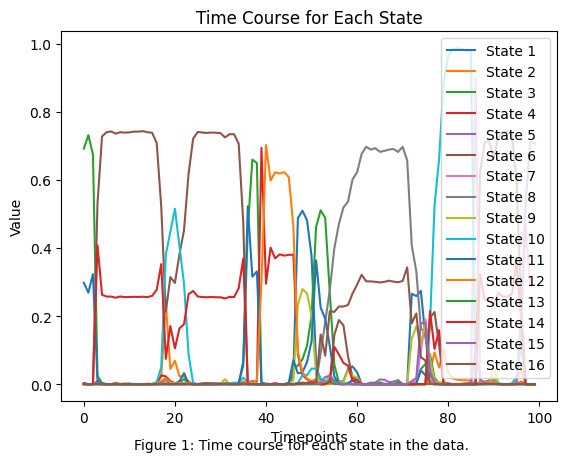

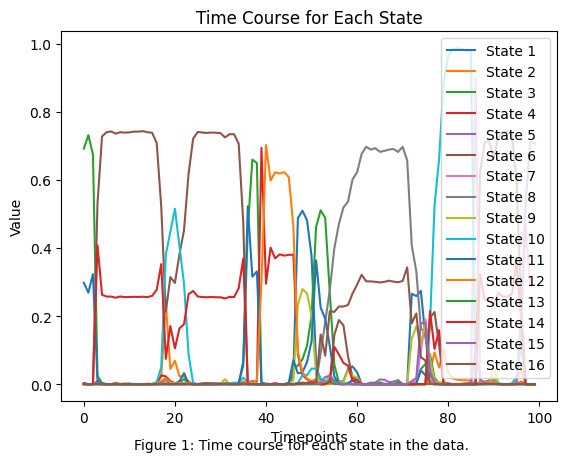

In [72]:
save_dir = './results_simulation_202402_repeat/cov_0.1/sigma_0/hmm_ICA_25_state_16/'
repeats = ['train','repeat_1','repeat_2','repeat_3','repeat_4','repeat_5']
covariance_truth = np.load('./results_simulation_202402_repeat/fixed_covariances_0.1.npy')
for repeat in repeats:
    tpm = np.load(f'{save_dir}{repeat}/model/trans_prob.npy')
    covariances = np.load(f'{save_dir}{repeat}/inf_params/covs.npy')
    means = np.load(f'{save_dir}{repeat}/inf_params/means.npy')
    npt.assert_almost_equal(means,0)
    npt.assert_almost_equal(covariance_truth,covariances,decimal=6)
    seaborn.heatmap(tpm)
    plt.show()

for repeat in repeats:
    with open(f'{save_dir}{repeat}/inf_params/alp.pkl','rb') as file:
        data = pickle.load(file)
        n_states = 16
        # Plot the time course for each state
        for state in range(n_states):
            plt.plot(alpha[0][200:300, state], label=f'State {state + 1}')

        # Add labels and legend
        plt.xlabel('Timepoints')
        plt.ylabel('Value')
        plt.title('Time Course for Each State')
        plt.legend()

        # Add a caption
        plt.figtext(0.5, 0.01, 'Figure 1: Time course for each state in the data.', ha='center')

        # Show the plot
        plt.show() 

So the same results still holds. What happens if you only perturb only the second eight states? While fix the first eight states?

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 492.74it/s]


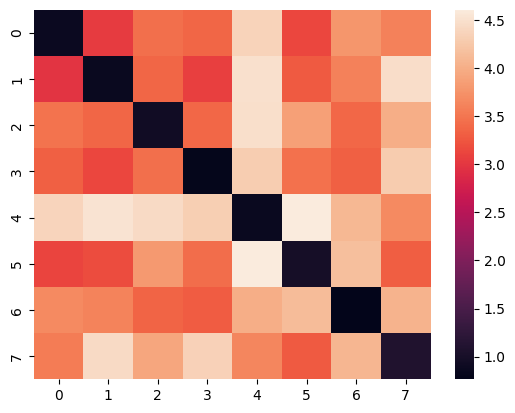

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 241.42it/s]


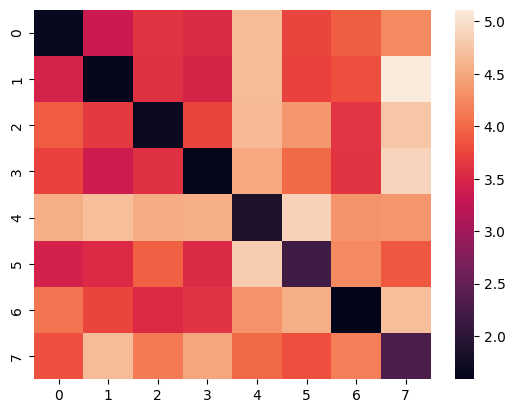

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 192.85it/s]


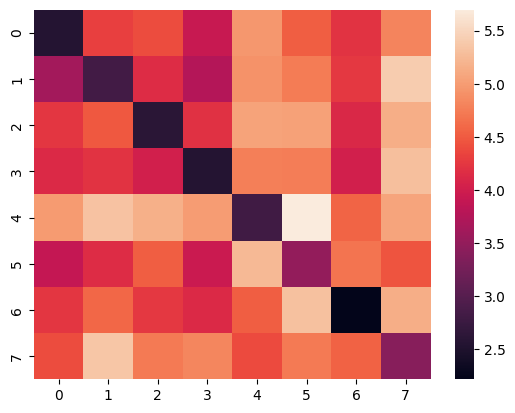

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 375.41it/s]


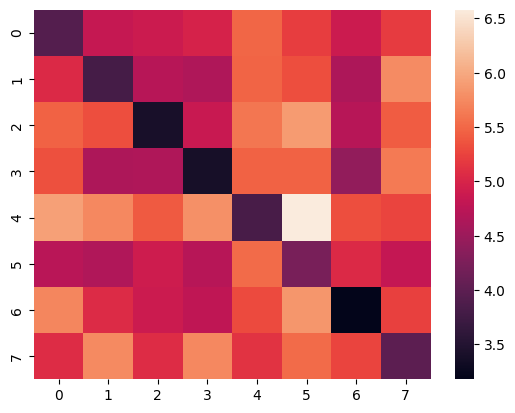

In [74]:
fixed_covariances = np.load('./results_simulation_202402_repeat/fixed_covariances.npy')
sigmas = [0.025,0.05,0.075,0.1]
for sigma in sigmas:
    covariances = np.concatenate((fixed_covariances[:8],
                                  perturb_covariances(fixed_covariances[:8],perturbation_factor=sigma)),axis=0)
    seaborn.heatmap(twopair_riemannian_distance(covariances[:8],covariances[8:]))
    plt.show()
    np.save(f'./results_simulation_202402_repeat/fixed_covariances_one_{sigma}.npy',covariances)

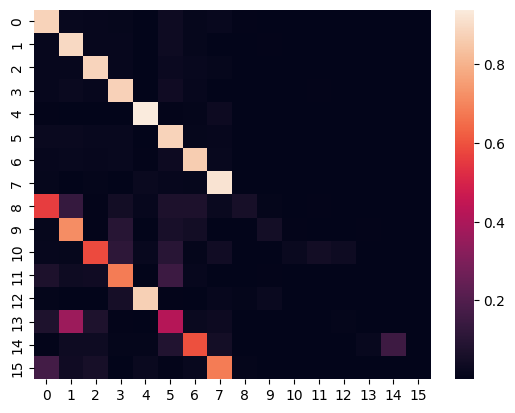

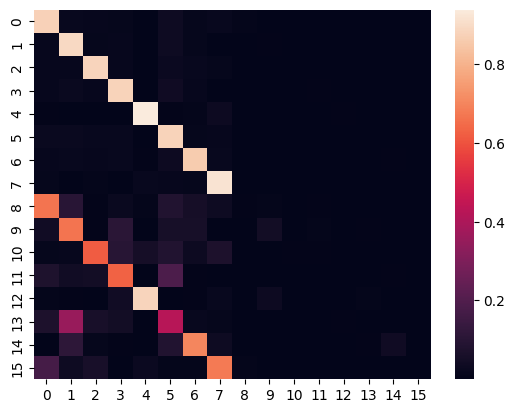

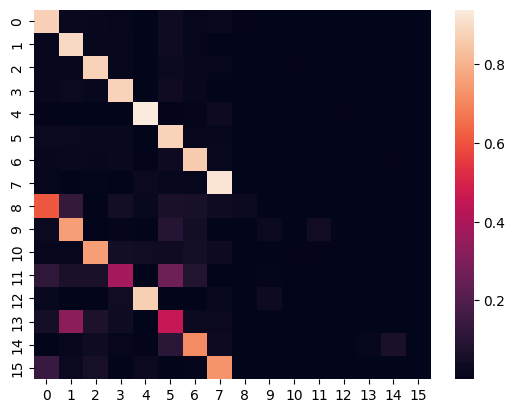

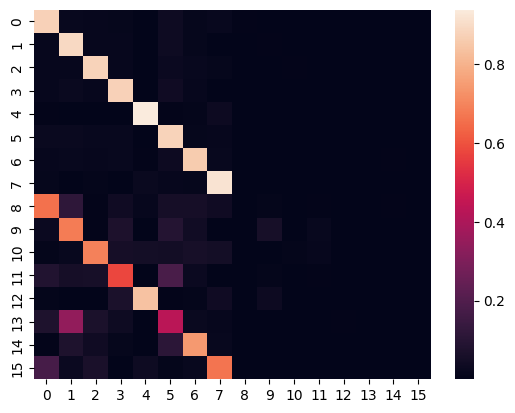

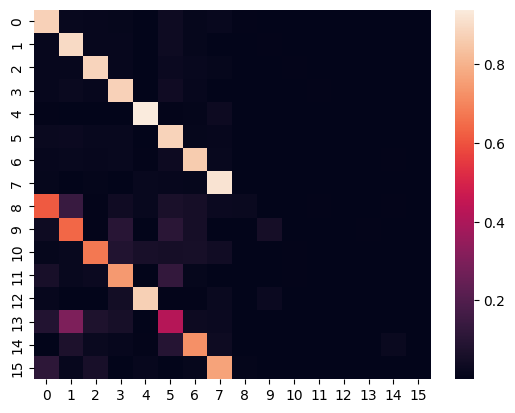

...

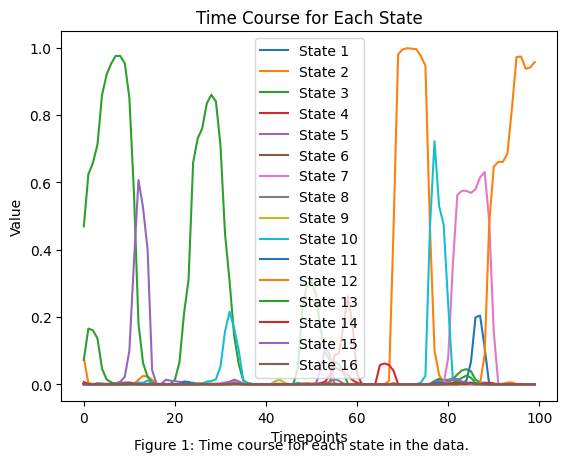

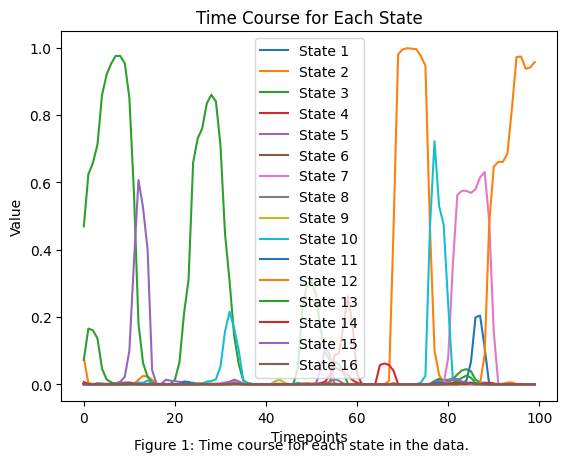

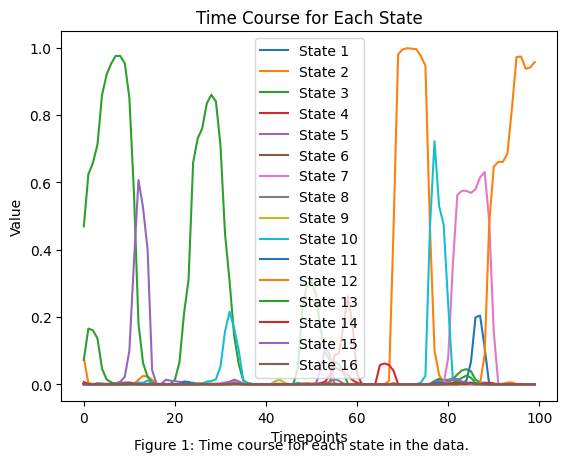

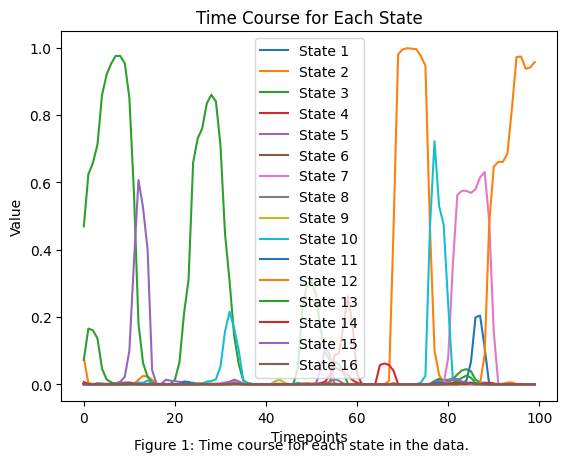

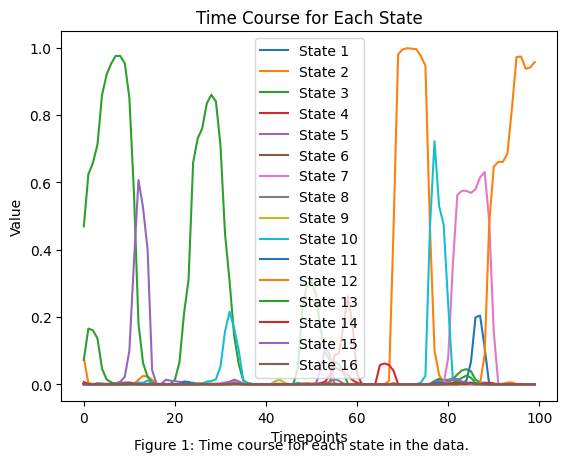

In [98]:
save_dir = './results_simulation_202402_repeat/cov_one_0.05/sigma_0/hmm_ICA_25_state_16/'
repeats = ['train','repeat_1','repeat_2','repeat_3','repeat_4','repeat_5']
covariance_truth = np.load('./results_simulation_202402_repeat/fixed_covariances_one_0.05.npy')
for repeat in repeats:
    tpm = np.load(f'{save_dir}{repeat}/model/trans_prob.npy')
    covariances = np.load(f'{save_dir}{repeat}/inf_params/covs.npy')
    means = np.load(f'{save_dir}{repeat}/inf_params/means.npy')
    npt.assert_almost_equal(means,0)
    npt.assert_almost_equal(covariance_truth,covariances,decimal=6)
    seaborn.heatmap(tpm)
    plt.show()

for repeat in repeats:
    with open(f'{save_dir}{repeat}/inf_params/alp.pkl','rb') as file:
        data = pickle.load(file)
        n_states = 16
        # Plot the time course for each state
        for state in range(n_states):
            plt.plot(alpha[0][300:400, state], label=f'State {state + 1}')

        # Add labels and legend
        plt.xlabel('Timepoints')
        plt.ylabel('Value')
        plt.title('Time Course for Each State')
        plt.legend()

        # Add a caption
        plt.figtext(0.5, 0.01, 'Figure 1: Time course for each state in the data.', ha='center')

        # Show the plot
        plt.show() 

But the question is: in real data, we never see identical states (at least states are slightly different). Is there large uncertainty of posterior on real data

In [152]:
save_dir = './results_HCP_202402_single_session/HMM_ICA_25_state_6/'
with open(f'{save_dir}alpha.pkl','rb') as file:
    alpha = pickle.load(file)

In [153]:
alpha[0].shape

(1200, 6)

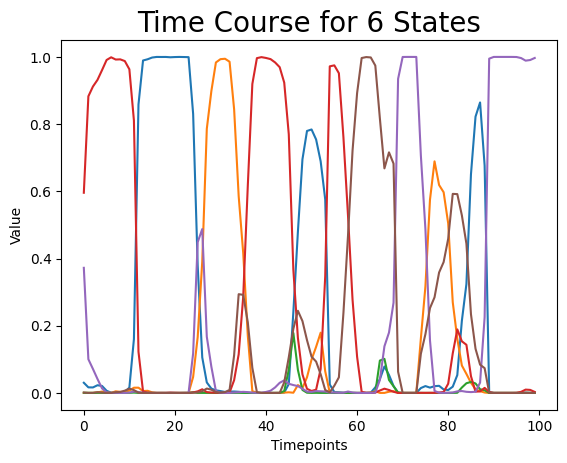

In [154]:
_,n_states = alpha[0].shape
# Plot the time course for each state
for state in range(n_states):
    plt.plot(alpha[0][300:400, state], label=f'State {state + 1}')

# Add labels and legend
plt.xlabel('Timepoints')
plt.ylabel('Value')
plt.title(f'Time Course for {n_states} States',fontsize=20)
#plt.legend()

# Add a caption
#plt.figtext(0.5, 0.01, 'Figure 1: Time course for each state in the data.', ha='center')

# Show the plot
plt.show() 

Maybe have a look at the free training on simulation data (with eight states as the ground truth, but you feed in 16 states)

In [167]:
save_dir = './results_simulation_202402/sigma_0/HMM_ICA_25_state_16/'
with open(f'{save_dir}alpha.pkl','rb') as file:
    alpha = pickle.load(file)

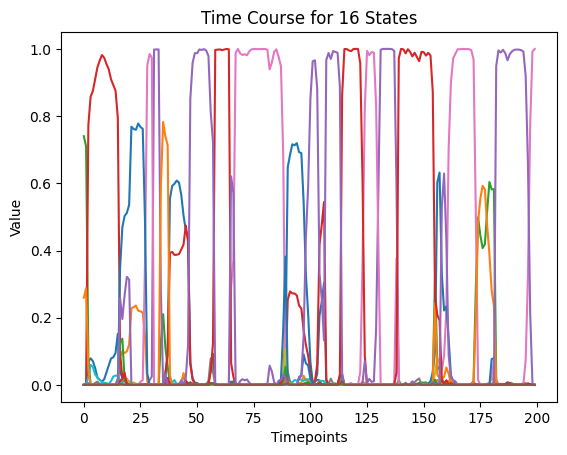

In [168]:
_,n_states = alpha[0].shape
# Plot the time course for each state
for state in range(n_states):
    plt.plot(alpha[0][500:700, state], label=f'State {state + 1}')

# Add labels and legend
plt.xlabel('Timepoints')
plt.ylabel('Value')
plt.title(f'Time Course for {n_states} States')
#plt.legend()

# Add a caption
#plt.figtext(0.5, 0.01, 'Figure 1: Time course for each state in the data.', ha='center')

# Show the plot
plt.show()

Now let's plot the temporal correlation of different models, which should be very interesting.

In [1]:
import os
import pickle
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn
from rotation.utils import calculate_temporal_correlation

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
save_dir = './results_simulation_202402_repeat/cov_0/sigma_0/hmm_ICA_25_state_16/'

In [3]:
repeats = ['train','repeat_1','repeat_2','repeat_3','repeat_4','repeat_5']

0.9580851516103333


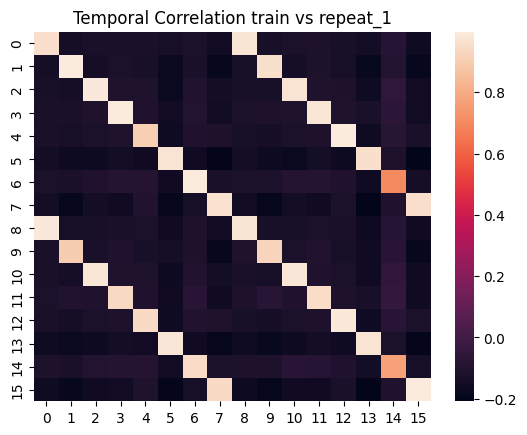

ValueError: 

In [8]:
for i in range(len(repeats)):
    with open(f'{save_dir}{repeats[i]}/inf_params/alp.pkl','rb') as file:
        alpha_1 = pickle.load(file)
    for j in range(i+1,len(repeats)):
        with open(f'{save_dir}{repeats[j]}/inf_params/alp.pkl','rb') as file:
            alpha_2 = pickle.load(file)
            correlation = calculate_temporal_correlation(alpha_1,alpha_2)
        seaborn.heatmap(correlation)
        print(np.mean(np.diagonal(correlation)))
        plt.title(f'Temporal Correlation {repeats[i]} vs {repeats[j]}')
        plt.show()
        raise ValueError('')

## Update 27th February 2024

Task1: Check the temporal reproducibility, does it give you any kind of information?

In [11]:
import os
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn
import pickle
from rotation.utils import *

In [12]:
save_dir = './results_HCP_yaml/'

In [13]:
N_states = list(range(2,37))

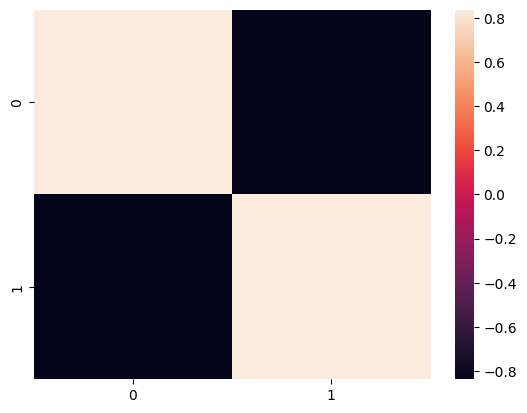

temporal_indice:{'row': [0, 1], 'col': [1, 0]}
temporal_correlation:0.8376270744223412


Computing Riemannian distances: 100%|███████████| 2/2 [00:00<00:00, 1133.29it/s]

spatial_indice:{'row': [0, 1], 'col': [1, 0]}
spatial_correlation:2.726120751824279


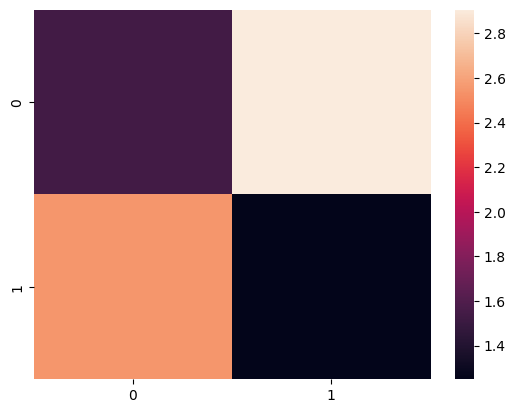

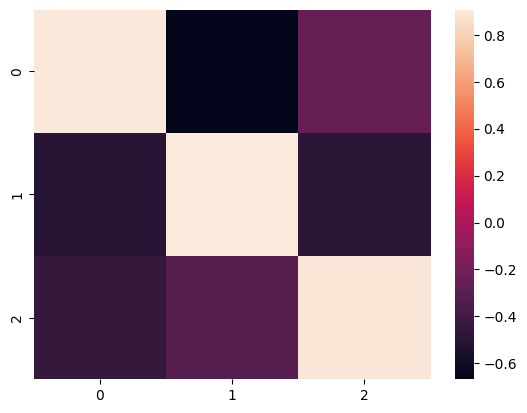

temporal_indice:{'row': [0, 1, 2], 'col': [0, 1, 2]}
temporal_correlation:0.8969399947484981


Computing Riemannian distances: 100%|████████████| 3/3 [00:00<00:00, 441.41it/s]

spatial_indice:{'row': [0, 1, 2], 'col': [2, 0, 1]}
spatial_correlation:3.3266567517521284


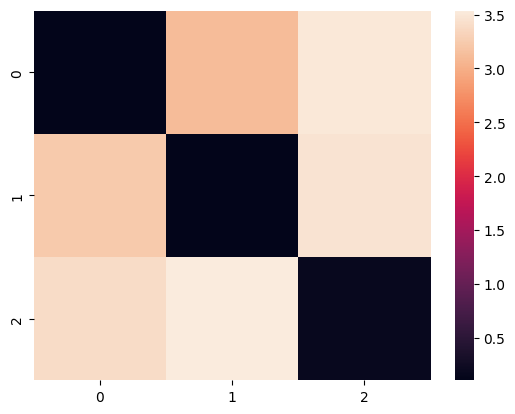

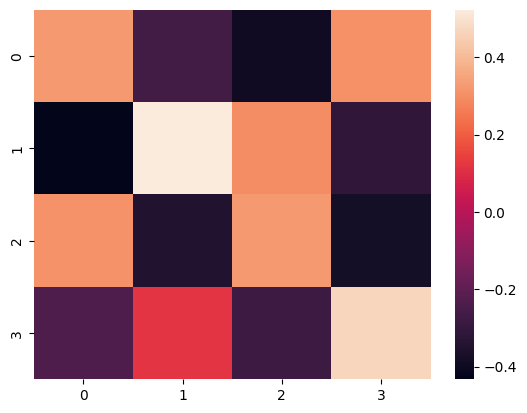

temporal_indice:{'row': [0, 1, 2, 3], 'col': [3, 1, 0, 2]}
temporal_correlation:0.4094449411653301


Computing Riemannian distances: 100%|████████████| 4/4 [00:00<00:00, 570.69it/s]

spatial_indice:{'row': [0, 1, 2, 3], 'col': [1, 0, 3, 2]}
spatial_correlation:3.1743475604337394


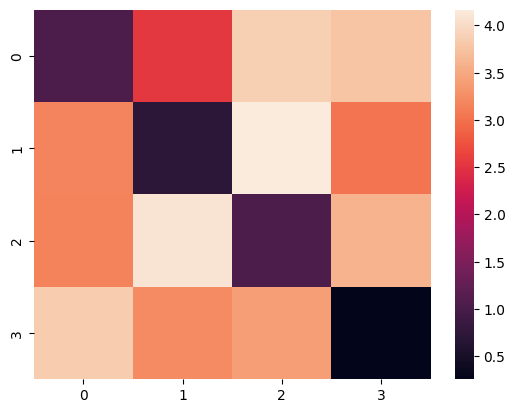

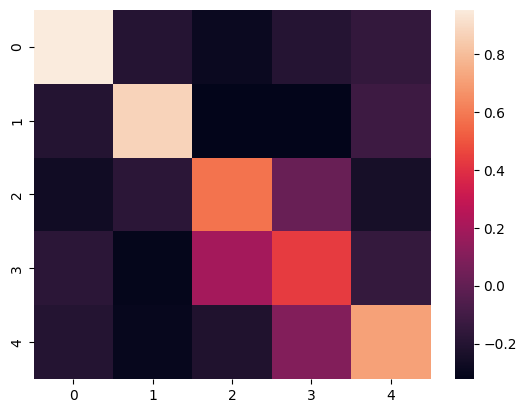

temporal_indice:{'row': [0, 1, 2, 3, 4], 'col': [1, 3, 2, 0, 4]}
temporal_correlation:0.7090019756185282


Computing Riemannian distances: 100%|████████████| 5/5 [00:00<00:00, 361.85it/s]

spatial_indice:{'row': [0, 1, 2, 3, 4], 'col': [1, 2, 3, 4, 0]}
spatial_correlation:3.446192127217877


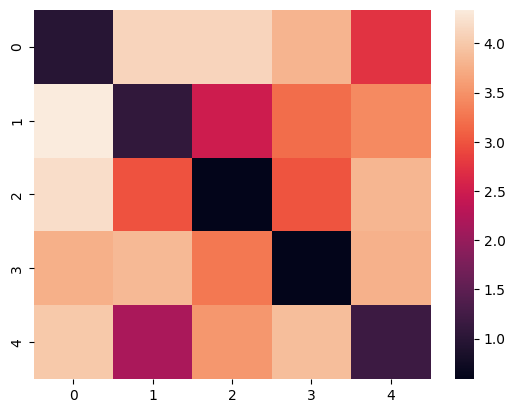

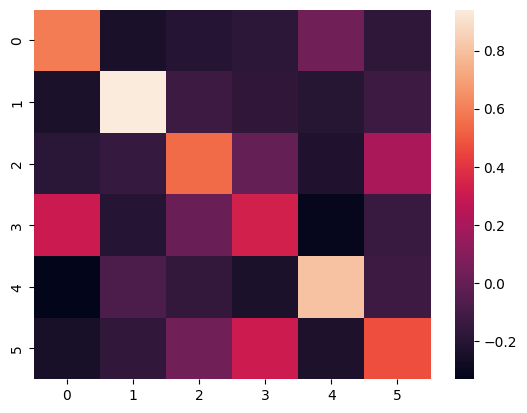

temporal_indice:{'row': [0, 1, 2, 3, 4, 5], 'col': [0, 5, 1, 3, 4, 2]}
temporal_correlation:0.6135764317385284


Computing Riemannian distances: 100%|████████████| 6/6 [00:00<00:00, 531.70it/s]

spatial_indice:{'row': [0, 1, 2, 3, 4, 5], 'col': [5, 2, 1, 3, 4, 0]}
spatial_correlation:3.0476257275804706


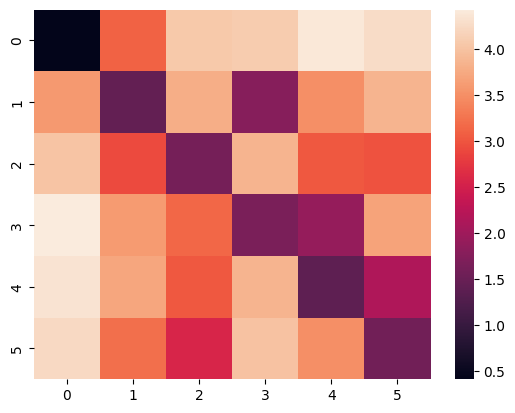

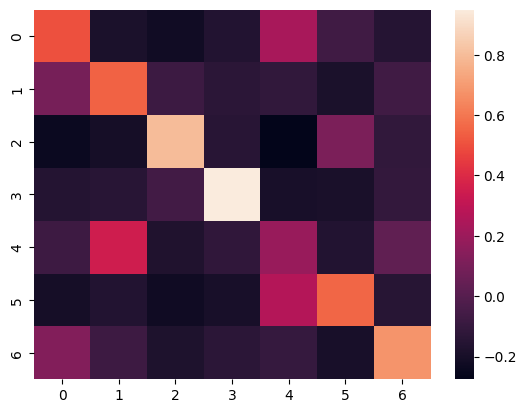

temporal_indice:{'row': [0, 1, 2, 3, 4, 5, 6], 'col': [5, 4, 2, 6, 0, 3, 1]}
temporal_correlation:0.6023831003740401


Computing Riemannian distances: 100%|████████████| 7/7 [00:00<00:00, 158.24it/s]

spatial_indice:{'row': [0, 1, 2, 3, 4, 5, 6], 'col': [0, 2, 4, 6, 3, 1, 5]}
spatial_correlation:3.4922319936827533


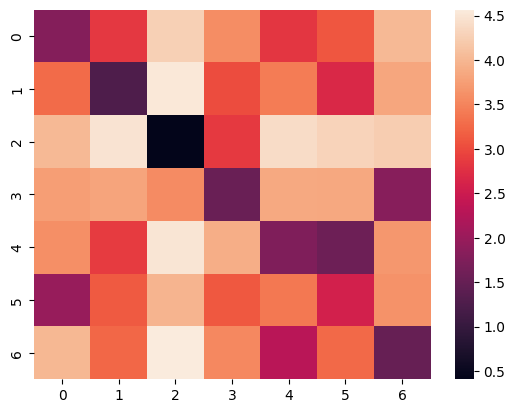

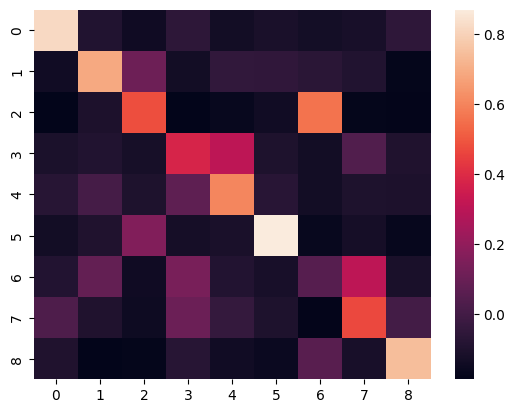

temporal_indice:{'row': [0, 1, 2, 3, 4, 5, 6, 7, 8], 'col': [4, 7, 0, 3, 5, 1, 6, 2, 8]}
temporal_correlation:0.5666194336670576


Computing Riemannian distances: 100%|████████████| 9/9 [00:00<00:00, 682.32it/s]

spatial_indice:{'row': [0, 1, 2, 3, 4, 5, 6, 7, 8], 'col': [3, 1, 2, 5, 8, 6, 0, 7, 4]}
spatial_correlation:2.7591610805691387


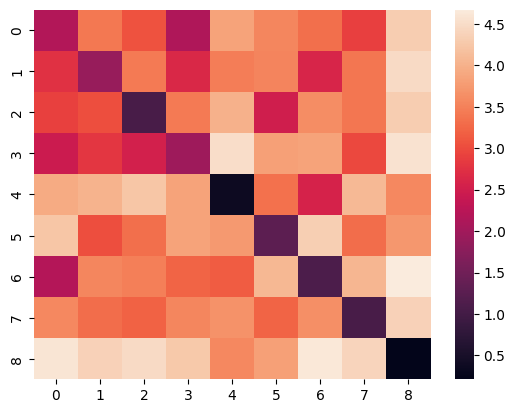

FileNotFoundError: [Errno 2] No such file or directory: './results_HCP_yaml/hmm_ICA_25_state_11/repeat_1/inf_params/alp.pkl'

In [24]:
for N_state in N_states:
    if (N_state == 8) or (N_state == 10):
        continue
    with open(f'{save_dir}hmm_ICA_25_state_{N_state}/repeat_1/inf_params/alp.pkl','rb') as file:
        alpha_1 = pickle.load(file)
    with open(f'{save_dir}hmm_ICA_25_state_{N_state}/repeat_2/inf_params/alp.pkl','rb') as file:
        alpha_2 = pickle.load(file)
    correlation = calculate_temporal_correlation(alpha_1,alpha_2)
    temporal_indice, correlation_pair = hungarian_pair(correlation)
    seaborn.heatmap(correlation_pair)
    plt.show()
    print(f'temporal_indice:{temporal_indice}')
    print(f'temporal_correlation:{np.mean(np.diagonal(correlation_pair))}')
    cov_1 = np.load(f'{save_dir}hmm_ICA_25_state_{N_state}/repeat_4/inf_params/covs.npy')
    cov_2 = np.load(f'{save_dir}hmm_ICA_25_state_{N_state}/repeat_5/inf_params/covs.npy')
    riem_distance = twopair_riemannian_distance(cov_1,cov_2)
    spatial_indice, riem_distance_pair = hungarian_pair(riem_distance,distance=True)
    print(f'spatial_indice:{spatial_indice}')
    print(f'spatial_correlation:{np.mean(np.diagonal(riem_distance))}')
    seaborn.heatmap(riem_distance_pair)
    plt.show()
          
    

## Update 4th March 2024

Now we're going to analysis the results obtained previously. There are three folders as follows:
- Simulation data with covariance fixed: `results_simulation_202402_repeat`
- Simulation data with free covariance: `results_simulation_202403`
- HCP data with free covariance: `results_HCP_yaml_202403`

In [18]:
import os
import yaml
import pickle

import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
from rotation.utils import *

### Question 1: When you have repeated states, there are run-to-run variability.

Does it impact the run-to-run variability? Maybe some states are silenced.

In [94]:
from osl_dynamics.utils.plotting import plot_matrices
from osl_dynamics.analysis.modes import fractional_occupancies
from osl_dynamics.utils.plotting import plot_violin

In [95]:
save_dir = './results_simulation_202402_repeat/cov_0/sigma_0/hmm_ICA_25_state_16/'
repeats = ['train','repeat_1','repeat_2','repeat_3','repeat_4','repeat_5']

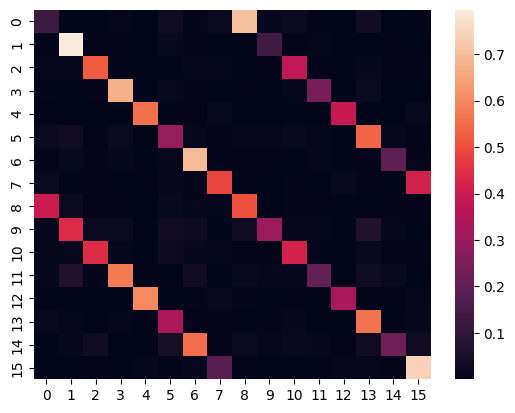

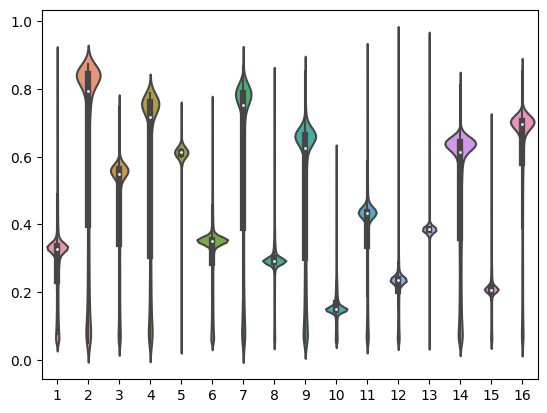

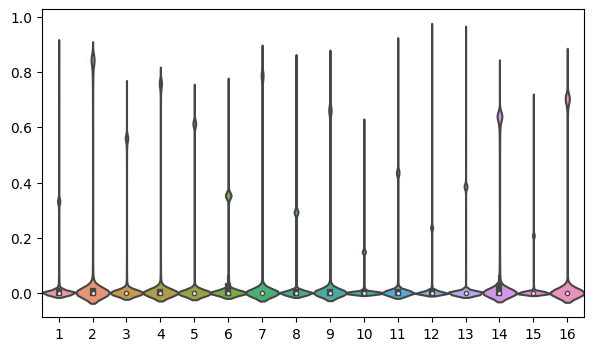

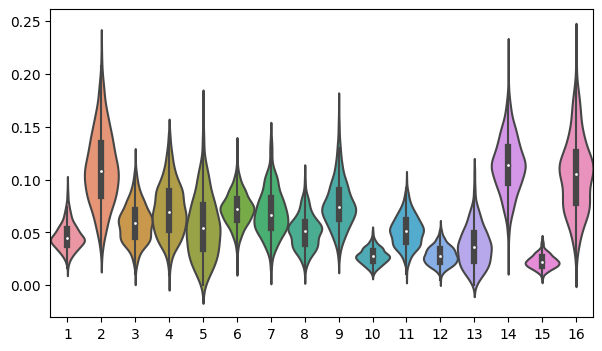

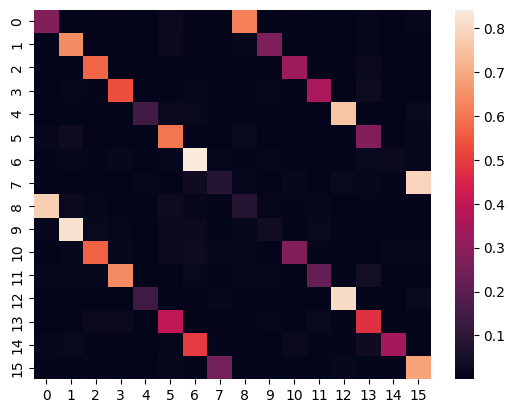

...

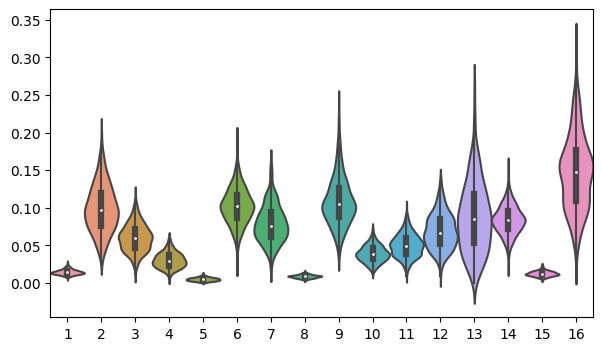

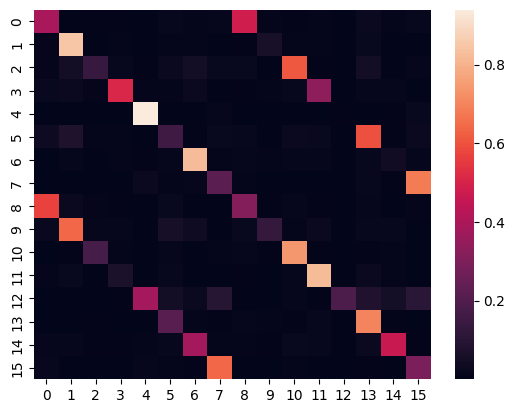

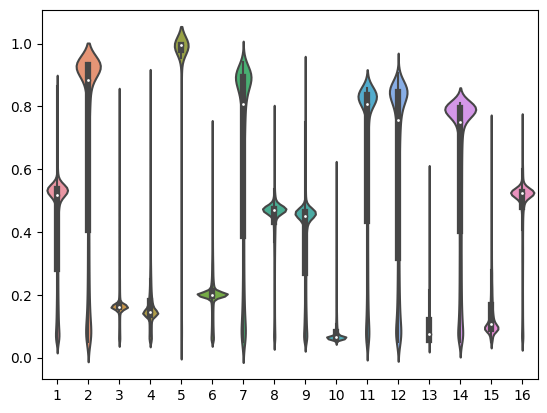

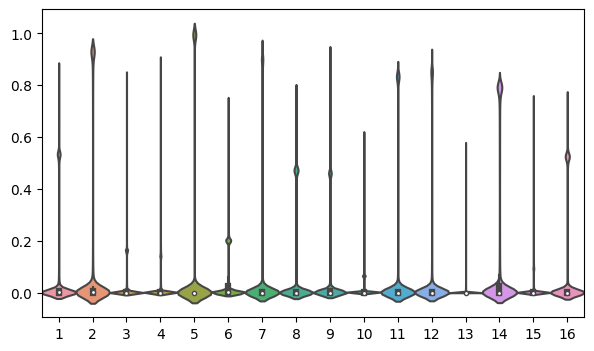

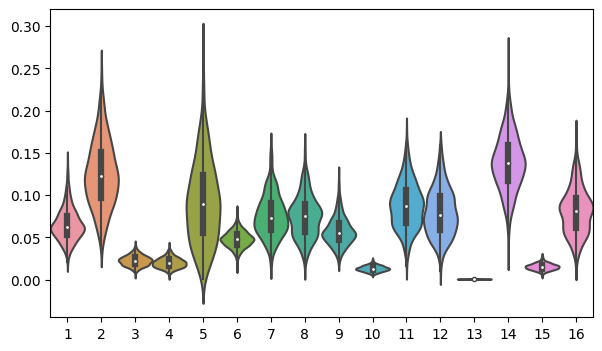

In [26]:
for repeat in repeats:
    tpm = np.load(f'{save_dir}{repeat}/model/trans_prob.npy')
    #fig,ax = plot_matrices(tpm)  
    seaborn.heatmap(tpm)
    plt.show()
    
    with open(f'{save_dir}{repeat}/inf_params/alp.pkl','rb') as file:
        alpha = pickle.load(file)
        
    fo = fractional_occupancies(alpha)
    
    alpha_plot = np.concatenate(alpha,axis=0).T
    
    x, y = [], []
    for i in range(len(alpha_plot)):
        alpha_state = alpha_plot[i]
        temp = alpha_state[alpha_state>0.05]
        x.append(np.ones(len(temp)) * (i+1))
        y.append(temp)
    
    x = np.concatenate(x,axis=0).astype(int)
    y = np.concatenate(y,axis=0)
    
    sns_kwargs = {'scale':'count','width': 1}
    sns.violinplot(x=x,y=y,**sns_kwargs)
    #np.concatenate(alpha,axis=0).T,fig_kwargs={'figsize': (10, 4)},sns_kwargs = {'scale':'count','width': 1})
    plt.show()
    
    fig,ax = plot_violin(alpha_plot,
                         #fig_kwargs={'figsize': (10, 4)},
                         sns_kwargs = {'scale':'count','width': 1})
    plt.show()
    
    fig,ax = plot_violin(fo.T,
                         #fig_kwargs={'figsize': (10, 4)},
                         sns_kwargs = {'scale':'count','width': 1})
    plt.show()
    
    


Conclusion: when states are "repeated", there are run-to-run variability in fractional occupancy. For example, you can see the state 5 and 13 has very different fo in the five runs.

Next, have a look at the temporal correlation of these states. Maybe have a look at repeat 2 and repeat 4 since state 5 is muted in repeat 2 while state 13 is muted in repeat 4.

In [96]:
from rotation.utils import calculate_temporal_correlation
from osl_dynamics.inference.modes import argmax_time_courses

In [97]:
with open(f'{save_dir}repeat_3/inf_params/alp.pkl','rb') as file:
    alpha_1 = pickle.load(file)
with open(f'{save_dir}repeat_4/inf_params/alp.pkl','rb') as file:
    alpha_2 = pickle.load(file)

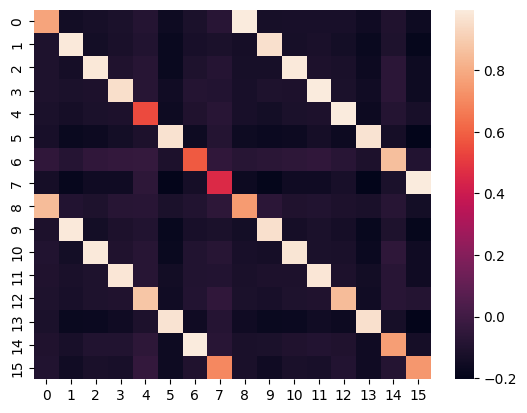

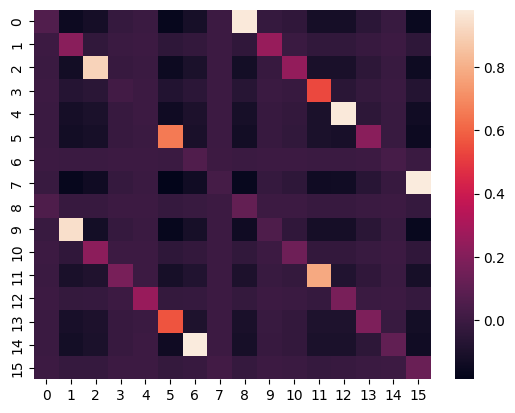

In [101]:
cor = calculate_temporal_correlation(alpha_1,alpha_2)
seaborn.heatmap(cor)
plt.show()
cor_argmax = calculate_temporal_correlation(argmax_time_courses(alpha_1),argmax_time_courses(alpha_2))
seaborn.heatmap(cor_argmax)
plt.show()

Conclusion: there is still decent correlation between state 5 and 13 in the temporal dynamics. It seems that when the model is very good, you can have run-to-run variability in fractional occupancy, but the temporal correlation is itself very high.
Fractional occupancy variability might be important.

## Question2: Is spatial correlation equivalent to temporal correlation 

Now let's work on the simulation data, where the covariance matrices are free to train. We are asking: is temporal correlation equivalent to spatial correlation? i.e. States are spatially paired should be temporally paired?

In [108]:
import os
import yaml
import pickle
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn

In [116]:
save_dir = './results_simulation_202403/sigma_0/'
N_states = list(range(2,17))
repeats = ['train','repeat_1','repeat_2','repeat_3','repeat_4','repeat_5']

First you need to extract the correlations.

In [117]:
from osl_dynamics.array_ops import cov2stdcorr

In [118]:
for N_state in N_states:
    for repeat in repeats:
        analysis_dir = f'{save_dir}hmm_ICA_25_state_{N_state}/{repeat}/analysis/'
        if not os.path.exists(analysis_dir):
            os.makedirs(analysis_dir)
        covs = np.load(f'{save_dir}hmm_ICA_25_state_{N_state}/{repeat}/inf_params/covs.npy')
        np.save(f'{analysis_dir}covs.npy',covs)
        stds,corrs =cov2stdcorr(covs)
        np.save(f'{analysis_dir}stds.npy',stds)
        np.save(f'{analysis_dir}corrs.npy',corrs)

In [119]:
from osl_dynamics.inference.metrics import twopair_fisher_z_correlations
from osl_dynamics.inference.modes import hungarian_pair
from osl_dynamics.utils.plotting import plot_mode_pairing

In [120]:
for N_state in N_states:
    analysis_dir = f'{save_dir}hmm_ICA_25_state_{N_state}/analysis/'
    if not os.path.exists(analysis_dir):
        os.makedirs(analysis_dir)
    for i in range(len(repeats)):
        for j in range(i+1,len(repeats)):
            corrs_1 = np.load(f'{save_dir}hmm_ICA_25_state_{N_state}/{repeats[i]}/analysis/corrs.npy')
            corrs_2 = np.load(f'{save_dir}hmm_ICA_25_state_{N_state}/{repeats[j]}/analysis/corrs.npy')
            indices, cor = hungarian_pair(twopair_fisher_z_correlations(corrs_1,corrs_2),distance=False)
            np.save(f'{analysis_dir}spatial_cor_{repeats[i]}_vs_{repeats[j]}.npy',cor)
            indices['mean'] = np.mean(np.diagonal(cor))
            # Open the file in binary write mode
            with open(f'{analysis_dir}spatial_pair_{repeats[i]}_vs_{repeats[j]}.pkl', "wb") as f:
                pickle.dump(indices, f)
            plot_mode_pairing(cor,
                              indices,
                              x_label=repeats[j],
                              y_label=repeats[i],
                              title=f'Spatial correlation {repeats[i]} vs {repeats[j]}',
                              filename=f'{analysis_dir}spatial_cor_{repeats[i]}_vs_{repeats[j]}.jpg')

Compute twopair Fisher-z transformated correlation: 100%|█| 2/2 [00:00<00:00, 16
2024-03-08 16:08:26 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_2/analysis/spatial_cor_train_vs_repeat_1.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 2/2 [00:00<00:00, 10
2024-03-08 16:08:26 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_2/analysis/spatial_cor_train_vs_repeat_2.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 2/2 [00:00<00:00, 10
2024-03-08 16:08:27 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_2/analysis/spatial_cor_train_vs_repeat_3.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 2/2 [00:00<00:00, 10
2024-03-08 16:08:27 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_2/analysis/spatial_cor_train_vs_repeat_4.jpg
Compute 

Compute twopair Fisher-z transformated correlation: 100%|█| 4/4 [00:00<00:00, 91
2024-03-08 16:08:32 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_4/analysis/spatial_cor_train_vs_repeat_4.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 4/4 [00:00<00:00, 88
2024-03-08 16:08:32 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_4/analysis/spatial_cor_train_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 4/4 [00:00<00:00, 78
2024-03-08 16:08:32 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_4/analysis/spatial_cor_repeat_1_vs_repeat_2.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 4/4 [00:00<00:00, 99
2024-03-08 16:08:32 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_4/analysis/spatial_cor_repeat_1_vs_repeat_3.jpg
Co

Compute twopair Fisher-z transformated correlation: 100%|█| 6/6 [00:00<00:00, 86
2024-03-08 16:08:39 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_6/analysis/spatial_cor_repeat_1_vs_repeat_3.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 6/6 [00:00<00:00, 85
2024-03-08 16:08:39 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_6/analysis/spatial_cor_repeat_1_vs_repeat_4.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 6/6 [00:00<00:00, 97
2024-03-08 16:08:39 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_6/analysis/spatial_cor_repeat_1_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 6/6 [00:00<00:00, 98
2024-03-08 16:08:39 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_6/analysis/spatial_cor_repeat_2_vs_repeat_3.

Compute twopair Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 73
2024-03-08 16:08:44 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_8/analysis/spatial_cor_repeat_2_vs_repeat_3.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 69
2024-03-08 16:08:44 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_8/analysis/spatial_cor_repeat_2_vs_repeat_4.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 77
2024-03-08 16:08:44 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_8/analysis/spatial_cor_repeat_2_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 77
2024-03-08 16:08:44 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_8/analysis/spatial_cor_repeat_3_vs_repeat_4.

Compute twopair Fisher-z transformated correlation: 100%|█| 10/10 [00:00<00:00, 
2024-03-08 16:08:50 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_10/analysis/spatial_cor_repeat_3_vs_repeat_4.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 10/10 [00:00<00:00, 
2024-03-08 16:08:50 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_10/analysis/spatial_cor_repeat_3_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 10/10 [00:00<00:00, 
2024-03-08 16:08:50 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_10/analysis/spatial_cor_repeat_4_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 11/11 [00:00<00:00, 
2024-03-08 16:08:50 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_11/analysis/spatial_cor_train_vs_repeat_1

Compute twopair Fisher-z transformated correlation: 100%|█| 13/13 [00:00<00:00, 
2024-03-08 16:08:57 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_13/analysis/spatial_cor_train_vs_repeat_1.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 13/13 [00:00<00:00, 
2024-03-08 16:08:57 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_13/analysis/spatial_cor_train_vs_repeat_2.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 13/13 [00:00<00:00, 
2024-03-08 16:08:57 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_13/analysis/spatial_cor_train_vs_repeat_3.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 13/13 [00:00<00:00, 
2024-03-08 16:08:57 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_13/analysis/spatial_cor_train_vs_repeat_4.jpg
Comp

Compute twopair Fisher-z transformated correlation: 100%|█| 15/15 [00:00<00:00, 
2024-03-08 16:09:04 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_15/analysis/spatial_cor_train_vs_repeat_4.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 15/15 [00:00<00:00, 
2024-03-08 16:09:04 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_15/analysis/spatial_cor_train_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 15/15 [00:00<00:00, 
2024-03-08 16:09:04 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_15/analysis/spatial_cor_repeat_1_vs_repeat_2.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 15/15 [00:00<00:00, 
2024-03-08 16:09:04 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_15/analysis/spatial_cor_repeat_1_vs_repeat_3.jp

Spatial mapping has been finished. Now let's work on the temporal mapping

In [122]:
import pickle
from osl_dynamics.inference.metrics import alpha_correlation

In [123]:
for N_state in N_states:
    analysis_dir = f'{save_dir}hmm_ICA_25_state_{N_state}/analysis/'
    if not os.path.exists(analysis_dir):
        os.makedirs(analysis_dir)
    for i in range(len(repeats)):
        for j in range(i+1,len(repeats)):
            with open(f'{save_dir}hmm_ICA_25_state_{N_state}/{repeats[i]}/inf_params/alp.pkl','rb') as file:
                alpha_1 = pickle.load(file)
            with open(f'{save_dir}hmm_ICA_25_state_{N_state}/{repeats[j]}/inf_params/alp.pkl','rb') as file:
                alpha_2 = pickle.load(file)
            indices, cor = hungarian_pair(alpha_correlation(alpha_1,alpha_2,return_diagonal=False),distance=False)
            np.save(f'{analysis_dir}temp_cor_{repeats[i]}_vs_{repeats[j]}.npy',cor)
            indices['mean'] = np.mean(np.diagonal(cor))
            # Open the file in binary write mode
            with open(f'{analysis_dir}temp_pair_{repeats[i]}_vs_{repeats[j]}.pkl', "wb") as f:
                pickle.dump(indices, f)
            plot_mode_pairing(cor,
                              indices,
                              x_label=repeats[j],
                              y_label=repeats[i],
                              title=f'Temporal correlation {repeats[i]} vs {repeats[j]}',
                              filename=f'{analysis_dir}temp_cor_{repeats[i]}_vs_{repeats[j]}.jpg')
            
            indices_argmax, cor_argmax = hungarian_pair(alpha_correlation(argmax_time_courses(alpha_1),argmax_time_courses(alpha_2),return_diagonal=False),distance=False)
            np.save(f'{analysis_dir}temp_argmax_cor_{repeats[i]}_vs_{repeats[j]}.npy',cor_argmax)
            indices_argmax['mean'] = np.mean(np.diagonal(cor_argmax))
            # Open the file in binary write mode
            with open(f'{analysis_dir}temp_argmax_pair_{repeats[i]}_vs_{repeats[j]}.pkl', "wb") as f:
                pickle.dump(indices_argmax, f)
            plot_mode_pairing(cor_argmax,
                              indices_argmax,
                              x_label=repeats[j],
                              y_label=repeats[i],
                              title=f'Temporal argmax correlation {repeats[i]} vs {repeats[j]}',
                              filename=f'{analysis_dir}temp_argmax_cor_{repeats[i]}_vs_{repeats[j]}.jpg')

2024-03-08 16:09:10 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_2/analysis/temp_cor_train_vs_repeat_1.jpg
2024-03-08 16:09:11 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_2/analysis/temp_argmax_cor_train_vs_repeat_1.jpg
2024-03-08 16:09:11 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_2/analysis/temp_cor_train_vs_repeat_2.jpg
2024-03-08 16:09:11 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_2/analysis/temp_argmax_cor_train_vs_repeat_2.jpg
2024-03-08 16:09:11 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_2/analysis/temp_cor_train_vs_repeat_3.jpg
2024-03-08 16:09:11 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_2/analysis/temp_argmax_cor_train_vs_repeat_3

2024-03-08 16:09:19 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_3/analysis/temp_argmax_cor_repeat_2_vs_repeat_3.jpg
2024-03-08 16:09:19 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_3/analysis/temp_cor_repeat_2_vs_repeat_4.jpg
2024-03-08 16:09:21 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_3/analysis/temp_argmax_cor_repeat_2_vs_repeat_4.jpg
2024-03-08 16:09:21 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_3/analysis/temp_cor_repeat_2_vs_repeat_5.jpg
2024-03-08 16:09:21 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_3/analysis/temp_argmax_cor_repeat_2_vs_repeat_5.jpg
2024-03-08 16:09:21 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_3/analysis/temp_cor_re

2024-03-08 16:09:31 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_5/analysis/temp_cor_train_vs_repeat_5.jpg
2024-03-08 16:09:31 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_5/analysis/temp_argmax_cor_train_vs_repeat_5.jpg
2024-03-08 16:09:31 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_5/analysis/temp_cor_repeat_1_vs_repeat_2.jpg
2024-03-08 16:09:32 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_5/analysis/temp_argmax_cor_repeat_1_vs_repeat_2.jpg
2024-03-08 16:09:32 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_5/analysis/temp_cor_repeat_1_vs_repeat_3.jpg
2024-03-08 16:09:32 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_5/analysis/temp_argmax_cor_repeat_1

2024-03-08 16:09:43 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_6/analysis/temp_argmax_cor_repeat_3_vs_repeat_5.jpg
2024-03-08 16:09:43 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_6/analysis/temp_cor_repeat_4_vs_repeat_5.jpg
2024-03-08 16:09:43 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_6/analysis/temp_argmax_cor_repeat_4_vs_repeat_5.jpg
2024-03-08 16:09:44 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_7/analysis/temp_cor_train_vs_repeat_1.jpg
2024-03-08 16:09:44 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_7/analysis/temp_argmax_cor_train_vs_repeat_1.jpg
2024-03-08 16:09:44 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_7/analysis/temp_cor_train_vs

2024-03-08 16:09:57 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_8/analysis/temp_cor_repeat_1_vs_repeat_5.jpg
2024-03-08 16:09:57 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_8/analysis/temp_argmax_cor_repeat_1_vs_repeat_5.jpg
2024-03-08 16:09:58 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_8/analysis/temp_cor_repeat_2_vs_repeat_3.jpg
2024-03-08 16:09:58 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_8/analysis/temp_argmax_cor_repeat_2_vs_repeat_3.jpg
2024-03-08 16:09:58 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_8/analysis/temp_cor_repeat_2_vs_repeat_4.jpg
2024-03-08 16:09:59 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_8/analysis/temp_argmax_cor_re

2024-03-08 16:10:14 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_10/analysis/temp_argmax_cor_train_vs_repeat_3.jpg
2024-03-08 16:10:14 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_10/analysis/temp_cor_train_vs_repeat_4.jpg
2024-03-08 16:10:15 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_10/analysis/temp_argmax_cor_train_vs_repeat_4.jpg
2024-03-08 16:10:15 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_10/analysis/temp_cor_train_vs_repeat_5.jpg
2024-03-08 16:10:15 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_10/analysis/temp_argmax_cor_train_vs_repeat_5.jpg
2024-03-08 16:10:16 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_10/analysis/temp_cor_repeat_1_vs

2024-03-08 16:10:32 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_11/analysis/temp_cor_repeat_3_vs_repeat_4.jpg
2024-03-08 16:10:33 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_11/analysis/temp_argmax_cor_repeat_3_vs_repeat_4.jpg
2024-03-08 16:10:33 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_11/analysis/temp_cor_repeat_3_vs_repeat_5.jpg
2024-03-08 16:10:33 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_11/analysis/temp_argmax_cor_repeat_3_vs_repeat_5.jpg
2024-03-08 16:10:34 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_11/analysis/temp_cor_repeat_4_vs_repeat_5.jpg
2024-03-08 16:10:34 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_11/analysis/temp_argmax_

2024-03-08 16:10:53 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_13/analysis/temp_argmax_cor_repeat_1_vs_repeat_3.jpg
2024-03-08 16:10:54 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_13/analysis/temp_cor_repeat_1_vs_repeat_4.jpg
2024-03-08 16:10:54 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_13/analysis/temp_argmax_cor_repeat_1_vs_repeat_4.jpg
2024-03-08 16:10:54 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_13/analysis/temp_cor_repeat_1_vs_repeat_5.jpg
2024-03-08 16:10:55 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_13/analysis/temp_argmax_cor_repeat_1_vs_repeat_5.jpg
2024-03-08 16:10:55 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_13/analysis/temp_

2024-03-08 16:11:15 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_15/analysis/temp_argmax_cor_train_vs_repeat_1.jpg
2024-03-08 16:11:16 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_15/analysis/temp_cor_train_vs_repeat_2.jpg
2024-03-08 16:11:17 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_15/analysis/temp_argmax_cor_train_vs_repeat_2.jpg
2024-03-08 16:11:17 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_15/analysis/temp_cor_train_vs_repeat_3.jpg
2024-03-08 16:11:18 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_15/analysis/temp_argmax_cor_train_vs_repeat_3.jpg
2024-03-08 16:11:18 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_15/analysis/temp_cor_train_vs_re

2024-03-08 16:11:40 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_16/analysis/temp_cor_repeat_2_vs_repeat_4.jpg
2024-03-08 16:11:41 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_16/analysis/temp_argmax_cor_repeat_2_vs_repeat_4.jpg
2024-03-08 16:11:41 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_16/analysis/temp_cor_repeat_2_vs_repeat_5.jpg
2024-03-08 16:11:42 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_16/analysis/temp_argmax_cor_repeat_2_vs_repeat_5.jpg
2024-03-08 16:11:42 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_16/analysis/temp_cor_repeat_3_vs_repeat_4.jpg
2024-03-08 16:11:43 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_202403/sigma_0/hmm_ICA_25_state_16/analysis/temp_argmax_

Looking at the case on simulation data when N_states = 16. There are at least two claims we can obtain:
- Spatial pairing is very similar to temporal pairing, but not necessarily the same.
- Poor spatial pairing does not damage the mean diagonal value too much, but this is not the case if we calculate temporal pairing.

Hypothesis: Temporal pairing correlation is more sensitive to the optimal number of states.
This holds at least on simulation data. And you do not even need to "split-half". Train multiple models on the same dataset is enough.

In [124]:
save_dir = './results_simulation_202403/sigma_0/'
N_states = list(range(2,17))
repeats = ['train','repeat_1','repeat_2','repeat_3','repeat_4','repeat_5']

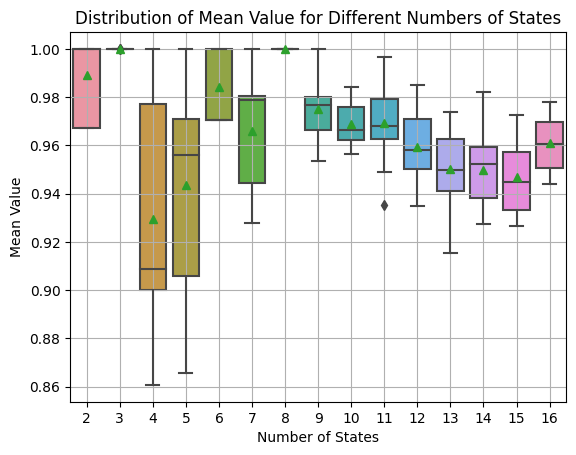

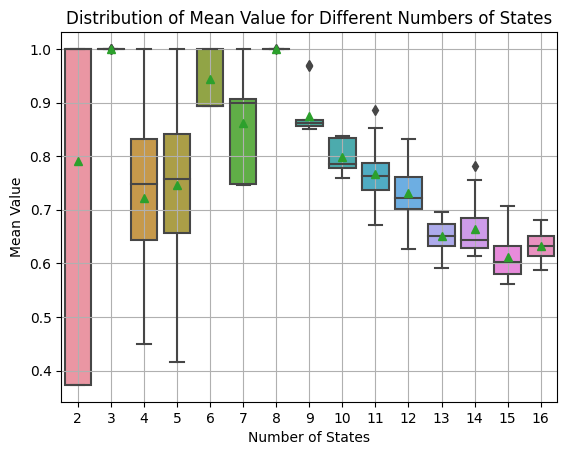

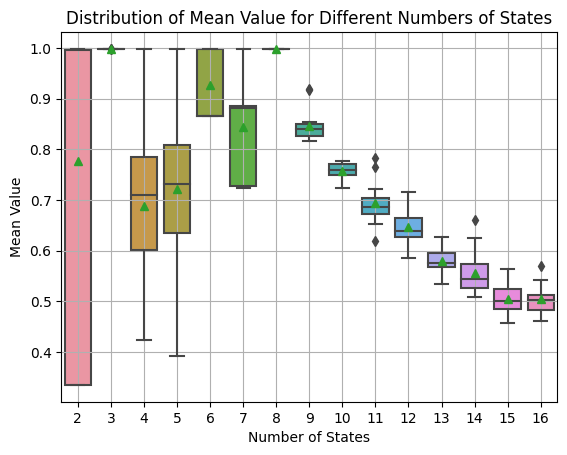

In [125]:
import seaborn as sns

summary_dir = f'{save_dir}summary/'
if not os.path.exists(summary_dir):
    os.makedirs(summary_dir)

for metric in ['spatial','temp','temp_argmax']:
    # Initialize a dictionary to store mean values for each number of states
    mean_values_dict = {N_state: [] for N_state in N_states}

    # Loop through each value of N_states
    for N_state in N_states:
        # Loop through each pair of repeats
        for i in range(len(repeats)):
            for j in range(i + 1, len(repeats)):
                # Define the path to the pickle file
                file_path = os.path.join(save_dir, f'hmm_ICA_25_state_{N_state}/analysis/{metric}_pair_{repeats[i]}_vs_{repeats[j]}.pkl')
                # Load the pickle file
                with open(file_path, 'rb') as f:
                    data = pickle.load(f)
                # Extract the 'mean' value and append it to the dictionary
                mean_value = data['mean']
                mean_values_dict[N_state].append(mean_value)

    # Plot boxplots of the mean values for each number of states
    sns.boxplot(data=list(mean_values_dict.values()), showmeans=True)
    plt.xlabel('Number of States')
    plt.ylabel('Mean Value')
    plt.title('Distribution of Mean Value for Different Numbers of States')
    plt.xticks(ticks=range(len(N_states)), labels=N_states)
    plt.grid(True)
    plt.show()

In [126]:
save_dir = './results_simulation_202403/sigma_0/'
N_states = list(range(2,17))
repeats = ['train','repeat_1','repeat_2','repeat_3','repeat_4','repeat_5']

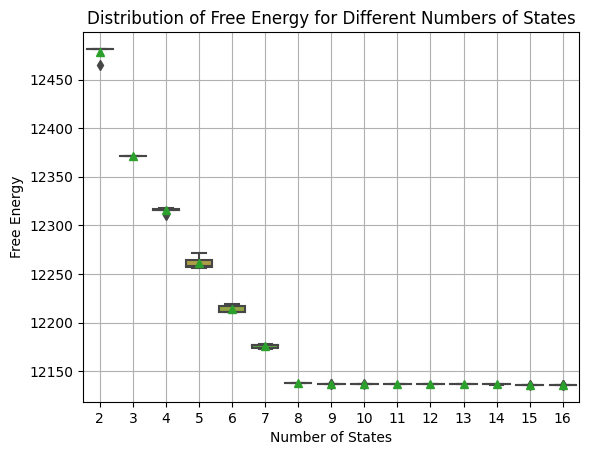

In [127]:
import json

# Initialize a dictionary to store free energy values for each number of states
free_energy_dict = {N_state: [] for N_state in N_states}

# Loop through each value of N_states
for N_state in N_states:
    # Loop through each repeat
    for repeat in repeats:
        # Define the path to the JSON file for the free energy
        file_path = os.path.join(save_dir, f'hmm_ICA_25_state_{N_state}/{repeat}/metrics/metrics.json')
        # Load the JSON file
        with open(file_path, 'r') as f:
            metrics = json.load(f)
        # Extract the 'free_energy' value and append it to the dictionary
        free_energy = metrics['free_energy']
        free_energy_dict[N_state].append(free_energy)

# Plot boxplots of the free energy values for each number of states
sns.boxplot(data=list(free_energy_dict.values()), showmeans=True)
plt.xlabel('Number of States')
plt.ylabel('Free Energy')
plt.title('Distribution of Free Energy for Different Numbers of States')
plt.xticks(ticks=range(len(N_states)), labels=N_states)
plt.grid(True)
plt.show()

In [35]:
save_dir = './results_simulation_202403/sigma_0/'
N_states = list(range(2,17))
repeats = ['train','repeat_1','repeat_2','repeat_3','repeat_4','repeat_5']

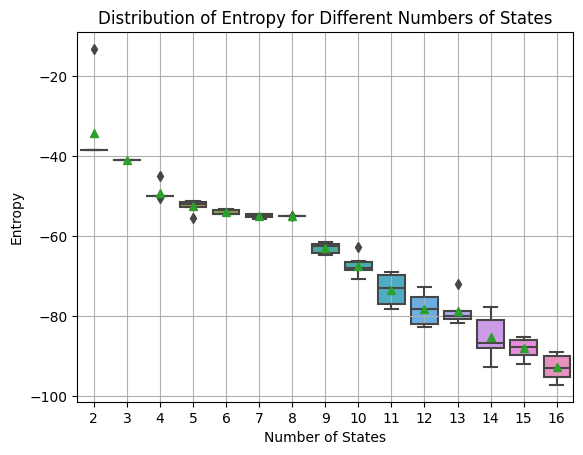

In [36]:
import json

# Initialize a dictionary to store free energy values for each number of states
entropy_dict = {N_state: [] for N_state in N_states}

# Loop through each value of N_states
for N_state in N_states:
    # Loop through each repeat
    for repeat in repeats:
        # Define the path to the JSON file for the free energy
        file_path = os.path.join(save_dir, f'hmm_ICA_25_state_{N_state}/{repeat}/metrics/metrics.json')
        # Load the JSON file
        with open(file_path, 'r') as f:
            metrics = json.load(f)
        # Extract the 'free_energy' value and append it to the dictionary
        entropy = metrics['entropy']
        entropy_dict[N_state].append(entropy)

# Plot boxplots of the free energy values for each number of states
sns.boxplot(data=list(entropy_dict.values()), showmeans=True)
plt.xlabel('Number of States')
plt.ylabel('Entropy')
plt.title('Distribution of Entropy for Different Numbers of States')
plt.xticks(ticks=range(len(N_states)), labels=N_states)
plt.grid(True)
plt.show()

In [39]:
save_dir = './results_simulation_202403/sigma_0/hmm_ICA_25_state_16/'
repeats = ['train','repeat_1','repeat_2','repeat_3','repeat_4','repeat_5']

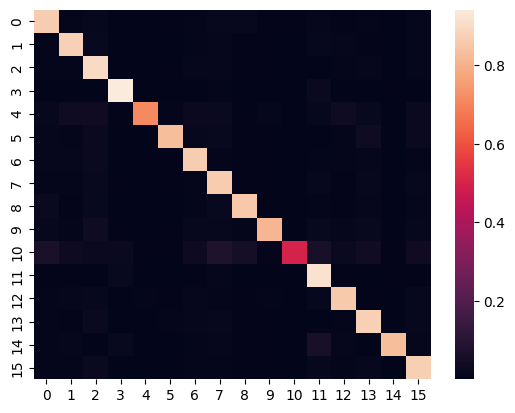

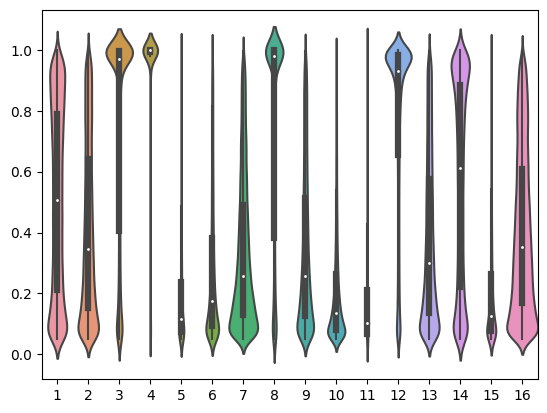

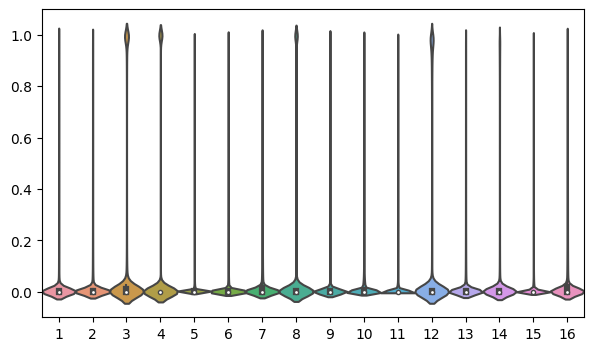

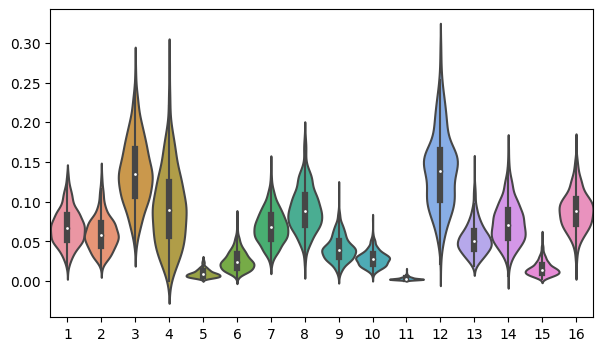

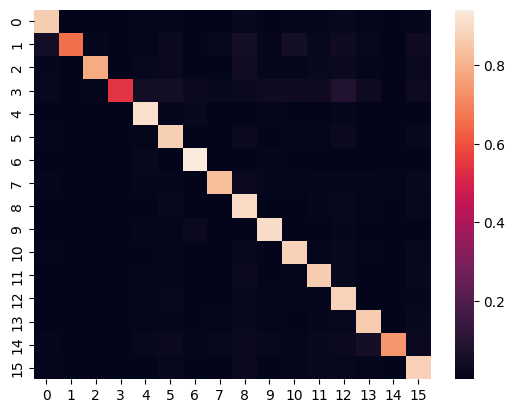

...

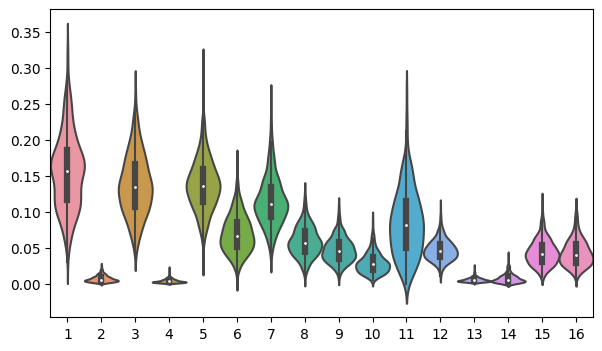

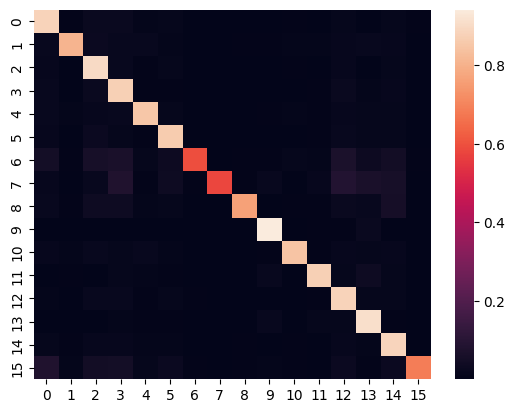

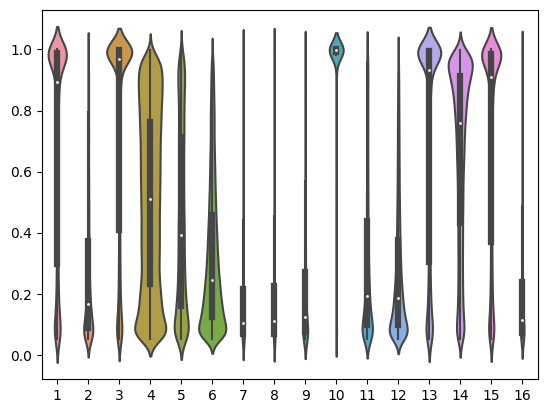

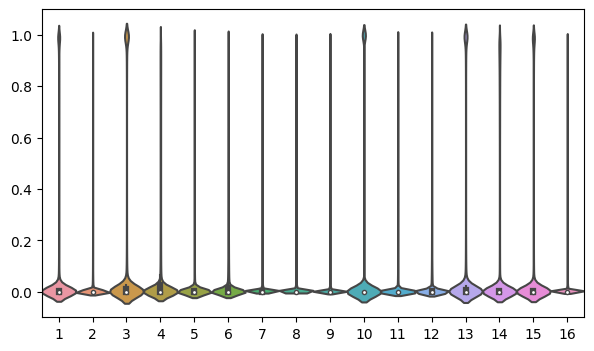

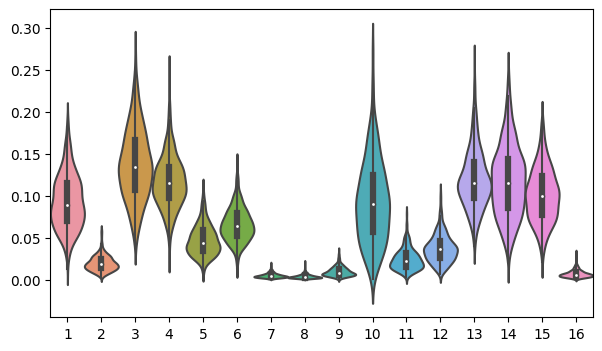

In [40]:
for repeat in repeats:
    tpm = np.load(f'{save_dir}{repeat}/model/trans_prob.npy')
    #fig,ax = plot_matrices(tpm)  
    seaborn.heatmap(tpm)
    plt.show()
    
    with open(f'{save_dir}{repeat}/inf_params/alp.pkl','rb') as file:
        alpha = pickle.load(file)
        
    fo = fractional_occupancies(alpha)
    
    alpha_plot = np.concatenate(alpha,axis=0).T
    
    x, y = [], []
    for i in range(len(alpha_plot)):
        alpha_state = alpha_plot[i]
        temp = alpha_state[alpha_state>0.05]
        x.append(np.ones(len(temp)) * (i+1))
        y.append(temp)
    
    x = np.concatenate(x,axis=0).astype(int)
    y = np.concatenate(y,axis=0)
    
    sns_kwargs = {'scale':'count','width': 1}
    sns.violinplot(x=x,y=y,**sns_kwargs)
    #np.concatenate(alpha,axis=0).T,fig_kwargs={'figsize': (10, 4)},sns_kwargs = {'scale':'count','width': 1})
    plt.show()
    
    fig,ax = plot_violin(alpha_plot,
                         #fig_kwargs={'figsize': (10, 4)},
                         sns_kwargs = {'scale':'count','width': 1})
    plt.show()
    
    fig,ax = plot_violin(fo.T,
                         #fig_kwargs={'figsize': (10, 4)},
                         sns_kwargs = {'scale':'count','width': 1})
    plt.show()

### Question 3: On real HCP data, what is the relationsihp between "spatial pairing" and "temporal pairing"

In [128]:
import os
import yaml
import pickle
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn

In [129]:
save_dir = './results_HCP_yaml_202403/'
N_states = list(range(2,37))
repeats = ['train','repeat_1','repeat_2','repeat_3','repeat_4','repeat_5']

In [130]:
from osl_dynamics.array_ops import cov2stdcorr

for N_state in N_states:
    for repeat in repeats:
        analysis_dir = f'{save_dir}hmm_ICA_25_state_{N_state}/{repeat}/analysis/'
        if not os.path.exists(analysis_dir):
            os.makedirs(analysis_dir)
        covs = np.load(f'{save_dir}hmm_ICA_25_state_{N_state}/{repeat}/inf_params/covs.npy')
        np.save(f'{analysis_dir}covs.npy',covs)
        stds,corrs =cov2stdcorr(covs)
        np.save(f'{analysis_dir}stds.npy',stds)
        np.save(f'{analysis_dir}corrs.npy',corrs)

In [146]:
from osl_dynamics.inference.metrics import twopair_fisher_z_correlations
from osl_dynamics.inference.modes import hungarian_pair
from osl_dynamics.utils.plotting import plot_mode_pairing

for N_state in N_states:
    analysis_dir = f'{save_dir}hmm_ICA_25_state_{N_state}/analysis/'
    if not os.path.exists(analysis_dir):
        os.makedirs(analysis_dir)
    for i in range(len(repeats)):
        for j in range(i+1,len(repeats)):
            corrs_1 = np.load(f'{save_dir}hmm_ICA_25_state_{N_state}/{repeats[i]}/analysis/corrs.npy')
            corrs_2 = np.load(f'{save_dir}hmm_ICA_25_state_{N_state}/{repeats[j]}/analysis/corrs.npy')
            indices, cor = hungarian_pair(twopair_fisher_z_correlations(corrs_1,corrs_2),distance=False)
            np.save(f'{analysis_dir}spatial_cor_{repeats[i]}_vs_{repeats[j]}.npy',cor)
            indices['mean'] = np.mean(np.diagonal(cor))
            # Open the file in binary write mode
            with open(f'{analysis_dir}spatial_pair_{repeats[i]}_vs_{repeats[j]}.pkl', "wb") as f:
                pickle.dump(indices, f)
            plot_mode_pairing(cor,
                              indices,
                              x_label=repeats[j],
                              y_label=repeats[i],
                              title=f'Spatial correlation {repeats[i]} vs {repeats[j]}',
                              filename=f'{analysis_dir}spatial_cor_{repeats[i]}_vs_{repeats[j]}.jpg')

Compute twopair Fisher-z transformated correlation: 100%|█| 2/2 [00:00<00:00, 16
2024-03-08 22:18:44 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_2/analysis/spatial_cor_train_vs_repeat_1.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 2/2 [00:00<00:00, 16
2024-03-08 22:18:44 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_2/analysis/spatial_cor_train_vs_repeat_2.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 2/2 [00:00<00:00, 16
2024-03-08 22:18:44 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_2/analysis/spatial_cor_train_vs_repeat_3.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 2/2 [00:00<00:00, 11
2024-03-08 22:18:44 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_2/analysis/spatial_cor_train_vs_repeat_4.jpg


Compute twopair Fisher-z transformated correlation: 100%|█| 4/4 [00:00<00:00, 11
2024-03-08 22:18:48 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_4/analysis/spatial_cor_train_vs_repeat_4.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 4/4 [00:00<00:00, 13
2024-03-08 22:18:48 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_4/analysis/spatial_cor_train_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 4/4 [00:00<00:00, 13
2024-03-08 22:18:48 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_4/analysis/spatial_cor_repeat_1_vs_repeat_2.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 4/4 [00:00<00:00, 13
2024-03-08 22:18:48 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_4/analysis/spatial_cor_repeat_1_vs_repeat_

Compute twopair Fisher-z transformated correlation: 100%|█| 6/6 [00:00<00:00, 98
2024-03-08 22:18:52 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_6/analysis/spatial_cor_repeat_1_vs_repeat_3.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 6/6 [00:00<00:00, 92
2024-03-08 22:18:52 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_6/analysis/spatial_cor_repeat_1_vs_repeat_4.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 6/6 [00:00<00:00, 83
2024-03-08 22:18:52 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_6/analysis/spatial_cor_repeat_1_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 6/6 [00:00<00:00, 87
2024-03-08 22:18:52 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_6/analysis/spatial_cor_repeat_2_vs_r

Compute twopair Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 74
2024-03-08 22:19:04 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_8/analysis/spatial_cor_repeat_2_vs_repeat_3.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 74
2024-03-08 22:19:04 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_8/analysis/spatial_cor_repeat_2_vs_repeat_4.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 59
2024-03-08 22:19:04 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_8/analysis/spatial_cor_repeat_2_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 74
2024-03-08 22:19:04 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_8/analysis/spatial_cor_repeat_3_vs_r

Compute twopair Fisher-z transformated correlation: 100%|█| 10/10 [00:00<00:00, 
2024-03-08 22:19:09 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_10/analysis/spatial_cor_repeat_3_vs_repeat_4.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 10/10 [00:00<00:00, 
2024-03-08 22:19:09 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_10/analysis/spatial_cor_repeat_3_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 10/10 [00:00<00:00, 
2024-03-08 22:19:10 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_10/analysis/spatial_cor_repeat_4_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 11/11 [00:00<00:00, 
2024-03-08 22:19:10 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_11/analysis/spatial_cor_train_vs_

Compute twopair Fisher-z transformated correlation: 100%|█| 13/13 [00:00<00:00, 
2024-03-08 22:19:17 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_13/analysis/spatial_cor_train_vs_repeat_1.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 13/13 [00:00<00:00, 
2024-03-08 22:19:17 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_13/analysis/spatial_cor_train_vs_repeat_2.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 13/13 [00:00<00:00, 
2024-03-08 22:19:17 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_13/analysis/spatial_cor_train_vs_repeat_3.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 13/13 [00:00<00:00, 
2024-03-08 22:19:17 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_13/analysis/spatial_cor_train_vs_repeat_4.

Compute twopair Fisher-z transformated correlation: 100%|█| 15/15 [00:00<00:00, 
2024-03-08 22:19:24 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_15/analysis/spatial_cor_train_vs_repeat_4.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 15/15 [00:00<00:00, 
2024-03-08 22:19:24 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_15/analysis/spatial_cor_train_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 15/15 [00:00<00:00, 
2024-03-08 22:19:25 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_15/analysis/spatial_cor_repeat_1_vs_repeat_2.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 15/15 [00:00<00:00, 
2024-03-08 22:19:25 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_15/analysis/spatial_cor_repeat_1_vs_rep

Compute twopair Fisher-z transformated correlation: 100%|█| 17/17 [00:00<00:00, 
2024-03-08 22:19:32 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_17/analysis/spatial_cor_repeat_1_vs_repeat_3.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 17/17 [00:00<00:00, 
2024-03-08 22:19:32 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_17/analysis/spatial_cor_repeat_1_vs_repeat_4.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 17/17 [00:00<00:00, 
2024-03-08 22:19:33 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_17/analysis/spatial_cor_repeat_1_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 17/17 [00:00<00:00, 
2024-03-08 22:19:33 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_17/analysis/spatial_cor_repeat_2_

Compute twopair Fisher-z transformated correlation: 100%|█| 19/19 [00:00<00:00, 
2024-03-08 22:19:42 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_19/analysis/spatial_cor_repeat_2_vs_repeat_3.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 19/19 [00:00<00:00, 
2024-03-08 22:19:43 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_19/analysis/spatial_cor_repeat_2_vs_repeat_4.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 19/19 [00:00<00:00, 
2024-03-08 22:19:43 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_19/analysis/spatial_cor_repeat_2_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 19/19 [00:00<00:00, 
2024-03-08 22:19:43 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_19/analysis/spatial_cor_repeat_3_

Compute twopair Fisher-z transformated correlation: 100%|█| 21/21 [00:00<00:00, 
2024-03-08 22:19:53 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_21/analysis/spatial_cor_repeat_3_vs_repeat_4.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 21/21 [00:00<00:00, 
2024-03-08 22:19:53 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_21/analysis/spatial_cor_repeat_3_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 21/21 [00:00<00:00, 
2024-03-08 22:19:54 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_21/analysis/spatial_cor_repeat_4_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 22/22 [00:00<00:00, 
2024-03-08 22:19:55 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_22/analysis/spatial_cor_train_vs_

Compute twopair Fisher-z transformated correlation: 100%|█| 24/24 [00:00<00:00, 
2024-03-08 22:20:05 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_24/analysis/spatial_cor_train_vs_repeat_1.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 24/24 [00:00<00:00, 
2024-03-08 22:20:05 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_24/analysis/spatial_cor_train_vs_repeat_2.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 24/24 [00:00<00:00, 
2024-03-08 22:20:06 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_24/analysis/spatial_cor_train_vs_repeat_3.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 24/24 [00:00<00:00, 
2024-03-08 22:20:06 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_24/analysis/spatial_cor_train_vs_repeat_4.

Compute twopair Fisher-z transformated correlation: 100%|█| 26/26 [00:00<00:00, 
2024-03-08 22:20:17 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_26/analysis/spatial_cor_train_vs_repeat_4.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 26/26 [00:00<00:00, 
2024-03-08 22:20:17 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_26/analysis/spatial_cor_train_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 26/26 [00:00<00:00, 
2024-03-08 22:20:18 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_26/analysis/spatial_cor_repeat_1_vs_repeat_2.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 26/26 [00:00<00:00, 
2024-03-08 22:20:19 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_26/analysis/spatial_cor_repeat_1_vs_rep

Compute twopair Fisher-z transformated correlation: 100%|█| 28/28 [00:00<00:00, 
2024-03-08 22:20:32 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_28/analysis/spatial_cor_repeat_1_vs_repeat_3.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 28/28 [00:00<00:00, 
2024-03-08 22:20:32 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_28/analysis/spatial_cor_repeat_1_vs_repeat_4.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 28/28 [00:00<00:00, 
2024-03-08 22:20:33 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_28/analysis/spatial_cor_repeat_1_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 28/28 [00:00<00:00, 
2024-03-08 22:20:33 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_28/analysis/spatial_cor_repeat_2_

Compute twopair Fisher-z transformated correlation: 100%|█| 30/30 [00:00<00:00, 
2024-03-08 22:20:47 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_30/analysis/spatial_cor_repeat_2_vs_repeat_3.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 30/30 [00:00<00:00, 
2024-03-08 22:20:48 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_30/analysis/spatial_cor_repeat_2_vs_repeat_4.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 30/30 [00:00<00:00, 
2024-03-08 22:20:49 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_30/analysis/spatial_cor_repeat_2_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 30/30 [00:00<00:00, 
2024-03-08 22:20:49 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_30/analysis/spatial_cor_repeat_3_

Compute twopair Fisher-z transformated correlation: 100%|█| 32/32 [00:00<00:00, 
2024-03-08 22:21:06 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_32/analysis/spatial_cor_repeat_3_vs_repeat_4.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 32/32 [00:00<00:00, 
2024-03-08 22:21:06 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_32/analysis/spatial_cor_repeat_3_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 32/32 [00:00<00:00, 
2024-03-08 22:21:07 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_32/analysis/spatial_cor_repeat_4_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 33/33 [00:00<00:00, 
2024-03-08 22:21:07 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_33/analysis/spatial_cor_train_vs_

Compute twopair Fisher-z transformated correlation: 100%|█| 35/35 [00:00<00:00, 
2024-03-08 22:21:22 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_35/analysis/spatial_cor_train_vs_repeat_1.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 35/35 [00:00<00:00, 
2024-03-08 22:21:22 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_35/analysis/spatial_cor_train_vs_repeat_2.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 35/35 [00:00<00:00, 
2024-03-08 22:21:23 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_35/analysis/spatial_cor_train_vs_repeat_3.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 35/35 [00:00<00:00, 
2024-03-08 22:21:23 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_40/hmm_ICA_25_state_35/analysis/spatial_cor_train_vs_repeat_4.

In [132]:
import pickle
from osl_dynamics.inference.metrics import alpha_correlation

for N_state in N_states:
    analysis_dir = f'{save_dir}hmm_ICA_25_state_{N_state}/analysis/'
    if not os.path.exists(analysis_dir):
        os.makedirs(analysis_dir)
    for i in range(len(repeats)):
        for j in range(i+1,len(repeats)):
            with open(f'{save_dir}hmm_ICA_25_state_{N_state}/{repeats[i]}/inf_params/alp.pkl','rb') as file:
                alpha_1 = pickle.load(file)
            with open(f'{save_dir}hmm_ICA_25_state_{N_state}/{repeats[j]}/inf_params/alp.pkl','rb') as file:
                alpha_2 = pickle.load(file)
            indices, cor = hungarian_pair(alpha_correlation(alpha_1,alpha_2,return_diagonal=False),distance=False)
            np.save(f'{analysis_dir}temp_cor_{repeats[i]}_vs_{repeats[j]}.npy',cor)
            indices['mean'] = np.mean(np.diagonal(cor))
            # Open the file in binary write mode
            with open(f'{analysis_dir}temp_pair_{repeats[i]}_vs_{repeats[j]}.pkl', "wb") as f:
                pickle.dump(indices, f)
            plot_mode_pairing(cor,
                              indices,
                              x_label=repeats[j],
                              y_label=repeats[i],
                              title=f'Temporal correlation {repeats[i]} vs {repeats[j]}',
                              filename=f'{analysis_dir}temp_cor_{repeats[i]}_vs_{repeats[j]}.jpg')
            
            indices_argmax, cor_argmax = hungarian_pair(alpha_correlation(argmax_time_courses(alpha_1),argmax_time_courses(alpha_2),return_diagonal=False),distance=False)
            np.save(f'{analysis_dir}temp_argmax_cor_{repeats[i]}_vs_{repeats[j]}.npy',cor_argmax)
            indices_argmax['mean'] = np.mean(np.diagonal(cor_argmax))
            # Open the file in binary write mode
            with open(f'{analysis_dir}temp_argmax_pair_{repeats[i]}_vs_{repeats[j]}.pkl', "wb") as f:
                pickle.dump(indices_argmax, f)
            plot_mode_pairing(cor_argmax,
                              indices_argmax,
                              x_label=repeats[j],
                              y_label=repeats[i],
                              title=f'Temporal argmax correlation {repeats[i]} vs {repeats[j]}',
                              filename=f'{analysis_dir}temp_argmax_cor_{repeats[i]}_vs_{repeats[j]}.jpg')

2024-03-08 16:17:31 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_2/analysis/temp_cor_train_vs_repeat_1.jpg
2024-03-08 16:17:31 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_2/analysis/temp_argmax_cor_train_vs_repeat_1.jpg
2024-03-08 16:17:32 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_2/analysis/temp_cor_train_vs_repeat_2.jpg
2024-03-08 16:17:32 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_2/analysis/temp_argmax_cor_train_vs_repeat_2.jpg
2024-03-08 16:17:32 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_2/analysis/temp_cor_train_vs_repeat_3.jpg
2024-03-08 16:17:32 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_2/analysis/temp_argmax_cor_train_vs_repeat_3.jpg
2024-03-08 16:17:33 INFO osl-dynamics [plotting.py:103:

2024-03-08 16:17:47 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_3/analysis/temp_cor_repeat_2_vs_repeat_5.jpg
2024-03-08 16:17:47 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_3/analysis/temp_argmax_cor_repeat_2_vs_repeat_5.jpg
2024-03-08 16:17:47 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_3/analysis/temp_cor_repeat_3_vs_repeat_4.jpg
2024-03-08 16:17:47 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_3/analysis/temp_argmax_cor_repeat_3_vs_repeat_4.jpg
2024-03-08 16:17:48 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_3/analysis/temp_cor_repeat_3_vs_repeat_5.jpg
2024-03-08 16:17:48 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_3/analysis/temp_argmax_cor_repeat_3_vs_repeat_5.jpg
2024-03-08 16:17:48 INFO osl-dynamics

2024-03-08 16:18:05 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_5/analysis/temp_cor_repeat_1_vs_repeat_4.jpg
2024-03-08 16:18:05 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_5/analysis/temp_argmax_cor_repeat_1_vs_repeat_4.jpg
2024-03-08 16:18:05 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_5/analysis/temp_cor_repeat_1_vs_repeat_5.jpg
2024-03-08 16:18:06 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_5/analysis/temp_argmax_cor_repeat_1_vs_repeat_5.jpg
2024-03-08 16:18:06 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_5/analysis/temp_cor_repeat_2_vs_repeat_3.jpg
2024-03-08 16:18:06 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_5/analysis/temp_argmax_cor_repeat_2_vs_repeat_3.jpg
2024-03-08 16:18:07 INFO osl-dynamics

2024-03-08 16:18:25 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_7/analysis/temp_cor_train_vs_repeat_4.jpg
2024-03-08 16:18:26 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_7/analysis/temp_argmax_cor_train_vs_repeat_4.jpg
2024-03-08 16:18:26 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_7/analysis/temp_cor_train_vs_repeat_5.jpg
2024-03-08 16:18:27 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_7/analysis/temp_argmax_cor_train_vs_repeat_5.jpg
2024-03-08 16:18:27 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_7/analysis/temp_cor_repeat_1_vs_repeat_2.jpg
2024-03-08 16:18:28 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_7/analysis/temp_argmax_cor_repeat_1_vs_repeat_2.jpg
2024-03-08 16:18:28 INFO osl-dynamics [plotting.p

2024-03-08 16:18:51 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_8/analysis/temp_cor_repeat_4_vs_repeat_5.jpg
2024-03-08 16:18:52 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_8/analysis/temp_argmax_cor_repeat_4_vs_repeat_5.jpg
2024-03-08 16:18:52 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_9/analysis/temp_cor_train_vs_repeat_1.jpg
2024-03-08 16:18:53 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_9/analysis/temp_argmax_cor_train_vs_repeat_1.jpg
2024-03-08 16:18:53 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_9/analysis/temp_cor_train_vs_repeat_2.jpg
2024-03-08 16:18:54 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_9/analysis/temp_argmax_cor_train_vs_repeat_2.jpg
2024-03-08 16:18:55 INFO osl-dynamics [plotting.p

2024-03-08 16:19:21 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_10/analysis/temp_cor_repeat_2_vs_repeat_4.jpg
2024-03-08 16:19:22 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_10/analysis/temp_argmax_cor_repeat_2_vs_repeat_4.jpg
2024-03-08 16:19:22 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_10/analysis/temp_cor_repeat_2_vs_repeat_5.jpg
2024-03-08 16:19:23 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_10/analysis/temp_argmax_cor_repeat_2_vs_repeat_5.jpg
2024-03-08 16:19:23 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_10/analysis/temp_cor_repeat_3_vs_repeat_4.jpg
2024-03-08 16:19:24 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_10/analysis/temp_argmax_cor_repeat_3_vs_repeat_4.jpg
2024-03-08 16:19:25 INFO osl-dy

2024-03-08 16:19:56 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_12/analysis/temp_cor_repeat_1_vs_repeat_3.jpg
2024-03-08 16:19:57 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_12/analysis/temp_argmax_cor_repeat_1_vs_repeat_3.jpg
2024-03-08 16:19:57 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_12/analysis/temp_cor_repeat_1_vs_repeat_4.jpg
2024-03-08 16:19:58 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_12/analysis/temp_argmax_cor_repeat_1_vs_repeat_4.jpg
2024-03-08 16:19:58 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_12/analysis/temp_cor_repeat_1_vs_repeat_5.jpg
2024-03-08 16:19:59 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_12/analysis/temp_argmax_cor_repeat_1_vs_repeat_5.jpg
2024-03-08 16:20:00 INFO osl-dy

2024-03-08 16:20:32 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_14/analysis/temp_argmax_cor_train_vs_repeat_2.jpg
2024-03-08 16:20:32 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_14/analysis/temp_cor_train_vs_repeat_3.jpg
2024-03-08 16:20:33 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_14/analysis/temp_argmax_cor_train_vs_repeat_3.jpg
2024-03-08 16:20:34 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_14/analysis/temp_cor_train_vs_repeat_4.jpg
2024-03-08 16:20:35 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_14/analysis/temp_argmax_cor_train_vs_repeat_4.jpg
2024-03-08 16:20:35 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_14/analysis/temp_cor_train_vs_repeat_5.jpg
2024-03-08 16:20:36 INFO osl-dynamics [plotting.p

2024-03-08 16:21:14 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_15/analysis/temp_argmax_cor_repeat_3_vs_repeat_4.jpg
2024-03-08 16:21:15 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_15/analysis/temp_cor_repeat_3_vs_repeat_5.jpg
2024-03-08 16:21:16 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_15/analysis/temp_argmax_cor_repeat_3_vs_repeat_5.jpg
2024-03-08 16:21:17 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_15/analysis/temp_cor_repeat_4_vs_repeat_5.jpg
2024-03-08 16:21:18 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_15/analysis/temp_argmax_cor_repeat_4_vs_repeat_5.jpg
2024-03-08 16:21:19 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_16/analysis/temp_cor_train_vs_repeat_1.jpg
2024-03-08 16:21:20 INFO osl-dynam

2024-03-08 16:22:03 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_17/analysis/temp_argmax_cor_repeat_1_vs_repeat_5.jpg
2024-03-08 16:22:04 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_17/analysis/temp_cor_repeat_2_vs_repeat_3.jpg
2024-03-08 16:22:05 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_17/analysis/temp_argmax_cor_repeat_2_vs_repeat_3.jpg
2024-03-08 16:22:06 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_17/analysis/temp_cor_repeat_2_vs_repeat_4.jpg
2024-03-08 16:22:07 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_17/analysis/temp_argmax_cor_repeat_2_vs_repeat_4.jpg
2024-03-08 16:22:08 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_17/analysis/temp_cor_repeat_2_vs_repeat_5.jpg
2024-03-08 16:22:09 INFO osl-dy

2024-03-08 16:22:57 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_19/analysis/temp_argmax_cor_train_vs_repeat_5.jpg
2024-03-08 16:22:57 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_19/analysis/temp_cor_repeat_1_vs_repeat_2.jpg
2024-03-08 16:22:59 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_19/analysis/temp_argmax_cor_repeat_1_vs_repeat_2.jpg
2024-03-08 16:23:00 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_19/analysis/temp_cor_repeat_1_vs_repeat_3.jpg
2024-03-08 16:23:01 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_19/analysis/temp_argmax_cor_repeat_1_vs_repeat_3.jpg
2024-03-08 16:23:02 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_19/analysis/temp_cor_repeat_1_vs_repeat_4.jpg
2024-03-08 16:23:03 INFO osl-dynam

2024-03-08 16:23:53 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_21/analysis/temp_cor_train_vs_repeat_1.jpg
2024-03-08 16:23:54 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_21/analysis/temp_argmax_cor_train_vs_repeat_1.jpg
2024-03-08 16:23:56 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_21/analysis/temp_cor_train_vs_repeat_2.jpg
2024-03-08 16:23:57 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_21/analysis/temp_argmax_cor_train_vs_repeat_2.jpg
2024-03-08 16:23:58 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_21/analysis/temp_cor_train_vs_repeat_3.jpg
2024-03-08 16:23:59 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_21/analysis/temp_argmax_cor_train_vs_repeat_3.jpg
2024-03-08 16:24:00 INFO osl-dynamics [plotting.p

2024-03-08 16:24:55 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_22/analysis/temp_cor_repeat_2_vs_repeat_5.jpg
2024-03-08 16:24:56 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_22/analysis/temp_argmax_cor_repeat_2_vs_repeat_5.jpg
2024-03-08 16:24:57 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_22/analysis/temp_cor_repeat_3_vs_repeat_4.jpg
2024-03-08 16:24:58 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_22/analysis/temp_argmax_cor_repeat_3_vs_repeat_4.jpg
2024-03-08 16:24:59 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_22/analysis/temp_cor_repeat_3_vs_repeat_5.jpg
2024-03-08 16:25:01 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_22/analysis/temp_argmax_cor_repeat_3_vs_repeat_5.jpg
2024-03-08 16:25:02 INFO osl-dy

2024-03-08 16:26:03 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_24/analysis/temp_cor_repeat_1_vs_repeat_4.jpg
2024-03-08 16:26:04 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_24/analysis/temp_argmax_cor_repeat_1_vs_repeat_4.jpg
2024-03-08 16:26:05 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_24/analysis/temp_cor_repeat_1_vs_repeat_5.jpg
2024-03-08 16:26:07 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_24/analysis/temp_argmax_cor_repeat_1_vs_repeat_5.jpg
2024-03-08 16:26:08 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_24/analysis/temp_cor_repeat_2_vs_repeat_3.jpg
2024-03-08 16:26:09 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_24/analysis/temp_argmax_cor_repeat_2_vs_repeat_3.jpg
2024-03-08 16:26:10 INFO osl-dy

2024-03-08 16:27:13 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_26/analysis/temp_cor_train_vs_repeat_4.jpg
2024-03-08 16:27:15 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_26/analysis/temp_argmax_cor_train_vs_repeat_4.jpg
2024-03-08 16:27:16 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_26/analysis/temp_cor_train_vs_repeat_5.jpg
2024-03-08 16:27:17 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_26/analysis/temp_argmax_cor_train_vs_repeat_5.jpg
2024-03-08 16:27:19 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_26/analysis/temp_cor_repeat_1_vs_repeat_2.jpg
2024-03-08 16:27:20 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_26/analysis/temp_argmax_cor_repeat_1_vs_repeat_2.jpg
2024-03-08 16:27:21 INFO osl-dynamics [plot

2024-03-08 16:28:30 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_27/analysis/temp_cor_repeat_4_vs_repeat_5.jpg
2024-03-08 16:28:31 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_27/analysis/temp_argmax_cor_repeat_4_vs_repeat_5.jpg
2024-03-08 16:28:33 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_28/analysis/temp_cor_train_vs_repeat_1.jpg
2024-03-08 16:28:35 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_28/analysis/temp_argmax_cor_train_vs_repeat_1.jpg
2024-03-08 16:28:36 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_28/analysis/temp_cor_train_vs_repeat_2.jpg
2024-03-08 16:28:38 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_28/analysis/temp_argmax_cor_train_vs_repeat_2.jpg
2024-03-08 16:28:39 INFO osl-dynamics [plot

2024-03-08 16:29:52 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_29/analysis/temp_cor_repeat_2_vs_repeat_4.jpg
2024-03-08 16:29:54 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_29/analysis/temp_argmax_cor_repeat_2_vs_repeat_4.jpg
2024-03-08 16:29:56 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_29/analysis/temp_cor_repeat_2_vs_repeat_5.jpg
2024-03-08 16:29:57 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_29/analysis/temp_argmax_cor_repeat_2_vs_repeat_5.jpg
2024-03-08 16:29:59 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_29/analysis/temp_cor_repeat_3_vs_repeat_4.jpg
2024-03-08 16:30:00 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_29/analysis/temp_argmax_cor_repeat_3_vs_repeat_4.jpg
2024-03-08 16:30:02 INFO osl-dy

2024-03-08 16:31:17 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_31/analysis/temp_cor_repeat_1_vs_repeat_3.jpg
2024-03-08 16:31:19 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_31/analysis/temp_argmax_cor_repeat_1_vs_repeat_3.jpg
2024-03-08 16:31:20 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_31/analysis/temp_cor_repeat_1_vs_repeat_4.jpg
2024-03-08 16:31:22 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_31/analysis/temp_argmax_cor_repeat_1_vs_repeat_4.jpg
2024-03-08 16:31:24 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_31/analysis/temp_cor_repeat_1_vs_repeat_5.jpg
2024-03-08 16:31:25 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_31/analysis/temp_argmax_cor_repeat_1_vs_repeat_5.jpg
2024-03-08 16:31:27 INFO osl-dy

2024-03-08 16:32:45 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_33/analysis/temp_argmax_cor_train_vs_repeat_2.jpg
2024-03-08 16:32:47 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_33/analysis/temp_cor_train_vs_repeat_3.jpg
2024-03-08 16:32:48 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_33/analysis/temp_argmax_cor_train_vs_repeat_3.jpg
2024-03-08 16:32:50 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_33/analysis/temp_cor_train_vs_repeat_4.jpg
2024-03-08 16:32:52 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_33/analysis/temp_argmax_cor_train_vs_repeat_4.jpg
2024-03-08 16:32:54 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_33/analysis/temp_cor_train_vs_repeat_5.jpg
2024-03-08 16:32:55 INFO osl-dynamics [plotting.p

2024-03-08 16:34:18 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_34/analysis/temp_argmax_cor_repeat_3_vs_repeat_4.jpg
2024-03-08 16:34:20 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_34/analysis/temp_cor_repeat_3_vs_repeat_5.jpg
2024-03-08 16:34:22 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_34/analysis/temp_argmax_cor_repeat_3_vs_repeat_5.jpg
2024-03-08 16:34:23 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_34/analysis/temp_cor_repeat_4_vs_repeat_5.jpg
2024-03-08 16:34:25 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_34/analysis/temp_argmax_cor_repeat_4_vs_repeat_5.jpg
2024-03-08 16:34:27 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_35/analysis/temp_cor_train_vs_repeat_1.jpg
2024-03-08 16:34:29 INFO osl-dynam

2024-03-08 16:35:54 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_36/analysis/temp_argmax_cor_repeat_1_vs_repeat_5.jpg
2024-03-08 16:35:56 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_36/analysis/temp_cor_repeat_2_vs_repeat_3.jpg
2024-03-08 16:35:58 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_36/analysis/temp_argmax_cor_repeat_2_vs_repeat_3.jpg
2024-03-08 16:35:59 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_36/analysis/temp_cor_repeat_2_vs_repeat_4.jpg
2024-03-08 16:36:02 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_36/analysis/temp_argmax_cor_repeat_2_vs_repeat_4.jpg
2024-03-08 16:36:03 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_yaml_202403/hmm_ICA_25_state_36/analysis/temp_cor_repeat_2_vs_repeat_5.jpg
2024-03-08 16:36:05 INFO osl-dy

In [133]:
save_dir = './results_HCP_yaml_202403/'
N_states = list(range(2,37))
repeats = ['train','repeat_1','repeat_2','repeat_3','repeat_4','repeat_5']

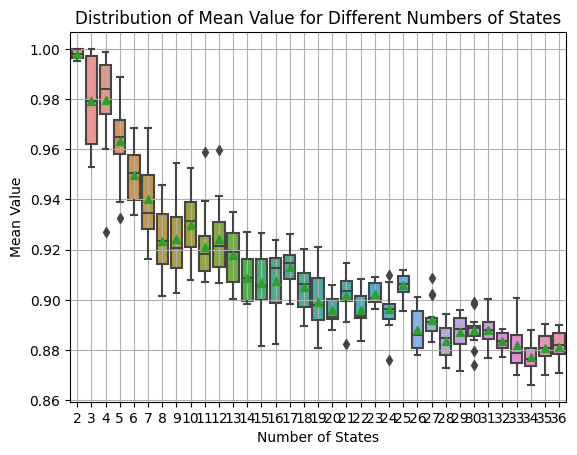

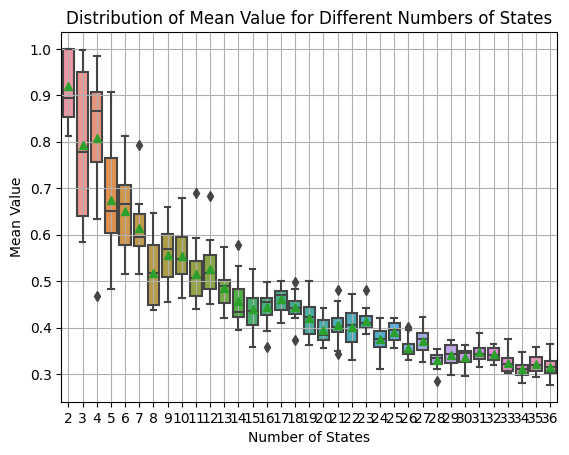

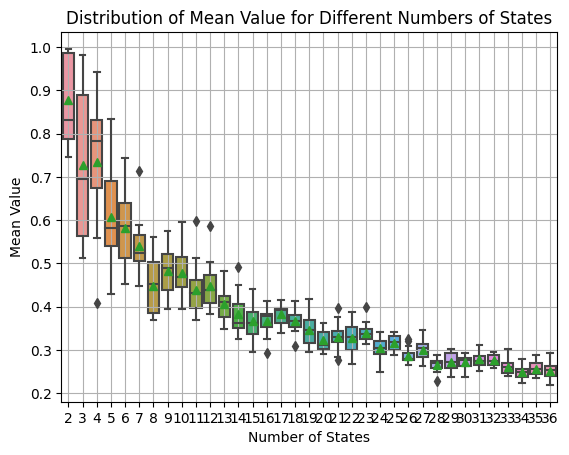

In [134]:
import seaborn as sns

summary_dir = f'{save_dir}summary/'
if not os.path.exists(summary_dir):
    os.makedirs(summary_dir)

for metric in ['spatial','temp','temp_argmax']:
    # Initialize a dictionary to store mean values for each number of states
    mean_values_dict = {N_state: [] for N_state in N_states}

    # Loop through each value of N_states
    for N_state in N_states:
        # Loop through each pair of repeats
        for i in range(len(repeats)):
            for j in range(i + 1, len(repeats)):
                # Define the path to the pickle file
                file_path = os.path.join(save_dir, f'hmm_ICA_25_state_{N_state}/analysis/{metric}_pair_{repeats[i]}_vs_{repeats[j]}.pkl')
                # Load the pickle file
                with open(file_path, 'rb') as f:
                    data = pickle.load(f)
                # Extract the 'mean' value and append it to the dictionary
                mean_value = data['mean']
                mean_values_dict[N_state].append(mean_value)

    # Plot boxplots of the mean values for each number of states
    sns.boxplot(data=list(mean_values_dict.values()), showmeans=True)
    plt.xlabel('Number of States')
    plt.ylabel('Mean Value')
    plt.title('Distribution of Mean Value for Different Numbers of States')
    plt.xticks(ticks=range(len(N_states)), labels=N_states)
    plt.grid(True)
    plt.show()

In [ ]:
save_dir = './results_HCP_yaml_202403/'
N_states = list(range(2,37))
repeats = ['train','repeat_1','repeat_2','repeat_3','repeat_4','repeat_5']

In [ ]:
import json

# Initialize a dictionary to store free energy values for each number of states
free_energy_dict = {N_state: [] for N_state in N_states}

# Loop through each value of N_states
for N_state in N_states:
    # Loop through each repeat
    for repeat in repeats:
        # Define the path to the JSON file for the free energy
        file_path = os.path.join(save_dir, f'hmm_ICA_25_state_{N_state}/{repeat}/metrics/metrics.json')
        # Load the JSON file
        with open(file_path, 'r') as f:
            metrics = json.load(f)
        # Extract the 'free_energy' value and append it to the dictionary
        free_energy = metrics['free_energy']
        free_energy_dict[N_state].append(free_energy)

# Plot boxplots of the free energy values for each number of states
sns.boxplot(data=list(free_energy_dict.values()), showmeans=True)
plt.xlabel('Number of States')
plt.ylabel('Free Energy')
plt.title('Distribution of Free Energy for Different Numbers of States')
plt.xticks(ticks=range(len(N_states)), labels=N_states)
plt.grid(True)
plt.show()

In [41]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [50]:
save_dir = './results_HCP_202311_no_mean/HMM_ICA_25_state_8/'
tpm = np.load(f'{save_dir}trans_prob.npy')
print(tpm)
'''
for i in range(8):
    tpm[i,i] = 0
'''

[[8.82521069e-01 2.13740600e-02 1.52935170e-02 1.21803307e-02
  1.98099072e-03 3.49631353e-02 1.20386795e-02 1.96482181e-02]
 [1.76062296e-02 9.01246462e-01 1.50009055e-02 1.71810770e-02
  1.27302422e-03 3.31416792e-02 1.42265414e-02 3.24081291e-04]
 [1.59852141e-02 1.97370388e-02 8.84493194e-01 1.60322338e-02
  2.53967001e-03 2.84117123e-02 1.79470784e-02 1.48538586e-02]
 [1.55426222e-02 2.46263272e-02 1.64949563e-02 8.81130626e-01
  2.09342288e-03 3.94360465e-02 1.78091003e-02 2.86689869e-03]
 [3.63360242e-03 2.33229981e-03 3.45188353e-03 2.92748779e-03
  9.44094777e-01 4.04464203e-03 7.64887558e-03 3.18664316e-02]
 [2.26098265e-02 2.54303603e-02 1.92685769e-02 1.97903561e-02
  1.91839506e-03 8.83179750e-01 1.21194136e-02 1.56833212e-02]
 [1.60295459e-02 2.07944100e-02 1.80880747e-02 2.17552933e-02
  5.00773792e-03 2.97738825e-02 8.67643099e-01 2.09079568e-02]
 [1.30011939e-02 1.93338443e-04 9.82194414e-03 1.58277207e-03
  2.11767333e-02 1.78431658e-02 1.47317818e-02 9.21649070e-01]]

'\nfor i in range(8):\n    tpm[i,i] = 0\n'

<Axes: >

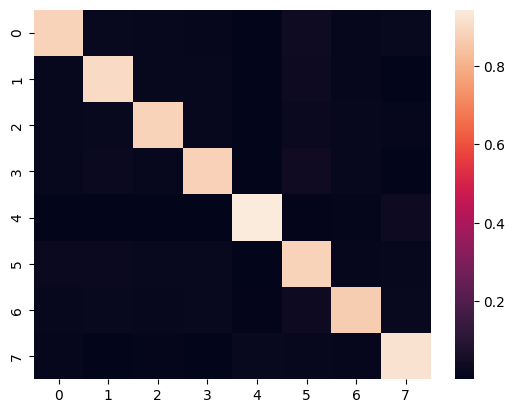

In [51]:
seaborn.heatmap(tpm)

## Update 8th March 2024

### Task 1: train the model on randomly generated covariance matrices (code provided by Chet and Rukuang)

My results and Rukuang's results do not agree with each other when it comes to the free energy trend. So let's have a look at it. Randomly generate these states and train the model on the data (n_subjects range from 2 to 36, but only train on repeat_1, repeat_2, repeat_3, repeat_4, repeat_5

In [61]:
import os
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

In [71]:
from osl_dynamics.inference.metrics import twopair_riemannian_distance

In [87]:
data_dir = 'data/node_timeseries/simulation_rukuang/state_100/truth/'

In [88]:
covariance = np.load(f'{data_dir}state_covariances.npy')

Computing Riemannian distances: 100%|█████████| 100/100 [00:01<00:00, 69.51it/s]


<Axes: >

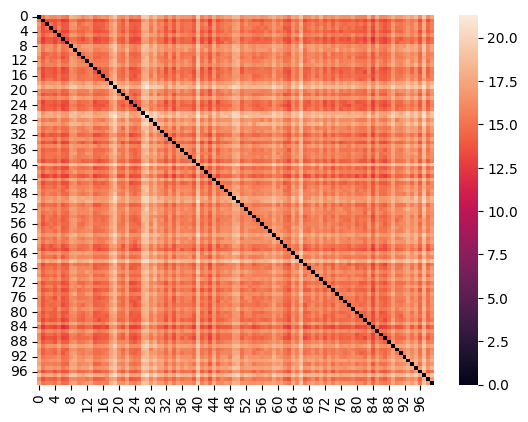

In [89]:
seaborn.heatmap(twopair_riemannian_distance(covariance,covariance))

### Check the model training results of Rukuang & Chet's covariance

The first step is to check free energy changes.

In [168]:
save_dir = './results_simulation_rukuang/state_5/'
N_states = list(range(2,37))
repeats = ['train','repeat_1','repeat_2','repeat_3','repeat_4','repeat_5']

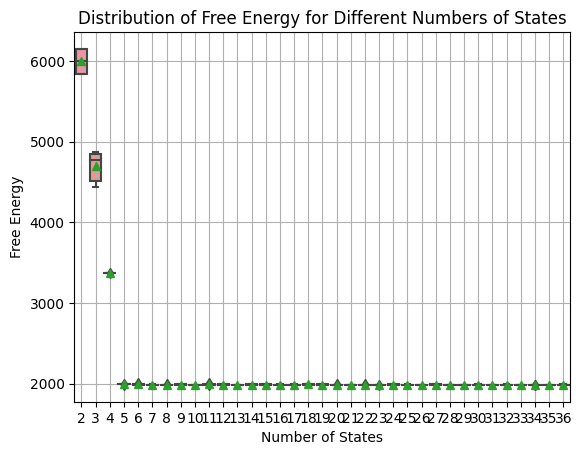

In [169]:
import json

# Initialize a dictionary to store free energy values for each number of states
free_energy_dict = {N_state: [] for N_state in N_states}

# Loop through each value of N_states
for N_state in N_states:
    # Loop through each repeat
    for repeat in repeats:
        # Define the path to the JSON file for the free energy
        file_path = os.path.join(save_dir, f'hmm_ICA_25_state_{N_state}/{repeat}/metrics/metrics.json')
        # Load the JSON file
        with open(file_path, 'r') as f:
            metrics = json.load(f)
        # Extract the 'free_energy' value and append it to the dictionary
        free_energy = metrics['free_energy']
        free_energy_dict[N_state].append(free_energy)

# Plot boxplots of the free energy values for each number of states
sns.boxplot(data=list(free_energy_dict.values()), showmeans=True)
plt.xlabel('Number of States')
plt.ylabel('Free Energy')
plt.title('Distribution of Free Energy for Different Numbers of States')
plt.xticks(ticks=range(len(N_states)), labels=N_states)
plt.grid(True)
plt.show()

Now check the spatial reproducibility and temporal reproducibility of state_40, state_100

In [170]:
from osl_dynamics.array_ops import cov2stdcorr

for N_state in N_states:
    for repeat in repeats:
        analysis_dir = f'{save_dir}hmm_ICA_25_state_{N_state}/{repeat}/analysis/'
        if not os.path.exists(analysis_dir):
            os.makedirs(analysis_dir)
        covs = np.load(f'{save_dir}hmm_ICA_25_state_{N_state}/{repeat}/inf_params/covs.npy')
        np.save(f'{analysis_dir}covs.npy',covs)
        stds,corrs =cov2stdcorr(covs)
        np.save(f'{analysis_dir}stds.npy',stds)
        np.save(f'{analysis_dir}corrs.npy',corrs)

In [171]:
from osl_dynamics.inference.metrics import twopair_fisher_z_correlations
from osl_dynamics.inference.modes import hungarian_pair
from osl_dynamics.utils.plotting import plot_mode_pairing

for N_state in N_states:
    analysis_dir = f'{save_dir}hmm_ICA_25_state_{N_state}/analysis/'
    if not os.path.exists(analysis_dir):
        os.makedirs(analysis_dir)
    for i in range(len(repeats)):
        for j in range(i+1,len(repeats)):
            corrs_1 = np.load(f'{save_dir}hmm_ICA_25_state_{N_state}/{repeats[i]}/analysis/corrs.npy')
            corrs_2 = np.load(f'{save_dir}hmm_ICA_25_state_{N_state}/{repeats[j]}/analysis/corrs.npy')
            indices, cor = hungarian_pair(twopair_fisher_z_correlations(corrs_1,corrs_2),distance=False)
            np.save(f'{analysis_dir}spatial_cor_{repeats[i]}_vs_{repeats[j]}.npy',cor)
            indices['mean'] = np.mean(np.diagonal(cor))
            # Open the file in binary write mode
            with open(f'{analysis_dir}spatial_pair_{repeats[i]}_vs_{repeats[j]}.pkl', "wb") as f:
                pickle.dump(indices, f)
            plot_mode_pairing(cor,
                              indices,
                              x_label=repeats[j],
                              y_label=repeats[i],
                              title=f'Spatial correlation {repeats[i]} vs {repeats[j]}',
                              filename=f'{analysis_dir}spatial_cor_{repeats[i]}_vs_{repeats[j]}.jpg')

Compute twopair Fisher-z transformated correlation: 100%|█| 2/2 [00:00<00:00, 10
2024-03-11 09:27:25 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_2/analysis/spatial_cor_train_vs_repeat_1.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 2/2 [00:00<00:00, 11
2024-03-11 09:27:25 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_2/analysis/spatial_cor_train_vs_repeat_2.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 2/2 [00:00<00:00, 15
2024-03-11 09:27:25 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_2/analysis/spatial_cor_train_vs_repeat_3.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 2/2 [00:00<00:00, 13
2024-03-11 09:27:25 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_2/analysis/spatial_cor_train_vs_repeat_4.jpg
Comp

Compute twopair Fisher-z transformated correlation: 100%|█| 4/4 [00:00<00:00, 10
2024-03-11 09:27:29 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_4/analysis/spatial_cor_train_vs_repeat_4.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 4/4 [00:00<00:00, 10
2024-03-11 09:27:29 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_4/analysis/spatial_cor_train_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 4/4 [00:00<00:00, 97
2024-03-11 09:27:29 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_4/analysis/spatial_cor_repeat_1_vs_repeat_2.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 4/4 [00:00<00:00, 97
2024-03-11 09:27:29 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_4/analysis/spatial_cor_repeat_1_vs_repeat_3.jp

Compute twopair Fisher-z transformated correlation: 100%|█| 6/6 [00:00<00:00, 99
2024-03-11 09:27:33 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_6/analysis/spatial_cor_repeat_1_vs_repeat_3.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 6/6 [00:00<00:00, 87
2024-03-11 09:27:33 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_6/analysis/spatial_cor_repeat_1_vs_repeat_4.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 6/6 [00:00<00:00, 95
2024-03-11 09:27:33 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_6/analysis/spatial_cor_repeat_1_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 6/6 [00:00<00:00, 93
2024-03-11 09:27:33 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_6/analysis/spatial_cor_repeat_2_vs_repea

Compute twopair Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 79
2024-03-11 09:27:38 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_8/analysis/spatial_cor_repeat_2_vs_repeat_3.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 78
2024-03-11 09:27:38 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_8/analysis/spatial_cor_repeat_2_vs_repeat_4.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 79
2024-03-11 09:27:38 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_8/analysis/spatial_cor_repeat_2_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 59
2024-03-11 09:27:38 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_8/analysis/spatial_cor_repeat_3_vs_repea

Compute twopair Fisher-z transformated correlation: 100%|█| 10/10 [00:00<00:00, 
2024-03-11 09:27:43 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_10/analysis/spatial_cor_repeat_3_vs_repeat_4.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 10/10 [00:00<00:00, 
2024-03-11 09:27:43 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_10/analysis/spatial_cor_repeat_3_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 10/10 [00:00<00:00, 
2024-03-11 09:27:44 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_10/analysis/spatial_cor_repeat_4_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 11/11 [00:00<00:00, 
2024-03-11 09:27:44 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_11/analysis/spatial_cor_train_vs_repe

Compute twopair Fisher-z transformated correlation: 100%|█| 13/13 [00:00<00:00, 
2024-03-11 09:27:49 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_13/analysis/spatial_cor_train_vs_repeat_1.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 13/13 [00:00<00:00, 
2024-03-11 09:27:50 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_13/analysis/spatial_cor_train_vs_repeat_2.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 13/13 [00:00<00:00, 
2024-03-11 09:27:50 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_13/analysis/spatial_cor_train_vs_repeat_3.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 13/13 [00:00<00:00, 
2024-03-11 09:27:50 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_13/analysis/spatial_cor_train_vs_repeat_4.jpg


Compute twopair Fisher-z transformated correlation: 100%|█| 15/15 [00:00<00:00, 
2024-03-11 09:28:04 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_15/analysis/spatial_cor_train_vs_repeat_4.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 15/15 [00:00<00:00, 
2024-03-11 09:28:04 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_15/analysis/spatial_cor_train_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 15/15 [00:00<00:00, 
2024-03-11 09:28:05 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_15/analysis/spatial_cor_repeat_1_vs_repeat_2.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 15/15 [00:00<00:00, 
2024-03-11 09:28:05 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_15/analysis/spatial_cor_repeat_1_vs_repeat_

Compute twopair Fisher-z transformated correlation: 100%|█| 17/17 [00:00<00:00, 
2024-03-11 09:28:12 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_17/analysis/spatial_cor_repeat_1_vs_repeat_3.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 17/17 [00:00<00:00, 
2024-03-11 09:28:12 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_17/analysis/spatial_cor_repeat_1_vs_repeat_4.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 17/17 [00:00<00:00, 
2024-03-11 09:28:12 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_17/analysis/spatial_cor_repeat_1_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 17/17 [00:00<00:00, 
2024-03-11 09:28:12 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_17/analysis/spatial_cor_repeat_2_vs_r

Compute twopair Fisher-z transformated correlation: 100%|█| 19/19 [00:00<00:00, 
2024-03-11 09:28:21 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_19/analysis/spatial_cor_repeat_2_vs_repeat_3.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 19/19 [00:00<00:00, 
2024-03-11 09:28:21 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_19/analysis/spatial_cor_repeat_2_vs_repeat_4.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 19/19 [00:00<00:00, 
2024-03-11 09:28:21 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_19/analysis/spatial_cor_repeat_2_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 19/19 [00:00<00:00, 
2024-03-11 09:28:22 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_19/analysis/spatial_cor_repeat_3_vs_r

Compute twopair Fisher-z transformated correlation: 100%|█| 21/21 [00:00<00:00, 
2024-03-11 09:28:31 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_21/analysis/spatial_cor_repeat_3_vs_repeat_4.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 21/21 [00:00<00:00, 
2024-03-11 09:28:31 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_21/analysis/spatial_cor_repeat_3_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 21/21 [00:00<00:00, 
2024-03-11 09:28:31 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_21/analysis/spatial_cor_repeat_4_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 22/22 [00:00<00:00, 
2024-03-11 09:28:32 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_22/analysis/spatial_cor_train_vs_repe

Compute twopair Fisher-z transformated correlation: 100%|█| 24/24 [00:00<00:00, 
2024-03-11 09:28:41 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_24/analysis/spatial_cor_train_vs_repeat_1.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 24/24 [00:00<00:00, 
2024-03-11 09:28:41 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_24/analysis/spatial_cor_train_vs_repeat_2.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 24/24 [00:00<00:00, 
2024-03-11 09:28:42 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_24/analysis/spatial_cor_train_vs_repeat_3.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 24/24 [00:00<00:00, 
2024-03-11 09:28:42 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_24/analysis/spatial_cor_train_vs_repeat_4.jpg


Compute twopair Fisher-z transformated correlation: 100%|█| 26/26 [00:00<00:00, 
2024-03-11 09:28:54 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_26/analysis/spatial_cor_train_vs_repeat_4.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 26/26 [00:00<00:00, 
2024-03-11 09:28:54 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_26/analysis/spatial_cor_train_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 26/26 [00:00<00:00, 
2024-03-11 09:28:54 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_26/analysis/spatial_cor_repeat_1_vs_repeat_2.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 26/26 [00:00<00:00, 
2024-03-11 09:28:55 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_26/analysis/spatial_cor_repeat_1_vs_repeat_

Compute twopair Fisher-z transformated correlation: 100%|█| 28/28 [00:00<00:00, 
2024-03-11 09:29:06 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_28/analysis/spatial_cor_repeat_1_vs_repeat_3.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 28/28 [00:00<00:00, 
2024-03-11 09:29:06 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_28/analysis/spatial_cor_repeat_1_vs_repeat_4.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 28/28 [00:00<00:00, 
2024-03-11 09:29:07 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_28/analysis/spatial_cor_repeat_1_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 28/28 [00:00<00:00, 
2024-03-11 09:29:07 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_28/analysis/spatial_cor_repeat_2_vs_r

Compute twopair Fisher-z transformated correlation: 100%|█| 30/30 [00:00<00:00, 
2024-03-11 09:29:20 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_30/analysis/spatial_cor_repeat_2_vs_repeat_3.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 30/30 [00:00<00:00, 
2024-03-11 09:29:20 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_30/analysis/spatial_cor_repeat_2_vs_repeat_4.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 30/30 [00:00<00:00, 
2024-03-11 09:29:21 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_30/analysis/spatial_cor_repeat_2_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 30/30 [00:00<00:00, 
2024-03-11 09:29:21 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_30/analysis/spatial_cor_repeat_3_vs_r

Compute twopair Fisher-z transformated correlation: 100%|█| 32/32 [00:00<00:00, 
2024-03-11 09:29:36 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_32/analysis/spatial_cor_repeat_3_vs_repeat_4.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 32/32 [00:00<00:00, 
2024-03-11 09:29:37 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_32/analysis/spatial_cor_repeat_3_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 32/32 [00:00<00:00, 
2024-03-11 09:29:37 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_32/analysis/spatial_cor_repeat_4_vs_repeat_5.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 33/33 [00:00<00:00, 
2024-03-11 09:29:38 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_33/analysis/spatial_cor_train_vs_repe

Compute twopair Fisher-z transformated correlation: 100%|█| 35/35 [00:00<00:00, 
2024-03-11 09:29:52 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_35/analysis/spatial_cor_train_vs_repeat_1.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 35/35 [00:00<00:00, 
2024-03-11 09:29:53 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_35/analysis/spatial_cor_train_vs_repeat_2.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 35/35 [00:00<00:00, 
2024-03-11 09:29:53 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_35/analysis/spatial_cor_train_vs_repeat_3.jpg
Compute twopair Fisher-z transformated correlation: 100%|█| 35/35 [00:00<00:00, 
2024-03-11 09:29:54 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_35/analysis/spatial_cor_train_vs_repeat_4.jpg


In [173]:
import pickle
from osl_dynamics.inference.metrics import alpha_correlation

for N_state in N_states:
    analysis_dir = f'{save_dir}hmm_ICA_25_state_{N_state}/analysis/'
    if not os.path.exists(analysis_dir):
        os.makedirs(analysis_dir)
    for i in range(len(repeats)):
        for j in range(i+1,len(repeats)):
            with open(f'{save_dir}hmm_ICA_25_state_{N_state}/{repeats[i]}/inf_params/alp.pkl','rb') as file:
                alpha_1 = pickle.load(file)
            with open(f'{save_dir}hmm_ICA_25_state_{N_state}/{repeats[j]}/inf_params/alp.pkl','rb') as file:
                alpha_2 = pickle.load(file)
            indices, cor = hungarian_pair(alpha_correlation(alpha_1,alpha_2,return_diagonal=False),distance=False)
            np.save(f'{analysis_dir}temp_cor_{repeats[i]}_vs_{repeats[j]}.npy',cor)
            indices['mean'] = np.mean(np.diagonal(cor))
            # Open the file in binary write mode
            with open(f'{analysis_dir}temp_pair_{repeats[i]}_vs_{repeats[j]}.pkl', "wb") as f:
                pickle.dump(indices, f)
            plot_mode_pairing(cor,
                              indices,
                              x_label=repeats[j],
                              y_label=repeats[i],
                              title=f'Temporal correlation {repeats[i]} vs {repeats[j]}',
                              filename=f'{analysis_dir}temp_cor_{repeats[i]}_vs_{repeats[j]}.jpg')
            '''
            indices_argmax, cor_argmax = hungarian_pair(alpha_correlation(argmax_time_courses(alpha_1),argmax_time_courses(alpha_2),return_diagonal=False),distance=False)
            np.save(f'{analysis_dir}temp_argmax_cor_{repeats[i]}_vs_{repeats[j]}.npy',cor_argmax)
            indices_argmax['mean'] = np.mean(np.diagonal(cor_argmax))
            # Open the file in binary write mode
            with open(f'{analysis_dir}temp_argmax_pair_{repeats[i]}_vs_{repeats[j]}.pkl', "wb") as f:
                pickle.dump(indices_argmax, f)
            plot_mode_pairing(cor_argmax,
                              indices_argmax,
                              x_label=repeats[j],
                              y_label=repeats[i],
                              title=f'Temporal argmax correlation {repeats[i]} vs {repeats[j]}',
                              filename=f'{analysis_dir}temp_argmax_cor_{repeats[i]}_vs_{repeats[j]}.jpg')
            '''

2024-03-11 09:36:24 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_2/analysis/temp_cor_train_vs_repeat_1.jpg
2024-03-11 09:36:24 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_2/analysis/temp_cor_train_vs_repeat_2.jpg
2024-03-11 09:36:24 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_2/analysis/temp_cor_train_vs_repeat_3.jpg
2024-03-11 09:36:24 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_2/analysis/temp_cor_train_vs_repeat_4.jpg
2024-03-11 09:36:25 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_2/analysis/temp_cor_train_vs_repeat_5.jpg
2024-03-11 09:36:25 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_2/analysis/temp_cor_repeat_1_vs_repeat_2.jpg
2024-03

2024-03-11 09:36:37 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_5/analysis/temp_cor_repeat_1_vs_repeat_2.jpg
2024-03-11 09:36:37 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_5/analysis/temp_cor_repeat_1_vs_repeat_3.jpg
2024-03-11 09:36:37 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_5/analysis/temp_cor_repeat_1_vs_repeat_4.jpg
2024-03-11 09:36:38 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_5/analysis/temp_cor_repeat_1_vs_repeat_5.jpg
2024-03-11 09:36:38 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_5/analysis/temp_cor_repeat_2_vs_repeat_3.jpg
2024-03-11 09:36:38 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_5/analysis/temp_cor_repeat_2_vs_repea

2024-03-11 09:37:00 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_8/analysis/temp_cor_repeat_2_vs_repeat_4.jpg
2024-03-11 09:37:01 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_8/analysis/temp_cor_repeat_2_vs_repeat_5.jpg
2024-03-11 09:37:01 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_8/analysis/temp_cor_repeat_3_vs_repeat_4.jpg
2024-03-11 09:37:02 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_8/analysis/temp_cor_repeat_3_vs_repeat_5.jpg
2024-03-11 09:37:02 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_8/analysis/temp_cor_repeat_4_vs_repeat_5.jpg
2024-03-11 09:37:03 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_9/analysis/temp_cor_train_vs_repeat_1

2024-03-11 09:37:28 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_11/analysis/temp_cor_repeat_4_vs_repeat_5.jpg
2024-03-11 09:37:29 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_12/analysis/temp_cor_train_vs_repeat_1.jpg
2024-03-11 09:37:30 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_12/analysis/temp_cor_train_vs_repeat_2.jpg
2024-03-11 09:37:30 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_12/analysis/temp_cor_train_vs_repeat_3.jpg
2024-03-11 09:37:31 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_12/analysis/temp_cor_train_vs_repeat_4.jpg
2024-03-11 09:37:32 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_12/analysis/temp_cor_train_vs_repeat_5.jpg
2

2024-03-11 09:38:03 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_15/analysis/temp_cor_train_vs_repeat_4.jpg
2024-03-11 09:38:04 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_15/analysis/temp_cor_train_vs_repeat_5.jpg
2024-03-11 09:38:05 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_15/analysis/temp_cor_repeat_1_vs_repeat_2.jpg
2024-03-11 09:38:05 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_15/analysis/temp_cor_repeat_1_vs_repeat_3.jpg
2024-03-11 09:38:06 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_15/analysis/temp_cor_repeat_1_vs_repeat_4.jpg
2024-03-11 09:38:07 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_15/analysis/temp_cor_repeat_1_vs_repea

2024-03-11 09:38:45 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_18/analysis/temp_cor_repeat_1_vs_repeat_4.jpg
2024-03-11 09:38:46 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_18/analysis/temp_cor_repeat_1_vs_repeat_5.jpg
2024-03-11 09:38:46 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_18/analysis/temp_cor_repeat_2_vs_repeat_3.jpg
2024-03-11 09:38:47 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_18/analysis/temp_cor_repeat_2_vs_repeat_4.jpg
2024-03-11 09:38:48 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_18/analysis/temp_cor_repeat_2_vs_repeat_5.jpg
2024-03-11 09:38:49 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_18/analysis/temp_cor_repeat_3_vs

2024-03-11 09:39:33 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_21/analysis/temp_cor_repeat_2_vs_repeat_5.jpg
2024-03-11 09:39:34 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_21/analysis/temp_cor_repeat_3_vs_repeat_4.jpg
2024-03-11 09:39:35 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_21/analysis/temp_cor_repeat_3_vs_repeat_5.jpg
2024-03-11 09:39:36 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_21/analysis/temp_cor_repeat_4_vs_repeat_5.jpg
2024-03-11 09:39:38 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_22/analysis/temp_cor_train_vs_repeat_1.jpg
2024-03-11 09:39:39 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_22/analysis/temp_cor_train_vs_repea

2024-03-11 09:40:32 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_25/analysis/temp_cor_train_vs_repeat_1.jpg
2024-03-11 09:40:33 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_25/analysis/temp_cor_train_vs_repeat_2.jpg
2024-03-11 09:40:34 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_25/analysis/temp_cor_train_vs_repeat_3.jpg
2024-03-11 09:40:36 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_25/analysis/temp_cor_train_vs_repeat_4.jpg
2024-03-11 09:40:37 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_25/analysis/temp_cor_train_vs_repeat_5.jpg
2024-03-11 09:40:38 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_25/analysis/temp_cor_repeat_1_vs_repeat_2.jpg
2

2024-03-11 09:41:40 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_28/analysis/temp_cor_train_vs_repeat_5.jpg
2024-03-11 09:41:42 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_28/analysis/temp_cor_repeat_1_vs_repeat_2.jpg
2024-03-11 09:41:43 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_28/analysis/temp_cor_repeat_1_vs_repeat_3.jpg
2024-03-11 09:41:45 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_28/analysis/temp_cor_repeat_1_vs_repeat_4.jpg
2024-03-11 09:41:46 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_28/analysis/temp_cor_repeat_1_vs_repeat_5.jpg
2024-03-11 09:41:47 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_28/analysis/temp_cor_repeat_2_vs_re

2024-03-11 09:42:54 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_31/analysis/temp_cor_repeat_1_vs_repeat_5.jpg
2024-03-11 09:42:55 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_31/analysis/temp_cor_repeat_2_vs_repeat_3.jpg
2024-03-11 09:42:57 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_31/analysis/temp_cor_repeat_2_vs_repeat_4.jpg
2024-03-11 09:42:58 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_31/analysis/temp_cor_repeat_2_vs_repeat_5.jpg
2024-03-11 09:43:00 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_31/analysis/temp_cor_repeat_3_vs_repeat_4.jpg
2024-03-11 09:43:01 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_31/analysis/temp_cor_repeat_3_vs

2024-03-11 09:44:18 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_34/analysis/temp_cor_repeat_3_vs_repeat_4.jpg
2024-03-11 09:44:19 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_34/analysis/temp_cor_repeat_3_vs_repeat_5.jpg
2024-03-11 09:44:21 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_34/analysis/temp_cor_repeat_4_vs_repeat_5.jpg
2024-03-11 09:44:23 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_35/analysis/temp_cor_train_vs_repeat_1.jpg
2024-03-11 09:44:24 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_35/analysis/temp_cor_train_vs_repeat_2.jpg
2024-03-11 09:44:26 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_simulation_rukuang/state_5/hmm_ICA_25_state_35/analysis/temp_cor_train_vs_repeat_3

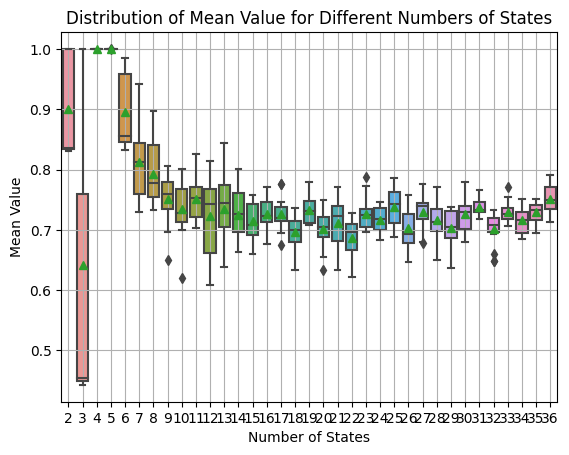

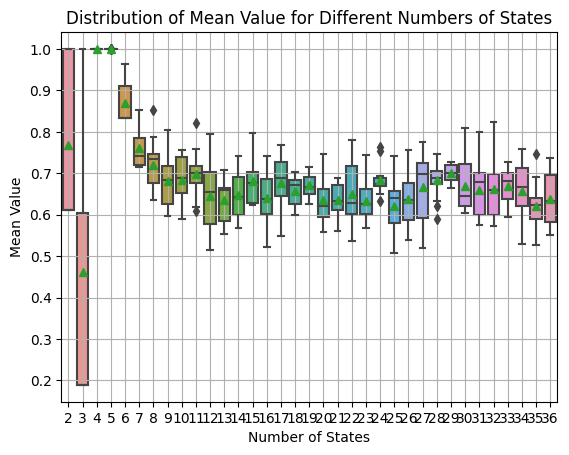

In [174]:
import seaborn as sns

summary_dir = f'{save_dir}summary/'
if not os.path.exists(summary_dir):
    os.makedirs(summary_dir)

for metric in ['spatial','temp']:#,'temp_argmax']:
    # Initialize a dictionary to store mean values for each number of states
    mean_values_dict = {N_state: [] for N_state in N_states}

    # Loop through each value of N_states
    for N_state in N_states:
        # Loop through each pair of repeats
        for i in range(len(repeats)):
            for j in range(i + 1, len(repeats)):
                # Define the path to the pickle file
                file_path = os.path.join(save_dir, f'hmm_ICA_25_state_{N_state}/analysis/{metric}_pair_{repeats[i]}_vs_{repeats[j]}.pkl')
                # Load the pickle file
                with open(file_path, 'rb') as f:
                    data = pickle.load(f)
                # Extract the 'mean' value and append it to the dictionary
                mean_value = data['mean']
                mean_values_dict[N_state].append(mean_value)

    # Plot boxplots of the mean values for each number of states
    sns.boxplot(data=list(mean_values_dict.values()), showmeans=True)
    plt.xlabel('Number of States')
    plt.ylabel('Mean Value')
    plt.title('Distribution of Mean Value for Different Numbers of States')
    plt.xticks(ticks=range(len(N_states)), labels=N_states)
    plt.grid(True)
    plt.show()

## Update 11th March 2024

We are trying to implement the ideas of cross validation. The following chunk of code is work-in-progress.

In [7]:
import os
import pickle

import numpy as np

from osl_dynamics.inference.metrics import alpha_correlation
from osl_dynamics.inference.modes import hungarian_pair
from osl_dynamics.models import load

In [8]:
save_dir= './results_HCP_yaml_202403/'
N_state = 8
N_split = 5

In [9]:
split_1_dir = f'{save_dir}hmm_ICA_25_state_{N_state}/split_{N_split}/half_1/'
split_2_dir = f'{save_dir}hmm_ICA_25_state_{N_state}/split_{N_split}/half_2/'
'''
with open(f'{split_1_dir}inf_params/alp.pkl','rb') as file:
    alpha_1 = pickle.load(file)
#with open(f'{split_2_dir}inf_params/alp.pkl','rb') as file:
#    alpha_2 = pickle.load(file)

#temp_corr = alpha_correlation(alpha_1,alpha_2)
model_2 = load(f'{split_2_dir}model')
'''
cov_1 = np.load(f'{split_1_dir}inf_params/covs.npy')
cov_2 = np.load(f'{split_2_dir}inf_params/covs.npy')

In [10]:
from osl_dynamics.array_ops import cov2corr

In [11]:
corr_1 = cov2corr(cov_1)
corr_2 = cov2corr(cov_2)

In [14]:
from osl_dynamics.inference.metrics import twopair_fisher_z_correlations
from osl_dynamics.inference.modes import hungarian_pair

In [16]:
indice,spatial_cor = hungarian_pair(twopair_fisher_z_correlations(corr_1,corr_2))

Compute twopair Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 24


In [17]:
from osl_dynamics.utils.plotting import plot_mode_pairing

NameError: name 'plt' is not defined

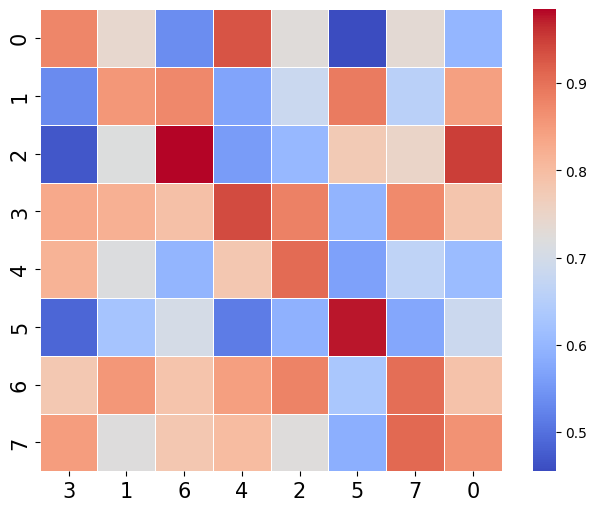

In [18]:
fig,ax = plot_mode_pairing(spatial_cor,indice)
plt.show()

So there should be some errors in the data split.Now fixed! It's time to have a look at the free energy.

In [35]:
save_dir = './results_HCP_yaml_202403/'
N_states = list(range(2,37))
N_splits = 5

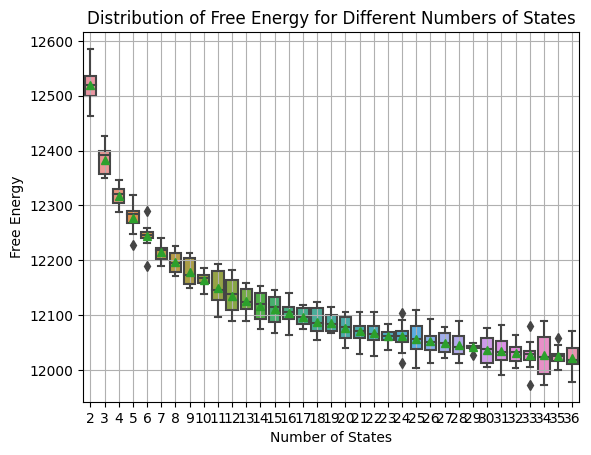

In [36]:
import json
import matplotlib.pyplot as plt
import seaborn as sns

# Initialize a dictionary to store free energy values for each number of states
free_energy_dict = {N_state: [] for N_state in N_states}

# Loop through each value of N_states
for N_state in N_states:
    # Loop through each repeat
    for i in range(1,N_splits+1):
        # Define the path to the JSON file for the free energy
        for j in range(2):
            file_path = os.path.join(save_dir, f'hmm_ICA_25_state_{N_state}/split_{i}/free_energy_cv_{j+1}.json')
            # Load the JSON file
            with open(file_path, 'r') as f:
                metrics = json.load(f)
            # Extract the 'free_energy' value and append it to the dictionary
            free_energy = metrics['free_energy']
            free_energy_dict[N_state].append(free_energy)

# Plot boxplots of the free energy values for each number of states
sns.boxplot(data=list(free_energy_dict.values()), showmeans=True)
plt.xlabel('Number of States')
plt.ylabel('Free Energy')
plt.title('Distribution of Free Energy for Different Numbers of States')
plt.xticks(ticks=range(len(N_states)), labels=N_states)
plt.grid(True)
plt.show()

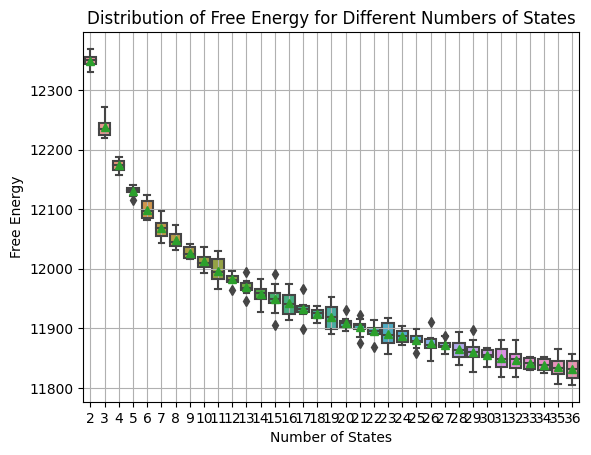

In [37]:
# Initialize a dictionary to store free energy values for each number of states
free_energy_dict = {N_state: [] for N_state in N_states}

# Loop through each value of N_states
for N_state in N_states:
    # Loop through each repeat
    for i in range(1,N_splits+1):
        # Define the path to the JSON file for the free energy
        for j in range(2):
            file_path = os.path.join(save_dir, f'hmm_ICA_25_state_{N_state}/split_{i}/half_{j+1}/metrics/metrics.json')
            # Load the JSON file
            with open(file_path, 'r') as f:
                metrics = json.load(f)
            # Extract the 'free_energy' value and append it to the dictionary
            free_energy = metrics['free_energy']
            free_energy_dict[N_state].append(free_energy)

# Plot boxplots of the free energy values for each number of states
sns.boxplot(data=list(free_energy_dict.values()), showmeans=True)
plt.xlabel('Number of States')
plt.ylabel('Free Energy')
plt.title('Distribution of Free Energy for Different Numbers of States')
plt.xticks(ticks=range(len(N_states)), labels=N_states)
plt.grid(True)
plt.show()

## The following codes are just for preparation of the meeting on 12th March 2024

In [44]:
import os
import json
import pickle
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [39]:
from osl_dynamics.inference.metrics import twopair_riemannian_distance

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 168.09it/s]


<Axes: >

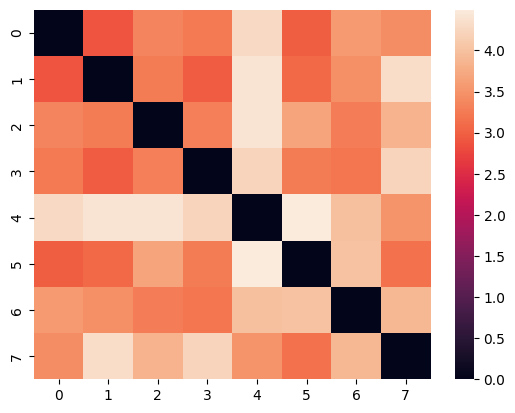

In [42]:
my_cov = np.load('results_HCP_202311_no_mean/HMM_ICA_25_state_8/state_covariances.npy')
sns.heatmap(twopair_riemannian_distance(my_cov,my_cov))

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 478.75it/s]


<Axes: >

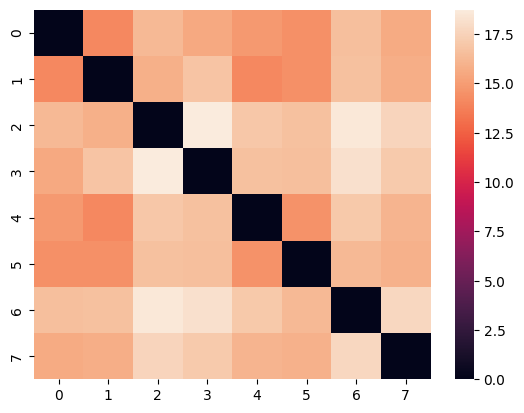

In [43]:
rukuang_cov = np.load('./data/node_timeseries/simulation_rukuang/state_8/truth/state_covariances.npy')
sns.heatmap(twopair_riemannian_distance(rukuang_cov,rukuang_cov))

In [49]:
save_dir = './results_simulation_rukuang/state_8/'
N_states = list(range(8,17))
repeats = ['train','repeat_1','repeat_2','repeat_3','repeat_4','repeat_5']

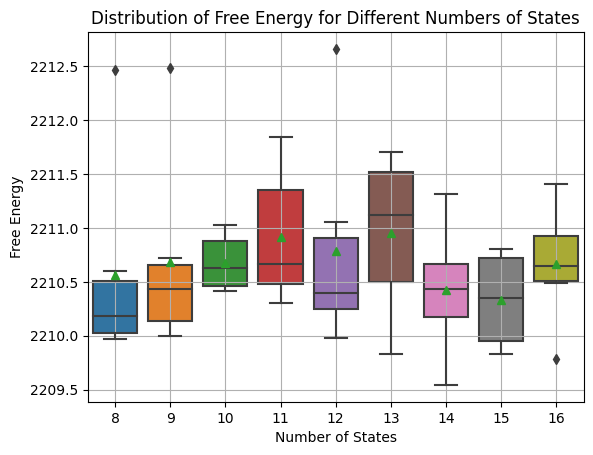

In [50]:
# Initialize a dictionary to store free energy values for each number of states
free_energy_dict = {N_state: [] for N_state in N_states}

# Loop through each value of N_states
for N_state in N_states:
    # Loop through each repeat
    for repeat in repeats:
        # Define the path to the JSON file for the free energy
        file_path = os.path.join(save_dir, f'hmm_ICA_25_state_{N_state}/{repeat}/metrics/metrics.json')
        # Load the JSON file
        with open(file_path, 'r') as f:
            metrics = json.load(f)
        # Extract the 'free_energy' value and append it to the dictionary
        free_energy = metrics['free_energy']
        free_energy_dict[N_state].append(free_energy)

# Plot boxplots of the free energy values for each number of states
sns.boxplot(data=list(free_energy_dict.values()), showmeans=True)
plt.xlabel('Number of States')
plt.ylabel('Free Energy')
plt.title('Distribution of Free Energy for Different Numbers of States')
plt.xticks(ticks=range(len(N_states)), labels=N_states)
plt.grid(True)
plt.show()

In [66]:
save_dir = './results_simulation_rukuang/state_100/'
N_states = list(range(2,36))
repeats = ['train','repeat_1','repeat_2','repeat_3','repeat_4','repeat_5']

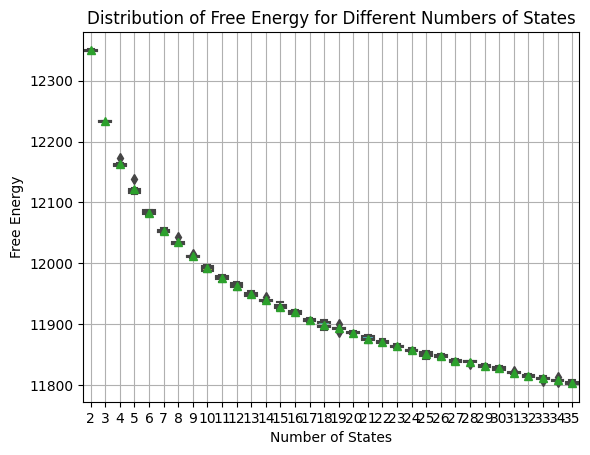

In [60]:
# Initialize a dictionary to store free energy values for each number of states
free_energy_dict = {N_state: [] for N_state in N_states}

# Loop through each value of N_states
for N_state in N_states:
    # Loop through each repeat
    for repeat in repeats:
        # Define the path to the JSON file for the free energy
        file_path = os.path.join(save_dir, f'hmm_ICA_25_state_{N_state}/{repeat}/metrics/metrics.json')
        # Load the JSON file
        with open(file_path, 'r') as f:
            metrics = json.load(f)
        # Extract the 'free_energy' value and append it to the dictionary
        free_energy = metrics['free_energy']
        free_energy_dict[N_state].append(free_energy)

# Plot boxplots of the free energy values for each number of states
sns.boxplot(data=list(free_energy_dict.values()), showmeans=True)
plt.xlabel('Number of States')
plt.ylabel('Free Energy')
plt.title('Distribution of Free Energy for Different Numbers of States')
plt.xticks(ticks=range(len(N_states)), labels=N_states)
plt.grid(True)
plt.show()

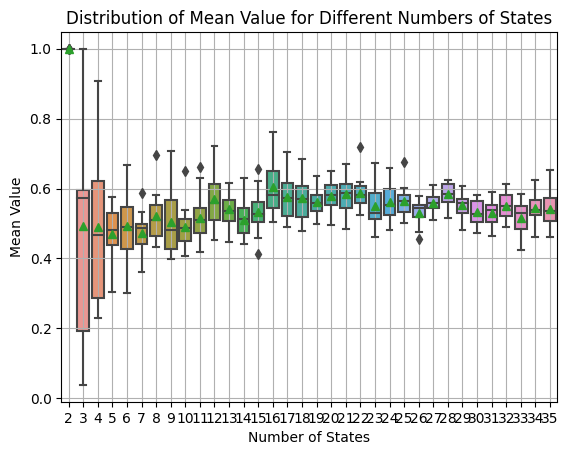

In [67]:
import seaborn as sns
'''
summary_dir = f'{save_dir}summary/'
if not os.path.exists(summary_dir):
    os.makedirs(summary_dir)
'''
for metric in ['temp']:#,'temp_argmax']:
    # Initialize a dictionary to store mean values for each number of states
    mean_values_dict = {N_state: [] for N_state in N_states}

    # Loop through each value of N_states
    for N_state in N_states:
        # Loop through each pair of repeats
        for i in range(len(repeats)):
            for j in range(i + 1, len(repeats)):
                # Define the path to the pickle file
                file_path = os.path.join(save_dir, f'hmm_ICA_25_state_{N_state}/analysis/{metric}_pair_{repeats[i]}_vs_{repeats[j]}.pkl')
                # Load the pickle file
                with open(file_path, 'rb') as f:
                    data = pickle.load(f)
                # Extract the 'mean' value and append it to the dictionary
                mean_value = data['mean']
                mean_values_dict[N_state].append(mean_value)

    # Plot boxplots of the mean values for each number of states
    sns.boxplot(data=list(mean_values_dict.values()), showmeans=True)
    plt.xlabel('Number of States')
    plt.ylabel('Mean Value')
    plt.title('Distribution of Mean Value for Different Numbers of States')
    plt.xticks(ticks=range(len(N_states)), labels=N_states)
    plt.grid(True)
    plt.show()

In [24]:
save_dir = './results_simulation_rukuang/state_5_fixed/tpm_3/'
repeats = ['train','repeat_1','repeat_2','repeat_3','repeat_4','repeat_5']

In [25]:
from osl_dynamics.inference.modes import fractional_occupancies
from osl_dynamics.utils.plotting import plot_violin

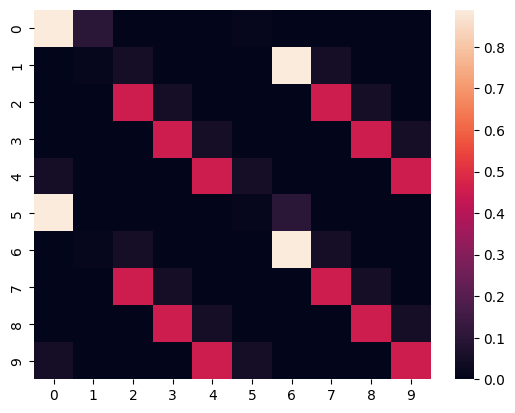

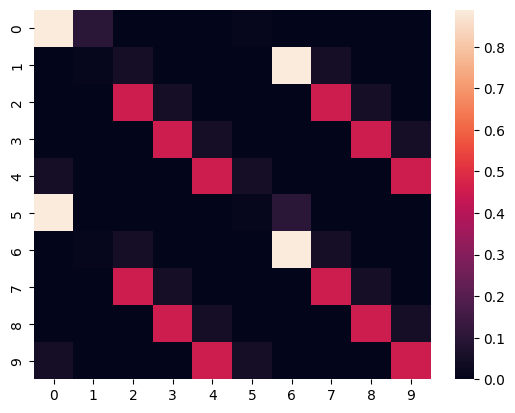

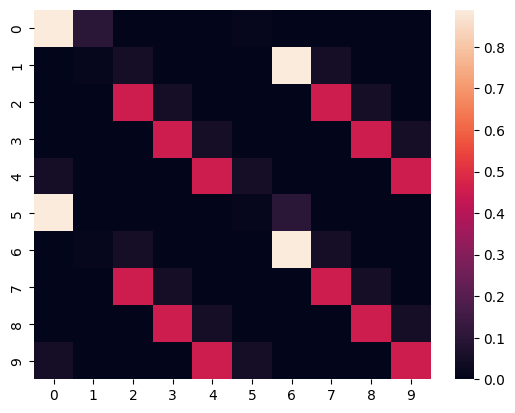

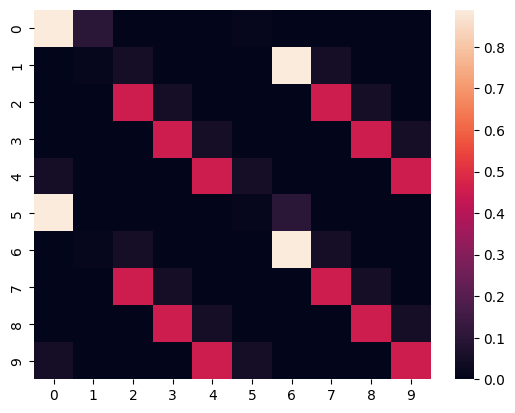

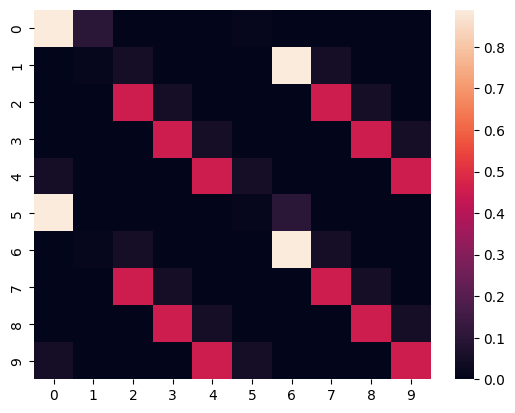

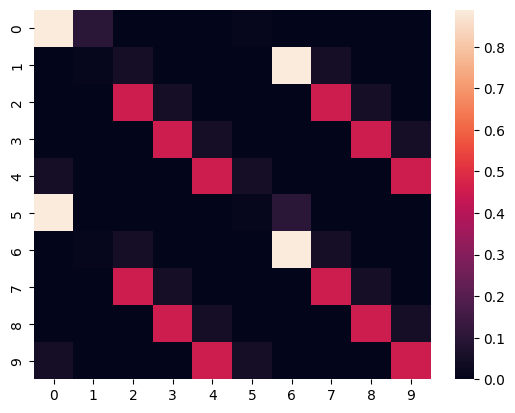

In [27]:
for repeat in repeats:
    tpm = np.load(f'{save_dir}hmm_ICA_25_state_10/{repeat}/model/trans_prob.npy')
    sns.heatmap(tpm)
    plt.show()

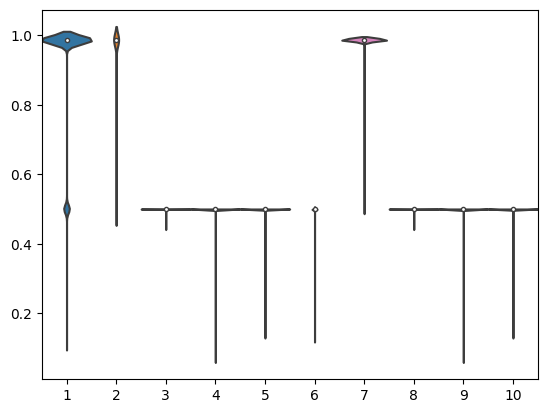

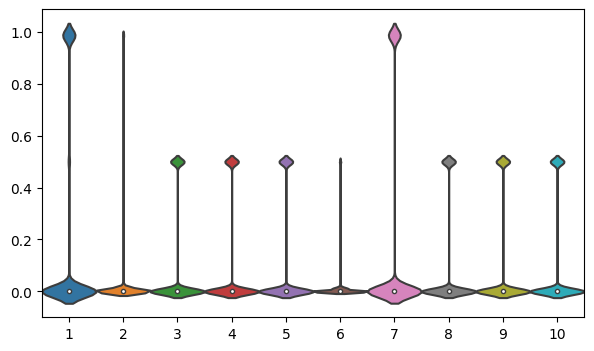

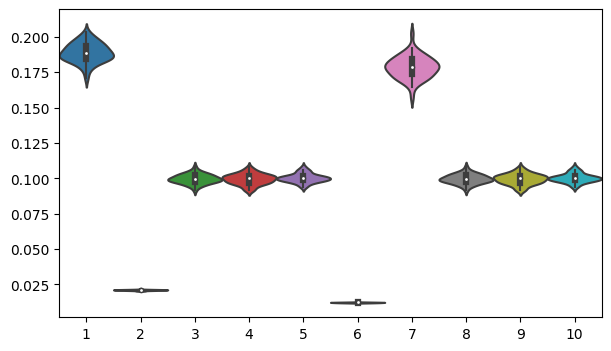

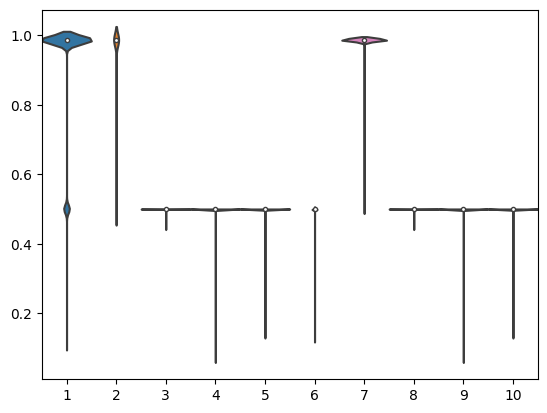

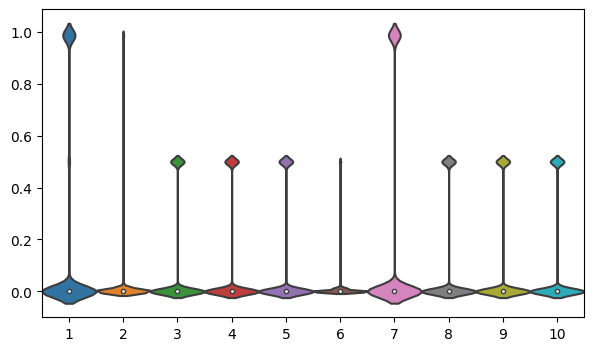

...

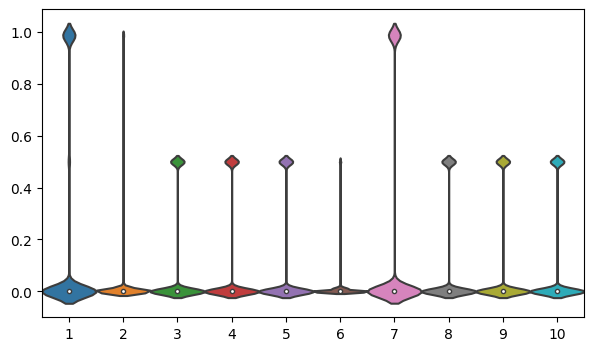

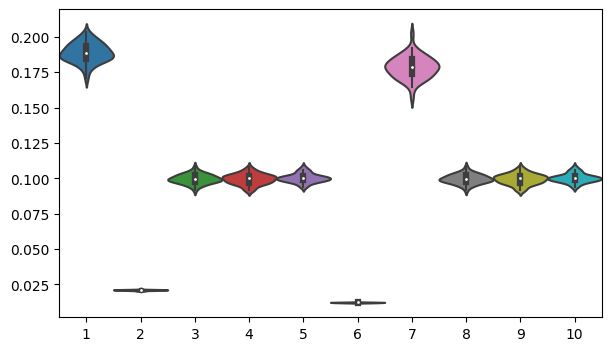

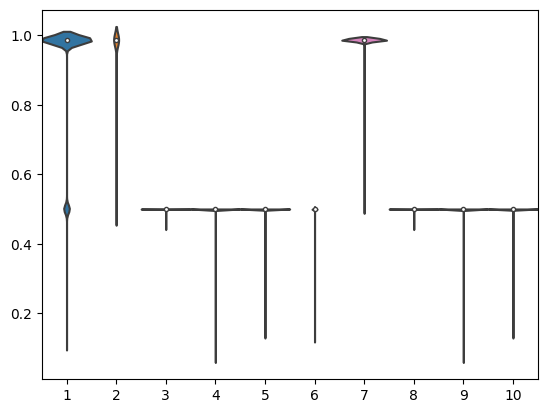

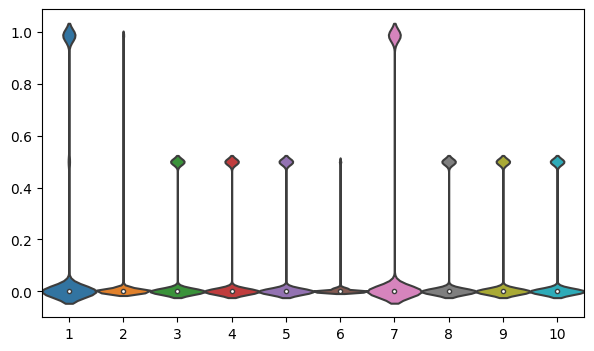

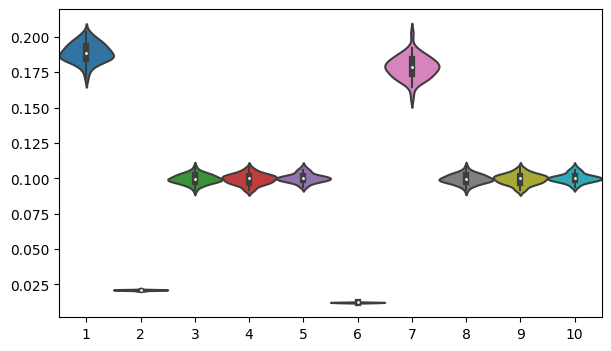

In [28]:
for repeat in repeats:
    
    with open(f'{save_dir}hmm_ICA_25_state_10/{repeat}/inf_params/alp.pkl','rb') as file:
        alpha = pickle.load(file)
        
    fo = fractional_occupancies(alpha)
    
    alpha_plot = np.concatenate(alpha,axis=0).T
    
    x, y = [], []
    for i in range(len(alpha_plot)):
        alpha_state = alpha_plot[i]
        temp = alpha_state[alpha_state>0.05]
        x.append(np.ones(len(temp)) * (i+1))
        y.append(temp)
    
    x = np.concatenate(x,axis=0).astype(int)
    y = np.concatenate(y,axis=0)
    
    sns_kwargs = {'scale':'count','width': 1}
    sns.violinplot(x=x,y=y,**sns_kwargs)
    #np.concatenate(alpha,axis=0).T,fig_kwargs={'figsize': (10, 4)},sns_kwargs = {'scale':'count','width': 1})
    plt.show()
    
    fig,ax = plot_violin(alpha_plot,
                         #fig_kwargs={'figsize': (10, 4)},
                         sns_kwargs = {'scale':'count','width': 1})
    plt.show()
    
    fig,ax = plot_violin(fo.T,
                         #fig_kwargs={'figsize': (10, 4)},
                         sns_kwargs = {'scale':'count','width': 1})
    plt.show()

## Update 14th March 2024

Today we try to implement the "cross validation"

In [4]:
import os
import json
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

In [10]:
save_dir = './results_HCP_cv/'
N_states = list(range(2,36))
N_splits = 10

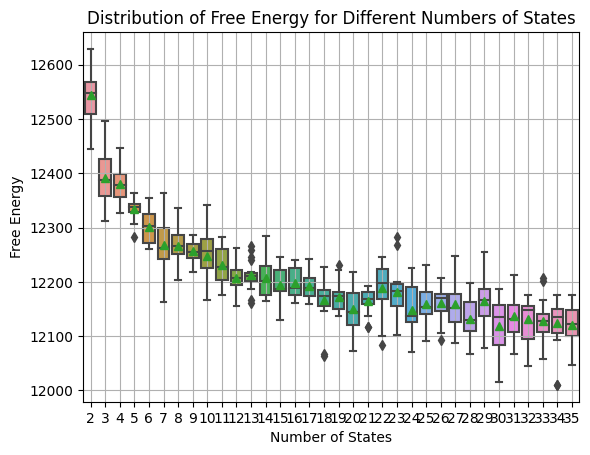

In [11]:
# Initialize a dictionary to store free energy values for each number of states
free_energy_dict = {N_state: [] for N_state in N_states}

# Loop through each value of N_states
for N_state in N_states:
    # Loop through each repeat
    for i in range(1,N_splits+1):
        # Define the path to the JSON file for the free energy
        for j in range(2):
            file_path = os.path.join(save_dir, f'hmm_ICA_25_state_{N_state}/cv_{i}/free_energy_cv_{j+1}.json')
            # Load the JSON file
            with open(file_path, 'r') as f:
                metrics = json.load(f)
            # Extract the 'free_energy' value and append it to the dictionary
            free_energy = metrics['free_energy']
            free_energy_dict[N_state].append(free_energy)

# Plot boxplots of the free energy values for each number of states
sns.boxplot(data=list(free_energy_dict.values()), showmeans=True)
plt.xlabel('Number of States')
plt.ylabel('Free Energy')
plt.title('Distribution of Free Energy for Different Numbers of States')
plt.xticks(ticks=range(len(N_states)), labels=N_states)
plt.grid(True)
plt.show()

## Update 18th March 2024

Now we try to implement bi-cross validation as Fu and Perry has done in the 2017 paper

In [1]:
import os
import json
import pickle
import numpy as np
import random
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

In [9]:
# Speicify the save directory
save_dir = './results_simulation_bicv/toy_gaussian/results_one_cluster/'
if not os.path.exists(save_dir):
    os.makedirs(save_dir)

In [13]:
# Generate data
data_dir = f'./results_simulation_bicv/toy_gaussian/data/one_cluster/'
if not os.path.exists(data_dir):
    os.makedirs(data_dir)

In [14]:
rhos = [x / 5 for x in range(0, 5)]

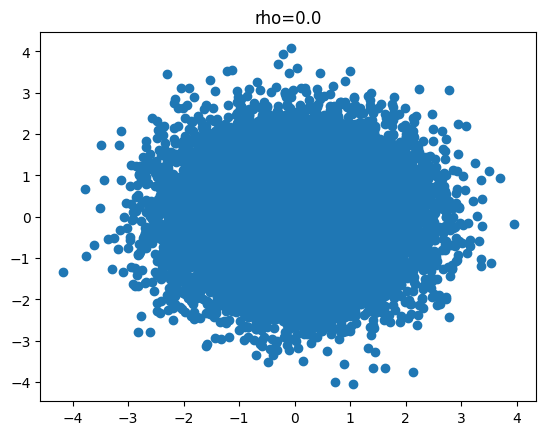

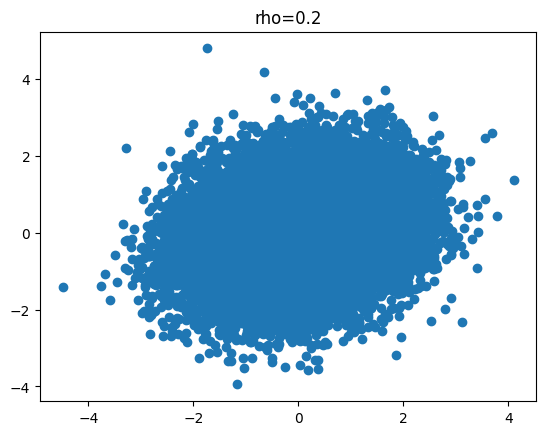

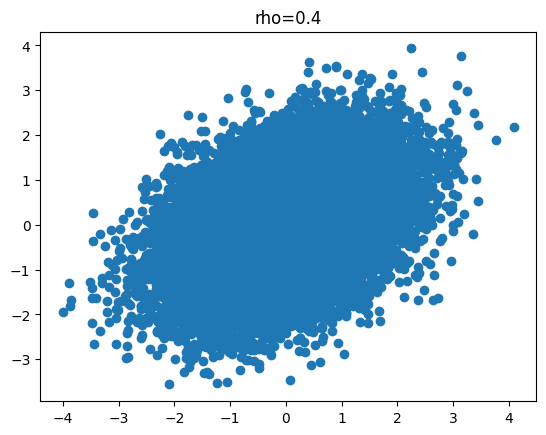

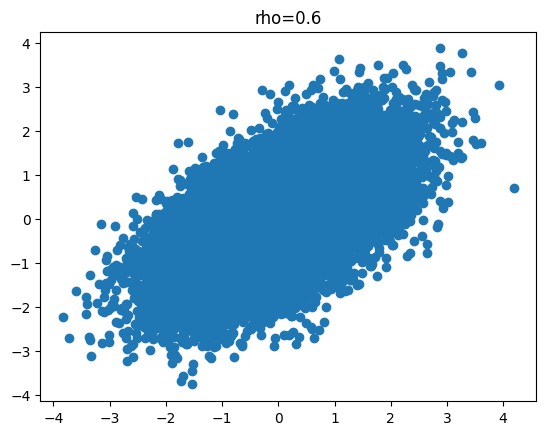

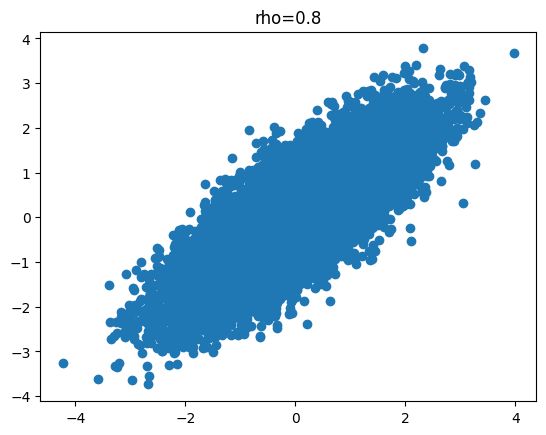

In [31]:
for rho in rhos:
    # Define the covariance matrix
    cov = np.array([[1, rho], [rho, 1]])
    observations = np.random.multivariate_normal(mean=[0, 0], cov=cov, size=20000)
    plt.scatter(observations.T[0,:],observations.T[1,:])
    plt.title(f'rho={rho}')
    plt.show()
    np.save(f'{data_dir}rho_{rho}.npy',observations)

In [4]:
from osl_dynamics.evaluate.cross_validation import BICVkmeans

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [19]:
for rho in rhos:
    data = np.load(f'{data_dir}rho_{rho}.npy')
    n_samples, n_channels = data.shape
    for k in range(1,6): 
        cv = BICVkmeans(n_clusters=k,n_samples=n_samples,n_channels=n_channels)
        new_save_dir = os.path.join(save_dir,f'rho_{rho}_k_{k}')
        if not os.path.exists(new_save_dir):
            os.makedirs(new_save_dir)
        metrics = cv.validate(data,new_save_dir)
        # Save list to JSON file
        with open(os.path.join(save_dir,f'rho_{rho}_k_{k}.json'), 'w') as f:
            json.dump(metrics, f)

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The defaul

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The defaul

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The defaul

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The defaul

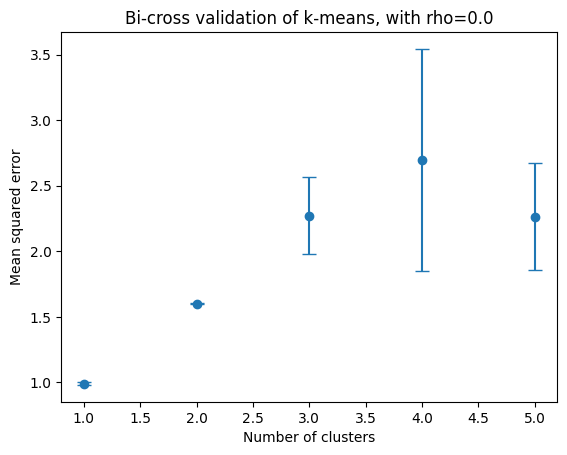

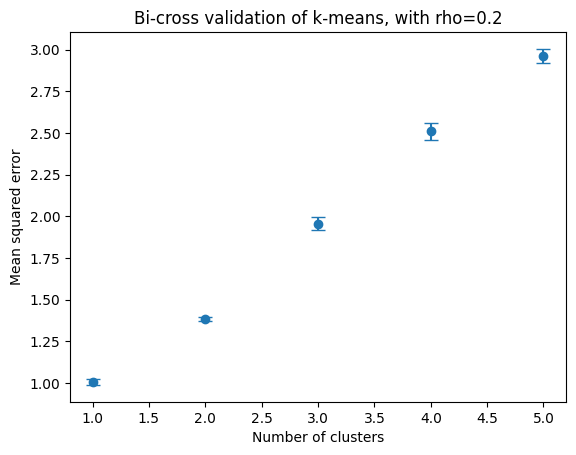

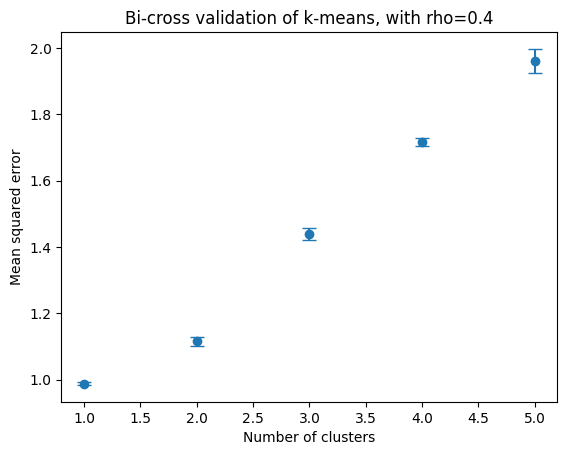

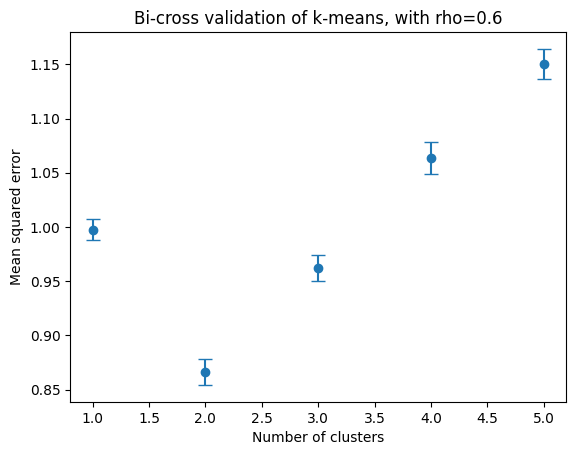

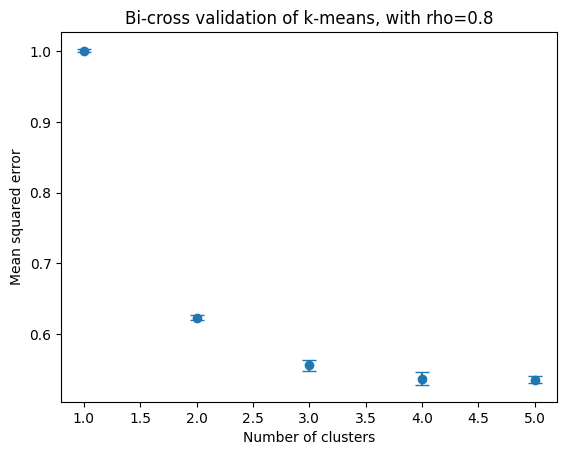

In [20]:
for rho in rhos:
    k_values = []
    mean_values = []
    std_values = []
    for k in range(1,6):
        # Load the JSON file
        with open(os.path.join(save_dir,f'rho_{rho}_k_{k}.json'), 'r') as file:
            values = json.load(file)
        
        # Calculate mean and standard deviation
        mean_k = np.mean(values)
        std_k = np.std(values)

        # Store values
        k_values.append(k)
        mean_values.append(mean_k)
        std_values.append(std_k)

    # Plot mean values with error bars
    plt.errorbar(k_values, mean_values, yerr=std_values, fmt='o', capsize=5)
    plt.xlabel('Number of clusters')
    plt.ylabel('Mean squared error')
    plt.title(f'Bi-cross validation of k-means, with rho={rho}')
    plt.show()

## The second example

There are four clusters in 10-dimensional space

The shape of X:  (8000, 10)


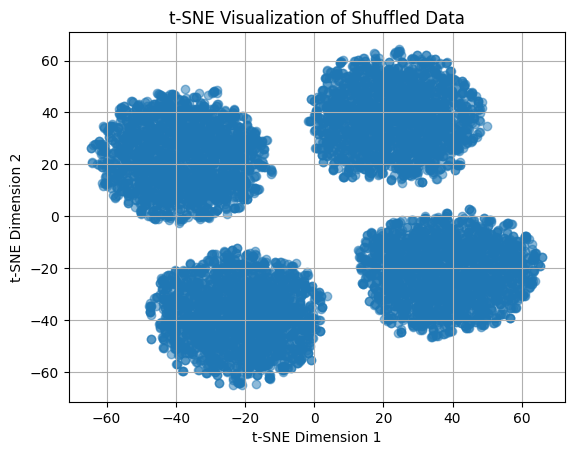

In [17]:
import numpy as np
from sklearn.datasets import make_blobs
from sklearn.utils import shuffle
from sklearn.manifold import TSNE

# Set random seed for reproducibility
np.random.seed(42)

# Generate four clusters of Gaussian random variables
X, y = make_blobs(n_samples=8000, n_features=10, centers=4, cluster_std=1.0, random_state=42)
print('The shape of X: ',X.shape)

# Shuffle the data
X_shuffled, y_shuffled = shuffle(X, y, random_state=42)


# Apply t-SNE for dimensionality reduction
tsne = TSNE(n_components=2, random_state=42)
X_tsne = tsne.fit_transform(X_shuffled)

# Plot the reduced data
plt.scatter(X_tsne[:, 0], X_tsne[:, 1], alpha=0.5)
plt.title('t-SNE Visualization of Shuffled Data')
plt.xlabel('t-SNE Dimension 1')
plt.ylabel('t-SNE Dimension 2')
plt.grid(True)
plt.show()
np.save(os.path.join(data_dir,'four_clusters_10D.npy'),X_shuffled)

In [18]:
new_save_dir = os.path.join(save_dir,'results_four_clusters_10D/')
if not os.path.exists(new_save_dir):
    os.makedirs(new_save_dir)
    
data = np.load(os.path.join(data_dir,'four_clusters_10D.npy'))
n_samples, n_channels = data.shape
for k in range(1,10): 
    cv = BICVkmeans(n_clusters=k,n_samples=n_samples,n_channels=n_channels)
    metrics = cv.validate(data)
    # Save list to JSON file
    with open(os.path.join(new_save_dir,f'rho_{rho}_k_{k}.json'), 'w') as f:
        json.dump(metrics, f)

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The defaul

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The defaul

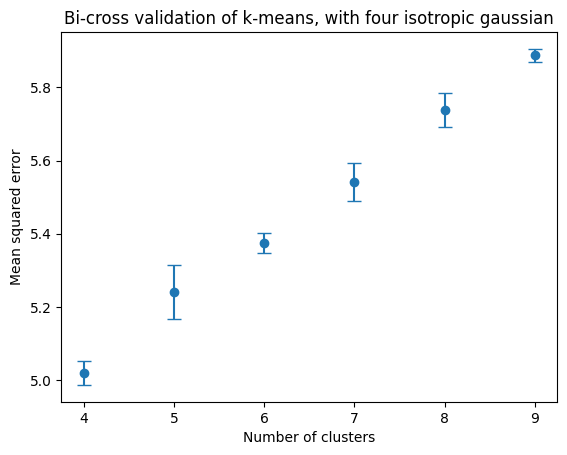

In [23]:
k_values = []
mean_values = []
std_values = []
for k in range(4,10):
    # Load the JSON file
    with open(os.path.join(new_save_dir,f'rho_{rho}_k_{k}.json'), 'r') as file:
        values = json.load(file)
        
    # Calculate mean and standard deviation
    mean_k = np.mean(values)
    std_k = np.std(values)

    # Store values
    k_values.append(k)
    mean_values.append(mean_k)
    std_values.append(std_k)

# Plot mean values with error bars
plt.errorbar(k_values, mean_values, yerr=std_values, fmt='o', capsize=5)
plt.xlabel('Number of clusters')
plt.ylabel('Mean squared error')
plt.title(f'Bi-cross validation of k-means, with four isotropic gaussian')
plt.show()

## Update 22nd March 2024

Check the log-likelihood result on bi-cross validation

In [16]:
import os
import json
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

In [62]:
save_dir = './results_HCP_bicv_confirm/'
N_states = list(range(2,13))
N_cv = 10

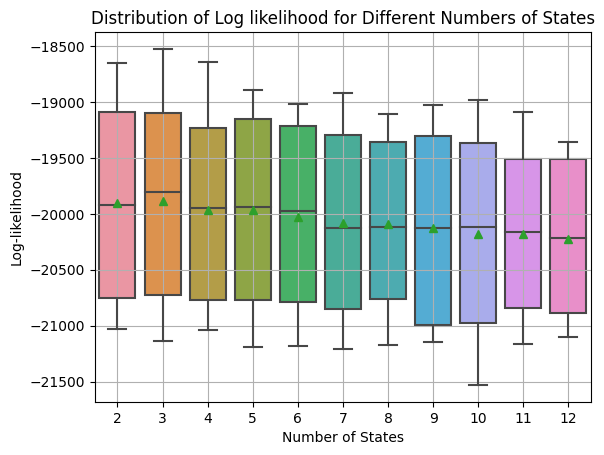

In [63]:
# Initialize a dictionary to store free energy values for each number of states
metric_dict = {N_state: [] for N_state in N_states}

# Loop through each value of N_states
for N_state in N_states:
    # Loop through each repeat
    for i in range(1,N_cv+1):
        try:
            file_path = os.path.join(save_dir, f'hmm_ICA_25_state_{N_state}/cv_{i}/metrics.json')
            # Load the JSON file
            with open(file_path, 'r') as f:
                metrics = json.load(f)
            # Extract the 'free_energy' value and append it to the dictionary
            metric_dict[N_state].extend(metrics)
        except Exception as e:
            print(f'N_state={N_state},i={i} not successful!')

# Plot boxplots of the free energy values for each number of states
sns.boxplot(data=list(metric_dict.values()), showmeans=True)
plt.xlabel('Number of States')
plt.ylabel('Log-likelihood')
plt.title('Distribution of Log likelihood for Different Numbers of States')
plt.xticks(ticks=range(len(N_states)), labels=N_states)
plt.grid(True)
plt.show()

### Update 27th March 2024

This part is to replicate Steve's bi-cross validation on SVD.

In [78]:
import numpy as np
from numpy.linalg import svd
import matplotlib.pyplot as plt
%matplotlib inline

In [170]:
N_1 = 100
N_2 = 100
D = 10
E = 20.0

In [171]:
U = np.random.randn(N_1, D) ** 3
V = np.random.randn(N_2, D) ** 3
Z = np.dot(U, V.T)
print(Z.shape)
Z += E * np.random.randn(*Z.shape)

(100, 100)


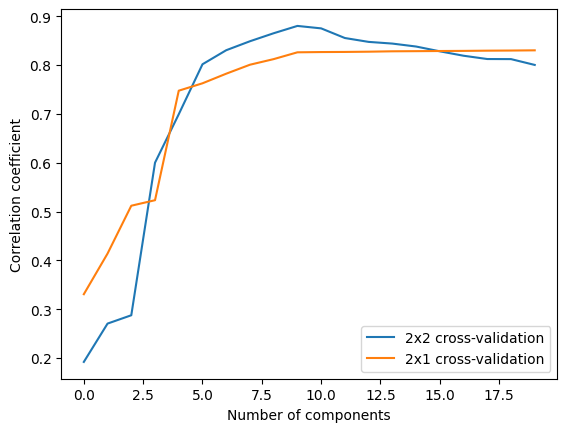

In [172]:
SCORES = np.zeros((20, 2))
for d in range(1, 21):
    # 2x2 cross-validation
    Xtrain = Z[:N_1//2, :N_2//2]
    Ytrain = Z[:N_1//2, N_2//2:]
    Xtest = Z[N_1//2:, :N_2//2]
    Ytest = Z[N_1//2:, N_2//2:]

    YtrainU, YtrainS, YtrainVt = svd(Ytrain, full_matrices=False)
    YtrainU = YtrainU[:,:d]
    YtrainS = YtrainS[:d]
    YtrainVt = YtrainVt[:d,:]
    XtrainVt = np.linalg.pinv(YtrainU) @ Xtrain
    XtestU = Xtest @ np.linalg.pinv(XtrainVt)
    YtestUV = XtestU @ np.diag(YtrainS) @ YtrainVt
    SCORES[d-1, 0] = np.corrcoef(Ytest.ravel(), YtestUV.ravel())[0, 1]
    
    # 2x1 cross-validation
    XYtrain = np.hstack((Xtrain, Ytrain))
    XYtest = np.hstack((Xtest, Ytest))
    XYtrainU, XYtrainS, XYtrainVt = svd(XYtrain, full_matrices=False)
    XYtrainU = XYtrainU[:,:d]
    XYtrainS = XYtrainS[:d]
    XYtrainVt = XYtrainVt[:d,:]
    XYtestU = XYtest @ np.linalg.pinv(XYtrainVt)
    XYtestUV = XYtestU @ np.diag(XYtrainS) @ XYtrainVt
    SCORES[d-1, 1] = np.corrcoef(XYtest.ravel(), XYtestUV.ravel())[0, 1]
    

plt.plot(SCORES)
plt.xlabel('Number of components')
plt.ylabel('Correlation coefficient')
plt.legend(['2x2 cross-validation', '2x1 cross-validation'])
plt.show()

In [106]:
U, S, Vt = svd(Z, full_matrices=False)
Z_recover = U @ np.diag(S) @ Vt
print(np.corrcoef(Z.ravel(), Z_recover.ravel())[0, 1])

1.0


## Update 31st March 2024

The batch analysis code.

In [1]:
from osl_dynamics.config_api.batch import BatchAnalysis

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [11]:
config_path = './UKB/ICA_50/'
batch_analysis = BatchAnalysis(config_path)

In [12]:
batch_analysis.compare(demean=True,inset_start_index=6)

2024-05-27 13:38:42 INFO osl-dynamics [plotting.py:104:save]: Saving ./UKB/ICA_50/analysis/hmm_Y_test_log_likelihood.pdf
/gpfs3/well/win-fmrib-analysis/users/uap971/osl-dynamics/osl_dynamics/utils/plotting.py:106: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


Now we check the diagonal matrix.

In [95]:
import numpy as np
from numpy.linalg import svd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

In [96]:
covariances = np.load('./results_HCP_bicv_202404/var_1/notts_MEG/hmm_ICA_80_state_9/cv_1/fold_1_1/Y_train/inf_params/covs.npy')

In [98]:
from osl_dynamics.array_ops import cov2stdcorr
std, corr = cov2stdcorr(covariances)
print(corr.shape)

(9, 40, 40)


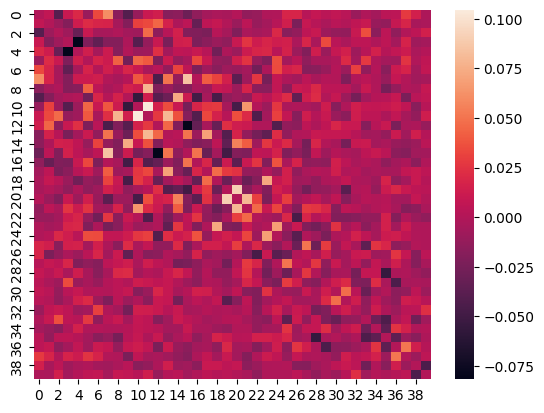

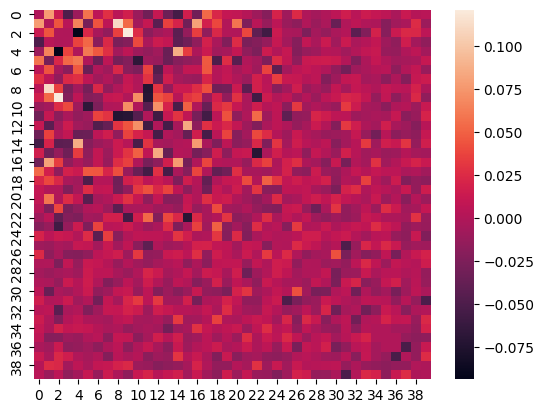

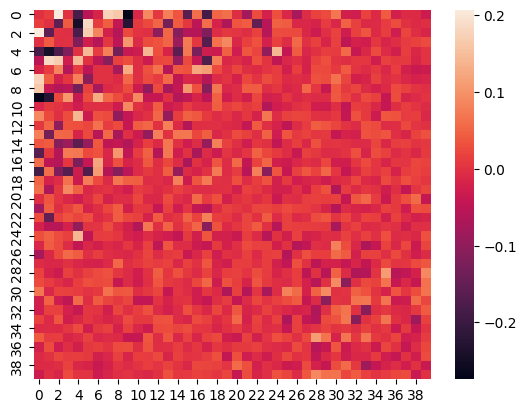

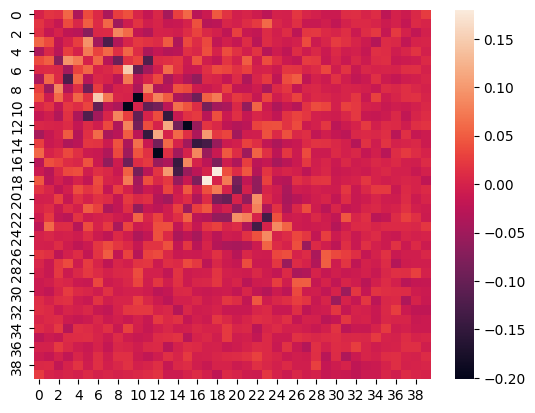

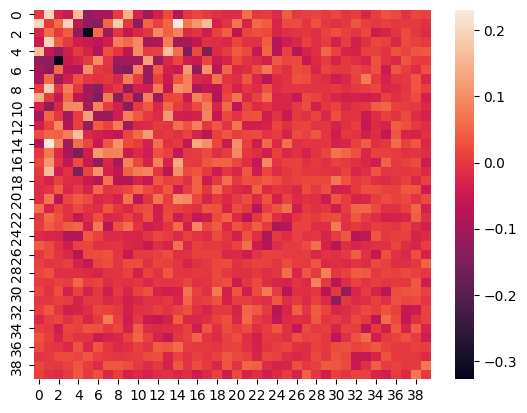

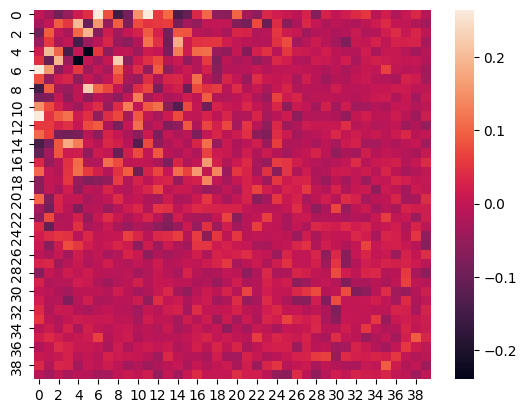

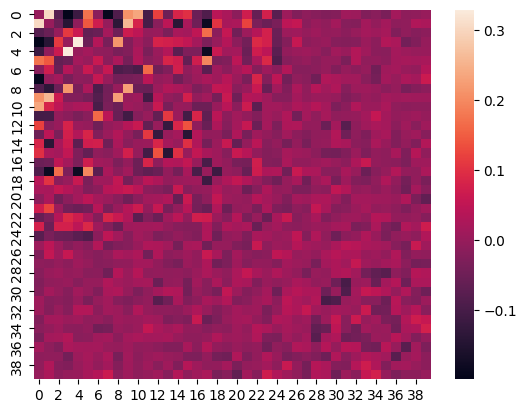

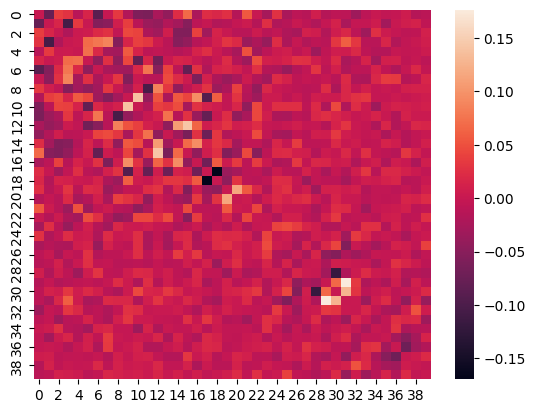

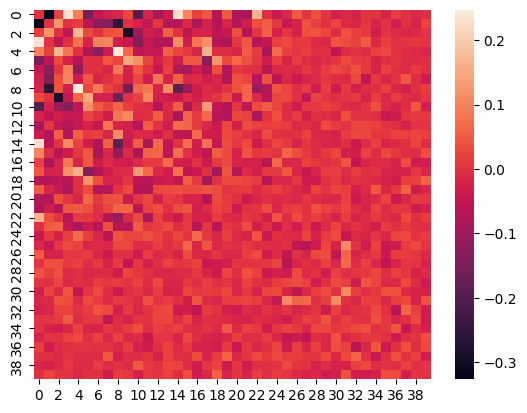

In [99]:
for i in range(len(covariances)):
    sns.heatmap(corr[i]-np.eye(40))
    plt.show()

## Update 5th April 2024

Try Steve's code on bi-cross validation on SVD.

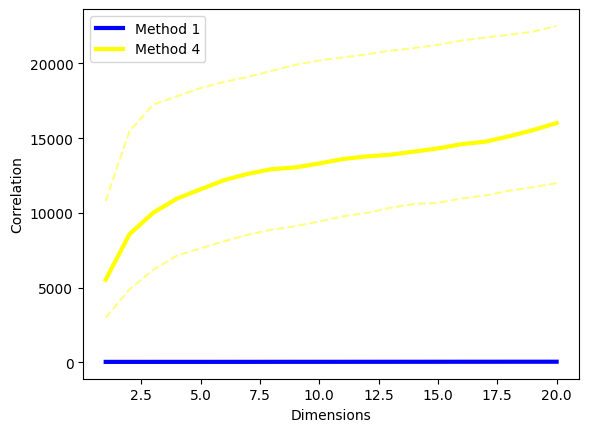

In [62]:
N = 100
D = 10
E = 30.0
Srange = [0.2, 1]
SCORESa = []
SCORESb = []
SCORESc = []
SCORESd = []
DIMs = list(range(1, 21)) #+ list(range(25, 61, 5))
I = 100
np.random.seed(0)

for i in range(I):
    U = np.random.randn(N, D)**3
    V = np.random.randn(N, D)**3
    S = np.diag(np.random.rand(D) * (Srange[1] - Srange[0]) + Srange[0])
    Z = U @ S @ V.T
    Z += E * np.random.randn(*Z.shape)
    
    # Method 1 Flow: Ytrain --> Xtrain --> Xtest --> Ytest
    Xtrain = Z[:N//2, :N//2]
    Ytrain = Z[:N//2, N//2:]
    Xtest = Z[N//2:, :N//2]
    Ytest = Z[N//2:, N//2:]
    YtrainU_full, YtrainS_full, YtrainVt_full = svd(Ytrain,full_matrices=False)
    
    # Method 2 Flow: Xtrain --> Ytrain, Xtrain --> Xtest, Ytrain,Xtest --> Ytest
    XtrainU_full, XtrainS_full, XtrainVt_full = svd(Xtrain,full_matrices=True)
    
    # Method 3 Flow: [Xtrain,Ytrain] --> Xtest, [Xtest, Ytrain] --> Ytest
    XYtrain = np.hstack((Xtrain,Ytrain))
    XYtrainU_full, XYtrainS_full, XYtrainVt_full = svd(XYtrain,full_matrices=False)
    
    
    # Method 4 Flow: [Xtrain,Xtest].T --> Ytrain, [Xtest,Ytrain] --> Ytest
    Xtraintest = np.vstack((Xtrain,Xtest))
    XtraintestU_full, XtraintestS_full, XtraintestVt_full = svd(Xtraintest,full_matrices=False)
    
    
    for d in DIMs:
        # Method 1: Flow: Ytrain --> Xtrain --> Xtest --> Ytest
        YtrainU = YtrainU_full[:, :d]
        YtrainS = YtrainS_full[:d]
        YtrainVt = YtrainVt_full[:d, :]
        
        XtrainVt = np.linalg.pinv(YtrainU) @ Xtrain
        XtestU = Xtest @ np.linalg.pinv(XtrainVt)
        YtestUV = XtestU @ np.diag(YtrainS) @ YtrainVt
        #SCORESa.append(np.corrcoef(Ytest.flatten(), YtestUV.flatten())[0, 1])
        SCORESa.append(np.mean(np.abs(Ytest.flatten() - YtestUV.flatten())))
        # Method 2 Flow: Xtrain --> Ytrain, Xtrain --> Xtest, Ytrain,Xtest --> Ytest
        XtrainU = XtrainU_full[:,:d]
        XtrainS = XtrainS_full[:d]
        XtrainVt = XtrainVt_full[:d,:]
        
        XtestU = Xtest @ np.linalg.pinv(XtrainVt)
        YtrainVt = np.linalg.pinv(XtrainU) @ Ytrain
        YtestUV = XtestU @ np.diag(XtrainS) @ YtrainVt
        #SCORESb.append(np.corrcoef(Ytest.flatten(), YtestUV.flatten())[0, 1])
        SCORESb.append(np.mean(np.abs(Ytest.flatten() - YtestUV.flatten())))
        
        # Method 3 Flow: [Xtrain,Ytrain] --> Xtest, [Xtest, Ytrain] --> Ytest
        XYtrainU = XYtrainU_full[:, :d]
        XYtrainS = XYtrainS_full[:d]
        XYtrainVt = XYtrainVt_full[:d, :]
        XtestU = Xtest @ np.linalg.pinv(XYtrainVt[:,:N//2])
        YtestUV = XtestU @ np.diag(XYtrainS) @ XYtrainVt[:, N//2:]
        #SCORESc.append(np.corrcoef(Ytest.flatten(), YtestUV.flatten())[0, 1])
        SCORESc.append(np.mean(np.abs(Ytest.flatten() - YtestUV.flatten())))
        
        # Method 4 Flow: [Xtrain,Xtest].T --> Ytrain, [Xtest,Ytrain] --> Ytest
        XtraintestU = XtraintestU_full[:, :d]
        XtraintestS = XtraintestS_full[:d]
        XtraintestVt = XtraintestVt_full[:d, :]
        
        YtrainVt = np.linalg.pinv(XtraintestU[:N//2,:]) @ Ytrain
        YtestUV = XtraintestU[N//2:,:] @ np.diag(XtraintestS) @ YtrainVt
        #SCORESd.append(np.corrcoef(Ytest.flatten(), YtestUV.flatten())[0, 1])
        SCORESd.append(np.mean(np.abs(Ytest.flatten() - YtestUV.flatten())))
       

SCORESaP = np.percentile(np.array(SCORESa).reshape((I, len(DIMs))), [10, 50, 90], axis=0)
SCORESbP = np.percentile(np.array(SCORESb).reshape((I, len(DIMs))), [10, 50, 90], axis=0)
SCOREScP = np.percentile(np.array(SCORESc).reshape((I, len(DIMs))), [10, 50, 90], axis=0)
SCORESdP = np.percentile(np.array(SCORESd).reshape((I, len(DIMs))), [10, 50, 90], axis=0)

plt.figure()
plt.plot(DIMs, np.squeeze(SCORESaP.T[:, 1]), label='Method 1', color='blue',linewidth=3)
#plt.plot(DIMs, np.squeeze(SCORESbP.T[:, 1]), label='Method 2', color='green',linewidth=3)
#plt.plot(DIMs, np.squeeze(SCOREScP.T[:, 1]), label='Method 3', color='red',linewidth=3)
plt.plot(DIMs, np.squeeze(SCORESdP.T[:, 1]), label='Method 4', color='yellow',linewidth=3)
plt.plot(DIMs, np.squeeze(SCORESaP.T[:, 0]), '--', color='blue',alpha=0.5)
#plt.plot(DIMs, np.squeeze(SCORESbP.T[:, 0]), '--', color='green',alpha=0.5)
#plt.plot(DIMs, np.squeeze(SCOREScP.T[:, 0]), '--', color='red',alpha=0.5)
plt.plot(DIMs, np.squeeze(SCORESdP.T[:, 0]), '--', color='yellow',alpha=0.5)
plt.plot(DIMs, np.squeeze(SCORESaP.T[:, 2]), '--', color='blue',alpha=0.5)
#plt.plot(DIMs, np.squeeze(SCORESbP.T[:, 2]), '--', color='green',alpha=0.5)
#plt.plot(DIMs, np.squeeze(SCOREScP.T[:, 2]), '--', color='red',alpha=0.5)
plt.plot(DIMs, np.squeeze(SCORESdP.T[:, 2]), '--', color='yellow',alpha=0.5)
plt.xlabel('Dimensions')
plt.ylabel('Correlation')
plt.legend()
plt.show()


## Update 6th April 2024

Try  to implment the base class and sub class

In [63]:
class Person:
    def __init__(self, name, age):
        self.name = name
        self.age = age
    def birthday(self):
        print('Happy birthday you were', self.age)
        self.age += 1
        print('You are now', self.age)

In [ ]:
class Employee(Person):
    def __init__(self, name, age, id):
        super().__init__(name, age)
        self.id = id
    def calculate_pay(self, hours_worked):
        rate_of_pay = 7.50
        if self.age >= 21:
            rate_of_pay += 2.50
        return hours_worked * rate_of_pay

# Update 7th April 2024

We've copied too many files and encountered the disk storage issue. How to handle that? (Use move instead of copy!), and also, store the category instead of the original one_hot coding

In [4]:
import os
import pickle
import shutil
from osl_dynamics.inference.modes import prob2onehot

In [2]:
save_dir = './results_simulation_bicv_202404/'
var = 'var_1'
folds = ['fold_2_2','fold_5_2','fold_5_5']
datas = ['random','real','3_block','diagonal','diagonal_special']
cvs = [f'cv_{i}' for i in range(1,21)]
ff = [f'fold_{i}_{j}' for i in range(1, 6) for j in range(1, 6)]
N_states = list(range(2,17))
stages = ['X_train']

In [5]:
for fold in folds:
    for data in datas:
        for N_state in N_states:
            for cv in cvs:
                for f in ff:
                    for stage in stages:
                        file_path = os.path.join(save_dir,var,fold,data,f'hmm_ICA_25_state_{N_state}',cv,f,stage,'inf_params/alp.pkl')
                        if os.path.exists(file_path):
                            with open(file_path,'rb') as file:
                                alpha = pickle.load(file)
                            alpha = prob2onehot(alpha)
                            os.remove(file_path)
                            with open(file_path,'wb') as file:
                                pickle.dump(alpha, file)
                            

In [27]:
for fold in folds:
    for data in datas:
        for N_state in N_states:
            for cv in cvs:
                for f in ff:
                    for stage in stages:
                        file_path = os.path.join(save_dir,var,fold,data,f'hmm_ICA_25_state_{N_state}',cv,f,stage,'inf_params/alp.pkl')
                        if os.path.exists(file_path):
                            os.remove(file_path)

## Update 8th April 2024

Analyse the simulation results

In [38]:
import os
import shutil
from osl_dynamics.config_api.batch import BatchAnalysis

In [15]:
save_dir = './results_simulation_bicv_202404/'
summary_dir = f'{save_dir}/summary/'
if not os.path.exists(summary_dir):
    os.makedirs(summary_dir)

In [16]:
var = ['var_1','var_2','var_3','var_4']
fold = ['fold_2_2','fold_5_2','fold_5_5']
data = ['random','real','3_block','diagonal','diagonal_special']

In [17]:
for v in var:
    for f in fold:
        for d in data:
            #config_path = f'./results_simulation_bicv_202404/{v}/{f}/{d}/'
            #batch_analysis = BatchAnalysis(config_path)
            #batch_analysis.compare(demean=True,inset_start_index=6)
            source = f'{save_dir}/{v}/{f}/{d}/analysis/hmm_metrics.jpg'
            if os.path.isfile(source):
                shutil.copy(source, f'{summary_dir}/{d}_{f}_{v}.jpg')

Now let's work on real data.

In [34]:
import os
import shutil

In [35]:
save_dir = './results_HCP_bicv_202404/'
summary_dir = f'{save_dir}/summary/'
if not os.path.exists(summary_dir):
    os.makedirs(summary_dir)

In [36]:
var = ['var_1']#,'var_2','var_3','var_4']
data = ['ICA_15_mean','ICA_25_mean','ICA_50_mean']#,'ICA_100','ICA_200']

In [40]:
for v in var:
    for d in data:
        config_path = f'./results_HCP_bicv_202404/{v}/{d}/'
        batch_analysis = BatchAnalysis(config_path)
        batch_analysis.compare(demean=True)
        source = f'{save_dir}/{v}/{d}/analysis/hmm_metrics.jpg'
        if os.path.isfile(source):
            shutil.copy(source, f'{summary_dir}/{d}_{v}.jpg')

2024-04-28 22:04:00 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_15_mean/analysis/hmm_metrics.jpg
2024-04-28 22:04:06 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_25_mean/analysis/hmm_metrics.jpg
2024-04-28 22:04:15 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_50_mean/analysis/hmm_metrics.jpg


## Update 11th April 2024

Think about how to illutrate your results. Use one cluster Gaussian +k-means as an example.

In [1]:
import os
import numpy as np
import json
from osl_dynamics.evaluate.cross_validation import CVKmeans

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
data_dir = './results_simulation_bicv/toy_gaussian/data/one_cluster/'
rhos = [0.0,0.2,0.4,0.6,0.8]
ks = [1,2,3,4,5]

In [3]:
for rho in rhos:
    for k in ks:
        save_dir = f'./results_simulation_bicv/toy_gaussian/results/var_3/rho_{rho}_k_{k}/'
        if not os.path.exists(save_dir):
            os.makedirs(save_dir)
        cv = CVKmeans(n_samples=20000,n_channels=2,save_dir=save_dir)
        data = f'{data_dir}/rho_{rho}.npy'
        for i in range(1,3):
            for j in range(1,3):
                config = {'save_dir':f'{save_dir}/fold_{i}_{j}/',
                          'n_clusters':k,
                          'cv_variant':3}
                cv.validate(config,data,i,j)

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The defaul

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The defaul

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The defaul

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The defaul

In [4]:
import matplotlib.pyplot as plt
%matplotlib inline

In [5]:
save_dir = f'./results_simulation_bicv/toy_gaussian/results/var_3/'

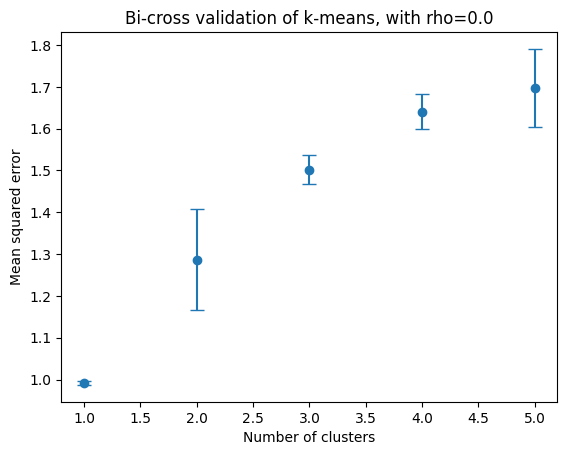

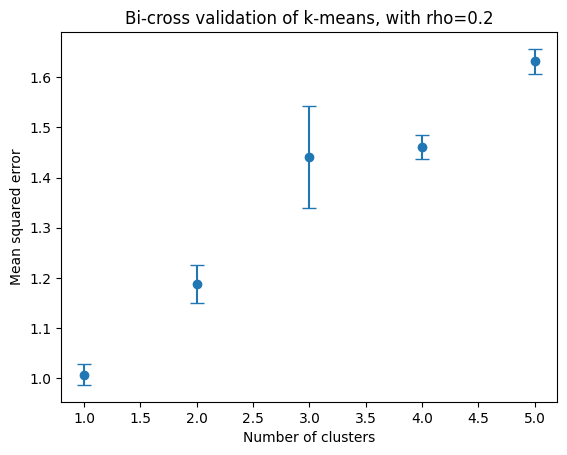

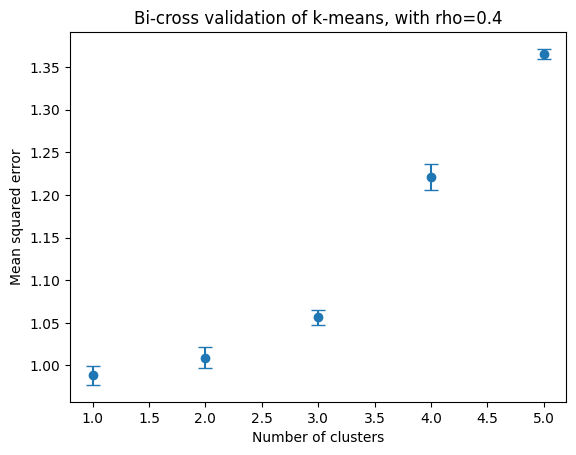

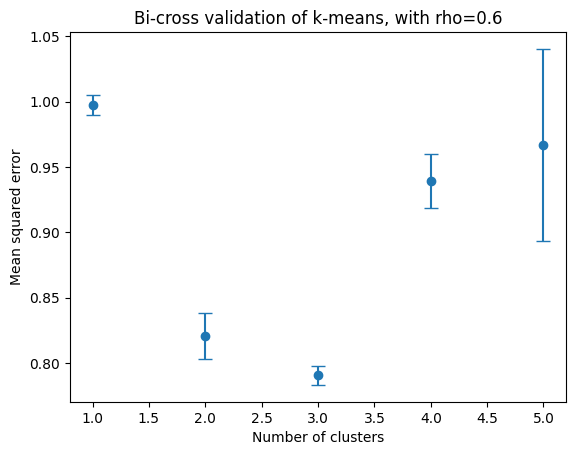

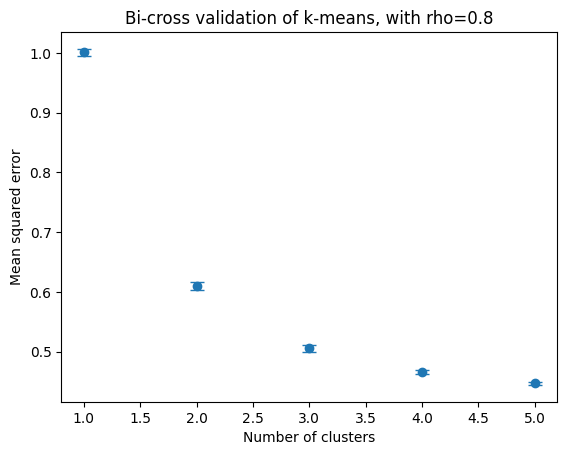

In [6]:
for rho in rhos:
    k_values = []
    mean_values = []
    std_values = []
    for k in range(1,6):
        # Load the JSON file
        values = []
        for i in range(1,3):
            for j in range(1,3):
                with open(os.path.join(save_dir,f'rho_{rho}_k_{k}/fold_{i}_{j}/Y_test/metrics.json'), 'r') as file:
                    values.append(json.load(file)['mse'])
        
        # Calculate mean and standard deviation
        mean_k = np.mean(values)
        std_k = np.std(values)

        # Store values
        k_values.append(k)
        mean_values.append(mean_k)
        std_values.append(std_k)

    # Plot mean values with error bars
    plt.errorbar(k_values, mean_values, yerr=std_values, fmt='o', capsize=5)
    plt.xlabel('Number of clusters')
    plt.ylabel('Mean squared error')
    plt.title(f'Bi-cross validation of k-means, with rho={rho}')
    plt.show()

Looks good! Now try to show what's happening on rho_0.8 (fold_1_1).

In [47]:
import numpy as np
data = np.load('results_simulation_bicv/toy_gaussian/data/one_cluster/rho_0.8.npy')
row_indices = 'results_simulation_bicv/toy_gaussian/results/var_1/rho_0.8_k_2/row_indices.npz'
column_indices = 'results_simulation_bicv/toy_gaussian/results/var_1/rho_0.8_k_2/column_indices.npz'

Step 0: Obtain the row and column indices using the files there

In [48]:
from osl_dynamics.evaluate.cross_validation import CVKmeans
cv = CVKmeans(row_indices=row_indices,column_indices=column_indices)

In [49]:
row_train,row_test,column_X,column_Y = cv.fold_indices(1,1)
print(len(row_train))
print(len(row_test))
print(column_X)
print(column_Y)

10000
10000
[1]
[0]


Step 1:Y_train

In [50]:
save_dir = './results_simulation_bicv/toy_gaussian/results/var_1/rho_0.8_k_2/fold_2_2/'
Y_train_dir = f'{save_dir}/Y_train/'
centre = np.load(f'{Y_train_dir}/centre.npy')
label = np.load(f'{Y_train_dir}/label.npy')

In [51]:
data_train = data[row_train]
print(data_train.shape)

(10000, 2)


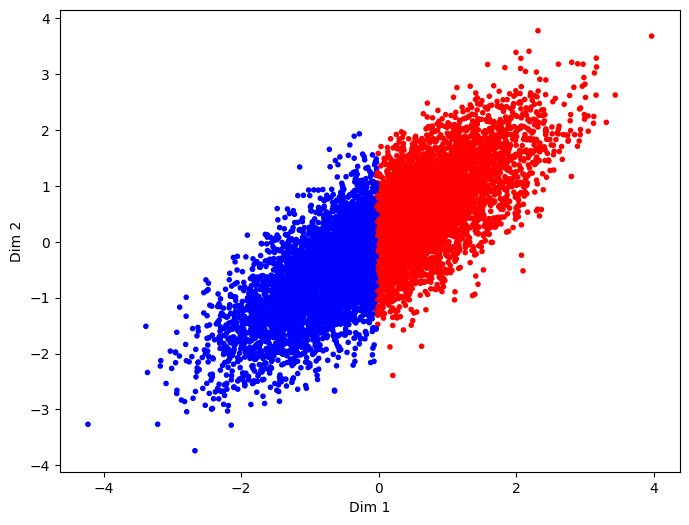

In [52]:
import matplotlib.pyplot as plt
%matplotlib inline
# Scatter plot
plt.figure(figsize=(8, 6))
plt.scatter(data_train[:, 0], data_train[:, 1], c=['red' if label[i]==0 else 'blue' for i in range(10000)], marker='.')
plt.xlabel('Dim 1')
plt.ylabel('Dim 2')

plt.show()

Step 2: X_train

In [53]:
X_train_dir = f'{save_dir}/X_train/'
X_train_centres = np.load(f'{X_train_dir}/centre.npy')


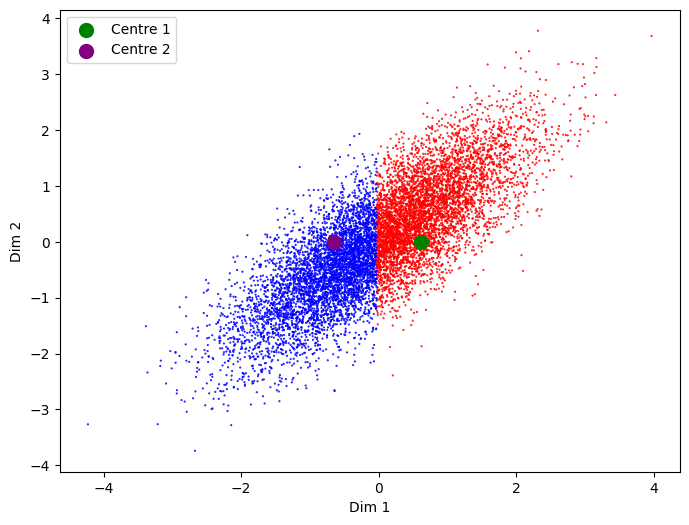

In [54]:
plt.figure(figsize=(8, 6))

# Plot the training data points
plt.scatter(data_train[:, 0], data_train[:, 1], c=['red' if label[i] == 0 else 'blue' for i in range(10000)],alpha=1.0,s=1.0, marker='.')

# Plot the additional points
plt.scatter(X_train_centres[0], 0, color='green', marker='o',s=100, label='Centre 1')
plt.scatter(X_train_centres[1], 0, color='purple', marker='o',s=100, label='Centre 2')

plt.xlabel('Dim 1')
plt.ylabel('Dim 2')
plt.legend()  # Add a legend to the plot

plt.show()

Step 3: X_test (very important)!

In [55]:
X_test_dir = f'{save_dir}/X_test/'
X_test_label = np.load(f'{X_test_dir}/label.npy')

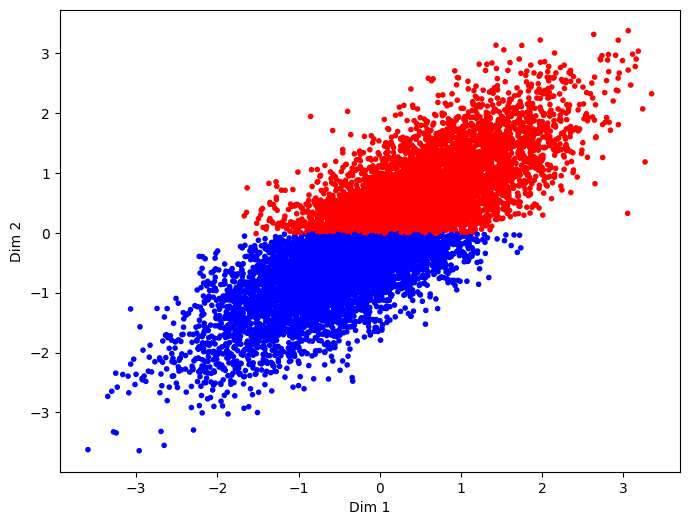

In [57]:
data_test = data[row_test]
# Scatter plot
plt.figure(figsize=(8, 6))
plt.scatter(data_test[:, 0], data_test[:, 1], c=['red' if X_test_label[i]==0 else 'blue' for i in range(10000)], marker='.')
plt.xlabel('Dim 1')
plt.ylabel('Dim 2')
# Plot the additional points
#plt.scatter(0,centre[0], color='green', marker='x',s=100, label='Centre 1')
#plt.scatter(0,centre[1], color='purple', marker='x',s=100, label='Centre 2')

plt.show()

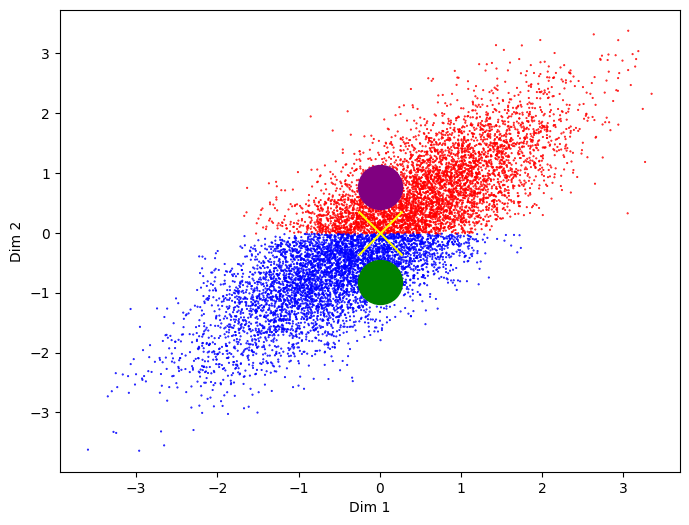

In [56]:
data_test = data[row_test]
# Scatter plot
plt.figure(figsize=(8, 6))
plt.scatter(data_test[:, 0], data_test[:, 1], c=['red' if X_test_label[i]==0 else 'blue' for i in range(10000)], alpha=1.0,s=1.0, marker='.')
plt.xlabel('Dim 1')
plt.ylabel('Dim 2')
# Plot the additional points
plt.scatter(0,centre[0], color='purple', marker='o',s=1000, label='Centre 1')
plt.scatter(0,centre[1], color='green', marker='o',s=1000, label='Centre 2')
plt.scatter(0,0,color='yellow',marker='x',s=1000)

plt.show()

In [60]:
from sklearn.cluster import KMeans

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


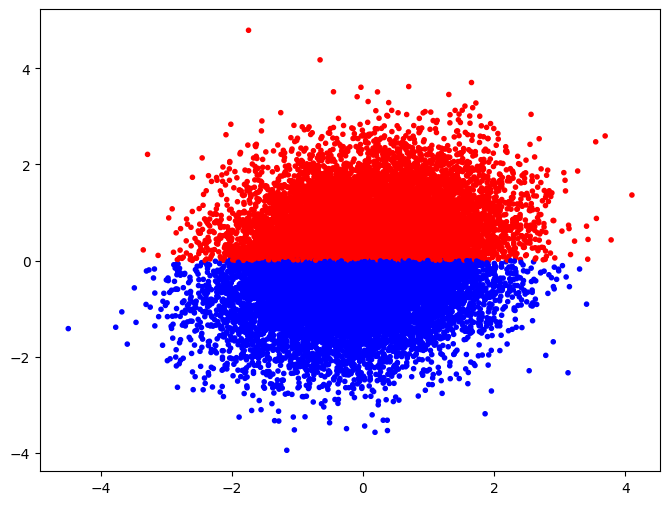

In [62]:
kmeans = KMeans(n_clusters=2)
kmeans.fit(data[:,[1]])
plt.figure(figsize=(8, 6))
plt.scatter(data[:, 0], data[:, 1], c=['red' if kmeans.labels_[i]==0 else 'blue' for i in range(20000)], marker='.')
plt.show()

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


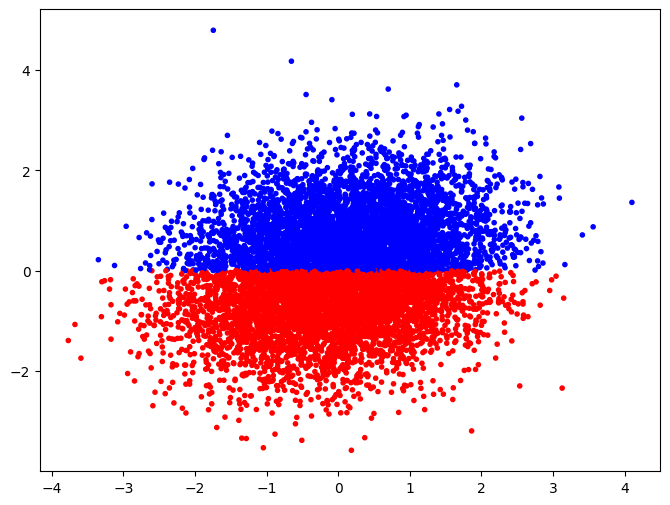

In [65]:
data_train = data[row_train][:,column_Y]
data_plot = data[row_train]
kmeans = KMeans(n_clusters=2)
kmeans.fit(data_train)
plt.figure(figsize=(8, 6))
plt.scatter(data_plot[:, 0], data_plot[:, 1], c=['red' if kmeans.labels_[i]==0 else 'blue' for i in range(10000)], marker='.')
plt.show()

## Update 12th April 2024

Try to generate sparse or very sparse matrix.

In [5]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
from osl_dynamics.array_ops import cov2stdcorr

In [11]:
covs = np.load('./data/node_timeseries/simulation_bicv/real/truth/state_covariances.npy')

True


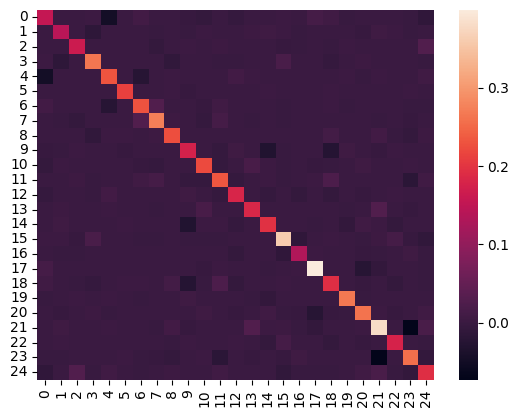

True


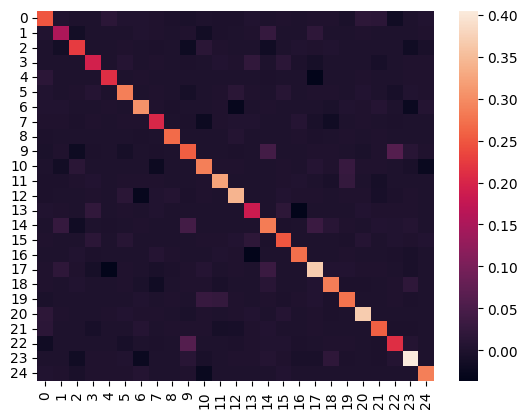

True


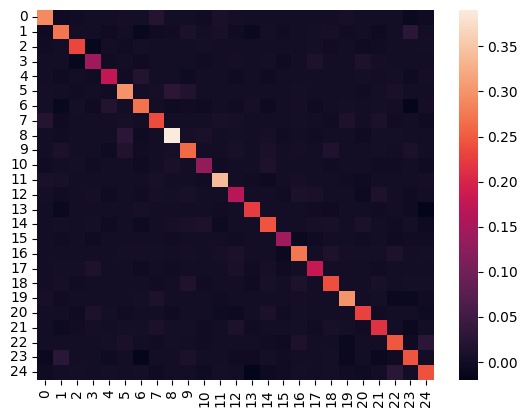

True


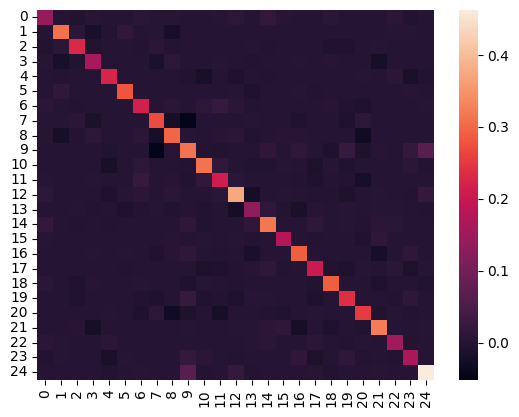

True


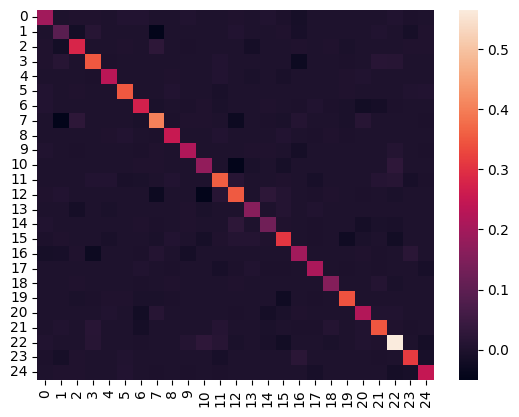

True


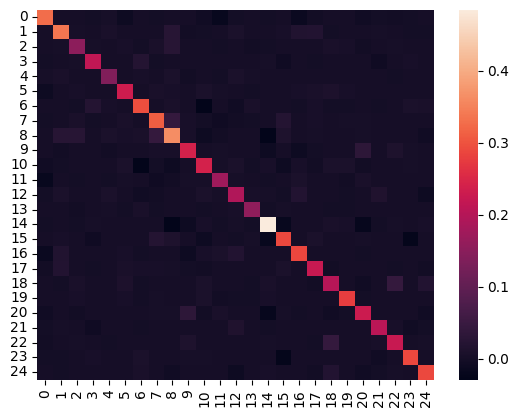

True


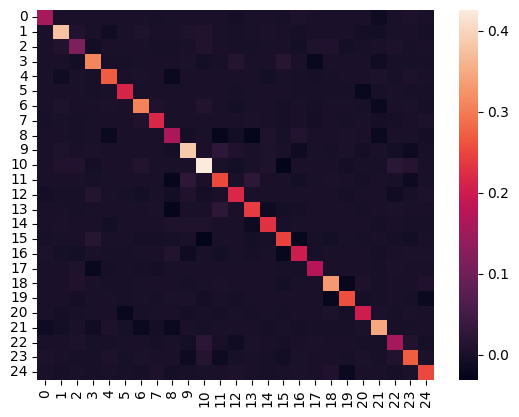

True


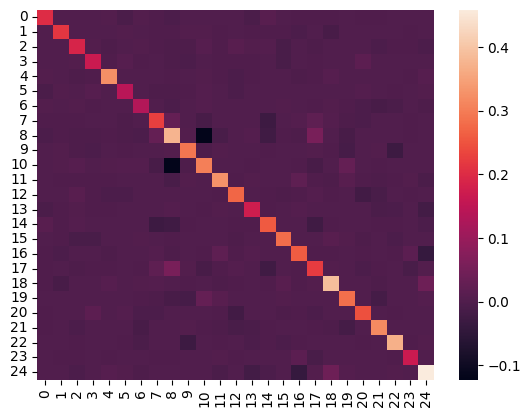

In [33]:
for i in range(8):
    print(np.all(np.linalg.eigvals(covs[i]) > 0))
    sns.heatmap(covs[i])
    plt.show()

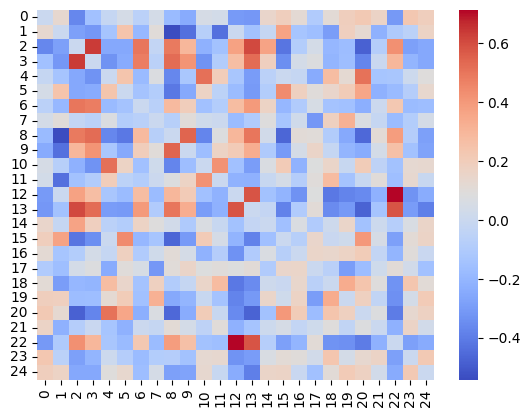

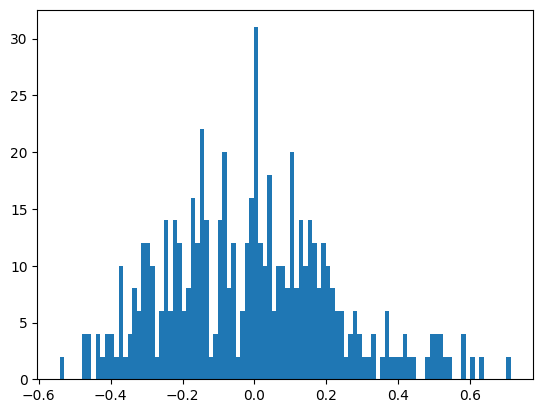

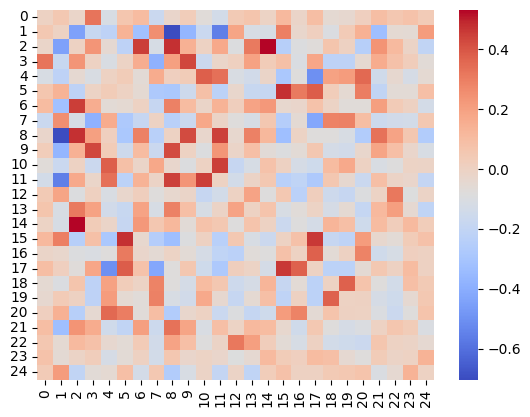

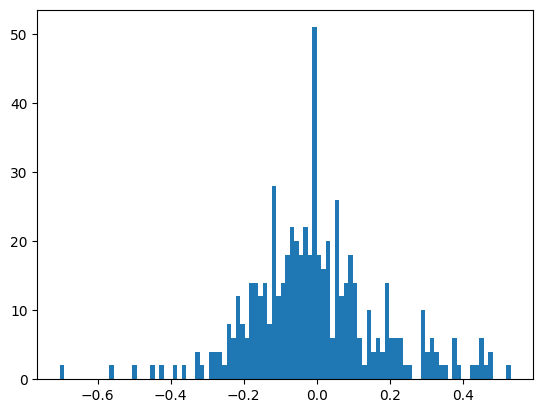

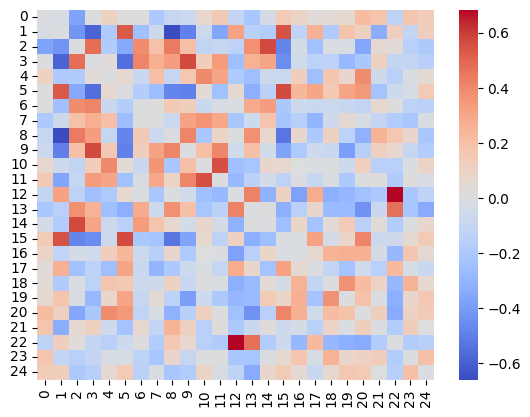

...

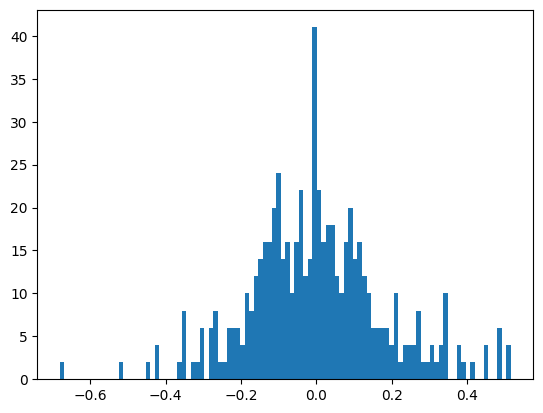

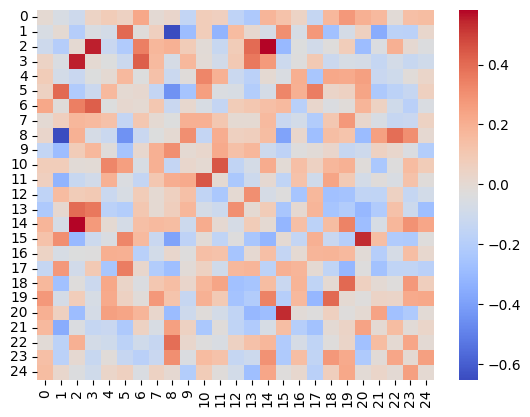

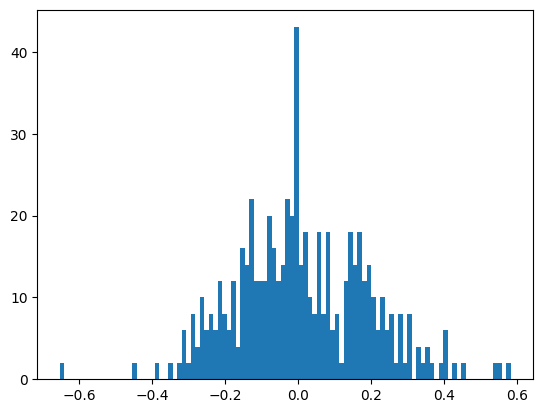

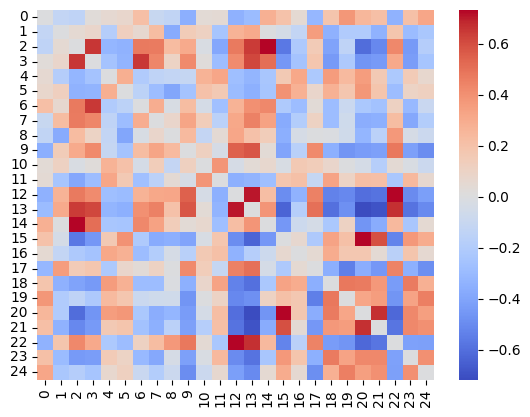

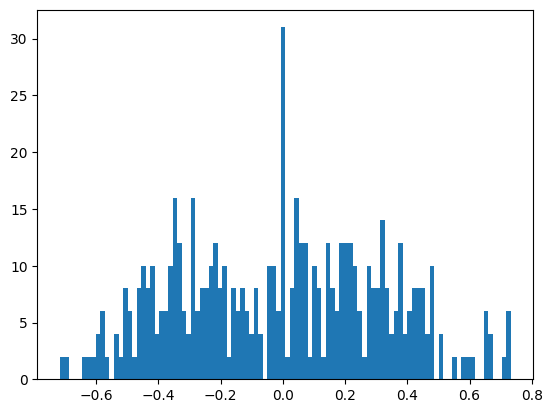

In [12]:
stds,corrs = cov2stdcorr(covs)
for i in range(8):
    sns.heatmap(corrs[i]-np.eye(25),cmap='coolwarm')
    plt.show()
    plt.hist((corrs[i]-np.eye(25)).flatten(),bins=100)
    plt.show()

In [22]:
corrs[0]

array([[ 1.00000000e+00, -5.91420983e-03, -1.20317959e-01,
         2.38493950e-01, -6.34115243e-01, -6.18077276e-02,
         3.78748545e-01, -3.29328059e-02,  5.61177833e-03,
        -2.73713654e-01, -3.45858984e-01,  1.74484331e-01,
        -3.06594234e-01,  6.13797368e-02, -9.65736355e-02,
         2.14353340e-01, -2.66605880e-02,  3.76846185e-01,
         3.58674829e-01, -1.91322837e-01, -1.31434693e-01,
         1.33683639e-01, -7.27849897e-02, -1.93007970e-01,
        -4.19289811e-01],
       [-5.91420983e-03,  1.00000000e+00,  1.78928892e-01,
        -4.13994666e-01,  1.02180096e-01,  2.59239000e-03,
         3.98628424e-02, -2.18802666e-01,  1.28290115e-01,
        -1.87020931e-01,  2.14962257e-01,  1.33228232e-01,
         1.41273985e-01,  2.87866342e-01,  3.17350862e-01,
         2.13844719e-01, -1.90983152e-01,  1.64204087e-02,
         1.50186131e-01,  1.20579182e-01, -2.39388042e-01,
         2.85316934e-01,  1.99509041e-01, -1.81861093e-01,
        -1.17467595e-01],
    

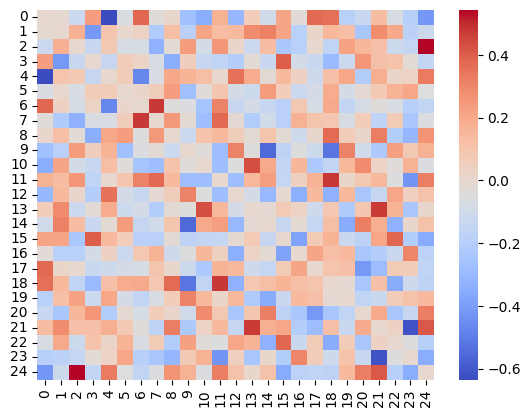

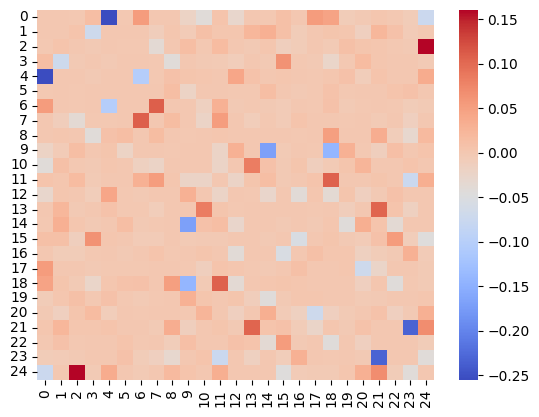

True


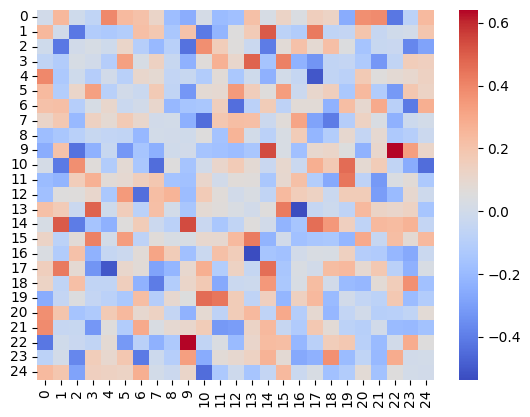

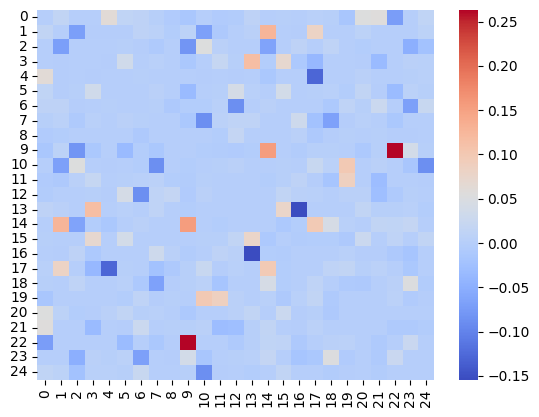

True


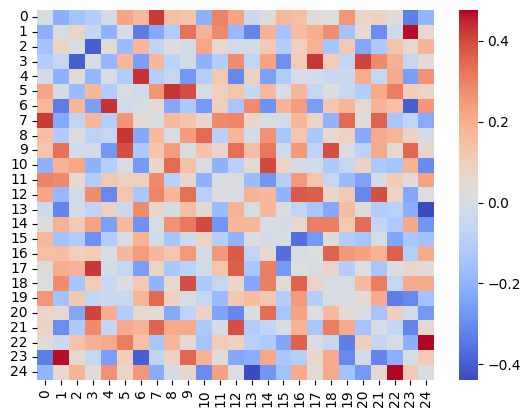

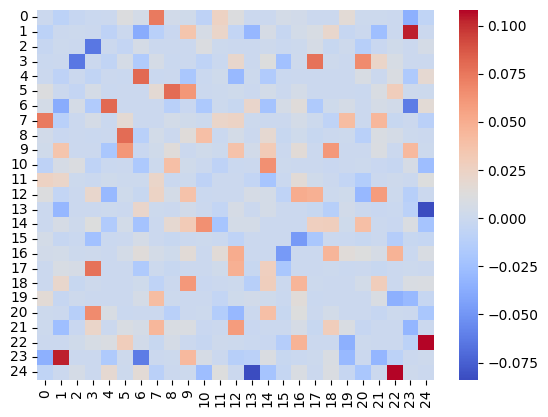

True


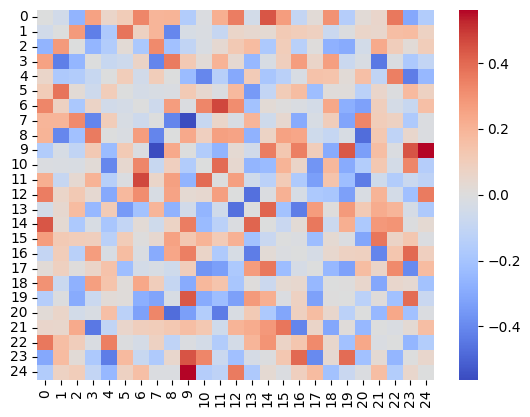

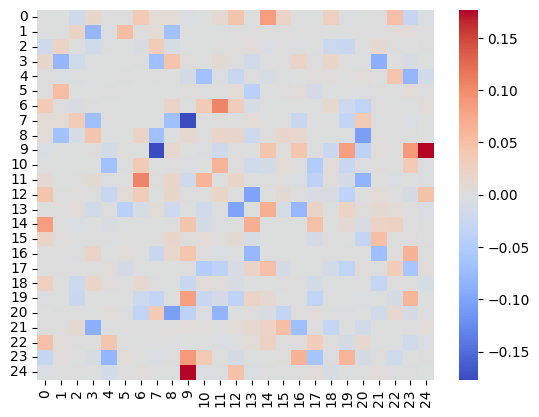

True


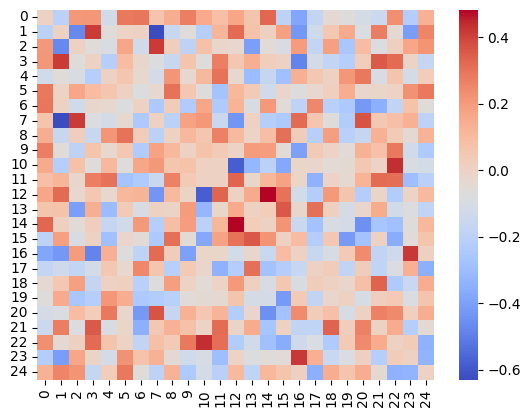

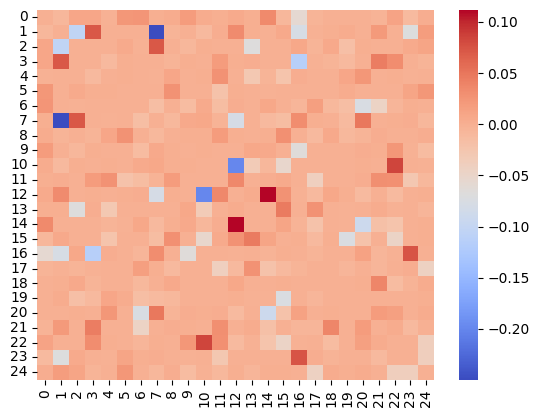

True


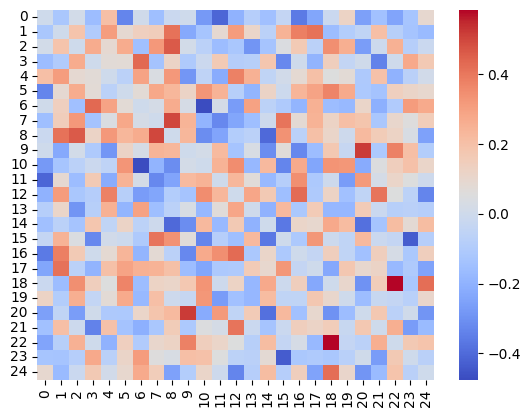

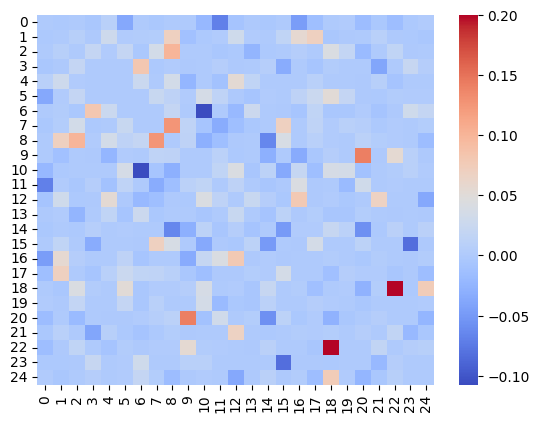

True


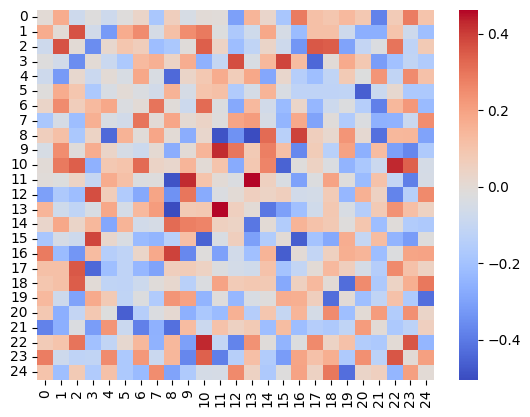

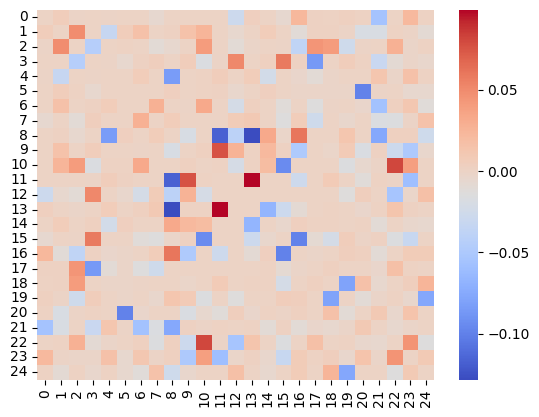

True


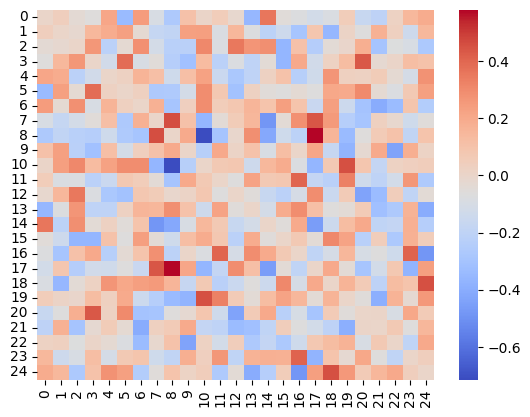

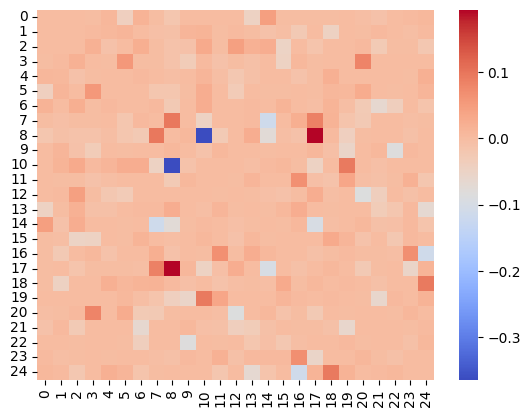

True


In [29]:
for i in range(8):
    sns.heatmap(corrs[i]-np.eye(25),cmap='coolwarm')
    plt.show()
    sns.heatmap(corrs[i]**3-np.eye(25),cmap='coolwarm')
    plt.show()
    print(np.all(np.linalg.eigvals(corrs[i]**5) > 0))

In [17]:
L0 = np.linalg.cholesky(cor[0])
#print(np.max(L0@L0.T-corrs[0]))

3.3306690738754696e-16


<Axes: >

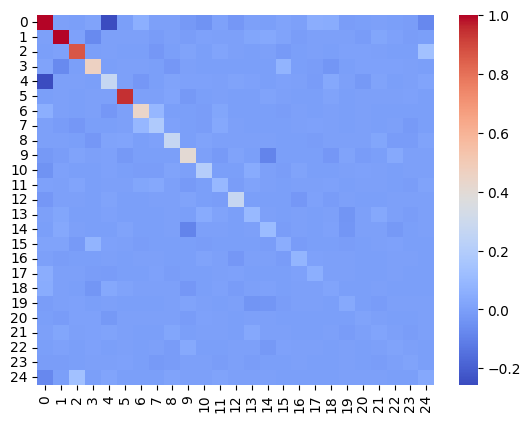

In [20]:
sns.heatmap((L0**3)@(L0**3).T,cmap='coolwarm')

# Update 29th April 2024

We check the results of sparse connectivity case. Our method does not perform very well when the connectivity is sparse. But to what extent is our connectivity sparse?

In [46]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
from osl_dynamics.array_ops import cov2stdcorr

In [71]:
cov = np.load('./data/node_timeseries/simulation_bicv/sparse/truth/state_covariances.npy')

In [72]:
_, cor = cov2stdcorr(cov)

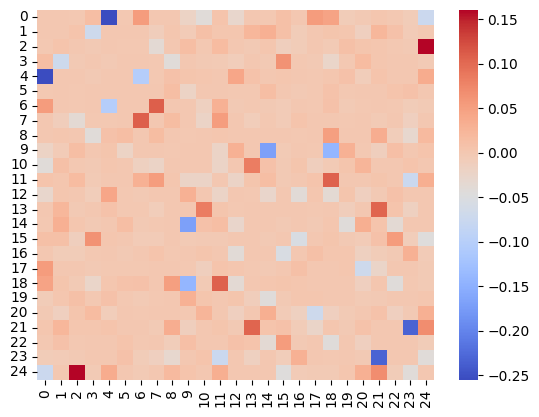

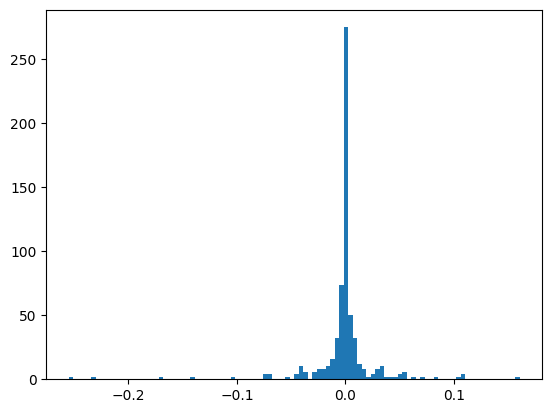

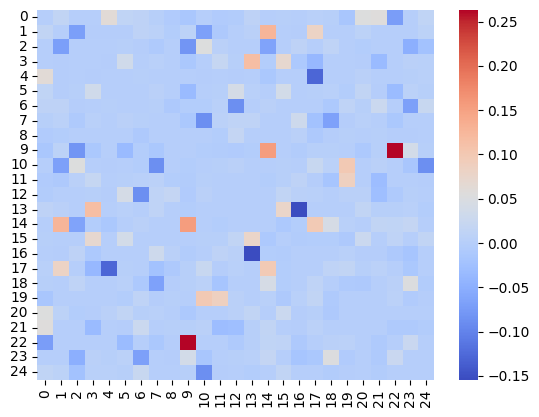

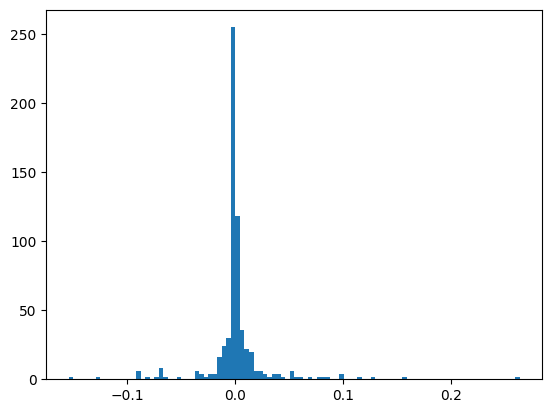

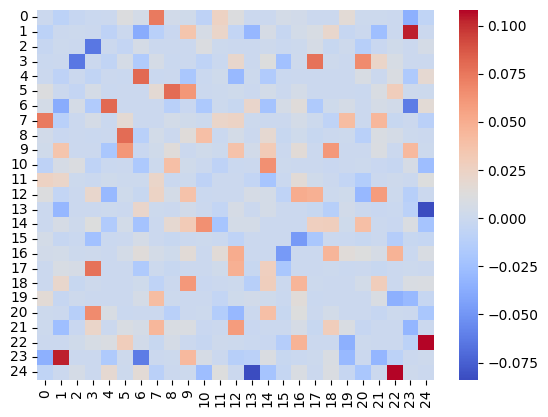

...

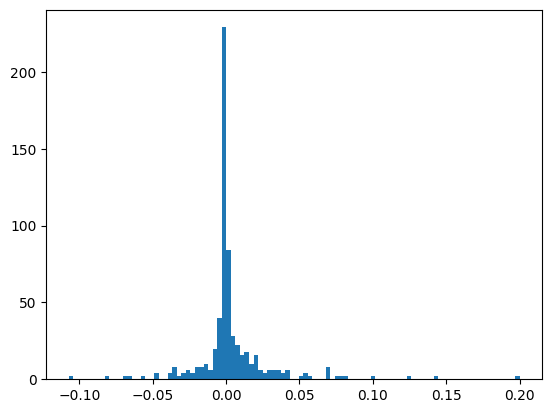

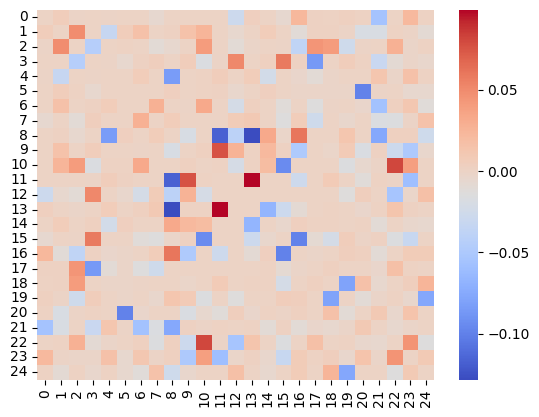

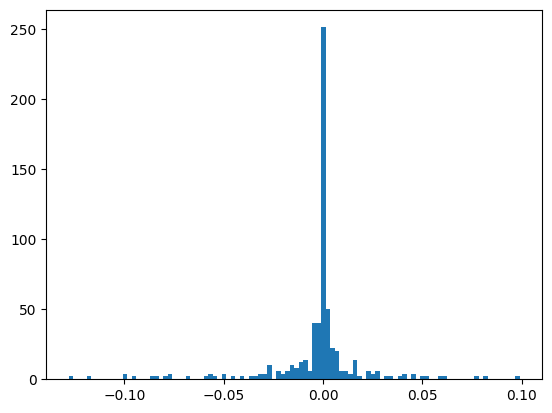

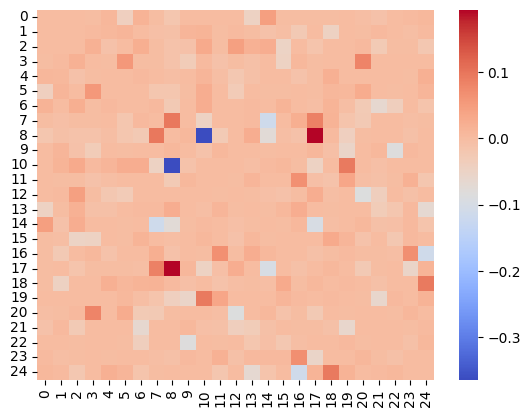

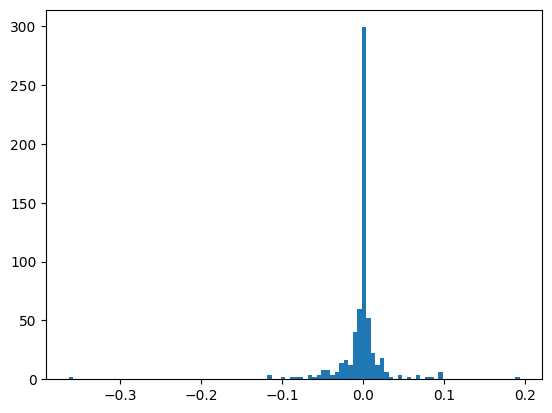

In [73]:
for i in range(8):
    sns.heatmap(cor[i]-np.eye(25),cmap='coolwarm')
    plt.show()
    plt.hist((cor[i]-np.eye(25)).flatten(),bins=100)
    plt.show()

Look at the ground truth. Is that vary sparse?

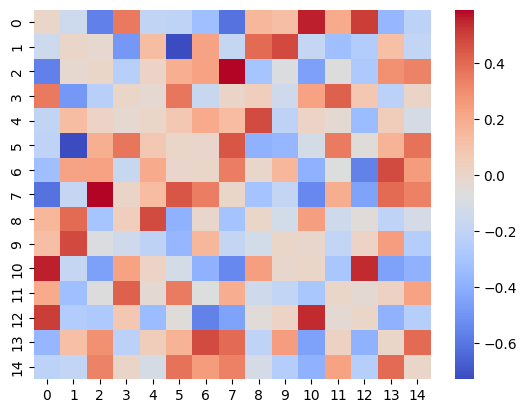

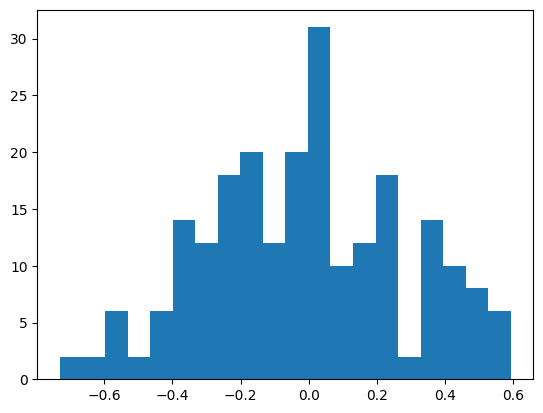

In [70]:
n_channels = 15
data = np.loadtxt(f'data/node_timeseries/3T_HCP1200_MSMAll_d{n_channels}_ts2/100307.txt')
FC = np.corrcoef(data[:1200,:].T) - np.eye(n_channels)
sns.heatmap(FC,cmap='coolwarm')
plt.show()
plt.hist(FC.flatten(),bins=20)
plt.show()

## Update 30th April 2024

Delete some of the pickle files

In [55]:
import os
import shutil

In [49]:
base_dir = './results_simulation_bicv_202404/'
var_s = ['var_2','var_4']
folds = ['fold_2_2','fold_5_2','fold_5_5']
datasets = ['3_block','diagonal','diagonal_special','random','real']
N_states = list(range(2,35))
cvs = list(range(1,21))
fold_specific = [f'fold_{i}_{j}' for i in range(1, 6) for j in range(1, 6)]

In [50]:
for var in var_s:
    for fold in folds:
        for dataset in datasets:
            for N_state in N_states:
                for cv in cvs:
                    for fold_s in fold_specific:
                        file_dir = f'{base_dir}/{var}/{fold}/{dataset}/hmm_ICA_25_state_{N_state}/cv_{cv}/{fold_s}/Y_train/inf_params/alp.pkl'
                        if os.path.isfile(file_dir):
                            os.remove(file_dir)

In [62]:
base_dir = './results_HCP_bicv_202404/'
var_s = ['var_2','var_4']
N_channels = ['15','25','50','100']
datasets = [f'ICA_{N_channel}' for N_channel in N_channels]
N_states = list(range(2,35))
cvs = list(range(1,21))
fold_specific = [f'fold_{i}_{j}' for i in range(1, 6) for j in range(1, 6)]

In [63]:
for var in var_s:
    for dataset in datasets:
        for N_state in N_states:
            for cv in cvs:
                for fold_s in fold_specific:
                    for N_channel in N_channels:
                        file_dir = f'{base_dir}/{var}/{dataset}/hmm_ICA_{N_channel}_state_{N_state}/cv_{cv}/{fold_s}/Y_train/inf_params/alp.pkl'
                        if os.path.isfile(file_dir):
                            os.remove(file_dir)

## Update 4th May 2024

First of all, let's check the sparse case of the simulation.

In [62]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
from osl_dynamics.inference.metrics import twopair_riemannian_distance

In [63]:
cov = np.load('./data/node_timeseries/simulation_bicv/sparse/truth/state_covariances.npy')

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 111.58it/s]


<Axes: >

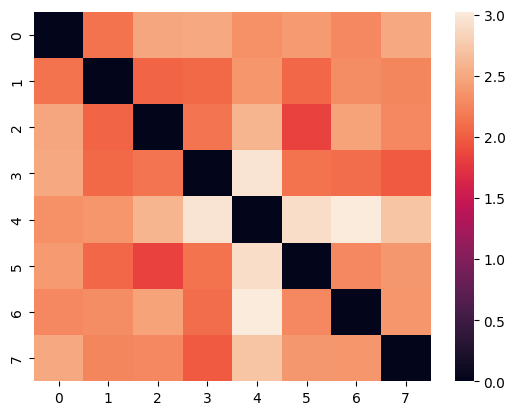

In [64]:
sns.heatmap(twopair_riemannian_distance(cov,cov))

In [65]:
from osl_dynamics.array_ops import cov2stdcorr

In [66]:
std, cor = cov2stdcorr(cov)

In [67]:
from osl_dynamics.inference.metrics import twopair_fisher_z_correlations

Compute twopair Fisher-z transformated correlation: 100%|█| 8/8 [00:00<00:00, 80


<Axes: >

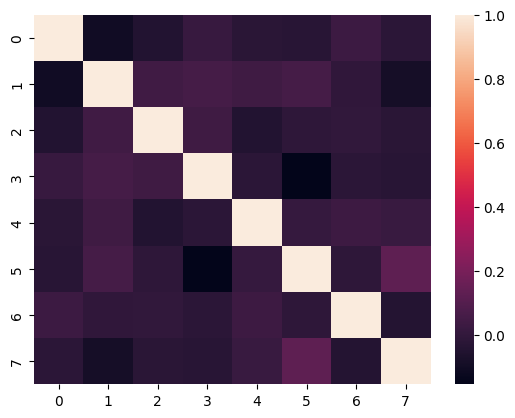

In [68]:
sns.heatmap(twopair_fisher_z_correlations(cor,cor))

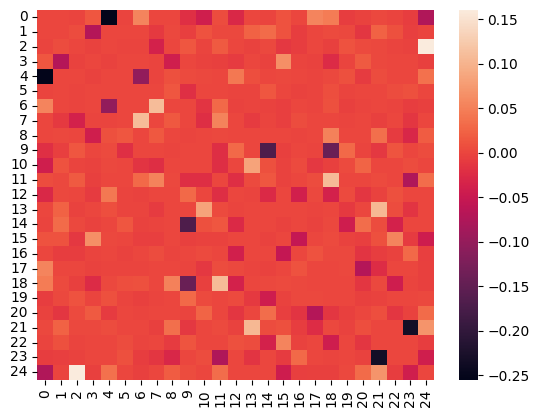

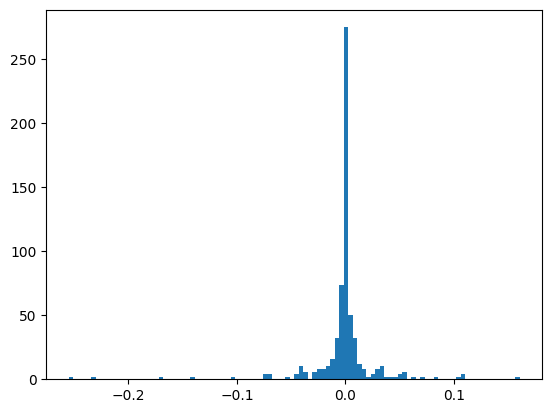

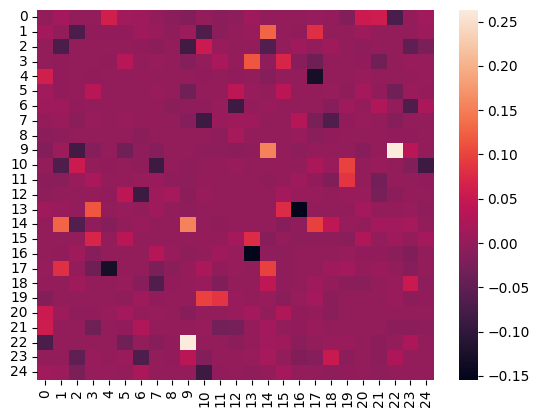

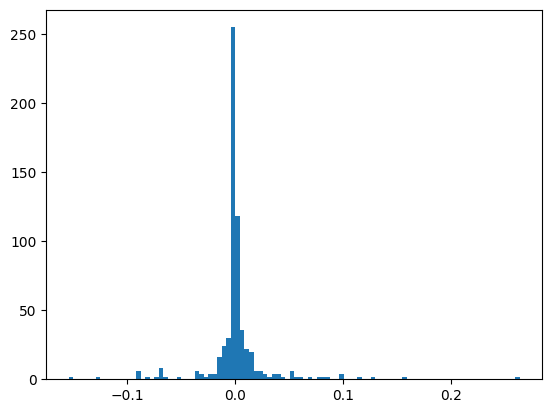

In [69]:
sns.heatmap(cor[0]-np.eye(25))
plt.show()
plt.hist((cor[0]-np.eye(25)).flatten(),bins=100)
plt.show()
sns.heatmap(cor[1]-np.eye(25))
plt.show()
plt.hist((cor[1]-np.eye(25)).flatten(),bins=100)
plt.show()

It seems that the distance between states are reasonable. Not very different from the "real". And also look at the fisher-z transformed correlation of correlation matrices. The states look very different!

But can we recover the states?

Let's look at the cv_1, and first fold.

In [70]:
save_dir = './results_simulation_bicv_202404/var_1/fold_2_2/sparse_check/hmm_ICA_25_state_8/train/'

In [71]:
cov_fit = np.load(f'{save_dir}/inf_params/covs.npy')

In [72]:
from osl_dynamics.inference.modes import hungarian_pair

In [73]:
indices,riem_reorder = hungarian_pair(twopair_riemannian_distance(cov,cov_fit),distance=True)

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 771.24it/s]


In [74]:
from osl_dynamics.utils.plotting import plot_mode_pairing

(<Figure size 800x600 with 2 Axes>, <Axes: >)

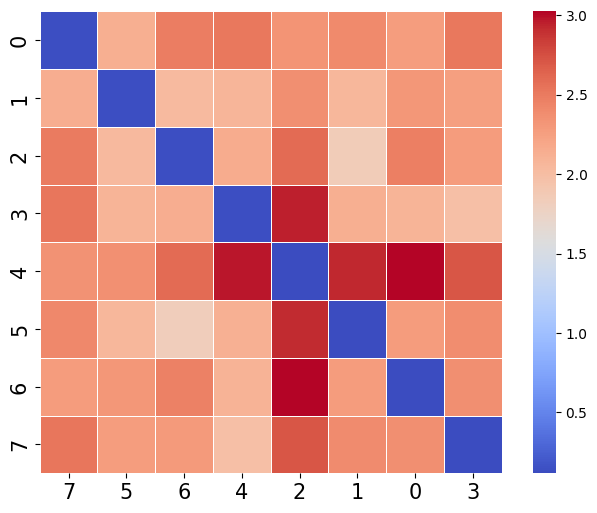

In [75]:
plot_mode_pairing(riem_reorder,indices)

In [76]:
print(riem_reorder)

[[0.13621852 2.12966513 2.48543411 2.52171442 2.33391556 2.40543822
  2.26804897 2.52038648]
 [2.14463931 0.13077673 2.02677249 2.07617952 2.36985728 2.06381431
  2.31240127 2.26006349]
 [2.49469347 2.04153545 0.1318619  2.16002135 2.59575456 1.84640708
  2.46906923 2.27480366]
 [2.52628569 2.09240833 2.1488066  0.13316177 2.95392556 2.1379641
  2.08921195 1.98878474]
 [2.34949257 2.36016631 2.5936502  2.96942409 0.11756248 2.92223622
  3.01794114 2.71030115]
 [2.41341414 2.06847991 1.83115754 2.12668027 2.91282948 0.12379708
  2.285059   2.38160129]
 [2.28144582 2.31751652 2.46503986 2.09498131 3.02368629 2.28050626
  0.12240953 2.37596032]
 [2.52965769 2.27287254 2.28757072 1.99034275 2.71704399 2.39007364
  2.37138791 0.12276943]]


In [77]:
state_truth = np.load('./data/node_timeseries/simulation_bicv/sparse/truth/10001_state_time_course.npy')

In [78]:
import pickle

In [79]:
with open(f'{save_dir}/inf_params/alp.pkl', "rb") as f:
    state_fit = pickle.load(f)[0]

In [80]:
print(state_truth.shape)

(1200, 8)


In [81]:
state_truth_label = np.argmax(state_truth,axis=1)
state_fit_label = np.argmax(state_fit,axis=1)

In [83]:
state_truth_label[100:200]

array([1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 5, 5, 5, 5, 5,
       5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 6, 3, 3, 3, 3, 3, 2, 2, 2, 2,
       6, 7, 6, 6, 6, 6, 6, 6, 7, 4, 4, 4, 3, 3, 3, 3, 3, 3, 3, 3, 5, 5,
       5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 1, 1, 1, 1, 5, 5, 5, 5, 7, 3, 3, 3,
       3, 3, 4, 4, 4, 4, 2, 2, 2, 2, 2, 2])

In [84]:
state_fit_label[100:200]

array([5, 5, 5, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 7, 5, 5, 4, 4, 4, 6, 6, 6, 6,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 4, 4, 4, 4, 5, 4, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 4, 4, 4, 4, 4, 1, 1, 1, 1, 1, 1, 1,
       5, 5, 5, 5, 5, 5, 6, 6, 6, 6, 6, 6])

It seems that we can recover the underlying ground truth when working on full model training. But what about the bi-cross validation?

In [97]:
import json

In [98]:
save_dir_cv = './results_simulation_bicv_202404/var_1/fold_2_2/sparse/hmm_ICA_25_state_8/cv_1/fold_1_1/'

In [99]:
with open(f'{save_dir_cv}/fold_indices.json', "r") as f:
    fold_indices = json.load(f)

In [100]:
print(fold_indices)

{'row_train': [0, 1, 3, 4, 5, 6, 10, 11, 12, 14, 16, 22, 25, 26, 27, 28, 31, 34, 41, 43, 45, 50, 51, 53, 54, 60, 61, 62, 63, 64, 65, 67, 74, 75, 76, 79, 80, 81, 82, 84, 86, 87, 89, 92, 93, 95, 96, 97, 99, 101, 102, 103, 104, 109, 112, 115, 119, 120, 121, 123, 124, 125, 127, 130, 131, 133, 134, 135, 136, 137, 139, 140, 141, 144, 145, 146, 148, 151, 155, 156, 159, 160, 161, 162, 163, 164, 165, 167, 172, 174, 176, 178, 181, 182, 183, 186, 188, 191, 196, 197, 198, 199, 204, 205, 206, 209, 211, 213, 215, 219, 222, 225, 227, 228, 229, 231, 237, 238, 239, 241, 242, 246, 247, 249, 250, 252, 254, 255, 257, 259, 260, 261, 263, 264, 267, 268, 269, 272, 273, 274, 275, 285, 291, 292, 298, 299, 300, 301, 302, 303, 304, 305, 306, 310, 314, 317, 320, 321, 323, 326, 328, 329, 331, 332, 333, 334, 337, 338, 341, 345, 347, 349, 354, 355, 356, 357, 359, 363, 364, 365, 366, 368, 369, 371, 372, 374, 375, 376, 377, 380, 381, 384, 386, 388, 389, 390, 392, 393, 398, 401, 402, 405, 408, 409, 410, 413, 414, 415, 

In [101]:
cov_Y_train = np.load(f'{save_dir_cv}/Y_train/inf_params/covs.npy')

In [102]:
print(cov_Y_train.shape)

(8, 13, 13)


In [103]:
i_Y_train, r_Y_train = hungarian_pair(twopair_riemannian_distance(cov[:,:,fold_indices['column_Y']][:,fold_indices['column_Y'],:],cov_Y_train),distance=True)

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 838.42it/s]


[[0.17434264 1.35516151 1.31939967 1.54509764 1.64500194 1.12355297
  1.07955591 1.84603135]
 [1.36807868 0.12547696 0.8923874  1.37379237 1.6996182  1.13511662
  1.28607307 1.60571435]
 [1.26403478 0.93504592 0.1890072  1.23930668 1.57001492 1.05524541
  1.34610259 1.32864131]
 [1.53872291 1.38241813 1.26101788 0.1468825  2.10475196 1.17046371
  1.50964289 1.29469098]
 [1.65524287 1.69412008 1.56665369 2.06861305 0.09169809 1.5571124
  1.97937034 1.91750459]
 [1.15741754 1.1752335  1.13928777 1.18254769 1.60824653 0.17971559
  1.14359029 1.64740656]
 [1.03220619 1.30833486 1.33739881 1.53224833 1.98949822 1.1248287
  0.14042322 1.78304678]
 [1.77926383 1.55621277 1.25966264 1.23267446 1.87291363 1.56684154
  1.75625234 0.09870642]]


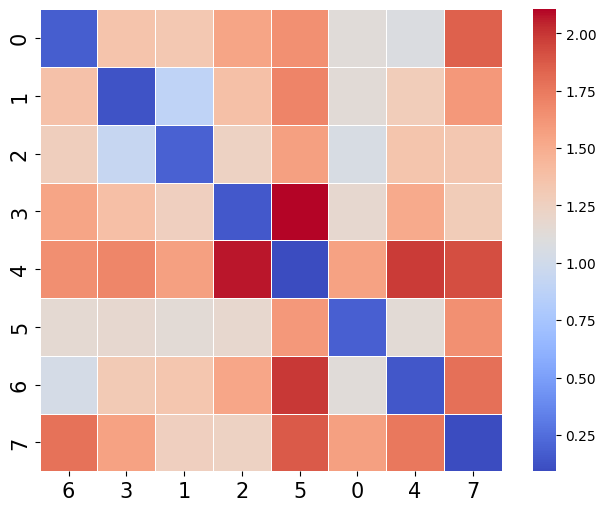

In [104]:
plot_mode_pairing(r_Y_train,i_Y_train)
print(r_Y_train)

In [105]:
cov_X_train = np.load(f'{save_dir_cv}/X_train/dual_estimates/covs.npy')

In [106]:
i_X_train, r_X_train = hungarian_pair(twopair_riemannian_distance(cov[:,:,fold_indices['column_X']][:,fold_indices['column_X'],:],cov_X_train),distance=True)

Computing Riemannian distances: 100%|███████████| 8/8 [00:00<00:00, 1140.49it/s]


[[0.84275322 1.31039838 1.41186363 1.50950871 1.15459394 1.46577428
  1.41293287 1.41473709]
 [0.9256877  0.5240636  0.91636527 0.98038226 0.91826171 0.98715106
  1.15239648 1.08201783]
 [1.43583317 1.34377819 0.93468422 1.33815514 1.46471416 1.16896888
  1.49544974 1.4535217 ]
 [1.11545799 0.94590384 0.95260016 0.51200402 1.26551907 0.98736466
  0.8193855  0.96106886]
 [1.39619628 1.43564645 1.48282009 1.65446734 0.71117608 1.73059543
  1.7132732  1.58686358]
 [1.30985669 1.1789755  1.02784219 1.18965844 1.65571313 0.73595662
  1.30523538 1.3002235 ]
 [1.26094804 1.35595372 1.34181372 1.10190797 1.57871055 1.3063459
  0.69190004 1.21430936]
 [1.05779879 1.09959162 1.10743922 1.00250774 1.25872449 1.12182769
  1.02429446 0.4849145 ]]


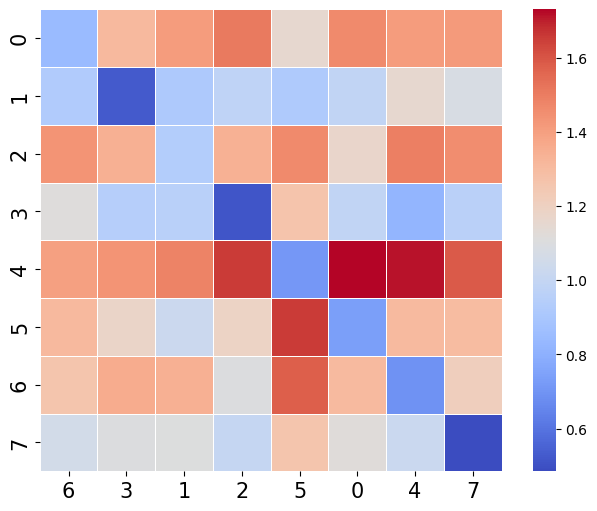

In [107]:
plot_mode_pairing(r_X_train,i_X_train)
print(r_X_train)

In [109]:
with open(f'{save_dir_cv}/X_train/inf_params/alp.pkl','rb') as file:
    alpha_X = pickle.load(file)

In [111]:
state_truth_label[:100]

array([0, 6, 6, 6, 6, 6, 6, 6, 1, 6, 6, 6, 6, 6, 6, 7, 7, 7, 7, 7, 7, 7,
       7, 7, 5, 5, 5, 5, 3, 3, 3, 3, 1, 1, 1, 7, 7, 5, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 5, 5, 5, 5, 5, 0, 0, 0, 0, 0, 6, 6, 6, 6, 6, 6, 6, 5,
       5, 5, 5, 5, 6, 6, 6, 6, 6, 6, 6, 6, 4, 4, 4, 4, 4, 4, 0, 0, 0, 0,
       0, 7, 5, 7, 7, 7, 4, 4, 4, 7, 7, 1])

In [112]:
alpha_X[0][:100]

array([4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 7, 7, 7, 7, 7, 7, 7,
       7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 3, 3, 3, 3, 3, 3, 3, 1,
       1, 1, 6, 6, 0, 0, 0, 0, 0, 0, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 6, 5, 6, 6, 6, 6, 6, 6, 6, 6,
       6, 6, 2, 2, 2, 2, 5, 5, 5, 1, 3, 3])

Then think about X_test. The information you've passed from Y_train to Y_test depends on the model fitting on Y_train ,which is quite accurate. So you only need to check the time series.

In [113]:
with open(f'{save_dir_cv}/Y_test/inf_params/alp.pkl','rb') as file:
    alpha_Y = pickle.load(file)

In [114]:
state_truth_2 = np.load('./data/node_timeseries/simulation_bicv/sparse/truth/10003_state_time_course.npy')

In [118]:
state_truth_label_2 = np.argmax(state_truth_2,axis=1)

In [117]:
state_fit_label_2 = np.argmax(alpha_Y[0],axis=1)

In [120]:
state_truth_label_2[:100]

array([4, 4, 5, 5, 2, 2, 2, 2, 5, 6, 6, 6, 6, 6, 6, 6, 6, 4, 4, 4, 4, 4,
       4, 4, 4, 4, 1, 1, 1, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 5, 5, 5, 5, 5, 5, 5, 2, 2, 4, 4, 4,
       4, 5, 5, 5, 5, 4, 4, 4, 4, 2, 6, 1, 1, 1, 1, 4, 4, 4, 1, 1, 1, 1,
       6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6])

In [121]:
state_fit_label_2[:100]

array([4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 5, 5, 5, 5, 5,
       5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 6, 6, 6, 6, 6, 2, 2, 2, 2,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4])

## Update 6th May 2024

Task: plot the free energy on training data.

In [5]:
from osl_dynamics.config_api.batch import BatchAnalysis

In [26]:
config_path = './results_HCP_bicv_202404/var_1/ICA_200_check/'

In [27]:
ba = BatchAnalysis(config_path)

In [28]:
ba.plot_training_loss(['free_energy','log_likelihood','entropy','prior','evidence'])

2024-05-06 17:35:09 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/hmm_free_energy.jpg
2024-05-06 17:35:10 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/hmm_log_likelihood.jpg
2024-05-06 17:35:11 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/hmm_entropy.jpg
2024-05-06 17:35:12 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/hmm_prior.jpg
2024-05-06 17:35:13 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/hmm_evidence.jpg


In [29]:
ba.plot_split_half_reproducibility()

Computing Riemannian distances: 100%|████████████| 2/2 [00:00<00:00, 122.86it/s]
2024-05-06 17:35:13 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/rep/state_2_split_1.jpg
Computing Riemannian distances: 100%|█████████████| 2/2 [00:00<00:00, 80.50it/s]
2024-05-06 17:35:13 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/rep/state_2_split_2.jpg
Computing Riemannian distances: 100%|█████████████| 2/2 [00:00<00:00, 80.10it/s]
2024-05-06 17:35:14 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/rep/state_2_split_3.jpg
Computing Riemannian distances: 100%|█████████████| 2/2 [00:00<00:00, 84.52it/s]
2024-05-06 17:35:14 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/rep/state_2_split_4.jpg
Computing Riemannian distances: 100%|█████████████| 2/2 [00:00<00:00, 79.60it/s]
202

Computing Riemannian distances: 100%|█████████████| 9/9 [00:00<00:00, 19.94it/s]
2024-05-06 17:35:30 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/rep/state_9_split_2.jpg
Computing Riemannian distances: 100%|█████████████| 9/9 [00:00<00:00, 20.66it/s]
2024-05-06 17:35:31 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/rep/state_9_split_3.jpg
Computing Riemannian distances: 100%|█████████████| 9/9 [00:00<00:00, 20.69it/s]
2024-05-06 17:35:32 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/rep/state_9_split_4.jpg
Computing Riemannian distances: 100%|█████████████| 9/9 [00:00<00:00, 20.71it/s]
2024-05-06 17:35:32 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/rep/state_9_split_5.jpg
Computing Riemannian distances: 100%|███████████| 10/10 [00:00<00:00, 18.00it/s]
202

Computing Riemannian distances: 100%|███████████| 16/16 [00:00<00:00, 16.46it/s]
2024-05-06 17:36:15 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/rep/state_16_split_3.jpg
Computing Riemannian distances: 100%|███████████| 16/16 [00:01<00:00, 11.71it/s]
2024-05-06 17:36:17 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/rep/state_16_split_4.jpg
Computing Riemannian distances: 100%|███████████| 16/16 [00:01<00:00, 11.76it/s]
2024-05-06 17:36:18 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/rep/state_16_split_5.jpg
Computing Riemannian distances: 100%|███████████| 17/17 [00:01<00:00, 11.64it/s]
2024-05-06 17:36:20 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/rep/state_17_split_1.jpg
Computing Riemannian distances: 100%|███████████| 17/17 [00:01<00:00, 11.99it/s]

Computing Riemannian distances: 100%|███████████| 23/23 [00:02<00:00,  7.72it/s]
2024-05-06 17:37:53 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/rep/state_23_split_4.jpg
Computing Riemannian distances: 100%|███████████| 23/23 [00:03<00:00,  7.51it/s]
2024-05-06 17:37:57 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/rep/state_23_split_5.jpg
Computing Riemannian distances: 100%|███████████| 24/24 [00:03<00:00,  7.42it/s]
2024-05-06 17:38:00 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/rep/state_24_split_1.jpg
Computing Riemannian distances: 100%|███████████| 24/24 [00:03<00:00,  7.16it/s]
2024-05-06 17:38:04 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/rep/state_24_split_2.jpg
Computing Riemannian distances: 100%|███████████| 24/24 [00:03<00:00,  6.80it/s]

Computing Riemannian distances: 100%|███████████| 30/30 [00:03<00:00,  7.82it/s]
2024-05-06 17:40:19 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/rep/state_30_split_5.jpg
Computing Riemannian distances: 100%|███████████| 31/31 [00:05<00:00,  5.41it/s]
2024-05-06 17:40:25 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/rep/state_31_split_1.jpg
Computing Riemannian distances: 100%|███████████| 31/31 [00:06<00:00,  4.47it/s]
2024-05-06 17:40:32 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/rep/state_31_split_2.jpg
Computing Riemannian distances: 100%|███████████| 31/31 [00:05<00:00,  5.98it/s]
2024-05-06 17:40:38 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/rep/state_31_split_3.jpg
Computing Riemannian distances: 100%|███████████| 31/31 [00:05<00:00,  6.01it/s]

In [30]:
ba.plot_fo()

2024-05-06 17:40:51 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/fo/state_2.jpg
2024-05-06 17:40:51 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/fo/state_3.jpg
2024-05-06 17:40:51 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/fo/state_4.jpg
2024-05-06 17:40:52 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/fo/state_5.jpg
2024-05-06 17:40:52 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/fo/state_6.jpg
2024-05-06 17:40:52 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/fo/state_7.jpg
2024-05-06 17:40:53 INFO osl-dynamics [plotting.py:103:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_200_check/analysis/fo/state_8.jpg
2024-05-06 17:40:53 INFO os

## Update 9th May 2024

Check why many bi-cross validations in ICA_50_mean failed!

In [129]:
import numpy as np
import pickle
import json
from osl_dynamics.evaluate.cross_validation import CVHMM
from osl_dynamics.config_api.pipeline import run_pipeline_from_file

In [130]:
save_dir = './results_HCP_bicv_202404/var_1/ICA_200_mean/hmm_ICA_200_state_2/cv_1/fold_1_1/'

In [131]:
run_pipeline_from_file(f'{save_dir}/X_train/prepared_config.yaml',f'{save_dir}/X_train/')

2024-05-10 09:48:34 INFO osl-dynamics [pipeline.py:105:run_pipeline]: Using config:
 {'load_data': {'inputs': './data/node_timeseries/3T_HCP1200_MSMAll_d200_ts2/',
               'prepare': {'select': {'timepoints': [0, 1200],
                                      'channels': [0, 2, 3, 4, 6, 9, 10, 12, 13,
                                                   17, 18, 19, 23, 25, 27, 28,
                                                   29, 31, 32, 33, 35, 43, 44,
                                                   45, 49, 51, 52, 55, 56, 57,
                                                   59, 62, 63, 64, 66, 67, 70,
                                                   72, 75, 76, 77, 78, 80, 83,
                                                   84, 89, 90, 93, 94, 95, 96,
                                                   100, 102, 103, 104, 112, 113,
                                                   114, 115, 117, 118, 119, 121,
                                                   122, 

## Update 13th May 2024

Plot the distribution of IC.

In [1]:
from osl_dynamics.utils.plotting import plot_IC_distribution

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [7]:
N_channels = [300]#[15,25,50,100,200]

In [8]:
for N_channel in N_channels:
    save_dir = f'./data/spatial_maps/groupICA_3T_HCP1200_MSMAll_d{N_channel}.ica/melodic_IC.dscalar.nii'
    plot_IC_distribution(save_dir,title=f'IC {N_channel} spatial map',filename=f'./data/spatial_maps/groupICA_3T_HCP1200_MSMAll_d{N_channel}.ica/IC_distribution.png')

2024-05-13 09:46:54 INFO osl-dynamics [plotting.py:104:save]: Saving ./data/spatial_maps/groupICA_3T_HCP1200_MSMAll_d300.ica/IC_distribution.png


[    0 22820 45641 68461 91282]


Plot the fractional occupancy (from least visited to most visited)

In [11]:
import pickle
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

In [12]:
from osl_dynamics.inference.modes import argmax_time_courses,fractional_occupancies
from osl_dynamics.utils.plotting import plot_hist

In [13]:
save_dir = './results_HCP_bicv_202404/var_1/ICA_50_check/hmm_ICA_50_state_8/repeat_1/'

In [14]:
with open(f'{save_dir}/inf_params/alp.pkl', "rb") as file:
    alpha = pickle.load(file)
    stc = argmax_time_courses(alpha)
    fo = fractional_occupancies(stc)

In [18]:
# Sort for each row
fo_sorted = np.sort(fo,axis=1)

In [19]:
fo_sorted_plot = [np.squeeze(fo_sorted[:,i]) for i in range(fo_sorted.shape[1])]

In [33]:
list(np.ones(fo_sorted.shape[1],dtype=int) * 20)

[20, 20, 20, 20, 20, 20, 20, 20]

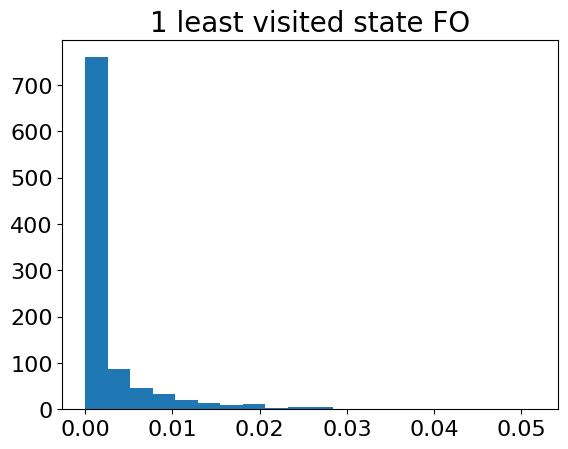

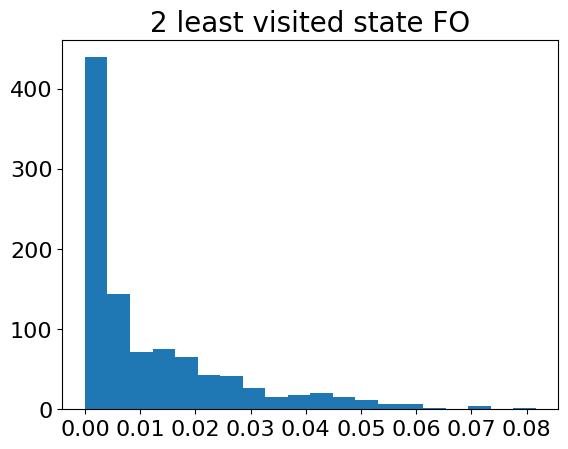

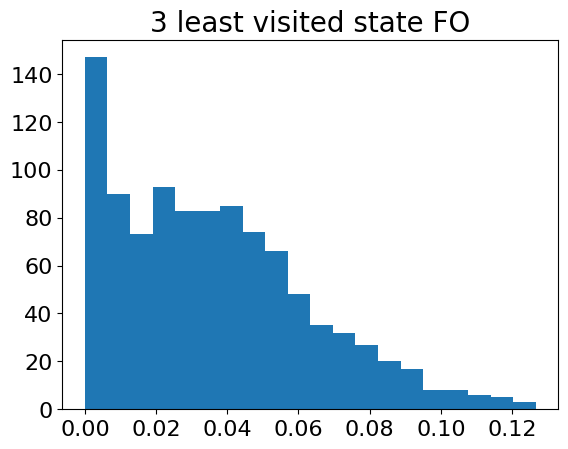

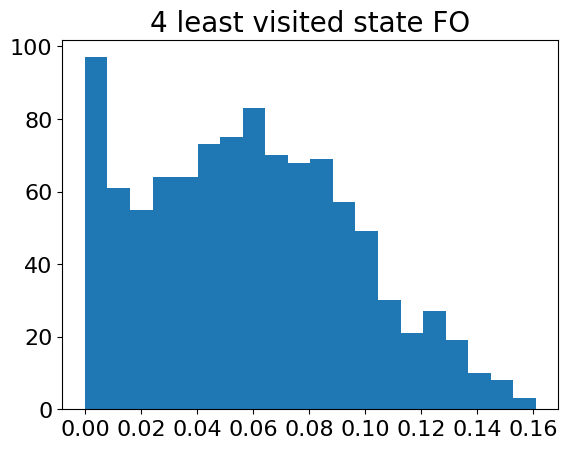

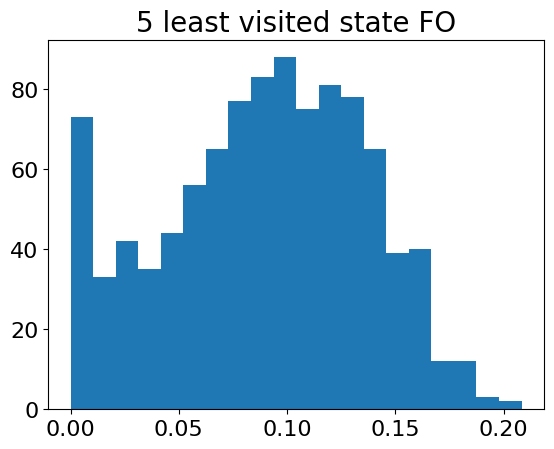

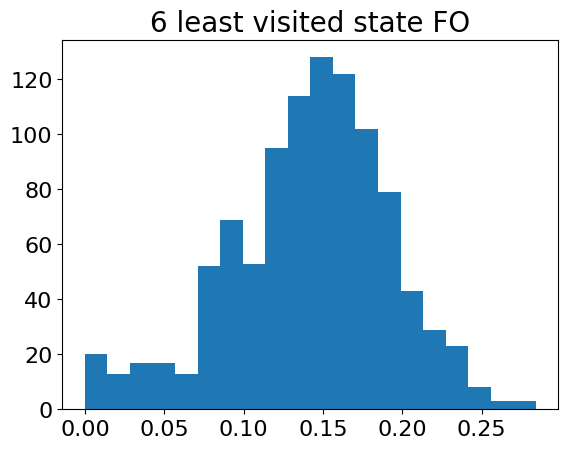

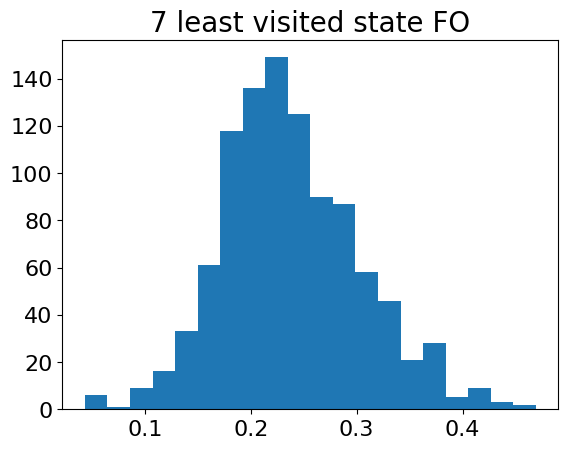

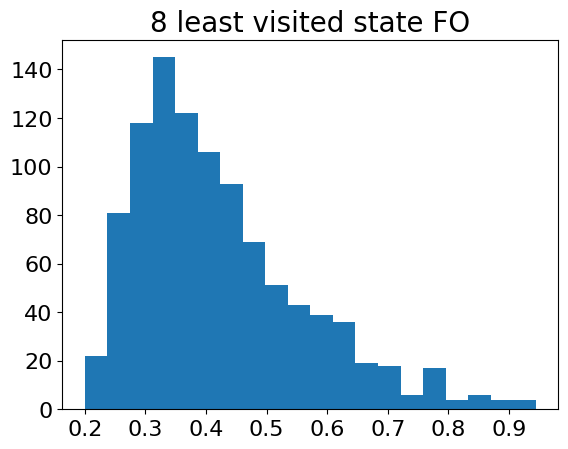

In [45]:
for i in range(8):
    plt.hist(np.squeeze(fo_sorted[:,i]),bins=20)
    plt.xticks(fontsize=16)
    plt.yticks(fontsize=16)
    plt.title(f'{i+1} least visited state FO',fontsize=20)
    plt.show()

Understand different ICA running results.

In [51]:
save_dirs = ['/well/win-midnightsc/projects/ICA/groupICA_50.gica/melodic_IC.dscalar.nii',
             '/well/win-midnightsc/projects/ICA/groupICA_50_method_1.gica/melodic_IC.dscalar.nii',
             '/well/win-midnightsc/projects/ICA/groupICA_50_method_2.gica/melodic_IC.dscalar.nii']

In [52]:
def get_IC(save_dir):
    import nibabel as nib
    IC = nib.load(save_dir)
    return IC.get_fdata()

In [54]:
ICs = []
for save_dir in save_dirs:
    ICs.append(get_IC(save_dir))

In [55]:
for IC in ICs:
    print(IC.shape)

(50, 59412)
(50, 59412)
(50, 59412)


In [58]:
from osl_dynamics.inference.metrics import twopair_vector_correlation
from osl_dynamics.inference.modes import hungarian_pair
from osl_dynamics.utils.plotting import plot_mode_pairing

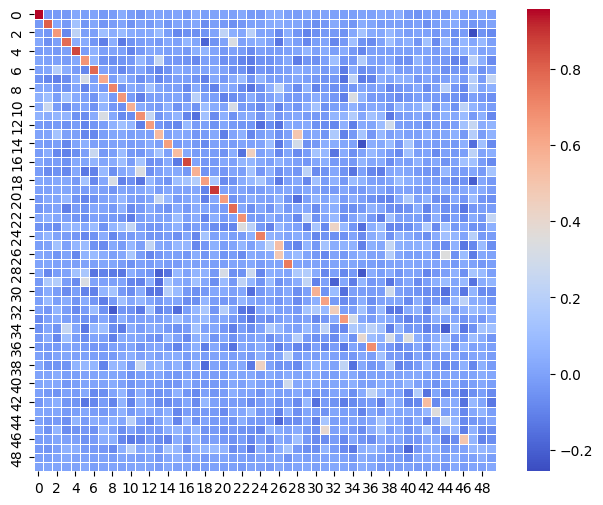

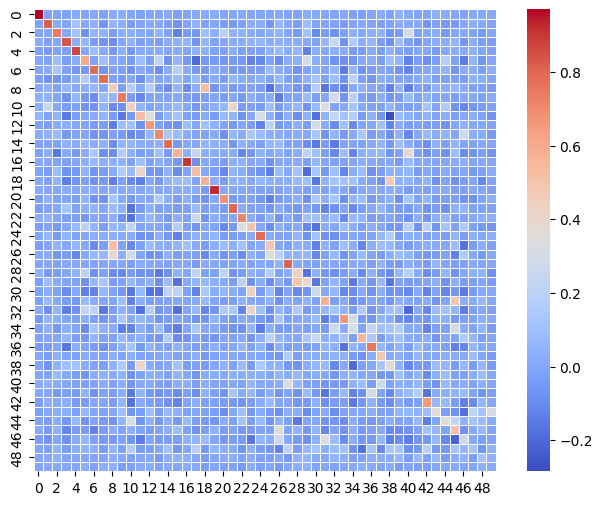

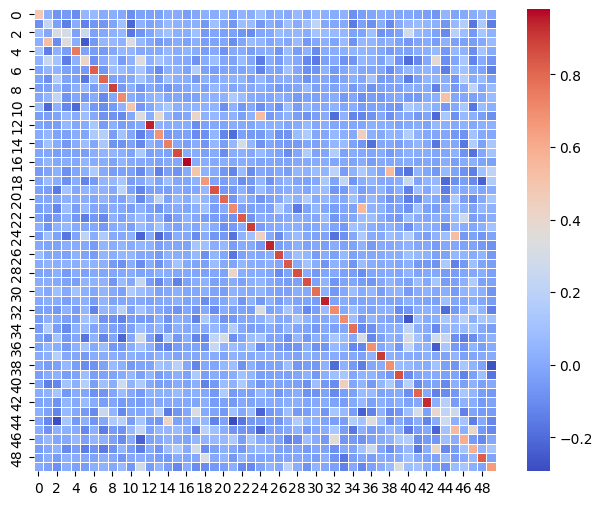

In [61]:
for i in range(3):
    for j in range(i+1,3):
        cor = twopair_vector_correlation(ICs[i],ICs[j])
        indice,cor_reordered = hungarian_pair(cor)
        plot_mode_pairing(cor_reordered)#,indice)
        plt.show()

## Update 15th May 2024

Today we're going to try to understand how bi-cross validation works (and why it fails).

In [1]:
from osl_dynamics.config_api.batch import BatchAnalysis

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [7]:
config_path = './results_HCP_bicv_202404/var_1/ICA_50_swc/'
batch_analysis = BatchAnalysis(config_path)

In [8]:
batch_analysis.compare(demean=True,demean_index=0,inset_start_index=6)#,folder='X_test/metrics/')

#############################
We are in the function
Demean_index is:  0
############################
data shape is: (31, 80)
[[  0.           0.           0.         ...   0.           0.
    0.        ]
 [218.62168101 212.77364343 216.12608424 ... 235.81138789 193.51286862
  224.89691366]
 [392.20903361 230.03123196 258.47079069 ... 250.8194778  387.11401862
  246.52196207]
 ...
 [571.34958404 430.05010187 593.49927257 ... 393.39684739 537.56667983
  410.57942099]
 [575.75589724 418.69989836 582.36351352 ... 407.48439148 542.32062003
  404.16991768]
 [566.77576791 402.9083015  586.01154878 ... 409.08691506 546.1157511
  396.03044575]]


2024-06-12 11:17:14 INFO osl-dynamics [plotting.py:104:save]: Saving ./results_HCP_bicv_202404/var_1/ICA_50_swc/analysis/swc_Y_test_log_likelihood.pdf
/gpfs3/well/win-fmrib-analysis/users/uap971/osl-dynamics/osl_dynamics/utils/plotting.py:106: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


Before that, we still need to clear the storage a bit.

In [2]:
import os
import shutil

In [5]:
base_dir = './results_simulation_bicv_202404/'
var_s = ['var_2','var_4']
folds = ['fold_2_2','fold_5_2','fold_5_5']
datasets = ['3_block','diagonal','diagonal_special','random','real']
N_states = list(range(2,35))
cvs = list(range(1,21))
fold_specific = [f'fold_{i}_{j}' for i in range(1, 6) for j in range(1, 6)]

In [6]:
def find_pkl_files(directory):
    pkl_files = []
    for root, dirs, files in os.walk(directory):
        for file in files:
            if file.endswith('.pkl'):
                print(os.path.join(root, file))
    return

In [7]:
for var in var_s:
    for fold in folds:
        for dataset in datasets:
            for N_state in N_states:
                for cv in cvs:
                    for fold_s in fold_specific:
                        file_dir = f'{base_dir}/{var}/{fold}/{dataset}/hmm_ICA_25_state_{N_state}/cv_{cv}/{fold_s}/Y_train/inf_params/alp.pkl'
                        find_pkl_files(file_dir)

## Update 3rd June 2023

We save the code for adding N_state=1.

In [ ]:
import pandas as pd

# Read the CSV file into a DataFrame, assuming the first column is the index
df = pd.read_csv('your_file.csv', index_col=0)

# Copy the first 80 rows
first_80_rows = df.iloc[:80].copy()

# Set 'n_states' to 1 for the copied rows
first_80_rows['n_states'] = 1

# Combine the modified first 80 rows with the original DataFrame
new_df = pd.concat([first_80_rows, df], ignore_index=True)

# Save the new DataFrame to a CSV file
new_df.to_csv('new_file.csv', index=True)


Update 21st July 2024

On spurious dFC

In [3]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [13]:
# Define the variables
f = 0.05  # Replace with the actual frequency value
TR = 1.0  # Replace with the actual TR value
theta = np.pi / 4  # Replace with the actual theta value (for example, pi/4)
n = 20  # Number of time points

# Generate the time points (i)
i = np.arange(n)

# Compute xi and yi
xi = np.sqrt(2) * np.cos(2 * np.pi * f * i * TR)
yi = np.sqrt(2) * np.cos(2 * np.pi * f * i * TR + theta)

In [14]:
print(xi)

[ 1.41421356e+00  1.34499702e+00  1.14412281e+00  8.31253876e-01
  4.37016024e-01  8.65956056e-17 -4.37016024e-01 -8.31253876e-01
 -1.14412281e+00 -1.34499702e+00 -1.41421356e+00 -1.34499702e+00
 -1.14412281e+00 -8.31253876e-01 -4.37016024e-01 -2.59786817e-16
  4.37016024e-01  8.31253876e-01  1.14412281e+00  1.34499702e+00]


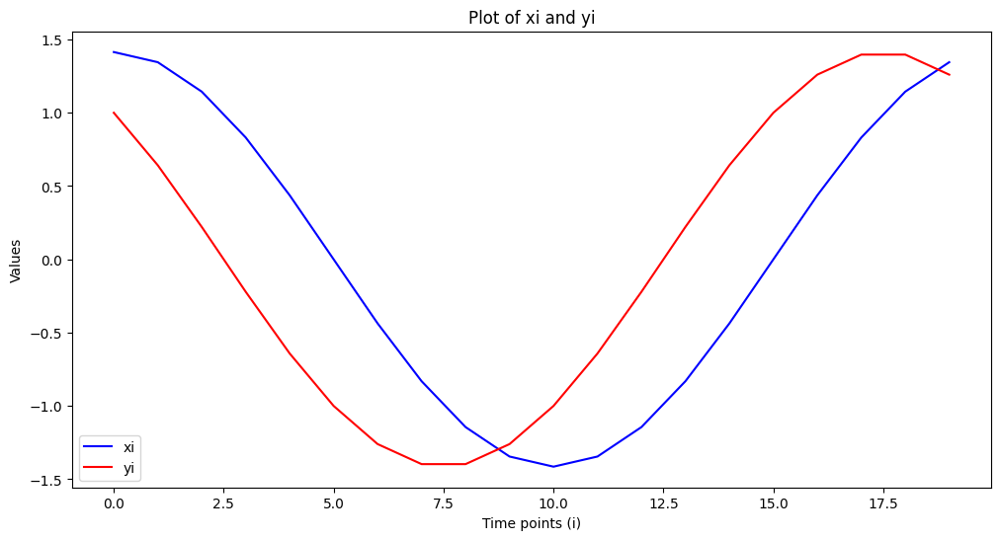

In [15]:
# Plot xi and yi
plt.figure(figsize=(12, 6))

# Plot xi
plt.plot(i, xi, label='xi', color='blue')

# Plot yi
plt.plot(i, yi, label='yi', color='red')

# Add titles and labels
plt.title('Plot of xi and yi')
plt.xlabel('Time points (i)')
plt.ylabel('Values')
plt.legend()

# Display the plot
plt.show()

## Update 29th July 2024

check the states obtained from DyNeMo. These states are saved in `./results_HCP_bicv_202404/var_1/ICA_50_dynemo_check/dynemo_ICA_50_state_8/repeat_1/inf_params/covs.npy'`

In [24]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
from osl_dynamics.utils.plotting import plot_matrices

In [25]:
save_dir = './results_HCP_bicv_202404/var_1/ICA_50_dynemo_check/dynemo_ICA_50_state_8/repeat_1/inf_params/covs.npy'

In [26]:
covs = np.load(save_dir)

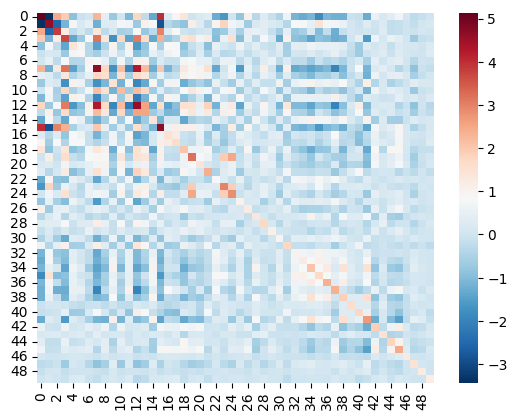

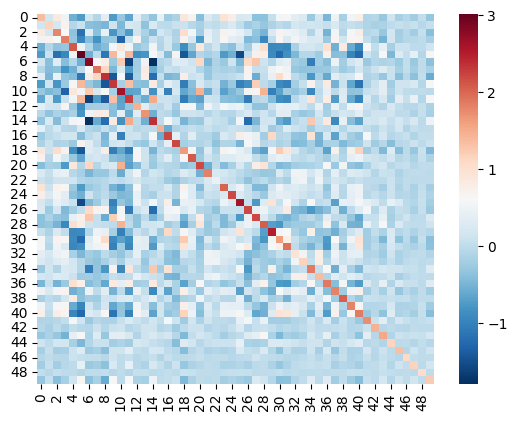

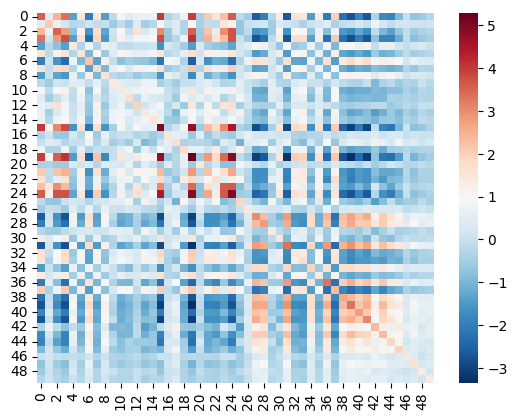

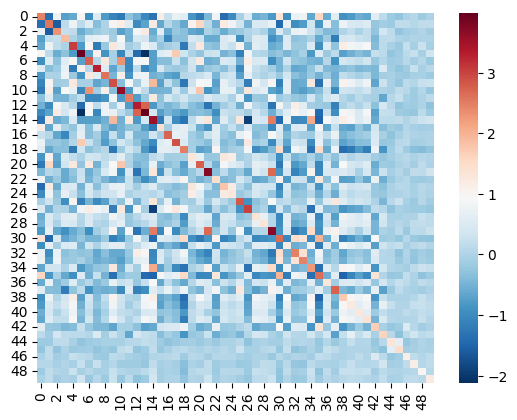

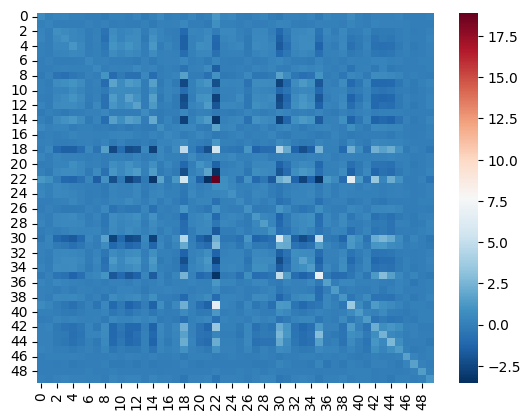

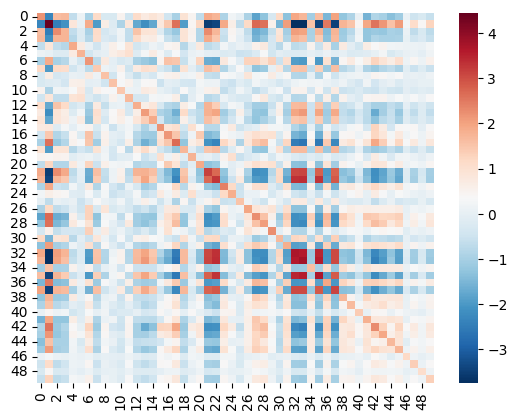

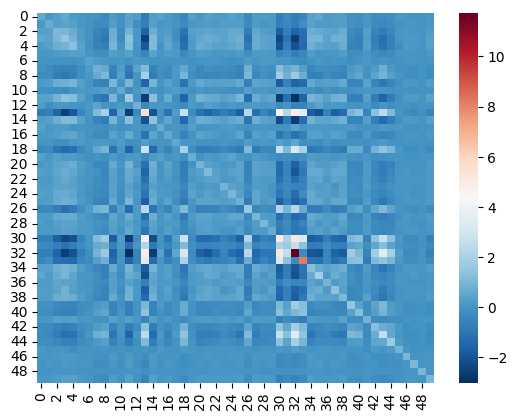

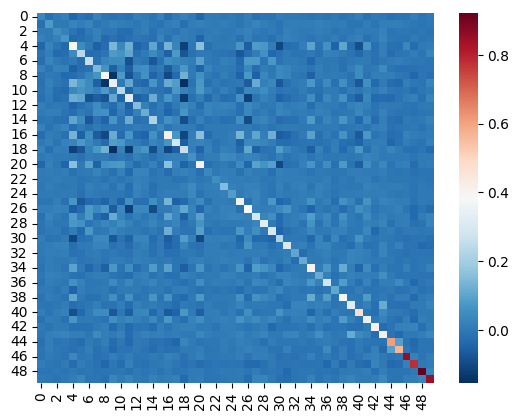

In [27]:
for i in range(8):
    sns.heatmap(covs[i], cmap = "RdBu_r")
    plt.show()

## Update 1st Aug 2024

Check the DyneMo training results on random_dynemo dataset.

In [50]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from osl_dynamics.inference.metrics import twopair_riemannian_distance
from osl_dynamics.inference.modes import hungarian_pair
from osl_dynamics.utils.plotting import plot_mode_pairing

In [35]:
ground_truth_dir = './data/node_timeseries/simulation_bicv/random_dynemo/truth/state_covariances.npy'
fit_dir = './results_simulation_bicv_202407/random_dynemo/dynemo_check/dynemo_ICA_50_state_6/repeat_1/inf_params/covs.npy'

In [51]:
# This is from Rukuang's training code
ground_truth_dir = './examples/simulation/figures_long-range/sim_cov.npy'
fit_dir = './examples/simulation/figures_long-range/inf_cov.npy'

In [52]:
cov_ground_truth = np.load(ground_truth_dir)
cov_fit = np.load(fit_dir)

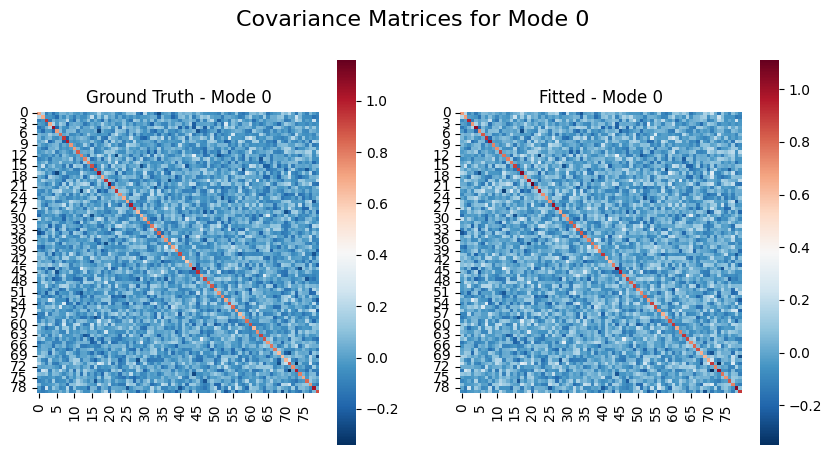

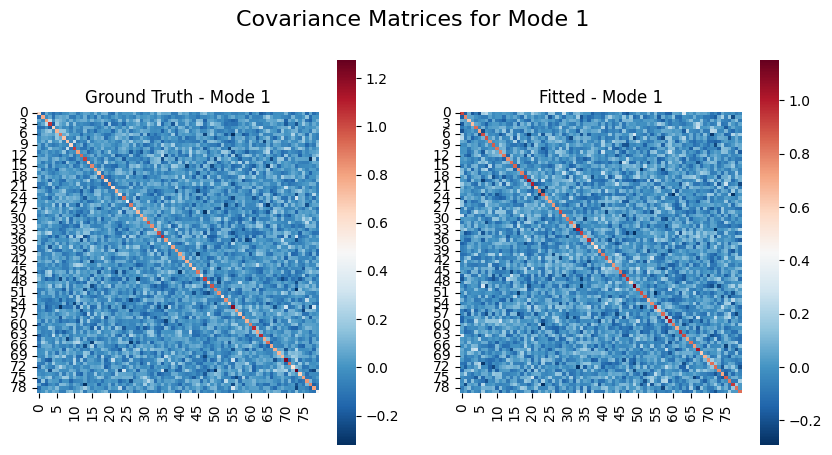

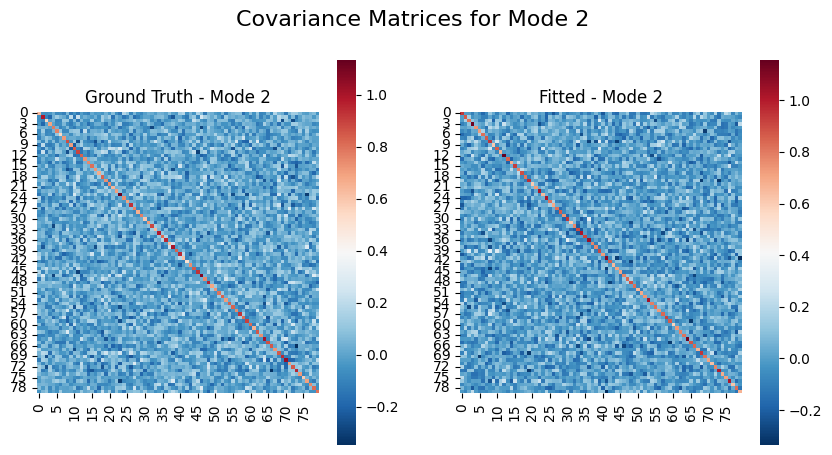

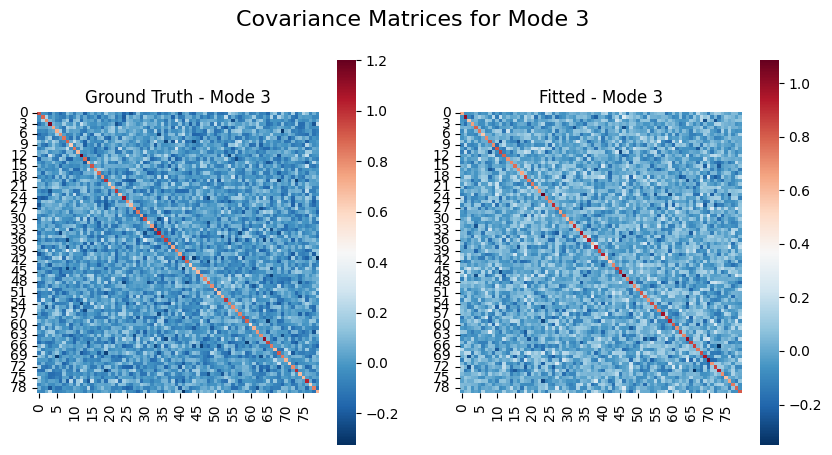

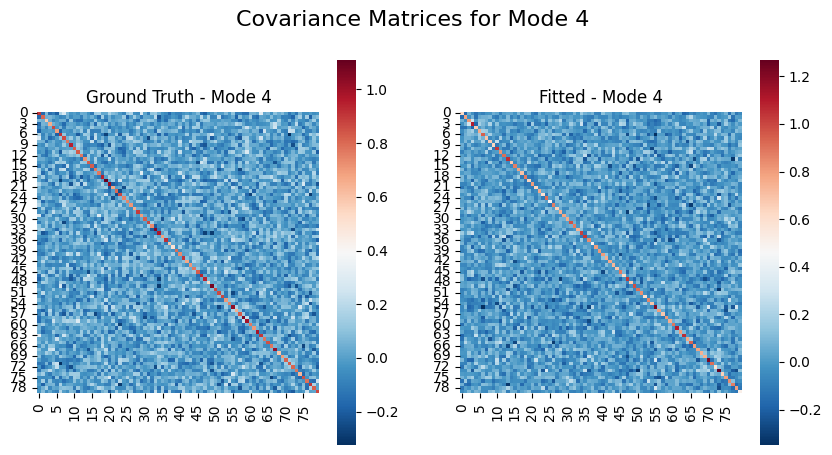

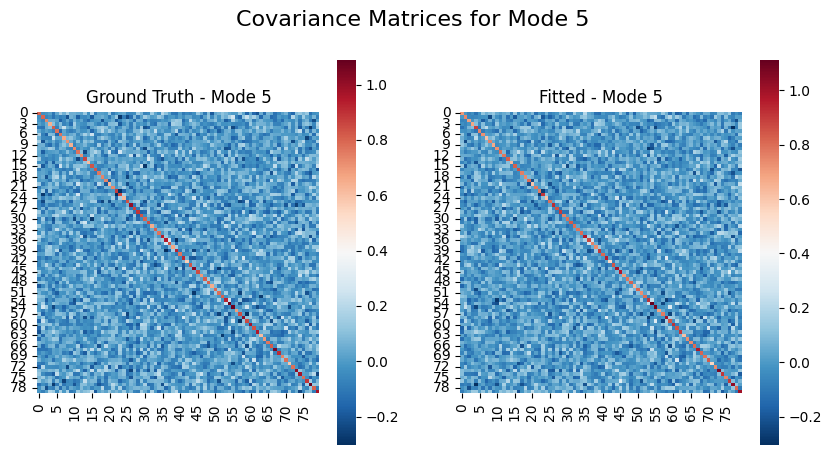

In [75]:
import seaborn as sns
def plot_covariance_heatmaps(cov_ground_truth, cov_fit):
    n_modes = cov_ground_truth.shape[0]
    
    for mode in range(n_modes):
        plt.figure(figsize=(10, 5))
        
        # Plot ground truth covariance matrix
        plt.subplot(1, 2, 1)
        sns.heatmap(cov_ground_truth[mode],cmap = "RdBu_r",square=True)
        plt.title(f'Ground Truth - Mode {mode}')
        
        # Plot fitted covariance matrix
        plt.subplot(1, 2, 2)
        sns.heatmap(cov_fit[mode], cmap="RdBu_r",square=True)
        plt.title(f'Fitted - Mode {mode}')
        
        plt.suptitle(f'Covariance Matrices for Mode {mode}', fontsize=16)
        plt.show()

# Example usage
# Assuming cov_ground_truth and cov_fit are already defined
plot_covariance_heatmaps(cov_ground_truth, cov_fit)

In [53]:
riemann = twopair_riemannian_distance(cov_fit,cov_ground_truth)
indices,riemann_reordered = hungarian_pair(riemann,distance=True)

Computing Riemannian distances: 100%|███████████| 3/3 [00:00<00:00, 1466.37it/s]


[[ 0.83511374 11.53846056 14.83555683]
 [12.21968817  0.13672417 11.20832253]
 [15.3408765  11.14396769  0.14544137]]


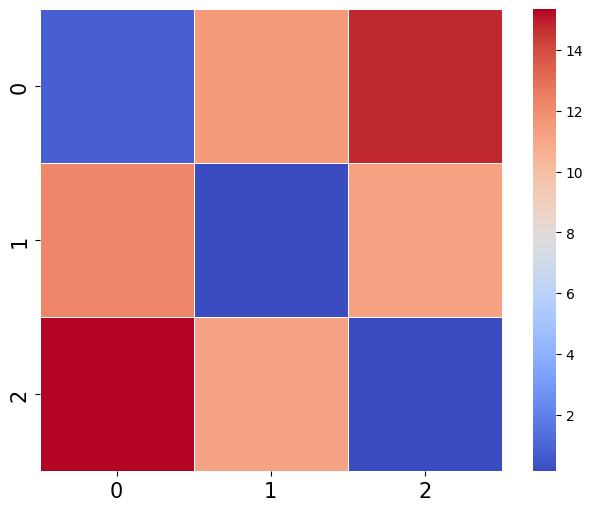

In [54]:
plot_mode_pairing(riemann_reordered,indices)
print(riemann_reordered)

In [25]:
from osl_dynamics.array_ops import cov2stdcorr

In [26]:
_, cor_ground_truth = cov2stdcorr(cov_ground_truth)
_, cor_fit = cov2stdcorr(cor_ground_truth)

In [27]:
riemann_cor = twopair_riemannian_distance(cor_fit,cor_ground_truth)
indices_cor,riemann_reordered_cor = hungarian_pair(riemann,distance=True)

Computing Riemannian distances: 100%|████████████| 6/6 [00:00<00:00, 120.36it/s]


[[11.02626646 29.80431028 29.50038861 28.3066106  29.99350569 28.83588688]
 [29.27718018  5.23064805 28.42260999 27.56208965 29.01631951 27.94418014]
 [29.01454249 28.6891533  13.32521374 27.30976974 27.70866648 27.27965328]
 [28.29190535 28.10006395 27.25197615  9.14880439 28.12409665 27.18612581]
 [29.33394509 29.32122004 28.85684302 27.66652132 14.8821957  28.57033163]
 [29.31307596 28.8110609  27.37849461 27.56697762 29.43939323 15.73494902]]


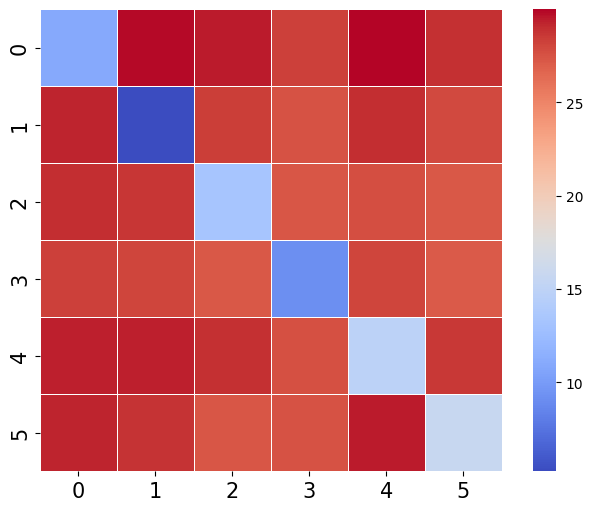

In [28]:
plot_mode_pairing(riemann_reordered_cor,indices_cor)
print(riemann_reordered_cor)

In [15]:
import pickle

In [16]:
with open('./examples/simulation/figures_init/sim_alp.pkl', 'rb') as f:
    alpha_ground_truth = pickle.load(f)
with open('./examples/simulation/figures_init/inf_alp.pkl', 'rb') as f:
    alpha_fit = pickle.load(f)

In [17]:
from osl_dynamics.inference.metrics import twopair_vector_correlation

In [18]:
print(twopair_vector_correlation(alpha_ground_truth.T,alpha_fit.T))

[[ 0.99938678 -0.37690393 -0.35741263 -0.28773482 -0.27946403 -0.3112698 ]
 [-0.36719652  0.99941158 -0.26618644 -0.22954408 -0.08143081 -0.17484323]
 [-0.35675415 -0.2691908   0.998388   -0.07495324 -0.24388133  0.03455542]
 [-0.29957255 -0.22814462 -0.08631261  0.99849019 -0.09159993 -0.01118944]
 [-0.32979512 -0.10301649 -0.16189274 -0.12320158  0.99409775  0.22144253]
 [-0.31502496 -0.16188662 -0.02938051 -0.02030868  0.23868626  0.99576458]]


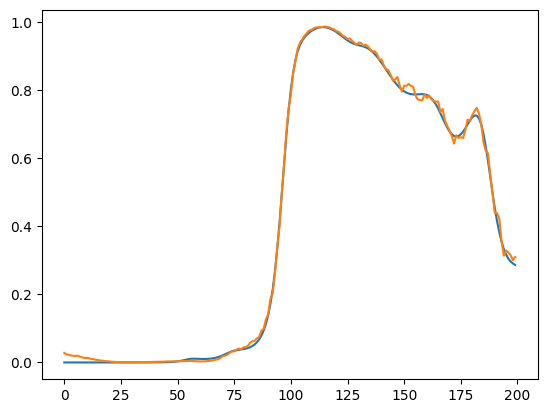

In [19]:
plt.plot(np.squeeze(alpha_ground_truth[:200,0]))
plt.plot(np.squeeze(alpha_fit[:200,0]))

OK, now let's initialise the model training from the ground-truth covs.

### Look at the static model obtained from HMM.

In [29]:
staticFC_1 = np.load('results_HCP_bicv_202404/var_1/ICA_50_check/hmm_ICA_50_state_1/repeat_1/inf_params/covs.npy')

In [32]:
staticFC_2 = np.load('results_HCP_bicv_202404/var_1/ICA_50_check/hmm_ICA_50_state_1/repeat_2/inf_params/covs.npy')

In [33]:
np.squeeze(staticFC_1-staticFC_2)

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

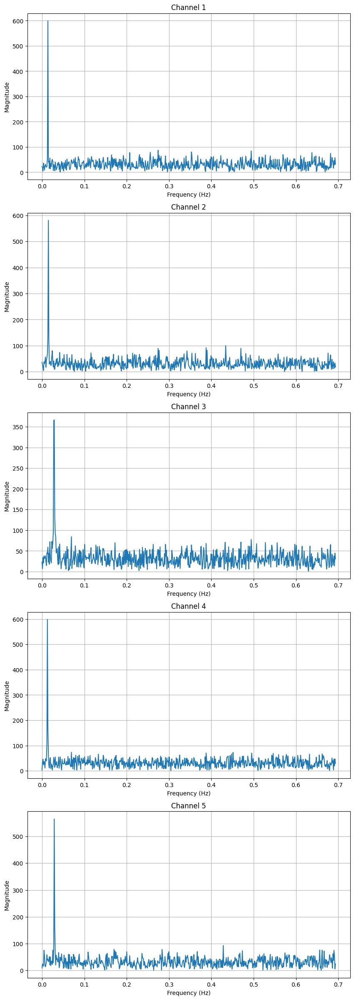

In [39]:
import numpy as np
import matplotlib.pyplot as plt
import scipy.fftpack

# Function to plot frequency magnitude
def plot_frequency_magnitude(file_path, TR):
    # Load the data
    data = np.loadtxt(file_path)
    
    # Number of samples and channels
    n_samples, n_channels = data.shape

    # Sampling frequency
    fs = 1 / TR

    # Compute the FFT for each channel
    freqs = np.fft.fftfreq(n_samples, d=TR)
    fft_magnitudes = np.abs(np.fft.fft(data, axis=0))

    # Plot frequency magnitude for each channel
    plt.figure(figsize=(10, 30))
    n_channels_plot = 5
    for channel in range(n_channels_plot):
        plt.subplot(n_channels_plot, 1, channel + 1)
        plt.plot(freqs[:n_samples // 2], fft_magnitudes[:n_samples // 2, channel])
        plt.title(f'Channel {channel + 1}')
        plt.xlabel('Frequency (Hz)')
        plt.ylabel('Magnitude')
        plt.grid()
    
    #plt.tight_layout()
    plt.show()

# Example usage
file_path = './data/node_timeseries/simulation_bicv/static_drift/10001.txt'
TR = 0.72  # Repetition time
plot_frequency_magnitude(file_path, TR)

In [40]:
cov_truth = np.load('data/node_timeseries/simulation_bicv/random_dynemo/truth/state_covariances.npy')

In [42]:
riem = twopair_riemannian_distance(cov_truth,cov_truth)

Computing Riemannian distances: 100%|█████████████| 6/6 [00:00<00:00, 15.42it/s]


(<Figure size 800x600 with 2 Axes>, <Axes: >)

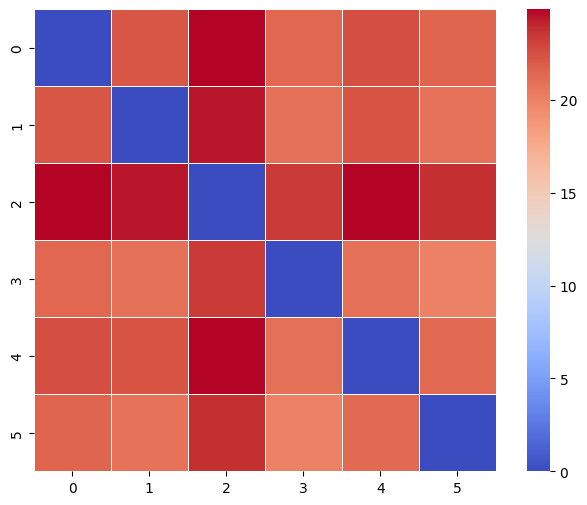

In [44]:
plot_mode_pairing(riem)

In [1]:
from osl_dynamics.utils.plotting import plot_alpha

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
import pickle

In [10]:
#alpha_example = np.load('data/node_timeseries/simulation_bicv/random_dynemo_equal/truth/10001_mode_time_course.npy')
with open('examples/simulation/figures_play_3/inf_alp.pkl','rb') as file:
    alpha_example = pickle.load(file)
#alpha_example = np.load('data/node_timeseries/simulation_bicv/random_dynemo_equal/truth/10001_mode_time_course.npy')

(<Figure size 1200x250 with 2 Axes>, [<Axes: xlabel='Sample'>])

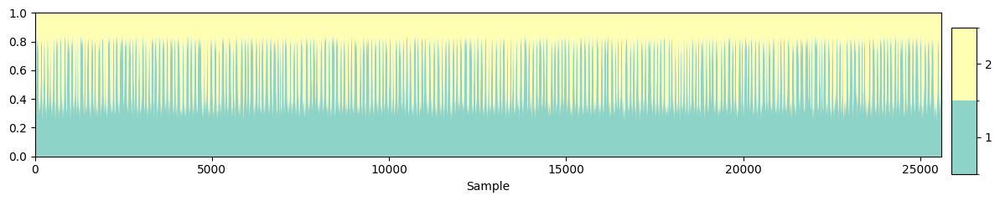

In [11]:
plot_alpha(alpha_example)

## Update 24th August 2024

check the real_soft_mixing case

In [1]:
import pickle
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [379]:
save_dir = './examples/simulation/real_soft_mixture/'
data_dir = f'{save_dir}/data/'

In [380]:
alpha = np.load(f'{data_dir}alp.npy')[:25600]

In [381]:
alpha.shape

(25600, 5)

In [382]:
from osl_dynamics.utils.plotting import plot_alpha

(<Figure size 1200x250 with 2 Axes>, [<Axes: xlabel='Sample'>])

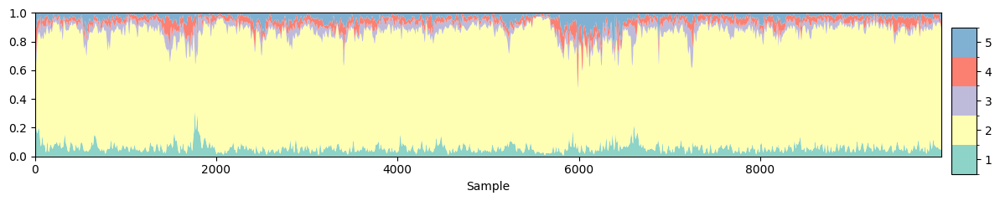

In [383]:
plot_alpha(alpha,n_samples=10000)

In [384]:
x = np.load(f'{data_dir}x.npy')

In [385]:
x.shape

(25600, 100)

In [386]:
sim_cov = np.load(f'{save_dir}/data/covs.npy')

In [387]:
inf_cov = np.load(f'{save_dir}/models/dynemo/covs.npy')

In [37]:
from osl_dynamics.inference.metrics import twopair_riemannian_distance
from osl_dynamics.inference.modes import hungarian_pair
from osl_dynamics.utils.plotting import plot_mode_pairing

In [388]:
riem = twopair_riemannian_distance(sim_cov+np.eye(100),inf_cov+np.eye(100))
order,riem_reorder = hungarian_pair(riem,distance=True)

Computing Riemannian distances: 100%|█████████████| 5/5 [00:00<00:00, 66.20it/s]


In [389]:
print(riem_reorder.shape)

(5, 5)


[[ 6.8211 15.9245 13.7479 12.0793 14.2888]
 [11.85    1.4237 13.5945  9.1081 13.0633]
 [13.4954 14.0716  6.5467 10.0914 13.6303]
 [13.173  15.387  13.127  12.7541  9.6966]
 [13.5034 13.5279 13.2354 11.504   7.8987]]


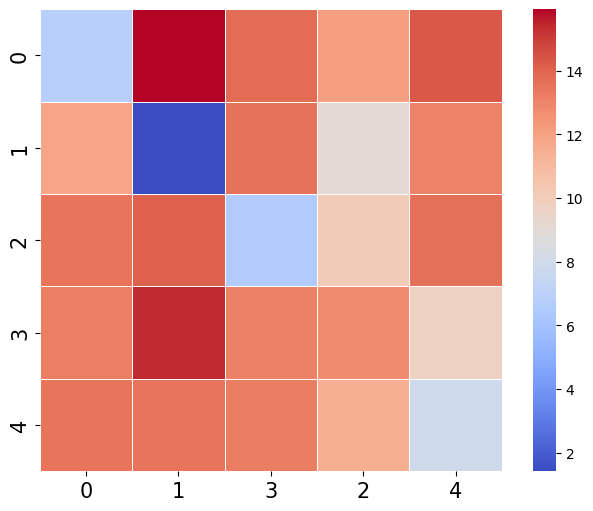

In [390]:
plot_mode_pairing(riem_reorder,order)
print(riem_reorder)

Computing Riemannian distances: 100%|████████████| 5/5 [00:00<00:00, 111.06it/s]


[[30.13651987 42.27626746 28.78929763 34.17003057 36.51682114]
 [58.93130208 38.99242116 60.82108468 61.23759139 61.63269355]
 [32.86725158 43.81962622 28.3090503  30.78620404 34.27362529]
 [27.97326432 38.75901992 30.38415794 25.46472964 26.36823806]
 [32.79857842 40.29618554 34.01585532 32.81667074 26.03839071]]


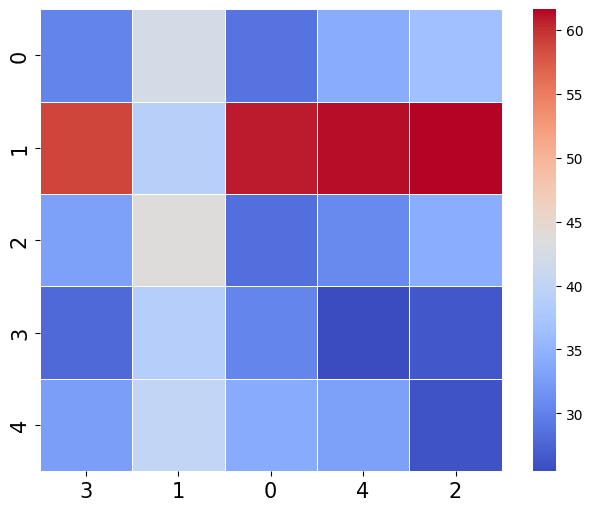

In [51]:
inf_cov_2 = np.load(f'{save_dir}/models_2/dynemo/covs.npy')
riem_1_2 = twopair_riemannian_distance(inf_cov,inf_cov_2)
order_1_2,riem_1_2_reorder = hungarian_pair(riem,distance=True)
plot_mode_pairing(riem_1_2_reorder,order_1_2)
print(riem_1_2_reorder)

In [378]:
sim_alp = np.load(f'{save_dir}/data/alp.npy')[:25600]
inf_alp = np.load(f'{save_dir}/models/dynemo/alp.npy')
sim_cov = np.load(f'{save_dir}/data/covs.npy')
inf_cov = np.load(f'{save_dir}/models/dynemo/covs.npy')

inf_alp_2 = np.load(f'{save_dir}/models_2/dynemo/alp.npy')
inf_cov_2 = np.load(f'{save_dir}/models_2/dynemo/covs.npy')

FileNotFoundError: [Errno 2] No such file or directory: './examples/simulation//data/alp.npy'

In [86]:
from tqdm.auto import trange
from osl_dynamics.inference import metrics
from osl_dynamics.utils import plotting

In [87]:
sim_tvcov = np.sum(
    sim_alp[:, :, np.newaxis, np.newaxis] * sim_cov[np.newaxis, :, :, :], axis=1
)
inf_tvcov = np.sum(
    inf_alp[:, :, np.newaxis, np.newaxis] * inf_cov[np.newaxis, :, :, :], axis=1
)

# Calculate the Riemannian distance between the ground truth and inferred covariance
print("Calculating riemannian distances")
rd = np.empty(2000)
for i in trange(2000):
    rd[i] = metrics.riemannian_distance(sim_tvcov[i], inf_tvcov[i])

plotting.plot_line(
    [range(2000)],
    [rd],
    labels=["DyNeMo"],
    x_label="Sample",
    y_label="$d$",
    fig_kwargs={"figsize": (15, 1.5)},
    filename=f"{save_dir}/plots/rd.png",
)

Calculating riemannian distances


100%|██████████████████████████████████████| 2000/2000 [00:02<00:00, 667.79it/s]
2024-08-25 19:24:53 INFO osl-dynamics [plotting.py:104:save]: Saving ./examples/simulation/real_soft_mixture//plots/rd.png


In [89]:
inf_tvcov_2 = np.sum(
    inf_alp_2[:, :, np.newaxis, np.newaxis] * inf_cov_2[np.newaxis, :, :, :], axis=1
)

# Calculate the Riemannian distance between the ground truth and inferred covariance
print("Calculating riemannian distances")
rd_1_2 = np.empty(2000)
for i in trange(2000):
    rd_1_2[i] = metrics.riemannian_distance(inf_tvcov[i], inf_tvcov_2[i])

plotting.plot_line(
    [range(2000)],
    [rd_1_2],
    labels=["DyNeMo"],
    x_label="Sample",
    y_label="$d$",
    fig_kwargs={"figsize": (15, 1.5)},
    filename=f"{save_dir}/plots/rd_run2run.png",
)

Calculating riemannian distances


100%|██████████████████████████████████████| 2000/2000 [00:03<00:00, 501.36it/s]
2024-08-25 19:25:56 INFO osl-dynamics [plotting.py:104:save]: Saving ./examples/simulation/real_soft_mixture//plots/rd_run2run.png


In [31]:
from osl_dynamics.inference.metrics import alpha_correlation

In [34]:
alpha_cor = alpha_correlation(sim_alp,inf_alp,return_diagonal=False)

(<Figure size 800x600 with 2 Axes>, <Axes: >)

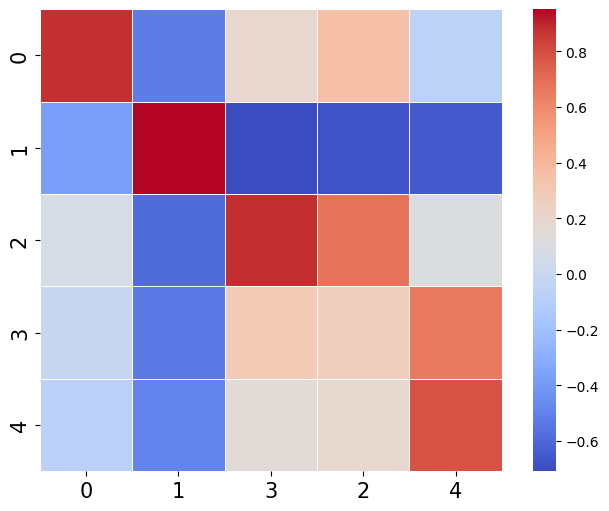

In [35]:
order,alpha_cor_reorder = hungarian_pair(alpha_cor,distance=False)
plot_mode_pairing(alpha_cor_reorder,order)

Find the best linear transformation T

In [52]:
T = np.linalg.pinv(sim_alp) @ inf_alp

In [55]:
print(T)

[[ 1.540548   -0.8086499   0.22575676  0.11560912 -0.07326425]
 [ 0.00518289  0.9864869   0.03533305 -0.01466145 -0.01234143]
 [-0.04472815 -0.37854183  0.39192268  1.0455     -0.0141532 ]
 [ 0.07405105 -0.57036567  0.1524584   0.2618055   1.0820504 ]
 [-0.09136718 -0.30033642  0.10327013  0.05006     1.238373  ]]


In [59]:
inf_cov = np.load(f'{save_dir}/models/dynemo/covs.npy')

In [60]:
inf_cov_proj = []
for i in range(T.shape[0]):  # Loop over rows of T (which correspond to D_i)
    D = np.zeros_like(inf_cov[0])  # Initialize D_i with zeros of the same shape as hat_D_j matrices
    for j in range(T.shape[1]):  # Loop over columns of T (which correspond to hat_D_j)
        D += T[i, j] * inf_cov[j]  # Add the contribution of each hat_D_j scaled by T_ij
    inf_cov_proj.append(D)

In [67]:
inf_cov_proj = np.array(inf_cov_proj)

In [68]:
inf_cov_proj.shape

(5, 100, 100)

In [71]:
for i in range(len(inf_cov_proj)):
    eigenvalues = np.linalg.eigvals(inf_cov_proj[i])
    # Check if all eigenvalues are non-negative
    print(np.min(eigenvalues))

-0.5174804
-0.1204433
-0.07396613
0.8900208
-0.57503504


In [72]:
def find_best_T(D_matrices, hat_D_matrices):
    J = D_matrices.shape[0]
    
    # Flatten the matrices
    D_vecs = np.array([D.flatten() for D in D_matrices])  # Shape: (J, 10000)
    hat_D_vecs = np.array([hat_D.flatten() for hat_D in hat_D_matrices])  # Shape: (J, 10000)
    
    # Transpose D_vecs to have shape (10000, J)
    D_vecs = D_vecs.T  # Now shape: (10000, J)
    hat_D_vecs = hat_D_vecs.T  # Now shape: (10000, J)
    
    # Solve for T using least squares
    T, _, _, _ = np.linalg.lstsq(hat_D_vecs, D_vecs, rcond=None)
    
    return T

In [73]:
T_1 = find_best_T(sim_cov,inf_cov)

In [77]:
np.set_printoptions(precision=4, suppress=True)
print(np.array(T_1))

[[ 1.6381  0.0115 -0.1126 -0.1891  0.0302]
 [ 4.0567  0.3273 -1.9463 11.528  -3.9857]
 [ 0.4195  0.0063  0.5997  0.2107  0.191 ]
 [-0.0179 -0.0012  1.1387  0.1102  0.0126]
 [-0.1478 -0.0003 -0.0644  0.8981  1.3667]]


In [83]:
sim_cov_proj = []
for i in range(T_1.shape[0]):  # Loop over rows of T (which correspond to D_i)
    D = np.zeros_like(inf_cov[0])  # Initialize D_i with zeros of the same shape as hat_D_j matrices
    for j in range(T.shape[1]):  # Loop over columns of T (which correspond to hat_D_j)
        D += T_1[i, j] * inf_cov[j]  # Add the contribution of each hat_D_j scaled by T_ij
    sim_cov_proj.append(D)
sim_cov_proj = np.array(sim_cov_proj)

In [84]:
for i in range(len(sim_cov_proj)):
    eigenvalues = np.linalg.eigvals(sim_cov_proj[i])
    # Check if all eigenvalues are non-negative
    print(np.min(eigenvalues))

-2.1550758
-39.06575
1.913783
0.11547803
-0.6813916


In [81]:
twopair_riemannian_distance(sim_cov,sim_cov_proj)

Computing Riemannian distances:   0%|                     | 0/5 [00:00<?, ?it/s]
/gpfs3/well/win-fmrib-analysis/users/uap971/osl-dynamics/osl_dynamics/inference/metrics.py:577: UserWarning: Calculation of Riemannian distance failed for eps=0
  warnings.warn(f'Calculation of Riemannian distance failed for eps={eps}')
Computing Riemannian distances:   0%|                     | 0/5 [00:00<?, ?it/s]
/gpfs3/well/win-fmrib-analysis/users/uap971/osl-dynamics/osl_dynamics/inference/metrics.py:577: UserWarning: Calculation of Riemannian distance failed for eps=1e-09
  warnings.warn(f'Calculation of Riemannian distance failed for eps={eps}')
Computing Riemannian distances:   0%|                     | 0/5 [00:00<?, ?it/s]
/gpfs3/well/win-fmrib-analysis/users/uap971/osl-dynamics/osl_dynamics/inference/metrics.py:577: UserWarning: Calculation of Riemannian distance failed for eps=1e-08
  warnings.warn(f'Calculation of Riemannian distance failed for eps={eps}')
Computing Riemannian distances:   0%| 

ValueError: Riemannian distance failed for all eps values!

Let's further investigate why this is happening!

Look at the samples 100-150.

In [90]:
sim_alp = np.load(f'{save_dir}/data/alp.npy')[:25600]
inf_alp = np.load(f'{save_dir}/models/dynemo/alp.npy')
sim_cov = np.load(f'{save_dir}/data/covs.npy')
inf_cov = np.load(f'{save_dir}/models/dynemo/covs.npy')

inf_alp_2 = np.load(f'{save_dir}/models_2/dynemo/alp.npy')
inf_cov_2 = np.load(f'{save_dir}/models_2/dynemo/covs.npy')

In [91]:
print(sim_alp.shape)
print(inf_alp.shape)

(25600, 5)
(25600, 5)


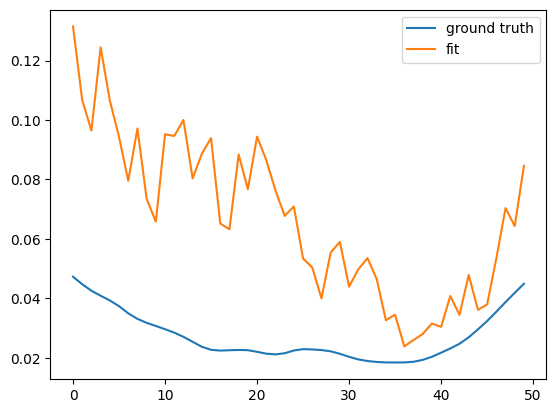

In [99]:
plt.plot(sim_alp[100:150,4],label='ground truth')
plt.plot(inf_alp[100:150,4],label='fit')
plt.legend()
plt.show()

In [100]:
T = np.linalg.pinv(sim_alp) @ inf_alp

In [101]:
inf_alp_proj = sim_alp @ T

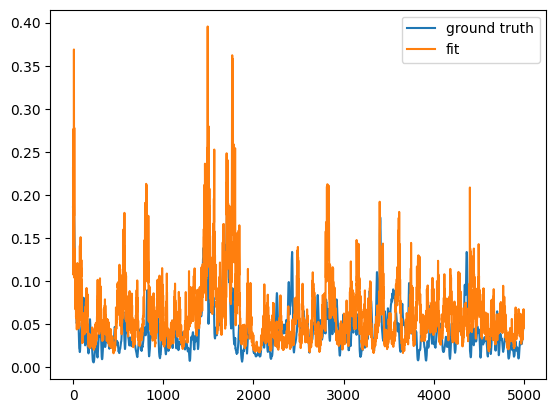

In [115]:
plt.plot(sim_alp[:5000,3],label='ground truth')
plt.plot(inf_alp[:5000,3],label='fit')
plt.legend()
plt.show()

In [113]:
alpha_correlation(sim_alp,inf_alp)

array([0.8763, 0.9512, 0.6831, 0.2954, 0.7868])

In [114]:
alpha_correlation(sim_alp,inf_alp_proj)

array([0.9967, 0.9937, 0.8961, 0.325 , 0.8484])

Ok, this is too complicated. Let's start from something simpler. Get back to the playground case.

In [189]:
import numpy as np
import pickle

In [394]:
save_dir = './examples/simulation/'

In [271]:
sim_cov = np.load(f'{save_dir}figures_play_5/sim_cov.npy')
inf_cov = np.load(f'{save_dir}figures_play_5/inf_cov.npy')
with open(f'{save_dir}figures_play_5/sim_alp.pkl', 'rb') as f:
    sim_alp = pickle.load(f)
with open(f'{save_dir}figures_play_5/inf_alp.pkl', 'rb') as f:
    inf_alp = pickle.load(f)

In [272]:
from osl_dynamics.utils.plotting import plot_alpha

[[0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]]


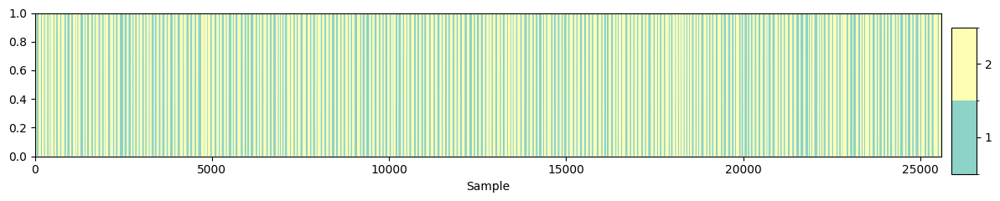

In [273]:
plot_alpha(sim_alp)
print(sim_alp[:50,:])

In [274]:
print(inf_alp[:50,:])

[[0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.     1.    ]
 [0.0086 0.9914]
 [1.     0.    ]
 [1.     0.    ]
 [1.     0.    ]
 [1.     0.    ]
 [1.     0.    ]
 [1.     0.    ]
 [1.     0.    ]
 [1.     0.    ]
 [1.     0.    ]
 [1.     0.    ]]


In [196]:
T = np.linalg.pinv(sim_alp) @ inf_alp
inf_alp_proj = sim_alp @ T
sim_alp_proj = inf_alp @ np.linalg.inv(T)
print(T)
print(np.linalg.inv(T))

[[0.2264 0.7736]
 [0.6024 0.3976]]
[[-1.0573  2.0573]
 [ 1.6021 -0.6021]]


(<Figure size 1200x250 with 2 Axes>, [<Axes: xlabel='Sample'>])

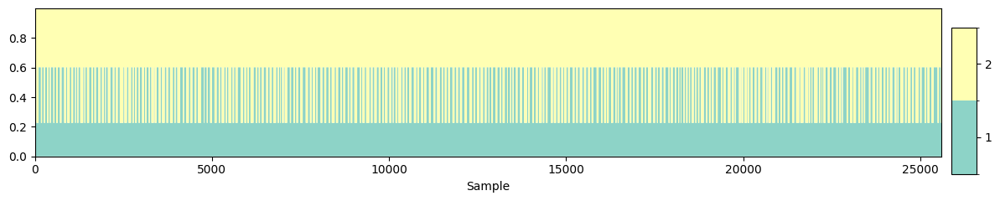

In [197]:
plot_alpha(inf_alp_proj)

(<Figure size 1200x250 with 2 Axes>, [<Axes: xlabel='Sample'>])

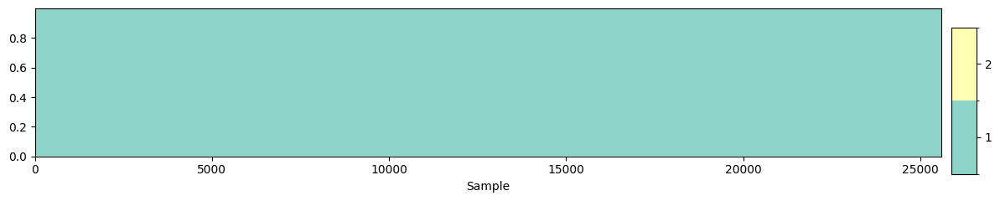

In [216]:
plot_alpha(inf_alp)

In [151]:
alpha_correlation(inf_alp_proj,inf_alp)

array([0.909, 0.909])

In [147]:
inf_alp_proj[:50]

array([[0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],
       [0.6024, 0.3976],


In [149]:
inf_alp[:50]

array([[0.824 , 0.176 ],
       [0.5056, 0.4944],
       [0.6927, 0.3073],
       [0.6906, 0.3094],
       [0.6952, 0.3048],
       [0.5814, 0.4186],
       [0.5449, 0.4551],
       [0.6159, 0.3841],
       [0.6402, 0.3598],
       [0.5782, 0.4218],
       [0.585 , 0.415 ],
       [0.6299, 0.3701],
       [0.6674, 0.3326],
       [0.6624, 0.3376],
       [0.6153, 0.3847],
       [0.5915, 0.4085],
       [0.58  , 0.42  ],
       [0.6353, 0.3647],
       [0.5078, 0.4922],
       [0.6516, 0.3484],
       [0.6839, 0.3161],
       [0.7608, 0.2392],
       [0.6593, 0.3407],
       [0.6817, 0.3183],
       [0.6912, 0.3088],
       [0.6838, 0.3162],
       [0.699 , 0.301 ],
       [0.6401, 0.3599],
       [0.607 , 0.393 ],
       [0.601 , 0.399 ],
       [0.6108, 0.3892],
       [0.5359, 0.4641],
       [0.6637, 0.3363],
       [0.4811, 0.5189],
       [0.5919, 0.4081],
       [0.4823, 0.5177],
       [0.4337, 0.5663],
       [0.5196, 0.4804],
       [0.5035, 0.4965],
       [0.4138, 0.5862],


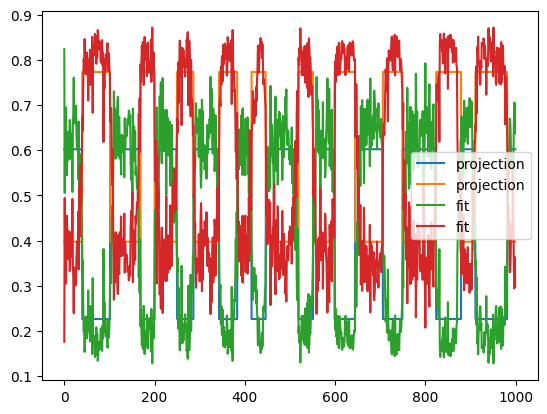

In [153]:
plt.plot(inf_alp_proj[:1000,:],label='projection')
plt.plot(inf_alp[:1000,:],label='fit')
plt.legend()
plt.show()

In [155]:
from osl_dynamics.inference.metrics import twopair_riemannian_distance
from osl_dynamics.inference.modes import hungarian_pair
from osl_dynamics.utils.plotting import plot_mode_pairing

In [217]:
twopair_riemannian_distance(sim_cov,inf_cov)

Computing Riemannian distances: 100%|███████████| 2/2 [00:00<00:00, 3311.73it/s]


array([[0.9886, 2.6462],
       [0.8336, 2.6336]])

In [205]:
sim_cov_proj = []
for i in range(T.shape[0]):  # Loop over rows of T (which correspond to D_i)
    D = np.zeros_like(inf_cov[0])  # Initialize D_i with zeros of the same shape as hat_D_j matrices
    for j in range(T.shape[1]):  # Loop over columns of T (which correspond to hat_D_j)
        D += T[i, j] * inf_cov[j]  # Add the contribution of each hat_D_j scaled by T_ij
    sim_cov_proj.append(D)
sim_cov_proj = np.array(sim_cov_proj)

In [206]:
twopair_riemannian_distance(sim_cov_proj,sim_cov)

Computing Riemannian distances: 100%|███████████| 2/2 [00:00<00:00, 1671.04it/s]


array([[2.3543, 0.6432],
       [0.9019, 0.915 ]])

Calculating riemannian distances


100%|████████████████████████████████████| 2000/2000 [00:00<00:00, 11268.73it/s]

[1.9028 0.5613 1.2675 1.2589 1.2779 0.8371 0.7034 0.9654 1.0581 0.8252
 0.8504 1.0185 1.1648 1.145  0.9632 0.8744 0.8317 1.0394 0.5692 1.1025
 1.2315 1.5688 1.1329 1.2226 1.2613 1.2309 1.2936 1.058  0.9323 0.9097
 0.9465 0.6708 1.1501 0.4733 0.8757 0.4776 0.3039 0.612  0.5537 0.2353
 1.9186 1.7998 2.2026 2.4956 2.4417 2.76   2.575  2.3368 2.5239 2.3275
 2.5809 2.4871 2.4936 2.0669 2.3343 2.396  2.4822 2.6158 2.2192 2.4081
 2.4555 2.4745 2.792  1.9536 2.6768 2.6713 2.5486 2.5508 2.8351 2.6863
 2.7218 2.4465 2.7985 2.5213 2.8929 2.8662 2.6635 2.6219 2.729  2.656
 2.5921 2.4607 2.7137 2.7036 2.7456 2.4225 2.5754 1.7043 2.3684 2.1809
 2.5017 2.3561 2.5544 2.4464 2.5029 2.6603 2.7015 2.3682 2.4488 2.5709]


(<Figure size 1500x150 with 1 Axes>, <Axes: xlabel='Sample', ylabel='$d$'>)

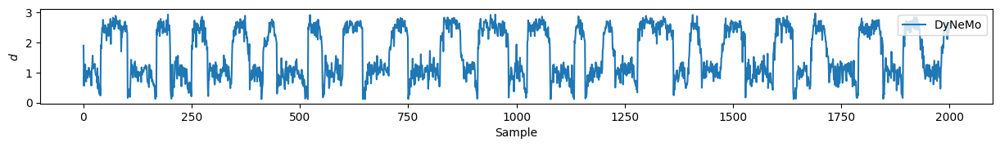

In [161]:
sim_tvcov = np.sum(
    sim_alp[:, :, np.newaxis, np.newaxis] * sim_cov[np.newaxis, :, :, :], axis=1
)
inf_tvcov = np.sum(
    inf_alp[:, :, np.newaxis, np.newaxis] * inf_cov[np.newaxis, :, :, :], axis=1
)

# Calculate the Riemannian distance between the ground truth and inferred covariance
print("Calculating riemannian distances")
rd = np.empty(2000)
for i in trange(2000):
    rd[i] = metrics.riemannian_distance(sim_tvcov[i], inf_tvcov[i])
print(rd[:100])
plotting.plot_line(
    [range(2000)],
    [rd],
    labels=["DyNeMo"],
    x_label="Sample",
    y_label="$d$",
    fig_kwargs={"figsize": (15, 1.5)},
    #filename=f"{save_dir}/plots/rd.png",
)

OK, this seems to work well. In our simple case, you can actually find a linear transformation to make the "transformed" mode covariance match the ground truth covariance. At least the riemannian distance matches the moment-to-moment ones. What about more complex case, such as dynemo soft-mixing?

In [395]:
sim_cov = np.load(f'{save_dir}figures_init/sim_cov.npy')
inf_cov = np.load(f'{save_dir}figures_init/inf_cov.npy')
with open(f'{save_dir}figures_init/sim_alp.pkl', 'rb') as f:
    sim_alp = pickle.load(f)
with open(f'{save_dir}figures_init/inf_alp.pkl', 'rb') as f:
    inf_alp = pickle.load(f)

Calculating riemannian distances


100%|██████████████████████████████████████| 2000/2000 [00:04<00:00, 486.20it/s]

[1.4115 1.3064 1.1852 1.0615 1.0117 0.9677 0.9236 0.8848 0.8681 0.8644
 0.8559 0.8548 0.8866 0.9446 1.0366 1.0458 1.1163 1.1739 1.2438 1.2808
 1.3374 1.3929 1.4468 1.5075 1.5935 1.6321 1.6639 1.6866 1.6986 1.7029
 1.6976 1.6722 1.6236 1.5718 1.5975 1.4683 1.4034 1.368  1.3475 1.2362
 1.1955 1.22   1.1117 1.1146 1.1122 1.1073 1.118  1.1654 1.1466 1.0962
 1.0013 0.9777 0.9661 0.8847 0.8829 1.0301 1.0947 1.3383 1.6192 1.6957
 1.9151 2.0565 2.1267 2.2251 2.0977 1.9988 1.9871 1.844  1.783  1.6052
 1.3038 1.2464 1.0769 1.0162 1.0155 1.0379 1.1123 1.1996 1.2532 1.3191
 1.3812 1.4332 1.4664 1.5157 1.5627 1.6275 1.6388 1.6121 1.6042 1.4684
 1.496  1.2649 1.3074 1.1257 1.0017 0.9554 0.8843 0.8342 0.8145 0.822 ]


(<Figure size 1500x150 with 1 Axes>, <Axes: xlabel='Sample', ylabel='$d$'>)

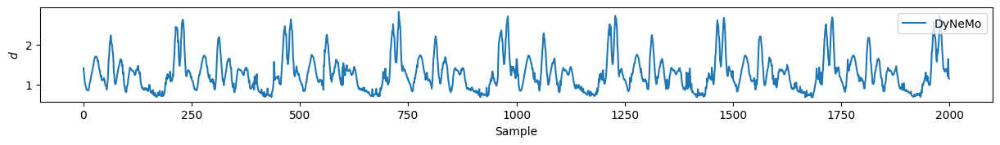

In [396]:
sim_tvcov = np.sum(
    sim_alp[:, :, np.newaxis, np.newaxis] * sim_cov[np.newaxis, :, :, :], axis=1
)
inf_tvcov = np.sum(
    inf_alp[:, :, np.newaxis, np.newaxis] * inf_cov[np.newaxis, :, :, :], axis=1
)

# Calculate the Riemannian distance between the ground truth and inferred covariance
print("Calculating riemannian distances")
rd = np.empty(2000)
for i in trange(2000):
    rd[i] = metrics.riemannian_distance(sim_tvcov[i], inf_tvcov[i])
print(rd[:100])
plotting.plot_line(
    [range(2000)],
    [rd],
    labels=["DyNeMo"],
    x_label="Sample",
    y_label="$d$",
    fig_kwargs={"figsize": (15, 1.5)},
    #filename=f"{save_dir}/plots/rd.png",
)

Computing Riemannian distances: 100%|████████████| 6/6 [00:00<00:00, 142.96it/s]


[[ 1.8598 21.0341 20.2984 20.7507 20.2767 21.0619]
 [20.863   1.5249 20.2879 20.7621 20.5521 20.8518]
 [21.2077 21.2403  5.0399 20.7781 20.8796 20.1466]
 [20.5135 20.7295 19.9561  3.9011 20.0887 20.7144]
 [20.9049 21.0177 19.279  20.7893  5.4256 21.2817]
 [21.0778 21.0983 20.0372 21.0803 20.731   8.9567]]


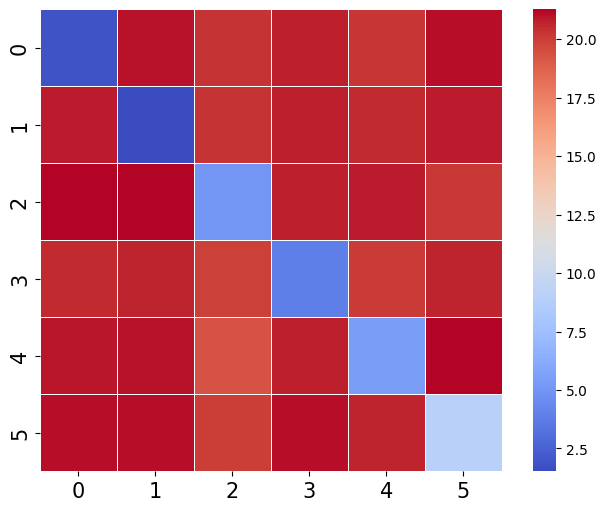

In [398]:
riem = twopair_riemannian_distance(sim_cov + 0.01 * np.eye(80),inf_cov + 0.01 * np.eye(80))
order,riem_reorder = hungarian_pair(riem,distance=True)
plot_mode_pairing(riem_reorder,order)
print(riem_reorder)

Compute twopair Fisher-z transformated correlation: 100%|█| 6/6 [00:00<00:00, 61

[[ 0.9953  0.0195 -0.0072  0.0224  0.0458 -0.0315]
 [ 0.0264  0.9904  0.0056 -0.0022  0.0038  0.0193]
 [-0.0047  0.0107  0.9851  0.0294 -0.0336  0.0787]
 [ 0.0217 -0.0049  0.0182  0.982   0.0219  0.0136]
 [ 0.0237 -0.0012  0.0473  0.0026  0.9697 -0.0236]
 [-0.0351  0.0159  0.009  -0.0059  0.0037  0.9199]]


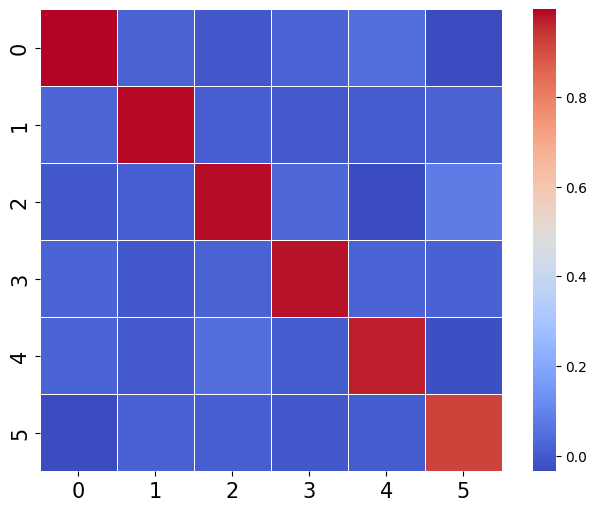

In [399]:
from osl_dynamics.array_ops import cov2stdcorr
from osl_dynamics.inference.metrics import twopair_fisher_z_correlations
_,sim_cor = cov2stdcorr(sim_cov)
_,inf_cor = cov2stdcorr(inf_cov)
fisher_z = twopair_fisher_z_correlations(sim_cor,inf_cor)
order,fisher_z_reorder = hungarian_pair(fisher_z,distance=False)
plot_mode_pairing(fisher_z_reorder,order)
print(fisher_z_reorder)

In [ ]:
riem = twopair_riemannian_distance(sim_cov + 0.1 * np.eye(80),inf_cov + 0.1 * np.eye(80))
order,riem_reorder = hungarian_pair(riem,distance=True)
plot_mode_pairing(riem_reorder,order)
print(riem_reorder)

(<Figure size 1200x250 with 2 Axes>, [<Axes: xlabel='Sample'>])

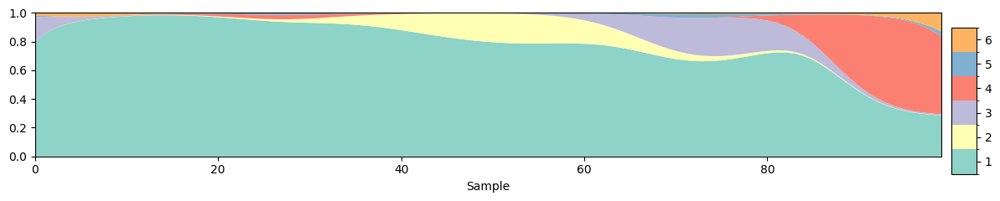

In [284]:
plot_alpha(sim_alp[100:200])

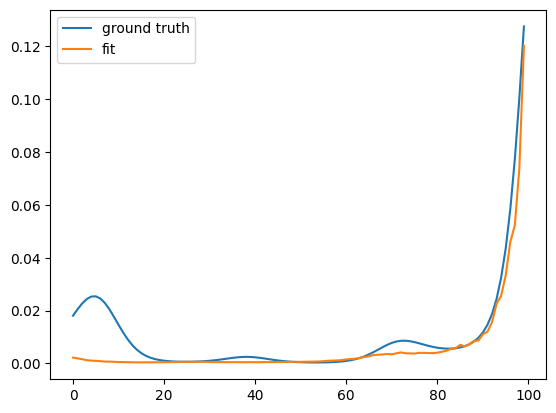

In [291]:
plt.plot(sim_alp[100:200,5],label='ground truth')
plt.plot(inf_alp[100:200,5],label='fit')
plt.legend()
plt.show()

In [428]:
print(metrics.riemannian_distance(sim_cov[1],inf_cov[1]))

5.230648045068932


In [429]:
from scipy.linalg import inv, pinv
def riem_distance(M1,M2):
    eigvals = np.linalg.eigvals(pinv(M1) @ M2)
    #if np.any(eigvals < 0):
    #    eigvals = np.maximum(eigvals, threshold)

    return np.sqrt((np.log(eigvals) ** 2).sum())

In [430]:
print(riem_distance(sim_cov[1],inf_cov[1]))

5.230648045135598


In [424]:
A = np.array([[1, 0.1], [0.1, 0.001]])

# Real inverse
A_inv = inv(A)
print("Real Inverse of A:\n", A_inv)

# Pseudoinverse
A_pinv = pinv(A)
print("Pseudoinverse of A:\n", A_pinv)

Real Inverse of A:
 [[  -0.1111   11.1111]
 [  11.1111 -111.1111]]
Pseudoinverse of A:
 [[  -0.1111   11.1111]
 [  11.1111 -111.1111]]


In [ ]:
sim_tvcov = np.sum(
    sim_alp[:, :, np.newaxis, np.newaxis] * sim_cov[np.newaxis, :, :, :], axis=1
)
inf_tvcov = np.sum(
    inf_alp[:, :, np.newaxis, np.newaxis] * inf_cov[np.newaxis, :, :, :], axis=1
)

In [355]:
print(metrics.riemannian_distance(sim_tvcov[100],inf_tvcov[100]))
print(sim_alp[100,:])
print(inf_alp[100,:])
print(metrics.riemannian_distance(
    sim_alp[100,0]*sim_cov[0] + 0.01 * np.eye(80)#+sim_alp[100,2]*sim_cov[2]#+sim_alp[100,2]*sim_cov[2]+sim_alp[100,3]*sim_cov[3]+sim_alp[100,4]*sim_cov[4]+sim_alp[100,5]*sim_cov[5]
    ,inf_alp[100,0]*inf_cov[0] + 0.01 * np.eye(80)#+sim_alp[100,2]*sim_cov[2]#+inf_alp[100,2]*inf_cov[2]+inf_alp[100,3]*inf_cov[3]+inf_alp[100,4]*inf_cov[4]+inf_alp[100,5]*inf_cov[5]
))
# Calculate log likelihood tomorrow!

0.9481296319951659
[0.8022 0.0005 0.1705 0.001  0.0078 0.0181]
[0.7796 0.0058 0.2076 0.0046 0.0001 0.0022]
1.7369256023555355


[0.563  0.5527 0.7616 0.5588 0.8449 0.586  0.6695 0.751  0.8029 0.592
 0.5782 0.6912 0.6284 0.6257 0.6066 0.7144 0.6909 0.846  0.5612 0.7662
 0.887  0.5984 0.7692 0.6057 0.5515 0.5711 0.8125 0.7526 0.5207 0.5357
 0.5478 0.6501 0.6423 0.6498 0.6889 0.5984 0.598  0.6171 0.5714 0.5966
 0.7267 0.4943 0.4944 0.6148 0.9292 0.7734 0.5709 0.731  0.6615 0.7006
 0.5838 0.5959 0.6287 0.5646 0.7175 0.669  0.5678 0.5247 0.575  0.6652
 0.7172 0.5274 0.6118 0.7403 0.7104 0.5914 0.6485 0.6501 0.5189 0.5104
 0.5333 0.705  0.6108 0.8058 0.636  0.5596 0.6748 0.5969 0.8337 0.7156]


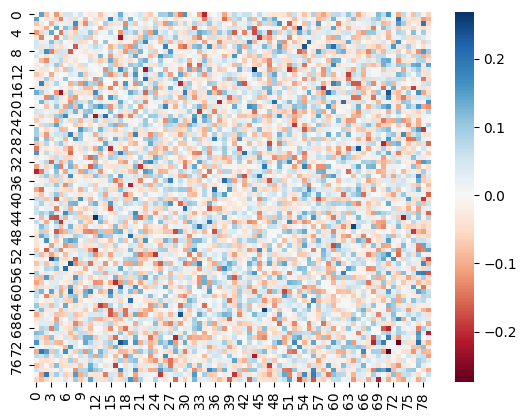

In [358]:
import seaborn as sns
matrix = sim_alp[100,0]*sim_cov[0]
print(np.diagonal(matrix))
np.fill_diagonal(matrix, 0)
sns.heatmap(matrix,cmap='RdBu', center=0)
plt.show()

[0.5405 0.5296 0.7427 0.542  0.802  0.5664 0.6504 0.7195 0.7796 0.5817
 0.5616 0.6812 0.6062 0.5895 0.6017 0.6907 0.6898 0.8114 0.5371 0.7408
 0.8676 0.5868 0.772  0.5585 0.5411 0.5579 0.7771 0.7484 0.5166 0.5429
 0.5437 0.6305 0.6297 0.6253 0.648  0.5787 0.5826 0.6105 0.5369 0.5743
 0.7085 0.4873 0.4715 0.595  0.8671 0.7426 0.5462 0.6866 0.633  0.68
 0.5705 0.5694 0.6372 0.5351 0.6871 0.6618 0.5665 0.5009 0.5678 0.6548
 0.7064 0.5169 0.5858 0.7079 0.6772 0.5746 0.6262 0.6669 0.5036 0.4867
 0.5107 0.7045 0.5773 0.7864 0.6061 0.552  0.6568 0.5831 0.8191 0.6986]


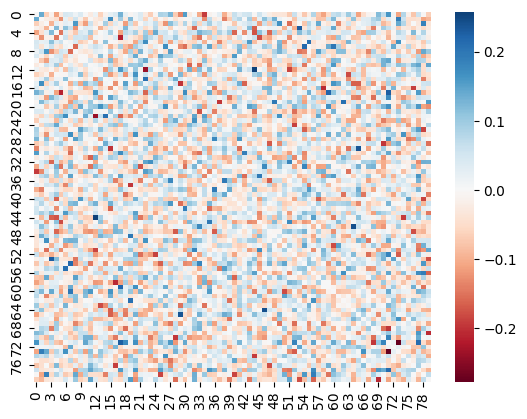

In [359]:
import seaborn as sns
matrix = inf_alp[100,0]*inf_cov[0]
print(np.diagonal(matrix))
np.fill_diagonal(matrix, 0)
sns.heatmap(matrix,cmap='RdBu', center=0)
plt.show()

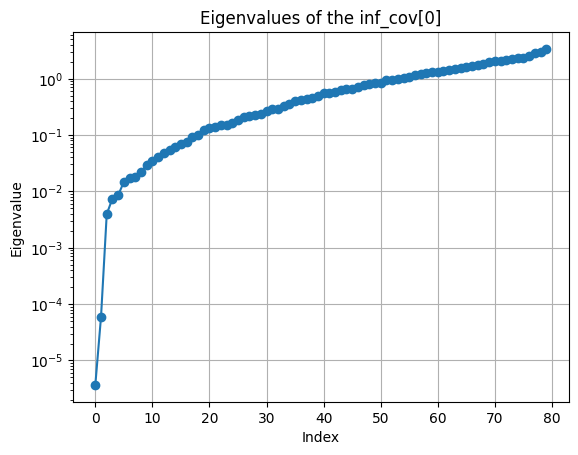

Smallest eigenvalues:
[0.     0.0001 0.004  0.0074 0.0085 0.0148 0.017  0.0183 0.0219 0.0295]


In [403]:
eigenvalues = np.linalg.eigvalsh(inf_cov[0])

# Sort the eigenvalues in ascending order
sorted_eigenvalues = np.sort(eigenvalues)

# Plot the eigenvalues
plt.plot(sorted_eigenvalues, 'o-')
plt.title('Eigenvalues of the inf_cov[0]')
plt.xlabel('Index')
plt.ylabel('Eigenvalue')
plt.yscale('log')  # Use logarithmic scale to highlight small eigenvalues
plt.grid(True)
plt.show()

# Optionally, print out the smallest eigenvalues
print("Smallest eigenvalues:")
print(sorted_eigenvalues[:10])

(<Figure size 1500x150 with 1 Axes>, <Axes: xlabel='Sample', ylabel='$d$'>)

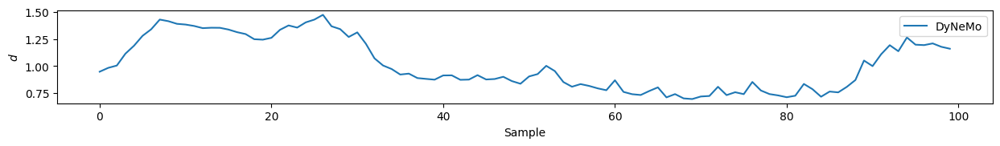

In [354]:
plotting.plot_line(
    [range(100)],
    [rd[100:200]],
    labels=["DyNeMo"],
    x_label="Sample",
    y_label="$d$",
    fig_kwargs={"figsize": (15, 1.5)},
    #filename=f"{save_dir}/plots/rd.png",
)

[[ 0.9994 -0.3752 -0.3487 -0.3029 -0.2772 -0.3107]
 [-0.3663  0.9994 -0.2698 -0.2256 -0.0807 -0.167 ]
 [-0.3572 -0.2699  0.9981 -0.0656 -0.2492  0.0239]
 [-0.2989 -0.2294 -0.0885  0.9982 -0.091  -0.0114]
 [-0.3281 -0.1045 -0.1665 -0.1172  0.9936  0.2229]
 [-0.3199 -0.1609 -0.0354 -0.0128  0.2409  0.9961]]


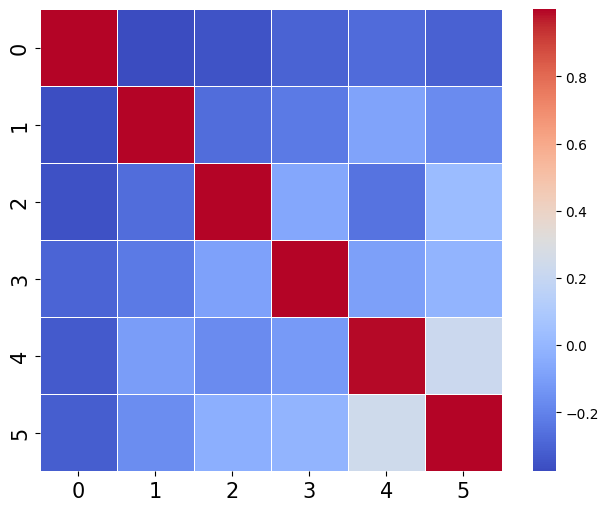

In [316]:
alp_cor = alpha_correlation(sim_alp,inf_alp,return_diagonal=False)
order,alp_cor_reorder = hungarian_pair(alp_cor,distance=False)
plot_mode_pairing(alp_cor_reorder,order)
print(alp_cor_reorder)

In [172]:
T = np.linalg.pinv(sim_alp) @ inf_alp
inf_alp_proj = sim_alp @ T
print(T)

[[ 1.0036 -0.0011  0.0113 -0.0063 -0.0023 -0.0052]
 [ 0.0053  0.998   0.0039  0.0029 -0.0015 -0.0085]
 [ 0.0131  0.0022  1.0435  0.0106 -0.0714  0.002 ]
 [-0.0081  0.006   0.002   1.0103 -0.0002 -0.0101]
 [-0.0265  0.0056  0.0123 -0.0163  1.0369 -0.012 ]
 [-0.0071 -0.0075 -0.0851 -0.0141  0.0196  1.0942]]


In [173]:
alpha_correlation(sim_alp,inf_alp_proj)

array([0.9998, 1.    , 0.9991, 0.9997, 0.9957, 0.9998])

In [174]:
sim_cov_proj = []
for i in range(T.shape[0]):  # Loop over rows of T (which correspond to D_i)
    D = np.zeros_like(inf_cov[0])  # Initialize D_i with zeros of the same shape as hat_D_j matrices
    for j in range(T.shape[1]):  # Loop over columns of T (which correspond to hat_D_j)
        D += T[i, j] * inf_cov[j]  # Add the contribution of each hat_D_j scaled by T_ij
    sim_cov_proj.append(D)
sim_cov_proj = np.array(sim_cov_proj)

In [175]:
twopair_riemannian_distance(sim_cov_proj,sim_cov)

Computing Riemannian distances: 100%|████████████| 6/6 [00:00<00:00, 159.24it/s]


array([[ 9.0006, 27.8402, 27.1458, 26.2385, 28.0442, 26.8951],
       [27.2593,  6.057 , 26.4089, 25.4138, 27.1104, 26.0559],
       [29.6384, 29.4491, 16.9121, 27.893 , 29.5766, 28.1459],
       [29.0459, 28.6598, 27.9428, 15.1564, 28.8195, 27.911 ],
       [31.1369, 30.8079, 30.2905, 29.4272, 20.414 , 29.8544],
       [33.6214, 33.282 , 32.5278, 31.9813, 33.4337, 25.429 ]])

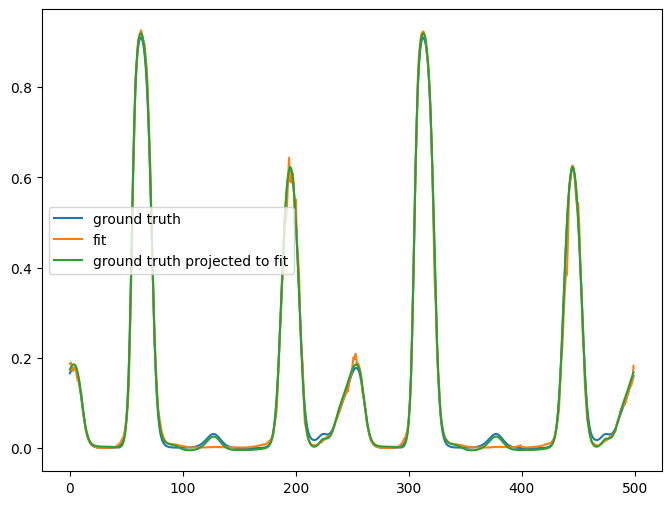

In [188]:
plt.figure(figsize=(8, 6))
plt.plot(sim_alp[:500,3],label='ground truth')
plt.plot(inf_alp[:500,3],label='fit')
plt.plot(inf_alp_proj[:500,3],label='ground truth projected to fit')
plt.legend()
plt.show()

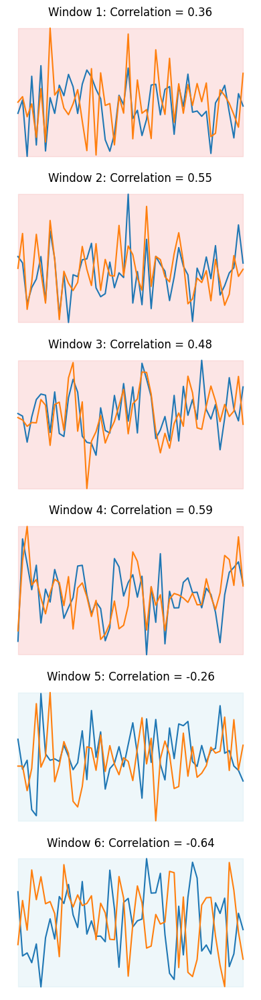

In [235]:
# Define the two covariance matrices
cov1 = np.array([[1.0, 0.5], [0.5, 1.0]])
cov2 = np.array([[1.0, -0.5], [-0.5, 1.0]])

# Generate random data from the two covariance matrices
data1 = np.random.multivariate_normal(np.zeros(2), cov1, size=50 * 4)
data2 = np.random.multivariate_normal(np.zeros(2), cov2, size=50 * 2)

# Combine the data
data = np.concatenate([data1, data2])

# Define the sliding window size
window_size = 50

# Function to calculate correlation for a window
def calculate_correlation(window):
    return np.corrcoef(window[:, 0], window[:, 1])[0, 1]

# Create a list to store correlations
correlations = []

# Iterate over the data in sliding windows
for i in range(0, len(data) - window_size + 1, window_size):
    window = data[i:i+window_size]
    correlation = calculate_correlation(window)
    correlations.append(correlation)

# Create a figure with subplots
fig, axes = plt.subplots(nrows=int(np.ceil(len(data) / window_size)), figsize=(4, 15))

# Iterate over the data in sliding windows and create subplots
for i in range(0, len(data) - window_size + 1, window_size):
    window = data[i:i+window_size]
    correlation = calculate_correlation(window)

    # Determine the color based on correlation
    # ... (same as before)
    # Determine the color based on correlation
    if correlation < 0.25:
        color = 'lightblue'
    elif correlation > -0.25:
        color = 'lightcoral'
    else:
        color = 'white'

    # Get the current axis for the subplot
    ax = axes.flatten()[i // window_size]

    # Plot the window data
    ax.plot(window)

    # Fill the background from bottom to top
    ax.fill_between(range(window_size), window.min(), window.max(), color=color, alpha=0.2)

    # Set subplot title and axis labels
    ax.set_title(f"Window {i//50+1}: Correlation = {correlation:.2f}")
    #ax.set_xlabel("Time")
    #ax.set_ylabel("Value")
    # Disable frame
    ax.axis('off')

plt.tight_layout()
plt.show()

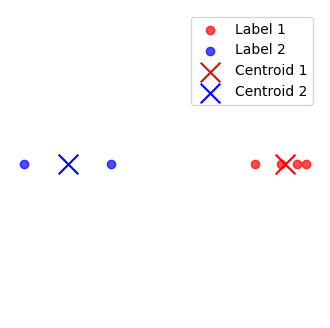

In [250]:
# Assuming you have the data for windows 1 to 6 stored in a list
window_data = correlations

# Initial labels
labels = [1, 1, 1, 1, 2, 2]

# Extract data for each label
data_label1 = [window for window, label in zip(window_data, labels) if label == 1]
data_label2 = [window for window, label in zip(window_data, labels) if label == 2]

# Calculate centroids
centroid_label1 = np.mean(data_label1, axis=0)
centroid_label2 = np.mean(data_label2, axis=0)

# Plot the data and centroids
plt.figure(figsize=(4, 4))
plt.scatter(data_label1,np.zeros(4), label='Label 1', color='red',marker='o', alpha=0.7)  # Plot data for label 1
plt.scatter(data_label2,np.zeros(2), label='Label 2', color='blue',marker='o', alpha=0.7)  # Plot data for label 2
plt.scatter([centroid_label1], [0], marker='x', color='red', s=200, label='Centroid 1')  # Plot centroid for label 1
plt.scatter([centroid_label2], [0], marker='x', color='blue', s=200, label='Centroid 2')  # Plot centroid for label 2
plt.xlabel("Window Value")  # Update x-axis label
#plt.ylabel("Count")  # Add y-axis label (optional, depending on data structure)
#plt.title("K-means Clustering in 1D")
plt.legend()  # Add legend to identify data points and centroids
plt.axis('off')
plt.show()

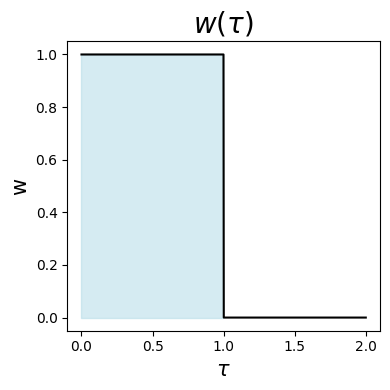

In [253]:
# Define the function parameters
Delta_T = 1  # Adjust as needed

# Create the x-axis values
tau = np.linspace(0, 2 * Delta_T, 1000)

# Calculate the function values
w = np.where(tau <= Delta_T, 1, 0)

# Plot the function
plt.figure(figsize=(4, 4))
plt.plot(tau, w, color='black')

# Fill the region below the function for tau <= Delta_T
plt.fill_between(tau[tau <= Delta_T], w[tau <= Delta_T], color='lightblue', alpha=0.5)

# Set labels and title
plt.xlabel(r'$\tau$',fontsize=15)
plt.ylabel('w',fontsize=15)
plt.title(r'$w(\tau)$',fontsize=20)

plt.grid(False)
plt.tight_layout()
plt.show()

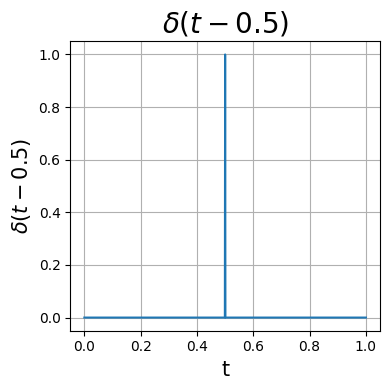

In [266]:
# Define the function parameters
Delta_t = 0.5
sigma = 0.0001  # Adjust the standard deviation for the Gaussian approximation

# Create the time axis
t = np.linspace(0.0, 1.0, 1001)

# Calculate the Gaussian approximation of the delta function
delta = np.exp(-(t - Delta_t)**2 / (2 * sigma**2))
# Plot the delta function
plt.figure(figsize=(4, 4))
plt.plot(t, delta)

# Set labels and title
plt.xlabel('t',fontsize=15)
plt.ylabel(r'$\delta(t-0.5)$',fontsize=15)
plt.title(r'$\delta(t-0.5)$',fontsize=20)

plt.grid(True)
plt.tight_layout()
plt.show()

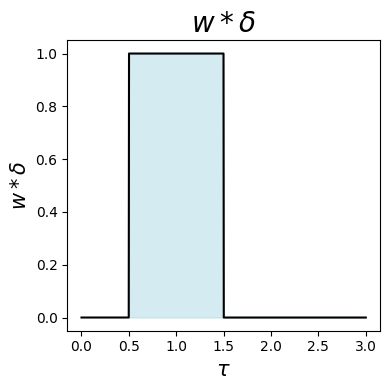

In [269]:
# Define the function parameters
Delta_T1 = 0.5  # Lower bound of the interval where w = 1
Delta_T2 = 1.5  # Upper bound of the interval where w = 1

# Create the x-axis values
tau = np.linspace(0, 2 * Delta_T2, 1000)  # Extend range to accommodate Delta_T2

# Calculate the function values
w = np.where((tau >= Delta_T1) & (tau <= Delta_T2), 1, 0)

# Plot the function
plt.figure(figsize=(4, 4))
plt.plot(tau, w, color='black')

# Fill the region below the function for tau in the interval
plt.fill_between(tau[tau >= Delta_T1], w[tau >= Delta_T1], color='lightblue', alpha=0.5)

# Set labels and title with larger font sizes
plt.xlabel(r'$\tau$', fontsize=15)
plt.ylabel(r'$w*\delta$', fontsize=15)
plt.title(r'$w*\delta$', fontsize=20)

# Remove grid lines and adjust layout
plt.grid(False)
plt.tight_layout()
plt.show()

## Update 3th Sept 2024

Check the eigenvalue distribution back in HMM.

In [431]:
import numpy as np
import scipy.linalg
import matplotlib.pyplot as plt
%matplotlib inline

In [432]:
cov_random = np.load('data/node_timeseries/simulation_bicv/random/truth/state_covariances.npy')
cov_real = np.load('data/node_timeseries/simulation_bicv/real/truth/state_covariances.npy')

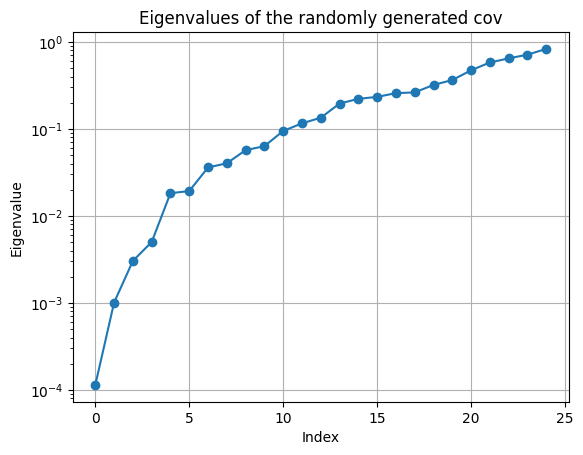

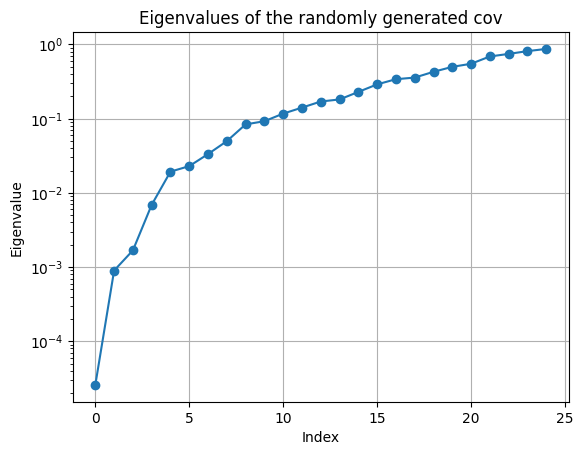

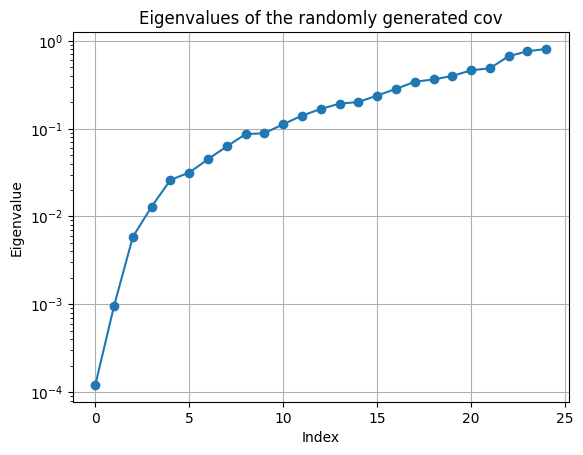

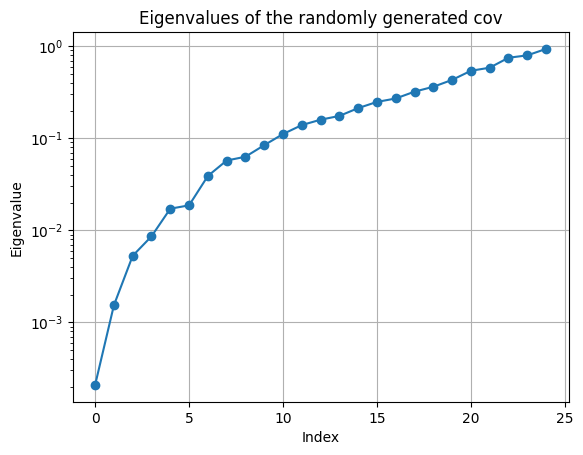

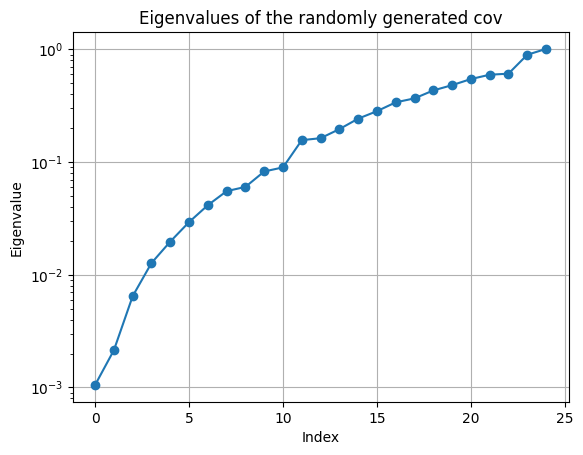

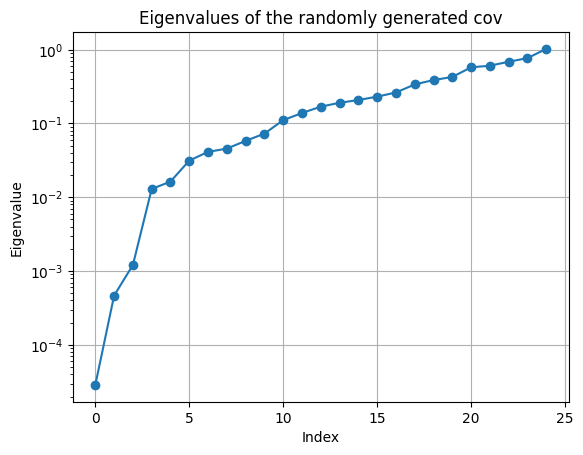

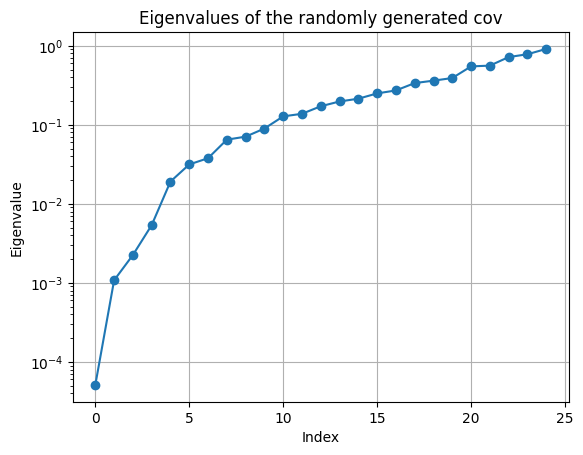

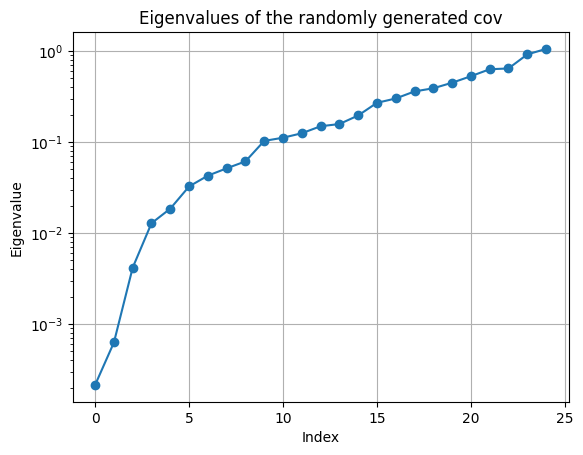

In [434]:
# Deal with the randomly generated covariance matrices
for i in range(len(cov_random)):
    sorted_eigenvalues = np.sort(np.linalg.eigvalsh(cov_random[i]))
    # Plot the eigenvalues
    plt.plot(sorted_eigenvalues, 'o-')
    plt.title('Eigenvalues of the randomly generated cov')
    plt.xlabel('Index')
    plt.ylabel('Eigenvalue')
    plt.yscale('log')  # Use logarithmic scale to highlight small eigenvalues
    plt.grid(True)
    plt.show()

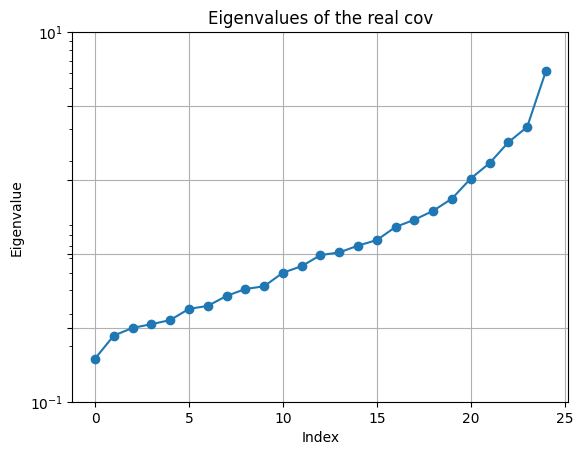

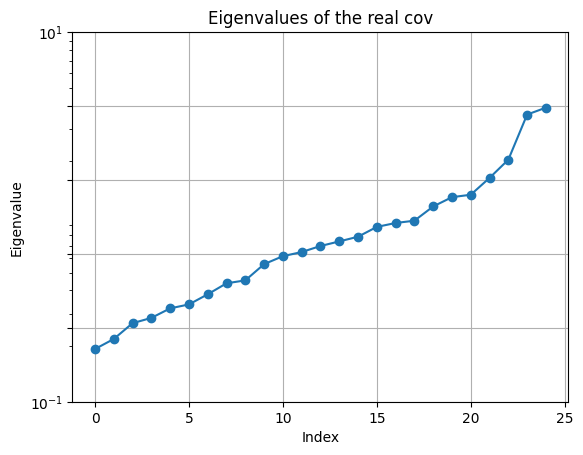

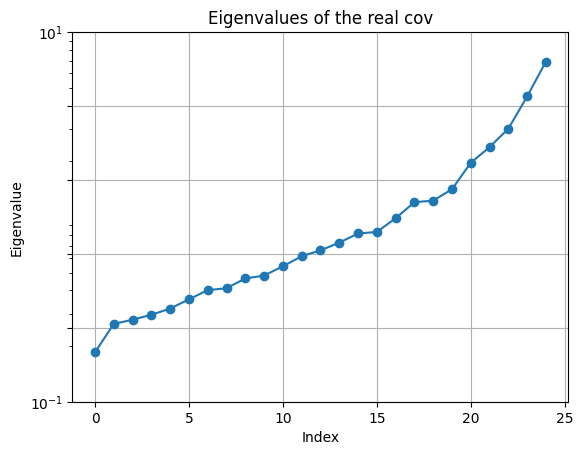

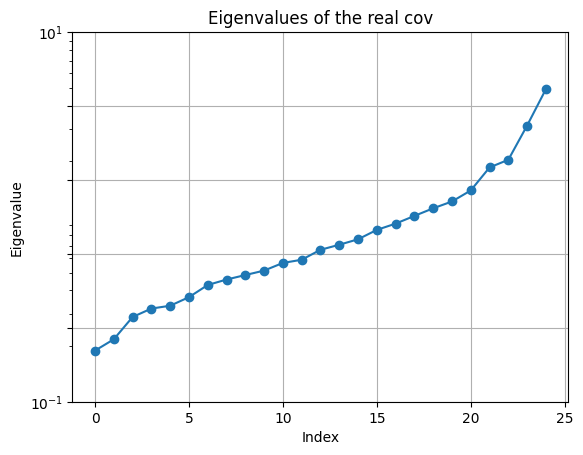

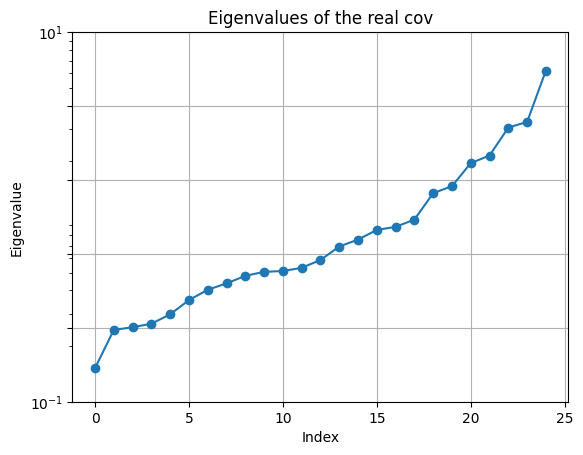

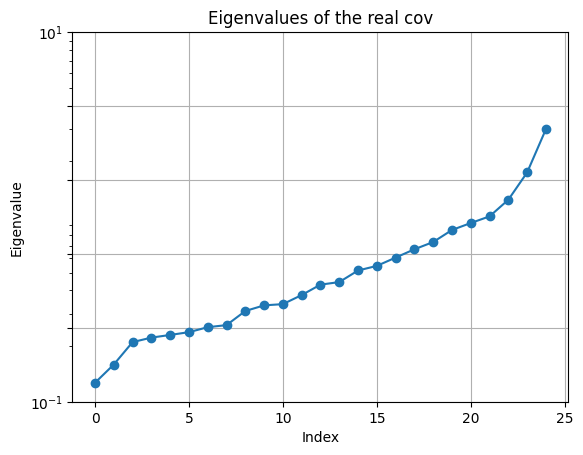

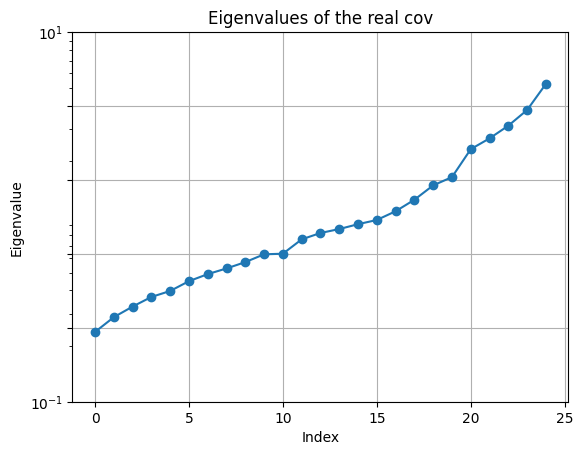

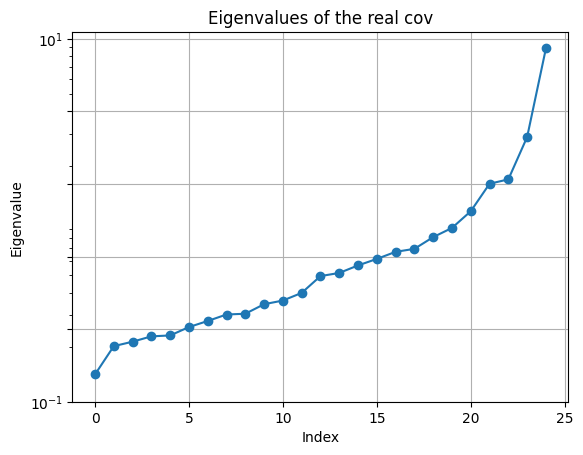

In [440]:
# Deal with the randomly generated covariance matrices
for i in range(len(cov_real)):
    sorted_eigenvalues = np.sort(np.linalg.eigvalsh(cov_real[i]))
    # Plot the eigenvalues
    plt.plot(sorted_eigenvalues, 'o-')
    plt.title('Eigenvalues of the real cov')
    plt.xlabel('Index')
    plt.ylabel('Eigenvalue')
    plt.yscale('log')  # Use logarithmic scale to highlight small eigenvalues
    
    y_ticks = np.logspace(np.floor(np.log10(sorted_eigenvalues.min())),
                          np.ceil(np.log10(sorted_eigenvalues.max())), num=6
                         )
    plt.yticks(y_ticks)
    plt.grid(True)
    plt.show()

## Update 7th September 2024

Transfer report figure 8: Plot fractional occupancy of HMM best model oN ICA 50 (N_states=7).

In [35]:
import os
import pickle
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from osl_dynamics.inference.modes import argmax_time_courses,fractional_occupancies
from osl_dynamics.array_ops import get_one_hot

### Figure 8A: HMM fractional occupancy analysis

In [32]:
save_dir = './results_HCP_bicv_202404/var_1/ICA_50_check/hmm_ICA_50_state_7/repeat_1/inf_params/'
analysis_dir = './results_HCP_bicv_202404/var_1/ICA_50_check/hmm_ICA_50_state_7/analysis/'
if not os.path.exists(analysis_dir):
    os.makedirs(analysis_dir)
with open(f'{save_dir}alp.pkl', 'rb') as file:
    alpha = pickle.load(file)
stc = argmax_time_courses(alpha)
fo = fractional_occupancies(stc)

In [34]:
# Assuming 'fo' is your numpy array with shape (1003, 7)
# Sort each row so that the columns correspond to the least to most visited states
sorted_fo = np.sort(fo, axis=1)

# Plot histograms for each column in a 4x3 grid (2 rows, 4 columns)
fig, axes = plt.subplots(2, 4, figsize=(15, 7))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Plot histograms for each column
num_columns = sorted_fo.shape[1]
titles = ["1st least visited",
          "2nd least visited",
          "3rd least visited",
          "4th least visited",
          "5th least visited",
          "6th least visited",
          "7th least visited",
          "8th least visited"]

for i in range(num_columns):
    axes[i].hist(sorted_fo[:, i], bins=20, color='blue', alpha=0.7)
    
    # Set the title with a more descriptive label
    axes[i].set_title(titles[i], fontsize=20)
    
    # Set the x and y labels with specified fontsize
    axes[i].set_xlabel('Fractional Occupancy', fontsize=20)
    axes[i].set_ylabel(r'$N_{subjects}$', fontsize=20)
    
    # Set the fontsize for xticks and yticks
    axes[i].tick_params(axis='both', which='major', labelsize=15)

# Hide the unused subplot
for j in range(num_columns, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.savefig(f'{analysis_dir}/fo.svg')
plt.savefig(f'{analysis_dir}/fo.pdf')
plt.close()

### Figure 8B: DyNeMo fractional occupancy analysis

Attention: You need to normalise alpha here!

In [49]:
save_dir = './results_HCP_bicv_202407/ICA_50/dynemo_check/dynemo_ICA_50_state_8/repeat_1/inf_params/'
analysis_dir = './results_HCP_bicv_202407/ICA_50/dynemo_check/dynemo_ICA_50_state_8/analysis/'
if not os.path.exists(analysis_dir):
    os.makedirs(analysis_dir)
with open(f'{save_dir}alp.pkl', 'rb') as file:
    alpha = pickle.load(file)
# Read in covariance matrices
covs = np.load(f'{save_dir}/covs.npy')

In [50]:
def normalize_alpha(a:np.ndarray, D:np.ndarray) -> np.ndarray:
    """
    Calculate the weighting for each mode
    measured by the trace of each mode covariance
    Parameters
    ----------
    a: (np.ndarray) N_time_points * N_states
    D: (np.ndarray) covariance matrices N_states * N_channels * N_channels

    Returns
    -------
    wa: (np.ndarray) weighted alpha, having the shape as a
    """
    # Calculate the weighting for each mode
    # We use the trace of each mode covariance
    w = np.trace(D, axis1=1, axis2=2)

    # Weight the alphas
    wa = w[np.newaxis, ...] * a

    # Renormalize so the alphas sum to one
    wa /= np.sum(wa, axis=1, keepdims=True)
    return wa
    
# Renormalize the mixing coefficients
norm_alpha = [normalize_alpha(a, covs) for a in alpha]
mean_norm_alpha = np.array([np.mean(a, axis=0) for a in norm_alpha])

In [51]:
# Plot histograms for each column in a 4x3 grid (2 rows, 4 columns)
fig, axes = plt.subplots(2, 4, figsize=(15, 7))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Plot histograms for each column
num_columns = mean_norm_alpha.shape[1]

for i in range(num_columns):
    axes[i].hist(mean_norm_alpha[:, i], color='blue', alpha=0.7)
    
    # Set the title with a more descriptive label
    axes[i].set_title(f'Mode {i+1}', fontsize=20)
    
    # Set the x and y labels with specified fontsize
    axes[i].set_xlabel(r'$\alpha_{mean}$', fontsize=20)
    axes[i].set_ylabel(r'$N_{subjects}$', fontsize=20)
    
    # Set the fontsize for xticks and yticks
    axes[i].tick_params(axis='both', which='major', labelsize=15)

# Hide the unused subplot
for j in range(num_columns, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.savefig(f'{analysis_dir}/fo.svg')
plt.savefig(f'{analysis_dir}/fo.pdf')
plt.close()

### Figure 8C: SWC fractional occupancy analysis

In [36]:
save_dir = './results_HCP_bicv_202407/ICA_50/swc_check/100_100/swc_ICA_50_state_7/repeat_1/inf_params/'
analysis_dir = './results_HCP_bicv_202407/ICA_50/swc_check/100_100/swc_ICA_50_state_7/analysis/'
if not os.path.exists(analysis_dir):
    os.makedirs(analysis_dir)
with open(f'{save_dir}alp.pkl', 'rb') as file:
    alpha = pickle.load(file)
alpha = get_one_hot(alpha,n_states=7)
stc = argmax_time_courses(alpha)
fo = fractional_occupancies(stc)

In [38]:
# Assuming 'fo' is your numpy array with shape (1003, 7)
# Sort each row so that the columns correspond to the least to most visited states
sorted_fo = np.sort(fo, axis=1)

# Plot histograms for each column in a 4x3 grid (2 rows, 4 columns)
fig, axes = plt.subplots(2, 4, figsize=(15, 7))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Plot histograms for each column
num_columns = sorted_fo.shape[1]
titles = ["1st least visited",
          "2nd least visited",
          "3rd least visited",
          "4th least visited",
          "5th least visited",
          "6th least visited",
          "7th least visited",
          "8th least visited"]

for i in range(num_columns):
    axes[i].hist(sorted_fo[:, i], color='blue', alpha=0.7)
    
    # Set the title with a more descriptive label
    axes[i].set_title(titles[i], fontsize=20)
    
    # Set the x and y labels with specified fontsize
    axes[i].set_xlabel('Fractional Occupancy', fontsize=20)
    axes[i].set_ylabel(r'$N_{subjects}$', fontsize=20)
    
    # Set the fontsize for xticks and yticks
    axes[i].tick_params(axis='both', which='major', labelsize=15)

# Hide the unused subplot
for j in range(num_columns, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.savefig(f'{analysis_dir}/fo.svg')
plt.savefig(f'{analysis_dir}/fo.pdf')
plt.close()

### Figure 4: Sanity check of simulation results

In [1]:
import os
import numpy as np
import seaborn as sns
import json
import pickle
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
from osl_dynamics.inference.metrics import alpha_correlation, twopair_riemannian_distance
from osl_dynamics.inference.modes import hungarian_pair
from osl_dynamics.utils.plotting import plot_mode_pairing,create_figure,save
from osl_dynamics.utils.misc import override_dict_defaults

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [9]:
def plot_mode_no_pairing(
        metrics,
        x_label=None,
        y_label=None,
        title=None,
        fig_kwargs=None,
        sns_kwargs=None,
        ax=None,
        filename=None,

):
    """
    Plot the states/modes pairing using the metrics
    Parameters
    ----------
    metrics: np.ndarray
        measure the similarity/distance between states/modes.
    x_label : str, optional
        Label for x-axis.
    y_label : str, optional
        Label for y-axis.
    title : str, optional
        Figure title.
    fig_kwargs : dict, optional
        Arguments to pass to :code:`plt.subplots()`.
    sns_kwargs : dict, optional
        Arguments to pass to :code:`sns.heatmap()`.
    ax : matplotlib.axes.axes, optional
        Axis object to plot on.
    filename : str, optional
        Output filename.

    Returns
    -------
    fig : plt.figure
        Matplotlib figure object. Only returned if :code:`ax=None` and
        :code:`filename=None`.
    ax : plt.axes
        Matplotlib axis object(s). Only returned if :code:`ax=None` and
        :code:`filename=None`.
    """

    # Validation
    if ax is not None:
        if filename is not None:
            raise ValueError(
                "Please use plotting.save() to save the figure instead of the "
                + "filename argument."
            )
        if isinstance(ax, np.ndarray):
            raise ValueError("Only pass one axis.")

    if fig_kwargs is None:
        fig_kwargs = {}
    default_fig_kwargs = {"figsize": (8, 6),
                          # "xtick.labelsize": 13,
                          # "ytick.labelsize": 13,
                          }
    fig_kwargs = override_dict_defaults(default_fig_kwargs, fig_kwargs)

    if sns_kwargs is None:
        sns_kwargs = {}
    default_sns_kwargs = {#"font_scale": 1.2,
        "cmap": "coolwarm",
        "square": True,
        "linewidths": 0.5,
        #"cbar_kws": {"shrink": 0.75,},
        "fmt": ".2f"
    }
    sns_kwargs = override_dict_defaults(default_sns_kwargs, sns_kwargs)
    # Set up the figure and axis

    # Create figure
    create_fig = ax is None
    if create_fig:
        fig, ax = create_figure(**fig_kwargs)

    # Create a heatmap of the correlation matrix
    ax = sns.heatmap(data=metrics, ax=ax, **sns_kwargs)
    # Set xticks and yticks
    ax.set_xticks(np.arange(metrics.shape[1]) + 0.5, np.arange(metrics.shape[1]), fontsize=18)
    ax.set_yticks(np.arange(metrics.shape[0]) + 0.5, np.arange(metrics.shape[0]), fontsize=18)

    # Set title and axis labels
    ax.set_title(title, fontsize=20)
    ax.set_xlabel(x_label, fontsize=20)
    ax.set_ylabel(y_label, fontsize=20)
    
    cbar = ax.collections[0].colorbar
    cbar.ax.tick_params(labelsize=18)  # Set colorbar tick label font size

    # Save the figure if a filename has been pass
    if filename is not None:
        save(fig, filename, tight_layout=True)
    elif create_fig:
        return fig, ax


#### Figure 4A: HMM analysis. Model fitting with 4, 8 and 16 states. (The ground_truth is 8 states).

In [4]:
root_dir = './results_simulation_bicv_202407/real/hmm/'
truth_dir = './data/node_timeseries/simulation_bicv/real/truth/'
plot_dir = f'{root_dir}/analysis/'
if not os.path.exists(plot_dir):
    os.makedirs(plot_dir)

##### Case 1: 4 states

In [5]:
n_states = 4
analyse_dir = f'{root_dir}/hmm_ICA_25_state_{n_states}/cv_1/fold_1_1/'
with open(f'{analyse_dir}/fold_indices.json','r') as file:
    fold_indices = json.load(file)
ground_truth_cov = np.load(f'{truth_dir}/state_covariances.npy')
Y_test_cov = np.load(f'{analyse_dir}/Y_train/inf_params/covs.npy')
riem = twopair_riemannian_distance(ground_truth_cov[:, fold_indices['column_Y'], :][:, :, fold_indices['column_Y']],Y_test_cov)

# Plot mode but no pairing
plot_mode_no_pairing(riem,x_label='fit',y_label='ground_truth',title='Y_test spatial',filename=f'{plot_dir}/state_{n_states}_Y_test_spatial.svg')

Computing Riemannian distances: 100%|█████████████| 8/8 [00:00<00:00, 88.63it/s]
2024-09-10 22:40:00 INFO osl-dynamics [plotting.py:104:save]: Saving ./results_simulation_bicv_202407/real/hmm//analysis//state_4_Y_test_spatial.svg


In [6]:
with open(f'{analyse_dir}/Y_test/inf_params/alp.pkl','rb') as file:
    alpha_fit = pickle.load(file)
alpha_truth = []
for index in fold_indices['row_test']:
    alpha_truth.append(np.load(f'{truth_dir}/{10001+index}_state_time_course.npy'))
alpha_cor = alpha_correlation(alpha_truth,alpha_fit,return_diagonal=False)
plot_mode_no_pairing(alpha_cor,x_label='fit',y_label='ground_truth',title='Y_test temporal',filename=f'{plot_dir}/state_{n_states}_Y_test_temporal.svg')

2024-09-10 22:40:15 INFO osl-dynamics [plotting.py:104:save]: Saving ./results_simulation_bicv_202407/real/hmm//analysis//state_4_Y_test_temporal.svg


##### Case 2: 8 states

In [7]:
n_states = 8
analyse_dir = f'{root_dir}/hmm_ICA_25_state_{n_states}/cv_1/fold_1_1/'
with open(f'{analyse_dir}/fold_indices.json','r') as file:
    fold_indices = json.load(file)
ground_truth_cov = np.load(f'{truth_dir}/state_covariances.npy')
Y_test_cov = np.load(f'{analyse_dir}/Y_train/inf_params/covs.npy')
riem = twopair_riemannian_distance(ground_truth_cov[:, fold_indices['column_Y'], :][:, :, fold_indices['column_Y']],Y_test_cov)

order,riem_reorder = hungarian_pair(riem,distance=True)
# Plot mode pairing
plot_mode_pairing(riem_reorder,x_label='fit',y_label='ground_truth',title='Y_test spatial',filename=f'{plot_dir}/state_{n_states}_Y_test_spatial.svg')

Computing Riemannian distances: 100%|███████████| 8/8 [00:00<00:00, 1497.56it/s]
2024-09-10 22:40:57 INFO osl-dynamics [plotting.py:104:save]: Saving ./results_simulation_bicv_202407/real/hmm//analysis//state_8_Y_test_spatial.svg


In [8]:
with open(f'{analyse_dir}/Y_test/inf_params/alp.pkl','rb') as file:
    alpha_fit = pickle.load(file)
alpha_truth = []
for index in fold_indices['row_test']:
    alpha_truth.append(np.load(f'{truth_dir}/{10001+index}_state_time_course.npy'))
alpha_cor = alpha_correlation(alpha_truth,alpha_fit,return_diagonal=False)
order,alpha_cor_reorder = hungarian_pair(alpha_cor,distance=False)
plot_mode_pairing(alpha_cor_reorder,x_label='fit',y_label='ground_truth',title='Y_test temporal',filename=f'{plot_dir}/state_{n_states}_Y_test_temporal.svg')

2024-09-10 22:42:11 INFO osl-dynamics [plotting.py:104:save]: Saving ./results_simulation_bicv_202407/real/hmm//analysis//state_8_Y_test_temporal.svg


##### Case 3: 16 states

In [9]:
n_states = 16
analyse_dir = f'{root_dir}/hmm_ICA_25_state_{n_states}/cv_1/fold_1_1/'
with open(f'{analyse_dir}/fold_indices.json','r') as file:
    fold_indices = json.load(file)
ground_truth_cov = np.load(f'{truth_dir}/state_covariances.npy')
Y_test_cov = np.load(f'{analyse_dir}/Y_train/inf_params/covs.npy')
riem = twopair_riemannian_distance(ground_truth_cov[:, fold_indices['column_Y'], :][:, :, fold_indices['column_Y']],Y_test_cov)

# Plot mode but no pairing
plot_mode_no_pairing(riem,x_label='fit',y_label='ground_truth',title='Y_test spatial',filename=f'{plot_dir}/state_{n_states}_Y_test_spatial.svg')

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 313.99it/s]
2024-09-10 22:44:46 INFO osl-dynamics [plotting.py:104:save]: Saving ./results_simulation_bicv_202407/real/hmm//analysis//state_16_Y_test_spatial.svg


In [10]:
with open(f'{analyse_dir}/Y_test/inf_params/alp.pkl','rb') as file:
    alpha_fit = pickle.load(file)
alpha_truth = []
for index in fold_indices['row_test']:
    alpha_truth.append(np.load(f'{truth_dir}/{10001+index}_state_time_course.npy'))
alpha_cor = alpha_correlation(alpha_truth,alpha_fit,return_diagonal=False)
plot_mode_no_pairing(alpha_cor,x_label='fit',y_label='ground_truth',title='Y_test temporal',filename=f'{plot_dir}/state_{n_states}_Y_test_temporal.svg')

2024-09-10 22:45:18 INFO osl-dynamics [plotting.py:104:save]: Saving ./results_simulation_bicv_202407/real/hmm//analysis//state_16_Y_test_temporal.svg


#### Figure 4B: DyNeMo analysis. Model fitting with 4,6,8 and 16 modes. (The ground_truth is 8 modes).

In [12]:
root_dir = './results_simulation_bicv_202407/random_dynemo/dynemo/'
truth_dir = './data/node_timeseries/simulation_bicv/random_dynemo/truth/'
plot_dir = f'{root_dir}/analysis/'
if not os.path.exists(plot_dir):
    os.makedirs(plot_dir)

##### Case 1: 4 modes

In [14]:
n_states = 4
analyse_dir = f'{root_dir}/dynemo_ICA_50_state_{n_states}/cv_1/fold_1_1/'
with open(f'{analyse_dir}/fold_indices.json','r') as file:
    fold_indices = json.load(file)
ground_truth_cov = np.load(f'{truth_dir}/state_covariances.npy')
Y_test_cov = np.load(f'{analyse_dir}/Y_train/inf_params/covs.npy')
riem = twopair_riemannian_distance(ground_truth_cov[:, fold_indices['column_Y'], :][:, :, fold_indices['column_Y']],Y_test_cov)

# Plot mode but no pairing
plot_mode_no_pairing(riem,x_label='fit',y_label='ground_truth',title='Y_test spatial',filename=f'{plot_dir}/state_{n_states}_Y_test_spatial.svg')

Computing Riemannian distances: 100%|███████████| 6/6 [00:00<00:00, 1858.08it/s]
2024-09-10 22:50:47 INFO osl-dynamics [plotting.py:104:save]: Saving ./results_simulation_bicv_202407/random_dynemo/dynemo//analysis//state_4_Y_test_spatial.svg


In [16]:
with open(f'{analyse_dir}/Y_test/inf_params/alp.pkl','rb') as file:
    alpha_fit = pickle.load(file)
alpha_truth = []
for index in fold_indices['row_test']:
    alpha_truth.append(np.load(f'{truth_dir}/{10001+index}_mode_time_course.npy'))
alpha_cor = alpha_correlation(alpha_truth,alpha_fit,return_diagonal=False)
plot_mode_no_pairing(alpha_cor,x_label='fit',y_label='ground_truth',title='Y_test temporal',filename=f'{plot_dir}/state_{n_states}_Y_test_temporal.svg')

2024-09-10 22:52:43 INFO osl-dynamics [plotting.py:104:save]: Saving ./results_simulation_bicv_202407/random_dynemo/dynemo//analysis//state_4_Y_test_temporal.svg


##### Case 2: 6 modes

In [22]:
n_states = 6
analyse_dir = f'{root_dir}/dynemo_ICA_50_state_{n_states}/cv_1/fold_1_1/'
with open(f'{analyse_dir}/fold_indices.json','r') as file:
    fold_indices = json.load(file)
ground_truth_cov = np.load(f'{truth_dir}/state_covariances.npy')
Y_test_cov = np.load(f'{analyse_dir}/Y_train/inf_params/covs.npy')
riem = twopair_riemannian_distance(ground_truth_cov[:, fold_indices['column_Y'], :][:, :, fold_indices['column_Y']],Y_test_cov)

order,riem_reorder = hungarian_pair(riem,distance=True)
# Plot mode pairing
plot_mode_pairing(riem_reorder,x_label='fit',y_label='ground_truth',title='Y_test spatial',filename=f'{plot_dir}/state_{n_states}_Y_test_spatial.svg')

Computing Riemannian distances: 100%|███████████| 6/6 [00:00<00:00, 1279.73it/s]
2024-09-10 22:57:22 INFO osl-dynamics [plotting.py:104:save]: Saving ./results_simulation_bicv_202407/random_dynemo/dynemo//analysis//state_6_Y_test_spatial.svg


In [23]:
with open(f'{analyse_dir}/Y_test/inf_params/alp.pkl','rb') as file:
    alpha_fit = pickle.load(file)
alpha_truth = []
for index in fold_indices['row_test']:
    alpha_truth.append(np.load(f'{truth_dir}/{10001+index}_mode_time_course.npy'))
alpha_cor = alpha_correlation(alpha_truth,alpha_fit,return_diagonal=False)
order,alpha_cor_reorder = hungarian_pair(alpha_cor,distance=False)
plot_mode_pairing(alpha_cor_reorder,x_label='fit',y_label='ground_truth',title='Y_test temporal',filename=f'{plot_dir}/state_{n_states}_Y_test_temporal.svg')

2024-09-10 22:59:08 INFO osl-dynamics [plotting.py:104:save]: Saving ./results_simulation_bicv_202407/random_dynemo/dynemo//analysis//state_6_Y_test_temporal.svg


##### Case 3: 8 modes

In [17]:
n_states = 8
analyse_dir = f'{root_dir}/dynemo_ICA_50_state_{n_states}/cv_1/fold_1_1/'
with open(f'{analyse_dir}/fold_indices.json','r') as file:
    fold_indices = json.load(file)
ground_truth_cov = np.load(f'{truth_dir}/state_covariances.npy')
Y_test_cov = np.load(f'{analyse_dir}/Y_train/inf_params/covs.npy')
riem = twopair_riemannian_distance(ground_truth_cov[:, fold_indices['column_Y'], :][:, :, fold_indices['column_Y']],Y_test_cov)

# Plot mode but no pairing
plot_mode_no_pairing(riem,x_label='fit',y_label='ground_truth',title='Y_test spatial',filename=f'{plot_dir}/state_{n_states}_Y_test_spatial.svg')

Computing Riemannian distances: 100%|████████████| 6/6 [00:00<00:00, 938.67it/s]
2024-09-10 22:53:15 INFO osl-dynamics [plotting.py:104:save]: Saving ./results_simulation_bicv_202407/random_dynemo/dynemo//analysis//state_8_Y_test_spatial.svg


In [18]:
with open(f'{analyse_dir}/Y_test/inf_params/alp.pkl','rb') as file:
    alpha_fit = pickle.load(file)
alpha_truth = []
for index in fold_indices['row_test']:
    alpha_truth.append(np.load(f'{truth_dir}/{10001+index}_mode_time_course.npy'))
alpha_cor = alpha_correlation(alpha_truth,alpha_fit,return_diagonal=False)
plot_mode_no_pairing(alpha_cor,x_label='fit',y_label='ground_truth',title='Y_test temporal',filename=f'{plot_dir}/state_{n_states}_Y_test_temporal.svg')

2024-09-10 22:53:24 INFO osl-dynamics [plotting.py:104:save]: Saving ./results_simulation_bicv_202407/random_dynemo/dynemo//analysis//state_8_Y_test_temporal.svg


##### Case 4: 12 modes

In [20]:
n_states = 12
analyse_dir = f'{root_dir}/dynemo_ICA_50_state_{n_states}/cv_1/fold_1_1/'
with open(f'{analyse_dir}/fold_indices.json','r') as file:
    fold_indices = json.load(file)
ground_truth_cov = np.load(f'{truth_dir}/state_covariances.npy')
Y_test_cov = np.load(f'{analyse_dir}/Y_train/inf_params/covs.npy')
riem = twopair_riemannian_distance(ground_truth_cov[:, fold_indices['column_Y'], :][:, :, fold_indices['column_Y']],Y_test_cov)

# Plot mode but no pairing
plot_mode_no_pairing(riem,x_label='fit',y_label='ground_truth',title='Y_test spatial',filename=f'{plot_dir}/state_{n_states}_Y_test_spatial.svg')

Computing Riemannian distances: 100%|████████████| 6/6 [00:00<00:00, 680.10it/s]
2024-09-10 22:54:24 INFO osl-dynamics [plotting.py:104:save]: Saving ./results_simulation_bicv_202407/random_dynemo/dynemo//analysis//state_12_Y_test_spatial.svg


In [21]:
with open(f'{analyse_dir}/Y_test/inf_params/alp.pkl','rb') as file:
    alpha_fit = pickle.load(file)
alpha_truth = []
for index in fold_indices['row_test']:
    alpha_truth.append(np.load(f'{truth_dir}/{10001+index}_mode_time_course.npy'))
alpha_cor = alpha_correlation(alpha_truth,alpha_fit,return_diagonal=False)
plot_mode_no_pairing(alpha_cor,x_label='fit',y_label='ground_truth',title='Y_test temporal',filename=f'{plot_dir}/state_{n_states}_Y_test_temporal.svg')

2024-09-10 22:54:35 INFO osl-dynamics [plotting.py:104:save]: Saving ./results_simulation_bicv_202407/random_dynemo/dynemo//analysis//state_12_Y_test_temporal.svg


## Update 19th Sept 2024

Check the dynemo model training. dataset: random_dynemo_equal

In [1]:
import os
import pickle
import json
import yaml
from deepdiff import DeepDiff
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from osl_dynamics.inference.metrics import riemannian_distance, twopair_riemannian_distance, alpha_correlation
from osl_dynamics.inference.modes import hungarian_pair
from osl_dynamics.utils.plotting import plot_mode_pairing,plot_line, plot_alpha

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [6]:
ground_truth_dir = './data/node_timeseries/simulation_bicv/random_dynemo_equal/truth/'
save_dir = './results_simulation_bicv_202407/random_dynemo_equal/dynemo_check/'

In [7]:
ground_truth_cov = np.load(f'{ground_truth_dir}/state_covariances.npy')
fit_cov = np.load(f'{save_dir}/dynemo_ICA_50_state_6/repeat_1/inf_params/covs.npy')

In [8]:
print(ground_truth_cov.shape)
print(fit_cov.shape)

(6, 50, 50)
(6, 50, 50)


Computing Riemannian distances: 100%|████████████| 6/6 [00:00<00:00, 118.02it/s]


(<Figure size 800x600 with 2 Axes>, <Axes: >)

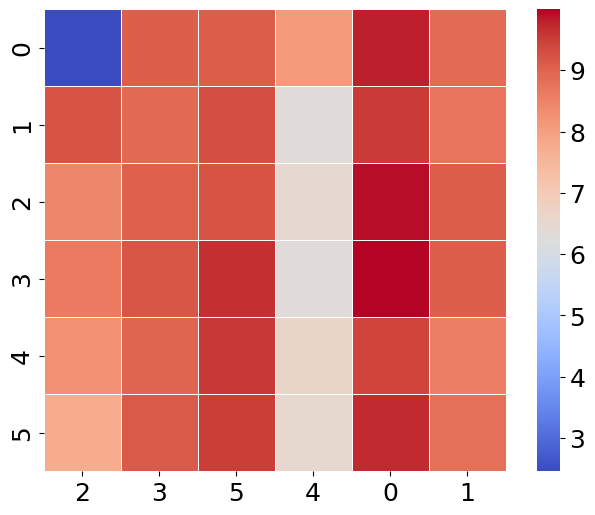

In [11]:
riem = twopair_riemannian_distance(ground_truth_cov+0.1*np.eye(50),fit_cov+0.1*np.eye(50))
order,riem_reorder = hungarian_pair(riem,distance=True)
plot_mode_pairing(riem_reorder,order)

Computing Riemannian distances: 100%|████████████| 6/6 [00:00<00:00, 185.11it/s]


(<Figure size 800x600 with 2 Axes>, <Axes: >)

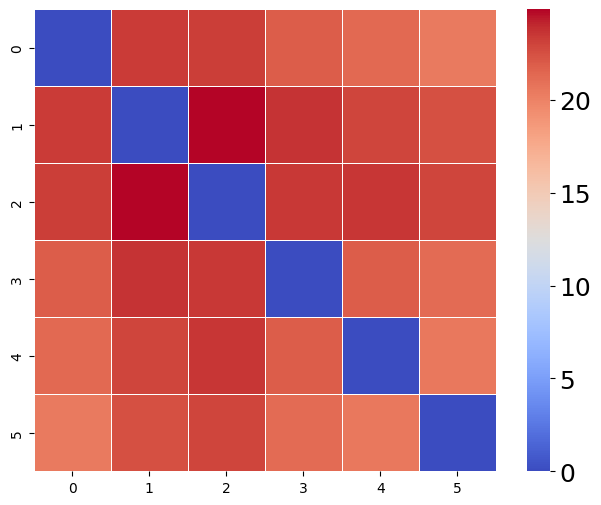

In [14]:
riem_ground_truth = twopair_riemannian_distance(ground_truth_cov,ground_truth_cov)
plot_mode_pairing(riem_ground_truth)

Computing Riemannian distances: 100%|████████████| 6/6 [00:00<00:00, 147.11it/s]


(<Figure size 800x600 with 2 Axes>, <Axes: >)

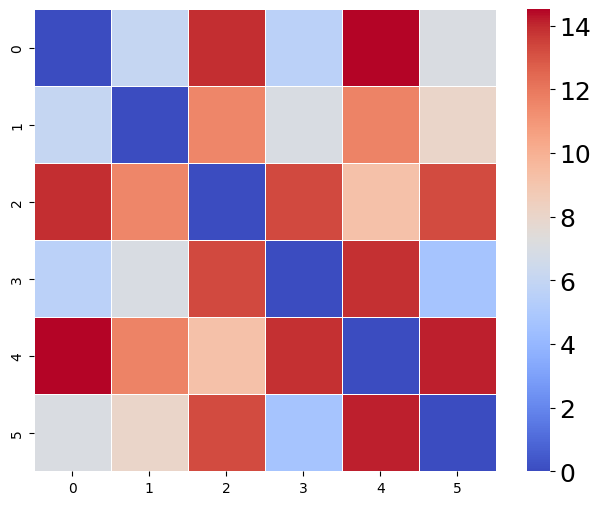

In [15]:
riem_fit = twopair_riemannian_distance(fit_cov,fit_cov)
plot_mode_pairing(riem_fit)

The next step should be:checking the moment-to-moment distance.

In [16]:
sim_alp = np.load(f'{ground_truth_dir}/10001_mode_time_course.npy')
with open(f'{save_dir}/dynemo_ICA_50_state_6/repeat_1/inf_params/alp.pkl', 'rb') as f:
    inf_alp = pickle.load(f)[0]

In [17]:
print(sim_alp.shape)
print(inf_alp.shape)

(1200, 6)
(1200, 6)


In [20]:
from osl_dynamics.inference import metrics
from osl_dynamics.utils import plotting

Calculating riemannian distances
[1.5352485  1.2427845  1.28396493 1.34068119 1.41259256 1.4765031
 1.4993423  1.58683781 1.54943926 1.58873853 1.59866487 1.62287983
 1.66214402 1.68605759 1.70560709 1.72240032 1.69996841 1.68310827
 1.63969859 1.57060389 1.44933624 1.39148718 1.36389102 1.44365198
 1.40307692 1.4667907  1.48019515 1.50714624 1.55406417 1.49227683
 1.53780335 1.40702061 1.43449756 1.36134212 1.34851482 1.33905542
 1.35322262 1.38201817 1.43047391 1.48530389 1.52646714 1.669933
 1.71782521 1.81171554 1.73204047 1.78294952 1.79784792 1.69695599
 1.6211224  1.51897876 1.39188485 1.30182839 1.21308219 1.2193508
 1.27528839 1.38671416 1.52253428 1.64227445 1.78269215 1.78764214
 1.80396437 1.77320156 1.76830998 1.73601432 1.75684235 1.80043896
 1.8688666  1.95804062 2.06988097 2.15777916 2.22869502 2.25840195
 2.27346265 2.29427917 2.2322537  2.16759657 2.08552886 1.98880662
 1.86613413 1.72323767 1.60426504 1.45191727 1.35757291 1.26625496
 1.21471983 1.21629039 1.25480518

(<Figure size 1500x150 with 1 Axes>, <Axes: xlabel='Sample', ylabel='$d$'>)

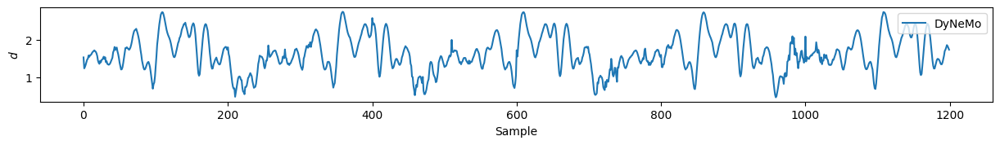

In [23]:
sim_tvcov = np.sum(
    sim_alp[:, :, np.newaxis, np.newaxis] * ground_truth_cov[np.newaxis, :, :, :], axis=1
)
inf_tvcov = np.sum(
    inf_alp[:, :, np.newaxis, np.newaxis] * fit_cov[np.newaxis, :, :, :], axis=1
)

# Calculate the Riemannian distance between the ground truth and inferred covariance
print("Calculating riemannian distances")
rd = np.empty(1200)
for i in range(1200):
    rd[i] = metrics.riemannian_distance(sim_tvcov[i], inf_tvcov[i])
print(rd[:100])
plotting.plot_line(
    [range(1200)],
    [rd],
    labels=["DyNeMo"],
    x_label="Sample",
    y_label="$d$",
    fig_kwargs={"figsize": (15, 1.5)},
    #filename=f"{save_dir}/plots/rd.png",
)

(<Figure size 1200x250 with 2 Axes>, [<Axes: xlabel='Sample'>])

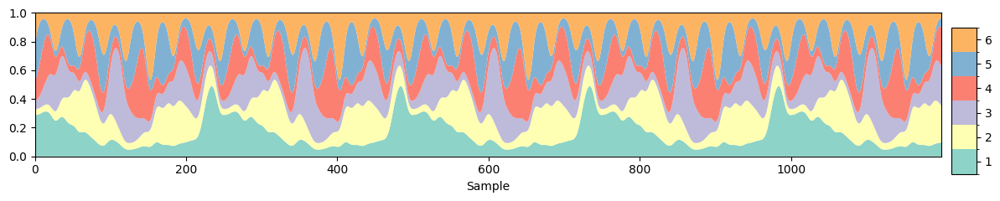

In [24]:
plotting.plot_alpha(sim_alp)

(<Figure size 1200x250 with 2 Axes>, [<Axes: xlabel='Sample'>])

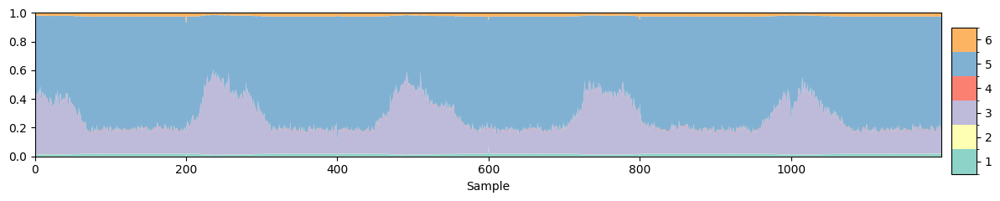

In [25]:
plotting.plot_alpha(inf_alp)

In [26]:
def normalize_alpha(a:np.ndarray, D:np.ndarray) -> np.ndarray:
    """
    Calculate the weighting for each mode
    measured by the trace of each mode covariance
    Parameters
    ----------
    a: (np.ndarray) N_time_points * N_states
    D: (np.ndarray) covariance matrices N_states * N_channels * N_channels

    Returns
    -------
    wa: (np.ndarray) weighted alpha, having the shape as a
    """
    # Calculate the weighting for each mode
    # We use the trace of each mode covariance
    w = np.trace(D, axis1=1, axis2=2)

    # Weight the alphas
    wa = w[np.newaxis, ...] * a

    # Renormalize so the alphas sum to one
    wa /= np.sum(wa, axis=1, keepdims=True)
    return wa

In [27]:
inf_alp_normed = normalize_alpha(inf_alp,fit_cov)

(<Figure size 1200x250 with 2 Axes>, [<Axes: xlabel='Sample'>])

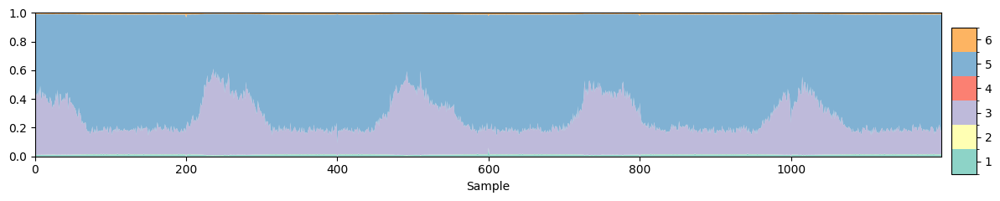

In [28]:
plotting.plot_alpha(inf_alp_normed)

In [29]:
print(inf_alp_normed[:20,:])

[[3.04506160e-04 3.49738169e-03 5.46303928e-01 1.81872223e-04
  4.40030396e-01 9.68188234e-03]
 [1.12454277e-02 1.11973868e-03 4.25513089e-01 4.74718923e-04
  5.53488553e-01 8.15841183e-03]
 [1.07580349e-02 9.78569034e-04 4.14767563e-01 4.22077457e-04
  5.65437257e-01 7.63654523e-03]
 [1.05008213e-02 9.54695686e-04 4.31471914e-01 4.14307055e-04
  5.49100459e-01 7.55783310e-03]
 [1.10200737e-02 9.90033150e-04 4.01530385e-01 4.27947816e-04
  5.78216255e-01 7.81526603e-03]
 [1.00644771e-02 9.29049216e-04 4.54329312e-01 3.93011229e-04
  5.26934326e-01 7.34979799e-03]
 [1.10846581e-02 9.98035306e-04 4.12769437e-01 4.30371612e-04
  5.66776991e-01 7.94047117e-03]
 [9.63069126e-03 8.81872955e-04 4.81938660e-01 3.79572302e-04
  5.00172019e-01 6.99719461e-03]
 [1.11133745e-02 1.02814590e-03 4.03725594e-01 4.33249166e-04
  5.75731337e-01 7.96829723e-03]
 [1.14021758e-02 1.03365502e-03 3.79260540e-01 4.40641365e-04
  5.99680424e-01 8.18252005e-03]
 [1.05023989e-02 9.71290166e-04 4.39674914e-01 4.1

In [40]:
sim_dir = './data/node_timeseries/simulation_bicv/random/truth/'
inf_dir = './results_simulation_bicv_202407/random/dynemo_check/'
sim_cov = np.load(f'{sim_dir}/state_covariances.npy')
inf_cov = np.load(f'{inf_dir}/dynemo_ICA_25_state_8/repeat_2/inf_params/covs.npy')
print(sim_cov.shape)
print(inf_cov.shape)

(8, 25, 25)
(8, 25, 25)


Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 490.24it/s]


(<Figure size 800x600 with 2 Axes>, <Axes: >)

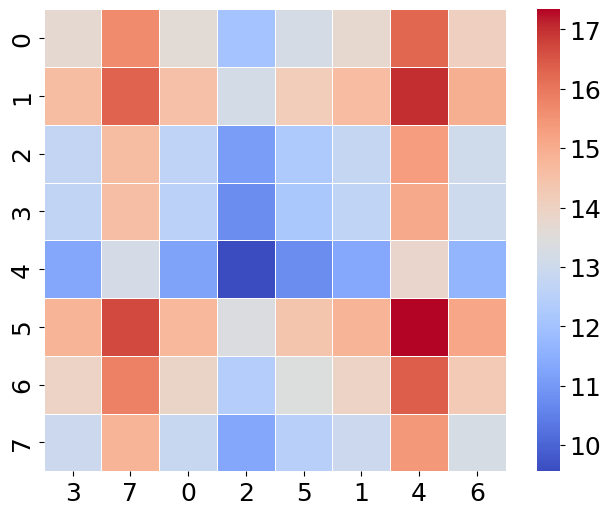

In [47]:
riem = twopair_riemannian_distance(sim_cov,inf_cov)
order,riem_reorder = hungarian_pair(riem,distance=True)
plot_mode_pairing(riem_reorder,order)

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 236.80it/s]


(<Figure size 800x600 with 2 Axes>, <Axes: >)

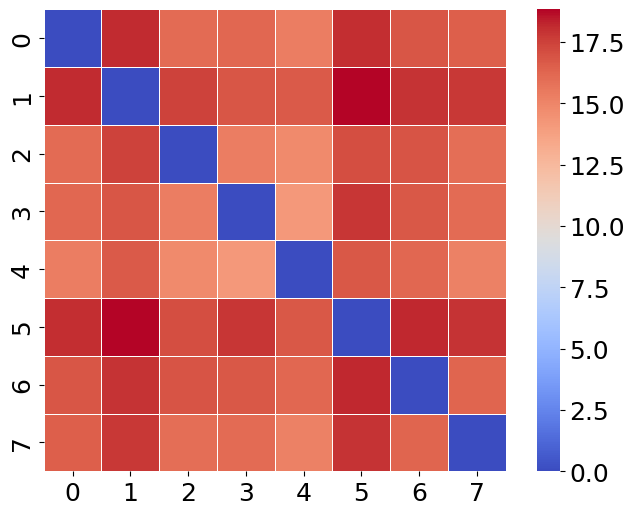

In [48]:
riem = twopair_riemannian_distance(sim_cov,sim_cov)
order,riem_reorder = hungarian_pair(riem,distance=True)
plot_mode_pairing(riem_reorder,order)

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 564.64it/s]


(<Figure size 800x600 with 2 Axes>, <Axes: >)

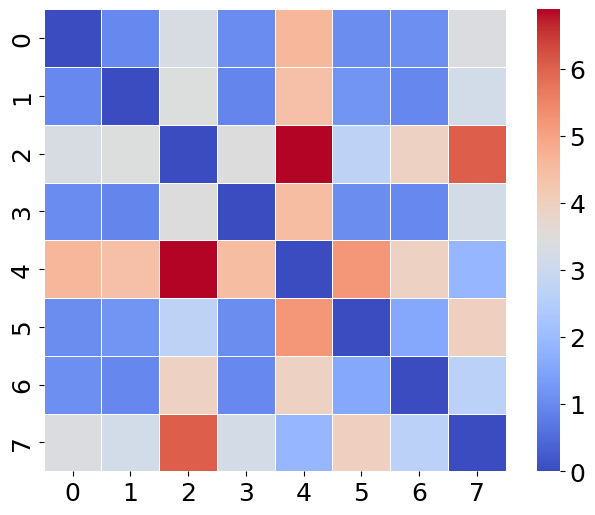

In [49]:
riem = twopair_riemannian_distance(inf_cov,inf_cov)
order,riem_reorder = hungarian_pair(riem,distance=True)
plot_mode_pairing(riem_reorder,order)

In [51]:
# Check the loss function (learning rate may plays a role here).
with open(f'{inf_dir}/dynemo_ICA_25_state_8/repeat_1/model/history.pkl','rb') as file:
    history = pickle.load(file)
print(history.keys())

dict_keys(['loss', 'covs_kernel', 'll_loss', 'kl_loss', 'lr', 'free_energy'])


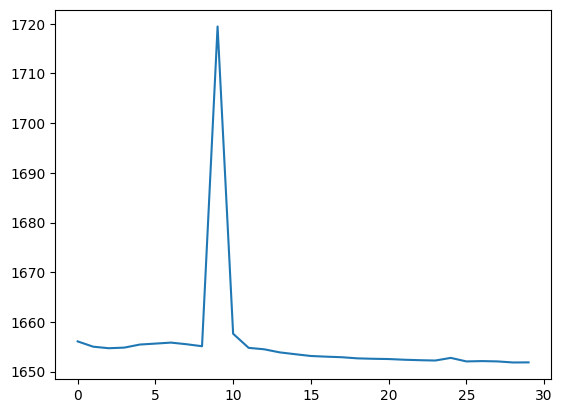

In [52]:
plt.plot(history['loss'])
plt.show()

In [45]:
sim_alp = np.load(f'{sim_dir}/10001_state_time_course.npy')
with open(f'{inf_dir}/dynemo_ICA_25_state_8/repeat_2/inf_params/alp.pkl', 'rb') as f:
    inf_alp = pickle.load(f)[0]

Calculating riemannian distances
[12.04910354 12.40265812 12.40265812 12.40265812 12.40265812 10.76866618
 10.76866618 10.76866618 10.76866618 10.76866618 10.76866618 10.76866618
 11.10805293 11.10805293 11.10805293 11.10805293 11.10805293 11.10805293
 11.10805293 11.10805293 11.10805293 12.40265812 12.40265812 12.40265812
 12.40265812 12.40265812 12.40265812 12.40265812 12.40265812 12.40265812
 13.15860818 13.15860818 13.15860818 13.15860818  9.5582369  13.15860818
 13.15860818 10.76866618 10.76866618 10.76866618 10.76866618 10.76866618
 10.76866618 10.76866618 10.76866618 10.76866618 10.76866618 10.76866618
 10.76866618 10.76866618 11.10805293 11.10805293 11.10805293 11.10805293
 11.10805293 11.10805293 10.76866618 10.76866618 10.76866618 10.76866618
 10.76866618 10.76866618 10.76866618 10.76866618 10.76866618 13.3781618
 13.3781618  13.3781618  13.3781618  13.3781618  13.3781618  13.3781618
 13.3781618  13.3781618  10.76866618 10.76866618 10.76866618 10.76866618
 10.76866618 11.1080

(<Figure size 1500x150 with 1 Axes>, <Axes: xlabel='Sample', ylabel='$d$'>)

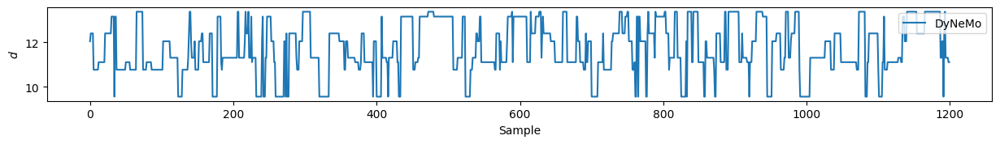

In [46]:
sim_tvcov = np.sum(
    sim_alp[:, :, np.newaxis, np.newaxis] * sim_cov[np.newaxis, :, :, :], axis=1
)
inf_tvcov = np.sum(
    inf_alp[:, :, np.newaxis, np.newaxis] * inf_cov[np.newaxis, :, :, :], axis=1
)

# Calculate the Riemannian distance between the ground truth and inferred covariance
print("Calculating riemannian distances")
rd = np.empty(1200)
for i in range(1200):
    rd[i] = metrics.riemannian_distance(sim_tvcov[i], inf_tvcov[i])
print(rd[:100])
plotting.plot_line(
    [range(1200)],
    [rd],
    labels=["DyNeMo"],
    x_label="Sample",
    y_label="$d$",
    fig_kwargs={"figsize": (15, 1.5)},
    #filename=f"{save_dir}/plots/rd.png",
)

(8, 25, 25)
(8, 25, 25)


Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 324.52it/s]

########################
[0.33981503 0.32633451 0.30963138 0.31680222 0.31993554 0.31856578
 0.31813106 0.31778057]


Calculating riemannian distances
Calculating riemannian distances
Calculating riemannian distances
Calculating riemannian distances
Calculating riemannian distances


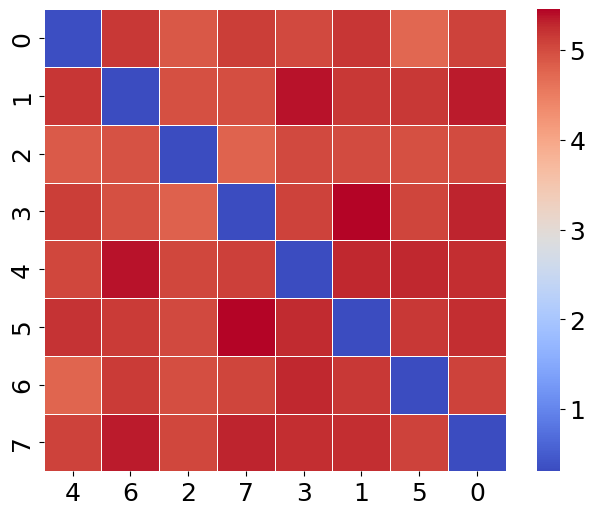

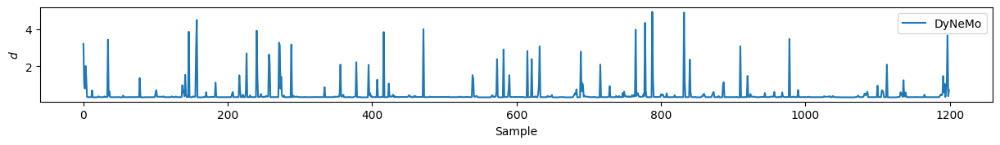

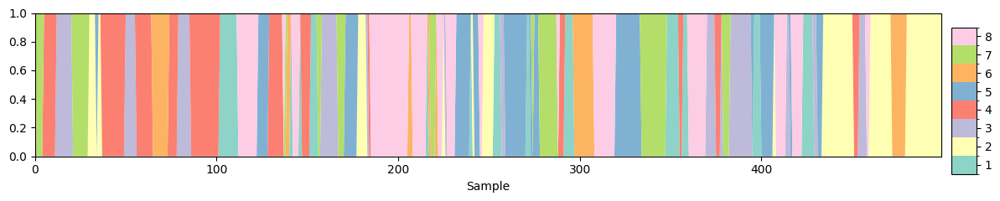

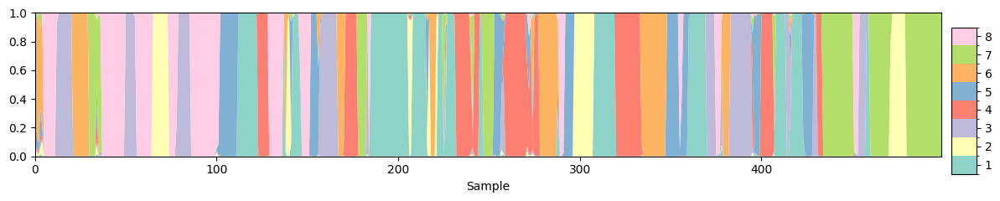

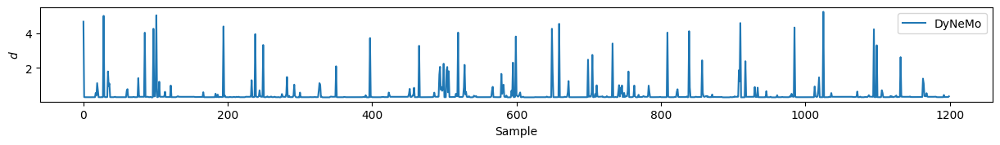

...

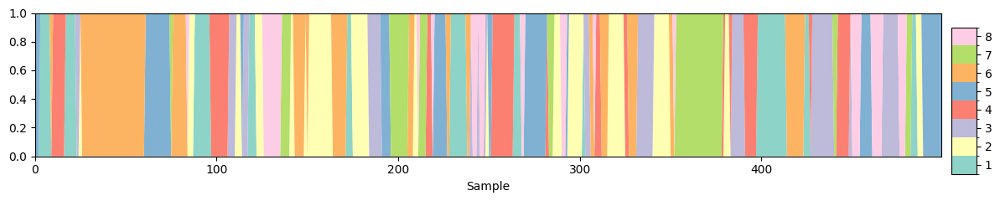

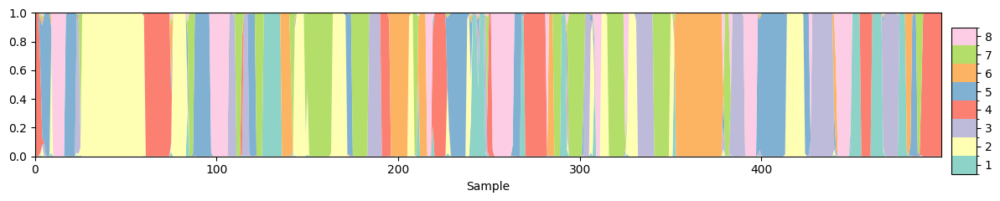

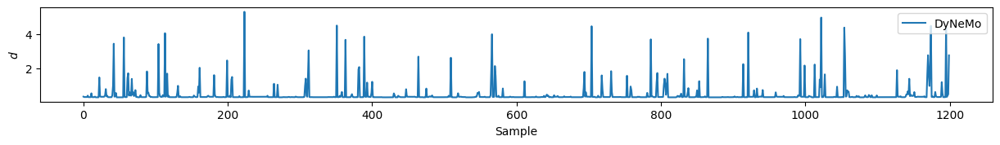

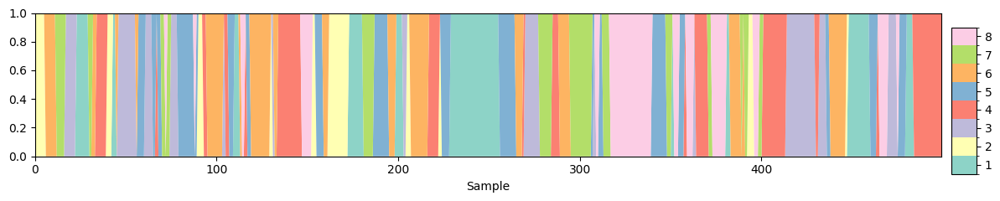

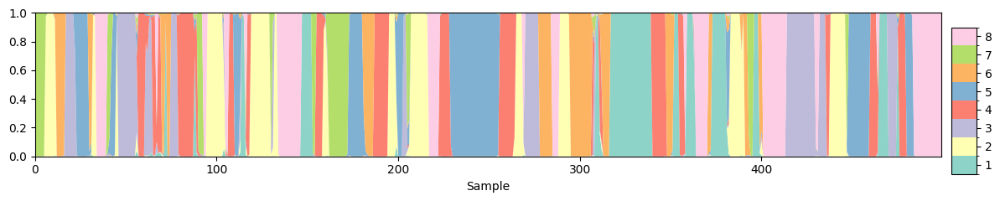

In [8]:
# Check 1: random (generated by HMM)
sim_dir = './data/node_timeseries/simulation_bicv/random/truth/'
inf_dir = './results_simulation_bicv_202407/random/dynemo_play/free/'
#inf_dir = './results_simulation_bicv_202407/random/dynemo_check/dynemo_ICA_25_state_8/repeat_3/'
# Check 2: random_dynemo_equal
#sim_dir = './data/node_timeseries/simulation_bicv/random_dynemo_equal/truth/'
#inf_dir = './results_simulation_bicv_202407/random_dynemo_equal/dynemo_check/dynemo_ICA_50_state_6/repeat_3/'

sim_cov = np.load(f'{sim_dir}/state_covariances.npy')
inf_cov = np.load(f'{inf_dir}/inf_params/covs.npy')
print(sim_cov.shape)
print(inf_cov.shape)
_,N_channels,_=sim_cov.shape
riem = twopair_riemannian_distance(sim_cov+0.1*np.eye(N_channels),inf_cov+0.1*np.eye(N_channels))
order,riem_reorder = hungarian_pair(riem,distance=True)
plot_mode_pairing(riem_reorder,order)
print('########################')
print(np.diagonal(riem_reorder))

#################################################################################
for i in range(5):
    try:
        sim_alp = np.load(f'{sim_dir}/{10001+i}_state_time_course.npy')
    except FileNotFoundError:
        sim_alp = np.load(f'{sim_dir}/{10001+i}_mode_time_course.npy')
    with open(f'{inf_dir}/inf_params/alp.pkl', 'rb') as f:
        inf_alp = pickle.load(f)[i]

    sim_tvcov = np.sum(
        sim_alp[:, :, np.newaxis, np.newaxis] * sim_cov[np.newaxis, :, :, :], axis=1
    )
    inf_tvcov = np.sum(
        inf_alp[:, :, np.newaxis, np.newaxis] * inf_cov[np.newaxis, :, :, :], axis=1
    )

    # Calculate the Riemannian distance between the ground truth and inferred covariance
    print("Calculating riemannian distances")
    rd = np.empty(1200)
    for i in range(1200):
        rd[i] = riemannian_distance(sim_tvcov[i]+0.1*np.eye(N_channels), inf_tvcov[i]+0.1*np.eye(N_channels))
    plot_line(
        [range(1200)],
        [rd],
        labels=["DyNeMo"],
        x_label="Sample",
        y_label="$d$",
        fig_kwargs={"figsize": (15, 1.5)},
        #filename=f"{save_dir}/plots/rd.png",
    )
    plot_alpha(sim_alp,n_samples=500)
    plot_alpha(inf_alp,n_samples=500)

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 116.75it/s]


[[3.82342499e-15 4.74360509e+00 4.98372799e+00 5.08019915e+00
  5.26732852e+00 4.86306601e+00 4.99052117e+00 5.13494947e+00]
 [4.74360509e+00 4.17331639e-15 4.70149598e+00 3.85523158e+00
  4.73664225e+00 4.52286863e+00 4.43626415e+00 4.57083183e+00]
 [4.98372799e+00 4.70149598e+00 3.96584345e-15 5.09110191e+00
  4.80123289e+00 4.77398945e+00 4.95984110e+00 5.22607361e+00]
 [5.08019915e+00 3.85523158e+00 5.09110191e+00 3.47377412e-15
  5.17722608e+00 4.67888361e+00 4.88445246e+00 5.06977488e+00]
 [5.26732852e+00 4.73664225e+00 4.80123289e+00 5.17722608e+00
  4.75844231e-15 4.60373301e+00 4.84654676e+00 4.92962411e+00]
 [4.86306601e+00 4.52286863e+00 4.77398945e+00 4.67888361e+00
  4.60373301e+00 4.61778046e-15 4.77777395e+00 4.87935967e+00]
 [4.99052117e+00 4.43626415e+00 4.95984110e+00 4.88445246e+00
  4.84654676e+00 4.77777395e+00 3.12049704e-15 5.11735351e+00]
 [5.13494947e+00 4.57083183e+00 5.22607361e+00 5.06977488e+00
  4.92962411e+00 4.87935967e+00 5.11735351e+00 4.49194644e-15]]

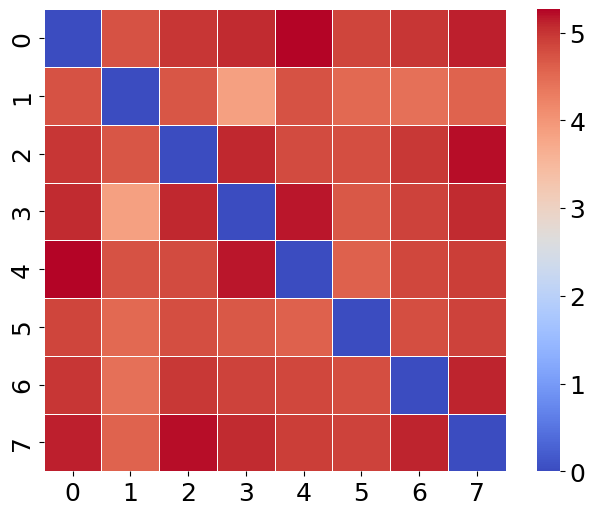

In [4]:
riem = twopair_riemannian_distance(inf_cov+0.1*np.eye(25),inf_cov+0.1*np.eye(25))
order,riem_reorder = hungarian_pair(riem,distance=True)
plot_mode_pairing(riem_reorder,order)
print(riem_reorder)

OK, I guess we need to deeply compare these two configurations.

In [23]:
# Function to load YAML file
def load_yaml(file_path):
    with open(file_path, 'r') as file:
        return yaml.safe_load(file)

# Load the two YAML files
file1 = load_yaml('./results_simulation_bicv_202407/random/dynemo_play/free_2/prepared_config.yaml')
file2 = load_yaml('./results_simulation_bicv_202407/random/dynemo_play/free/prepared_config.yaml')

# Compare the two files using DeepDiff
diff = DeepDiff(file1, file2)

# Output the differences
if diff:
    print("Differences found:")
    print(diff)
else:
    print("The two YAML files are identical.")

The two YAML files are identical.


In [17]:
sim_dir = './data/node_timeseries/simulation_bicv/random_dynemo_equal/truth/'
#inf_dir = './results_simulation_bicv_202407/random/dynemo_play/free/'
inf_dir = './results_simulation_bicv_202407/random_dynemo_equal/dynemo_check_again/dynemo_ICA_50_state_6/repeat_2/'
sim_cov = np.load(f'{sim_dir}/state_covariances.npy')
inf_cov = np.load(f'{inf_dir}/inf_params/covs.npy')
print(sim_cov.shape)
print(inf_cov.shape)
riem = twopair_riemannian_distance(sim_cov+0.1*np.eye(25),inf_cov+0.1*np.eye(25))
order,riem_reorder = hungarian_pair(riem,distance=True)
plot_mode_pairing(riem_reorder,order)
print('########################')
print(np.diagonal(riem_reorder))

FileNotFoundError: [Errno 2] No such file or directory: './results_simulation_bicv_202407/random_dynemo_equal/dynemo_check_again/dynemo_ICA_50_state_6/repeat_2//inf_params/covs.npy'

In [ ]:
sim_alp = np.load(f'{sim_dir}/10001_state_time_course.npy')
with open(f'{inf_dir}/inf_params/alp.pkl', 'rb') as f:
    inf_alp = pickle.load(f)[0]
print(sim_alp.shape)
print(inf_alp.shape)

[[1 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 1 0]
 [0 0 0 0 0 0 1 0]
 [0 0 0 0 0 0 1 0]
 [0 0 0 0 0 0 1 0]
 [0 0 0 1 0 0 0 0]
 [0 0 0 1 0 0 0 0]
 [0 0 0 1 0 0 0 0]
 [0 0 0 1 0 0 0 0]
 [0 0 0 1 0 0 0 0]
 [0 0 0 1 0 0 0 0]
 [0 0 0 1 0 0 0 0]
 [0 0 1 0 0 0 0 0]
 [0 0 1 0 0 0 0 0]
 [0 0 1 0 0 0 0 0]
 [0 0 1 0 0 0 0 0]
 [0 0 1 0 0 0 0 0]
 [0 0 1 0 0 0 0 0]
 [0 0 1 0 0 0 0 0]
 [0 0 1 0 0 0 0 0]
 [0 0 1 0 0 0 0 0]
 [0 0 0 0 0 0 1 0]
 [0 0 0 0 0 0 1 0]
 [0 0 0 0 0 0 1 0]
 [0 0 0 0 0 0 1 0]]


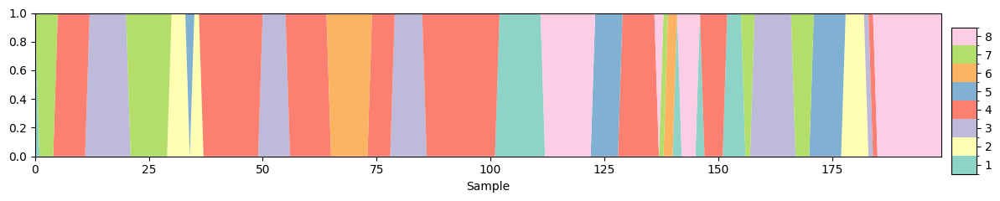

In [68]:
plotting.plot_alpha(sim_alp,n_samples=200)
print(sim_alp[:25,:])

(<Figure size 1200x250 with 2 Axes>, [<Axes: xlabel='Sample'>])

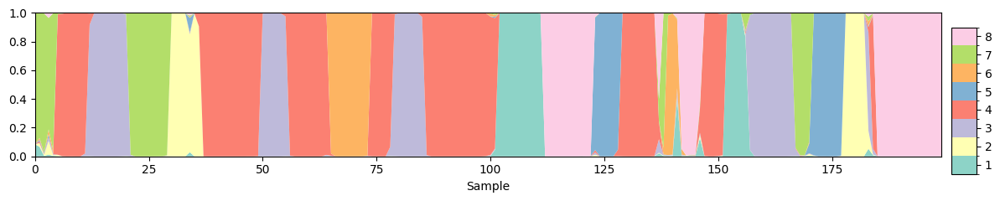

In [69]:
plotting.plot_alpha(inf_alp,n_samples=200)

[[ 0.95582111 -0.11881418 -0.13773314 -0.11030298 -0.08760566 -0.11429327
  -0.11555544 -0.12282349]
 [-0.11550955  0.98358882 -0.17056514 -0.12157632 -0.12701747 -0.14070902
  -0.1394628  -0.15029564]
 [-0.14145252 -0.16394011  0.985393   -0.15306289 -0.15863645 -0.17094434
  -0.17216604 -0.18522539]
 [-0.10168373 -0.12819799 -0.14975701  0.99023976 -0.12049938 -0.13420805
  -0.13387169 -0.14139243]
 [-0.10268303 -0.11436447 -0.15693083 -0.12130156  0.9685679  -0.13542753
  -0.13597497 -0.13834175]
 [-0.12377808 -0.1409952  -0.17414452 -0.1339081  -0.13407803  0.99197757
  -0.14465439 -0.15542533]
 [-0.11560087 -0.14219667 -0.17125114 -0.13307415 -0.12970555 -0.14779959
   0.9745461  -0.14998121]
 [-0.12847759 -0.15236276 -0.18206828 -0.14077669 -0.14319749 -0.15799083
  -0.14881597  0.98506412]]


(<Figure size 800x600 with 2 Axes>, <Axes: >)

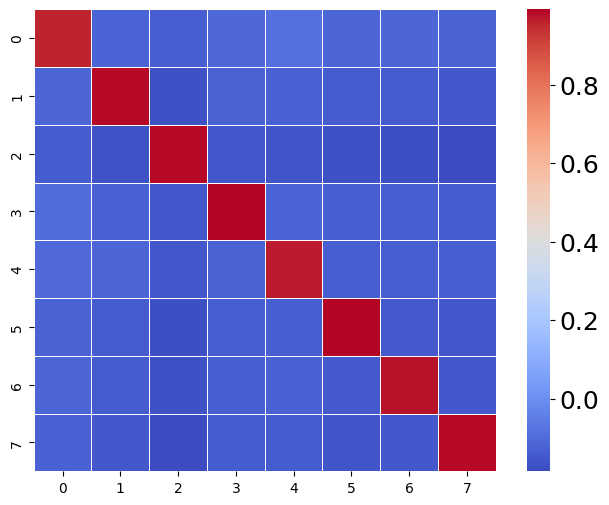

In [70]:
cor = alpha_correlation(sim_alp,inf_alp,return_diagonal=False)
print(cor)
plot_mode_pairing(cor)

## Update 25th Sept 2024 Think about why SWC refuses to give proper penalty

In [24]:
import os
import pickle
import json

import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

from osl_dynamics.inference.metrics import alpha_correlation, twopair_riemannian_distance
from osl_dynamics.inference.modes import hungarian_pair
from osl_dynamics.utils.plotting import plot_mode_pairing, plot_mode_no_pairing

from osl_dynamics.inference.modes import argmax_time_courses,fractional_occupancies
from osl_dynamics.array_ops import get_one_hot

In [101]:
root_dir = './results_simulation_bicv_202407/real_swc/swc/100_100/'
truth_dir = './data/node_timeseries/simulation_bicv/real_swc/truth/'
plot_dir = f'{root_dir}/analysis/'
if not os.path.exists(plot_dir):
    os.makedirs(plot_dir)

Computing Riemannian distances: 100%|███████████| 8/8 [00:00<00:00, 1028.99it/s]


[0.26158414 0.27438611 0.27293631 0.26633326 0.27460965 0.26538593
 0.26830014 0.27782963]
(12, 8)


(<Figure size 800x600 with 2 Axes>,
 <Axes: title={'center': 'Y_test temporal'}, xlabel='fit', ylabel='ground_truth'>)

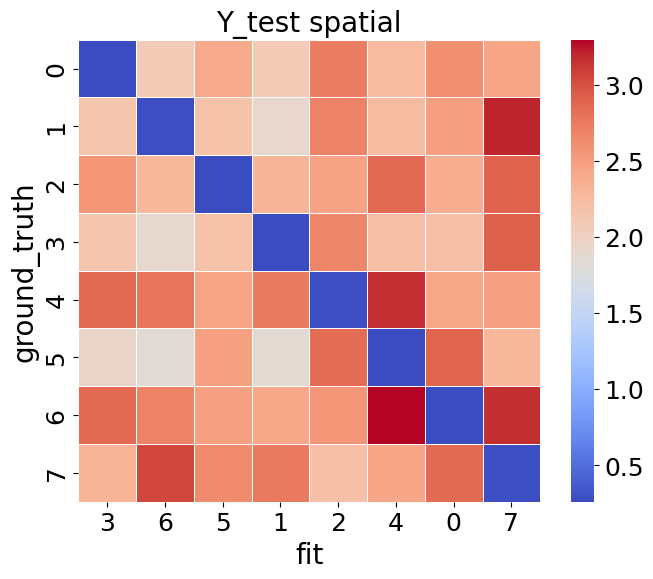

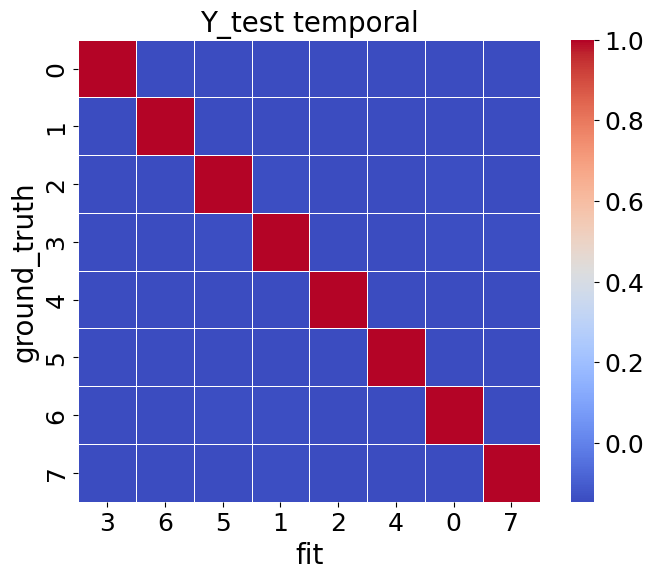

In [115]:
n_states = 8
analyse_dir = f'{root_dir}/swc_ICA_25_state_{n_states}/cv_1/fold_1_1/'
with open(f'{analyse_dir}/fold_indices.json','r') as file:
    fold_indices = json.load(file)
ground_truth_cov = np.load(f'{truth_dir}/state_covariances.npy')
Y_test_cov = np.load(f'{analyse_dir}/Y_train/inf_params/covs.npy')
riem = twopair_riemannian_distance(ground_truth_cov[:, fold_indices['column_Y'], :][:, :, fold_indices['column_Y']],Y_test_cov)
order, riem_reorder = hungarian_pair(riem,distance=True)

# Plot mode but no pairing
plot_mode_pairing(riem_reorder,order,x_label='fit',y_label='ground_truth',title='Y_test spatial',
                     #filename=f'{plot_dir}/state_{n_states}_Y_test_spatial.svg'
                    )
print(np.diagonal(riem_reorder))

with open(f'{analyse_dir}/Y_test/inf_params/alp.pkl','rb') as file:
    alpha_fit = pickle.load(file)
for i in range(len(alpha_fit)):
    alpha_fit[i] = get_one_hot(alpha_fit[i],n_states)
print(alpha_fit[0].shape)
alpha_truth = []

for index in fold_indices['row_test']:
    alpha_truth.append(np.load(f'{truth_dir}/{10001+index}_state_time_course.npy')[::100, :])
alpha_cor = alpha_correlation(alpha_truth,alpha_fit,return_diagonal=False)
order,alpha_cor_reorder = hungarian_pair(alpha_cor,distance=False)
plot_mode_pairing(alpha_cor_reorder,order,x_label='fit',y_label='ground_truth',title='Y_test temporal')

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 661.95it/s]


[[2.7664066  2.08749678 2.47129235 2.673639   2.45266729 0.25384899
  2.24690325 2.06707263 2.31191256 2.57960343 2.4496837  0.32140234
  2.39870645 2.69807097 2.11546091 2.5293528 ]
 [2.7670963  1.9019117  2.21841043 2.56541829 3.2140937  2.19445748
  2.23582443 0.3395299  2.08014285 2.45128572 2.25693544 2.11744322
  3.13173112 2.63565519 0.27509122 3.33104508]
 [2.48890061 2.30567494 0.35316737 2.42929263 2.90887729 2.55403046
  2.86630275 2.25226044 0.37048323 2.34699425 0.28277566 2.56480944
  2.86699036 2.4285563  2.31682648 2.9601642 ]
 [2.74047105 0.26633326 2.22123659 2.26931583 2.91784852 2.1897155
  2.2255382  1.88073766 2.08818706 2.14939669 2.26298917 2.11026884
  2.84267146 2.61631717 1.9224441  3.02723348]
 [0.28009779 2.75352916 2.44856355 2.48328636 2.48047129 2.90381678
  3.16470411 2.76458549 2.38489489 2.38120531 2.52336923 2.84044591
  2.46883854 0.33987918 2.82582362 2.56710059]
 [2.90509423 1.85150574 2.50958319 2.95223422 2.31879822 2.01521927
  0.26538585 1.809

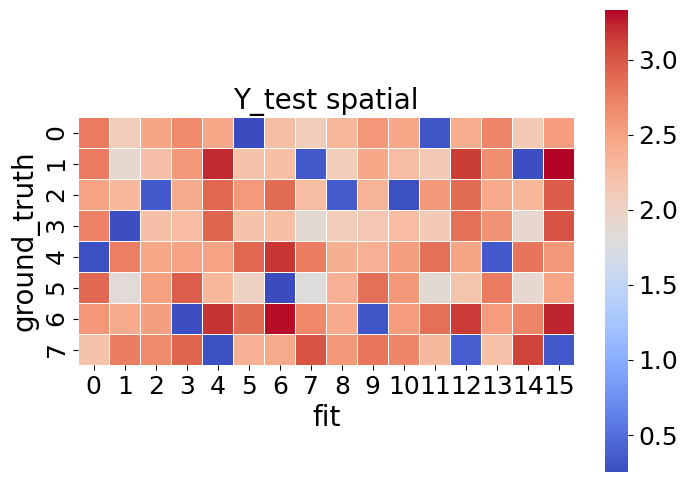

In [112]:
n_states = 16
analyse_dir = f'{root_dir}/swc_ICA_25_state_{n_states}/cv_1/fold_1_1/'
with open(f'{analyse_dir}/fold_indices.json','r') as file:
    fold_indices = json.load(file)
ground_truth_cov = np.load(f'{truth_dir}/state_covariances.npy')
Y_test_cov = np.load(f'{analyse_dir}/Y_train/inf_params/covs.npy')
riem = twopair_riemannian_distance(ground_truth_cov[:, fold_indices['column_Y'], :][:, :, fold_indices['column_Y']],Y_test_cov)

# Plot mode but no pairing
plot_mode_no_pairing(riem,x_label='fit',y_label='ground_truth',title='Y_test spatial',
                     #filename=f'{plot_dir}/state_{n_states}_Y_test_spatial.svg'
                    )
print(riem)


(12, 16)
(12, 8)
[[-0.09891651 -0.14326836 -0.0804325  -0.08837905 -0.0868371   0.62453069
  -0.14591242 -0.10387665 -0.08174626 -0.10761838 -0.07568562  0.7371474
  -0.08010127 -0.09891651 -0.09346972 -0.07103928]
 [-0.09772873 -0.141548   -0.07946667 -0.0873178  -0.08579436 -0.09030302
  -0.14416031  0.71840514 -0.08076466 -0.10632611 -0.07477679 -0.10658666
  -0.07913942 -0.09772873  0.64643139 -0.07018624]
 [-0.09713213 -0.14068391  0.55968335 -0.08678476 -0.08527062 -0.08975176
  -0.14328027 -0.10200279  0.56882505 -0.10567703  0.52665252 -0.10593599
  -0.07865631 -0.09713213 -0.0917836  -0.06975778]
 [-0.09683314  1.         -0.07873844 -0.08651762 -0.08500815 -0.08947549
  -0.14283923 -0.10168881 -0.08002453 -0.10535174 -0.07409153 -0.1056099
  -0.07841419 -0.09683314 -0.09150107 -0.06954305]
 [ 0.68306064 -0.14176361 -0.07958772 -0.0874508  -0.08592505 -0.09044058
  -0.1443799  -0.10278563 -0.08088768 -0.10648807 -0.07489069 -0.10674901
  -0.07925997  0.68306064 -0.09248801 -0.

(<Figure size 800x600 with 2 Axes>,
 <Axes: title={'center': 'Y_test temporal'}, xlabel='fit', ylabel='ground_truth'>)

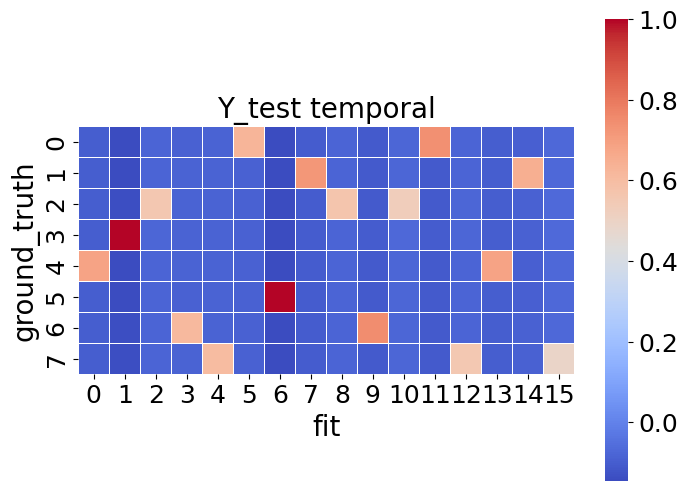

In [120]:
n_states = 16
analyse_dir = f'{root_dir}/swc_ICA_25_state_{n_states}/cv_1/fold_1_1/'
with open(f'{analyse_dir}/Y_test/inf_params/alp.pkl','rb') as file:
    alpha_fit = pickle.load(file)

for i in range(len(alpha_fit)):
    alpha_fit[i] = get_one_hot(alpha_fit[i],n_states)
print(alpha_fit[0].shape)
alpha_truth = []
for index in fold_indices['row_test']:
    alpha_truth.append(np.load(f'{truth_dir}/{10001+index}_state_time_course.npy')[::100, :])
print(alpha_truth[0].shape)
alpha_cor = alpha_correlation(alpha_truth,alpha_fit,return_diagonal=False)
print(alpha_cor)
plot_mode_no_pairing(alpha_cor,x_label='fit',y_label='ground_truth',title='Y_test temporal')

In [ ]:
with open(f'{analyse_dir}/Y_test/inf_params/alp.pkl','rb') as file:
    alpha_fit = pickle.load(file)
alpha_truth = []
for index in fold_indices['row_test']:
    alpha_truth.append(np.load(f'{truth_dir}/{10001+index}_state_time_course.npy'))
alpha_cor = alpha_correlation(alpha_truth,alpha_fit,return_diagonal=False)
plot_mode_no_pairing(alpha_cor,x_label='fit',y_label='ground_truth',title='Y_test temporal',filename=f'{plot_dir}/state_{n_states}_Y_test_temporal.svg')

### Check on real data

In [27]:
save_dir = './results_HCP_bicv_202410/ICA_50/swc/15_15/'
#truth_dir = './data/node_timeseries/simulation_bicv/real_swc/truth/'
plot_dir = f'{root_dir}/analysis/'
if not os.path.exists(plot_dir):
    os.makedirs(plot_dir)

Computing Riemannian distances: 100%|███████████| 20/20 [00:00<00:00, 38.63it/s]


(<Figure size 800x600 with 2 Axes>, <Axes: >)

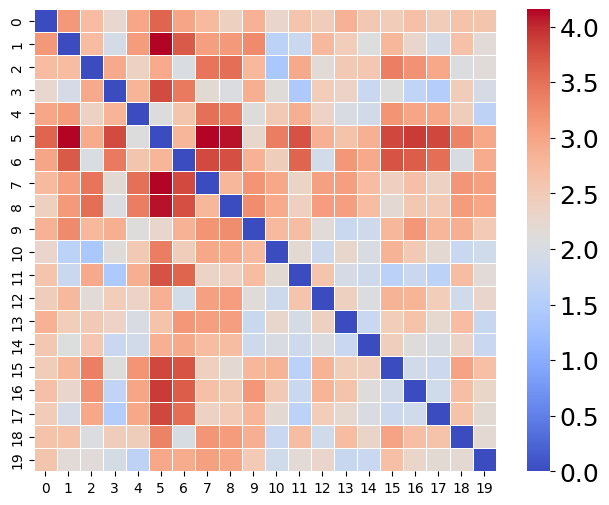

In [30]:
n_states = 20
analyse_dir = f'{save_dir}/swc_ICA_50_state_{n_states}/cv_1/fold_1_1/'
with open(f'{analyse_dir}/fold_indices.json','r') as file:
    fold_indices = json.load(file)
Y_test_cov = np.load(f'{analyse_dir}/Y_train/inf_params/covs.npy')
riem = twopair_riemannian_distance(Y_test_cov,Y_test_cov)
plot_mode_pairing(riem)

### Fractional Occupancy analysis

In [36]:
save_dir = './results_HCP_bicv_202410/ICA_50/swc/15_15/swc_ICA_50_state_22/cv_1/fold_1_1/X_train/inf_params/'
analysis_dir = './results_HCP_bicv_202410/ICA_50_filter_0.05/swc/15_15/swc_ICA_50_state_22/'
if not os.path.exists(analysis_dir):
    os.makedirs(analysis_dir)
with open(f'{save_dir}alp.pkl', 'rb') as file:
    alpha = pickle.load(file)
alpha = get_one_hot(alpha,n_states=22)
stc = argmax_time_courses(alpha)
fo = fractional_occupancies(stc)

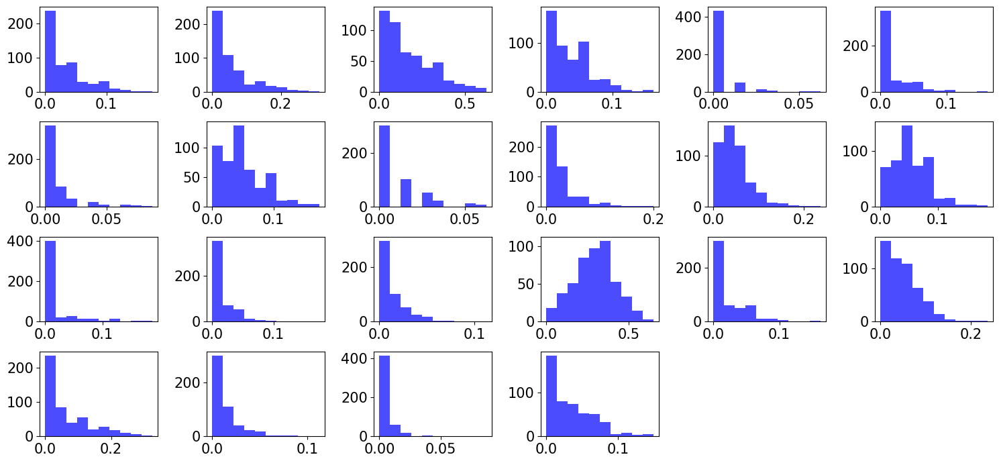

In [38]:
# Assuming 'fo' is your numpy array with shape (1003, 7)
# Sort each row so that the columns correspond to the least to most visited states
#sorted_fo = np.sort(fo, axis=1)
# Plot histograms for each column in a 4x3 grid (2 rows, 4 columns)
fig, axes = plt.subplots(4, 6, figsize=(15, 7))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Plot histograms for each column
num_columns = sorted_fo.shape[1]
'''
titles = ["1st least visited",
          "2nd least visited",
          "3rd least visited",
          "4th least visited",
          "5th least visited",
          "6th least visited",
          "7th least visited",
          "8th least visited"]
'''
for i in range(num_columns):
    axes[i].hist(sorted_fo[:, i], color='blue', alpha=0.7)
    
    # Set the title with a more descriptive label
    #axes[i].set_title(titles[i], fontsize=20)
    
    # Set the x and y labels with specified fontsize
    #axes[i].set_xlabel('Fractional Occupancy', fontsize=20)
    #axes[i].set_ylabel(r'$N_{subjects}$', fontsize=20)
    
    # Set the fontsize for xticks and yticks
    axes[i].tick_params(axis='both', which='major', labelsize=15)

# Hide the unused subplot
for j in range(num_columns, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

Question: Are we able to pair the HMM states with SWC states? I know we can't with HMM & DyNeMo.

In [25]:
HMM_states = np.load('results_HCP_bicv_202404/var_1/ICA_50_check/hmm_ICA_50_state_8/repeat_1/inf_params/covs.npy')
SWC_states = np.load('results_HCP_bicv_202410/ICA_50/swc_check/15_15/swc_ICA_50_state_8/repeat_1/inf_params/covs.npy')
print(HMM_states.shape)
print(SWC_states.shape)

(8, 50, 50)
(8, 50, 50)


Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 125.16it/s]


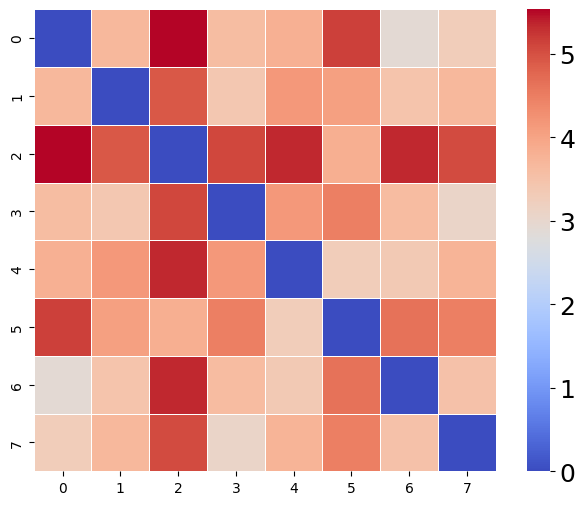

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 279.48it/s]


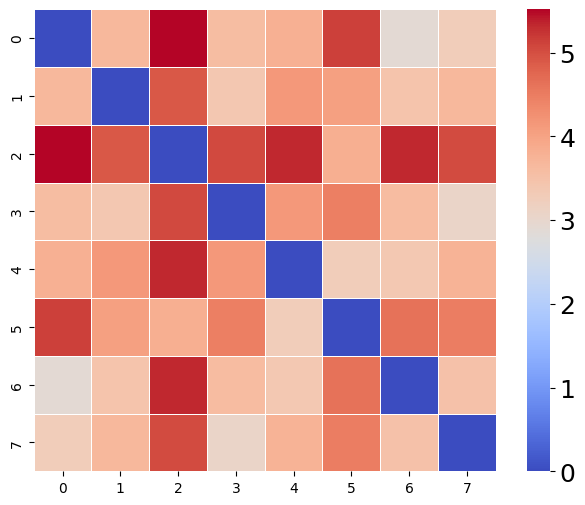

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 662.54it/s]


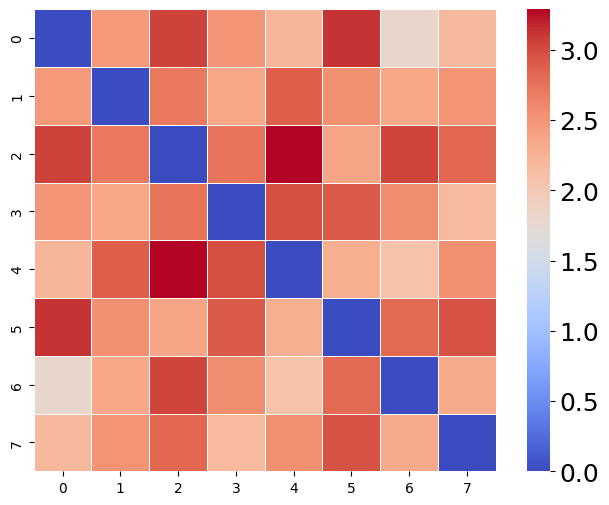

In [31]:
riem = twopair_riemannian_distance(HMM_states,HMM_states)
#order,riem_reorder = hungarian_pair(riem,distance=True)
plot_mode_pairing(riem)
plt.show()
riem = twopair_riemannian_distance(HMM_states[:,:46,:46],HMM_states[:,:46,:46])
#order,riem_reorder = hungarian_pair(riem,distance=True)
plot_mode_pairing(riem)
plt.show()
riem = twopair_riemannian_distance(HMM_states[:,::2,::2],HMM_states[:,::2,::2])
#order,riem_reorder = hungarian_pair(riem,distance=True)
plot_mode_pairing(riem)
plt.show()

## Update 28th Sept 2024

Check the results from Sliding Window correlation on real data.

In [38]:
import os
import pickle
import json
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

from osl_dynamics.inference.metrics import alpha_correlation, twopair_riemannian_distance
from osl_dynamics.inference.modes import hungarian_pair
from osl_dynamics.utils.plotting import plot_mode_pairing, plot_mode_no_pairing, plot_matrices
from osl_dynamics.array_ops import cov2stdcorr

from osl_dynamics.inference.modes import argmax_time_courses,fractional_occupancies
from osl_dynamics.array_ops import get_one_hot

In [79]:
analysis_dir_1 = './results_HCP_bicv_202410/ICA_15/swc_check/15_15/swc_ICA_15_state_3/repeat_1/inf_params/'
analysis_dir_2 = './results_HCP_bicv_202410/ICA_15/swc_check/15_15/swc_ICA_15_state_20/repeat_1/inf_params/'
analysis_dir_3 = './results_HCP_bicv_202410/ICA_15_filter_0.05/swc_check/15_15/swc_ICA_15_state_3/repeat_1/inf_params/'
analysis_dir_4 = './results_HCP_bicv_202410/ICA_15/hmm_check/hmm_ICA_15_state_3/repeat_1/inf_params/'
cov_1 = np.load(f'{analysis_dir_1}/covs.npy')
cov_2 = np.load(f'{analysis_dir_2}/covs.npy')
cov_3 = np.load(f'{analysis_dir_3}/covs.npy')
cov_4 = np.load(f'{analysis_dir_4}/covs.npy')

Computing Riemannian distances: 100%|█████████████| 3/3 [00:00<00:00, 35.63it/s]


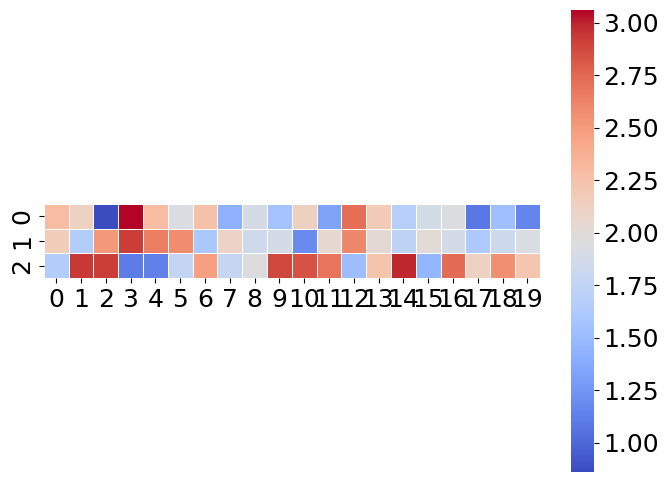

[[2.30391131 2.12227403 0.861089   3.06118042 2.30022295 1.93372825
  2.25714173 1.43543587 1.88618511 1.56161241 2.13226958 1.33234295
  2.72335789 2.19113897 1.67901608 1.87888816 1.94112262 1.0921255
  1.52496954 1.15832319]
 [2.16414645 1.65982218 2.51265099 2.92310236 2.64044743 2.57938102
  1.60548437 2.09873419 1.84162929 1.88331661 1.19574232 2.03083369
  2.60448763 2.02662197 1.72138967 2.00404706 1.87611853 1.61814429
  1.83043823 1.93116871]
 [1.65579322 2.93374763 2.91779517 1.10432785 1.12959651 1.76529348
  2.47178587 1.78016188 1.94997759 2.88562727 2.84604772 2.69972715
  1.50944894 2.23995867 2.98555796 1.45964019 2.73080818 2.10729679
  2.57109148 2.2231882 ]]
#################################


Computing Riemannian distances: 100%|███████████| 3/3 [00:00<00:00, 2467.24it/s]


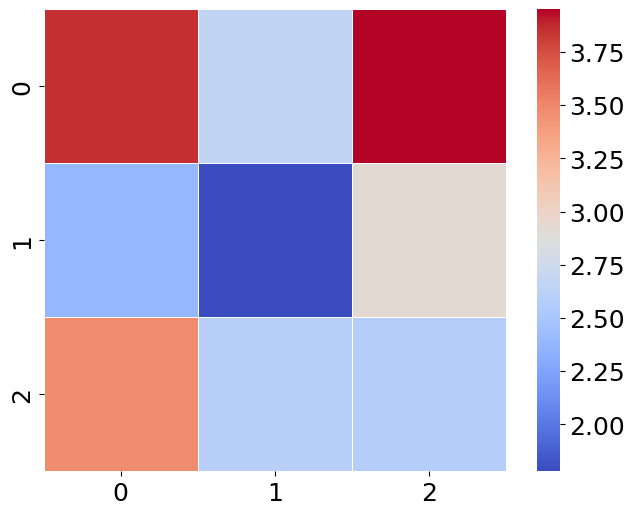

Computing Riemannian distances: 100%|███████████| 3/3 [00:00<00:00, 2087.41it/s]


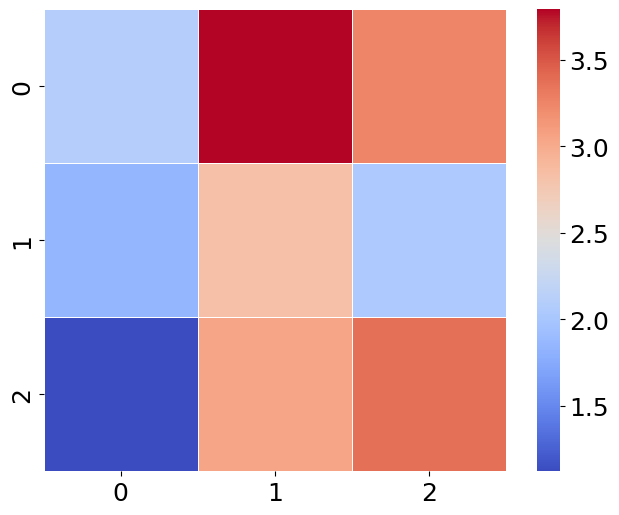

Computing Riemannian distances: 100%|███████████| 3/3 [00:00<00:00, 2164.99it/s]


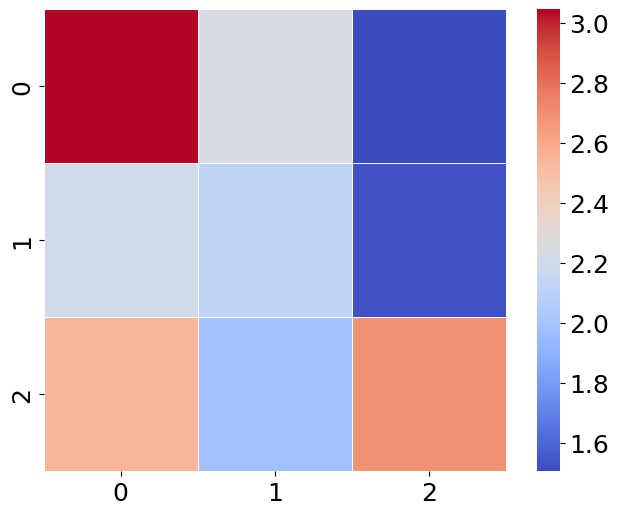

In [80]:
riem = twopair_riemannian_distance(cov_1,cov_2)
plot_mode_no_pairing(riem)
plt.show()
print(riem)
print('#################################')
riem = twopair_riemannian_distance(cov_1,cov_3)
plot_mode_no_pairing(riem)
plt.show()
riem = twopair_riemannian_distance(cov_1,cov_4)
plot_mode_no_pairing(riem)
plt.show()
riem = twopair_riemannian_distance(cov_3,cov_4)
plot_mode_no_pairing(riem)
plt.show()

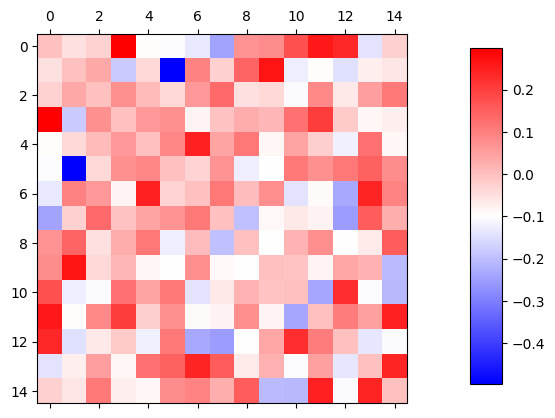

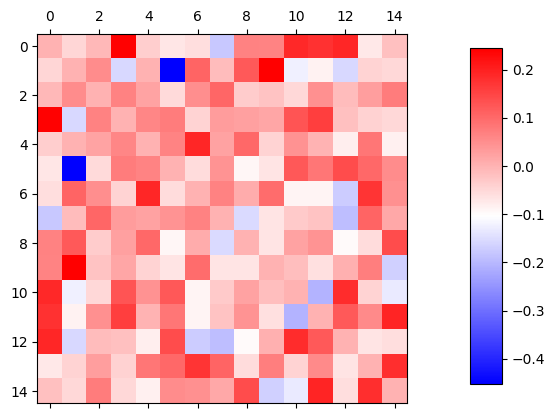

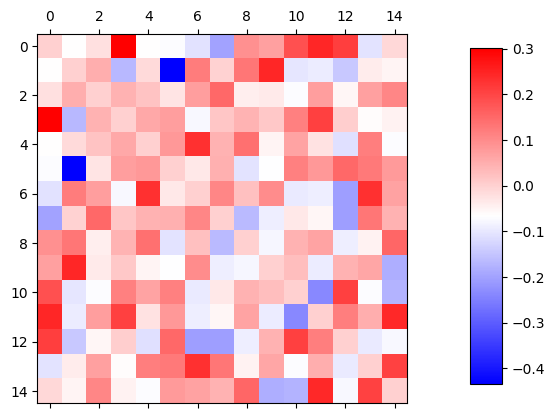

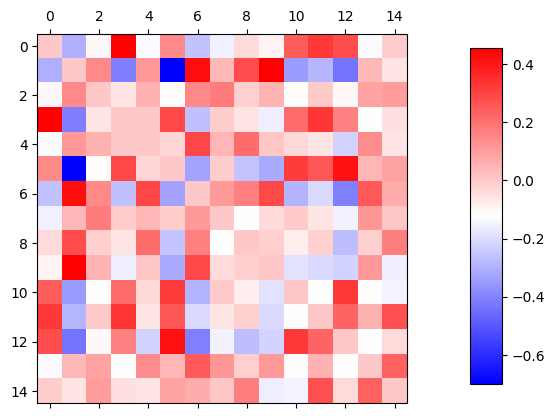

0.2599093189840281
-0.4965476660803827
-0.4344175162919958


In [56]:
std_1,corr_1 = cov2stdcorr(cov_1)
std_2,corr_2 = cov2stdcorr(cov_2)
std_3,corr_3 = cov2stdcorr(cov_3)
plot_matrices(corr_1[0]-np.eye(15),cmap="bwr")
plt.show()
plot_matrices(corr_2[2]-np.eye(15),cmap="bwr")
plt.show()
plot_matrices(corr_3[1]-np.eye(15),cmap="bwr")
plot_matrices(corr_3[0]-np.eye(15),cmap="bwr")
plt.show()
print(corr_1[0][0,11])
print(corr_1[0][1,5])
print(corr_3[1][1,5])

In [99]:
analyse_static_1 = './results_HCP_bicv_202410/ICA_15/swc_check/15_15/swc_ICA_15_state_1/repeat_1/inf_params/'
analyse_static_2 = './results_HCP_bicv_202410/ICA_15_filter_0.05/swc_check/15_15/swc_ICA_15_state_1/repeat_3/inf_params/'
analyse_static_3 = './results_HCP_bicv_202410/ICA_15/hmm_check/hmm_ICA_15_state_1/repeat_3/inf_params/'
cov_static_1 = np.load(f'{analyse_static_1}/covs.npy')
cov_static_2 = np.load(f'{analyse_static_2}/covs.npy')
cov_static_3 = np.load(f'{analyse_static_3}/covs.npy')
print(twopair_riemannian_distance(cov_static_1,cov_static_2))
print(twopair_riemannian_distance(cov_1,cov_static_1))
print(twopair_riemannian_distance(cov_static_2,cov_static_3))

Computing Riemannian distances: 100%|███████████| 1/1 [00:00<00:00, 2785.06it/s]


[[2.59799518]]


Computing Riemannian distances: 100%|███████████| 3/3 [00:00<00:00, 6132.02it/s]


[[0.69552767]
 [1.27393774]
 [1.69083563]]


Computing Riemannian distances: 100%|███████████| 1/1 [00:00<00:00, 3949.44it/s]

[[0.85467562]]


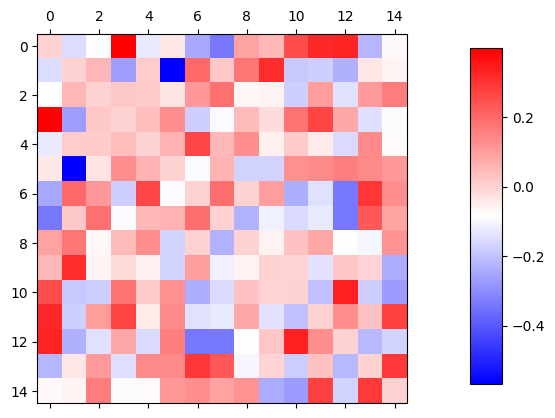

In [64]:
std_static_1,corr_static_1 = cov2stdcorr(cov_static_1)
std_static_2,corr_static_2 = cov2stdcorr(cov_static_2)
plot_matrices(corr_static_1[0]-np.eye(15),cmap="bwr")
plt.show()

Pearson correlation coefficient: 1.000


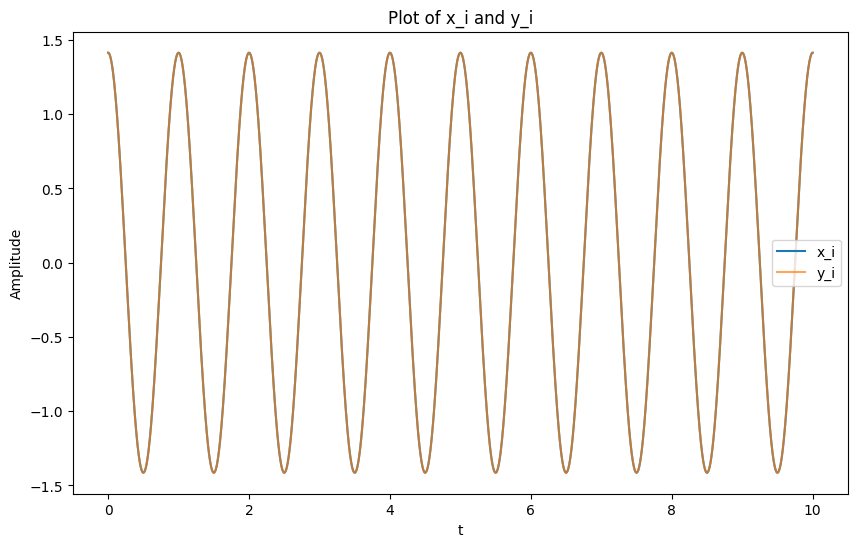

In [74]:
import numpy as np
from scipy.stats import pearsonr
import matplotlib.pyplot as plt

# Parameters
f = 1  # Frequency
TR = 1  # Sampling time
theta = np.pi / 4  # Phase shift

# Generate 10,000 points
n_points = 10000
t = np.linspace(0, 10, n_points)

# Compute x_i and y_i
xi = np.sqrt(2) * np.cos(2 * np.pi * f * t / TR)
yi = np.sqrt(2) * np.cos(2 * np.pi * f * t / TR + theta)

# Calculate Pearson correlation coefficient
corr, _ = pearsonr(xi, yi)

# Print the result
print(f"Pearson correlation coefficient: {corr:.3f}")

# Optional: Plot x_i and y_i
plt.figure(figsize=(10, 6))
plt.plot(t, xi, label="x_i")
plt.plot(t, yi, label="y_i", alpha=0.7)
plt.title("Plot of x_i and y_i")
plt.xlabel("t")
plt.ylabel("Amplitude")
plt.legend()
plt.show()


### Now the time-varying correlation

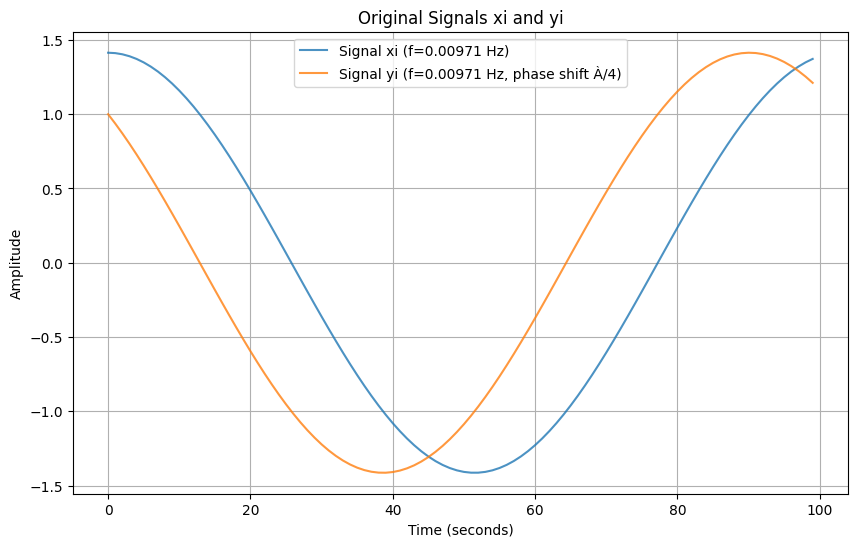

[ 0.97918327  0.97750456 -0.44146653  0.99130043  0.36904163  0.95643261
  0.98644341 -0.72330737  0.98996045  0.8693343   0.86482738  0.99001461
 -0.72097882  0.98630984  0.95738313  0.34515547  0.99131404 -0.42671325
  0.97715517  0.97948177 -0.52100332  0.99119774  0.5040946   0.94978698
  0.98720918 -0.7348388   0.98959513  0.89329605  0.83194247  0.99032261
 -0.70328423  0.98541304  0.96264199  0.18786553  0.99138051 -0.32211147
  0.97477348  0.98117586 -0.58271102  0.99106246  0.6142442   0.94157224
  0.98787849 -0.74182477  0.98917451  0.91174864  0.78837793  0.99058613
 -0.6791211   0.98438337  0.9669826   0.0240833   0.9914167  -0.19398177
  0.97195985  0.9826342  -0.63016065  0.99089283  0.70015418  0.93131187
  0.98846375 -0.74467084  0.98869196  0.92612235  0.73048527  0.99080888
 -0.64694383  0.98319797  0.97059468 -0.13210779  0.99142308 -0.0446922
  0.96861407  0.98389477 -0.66639023  0.99068661  0.76550748  0.9183546
  0.98897525 -0.74353971  0.98813954  0.93744892  0.6

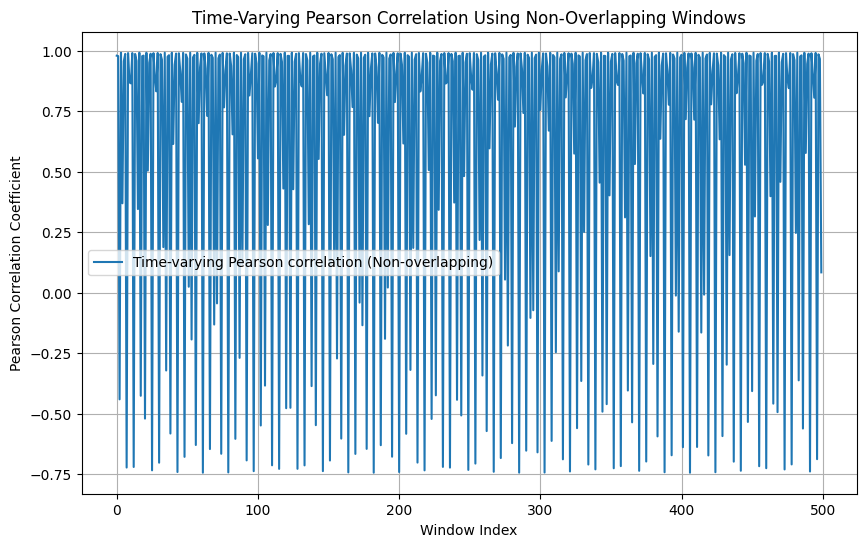

In [96]:
import numpy as np
from scipy.stats import pearsonr
import matplotlib.pyplot as plt

# Parameters
f = 0.00971  # Frequency
TR = 1  # Sampling time
theta = np.pi / 4  # Phase shift
window_length = 20  # Length of the sliding window (adjustable)

# Generate 10,000 points
n_points = 10000
t = np.arange(n_points)

# Compute x_i and y_i
xi = np.sqrt(2) * np.cos(2 * np.pi * f * t * TR)
yi = np.sqrt(2) * np.cos(2 * np.pi * f * t * TR + theta)

# Function to compute non-overlapping window correlation
def non_overlapping_window_corr(x, y, window_length):
    corr_vals = []
    for i in range(0, len(x) - window_length + 1, window_length):
        window_x = x[i:i + window_length]
        window_y = y[i:i + window_length]
        corr, _ = pearsonr(window_x, window_y)
        corr_vals.append(corr)
    return np.array(corr_vals)

# Compute time-varying Pearson correlation
time_varying_corr = non_overlapping_window_corr(xi, yi, window_length)

# Plot original signals (first 100 points for illustration)
plt.figure(figsize=(10, 6))
plt.plot(t[:100], xi[:100], label=f'Signal xi (f={f} Hz)', alpha=0.8)
plt.plot(t[:100], yi[:100], label=f'Signal yi (f={f} Hz, phase shift À/4)', alpha=0.8)
plt.title('Original Signals xi and yi')
plt.xlabel('Time (seconds)')
plt.ylabel('Amplitude')
plt.legend()
plt.grid(True)
plt.show()

# Plot the non-overlapping window correlation
plt.figure(figsize=(10, 6))
plt.plot(time_varying_corr, label='Time-varying Pearson correlation (Non-overlapping)')
print(time_varying_corr)
plt.title('Time-Varying Pearson Correlation Using Non-Overlapping Windows')
plt.xlabel('Window Index')
plt.ylabel('Pearson Correlation Coefficient')
plt.grid(True)
plt.legend()
plt.show()

### Update 1st October 2024

Check the AR(1) model results.

In [6]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from osl_dynamics.utils.plotting import plot_violin

In [9]:
# AR(1) coefficients
ar_1_coefficients_ICA_25 = np.load('./results_HCP_bicv_202410/autocorrelation/ICA_25/ar1_coefficients.npy')
ar_1_coefficients_ICA_25_2 = np.load('./results_HCP_bicv_202410/autocorrelation/ICA_25_2/ar1_coefficients.npy')
ar_1_coefficients_ICA_50 = np.load('./results_HCP_bicv_202410/autocorrelation/ICA_50/ar1_coefficients.npy')
ar_1_coefficients_ICA_50_2 = np.load('./results_HCP_bicv_202410/autocorrelation/ICA_50_2/ar1_coefficients.npy')

# AR(1) intercepts
ar_1_intercepts_ICA_25 = np.load('./results_HCP_bicv_202410/autocorrelation/ICA_25/ar1_intercepts.npy')
ar_1_intercepts_ICA_25_2 = np.load('./results_HCP_bicv_202410/autocorrelation/ICA_25_2/ar1_intercepts.npy')
ar_1_intercepts_ICA_50 = np.load('./results_HCP_bicv_202410/autocorrelation/ICA_50/ar1_intercepts.npy')
ar_1_intercepts_ICA_50_2 = np.load('./results_HCP_bicv_202410/autocorrelation/ICA_50_2/ar1_intercepts.npy')

# AR(1) noises.
ar_1_noises_ICA_25 = np.load('./results_HCP_bicv_202410/autocorrelation/ICA_25/ar1_noises.npy')
ar_1_noises_ICA_25_2 = np.load('./results_HCP_bicv_202410/autocorrelation/ICA_25_2/ar1_noises.npy')
ar_1_noises_ICA_50 = np.load('./results_HCP_bicv_202410/autocorrelation/ICA_50/ar1_noises.npy')
ar_1_noises_ICA_50_2 = np.load('./results_HCP_bicv_202410/autocorrelation/ICA_50_2/ar1_noises.npy')

In [12]:
print(ar_1_coefficients_ICA_25.shape)

(1003, 25)


2024-10-08 08:41:31 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-10-08 08:41:31 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


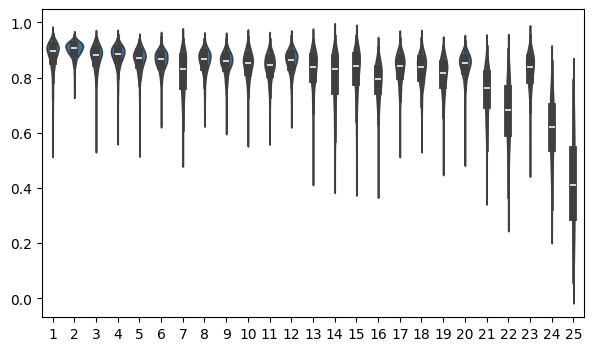

2024-10-08 08:41:31 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-10-08 08:41:32 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


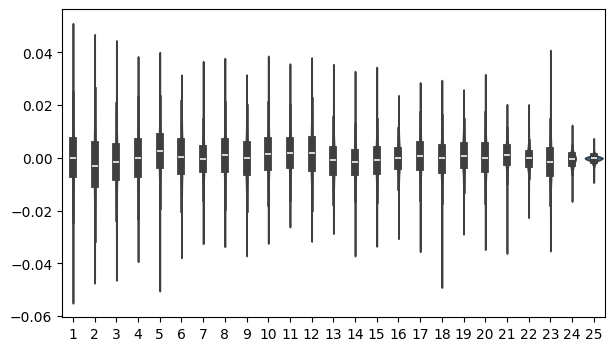

2024-10-08 08:41:32 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-10-08 08:41:32 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


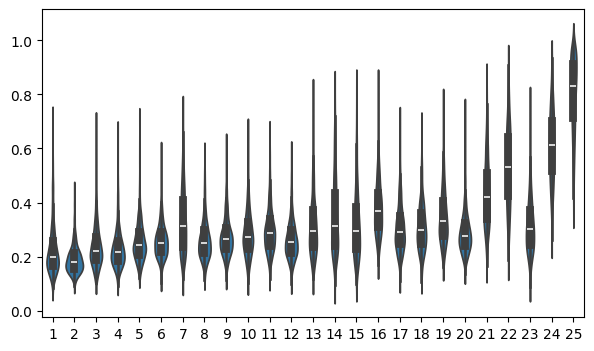

In [11]:
plot_violin(ar_1_coefficients_ICA_25.T)
plt.show()
plot_violin(ar_1_intercepts_ICA_25.T)
plt.show()
plot_violin(ar_1_noises_ICA_25.T)
plt.show()
#plot_violin(ar_1_coefficients_ICA_25_2.T)
#plt.show()
#plot_violin(ar_1_coefficients_ICA_50.T)
#plt.show()
#plot_violin(ar_1_coefficients_ICA_50_2.T)
#plt.show()

/tmp/slurm-15628106/ipykernel_1827574/86538936.py:5: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('rainbow', ar_1_coefficients_ICA_25.shape[1])


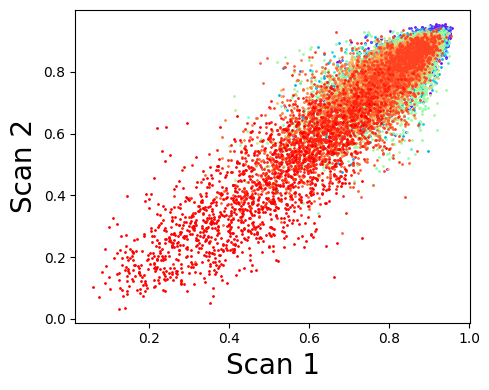

In [20]:
# Create the scatter plot
plt.figure(figsize=(5, 4))

# Use a colormap for the colors (rainbow)
cmap = plt.cm.get_cmap('rainbow', ar_1_coefficients_ICA_25.shape[1])

# Iterate through channels and plot scatter points for each channel with rainbow color
for channel in range(ar_1_coefficients_ICA_25.shape[1]):
    plt.scatter(
        ar_1_coefficients_ICA_25[:, channel],  # AR(1) coefficients from scan 1
        ar_1_coefficients_ICA_25_2[:, channel],  # AR(1) coefficients from scan 2
        color=cmap(channel),  # Color based on the channel index
        label=f'Channel {channel+1}',  # Label the channel
        alpha=1.0,  # Transparency
        s=1  # Dot size (smaller dots)
    )

# Add labels and title
plt.xlabel('Scan 1',fontsize=20)
plt.ylabel('Scan 2',fontsize=20)
#plt.title('Test-Retest Reliability of AR(1) Coefficients Across Channels')

# Place legend outside plot and set dot size
#plt.legend(title='Channel Index', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize='small', ncol=2)  
#plt.grid(True)

# Show plot
plt.tight_layout()
plt.show()

2024-10-08 09:13:21 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-10-08 09:13:21 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


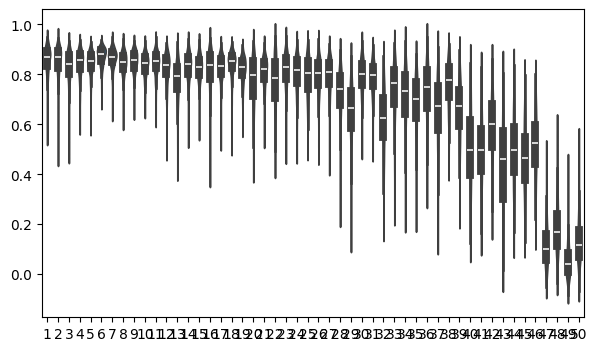

2024-10-08 09:13:22 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-10-08 09:13:22 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


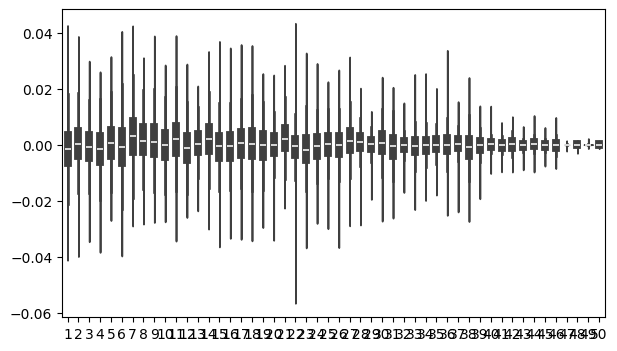

2024-10-08 09:13:23 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-10-08 09:13:23 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


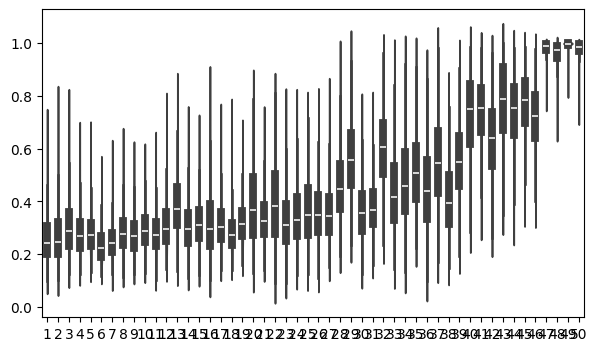

In [21]:
plot_violin(ar_1_coefficients_ICA_50.T)
plt.show()
plot_violin(ar_1_intercepts_ICA_50.T)
plt.show()
plot_violin(ar_1_noises_ICA_50.T)
plt.show()

/tmp/slurm-15628106/ipykernel_1827574/2185444096.py:5: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('rainbow', ar_1_coefficients_ICA_50.shape[1])


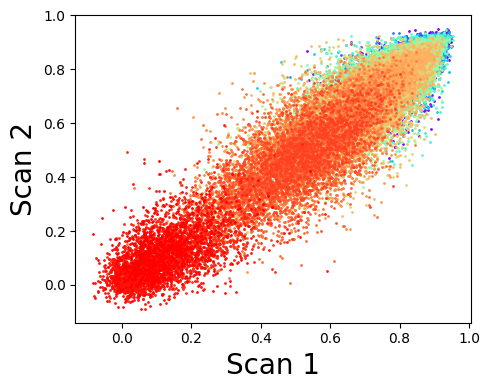

In [32]:
# Create the scatter plot
plt.figure(figsize=(5, 4))

# Use a colormap for the colors (rainbow)
cmap = plt.cm.get_cmap('rainbow', ar_1_coefficients_ICA_50.shape[1])

# Iterate through channels and plot scatter points for each channel with rainbow color
for channel in range(ar_1_coefficients_ICA_50.shape[1]):
    plt.scatter(
        ar_1_coefficients_ICA_50[:, channel],  # AR(1) coefficients from scan 1
        ar_1_coefficients_ICA_50_2[:, channel],  # AR(1) coefficients from scan 2
        color=cmap(channel),  # Color based on the channel index
        label=f'Channel {channel+1}',  # Label the channel
        alpha=1.0,  # Transparency
        s=1  # Dot size (smaller dots)
    )

# Add labels and title
plt.xlabel('Scan 1',fontsize=20)
plt.ylabel('Scan 2',fontsize=20)
#plt.title('Test-Retest Reliability of AR(1) Coefficients Across Channels')

# Place legend outside plot and set dot size
#plt.legend(title='Channel Index', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize='small', ncol=2)  
#plt.grid(True)

# Show plot
plt.tight_layout()
plt.show()

2024-10-01 10:23:48 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-10-01 10:23:48 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


(<Figure size 700x400 with 1 Axes>, <Axes: >)

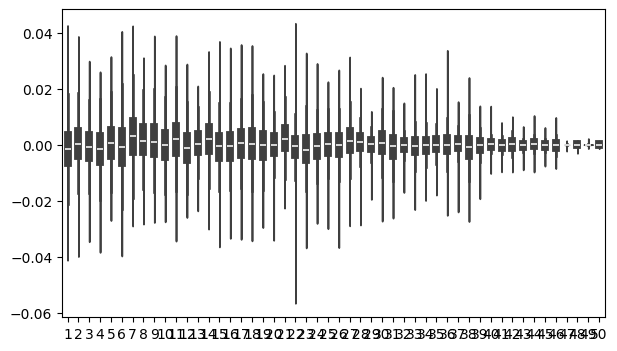

In [130]:
ar_1_intercepts = np.load('./results_HCP_bicv_202410/autocorrelation/ar1_intercepts.npy')
plot_violin(ar_1_intercepts.T)

In [134]:
ar_1_noises = np.load('./results_HCP_bicv_202410/autocorrelation/ar1_noises.npy')
print(ar_1_noises.shape)
plot_violin(ar_1_noises.T)

()


TypeError: len() of unsized object

### Update 9th October 2024

Today's task 1: check whether the baseline model(static FC) for HMM, DyNeMo and SWC are the same.

In [1]:
import os
import json
import pickle
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from osl_dynamics.inference.metrics import alpha_correlation, twopair_riemannian_distance
from osl_dynamics.inference.modes import hungarian_pair
from osl_dynamics.utils.plotting import plot_mode_pairing, plot_mode_no_pairing, plot_matrices
from osl_dynamics.array_ops import cov2stdcorr

from osl_dynamics.inference.modes import argmax_time_courses,fractional_occupancies
from osl_dynamics.array_ops import get_one_hot

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [5]:
# Work on ICA_50 (no filtering), swc/check, compare 100_100 with 25_25 to check the difference.
save_dir_100 = './results_HCP_bicv_202410/ICA_50/swc/check/100_100/swc_ICA_50_state_1/cv_1/fold_1_1/'
save_dir_25 = './results_HCP_bicv_202410/ICA_50/swc/check/25_25/swc_ICA_50_state_1/cv_1/fold_1_1/'

In [7]:
cov_100 = np.load(f'{save_dir_100}/Y_test/inf_params/covs.npy')
cov_25 = np.load(f'{save_dir_25}/Y_test/inf_params/covs.npy')

In [10]:
twopair_riemannian_distance(cov_100 + 0.1 * np.eye(25),cov_25 + 0.1 * np.eye(25))

Computing Riemannian distances: 100%|███████████| 1/1 [00:00<00:00, 2962.08it/s]


array([[1.04237913]])

In [14]:
from osl_dynamics.config_api.wrappers import load_data

In [15]:
## Obviously they are not the same. So you need to reproduce why that's happening.

In [16]:
data_config = {'inputs': './data/node_timeseries/3T_HCP1200_MSMAll_d50_ts2/',
               'kwargs': {'load_memmaps':False, 'sampling_frequency':1.389},
               'prepare':{'select':{'timepoints':[0,1200]},'standardize':{}}
              }
data = load_data(**data_config)
ts_1 = data.time_series()[0]

Standardize: 100%|████████████████████████| 1003/1003 [00:00<00:00, 2131.12it/s]


In [17]:
print(ts_1.shape)

(1200, 50)


Now just work out an SWC+K-means on ts_1

In [18]:
from osl_dynamics.analysis import connectivity

In [20]:
swc_100 = connectivity.sliding_window_connectivity([ts_1], window_length=100,
                                                       step_size=100,
                                                       conn_type="cov")

Calculating connectivity: 100%|███████████████████| 1/1 [00:00<00:00,  5.70it/s]


In [25]:
print(swc_100.shape)
print(np.average(swc_100[:4],axis=0)

(12, 50, 50)
(50, 50)


In [22]:
swc_25 = connectivity.sliding_window_connectivity([ts_1], window_length=25,
                                                       step_size=25,
                                                       conn_type="cov")

Calculating connectivity: 100%|██████████████████| 1/1 [00:00<00:00, 436.91it/s]


In [24]:
print(swc_25.shape)

(48, 50, 50)


In [41]:
np.average(np.abs(np.average(swc_25[4:8],axis=0)-swc_100[1]))

0.06786757

In [33]:
temp = np.cov(ts_1[:100], rowvar=False)
print(temp.shape)
np.sum(np.abs(temp-swc_100[0]))

(50, 50)


1.0918330378032772e-05

In [34]:
def demean(data,window_size):
    n_timepoints, n_channels = data.shape

    # Reshape the data into windows of size (25, 50)
    n_windows = n_timepoints // window_size 
    data_reshaped = data[:n_windows * window_size].reshape(n_windows, window_size, n_channels)

    # Demean within each window
    data_demeaned = np.empty_like(data_reshaped)
    for i in range(n_windows):
        window = data_reshaped[i]
        window_mean = np.mean(window, axis=0)  # Mean of each channel within the window
        data_demeaned[i] = window - window_mean  # Demean the window

    # Reshape back to the original shape (1200, 50)
    data_demeaned = data_demeaned.reshape(n_windows * window_size, n_channels)
    return data_demeaned

In [35]:
ts_1_demeaned = demean(ts_1,25)

In [36]:
swc_100_demeaned = connectivity.sliding_window_connectivity([ts_1_demeaned], window_length=100,
                                                             step_size=100,
                                                             conn_type="cov")
swc_25_demeaned = connectivity.sliding_window_connectivity([ts_1_demeaned], window_length=25,
                                                             step_size=25,
                                                             conn_type="cov")

Calculating connectivity: 100%|██████████████████| 1/1 [00:00<00:00, 477.33it/s]


In [40]:
np.average(np.abs(np.average(swc_25_demeaned[4:8],axis=0)-swc_100_demeaned[1]))

0.003954425

(50, 1200)
-0.09003946


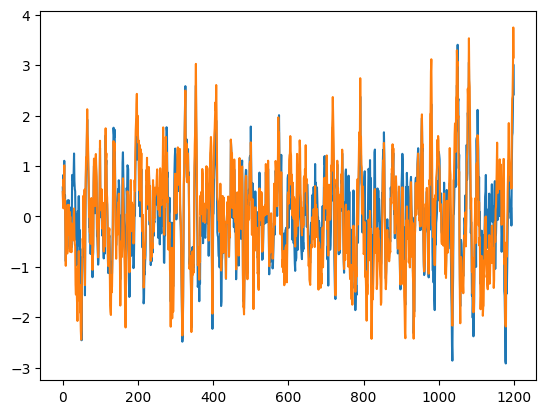

In [48]:
plt.plot(ts_1_demeaned.T[0,:])
plt.plot(ts_1.T[0,:])
print(ts_1.T.shape)
print(np.mean(ts_1.T[0,:25]))

In [6]:
# Step 1: Generate a random covariance matrix (10x10)
np.random.seed(0)  # For reproducibility
n_channels = 10
ground_truth_cov = np.random.rand(n_channels, n_channels)
ground_truth_cov = ground_truth_cov @ ground_truth_cov.T  # To ensure positive definiteness

# Step 2: Generate multivariate Gaussian data with zero mean and the generated covariance matrix
n_timepoints = 10000
data = np.random.multivariate_normal(mean=np.zeros(n_channels), cov=ground_truth_cov, size=n_timepoints)

# Step 3: Define a slow drift function with a periodicity of 250 time points
def slow_drift(t, amplitude):
    return amplitude * np.sin(2 * np.pi * t / 250)

# Apply the slow drift for each amplitude
amplitudes = [0.1, 0.5, 1.0, 2.0,5.0,10.0]
mean_covariances = []

for amplitude in amplitudes:
    drift = np.array([slow_drift(t, amplitude) for t in range(n_timepoints)]).reshape(-1, 1)
    drifted_data = data + drift * np.ones((1, n_channels))  # Add drift to all channels

    # Step 4: Calculate sliding window covariance for non-overlapping windows of size 25
    window_size = 250
    n_windows = n_timepoints // window_size
    sliding_covariances = []

    for i in range(n_windows):
        window_data = drifted_data[i * window_size:(i + 1) * window_size, :]
        window_cov = np.cov(window_data, rowvar=False)
        sliding_covariances.append(window_cov)

    # Step 5: Calculate the mean of the sliding window covariance matrices
    mean_covariance = np.mean(sliding_covariances, axis=0)
    mean_covariances.append(mean_covariance)

# Step 6: Store the mean covariance matrices for each drift amplitude
mean_covariances = np.array(mean_covariances)
'''
# For visualization, plot one of the covariance matrices for reference
plt.imshow(mean_covariances[0], cmap='hot', interpolation='nearest')
plt.title("Mean Covariance Matrix (Amplitude 0.1)")
plt.colorbar()
plt.show()
'''

'\n# For visualization, plot one of the covariance matrices for reference\nplt.imshow(mean_covariances[0], cmap=\'hot\', interpolation=\'nearest\')\nplt.title("Mean Covariance Matrix (Amplitude 0.1)")\nplt.colorbar()\nplt.show()\n'

In [7]:
riem = twopair_riemannian_distance(np.reshape(ground_truth_cov,(1,10,10)),mean_covariances)
print(riem)

Computing Riemannian distances: 100%|███████████| 1/1 [00:00<00:00, 1654.56it/s]

[[0.11360919 0.71419395 1.6389264  2.86738026 4.65070232 6.02961134]]


## Task 2: Understand the effect of slow drift on SWC+K-means

In [25]:
save_dir = './results_HCP_bicv_202410/ICA_50/swc_check/100_100/'

In [26]:
from osl_dynamics.config_api.wrappers import load_data

In [27]:
data_config = {'inputs': './data/node_timeseries/3T_HCP1200_MSMAll_d50_ts2/',
               'kwargs': {'load_memmaps':False, 'sampling_frequency':1.389},
               'prepare':{'select':{'timepoints':[0,1200]},'standardize':{}}
              }
data = load_data(**data_config)

Standardize: 100%|████████████████████████| 1003/1003 [00:00<00:00, 3253.30it/s]


In [28]:
cov_1 = np.load(f'{save_dir}/swc_ICA_50_state_1/repeat_1/inf_params/covs.npy')
cov_2 = np.load(f'{save_dir}/swc_ICA_50_state_1/repeat_2/inf_params/covs.npy')
cov_3 = np.load(f'{save_dir}/swc_ICA_50_state_1/repeat_3/inf_params/covs.npy')

In [29]:
ts = data.time_series()

In [30]:
# Step 1: Calculate the covariance matrices for each subject
cov_matrices = [np.cov(subject, rowvar=False) for subject in ts]

# Step 2: Concatenate all subjects' time series data and calculate the covariance of concatenated data.
ts_cat = np.concatenate(ts, axis=0)
group_covariance = np.cov(ts_cat, rowvar=False)

# Step 3: Check whether "covariance then mean" is the same as "concatenate then covariance"
mean_covariance = np.mean(cov_matrices, axis=0)
# Check if mean covariance is approximately equal to group-level covariance
print("\nDifference between mean of individual covariances and group-level covariance:")
print(np.average(np.abs(mean_covariance - group_covariance)))



Difference between mean of individual covariances and group-level covariance:
0.00012946996247890566


In [31]:
print(twopair_riemannian_distance(np.reshape(group_covariance,(1,50,50)),cov_1))
print(twopair_riemannian_distance(cov_1,cov_2))
print(np.mean(twopair_riemannian_distance(np.reshape(group_covariance,(1,50,50)),np.array(cov_matrices))))
print(np.mean(twopair_riemannian_distance(cov_1,np.array(cov_matrices))))

Computing Riemannian distances: 100%|█████████████| 1/1 [00:00<00:00, 12.62it/s]


[[0.21336814]]


Computing Riemannian distances: 100%|████████████| 1/1 [00:00<00:00, 564.97it/s]


[[1.33982437e-07]]


Computing Riemannian distances: 100%|█████████████| 1/1 [00:00<00:00,  1.18it/s]


6.032552949015559


Computing Riemannian distances: 100%|█████████████| 1/1 [00:00<00:00,  1.68it/s]

5.956736507761602


In [41]:
cov_two_centroid_1 = np.load(f'{save_dir}/swc_ICA_50_state_2/repeat_1/inf_params/covs.npy')
cov_two_centroid_2 = np.load(f'{save_dir}/swc_ICA_50_state_2/repeat_2/inf_params/covs.npy')
cov_two_centroid_3 = np.load(f'{save_dir}/swc_ICA_50_state_2/repeat_3/inf_params/covs.npy')
with open(f'{save_dir}/swc_ICA_50_state_2/repeat_1/inf_params/alp.pkl','rb') as file:
    alpha_1 = pickle.load(file)
with open(f'{save_dir}/swc_ICA_50_state_2/repeat_2/inf_params/alp.pkl','rb') as file:
    alpha_2 = pickle.load(file)
with open(f'{save_dir}/swc_ICA_50_state_2/repeat_3/inf_params/alp.pkl','rb') as file:
    alpha_3 = pickle.load(file)
cov_three_centroid_1 = np.load(f'{save_dir}/swc_ICA_50_state_3/repeat_1/inf_params/covs.npy')
cov_three_centroid_2 = np.load(f'{save_dir}/swc_ICA_50_state_3/repeat_2/inf_params/covs.npy')
cov_three_centroid_3 = np.load(f'{save_dir}/swc_ICA_50_state_3/repeat_3/inf_params/covs.npy')
with open(f'{save_dir}/swc_ICA_50_state_3/repeat_1/inf_params/alp.pkl','rb') as file:
    alpha_three_centroid_1 = pickle.load(file)
with open(f'{save_dir}/swc_ICA_50_state_3/repeat_2/inf_params/alp.pkl','rb') as file:
    alpha_three_centroid_2 = pickle.load(file)
with open(f'{save_dir}/swc_ICA_50_state_3/repeat_3/inf_params/alp.pkl','rb') as file:
    alpha_three_centroid_3 = pickle.load(file)

cov_eight_centroid_1 = np.load(f'{save_dir}/swc_ICA_50_state_8/repeat_1/inf_params/covs.npy')
cov_eight_centroid_2 = np.load(f'{save_dir}/swc_ICA_50_state_8/repeat_2/inf_params/covs.npy')
cov_eight_centroid_3 = np.load(f'{save_dir}/swc_ICA_50_state_8/repeat_3/inf_params/covs.npy')
with open(f'{save_dir}/swc_ICA_50_state_8/repeat_1/inf_params/alp.pkl','rb') as file:
    alpha_eight_centroid_1 = pickle.load(file)
with open(f'{save_dir}/swc_ICA_50_state_8/repeat_2/inf_params/alp.pkl','rb') as file:
    alpha_eight_centroid_2 = pickle.load(file)
with open(f'{save_dir}/swc_ICA_50_state_8/repeat_3/inf_params/alp.pkl','rb') as file:
    alpha_eight_centroid_3 = pickle.load(file)

In [42]:
twopair_riemannian_distance(cov_two_centroid_1,cov_two_centroid_3)

Computing Riemannian distances: 100%|████████████| 2/2 [00:00<00:00, 302.42it/s]


array([[2.45136681, 0.00646818],
       [0.01039523, 2.44827113]])

In [43]:
alpha_1[0]

array([0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0], dtype=int32)

In [44]:
from osl_dynamics.analysis import connectivity
swc = connectivity.sliding_window_connectivity(ts, window_length=100,step_size=100,conn_type="cov")

Calculating connectivity: 100%|███████████| 1003/1003 [00:00<00:00, 1323.58it/s]


In [45]:
swc[0].shape

(12, 50, 50)

In [46]:
np.average(np.abs(cov_1 - np.mean(np.concatenate(swc,axis=0),axis=0)))

1.8602809868752956e-07

In [47]:
alpha_1[0].shape

(12,)

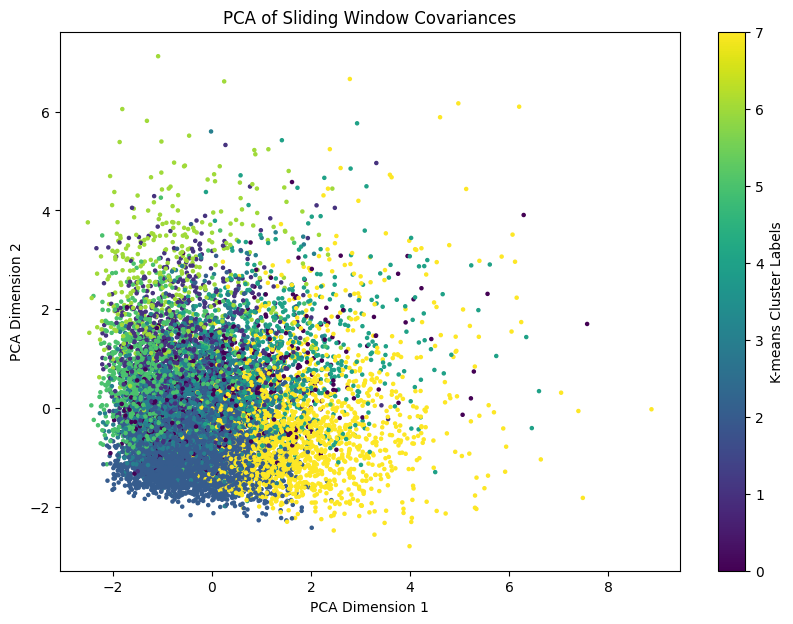

In [48]:
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
# Step 1: Extract the upper triangular part (including diagonal) of each (15, 15) covariance matrix
# Use np.triu_indices to get the indices for the upper triangular part
triu_indices = np.triu_indices(15)

# Extract upper triangular part of each covariance matrix for all subjects
upper_triangular_swc = [session[:, triu_indices[0], triu_indices[1]] for session in swc]  # shape will be (80, 120) for each session

# Step 2: Concatenate all upper triangular matrices (1003 sessions, each with 80 windows)
# Now we have (1003*80, 120) overall
all_cov_matrices_upper_tri = np.concatenate(upper_triangular_swc, axis=0)

# Step 3: Concatenate the alpha_1 list to create a long array of labels
all_labels = np.concatenate(alpha_eight_centroid_1)  # shape will be (1003*80,)

# Step 4: Apply t-SNE to reduce dimensionality to 2D
pca = PCA(n_components=2)
pca_results = pca.fit_transform(all_cov_matrices_upper_tri)

# Step 5: Plot the t-SNE results and color them by the K-means labels (alpha_1)
plt.figure(figsize=(10, 7))
scatter = plt.scatter(pca_results[:, 0], pca_results[:, 1], c=all_labels, cmap='viridis', s=5)

# Add a colorbar
plt.colorbar(scatter, label="K-means Cluster Labels")
plt.title("PCA of Sliding Window Covariances")
plt.xlabel("PCA Dimension 1")
plt.ylabel("PCA Dimension 2")
plt.show()


/tmp/slurm-16284842/ipykernel_2385275/243493234.py:13: UserWarning: You passed a edgecolor/edgecolors ('black') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  first_80 = plt.scatter(pca_results[:80, 0], pca_results[:80, 1], c=first_80_colors, cmap=cmap_red_white_blue, marker='x', s=50, edgecolor='black')


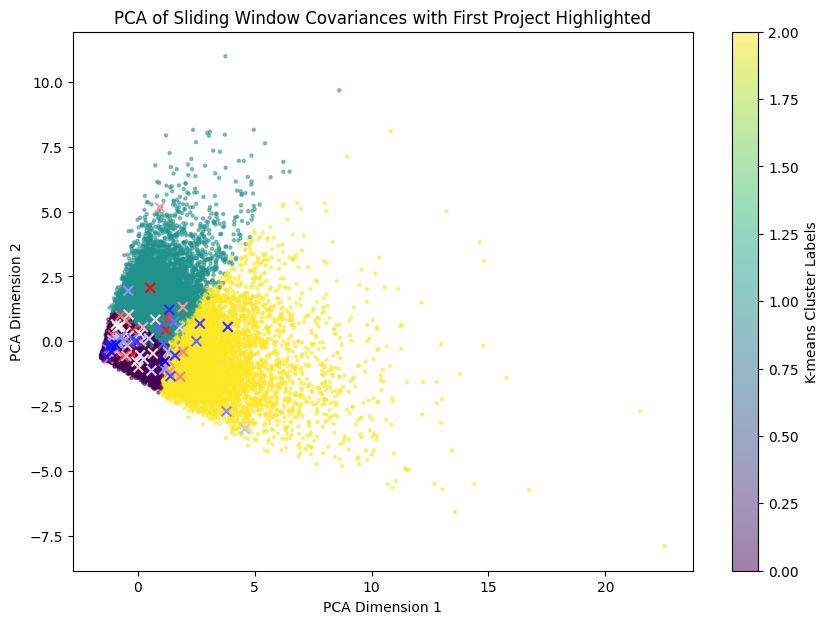

In [65]:
from matplotlib.colors import LinearSegmentedColormap

# Create a custom colormap from red to white to blue
cmap_red_white_blue = LinearSegmentedColormap.from_list('red_white_blue', ['red', 'white', 'blue'], N=80)

plt.figure(figsize=(10, 7))

# Plot the entire dataset with transparency (alpha) for all points
scatter = plt.scatter(pca_results[:, 0], pca_results[:, 1], c=np.concatenate(alpha_three_centroid_1), cmap='viridis', s=5, alpha=0.5)

# Overlay the first 80 points with crosses ('x') and varying color from red to blue
first_80_colors = np.linspace(0, 1, 80)  # Gradient for the first 80 points
first_80 = plt.scatter(pca_results[:80, 0], pca_results[:80, 1], c=first_80_colors, cmap=cmap_red_white_blue, marker='x', s=50, edgecolor='black')

# Add a colorbar for the main scatter plot
plt.colorbar(scatter, label="K-means Cluster Labels")

# Title and labels
plt.title("PCA of Sliding Window Covariances with First Project Highlighted")
plt.xlabel("PCA Dimension 1")
plt.ylabel("PCA Dimension 2")

# Show the plot
plt.show()

#### Task 3: (Seriously!) check where the bi-cross validated log likelihood gain from N_states = 1 to 2 in ICA_15/swc/15_15

In [72]:
import os
import json
import pickle
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn.cluster import KMeans

from osl_dynamics.inference.metrics import alpha_correlation, twopair_riemannian_distance
from osl_dynamics.inference.modes import hungarian_pair
from osl_dynamics.utils.plotting import plot_mode_pairing, plot_mode_no_pairing, plot_matrices
from osl_dynamics.array_ops import cov2stdcorr
from osl_dynamics.inference.modes import argmax_time_courses,fractional_occupancies
from osl_dynamics.array_ops import get_one_hot
from osl_dynamics.analysis import connectivity
from osl_dynamics.config_api.wrappers import load_data
from osl_dynamics.array_ops import estimate_gaussian_log_likelihood

In [50]:
data_config = {'inputs': './data/node_timeseries/3T_HCP1200_MSMAll_d15_ts2/',
               'kwargs': {'load_memmaps':False, 'sampling_frequency':1.389},
               'prepare':{'select':{'timepoints':[0,1200]},'standardize':{}}
              }
data = load_data(**data_config)

Standardize: 100%|███████████████████████| 1003/1003 [00:00<00:00, 10174.74it/s]


In [52]:
ts_1 = data.time_series()[0]
ts_1.shape

(1200, 15)

In [59]:
swc_15 = connectivity.sliding_window_connectivity([ts_1], window_length=15,step_size=15,conn_type="cov")
swc_100 = connectivity.sliding_window_connectivity([ts_1], window_length=100,step_size=100,conn_type="cov")
swc_600 = connectivity.sliding_window_connectivity([ts_1], window_length=600,step_size=600,conn_type="cov")
swc_1200 = connectivity.sliding_window_connectivity([ts_1], window_length=1200,step_size=1200,conn_type="cov")
print(swc_15.shape)
print(swc_100.shape)
print(swc_600.shape)
print(swc_1200.shape)

Calculating connectivity: 100%|█████████████████| 1/1 [00:00<00:00, 2240.55it/s]

(80, 15, 15)
(12, 15, 15)
(2, 15, 15)
(1, 15, 15)


In [61]:
print(twopair_riemannian_distance(np.mean(swc_15,axis=0,keepdims=True),np.reshape(swc_1200,(1,15,15))))
print(twopair_riemannian_distance(np.mean(swc_100,axis=0,keepdims=True),np.reshape(swc_1200,(1,15,15))))
print(twopair_riemannian_distance(np.mean(swc_600,axis=0,keepdims=True),np.reshape(swc_1200,(1,15,15))))

Computing Riemannian distances: 100%|███████████| 1/1 [00:00<00:00, 2798.07it/s]


[[2.10799098]]


Computing Riemannian distances: 100%|███████████| 1/1 [00:00<00:00, 3081.78it/s]


[[0.29150118]]


Computing Riemannian distances: 100%|███████████| 1/1 [00:00<00:00, 4401.16it/s]

[[0.00662287]]


In [65]:
swc_15_half_mean = np.mean(swc_15[:40],axis=0,keepdims=True)
swc_100_half_mean = np.mean(swc_100[:6],axis=0,keepdims=True)
swc_600_half_mean = swc_600[0:1]
print(swc_15_half_mean.shape)
print(swc_100_half_mean.shape)
print(swc_600_half_mean.shape)

(1, 15, 15)
(1, 15, 15)
(1, 15, 15)


In [70]:
ts_second_half = ts_1[600:]
print(estimate_gaussian_log_likelihood(ts_second_half,np.zeros((1,15)),swc_15_half_mean,average=True)*600)
print(estimate_gaussian_log_likelihood(ts_second_half,np.zeros((1,15)),swc_100_half_mean,average=True)*600)
print(estimate_gaussian_log_likelihood(ts_second_half,np.zeros((1,15)),swc_600_half_mean,average=True)*600)
print(estimate_gaussian_log_likelihood(ts_second_half,np.zeros((1,15)),swc_1200,average=True)*600)
print(estimate_gaussian_log_likelihood(ts_second_half,np.zeros((1,15)),swc_600[1:2],average=True)*600)

-12804.055645012719
-11593.069303441673
-11532.414471004133
-10798.731765857938
-10590.401082105718


In [80]:
kmeans = KMeans(n_clusters=2)
i, j = np.triu_indices(15, k=0)
# Now let's convert the sliding window connectivity matrices to a series of vectors
swc_100_half_vectors = swc_100[:6, i, j]
# Fitting
kmeans.fit(swc_100_half_vectors)
centroids = kmeans.cluster_centers_
swc_100_half_cov = np.empty([2, 15, 15])
swc_100_half_cov[:, i, j] = centroids
swc_100_half_cov[:, j, i] = centroids
swc_100_half_label = kmeans.labels_

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


In [81]:
print(swc_100_half_cov.shape)
print(swc_100_half_label)

(2, 15, 15)
[1 1 0 0 1 1]


Now (seriously!) let's implement the bi-cross validation

In [71]:
ts_X_train = ts_1[:600,:7]
ts_Y_train = ts_1[:600,7:]
ts_X_test = ts_1[600:,:7]
ts_Y_test = ts_1[600:,7:]
print(ts_X_train.shape)
print(ts_Y_train.shape)
print(ts_X_test.shape)
print(ts_Y_test.shape)

(600, 7)
(600, 8)
(600, 7)
(600, 8)


In [82]:
# Step 1 Train a full SWC model on Y_train.

## Update 17th October 2024

#### Aim: understand the slow drift in fMRI data and how it impacts bi-cross validation (especially on fMRI).

In [1]:
import os
import json
import pickle

import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

from osl_dynamics.inference.metrics import alpha_correlation, twopair_riemannian_distance
from osl_dynamics.inference.modes import hungarian_pair
from osl_dynamics.utils.plotting import plot_mode_pairing, plot_mode_no_pairing, plot_matrices
from osl_dynamics.array_ops import cov2stdcorr
from osl_dynamics.inference.modes import argmax_time_courses,fractional_occupancies
from osl_dynamics.array_ops import get_one_hot
from osl_dynamics.analysis import connectivity
from osl_dynamics.config_api.wrappers import load_data
from osl_dynamics.array_ops import estimate_gaussian_log_likelihood
from scipy.fft import fft, fftfreq

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [177]:
data_config = {'inputs': './data/node_timeseries/3T_HCP1200_MSMAll_d50_ts2/',
               'kwargs': {'load_memmaps':False, 'sampling_frequency':1.389},
               'prepare':{'select':{'timepoints':[0,1200]},'standardize':{}}
              }
data = load_data(**data_config)
data_config_2 = {'inputs': './data/node_timeseries/simulation_bicv/real/',
               'kwargs': {'load_memmaps':False, 'sampling_frequency':1.389},
               'prepare':{'select':{'timepoints':[0,1200]},'standardize':{}}
              }
data_2 = load_data(**data_config_2)
data_config_3 = {'inputs': './data/node_timeseries/simulation_bicv/hrf/',
               'kwargs': {'load_memmaps':False, 'sampling_frequency':1.389},
               'prepare':{'select':{'timepoints':[0,1200]},'standardize':{}}
              }
data_3 = load_data(**data_config_3)

Standardize: 100%|██████████████████████████| 500/500 [00:00<00:00, 7652.89it/s]


In [125]:
data_config_4 = {'inputs': './data/node_timeseries/simulation_bicv/swc_50_random_hrf/',
               'kwargs': {'load_memmaps':False, 'sampling_frequency':1.389},
               'prepare':{'select':{'timepoints':[0,1200]},'standardize':{}}
              }
data_4 = load_data(**data_config_4)
data_config_5 = {'inputs': './data/node_timeseries/simulation_bicv/swc_50_random_hrf_stable/',
               'kwargs': {'load_memmaps':False, 'sampling_frequency':1.389},
               'prepare':{'select':{'timepoints':[0,1200]},'standardize':{}}
              }
data_5 = load_data(**data_config_5)

Standardize: 100%|██████████████████████████| 500/500 [00:00<00:00, 4962.26it/s]


In [138]:
data_config_6 = {'inputs': './data/node_timeseries/simulation_bicv/swc_50_random/',
               'kwargs': {'load_memmaps':False, 'sampling_frequency':1.389},
               'prepare':{'select':{'timepoints':[0,1200]},'standardize':{}}
              }
data_6 = load_data(**data_config_6)
data_config_7 = {'inputs': './data/node_timeseries/simulation_bicv/swc_50_random_stable/',
               'kwargs': {'load_memmaps':False, 'sampling_frequency':1.389},
               'prepare':{'select':{'timepoints':[0,1200]},'standardize':{}}
              }
data_7 = load_data(**data_config_7)

Standardize: 100%|██████████████████████████| 500/500 [00:00<00:00, 3358.63it/s]


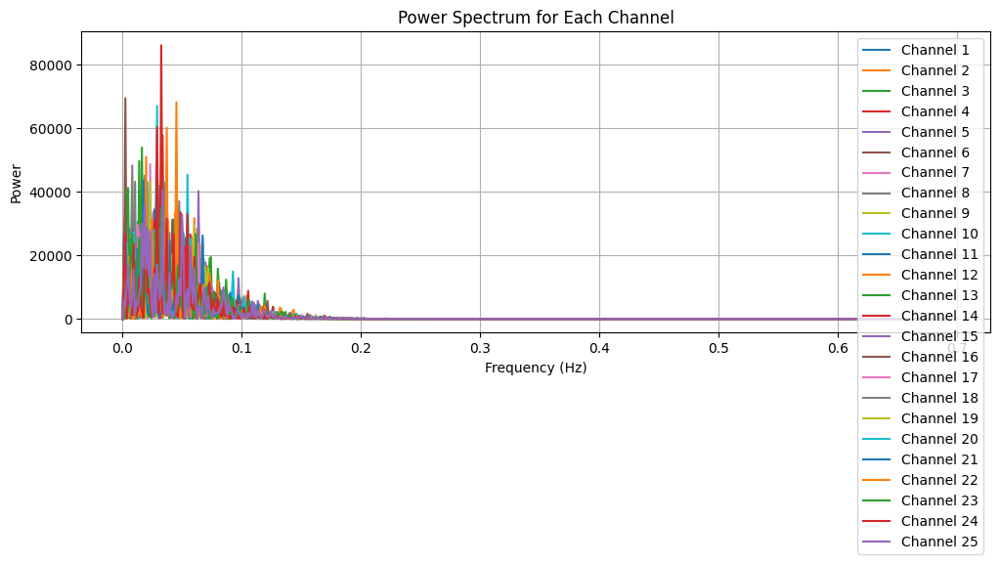

In [3]:
ts_1 = data_3.time_series()[0]

def plot_power_spectrum(x, fs):
    """
    Plot the power spectrum for multivariate time series data (N_timepoints, N_channels).

    Parameters:
    - x: numpy array of shape (N_timepoints, N_channels), input time series data
    - fs: float, sampling frequency (e.g., 1/TR)

    Returns:
    - None, but plots the power spectrum.
    """
    N_timepoints, N_channels = x.shape
    
    # Fourier Transform
    yf = fft(x, axis=0)  # Compute FFT along time dimension
    xf = fftfreq(N_timepoints, 1/fs)[:N_timepoints//2]  # Frequency axis

    # Calculate power spectrum (magnitude squared of FFT)
    power_spectrum = np.abs(yf[:N_timepoints//2, :])**2
    
    # Plot power spectrum for each channel
    plt.figure(figsize=(12, 4))
    for channel in range(N_channels):
        plt.plot(xf, power_spectrum[:, channel], label=f'Channel {channel + 1}')
    
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Power')
    plt.title('Power Spectrum for Each Channel')
    plt.legend()
    plt.grid(True)
    plt.show()

# Example usage
N_timepoints, N_channels = ts_1.shape
fs = 1 / 0.72
plot_power_spectrum(ts_1, fs)

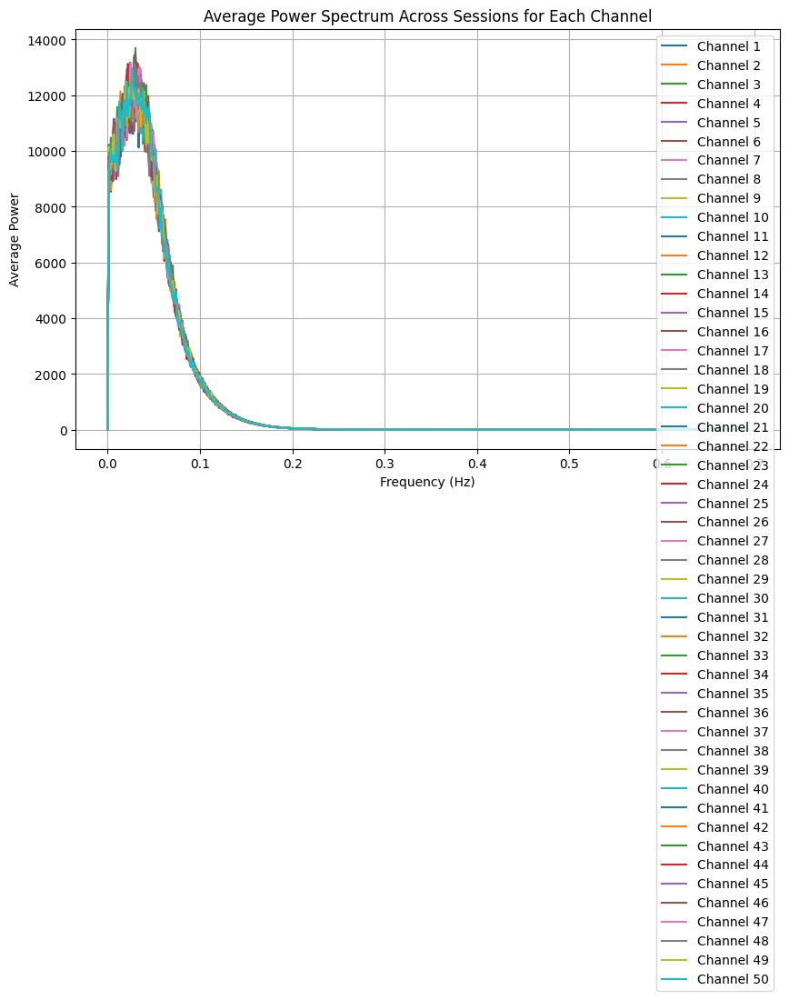

In [127]:
def plot_average_power_spectrum(data, fs):
    """
    Plot the average power spectrum for multivariate time series data (N_timepoints, N_channels)
    across multiple sessions.

    Parameters:
    - data: list of numpy arrays, each of shape (N_timepoints, N_channels), input time series data for each session
    - fs: float, sampling frequency (e.g., 1/TR)

    Returns:
    - None, but plots the average power spectrum across sessions.
    """
    N_sessions = len(data)
    N_timepoints, N_channels = data[0].shape
    
    # Initialize the sum of power spectra to zero
    avg_power_spectrum = np.zeros((N_timepoints // 2, N_channels))
    
    # Compute the power spectrum for each session and accumulate
    for session_data in data:
        # Fourier Transform for each session
        yf = fft(session_data, axis=0)
        power_spectrum = np.abs(yf[:N_timepoints//2, :])**2
        
        # Accumulate the power spectra across sessions
        avg_power_spectrum += power_spectrum
    
    # Take the average by dividing by the number of sessions
    avg_power_spectrum /= N_sessions
    
    # Frequency axis
    xf = fftfreq(N_timepoints, 1/fs)[:N_timepoints//2]

    # Plot average power spectrum for each channel
    plt.figure(figsize=(10, 6))
    for channel in range(N_channels):
        plt.plot(xf, avg_power_spectrum[:, channel], label=f'Channel {channel + 1}')
    
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Average Power')
    plt.title('Average Power Spectrum Across Sessions for Each Channel')
    plt.legend()
    plt.grid(True)
    plt.show()

# Example usage
fs = 1 / 0.72  # Example sampling frequency
plot_average_power_spectrum(data_5.time_series(), fs)

In [131]:
data_5.time_series()[0].shape

(1200, 50)

In [162]:
def sliding_window_histogram(data_list, window_length):
    """
    Calculates sliding window mean activation and plots histograms for each channel across all sessions.
    
    Parameters:
    data_list : list of np.ndarray
        List where each element is a 2D numpy array representing the fMRI data of a session 
        with shape (T, N), where T is the number of time points and N is the number of channels.
    window_length : int
        Length of the sliding window.
    """
    all_mean_activations = []
    num_channels = data_list[0].shape[1]  # assuming all sessions have the same number of channels

    # Calculate mean activations for each channel across sliding windows
    for session_data in data_list:
        T, N = session_data.shape
        for start in range(0, T - window_length + 1, window_length):
            window = session_data[start:start + window_length, :]
            mean_activation = np.mean(window, axis=0)  # mean for each channel
            all_mean_activations.append(mean_activation)

    all_mean_activations = np.array(all_mean_activations)  # shape (num_windows * num_sessions, N)

    # Plot histograms for each channel in one figure
    plt.figure(figsize=(10, 7))
    for channel in range(num_channels):
        channel_variance = np.var(all_mean_activations[:, channel])
        print(f"Variance for Channel {channel + 1}: {channel_variance}")
        plt.hist(all_mean_activations[:, channel], bins=100, alpha=0.5, label=f'Channel {channel + 1}')
    
    # Set title and axis labels with font size adjustments
    #plt.title('Histogram of Sliding Window Mean Activations for Each Channel', fontsize=16)
    plt.xlabel('Mean Activation', fontsize=20)
    plt.ylabel('Frequency', fontsize=20)

    # Adjust the font size of x and y ticks
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)

Variance for Channel 1: 0.07287275046110153
Variance for Channel 2: 0.07488765567541122
Variance for Channel 3: 0.07351040840148926
Variance for Channel 4: 0.0732908621430397
Variance for Channel 5: 0.07275617867708206
Variance for Channel 6: 0.07475277036428452
Variance for Channel 7: 0.0746564045548439
Variance for Channel 8: 0.07142427563667297
Variance for Channel 9: 0.07446171343326569
Variance for Channel 10: 0.07310523092746735
Variance for Channel 11: 0.07337898761034012
Variance for Channel 12: 0.07606662809848785
Variance for Channel 13: 0.07185149192810059
Variance for Channel 14: 0.07243575900793076
Variance for Channel 15: 0.07111853361129761
Variance for Channel 16: 0.07461801916360855
Variance for Channel 17: 0.07231946289539337
Variance for Channel 18: 0.07208345085382462
Variance for Channel 19: 0.07300945371389389
Variance for Channel 20: 0.07345332205295563
Variance for Channel 21: 0.07342461496591568
Variance for Channel 22: 0.07439865916967392
Variance for Channel 

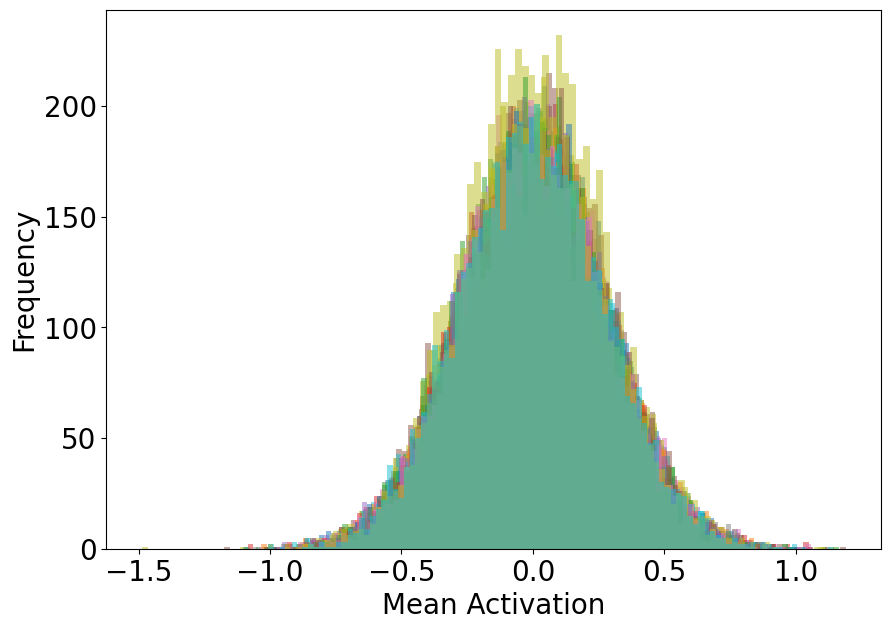

In [184]:
sliding_window_histogram(data_4.time_series(),100)

In [176]:
np.mean(data_6.time_series()[0],axis=0)

array([-9.5367430e-09, -1.2318293e-08,  0.0000000e+00, -6.3578289e-09,
        3.5762786e-09, -3.9736432e-09,  2.1457673e-08,  1.5894573e-08,
       -1.3113022e-08,  2.3841857e-09, -1.3113022e-08,  1.5099843e-08,
       -3.1789145e-09,  1.7484028e-08,  2.3841857e-09, -4.7683715e-09,
       -1.5894572e-09,  3.1789145e-09, -1.5894573e-08, -1.2715658e-08,
       -9.5367430e-09,  3.1789145e-09,  7.9472862e-10,  1.5894572e-09,
        5.5631002e-09,  6.3578289e-09, -1.7682710e-08, -1.7285346e-08,
       -7.1525572e-09,  0.0000000e+00,  1.7484028e-08,  1.4305114e-08,
       -7.9472862e-10,  7.1525572e-09,  1.5894572e-09,  2.3841857e-09,
       -1.5894573e-08, -7.9472864e-09, -9.5367430e-09,  3.1789145e-09,
        9.5367430e-09,  7.9472864e-09,  8.7420142e-09, -9.5367430e-09,
        3.9736432e-09, -9.5367430e-09,  1.2715658e-08, -7.9472864e-09,
       -4.7683715e-09, -5.5631002e-09], dtype=float32)

## Update 21st October 2024

Think about the new simulation with drifts.

In [60]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.fft import fft,fftfreq

In [61]:
data_dir = 'data/node_timeseries/simulation_bicv/swc_drift/'

In [71]:
x = np.loadtxt(f'{data_dir}/high_a_random_f_random_p/10001.txt')
print(x.shape)

(1200, 25)


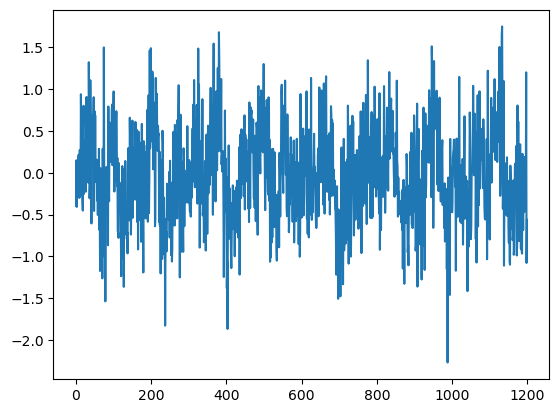

In [72]:
plt.plot(x.T[0])
plt.show()

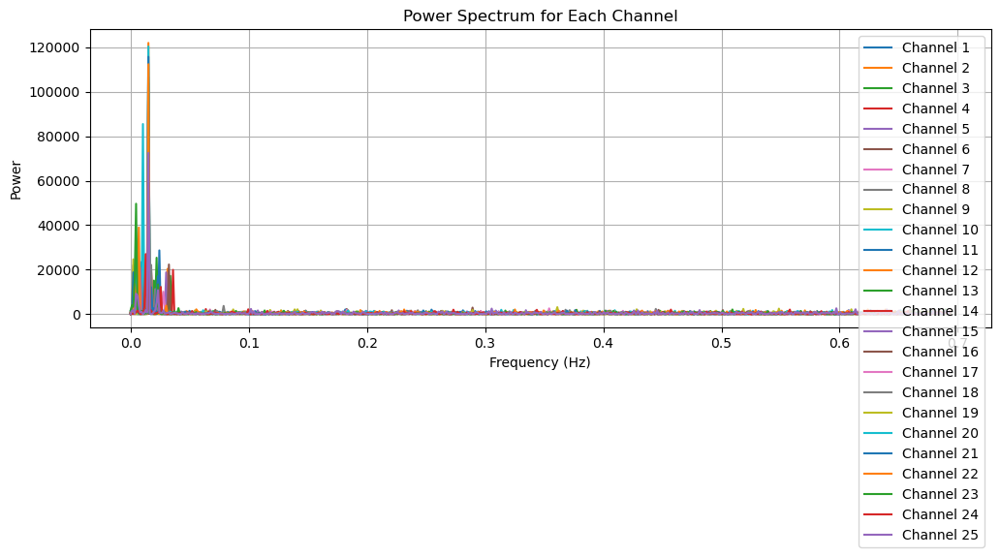

In [73]:
plot_power_spectrum(x, 1/0.72)

## Update 28th October 2024

Outstanding question: The 1/f power spectral density can be easily achieved by adding haemodynamic response function. But if we apply hrf to the i.i.d HMM-generated signals, the dynamics are all gone. Why is that happening?

In [59]:
ground_truth_dir = './data/node_timeseries/simulation_bicv/real/'
inference_dir = './results_simulation_bicv_202407/real/hmm_check/hmm_ICA_25_state_8/repeat_1/inf_params/'
ground_truth_cov = np.load(f'{ground_truth_dir}/truth/state_covariances.npy')
fit_cov = np.load(f'{inference_dir}/covs.npy')

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 594.65it/s]


(<Figure size 800x600 with 2 Axes>, <Axes: >)

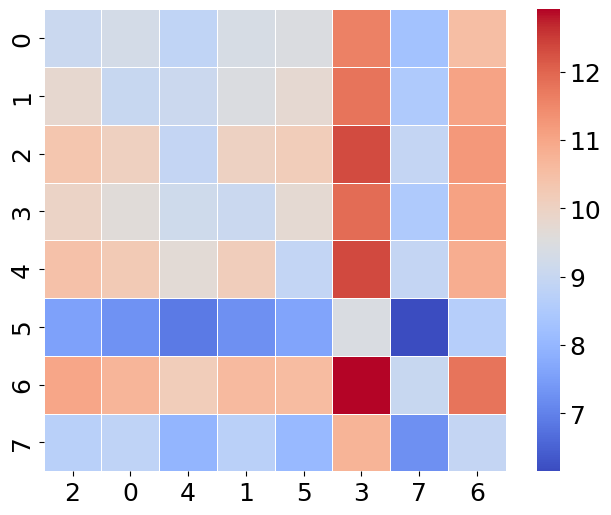

In [46]:
riem = twopair_riemannian_distance(ground_truth_cov,fit_cov)
order,riem_reorder = hungarian_pair(riem,distance=True)
plot_mode_pairing(riem_reorder,order)

In [55]:
import pickle
from osl_dynamics.utils import plotting
from osl_dynamics.inference import modes

In [56]:
alpha_truth = []
for i in range(500):
    alpha_truth.append(np.load(f'{ground_truth_dir}/truth/{10001+i}_state_time_course.npy'))


In [57]:
with open(f'{inference_dir}/alp.pkl','rb') as file:
    alpha_fit = pickle.load(file)

(<Figure size 800x600 with 2 Axes>, <Axes: >)

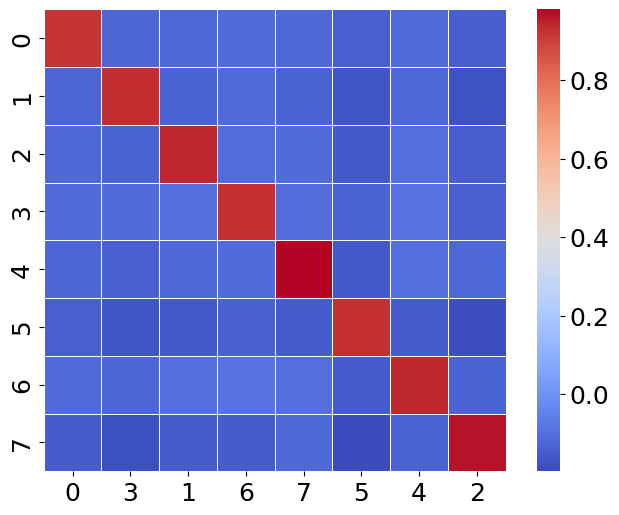

In [58]:
alpha_cor = alpha_correlation(alpha_truth,alpha_fit,return_diagonal=False)
order,alpha_cor_reorder = hungarian_pair(alpha_cor,distance=False)
plot_mode_pairing(alpha_cor_reorder,order)

In [51]:
alpha_truth = modes.argmax_time_courses(alpha_truth)
alpha_fit = modes.argmax_time_courses(alpha_fit)

2024-10-29 08:38:56 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-10-29 08:38:56 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


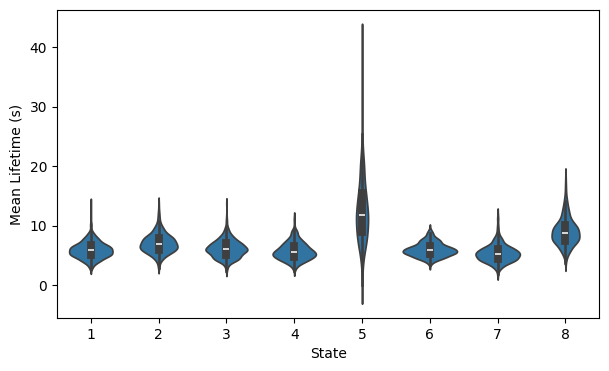

In [52]:
plotting.plot_violin(modes.mean_lifetimes(alpha_truth,sampling_frequency=1/0.7).T,x_label="State", y_label="Mean Lifetime (s)")
plt.show()

2024-10-29 08:39:01 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-10-29 08:39:01 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


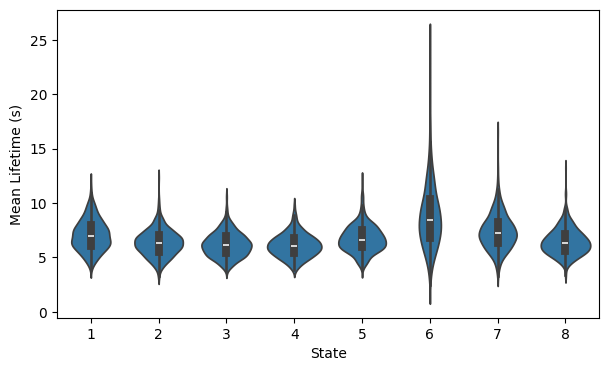

In [53]:
plotting.plot_violin(modes.mean_lifetimes(alpha_fit,sampling_frequency=1/0.7).T,x_label="State", y_label="Mean Lifetime (s)")
plt.show()

## Update 30th October 2024

Aim: understand how the hrf affects the covariance structure.

In [62]:
import pickle
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

from osl_dynamics.array_ops import apply_hrf

In [75]:
# Generate synthetic neuronal signals with a specified correlation
N_timepoints = 100
rho = 0.5  # Desired correlation coefficient
x1 = np.random.randn(N_timepoints)
x2 = rho * x1 + np.sqrt(1 - rho**2) * np.random.randn(N_timepoints)
X = np.column_stack([x1, x2])

# Initial covariance of X
initial_covariance = np.cov(X, rowvar=False)
print("Initial covariance matrix:\n", initial_covariance)

# Apply HRF convolution
tr = 0.72  # Repetition time (TR) in seconds
Y = apply_hrf(X, tr)

# Covariance after HRF convolution
hrf_covariance = np.cov(Y, rowvar=False)
print("Covariance matrix after HRF:\n", hrf_covariance)

Initial covariance matrix:
 [[0.88621533 0.45789194]
 [0.45789194 0.98707828]]
Covariance matrix after HRF:
 [[0.14035703 0.10727209]
 [0.10727209 0.19535819]]


In [76]:
from osl_dynamics import models
from osl_dynamics.config_api.wrappers import load_data

2024-10-30 16:15:08.812065: I tensorflow/core/util/util.cc:169] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-10-30 16:15:09.579479: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2024-10-30 16:15:09.579500: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


In [106]:
data_config = {'inputs': './data/node_timeseries/simulation_bicv/real_hrf_50_stable/',
               'kwargs': {'load_memmaps':False, 'sampling_frequency':1.389},
               'prepare':{'select':{'timepoints':[0,1200]},'standardize':{}}
              }
data = load_data(**data_config)

Standardize: 100%|██████████████████████████| 500/500 [00:00<00:00, 4392.18it/s]


In [107]:
alpha = []
for i in range(500):
    alpha.append(np.load(f'./data/node_timeseries/simulation_bicv/real_hrf_50_stable/truth/{10001+i}_state_time_course.npy'))

In [108]:
model = models.load('results_simulation_bicv_202407/real_hrf_50_stable/hmm_check/hmm_ICA_50_state_8/repeat_1/model/')

2024-10-31 10:36:13 INFO osl-dynamics [mod_base.py:607:load]: Loading model: results_simulation_bicv_202407/real_hrf_50_stable/hmm_check/hmm_ICA_50_state_8/repeat_1/model/


In [109]:
means, covs = model.dual_estimation(data, alpha=alpha, concatenate=True)

2024-10-31 10:36:28 INFO osl-dynamics [hmm.py:1551:dual_estimation]: Dual estimation


Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 209.84it/s]


[0.84975276 0.97007348 0.82022753 0.75905702 0.79521561 0.77533794
 0.72152594 0.58726145]


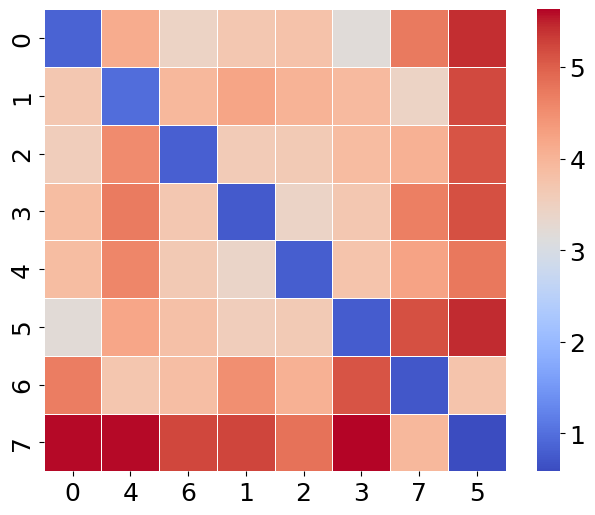

In [122]:
ground_truth_cov = np.load('./data/node_timeseries/simulation_bicv/real_hrf_50_stable/truth/state_covariances.npy')
inferred_covs = np.load('results_simulation_bicv_202407/real_hrf_50_stable/hmm_check/hmm_ICA_50_state_8/repeat_3/inf_params/covs.npy')
riem = twopair_riemannian_distance(ground_truth_cov,inferred_covs)
order,riem_reorder = hungarian_pair(riem,distance=True)
plot_mode_pairing(riem_reorder,order)
print(np.diagonal(riem_reorder))

[0.63748511 0.67366115 0.65944081 0.66089297 0.61945749 0.80227154
 0.65063364 0.69337291]


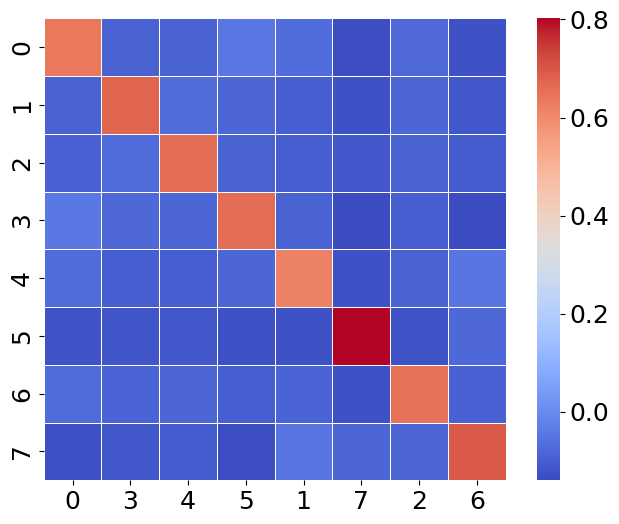

In [105]:
import pickle
alpha = []
for i in range(500):
    alpha.append(np.load(f'./data/node_timeseries/simulation_bicv/real_hrf_50_stable/truth/{10001+i}_state_time_course.npy'))
with open('results_simulation_bicv_202407/real_hrf_50_stable/hmm_check/hmm_ICA_50_state_8/repeat_3/inf_params/alp.pkl','rb') as file:
    inferred_alpha = pickle.load(file)
alpha_cor = alpha_correlation(inferred_alpha,alpha,return_diagonal=False)
order,alpha_cor_reorder = hungarian_pair(alpha_cor,distance=False)
plot_mode_pairing(alpha_cor_reorder,order)
print(np.diagonal(alpha_cor_reorder))

In [120]:
root_dir = './results_simulation_bicv_202407/real_hrf_50_stable/hmm/'
truth_dir = './data/node_timeseries/simulation_bicv/real_hrf_50_stable/truth/'

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 595.72it/s]


(<Figure size 800x600 with 2 Axes>,
 <Axes: title={'center': 'Y_test spatial'}, xlabel='fit', ylabel='ground_truth'>)

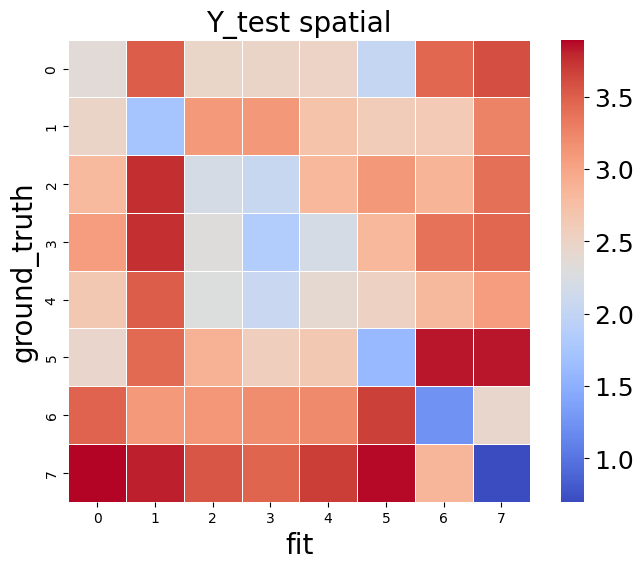

In [121]:
n_states = 8
analyse_dir = f'{root_dir}/hmm_ICA_50_state_{n_states}/cv_1/fold_1_1/'
with open(f'{analyse_dir}/fold_indices.json','r') as file:
    fold_indices = json.load(file)
ground_truth_cov = np.load(f'{truth_dir}/state_covariances.npy')
Y_test_cov = np.load(f'{analyse_dir}/Y_train/inf_params/covs.npy')
riem = twopair_riemannian_distance(ground_truth_cov[:, fold_indices['column_Y'], :][:, :, fold_indices['column_Y']],Y_test_cov)

order,riem_reorder = hungarian_pair(riem,distance=True)
# Plot mode pairing
plot_mode_pairing(riem_reorder,x_label='fit',y_label='ground_truth',title='Y_test spatial')

In [ ]:
with open(f'{analyse_dir}/Y_test/inf_params/alp.pkl','rb') as file:
    alpha_fit = pickle.load(file)
alpha_truth = []
for index in fold_indices['row_test']:
    alpha_truth.append(np.load(f'{truth_dir}/{10001+index}_state_time_course.npy'))
alpha_cor = alpha_correlation(alpha_truth,alpha_fit,return_diagonal=False)
order,alpha_cor_reorder = hungarian_pair(alpha_cor,distance=False)
plot_mode_pairing(alpha_cor_reorder,x_label='fit',y_label='ground_truth',title='Y_test temporal')

### Update 5th November 2024

Plot the distribution of mean lifetime across different cases.

In [186]:
import pickle
from osl_dynamics.inference import modes
from osl_dynamics.utils import plotting

In [204]:
alpha_dir = 'results_simulation_bicv_202407/random_hrf_50/hmm_check/hmm_ICA_50_state_8/repeat_1/inf_params/'

2024-11-05 10:56:53 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-11-05 10:56:53 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


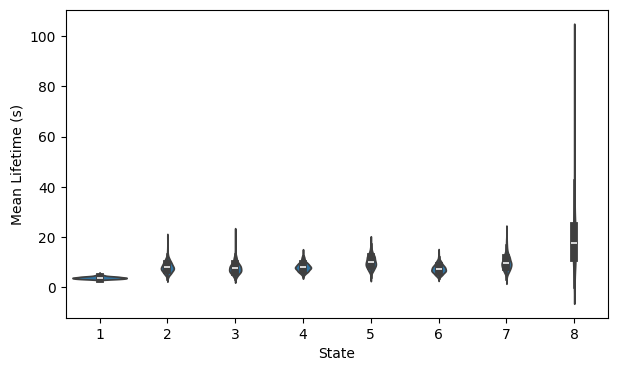

In [205]:
with open(f'{alpha_dir}/alp.pkl', 'rb') as file:
    alpha = pickle.load(file)
stc = modes.argmax_time_courses(alpha)
lt = modes.mean_lifetimes(stc, sampling_frequency=1/0.7)
plotting.plot_violin(lt.T, x_label="State", y_label="Mean Lifetime (s)")
plt.show()

## Update 6th November 2024

Understand how the hrf blurs these different states

In [2]:
import os
import json
import pickle

import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

from osl_dynamics.inference.metrics import alpha_correlation, twopair_riemannian_distance
from osl_dynamics.inference.modes import hungarian_pair
from osl_dynamics.utils.plotting import plot_mode_pairing, plot_mode_no_pairing, plot_matrices
from osl_dynamics.array_ops import cov2stdcorr
from osl_dynamics.inference.modes import argmax_time_courses,fractional_occupancies
from osl_dynamics.array_ops import get_one_hot
from osl_dynamics.analysis import connectivity
from osl_dynamics.config_api.wrappers import load_data
from osl_dynamics.array_ops import estimate_gaussian_log_likelihood
from scipy.fft import fft, fftfreq

In [2]:
ground_truth_dir = './data/node_timeseries/simulation_bicv/random_hrf_50/truth/state_covariances.npy'
fit_dir = './results_simulation_bicv_202407/random_hrf_50/hmm_check/hmm_ICA_50_state_8/repeat_1/inf_params/covs.npy'


In [3]:
ground_truth_cov = np.load(ground_truth_dir)
fit_cov = np.load(fit_dir)

Computing Riemannian distances: 100%|█████████████| 8/8 [00:00<00:00, 53.16it/s]


(<Figure size 800x600 with 2 Axes>, <Axes: >)

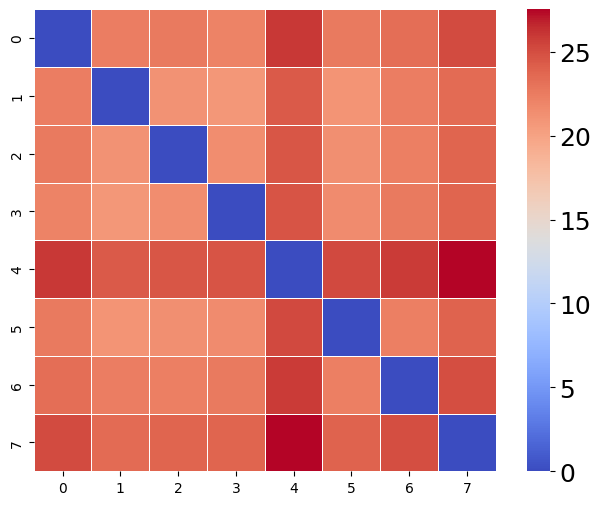

In [4]:
plot_mode_pairing(twopair_riemannian_distance(ground_truth_cov,ground_truth_cov))

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 184.98it/s]


(<Figure size 800x600 with 2 Axes>, <Axes: >)

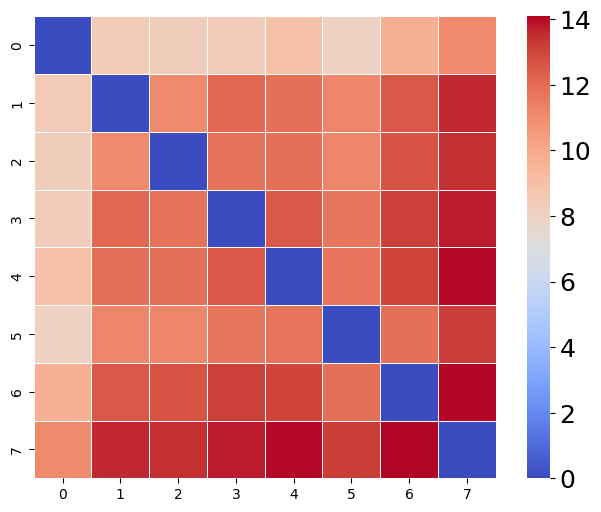

In [5]:
plot_mode_pairing(twopair_riemannian_distance(fit_cov,fit_cov))

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 124.08it/s]


(<Figure size 800x600 with 2 Axes>, <Axes: >)

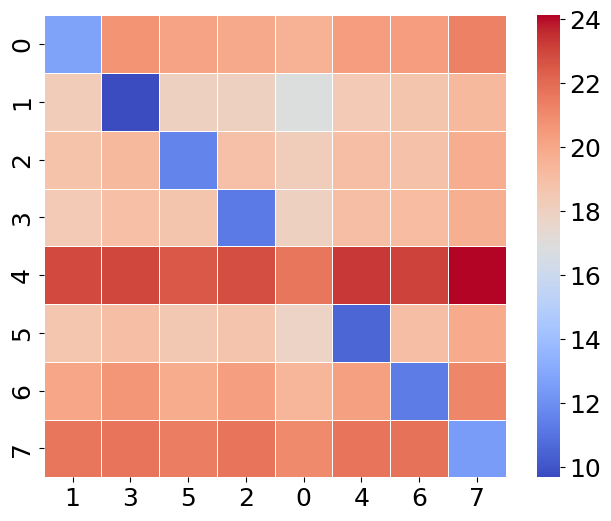

In [6]:
riem = twopair_riemannian_distance(ground_truth_cov,fit_cov)
order,riem_reorder = hungarian_pair(riem,distance=True)
plot_mode_pairing(riem_reorder,order)

In [27]:
cov_1 = np.load('./data/node_timeseries/simulation_bicv/random_sv_50_one_group/truth/10001_state_covariances.npy')
cov_2 = np.load('./data/node_timeseries/simulation_bicv/random_sv_50_one_group/truth/10004_state_covariances.npy')

Computing Riemannian distances: 100%|████████████| 8/8 [00:00<00:00, 212.27it/s]


(<Figure size 800x600 with 2 Axes>, <Axes: >)

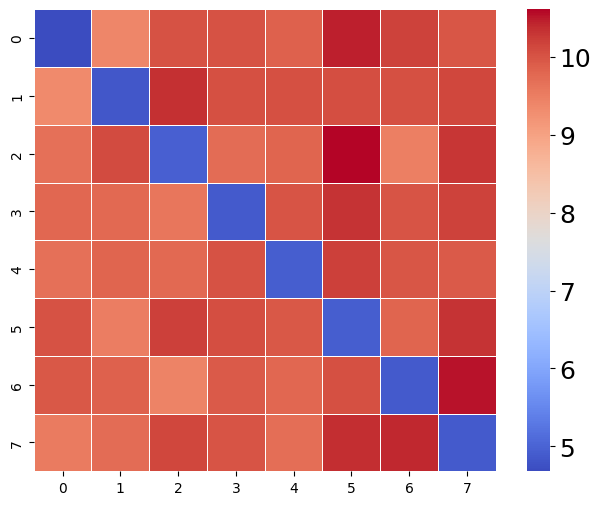

In [28]:
plot_mode_pairing(twopair_riemannian_distance(cov_1+0.1*np.eye(50),cov_2+0.1*np.eye(50)))

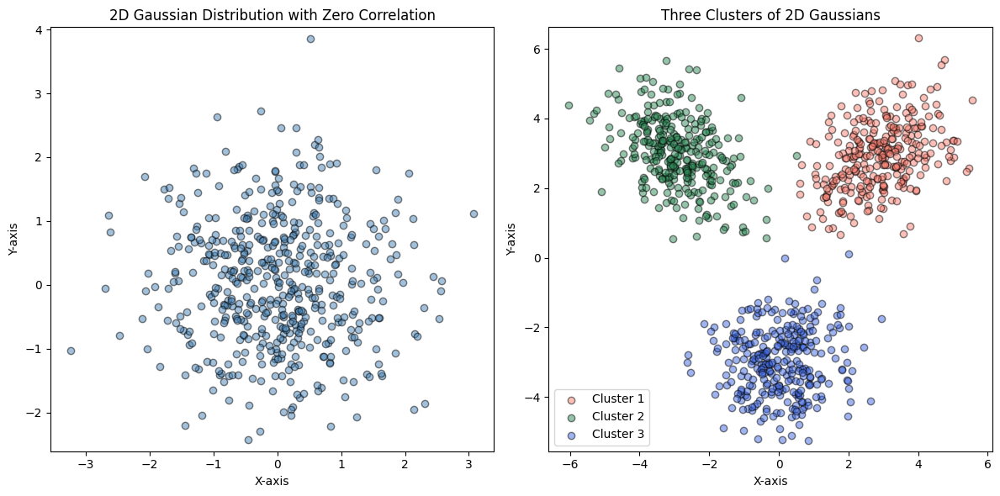

In [29]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import multivariate_normal

# Set random seed for reproducibility
np.random.seed(42)

# 1. Single 2D Gaussian with zero correlation
mean1 = [0, 0]
cov1 = [[1, 0], [0, 1]]  # No correlation, unit variance
samples1 = np.random.multivariate_normal(mean1, cov1, 500)

# 2. Three 2D Gaussian clusters
means = [[3, 3], [-3, 3], [0, -3]]
covs = [[[1, 0.5], [0.5, 1]], [[1, -0.4], [-0.4, 1]], [[1, 0], [0, 1]]]  # Different correlations and variances
samples2 = [np.random.multivariate_normal(mean, cov, 300) for mean, cov in zip(means, covs)]

# Plotting
fig, axes = plt.subplots(1, 2, figsize=(12, 6))

# Plot 1: Single 2D Gaussian
axes[0].scatter(samples1[:, 0], samples1[:, 1], alpha=0.5, color="steelblue", edgecolor="black")
axes[0].set_title("2D Gaussian Distribution with Zero Correlation")
axes[0].set_xlabel("X-axis")
axes[0].set_ylabel("Y-axis")
axes[0].axis("equal")

# Plot 2: Three Clusters of 2D Gaussians
colors = ["salmon", "seagreen", "royalblue"]
for i, cluster in enumerate(samples2):
    axes[1].scatter(cluster[:, 0], cluster[:, 1], alpha=0.5, color=colors[i], edgecolor="black", label=f"Cluster {i+1}")
axes[1].set_title("Three Clusters of 2D Gaussians")
axes[1].set_xlabel("X-axis")
axes[1].set_ylabel("Y-axis")
axes[1].legend()
axes[1].axis("equal")

plt.tight_layout()
plt.show()

### Update 21st November 2024

In [8]:
### Clear up the storage a bit
import os

In [9]:
root_dir = './results_HCP_bicv_202404/'

In [20]:
vars = ['var_1']
ICAs = [15,25,50,100,200,38,78]
n_states = list(range(1,32))

In [11]:
cvs = list(range(4,20))
folds_i = list(range(1,10))
folds_j = list(range(1,10))
chunks = ['X_train','Y_train','X_test','Y_test']

In [21]:
for var in vars:
    for ICA in ICAs:
        for n_state in n_states:
            for cv in cvs:
                for fold_i in folds_i:
                     for fold_j in folds_j:
                         for chunk in chunks:
                             file_path = f'{root_dir}/{var}/notts_ae_{ICA}/hmm_ICA_{ICA}_state_{n_state}/cv_{cv}/fold_{fold_i}_{fold_j}/{chunk}/inf_params/alp.pkl'
                             if os.path.exists(file_path):
                                 print(file_path)
                                 os.remove(file_path)

./results_HCP_bicv_202404//var_1/notts_ae_38/hmm_ICA_38_state_2/cv_4/fold_1_1/X_train/inf_params/alp.pkl
./results_HCP_bicv_202404//var_1/notts_ae_38/hmm_ICA_38_state_2/cv_4/fold_1_1/Y_test/inf_params/alp.pkl
./results_HCP_bicv_202404//var_1/notts_ae_38/hmm_ICA_38_state_2/cv_4/fold_1_2/X_train/inf_params/alp.pkl
./results_HCP_bicv_202404//var_1/notts_ae_38/hmm_ICA_38_state_2/cv_4/fold_1_2/Y_test/inf_params/alp.pkl
./results_HCP_bicv_202404//var_1/notts_ae_38/hmm_ICA_38_state_2/cv_4/fold_2_1/X_train/inf_params/alp.pkl
./results_HCP_bicv_202404//var_1/notts_ae_38/hmm_ICA_38_state_2/cv_4/fold_2_1/Y_test/inf_params/alp.pkl
./results_HCP_bicv_202404//var_1/notts_ae_38/hmm_ICA_38_state_2/cv_4/fold_2_2/X_train/inf_params/alp.pkl
./results_HCP_bicv_202404//var_1/notts_ae_38/hmm_ICA_38_state_2/cv_4/fold_2_2/Y_test/inf_params/alp.pkl
./results_HCP_bicv_202404//var_1/notts_ae_38/hmm_ICA_38_state_2/cv_5/fold_1_1/X_train/inf_params/alp.pkl
./results_HCP_bicv_202404//var_1/notts_ae_38/hmm_ICA_38_sta

In [22]:
import numpy as np

In [28]:
cov_1 = np.load('results_HCP_bicv_202407/ICA_50/swc_check/100_100/swc_ICA_50_state_2/repeat_1/inf_params/covs.npy')
cov_2 = np.load('results_HCP_bicv_202407/ICA_50/swc_check/100_100/swc_ICA_50_state_2/repeat_2/inf_params/covs.npy')
cov_3 = np.load('results_final/real/ICA_50/swc_state_2/repeat_1/inf_params/covs.npy')

In [29]:
from osl_dynamics.inference.metrics import twopair_riemannian_distance

In [31]:
print(twopair_riemannian_distance(cov_1,cov_3))

Computing Riemannian distances: 100%|████████████| 2/2 [00:00<00:00, 329.20it/s]

[[2.31588681 3.08579062]
 [3.30290372 2.29273243]]


## Update 29th November 2024

Think about MLE in HMM step 2.

In [1]:
import numpy as np
import scipy

In [ ]:
def negative_log_likelihood(params, alpha, x, n_states, n_channels):
    """
    Compute the negative log-likelihood for the Gaussian mixture model using scipy.
    
    Parameters:
    - params: Flattened array of means and covariances for optimization
    - alpha: State probabilities (N_timepoints, N_states)
    - x: Data (N_timepoints, N_channels)
    - n_states: Number of states
    - n_channels: Number of channels
    
    Returns:
    - neg_log_likelihood: The negative log-likelihood to minimize
    """
    means = params[:n_states * n_channels].reshape(n_states, n_channels)
    covariances = params[n_states * n_channels:].reshape(n_states, n_channels, n_channels)
    
    nll = 0  # Negative log-likelihood accumulator
    
    for t in range(x.shape[0]):  # Iterate over time points
        weighted_log_probs = 0
        for k in range(n_states):  # Iterate over states
            try:
                mvn = multivariate_normal(mean=means[k], cov=covariances[k])
                log_prob = mvn.logpdf(x[t])
                weighted_log_probs += alpha[t, k] * log_prob
            except np.linalg.LinAlgError:
                # Handle poorly conditioned covariance matrices
                return np.inf
        nll -= weighted_log_probs  # Subtract to accumulate negative log-likelihood
    
    return nll

### Update 4th December 2024

Delete alpha files properly.

In [2]:
import os
import shutil

In [50]:
save_dir = './results_HCP_bicv_202407/ICA_50/dynemo_mean/'
for i in range(1,35):
    for j in range(3,25):
            for fold_i in range(1,3):
              for fold_j in range(1,3):
                path_dir_1 = f'{save_dir}/dynemo_ICA_50_state_{i}/cv_{j}/fold_{fold_i}_{fold_j}/X_train/inf_params/alp.pkl'
                path_dir_2 = f'{save_dir}/dynemo_ICA_50_state_{i}/cv_{j}/fold_{fold_i}_{fold_j}/Y_test/inf_params/alp.pkl'
                if os.path.exists(path_dir_1):
                    print(path_dir_1)
                    os.remove(path_dir_1)
                if os.path.exists(path_dir_2):
                    print(path_dir_2)
                    os.remove(path_dir_2)

./results_HCP_bicv_202407/ICA_50/dynemo_mean//dynemo_ICA_50_state_2/cv_3/fold_1_1/X_train/inf_params/alp.pkl
./results_HCP_bicv_202407/ICA_50/dynemo_mean//dynemo_ICA_50_state_2/cv_3/fold_1_1/Y_test/inf_params/alp.pkl
./results_HCP_bicv_202407/ICA_50/dynemo_mean//dynemo_ICA_50_state_2/cv_3/fold_1_2/X_train/inf_params/alp.pkl
./results_HCP_bicv_202407/ICA_50/dynemo_mean//dynemo_ICA_50_state_2/cv_3/fold_1_2/Y_test/inf_params/alp.pkl
./results_HCP_bicv_202407/ICA_50/dynemo_mean//dynemo_ICA_50_state_2/cv_3/fold_2_1/X_train/inf_params/alp.pkl
./results_HCP_bicv_202407/ICA_50/dynemo_mean//dynemo_ICA_50_state_2/cv_3/fold_2_1/Y_test/inf_params/alp.pkl
./results_HCP_bicv_202407/ICA_50/dynemo_mean//dynemo_ICA_50_state_2/cv_3/fold_2_2/X_train/inf_params/alp.pkl
./results_HCP_bicv_202407/ICA_50/dynemo_mean//dynemo_ICA_50_state_2/cv_3/fold_2_2/Y_test/inf_params/alp.pkl
./results_HCP_bicv_202407/ICA_50/dynemo_mean//dynemo_ICA_50_state_2/cv_4/fold_1_1/X_train/inf_params/alp.pkl
./results_HCP_bicv_2024

### Clear up storage

In [2]:
import os

In [3]:
save_dir ='./results_final/real/'

In [5]:
parcellations = ['ICA_15','ICA_15_static','ICA_15_filter_0.05','ICA_15_filter_0.05_static',
                 'ICA_25','ICA_25_static','ICA_25_filter_0.05','ICA_25_filter_0.05_static',
                 'ICA_50','ICA_50_static','ICA_50_filter_0.05','ICA_50_filter_0.05_static',
                 'ICA_25_UKB','ICA_25_UKB_static','ICA_25_UKB_filter_0.05','ICA_25_UKB_filter_0.05_static',
                 'ICA_50_UKB','ICA_50_UKB_static','ICA_50_UKB_filter_0.05','ICA_50_UKB_filter_0.05_static',
                  'ICA_100','ICA_100_filter_0.05',
                ]
models = ['hmm','dynemo','swc']
n_states = list(range(1,26))
bcvs = [4,5]
ncvs = [2,3,4,5]
repeats = [2,3]
splits = [2,3,4,5]
for parcellation in parcellations:
    for model in models:
        for n_state in n_states:
            directory = f'{save_dir}/{parcellation}/{model}_state_{n_state}/'
            
            # bcv
            for bcv in bcvs:
                file_1 = f'{directory}/bcv_{bcv}/Y_test/inf_params/alp.pkl'
                if os.path.exists(file_1):
                    print(file_1)
                    os.remove(file_1)
                file_2 = f'{directory}/bcv_{bcv}/X_train/inf_params/alp.pkl'
                if os.path.exists(file_2):
                    print(file_2)
                    os.remove(file_2)
            # ncv
            for ncv in ncvs:
                file = f'{directory}/ncv_{ncv}/inf_params/alp.pkl'
                if os.path.exists(file):
                    print(file)
                    os.remove(file)
             
            # repeat
            for repeat in repeats:
                file = f'{directory}/repeat_{repeat}/inf_params/alp.pkl'
                if os.path.exists(file):
                    print(file)
                    os.remove(file)

            # split
            for split in splits:
                files = [f'{directory}/split_{split}/partition_{i}/inf_params/alp.pkl' for i in range(1,3)]
                for file in files:
                    if os.path.exists(file):
                        print(file)
                        os.remove(file)

./results_final/real//ICA_50_UKB_filter_0.05_static/swc_state_25//ncv_2/inf_params/alp.pkl
./results_final/real//ICA_50_UKB_filter_0.05_static/swc_state_25//ncv_3/inf_params/alp.pkl
./results_final/real//ICA_50_UKB_filter_0.05_static/swc_state_25//ncv_4/inf_params/alp.pkl
./results_final/real//ICA_50_UKB_filter_0.05_static/swc_state_25//ncv_5/inf_params/alp.pkl
./results_final/real//ICA_50_UKB_filter_0.05_static/swc_state_25//repeat_2/inf_params/alp.pkl
./results_final/real//ICA_50_UKB_filter_0.05_static/swc_state_25//repeat_3/inf_params/alp.pkl
./results_final/real//ICA_50_UKB_filter_0.05_static/swc_state_25//split_2/partition_1/inf_params/alp.pkl
./results_final/real//ICA_50_UKB_filter_0.05_static/swc_state_25//split_2/partition_2/inf_params/alp.pkl
./results_final/real//ICA_50_UKB_filter_0.05_static/swc_state_25//split_3/partition_1/inf_params/alp.pkl
./results_final/real//ICA_50_UKB_filter_0.05_static/swc_state_25//split_3/partition_2/inf_params/alp.pkl
./results_final/real//ICA_50

### Update 15 Jan 2025

Understand why DyNeMo performance improves when many states are fed in.

In [39]:
import os
import pickle
import yaml
import json
import numpy as np
import matplotlib.pyplot as plt

from osl_dynamics.inference.metrics import twopair_riemannian_distance
from osl_dynamics.inference.modes import hungarian_pair
from osl_dynamics.utils.plotting import plot_mode_pairing
import osl_dynamics.utils.plotting as plotting

In [11]:
save_dir = './results_final/real/ICA_50/'

In [12]:
save_dir_dynemo_1 = f'{save_dir}/dynemo_state_12/split_1/'
save_dir_dynemo_2 = f'{save_dir}/dynemo_state_24/split_1/'

In [13]:
covs_1_1 = np.load(f'{save_dir_dynemo_1}/partition_1/inf_params/covs.npy')
covs_1_2 = np.load(f'{save_dir_dynemo_1}/partition_2/inf_params/covs.npy')

covs_2_1 = np.load(f'{save_dir_dynemo_2}/partition_1/inf_params/covs.npy')
covs_2_2 = np.load(f'{save_dir_dynemo_2}/partition_2/inf_params/covs.npy')

In [27]:
riem_1 = twopair_riemannian_distance(covs_1_1,covs_1_2)
indices_1, riem_1_reorder = hungarian_pair(riem_1,distance=True)
plot_mode_pairing(riem_1_reorder,indices_1)

SyntaxError: incomplete input (4061967277.py, line 4)

In [29]:
print(np.diagonal(riem_1_reorder))

[ 4.59059035  6.09731994 11.50778833 10.46361067  5.75231004 11.37240497
  7.05186491  7.97393245  6.53944643 11.52124586  9.74801971  8.2799351 ]


Computing Riemannian distances: 100%|███████████| 24/24 [00:01<00:00, 22.14it/s]


(<Figure size 1200x1000 with 2 Axes>, <Axes: >)

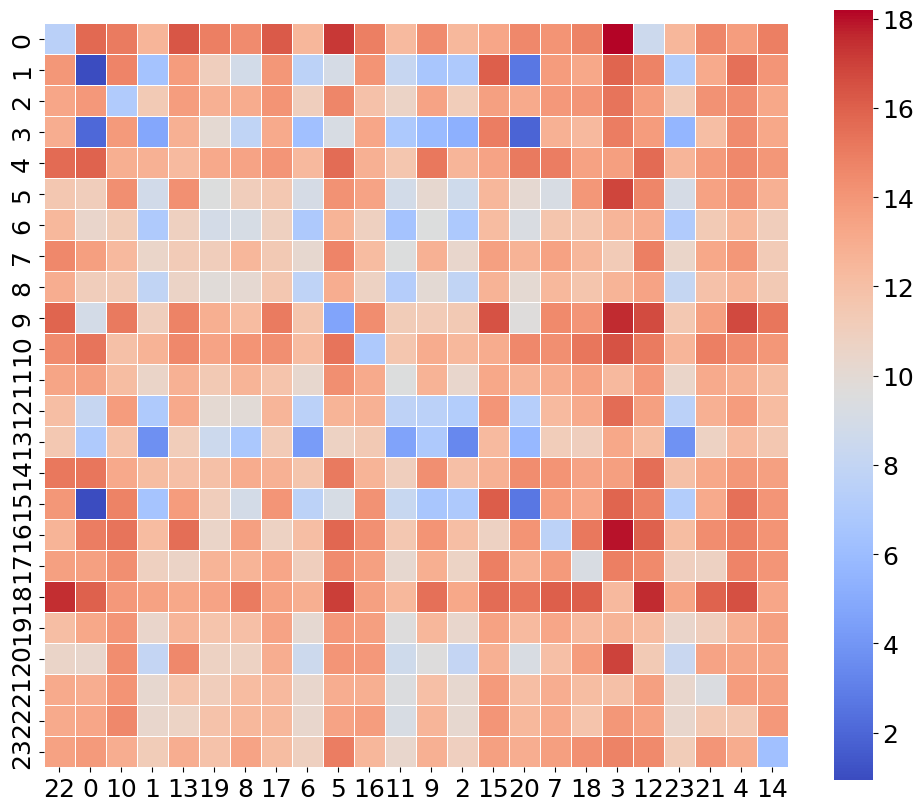

In [23]:
riem_2 = twopair_riemannian_distance(covs_2_1,covs_2_2)
indices_2, riem_2_reorder = hungarian_pair(riem_2,distance=True)
plot_mode_pairing(riem_2_reorder,indices_2,fig_kwargs = {"figsize":(12,10)})

In [26]:
print(indices_2)

{'row': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23], 'col': [22, 0, 10, 1, 13, 19, 8, 17, 6, 5, 16, 11, 9, 2, 15, 20, 7, 18, 3, 12, 23, 21, 4, 14]}


In [32]:
for i in range(24):
    print(f'{i}: {np.diagonal(riem_2_reorder)[i]}')

0: 7.488724158361318
1: 0.9344586042132634
2: 7.059125454221446
3: 4.79466346432895
4: 12.266429837051698
5: 9.504340697102611
6: 9.131812084265297
7: 11.3812757369042
8: 7.787279686331504
9: 4.66979764770148
10: 6.9240367460786425
11: 9.553665616184658
12: 7.587878272444667
13: 3.395938372846708
14: 12.793724163994565
15: 2.6687643218626445
16: 7.645361997309812
17: 9.278038999749723
18: 12.373605457012179
19: 12.22916710215232
20: 8.322683932144349
21: 9.38038524300156
22: 11.527436032870376
23: 6.240357885857393


Computing Riemannian distances: 100%|███████████| 12/12 [00:01<00:00,  7.07it/s]


(<Figure size 800x600 with 2 Axes>, <Axes: >)

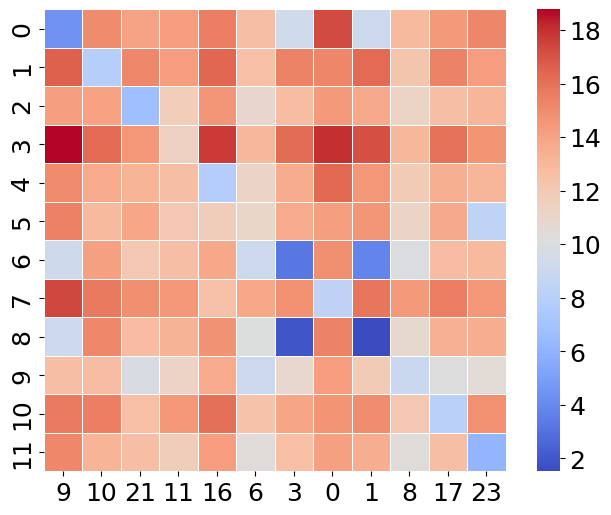

In [21]:
riem_1_2 = twopair_riemannian_distance(covs_1_1,covs_2_1)
indices_1_2, riem_1_2_reorder = hungarian_pair(riem_1_2,distance=True)
plot_mode_pairing(riem_1_2_reorder,indices_1_2)


In [24]:
print(indices_1_2)

{'row': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11], 'col': [9, 10, 21, 11, 16, 6, 3, 0, 1, 8, 17, 23]}


Ok, maybe start by thinking about the fractional occupancy.

In [98]:
from osl_dynamics.inference import modes

In [372]:
save_dir_dynemo = './results_final/real/ICA_50_first_session/dynemo_state_4/repeat_3/'

In [373]:
with open(f'{save_dir_dynemo}/inf_params/alp.pkl','rb') as file:
    alpha = pickle.load(file)
covs = np.load(f'{save_dir_dynemo}/inf_params/covs.npy')

In [374]:
print(len(alpha))
print(alpha[0].shape)
print(covs.shape)

1003
(1200, 4)
(4, 50, 50)


In [375]:
norm_alpha = modes.reweight_alphas(alpha,covs)

2025-01-17 12:24:25 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2025-01-17 12:24:25 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


(<Figure size 700x400 with 1 Axes>, <Axes: xlabel='Mode', ylabel='Mean alpha'>)

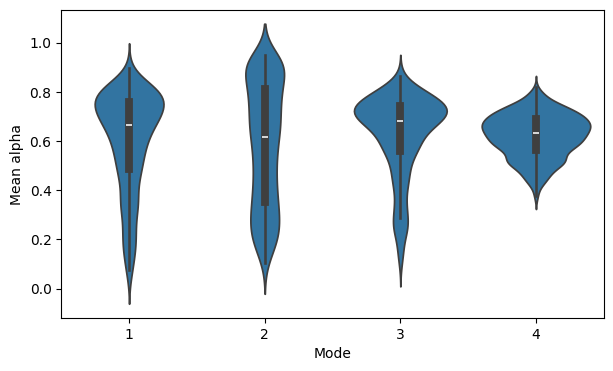

In [376]:
max_norm_alpha = np.array([np.max(a, axis=0) for a in norm_alpha])
plotting.plot_violin(max_norm_alpha.T, x_label="Mode", y_label="Mean alpha")

2025-01-17 12:24:26 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2025-01-17 12:24:26 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


(<Figure size 700x400 with 1 Axes>, <Axes: xlabel='Mode', ylabel='Mean alpha'>)

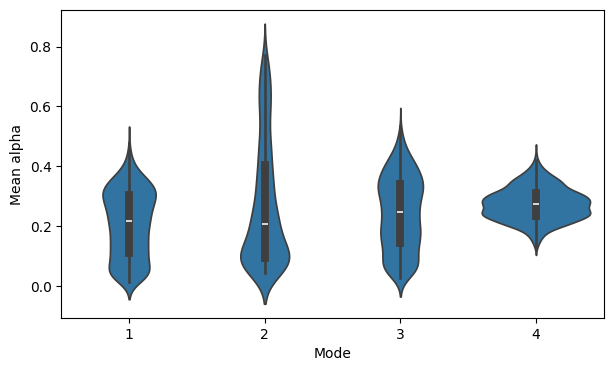

In [377]:
mean_norm_alpha = np.array([np.mean(a, axis=0) for a in norm_alpha])
plotting.plot_violin(mean_norm_alpha.T, x_label="Mode", y_label="Mean alpha")

In [378]:
import seaborn as sns

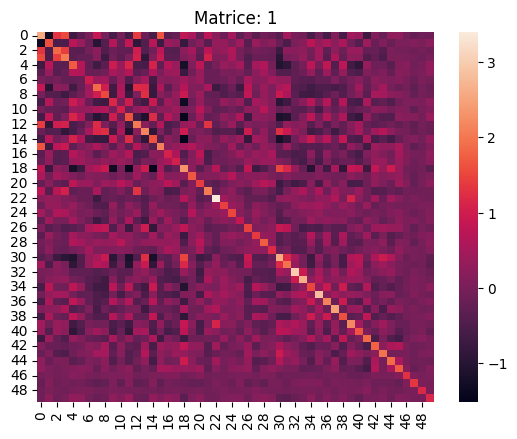

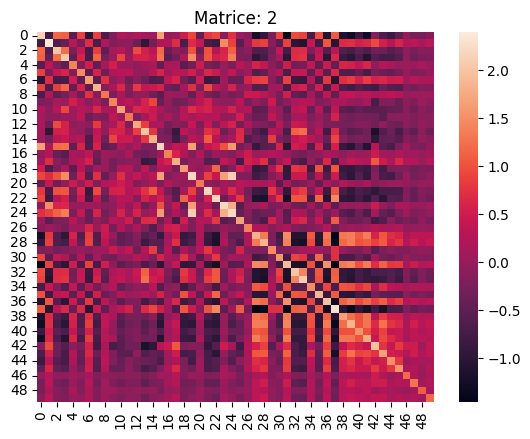

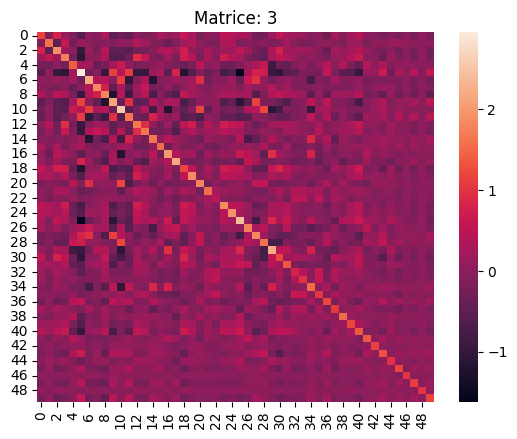

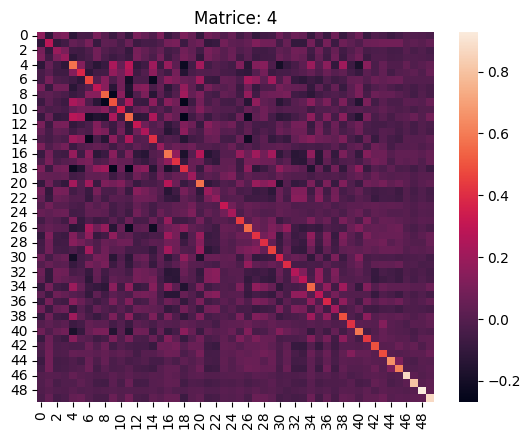

In [379]:
for i in range(len(covs)):
    sns.heatmap(covs[i])
    plt.title(f'Matrice: {i+1}')
    plt.show()

In [4]:
import pickle
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import welch

from osl_dynamics.inference.modes import reweight_alphas

In [2]:
save_dir = './results_final/real/ICA_50/dynemo_state_25/repeat_1/inf_params/'
covs = np.load(f'{save_dir}/covs.npy')
with open(f'{save_dir}/alp.pkl','rb') as file:
    alpha = pickle.load(file)

In [3]:
norm_alpha = reweight_alphas(alpha,covs)

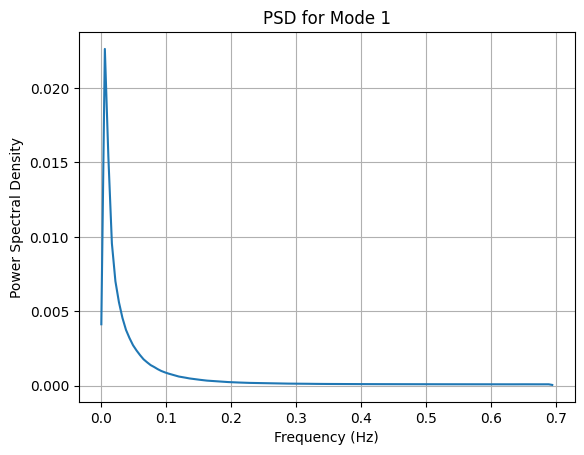

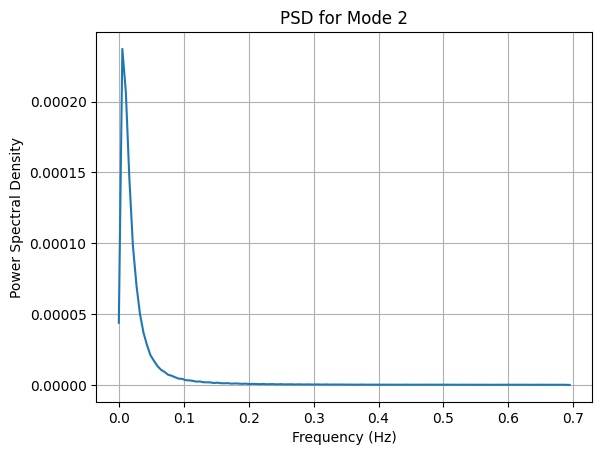

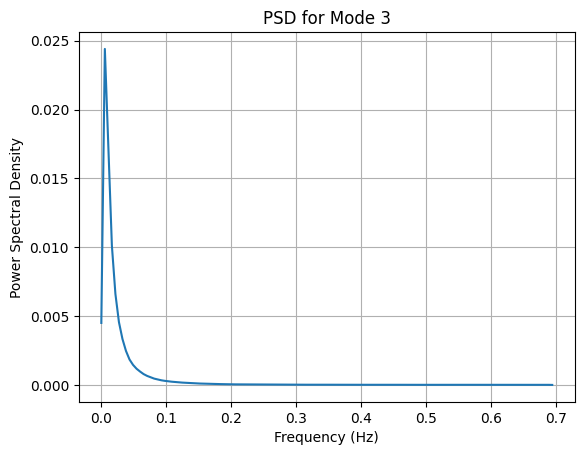

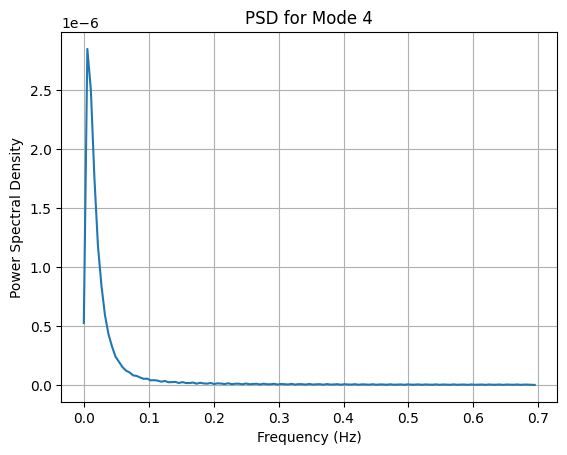

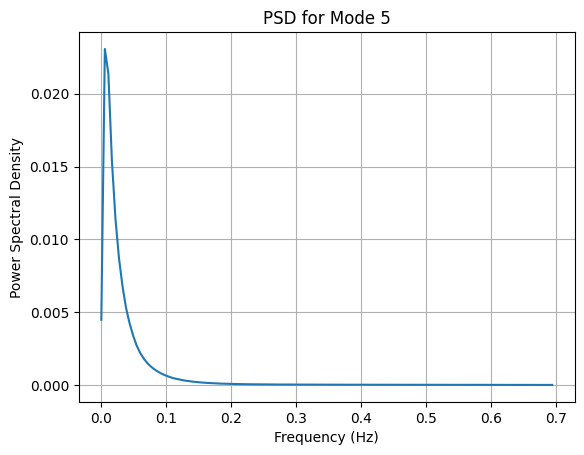

...

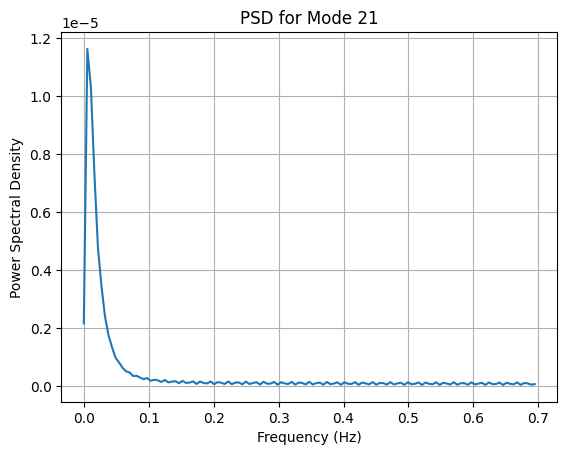

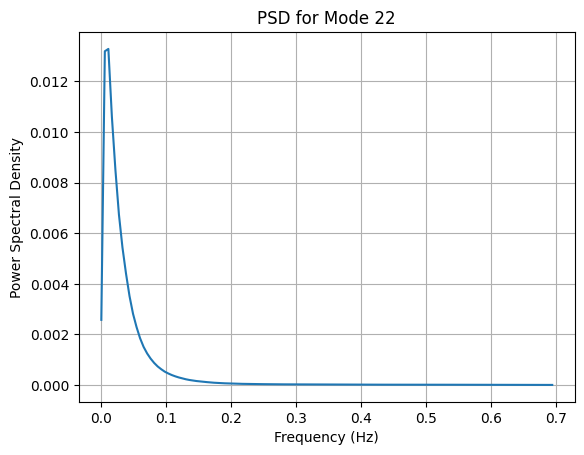

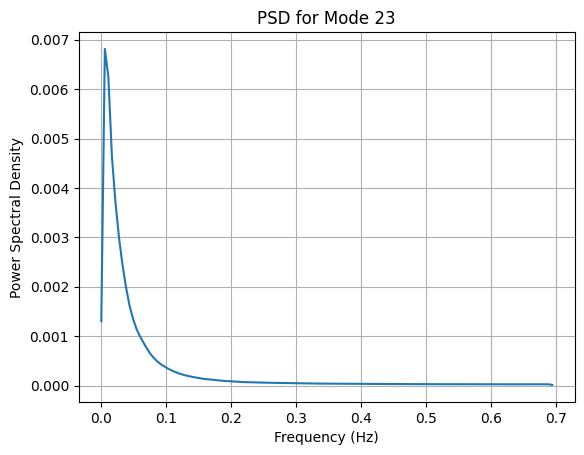

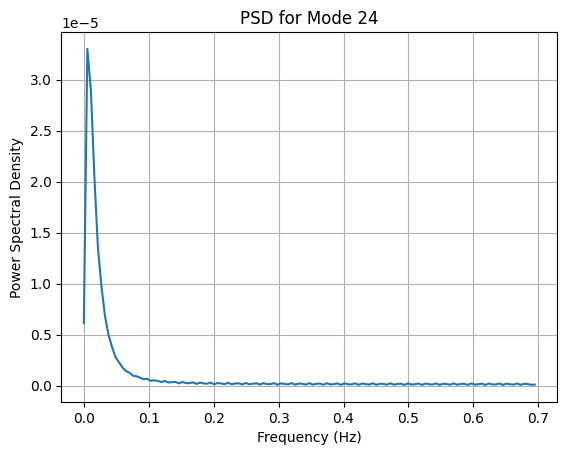

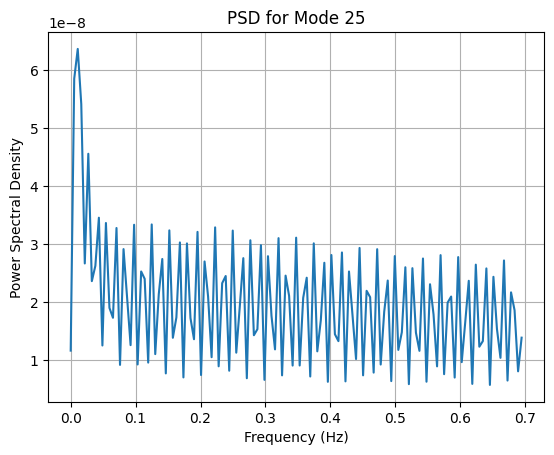

In [5]:
N_modes = alpha[0].shape[1]

# Initialize a list to hold concatenated data for each mode
mode_data = [[] for _ in range(N_modes)]

# Concatenate data for each mode across all subjects
for subject_data in alpha:
    for mode in range(N_modes):
        mode_data[mode].extend(subject_data[:, mode])

# Convert lists to numpy arrays
mode_data = [np.array(data) for data in mode_data]

# Plot PSD for each mode in separate figures
for mode in range(N_modes):
    plt.figure()
    f, Pxx = welch(mode_data[mode], fs=1.389)  # Adjust 'fs' to your sampling frequency
    plt.plot(f, Pxx)
    plt.title(f'PSD for Mode {mode + 1}')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Power Spectral Density')
    plt.grid()
    plt.show()

### Update 1st February 2025

Understand why DyNeMo's performance improve with more states. The example comes from: ICA_50, DyNeMo, N_states = 8 vs N_states = 16.

In [1]:
import os
import yaml
import pickle

import numpy as np
from scipy.stats import multivariate_normal
import matplotlib.pyplot as plt
%matplotlib inline

from osl_dynamics.config_api import wrappers

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# Root directory
root_dir = './results_final/real/ICA_50/'

# Two directories for comparison
state_8_dir = f'{root_dir}/dynemo_state_8/'
state_16_dir = f'{root_dir}/dynemo_state_16/'

# Covariances used
state_8_covs_dir = [f'{state_8_dir}/bcv_{i}/Y_train/inf_params/covs.npy' for i in range(1,4)]
state_16_covs_dir = [f'{state_16_dir}/bcv_{i}/Y_train/inf_params/covs.npy' for i in range(1,4)]

# Time courses used
state_8_alp_dir = [f'{state_8_dir}/bcv_{i}/Y_test/inf_params/alp.pkl' for i in range(1,4)]
state_16_alp_dir = [f'{state_16_dir}/bcv_{i}/Y_test/inf_params/alp.pkl' for i in range(1,4)]

# Configuration used
state_8_config_dir = [f'{state_8_dir}/bcv_{i}/Y_test/prepared_config.yaml'for i in range(1,4)]
state_16_config_dir = [f'{state_16_dir}/bcv_{i}/Y_test/prepared_config.yaml'for i in range(1,4)]

In [3]:
i=0

In [4]:
# Load the data
with open(state_8_config_dir[i], "r") as file:
    config = yaml.safe_load(file)
load_data_kwargs = config['load_data']
data = wrappers.load_data(**load_data_kwargs)

Standardize: 100%|██████████████████████████████████| 1003/1003 [00:03<00:00, 269.31it/s]


In [5]:
keep_list = config['keep_list']
print(len(keep_list))
print('######################')
ts = [data[i] for i in keep_list]
print(len(ts))
print(ts[0].shape)

502
######################
502
(4800, 25)


In [6]:
# Load covariances
state_8_covs = np.load(state_8_covs_dir[i])
state_16_covs = np.load(state_16_covs_dir[i])

# Load posterior time courses
with open(state_8_alp_dir[i],'rb') as file:
    state_8_alp = pickle.load(file)
with open(state_16_alp_dir[i],'rb') as file:
    state_16_alp = pickle.load(file)

In [7]:
# Concatenate everything to numpy
ts_np = np.concatenate(ts)
state_8_alp_np = np.concatenate(state_8_alp)
state_16_alp_np = np.concatenate(state_16_alp)

In [8]:
print(ts_np.shape)
print(state_8_alp_np.shape)
print(state_16_alp_np.shape)
print(state_8_covs.shape)
print(state_16_covs.shape)

(2409600, 25)
(2409600, 8)
(2409600, 16)
(8, 25, 25)
(16, 25, 25)


In [9]:
# Old implementation (slow!)
#state_8_C_t = np.einsum('ns,sij->nij', state_8_alp_np, state_8_covs)
#log_likelihood = np.array([multivariate_normal.logpdf(ts_np[i], cov=state_8_C_t[i]) for i in range(len(ts_np))])
#print(np.average(log_likelihood))
#state_16_C_t = np.einsum('ns,sij->nij', state_16_alp_np, state_16_covs)
#log_likelihood = np.array([multivariate_normal.logpdf(ts_np[i], cov=state_16_C_t[i]) for i in range(len(ts_np))])
#print(np.average(log_likelihood))

In [9]:
# Compute the moment-to-moment covariance matrices
state_16_C_t = np.einsum('ns,sij->nij', state_16_alp_np, state_16_covs)

# Compute inverse and log determinant of each covariance matrix
inv_C = np.linalg.inv(state_16_C_t)  # Shape (2409600, 25, 25)
logdet_C = np.log(np.linalg.det(state_16_C_t))  # Shape (2409600,)

# Compute quadratic term using einsum
quad_term = np.einsum('ni,nij,nj->n', ts_np, inv_C, ts_np)

# Calculate log likelihood
d = ts_np.shape[1]
log_likelihood = -0.5 * (quad_term + logdet_C + d * np.log(2 * np.pi))
print(log_likelihood)

[-30.368795 -25.22282  -26.457577 ... -25.087286 -26.844881 -30.07019 ]


In [13]:
print(np.average(log_likelihood))

-31.76645


In [16]:
contributions = np.zeros(16)

for s in range(16):
    # Precompute inverse and logdet for mode s
    C_s = state_16_covs[s]
    invC_s = np.linalg.inv(C_s)
    logdet_s = np.log(np.linalg.det(C_s))

    # Compute quadratic term for all data points under mode s
    quad_term_s = np.einsum('ni,ij,nj->n', ts_np, invC_s, ts_np)

    # Log likelihood for mode s across all data points
    logpdf_s = -0.5 * (quad_term_s + logdet_s + d * np.log(2 * np.pi))

    # Weight by alpha and sum
    contributions[s] = np.average(state_16_alp_np[:, s] * logpdf_s)

print(f'Contribution of each mode:{contributions}')

Contribution of each mode:[-2.41171455e+00 -2.06644392e+00 -2.69029297e+02 -1.41379209e-02
 -1.81110168e+00 -9.44880843e-02 -3.62947679e+00 -4.50267458e+00
 -1.57365780e-02 -4.61521670e-02 -1.94270706e+00 -8.79444695e+00
 -2.87006013e-02 -2.51293272e-01 -1.71446633e+00 -3.25259137e+00]


In [17]:
contributions = np.zeros(16)

for k in range(16):
    # Get covariance matrix for mode k
    C_k = state_16_covs[k]  # Shape (25, 25)
    
    # Compute trace terms: trace(inv_C @ C_k) for all time points
    trace_terms = np.einsum('nij,ji->n', inv_C, C_k)  # Shape (2409600,)
    
    # Compute quadratic terms: x^T inv_C C_k inv_C x for all time points
    # Break into steps for memory efficiency:
    temp1 = np.einsum('ni,nij->nj', ts_np, inv_C)     # (2409600, 25)
    temp2 = np.einsum('nj,jk->nk', temp1, C_k)        # (2409600, 25)
    temp3 = np.einsum('nk,nkl->nl', temp2, inv_C)     # (2409600, 25)
    quad_terms = np.einsum('nl,nl->n', temp3, ts_np)  # (2409600,)
    
    # Contribution of mode k (derivative approximation)
    contributions[k] = 0.5 * (quad_terms - trace_terms).sum()

# Calculate the effect of removing each mode
delta_LL = -contributions  # Removing mode k reduces LL by ~delta_LL[k]

In [18]:
print(delta_LL)

[-21538140.    -14740940.     -1168243.375 -10277082.    -42160416.
 -10450995.    -36681884.    -15597684.    -11237669.     -9593717.
 -15226680.    -27304194.    -11428510.    -12332377.    -15881469.
 -13999089.   ]


In [20]:
import numpy as np
from tqdm import tqdm  # For progress bar

# Dimensions
n_time, n_features = ts_np.shape  # (2409600, 25)
n_modes = state_16_covs.shape[0]  # 16

# 1. Compute original mean log likelihood with all 16 modes
# ----------------------------------------------------------
# Precompute components for original covariance matrices
logdet = np.log(np.linalg.det(state_16_C_t))  # (2409600,)
inv_C = np.linalg.inv(state_16_C_t)  # (2409600, 25, 25)

# Vectorized quadratic term calculation
quad_term = np.einsum('ni,nij,nj->n', ts_np, inv_C, ts_np)  # (2409600,)

# Original mean log likelihood
original_mean_LL = -0.5 * np.mean(quad_term + logdet + n_features * np.log(2 * np.pi))

# 2. Compute effect of removing each mode
# -----------------------------------------
# Precompute alpha-weighted covariance contributions
alpha_covs = state_16_alp_np[:, :, None, None] * state_16_covs  # (2409600, 16, 25, 25)

# Initialize results array
delta_LL = np.zeros(n_modes)

for k in tqdm(range(n_modes), desc='Processing modes'):
    # Remove mode k's contribution
    C_t_minus_k = state_16_C_t - alpha_covs[:, k]  # (2409600, 25, 25)
    
    # Batch compute inverses and determinants
    inv_C_k = np.linalg.inv(C_t_minus_k)  # (2409600, 25, 25)
    logdet_k = np.log(np.linalg.det(C_t_minus_k))  # (2409600,)
    
    # Compute quadratic term
    quad_term_k = np.einsum('ni,nij,nj->n', ts_np, inv_C_k, ts_np)
    
    # Calculate mean log likelihood without mode k
    LL_minus_k = -0.5 * np.mean(quad_term_k + logdet_k + n_features * np.log(2 * np.pi))
    
    # Store difference from original
    delta_LL[k] = original_mean_LL - LL_minus_k

# 3. Interpret results
# ---------------------
positive_modes = np.where(delta_LL > 0)[0]  # Modes that improve likelihood
negative_modes = np.where(delta_LL < 0)[0]  # Modes that degrade likelihood
most_influential = np.argmax(np.abs(delta_LL))

print(f"\nOriginal mean log likelihood: {original_mean_LL:.2f}")
print(f"Positive contributors (modes that improve likelihood): {positive_modes}")
print(f"Negative contributors (modes that degrade likelihood): {negative_modes}")
print(f"Most influential mode: {most_influential} (LL = {delta_LL[most_influential]:.2f})")

Processing modes: 100%|██████████████████████████████████| 16/16 [23:20<00:00, 87.52s/it]


Original mean log likelihood: -31.77
Positive contributors (modes that improve likelihood): [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15]
Negative contributors (modes that degrade likelihood): []
Most influential mode: 11 (LL = 5.51)


In [21]:
print(delta_LL)

[3.68343544e+00 4.65726852e-01 2.83173561e+00 1.23214722e-03
 3.81467247e+00 8.08143616e-03 2.35644722e+00 3.78695869e+00
 1.58691406e-03 3.35693359e-03 8.32059860e-01 5.50807381e+00
 2.38800049e-03 1.99260712e-02 1.21146202e+00 3.15347481e+00]


/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 148 (\x94) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


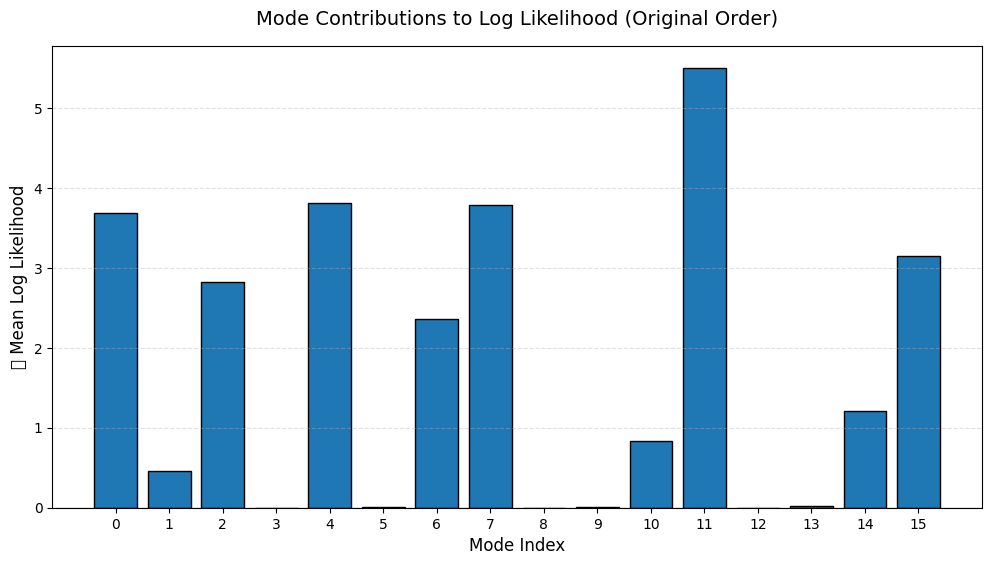

In [22]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming delta_LL is your existing list/array
modes = np.arange(len(delta_LL))  # Mode indices [0, 1, ..., 15]

# Create figure
plt.figure(figsize=(12, 6))

# Create colors (red for negative, blue for positive)
colors = ['#d62728' if val < 0 else '#1f77b4' for val in delta_LL]

# Plot bars
bars = plt.bar(modes, delta_LL, color=colors, edgecolor='black')

# Customize plot
plt.axhline(0, color='black', linewidth=0.8)  # Zero line
plt.title('Mode Contributions to Log Likelihood (Original Order)', fontsize=14, pad=15)
plt.xlabel('Mode Index', fontsize=12)
plt.ylabel(' Mean Log Likelihood', fontsize=12)
plt.xticks(modes, fontsize=10)
plt.yticks(fontsize=10)
plt.grid(axis='y', linestyle='--', alpha=0.4)
plt.show()

Or, there's another way to think about it. Since DyNeMo's performance drops with only one session, but increases with four session. So we can calculate the mean alpha "decrease" from one session to four sessions.

In [64]:
save_dir = './results_final/real/ICA_50/dynemo_state_25/repeat_1/inf_params/'
with open(f'{save_dir}/alp.pkl','rb') as file:
    alp = pickle.load(file)
covs = np.load(f'{save_dir}/covs.npy')

In [65]:
from osl_dynamics.inference.modes import reweight_alphas
norm_alp = reweight_alphas(alp,covs)

In [66]:
print(norm_alp[0].shape)

(4800, 25)


In [68]:
mean_norm_alpha = np.array([np.mean(a, axis=0) for a in norm_alp])
mean_norm_alpha_session_1 = np.array([np.mean(a[:1200,:],axis=0) for a in norm_alp])

std_norm_alpha = np.array([np.std(a, axis=0) for a in norm_alp])
std_norm_alpha_session_1 = np.array([np.std(a[:1200,:],axis=0) for a in norm_alp])

In [69]:
mean_alpha_diff = mean_norm_alpha-mean_norm_alpha_session_1
std_alpha_diff = std_norm_alpha-std_norm_alpha_session_1

In [70]:
from osl_dynamics.utils.plotting import plot_box

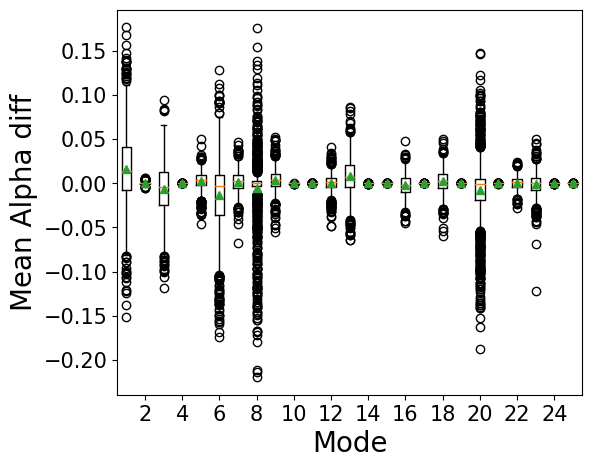

In [74]:
plot_box(mean_alpha_diff.T.tolist(),
         labels=list(range(1,len(mean_alpha_diff.T)+1)),
         plot_samples=False,
         mark_best=False,
         plot_kwargs={'showfliers': True},
         x_label="Mode",
         y_label="Mean Alpha diff",
         )
plt.show()

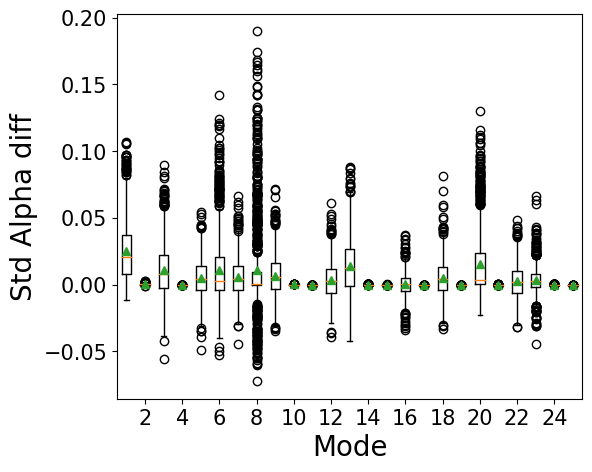

In [75]:
plot_box(std_alpha_diff.T.tolist(),
         labels=list(range(1,len(std_alpha_diff.T)+1)),
         plot_samples=False,
         mark_best=False,
         plot_kwargs={'showfliers': True},
         x_label="Mode",
         y_label="Std Alpha diff",
         )
plt.show()

In [63]:
import numpy as np
from scipy import stats
from statsmodels.stats.multitest import multipletests  # Install with pip install statsmodels

# Assuming alpha_diff is your (1003, N_modes) array
n_subjects, n_modes = alpha_diff.shape

# 1. Perform one-sample t-tests against zero
t_values, p_values = stats.ttest_1samp(alpha_diff, popmean=0, axis=0)

# 2. Apply Benjamini-Hochberg FDR correction
reject_fdr, p_fdr, _, _ = multipletests(p_values, alpha=0.05, method='fdr_bh')

# 3. Apply Bonferroni correction (more conservative)
reject_bon, p_bon = multipletests(p_values, alpha=0.05, method='bonferroni')[:2]

# 4. Identify significant modes
significant_modes_fdr = np.where(reject_fdr)[0]
significant_modes_bon = np.where(reject_bon)[0]

# 5. Get effect directions (positive/negative mean difference)
mean_diffs = np.mean(alpha_diff, axis=0)
effect_directions = np.where(mean_diffs > 0, 'Positive', 'Negative')

# 6. Create results table
results = []
for mode in range(n_modes):
    results.append({
        'Mode': mode,
        'Mean Difference': mean_diffs[mode],
        't-value': t_values[mode],
        'p-raw': p_values[mode],
        'p-FDR': p_fdr[mode],
        'p-Bonferroni': p_bon[mode],
        'Significant (FDR)': reject_fdr[mode],
        'Significant (Bonferroni)': reject_bon[mode],
        'Direction': effect_directions[mode]
    })

# Print summary
print(f"Significant modes (FDR corrected): {significant_modes_fdr}")
print(f"Significant modes (Bonferroni corrected): {significant_modes_bon}")
print(f"\nDetailed results for first 5 modes:")
for res in results[:5]:
    print(f"Mode {res['Mode']}: {res['Direction']} diff (Mean={res['Mean Difference']:.3f}), "
          f"t={res['t-value']:.2f}, p_raw={res['p-raw']:.4f}, p_FDR={res['p-FDR']:.4f}")

Significant modes (FDR corrected): [ 0  1  2  3  4  5  6  7 10 11 13 15]
Significant modes (Bonferroni corrected): [ 0  1  2  3  4  5  6  7 10 11 13 15]

Detailed results for first 5 modes:
Mode 0: Negative diff (Mean=-0.000), t=-7.59, p_raw=0.0000, p_FDR=0.0000
Mode 1: Positive diff (Mean=0.004), t=8.85, p_raw=0.0000, p_FDR=0.0000
Mode 2: Negative diff (Mean=-0.008), t=-7.44, p_raw=0.0000, p_FDR=0.0000
Mode 3: Negative diff (Mean=-0.002), t=-7.27, p_raw=0.0000, p_FDR=0.0000
Mode 4: Negative diff (Mean=-0.008), t=-4.37, p_raw=0.0000, p_FDR=0.0000


## Update 6th February 2025

Try to understand the "rank" of different covariance matrices.

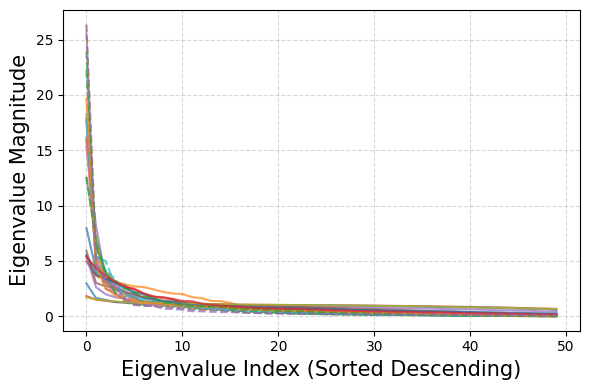

In [117]:
import numpy as np
import matplotlib.pyplot as plt

from osl_dynamics.array_ops import cov2corr

# Configuration - USER ADJUST THESE
highlight_covs = [3,6,7,10,13,20,23,25]  # 1-based indices of covariances to highlight
highlight_linestyle = '--'      # Line style for highlighted covariances
default_linestyle = '-'         # Line style for regular covariances
#threshold_value = 1e-6          # Horizontal line threshold

# Convert to 0-based indices for array access
highlight_indices = [i-1 for i in highlight_covs]



covs = np.load('./results_final/real/ICA_50/dynemo_state_25/repeat_1/inf_params/covs.npy')
corr = cov2corr(covs)
# Input: covs (n_states, n_channels, n_channels)
n_states, n_channels, _ = covs.shape

# Compute eigenvalues for all covariance matrices
eigenvalues = np.zeros((n_states, n_channels))
for i in range(n_states):
    eigvals = np.linalg.eigvalsh(corr[i])  # Use eigh for symmetric matrices
    eigenvalues[i] = np.sort(eigvals)[::-1]  # Sort descending

# Create plot
plt.figure(figsize=(6, 4))
#plt.title("Eigenvalue Decay of Covariance Matrices")
plt.xlabel("Eigenvalue Index (Sorted Descending)",fontsize=15)
plt.ylabel("Eigenvalue Magnitude",fontsize=15)
#plt.yscale('log')

# Plot eigenvalues with different styles
handles = []
labels = []

for i in range(n_states):
    style = highlight_linestyle if i in highlight_indices else default_linestyle
    line = plt.plot(eigenvalues[i], 
                    linestyle=style,
                    alpha=0.7,
                    linewidth=1.5)[0]
    
    if i in highlight_indices:
        # For highlighted lines: individual legend entries
        handles.append(line)
        labels.append(f'State {i+1} (highlighted)')
    elif i == 0:  # Only need one entry for regular lines
        handles.append(line)
        labels.append('Other states')

# Add threshold line
#threshold_line = plt.axhline(y=threshold_value, color='r', linestyle=':', 
#                            label=f'Threshold ({threshold_value:.0e})')
#handles.append(threshold_line)
#labels.append(f'Threshold ({threshold_value:.0e})')

# Configure legend and grid
#plt.legend(handles, labels, bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True, which='both', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

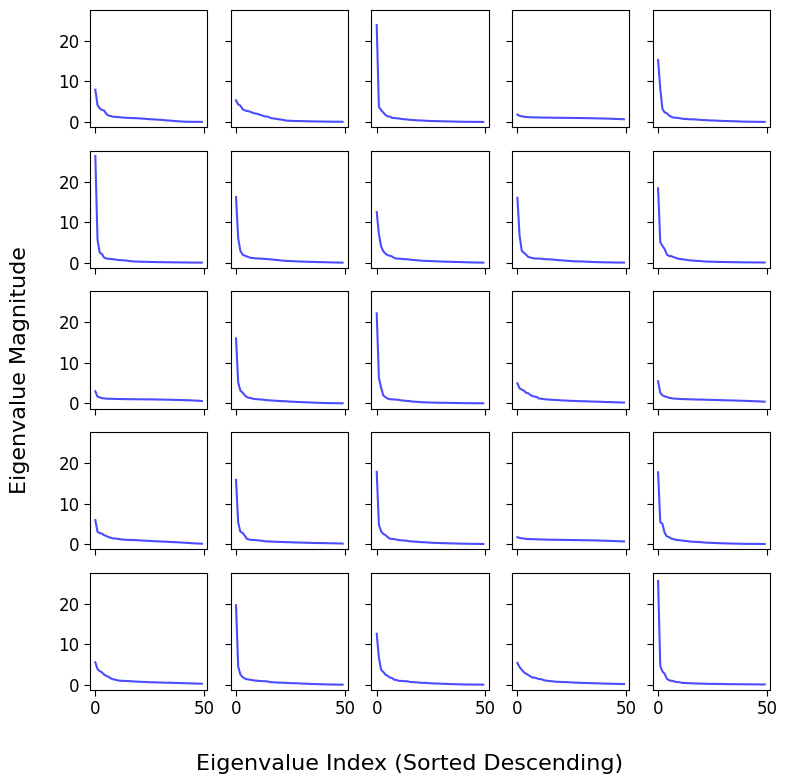

In [121]:
# Create subplot layout
fig, axes = plt.subplots(5, 5, figsize=(8, 8), sharex=True, sharey=True)

# Flatten axes array for easy iteration
axes = axes.flatten()

# Plot each state's eigenvalue decay in a separate subplot
for i in range(n_states):
    ax = axes[i]
    ax.plot(eigenvalues[i], linestyle='-', color='blue', alpha=0.7, linewidth=1.5)
    ax.tick_params(axis='both', which='major', length=4, labelsize=12)  # Larger ticks

# Remove empty subplots if n_states < 25
for j in range(n_states, len(axes)):
    fig.delaxes(axes[j])

# Adjust spacing and set common labels with larger fonts
fig.text(0.5, 0.0, "Eigenvalue Index (Sorted Descending)", ha='center', fontsize=16)
fig.text(0.0, 0.5, "Eigenvalue Magnitude", va='center', rotation='vertical', fontsize=16)

plt.subplots_adjust(left=0.1, right=0.95, top=0.95, bottom=0.1)  # Adjust layout to prevent overlap
plt.show()


In [12]:
print(eigenvalues[21])

[1.96571159e+01 4.46622753e+00 2.53332067e+00 1.89826548e+00
 1.52674484e+00 1.35237861e+00 1.27216542e+00 1.16618359e+00
 1.08584976e+00 1.00709438e+00 9.57456768e-01 9.20259237e-01
 8.77833664e-01 8.61901641e-01 8.49897504e-01 7.19241798e-01
 6.25676453e-01 6.08534217e-01 5.62191665e-01 5.24237573e-01
 5.06072283e-01 4.89824206e-01 4.64613229e-01 4.61481184e-01
 4.08276260e-01 3.90176117e-01 3.77277017e-01 3.57330829e-01
 3.46864402e-01 3.29552233e-01 2.81429410e-01 2.63596237e-01
 2.51089633e-01 2.31408015e-01 1.90766662e-01 1.82940885e-01
 1.68701887e-01 1.40979379e-01 1.33028507e-01 1.11958951e-01
 9.63081270e-02 7.80795515e-02 6.54365718e-02 5.51435910e-02
 5.17509915e-02 3.68847400e-02 2.36623660e-02 1.82422008e-02
 9.17502958e-03 5.37341833e-03]


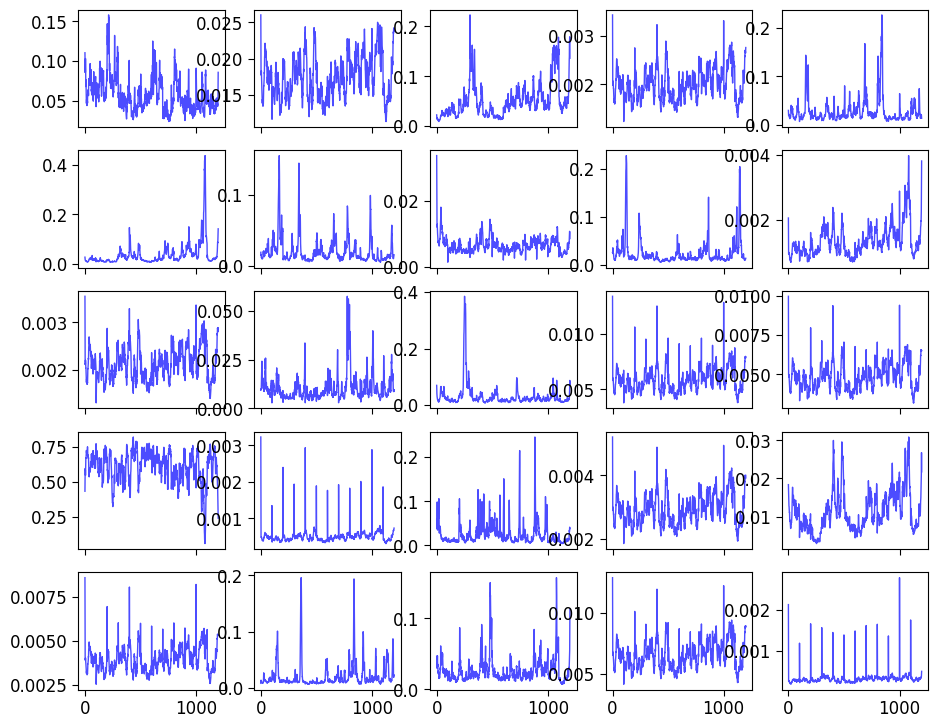

In [123]:
# Load time courses
with open('./results_final/real/ICA_50/dynemo_state_25/repeat_1/inf_params/alp.pkl', 'rb') as f:
    alp = pickle.load(f)  # alp is a list of length 1003, each item is (4800, 25)

# Select the first subject's data
alp_first_subject = alp[0]  # Shape: (4800, 25)

# Create subplot layout for time courses
fig, axes = plt.subplots(5, 5, figsize=(10, 8), sharex=True, sharey=False)
axes = axes.flatten()

# Plot each mode's time course (first 200 timepoints)
for i in range(n_states):
    ax = axes[i]
    ax.plot(alp_first_subject[:1200, i], color='blue', alpha=0.7, linewidth=1)
    ax.tick_params(axis='both', which='major', length=4, labelsize=12)

# Adjust layout to prevent overlap
plt.subplots_adjust(left=0.1, right=0.95, top=0.95, bottom=0.1)
plt.show()

## Update 8th February 2025

Identify the modes that contribute to the "growth" in model performance with "many" states in DyNeMo.

In [1]:
import os
import json
import yaml
import pickle

import numpy as np
from scipy.stats import multivariate_normal
import matplotlib.pyplot as plt
%matplotlib inline

from osl_dynamics.config_api import wrappers
from osl_dynamics.utils.plotting import plot_box, plot_matrices
from osl_dynamics.inference.modes import reweight_alphas

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# Root directory
root_dir = './results_final/real/ICA_50/'

# Two directories for comparison
save_dir = f'{root_dir}/dynemo_state_25/'

# Covariances used
covs_dir = f'{save_dir}/bcv_3/Y_train/inf_params/covs.npy'

# Time courses used
alp_dir = f'{save_dir}/bcv_3/Y_test/inf_params/alp.pkl'

# Configuration used
config_dir = f'{save_dir}/bcv_3/Y_test/prepared_config.yaml'

In [3]:
# Load the data
with open(config_dir, "r") as file:
    config = yaml.safe_load(file)
load_data_kwargs = config['load_data']
data = wrappers.load_data(**load_data_kwargs)

Standardize: 100%|█████████████████████████| 1003/1003 [00:04<00:00, 223.34it/s]


In [4]:
print(load_data_kwargs)

{'inputs': './data/node_timeseries/3T_HCP1200_MSMAll_d50_ts2/', 'prepare': {'select': {'timepoints': [0, 4800], 'channels': [0, 1, 3, 6, 8, 9, 11, 12, 15, 18, 20, 21, 24, 25, 29, 30, 31, 33, 35, 36, 38, 41, 44, 45, 47]}, 'standardize': {'session_length': 1200}}, 'kwargs': {'load_memmaps': True, 'store_dir': './results_final/real/ICA_50//dynemo_state_25/bcv_3/Y_test//tmp/'}}


In [5]:
keep_list = config['keep_list']
print(len(keep_list))
print('######################')
ts = [data[i] for i in keep_list]
print(len(ts))
print(ts[0].shape)

502
######################
502
(4800, 25)


In [6]:
# Load covariances
covs = np.load(covs_dir)

# Load posterior time courses
with open(alp_dir,'rb') as file:
    alp = pickle.load(file)

In [7]:
# Concatenate everything to numpy
ts_np = np.concatenate(ts)
norm_alp = reweight_alphas(alp,covs)

In [8]:
print(ts_np.shape)
print(len(norm_alp))
print(norm_alp[0].shape)
print(covs.shape)

(2409600, 25)
502
(4800, 25)
(25, 25, 25)


In [9]:
mean_norm_alpha = np.array([np.mean(a, axis=0) for a in norm_alp])
mean_norm_alpha_session_1 = np.array([np.mean(a[:1200,:],axis=0) for a in norm_alp])

print(mean_norm_alpha.shape)
print(mean_norm_alpha_session_1.shape)
print('##############################')

std_norm_alpha = np.array([np.std(a, axis=0) for a in norm_alp])
std_norm_alpha_session_1 = np.array([np.std(a[:1200,:],axis=0) for a in norm_alp])
print(std_norm_alpha.shape)
print(std_norm_alpha_session_1.shape)
print('##############################')

mean_alpha_diff = mean_norm_alpha-mean_norm_alpha_session_1
std_alpha_diff = std_norm_alpha-std_norm_alpha_session_1
print(np.median(mean_alpha_diff,axis=0))
print(np.median(std_alpha_diff,axis=0))

(502, 25)
(502, 25)
##############################
(502, 25)
(502, 25)
##############################
[ 1.8591844e-03 -1.6992688e-02  5.2519180e-03  1.7727725e-05
 -6.9999695e-04  2.8058770e-05  1.0805379e-05  2.2946479e-06
  2.6115682e-05  3.7664976e-03  2.6750192e-03  5.1685493e-06
  2.1942146e-04  1.8415565e-05  4.2617030e-06  2.0306179e-06
  4.1999537e-03  1.3055047e-05  2.5331434e-03  3.9101858e-04
  1.0063272e-02  3.0551892e-06  6.7384390e-06 -3.3903867e-05
  3.7654681e-06]
[ 2.3464710e-03  8.2361288e-03  8.2769003e-03  5.2783435e-06
 -3.1522289e-04  8.7961671e-06  3.1547752e-06  1.8328428e-06
  7.8565761e-05  7.6775141e-03  4.1151065e-03  1.4438483e-06
  5.7192473e-04  7.7087388e-06  1.5829282e-06  5.5192049e-07
  4.7398973e-03  3.5040575e-06  3.9455295e-03  8.5467310e-04
  1.0582991e-02  9.0558024e-07  1.5792684e-06  9.5903524e-04
  1.0299118e-06]


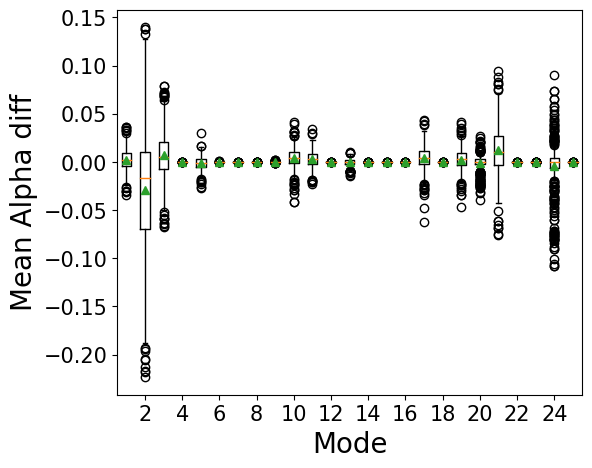

In [10]:
plot_box(mean_alpha_diff.T.tolist(),
         labels=list(range(1,len(mean_alpha_diff.T)+1)),
         plot_samples=False,
         mark_best=False,
         plot_kwargs={'showfliers': True},
         x_label="Mode",
         y_label="Mean Alpha diff",
         )
plt.show()

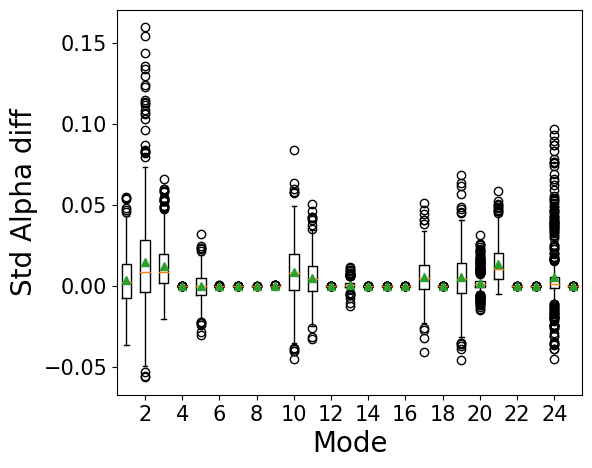

In [11]:
plot_box(std_alpha_diff.T.tolist(),
         labels=list(range(1,len(std_alpha_diff.T)+1)),
         plot_samples=False,
         mark_best=False,
         plot_kwargs={'showfliers': True},
         x_label="Mode",
         y_label="Std Alpha diff",
         )
plt.show()

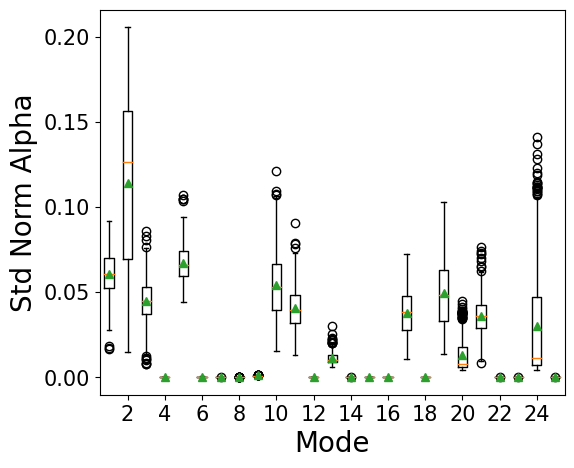

In [12]:
plot_box(std_norm_alpha.T.tolist(),
         labels=list(range(1,len(std_norm_alpha.T)+1)),
         plot_samples=False,
         mark_best=False,
         plot_kwargs={'showfliers': True},
         x_label="Mode",
         y_label="Std Norm Alpha",
         )
plt.show()

In [51]:
print(np.median(std_norm_alpha,axis=0))

[6.08375743e-02 1.26558542e-01 4.45331708e-02 2.54009152e-04
 6.58457354e-02 3.97856871e-04 1.94225053e-04 1.05220461e-04
 1.02761551e-03 5.28226420e-02 3.96656282e-02 7.25643331e-05
 1.03492085e-02 2.26148491e-04 8.25924799e-05 3.58945072e-05
 3.82813513e-02 1.95735483e-04 4.81932089e-02 7.96406437e-03
 3.57988626e-02 5.45553048e-05 1.51090760e-04 1.11896442e-02
 6.76122145e-05]


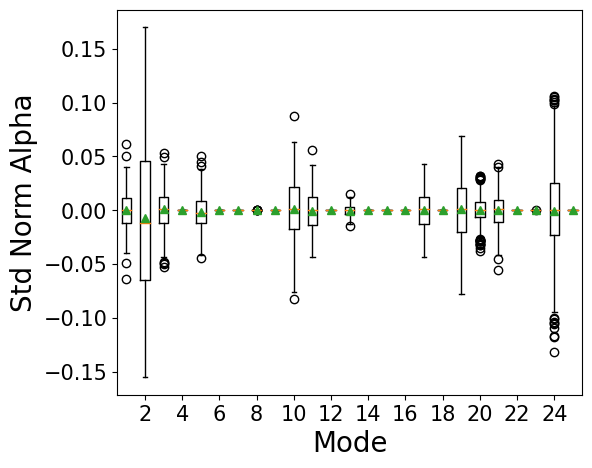

In [13]:
plot_box((std_norm_alpha[:251,:]-std_norm_alpha[251:,:]).T.tolist(),
         labels=list(range(1,len(std_norm_alpha.T)+1)),
         plot_samples=False,
         mark_best=False,
         plot_kwargs={'showfliers': True},
         x_label="Mode",
         y_label="Std Norm Alpha",
         )
plt.show()

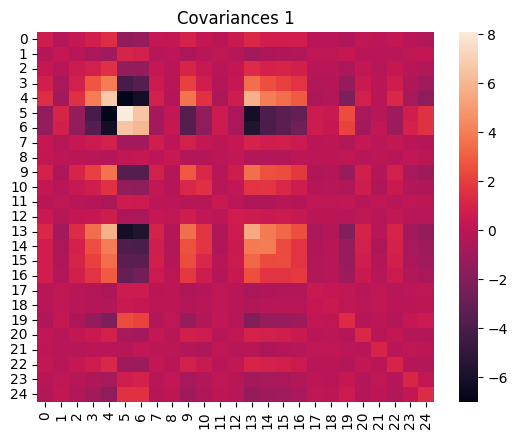

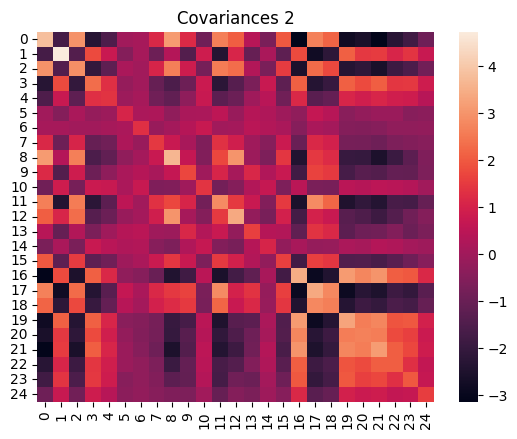

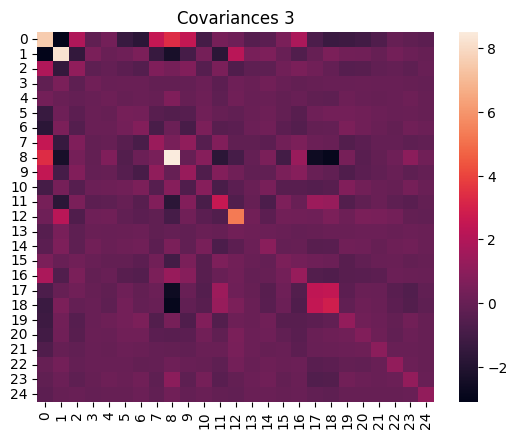

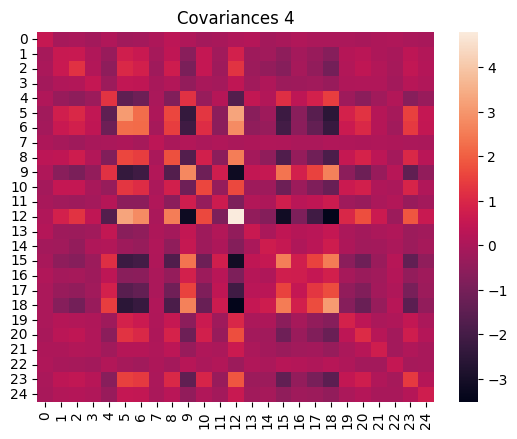

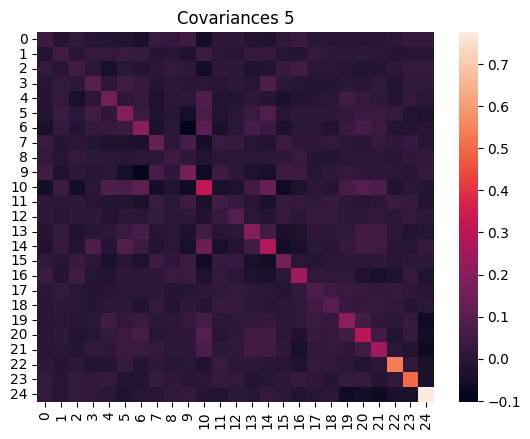

...

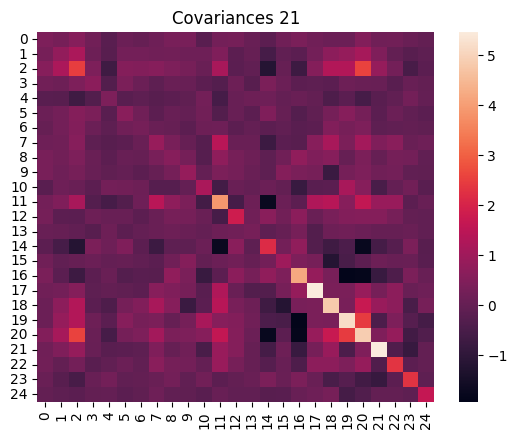

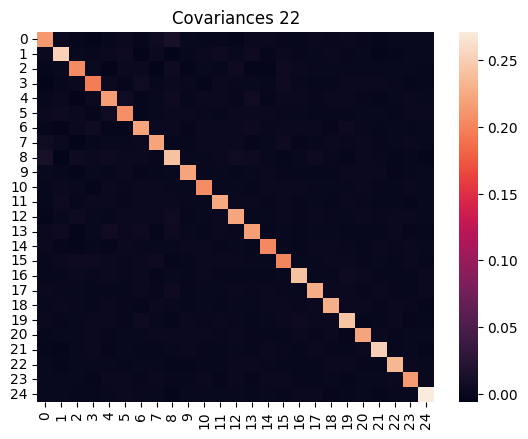

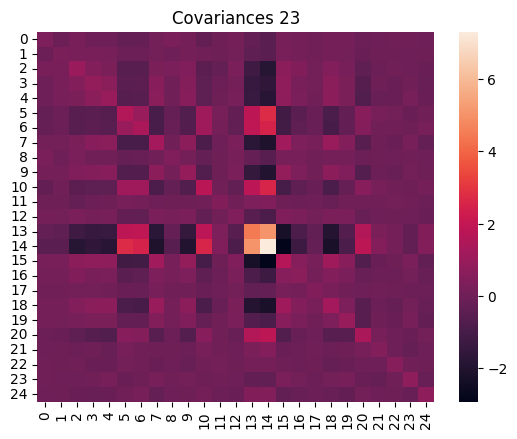

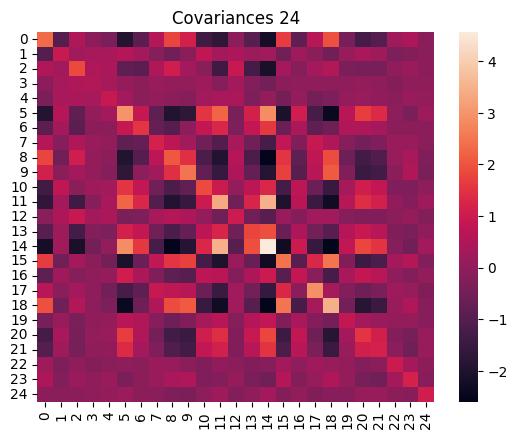

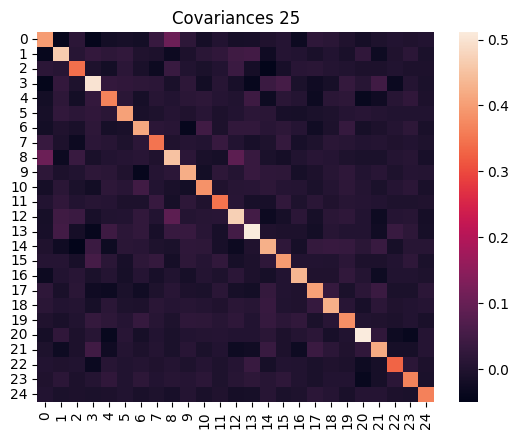

In [14]:
import seaborn as sns
for i in range(len(covs)):
    sns.heatmap(covs[i])
    plt.title(f'Covariances {i+1}')
    plt.show()

i=1,ll=-31.912297119749024
i=2,ll=-31.78608554677344
i=3,ll=-31.354005679762384
i=4,ll=-31.32258539748703
i=5,ll=-31.2294980819742
i=6,ll=-31.232782232759387
i=7,ll=-31.190787957935814
i=8,ll=-31.212700827929748
i=9,ll=-31.160078169682205
i=10,ll=-31.154832643387692
i=11,ll=-31.094211977435602
i=12,ll=-31.167436191134353
i=13,ll=-31.102463311904664
i=14,ll=-31.04799157750328
i=15,ll=-31.119055873106955
i=16,ll=-31.063032933722848
i=17,ll=-31.078393805634803
i=18,ll=-31.13853790794359
i=19,ll=-31.037048832072646
i=20,ll=-31.052674477307992
i=21,ll=-31.028051271356194
i=22,ll=-31.032799523372333
i=23,ll=-31.01552504774081
i=24,ll=-31.01995696404832
i=25,ll=-31.043771137461828


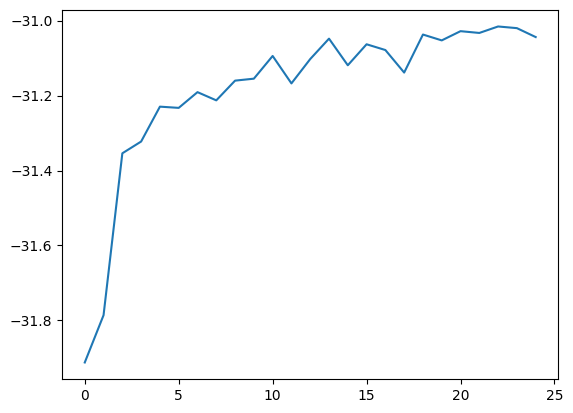

In [15]:
bcv_ll = []
for i in range(1,26):
    with open(f'{root_dir}/dynemo_state_{i}/bcv_3/Y_test/metrics.json','r') as file:
        ll = json.load(file)['log_likelihood']
        print(f'i={i},ll={ll}')
        bcv_ll.append(ll)
plt.plot(bcv_ll)
plt.show()

In [161]:
def calculate_log_likelihood(covs,alpha,ts,remove_modes=None):
    if isinstance(alpha,list):
        alpha = np.concatenate(alpha)
    if isinstance(ts,list):
        ts = np.concatenate(ts)

    if remove_modes is not None:
        alpha[:, np.array(remove_modes)-1] = 0
    # Compute the moment-to-moment covariance matrices
    C_t = np.einsum('ns,sij->nij', alpha, covs)

    # Compute inverse and log determinant of each covariance matrix
    inv_C = np.linalg.inv(C_t)
    logdet_C = np.log(np.linalg.det(C_t))

    # Compute quadratic term using einsum
    quad_term = np.einsum('ni,nij,nj->n', ts, inv_C, ts)

    # Calculate log likelihood
    d = ts.shape[1]
    log_likelihood = -0.5 * (quad_term + logdet_C + d * np.log(2 * np.pi))
    return np.mean(log_likelihood)

In [19]:
# Read the alpha
with open(f'{root_dir}/dynemo_state_25/bcv_3/Y_test/inf_params/alp.pkl','rb') as file:
    alpha = pickle.load(file)
covs = np.load(f'{root_dir}/dynemo_state_25/bcv_3/Y_train/inf_params/covs.npy')
delta_ll = []
for i in range(1,26):
    ll = calculate_log_likelihood(covs,alpha,ts,remove_modes=[i])
    delta_ll.append(bcv_ll[-1]-ll)
    print(f'i={i},delta_ll={bcv_ll[-1]-ll}')


i=1,delta_ll=1.3834558828018437
i=2,delta_ll=3.7506662709854375
i=3,delta_ll=2.4828668935440312
i=4,delta_ll=0.003998409046960916
i=5,delta_ll=1.8087221486709844
i=6,delta_ll=0.0037886006973515407
i=7,delta_ll=0.003039012684656228
i=8,delta_ll=0.0006510121963749782
i=9,delta_ll=0.017723689808679666
i=10,delta_ll=1.3325373037002812
i=11,delta_ll=2.9943071706436406
i=12,delta_ll=0.0017095906875859157
i=13,delta_ll=0.3352495534561406
i=14,delta_ll=0.003937373890710916
i=15,delta_ll=0.0007311208389531032
i=16,delta_ll=0.0008894307754765407
i=17,delta_ll=0.9662386281631719
i=18,delta_ll=0.003115306629968728
i=19,delta_ll=0.6410166127823125
i=20,delta_ll=0.34018577171785935
i=21,delta_ll=1.13013709618075
i=22,delta_ll=0.0013643605850468532
i=23,delta_ll=0.0026098592422734157
i=24,delta_ll=0.27684272362215623
i=25,delta_ll=0.0017343862198124782


In [20]:
print(delta_ll)

[1.3834558828018437, 3.7506662709854375, 2.4828668935440312, 0.003998409046960916, 1.8087221486709844, 0.0037886006973515407, 0.003039012684656228, 0.0006510121963749782, 0.017723689808679666, 1.3325373037002812, 2.9943071706436406, 0.0017095906875859157, 0.3352495534561406, 0.003937373890710916, 0.0007311208389531032, 0.0008894307754765407, 0.9662386281631719, 0.003115306629968728, 0.6410166127823125, 0.34018577171785935, 1.13013709618075, 0.0013643605850468532, 0.0026098592422734157, 0.27684272362215623, 0.0017343862198124782]


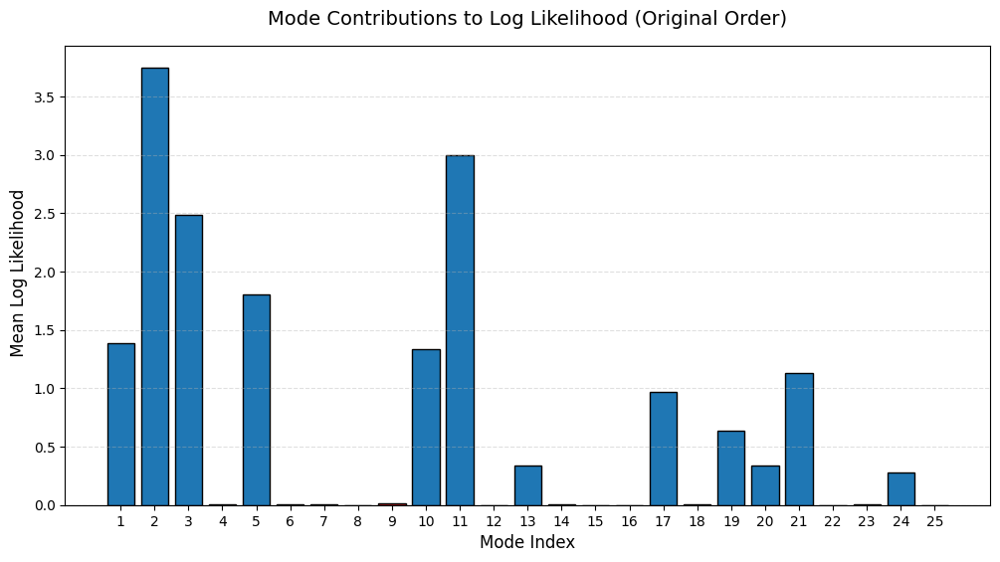

In [22]:
# Assuming delta_LL is your existing list/array
modes = np.arange(len(delta_ll))+1  # Mode indices [0, 1, ..., 15]
modes_in_red = [4,6,7,8,9,12,14,15,16,18,22,23,25]

# Create figure
plt.figure(figsize=(12, 6))

# Create colors (red for negative, blue for positive)
colors = ['#d62728' if mode in modes_in_red else '#1f77b4' for mode in modes ]

# Plot bars
bars = plt.bar(modes, delta_ll, color=colors, edgecolor='black')

# Customize plot
plt.axhline(0, color='black', linewidth=0.8)  # Zero line
plt.title('Mode Contributions to Log Likelihood (Original Order)', fontsize=14, pad=15)
plt.xlabel('Mode Index', fontsize=12)
plt.ylabel(' Mean Log Likelihood', fontsize=12)
plt.xticks(modes, fontsize=10)
plt.yticks(fontsize=10)
plt.grid(axis='y', linestyle='--', alpha=0.4)
plt.show()

In [26]:
with open(f'{root_dir}/dynemo_state_25/bcv_3/Y_test/inf_params/alp.pkl','rb') as file:
    alpha = pickle.load(file)
covs = np.load(f'{root_dir}/dynemo_state_25/bcv_3/Y_train/inf_params/covs.npy')
delta_ll = []
print(f'Removing modes {modes_in_red}, log likelihood is: {calculate_log_likelihood(covs,alpha,ts,remove_modes=modes_in_red)}')

Removing modes [4, 6, 7, 8, 9, 12, 14, 15, 16, 18, 22, 23, 25], log likelihood is: -31.094545364379883


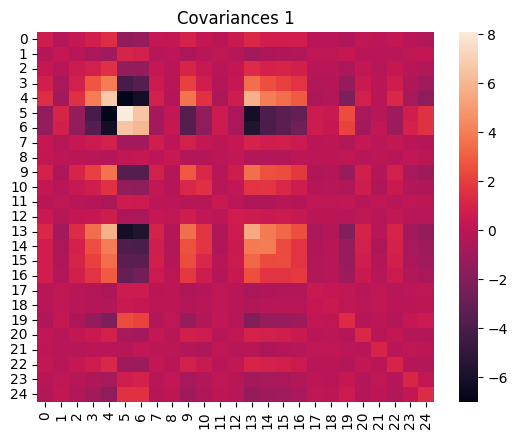

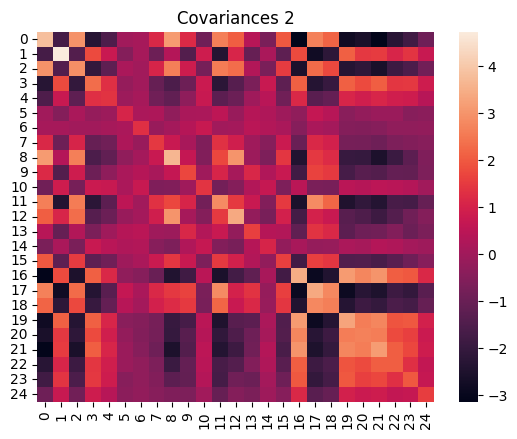

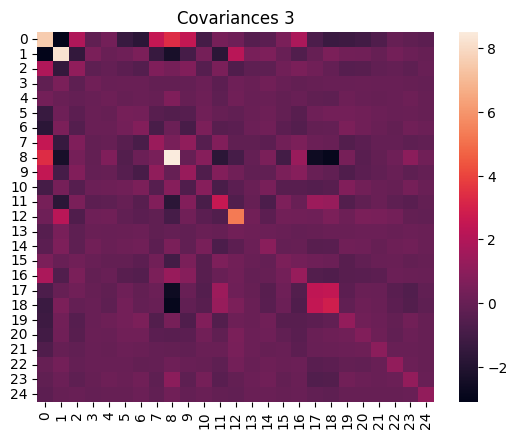

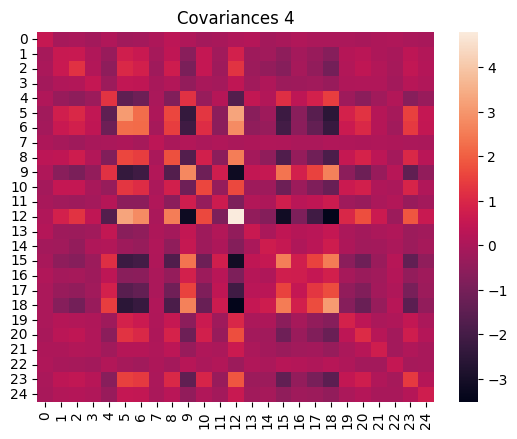

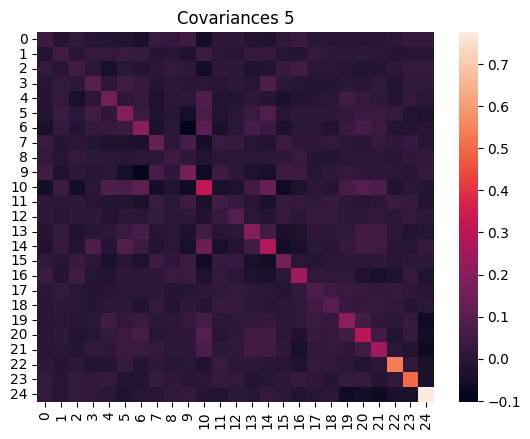

...

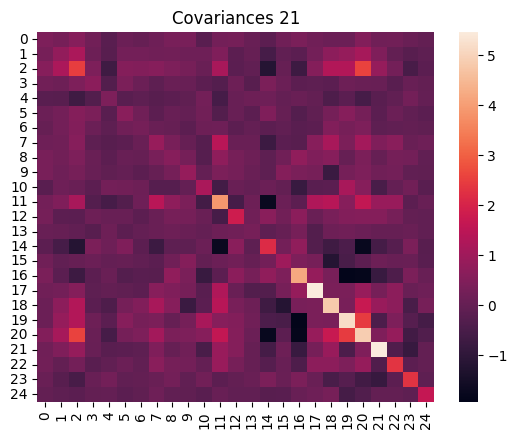

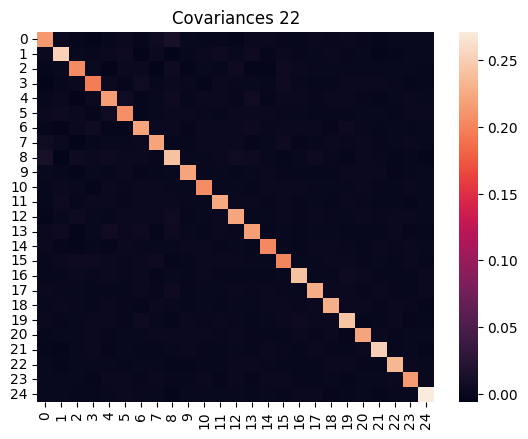

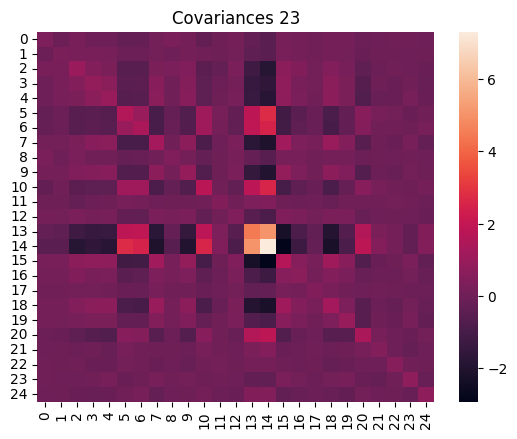

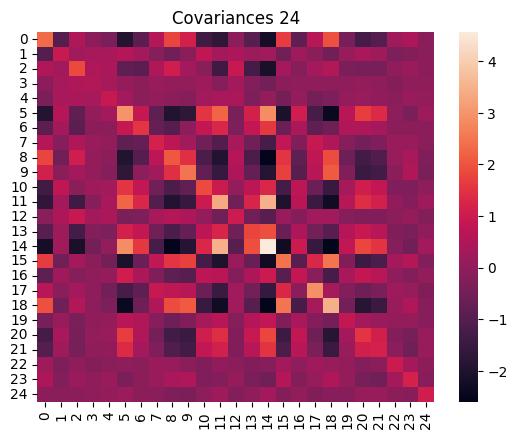

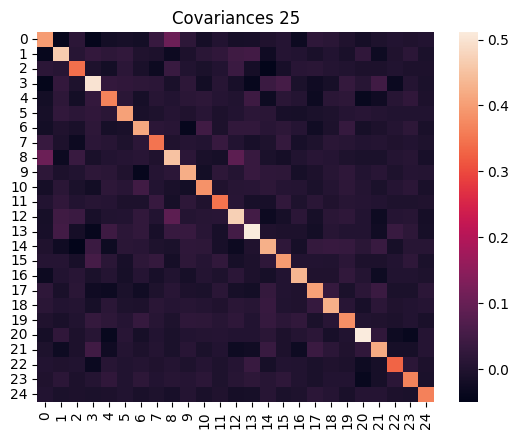

In [24]:
import seaborn as sns
for i in range(len(covs)):
    sns.heatmap(covs[i])
    plt.title(f'Covariances {i+1}')
    plt.show()

In [28]:
norm_alpha = reweight_alphas(alpha,covs)

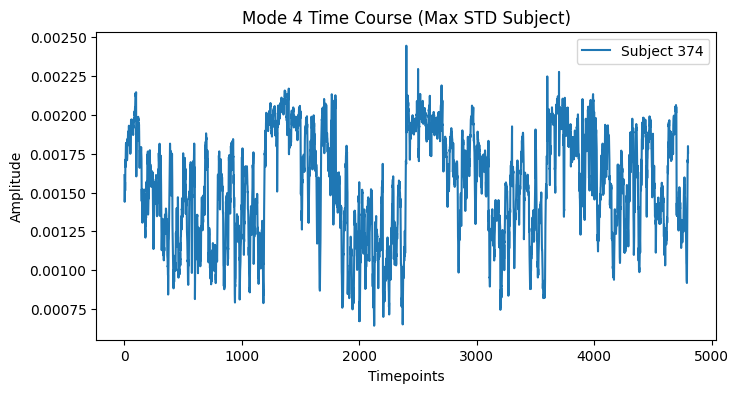

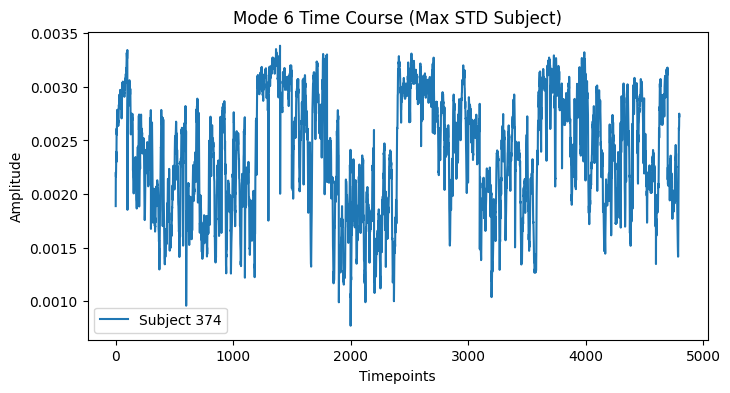

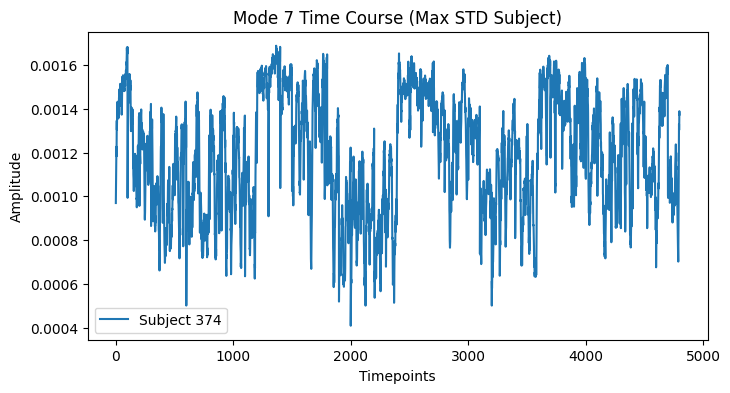

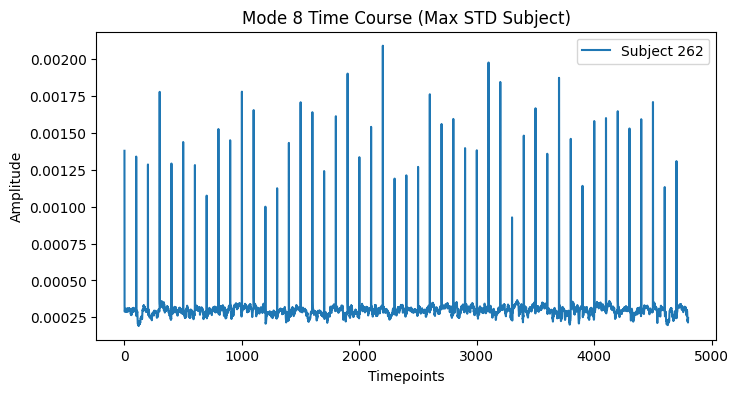

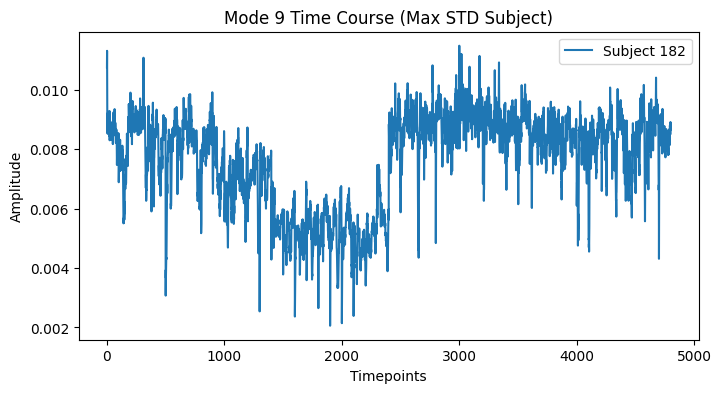

...

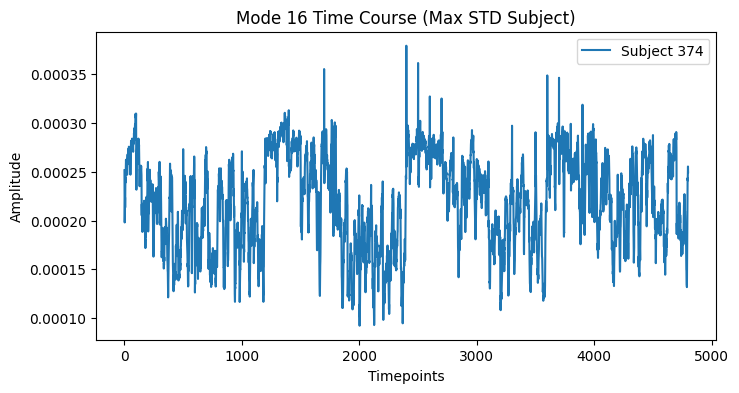

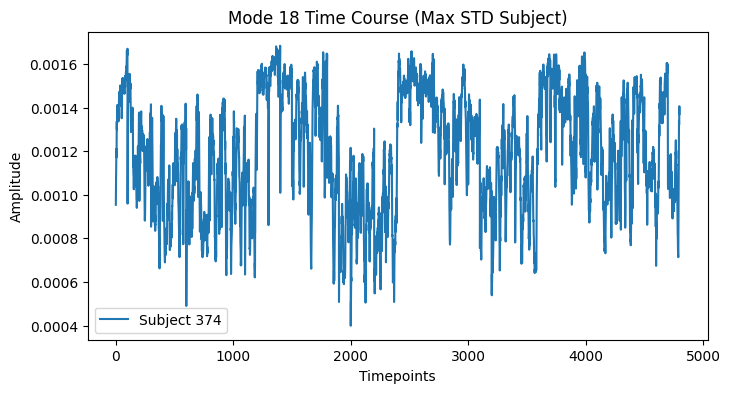

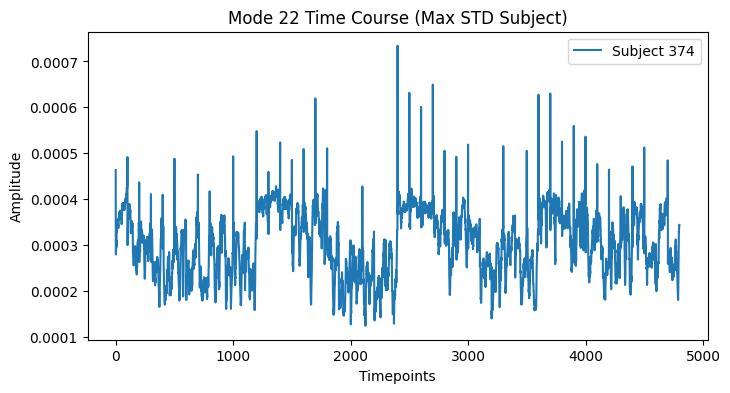

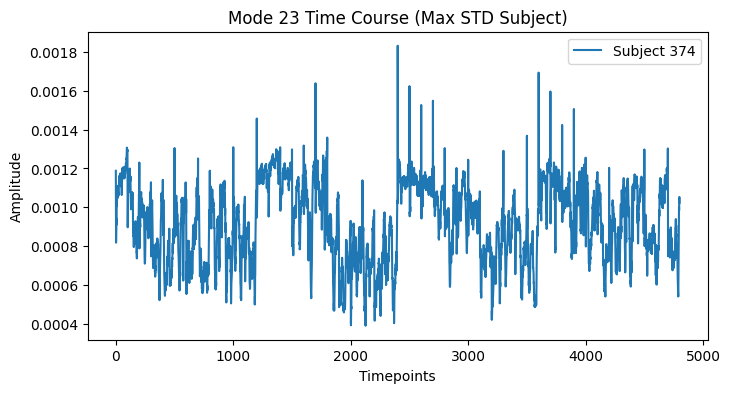

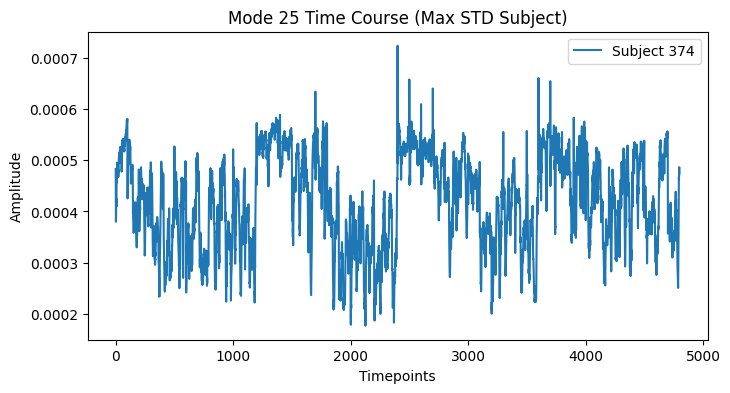

In [45]:
modes_zero_indexed = [m-1 for m in modes_in_red]
    
for mode_idx, original_mode in zip(modes_zero_indexed, modes_in_red):
    # Find subject with maximum standard deviation for this mode
    stds = [np.std(subject[:, mode_idx]) for subject in norm_alpha]
    max_std_subj_idx = np.argmax(stds)
    max_std_subj = norm_alpha[max_std_subj_idx][:, mode_idx]
        
    # Time course plot
    plt.figure(figsize=(8, 4))
    plt.plot(max_std_subj, label=f'Subject {max_std_subj_idx+1}')
    plt.title(f'Mode {original_mode} Time Course (Max STD Subject)')
    plt.xlabel('Timepoints')
    plt.ylabel('Amplitude')
    plt.legend()
    plt.show()

In [33]:
from scipy import signal
from scipy.stats import zscore
fs = 1.389  # Sampling frequency (in Hz) - IMPORTANT: Set this correctly!
nperseg = 1200

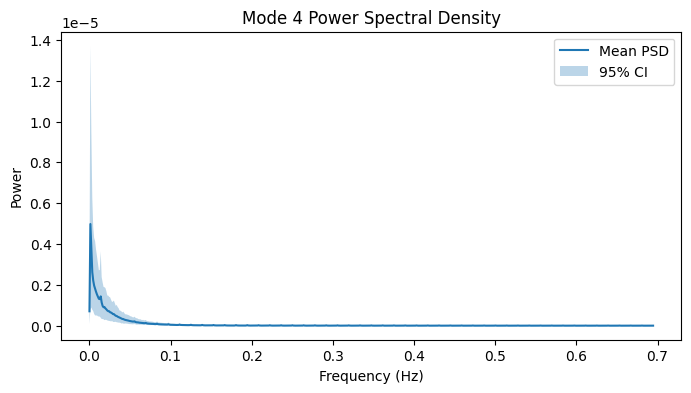

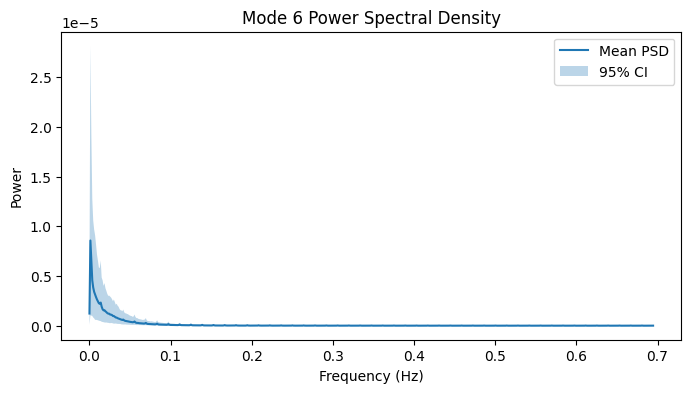

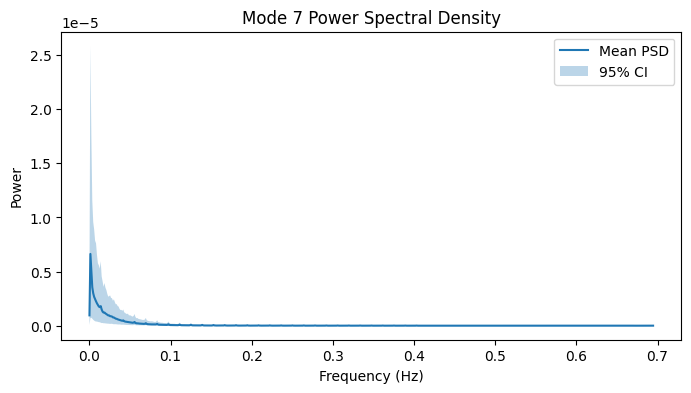

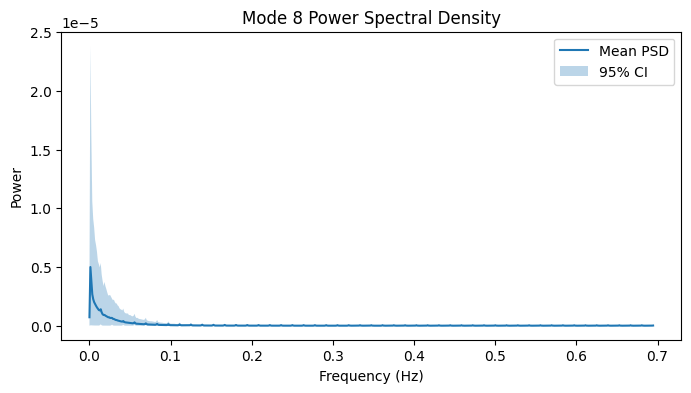

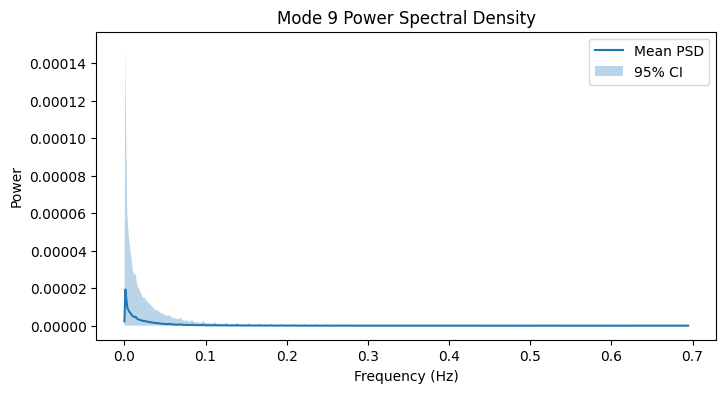

...

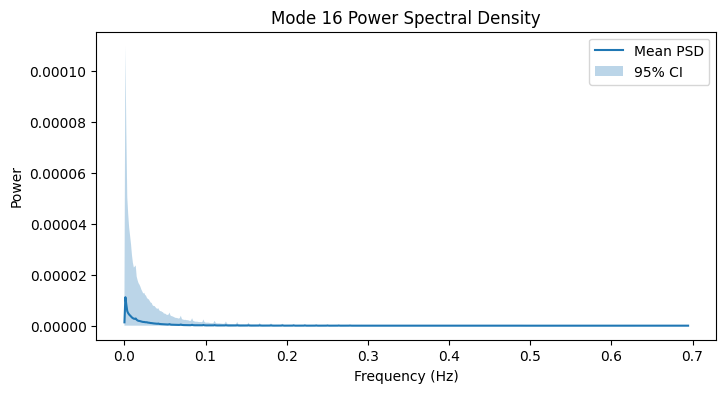

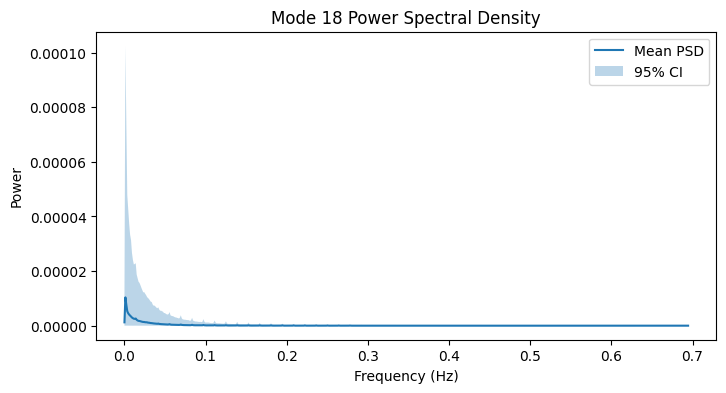

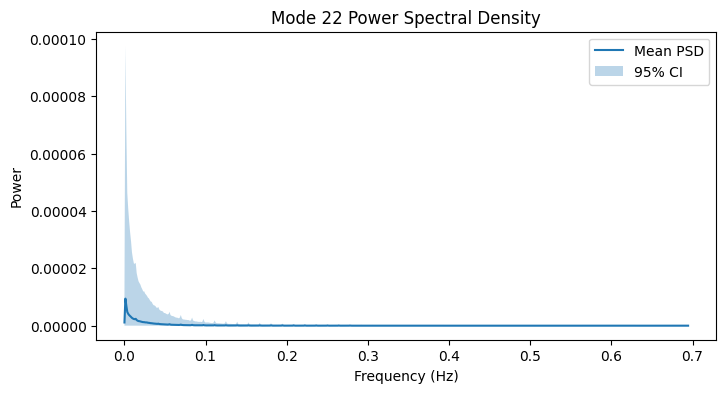

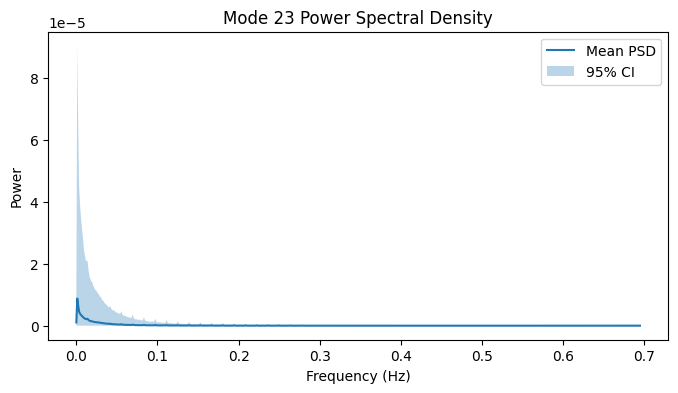

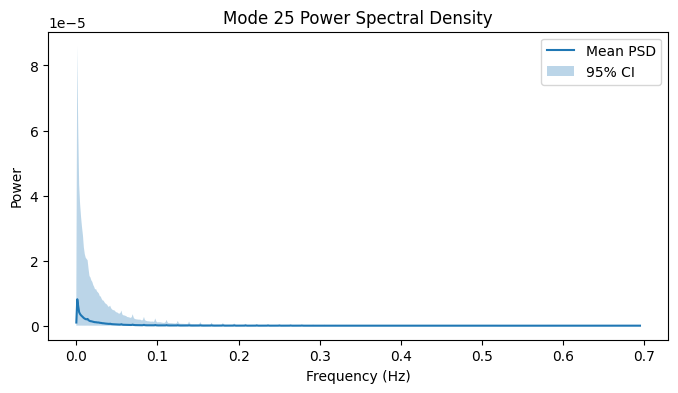

In [41]:
all_psds = []
freqs = None

for mode_idx, original_mode in zip(modes_zero_indexed, modes_in_red):
    for subj in norm_alpha:
        f, psd = signal.welch(subj[:, mode_idx], fs=fs, nperseg=nperseg)
        all_psds.append(psd)
        if freqs is None:
            freqs = f
        
    # Calculate statistics
    mean_psd = np.mean(all_psds, axis=0)
    ci_low, ci_high = np.percentile(all_psds, [2.5, 97.5], axis=0)
        
    # Plot mean PSD with CI
    plt.figure(figsize=(8, 4))
    plt.plot(freqs, mean_psd, label='Mean PSD')
    plt.fill_between(freqs, ci_low, ci_high, alpha=0.3, label='95% CI')
    plt.title(f'Mode {original_mode} Power Spectral Density')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Power')
    plt.legend()
    plt.show()

In [47]:
# Load covariances
covs = np.load('./results_final/real/ICA_50/dynemo_state_25/bcv_3/Y_train/inf_params/covs.npy')

# Load posterior time courses
with open('./results_final/real/ICA_50/dynemo_state_25/bcv_3/X_train/inf_params/alp.pkl','rb') as file:
    alpha_train = pickle.load(file)
norm_alpha_train = reweight_alphas(alpha_train,covs)

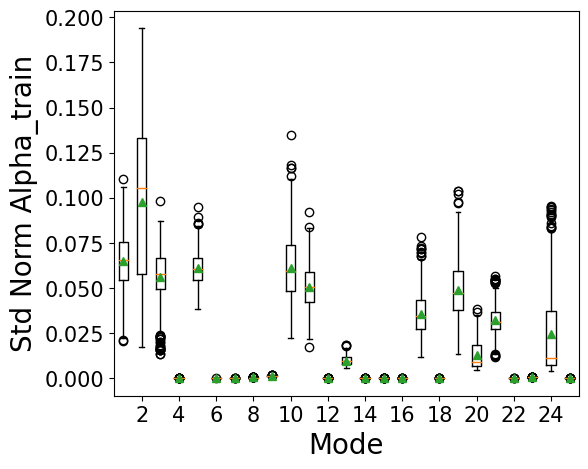

In [48]:
std_norm_alpha_train = np.array([np.std(a, axis=0) for a in norm_alpha_train])
plot_box(std_norm_alpha_train.T.tolist(),
         labels=list(range(1,len(std_norm_alpha_train.T)+1)),
         plot_samples=False,
         mark_best=False,
         plot_kwargs={'showfliers': True},
         x_label="Mode",
         y_label="Std Norm Alpha_train",
         )
plt.show()

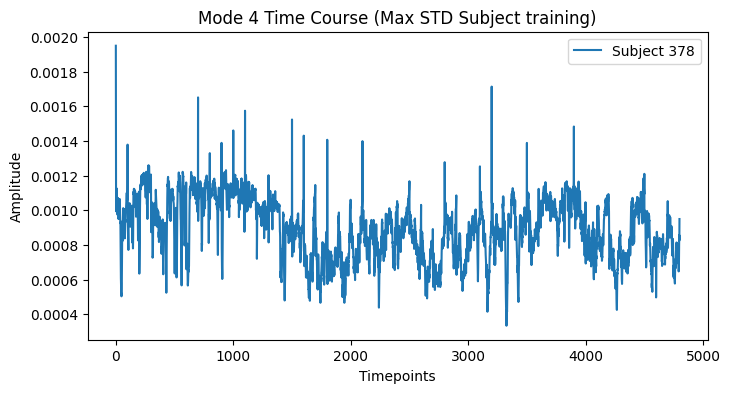

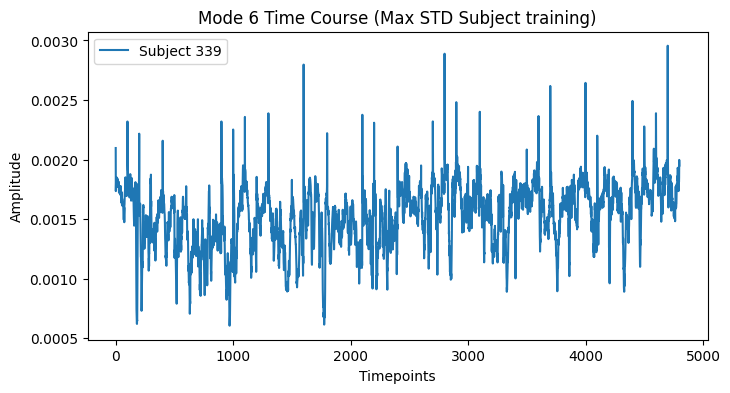

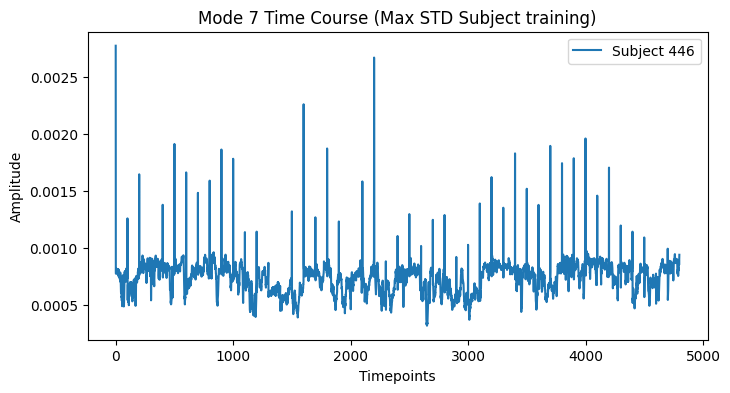

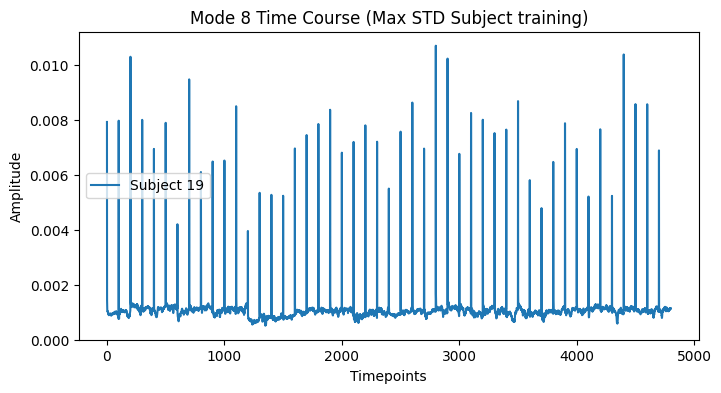

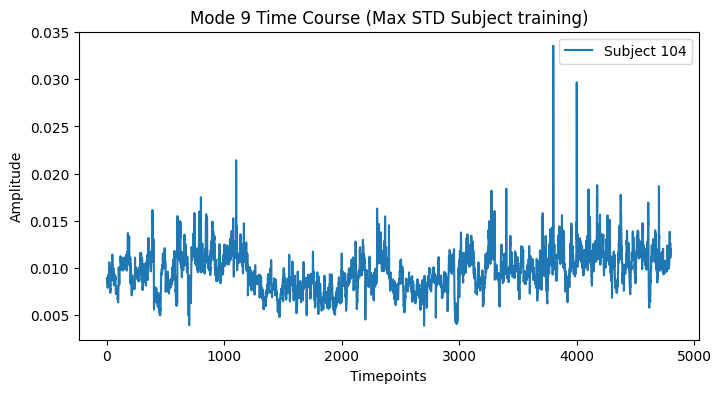

...

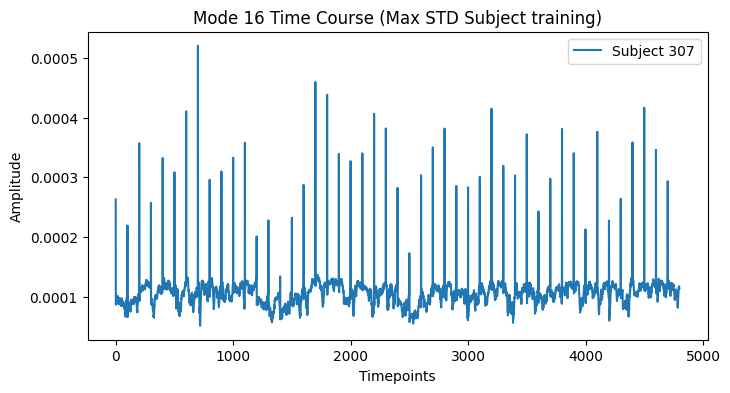

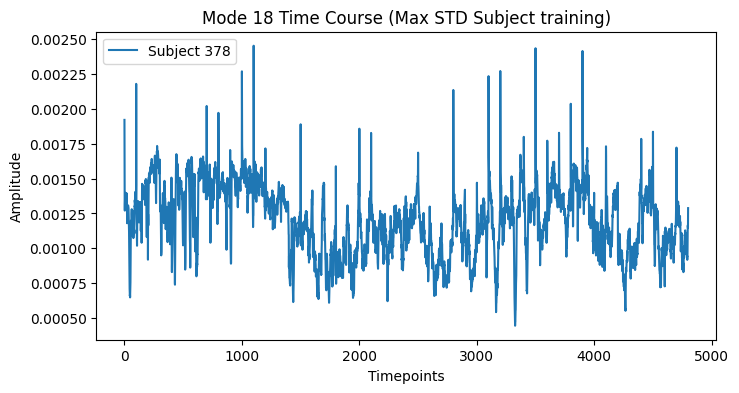

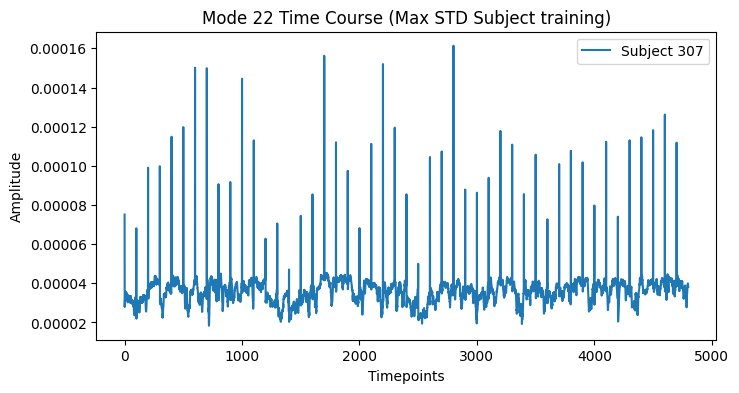

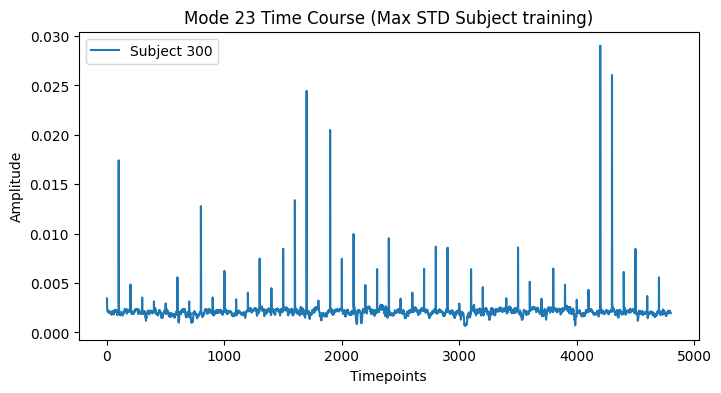

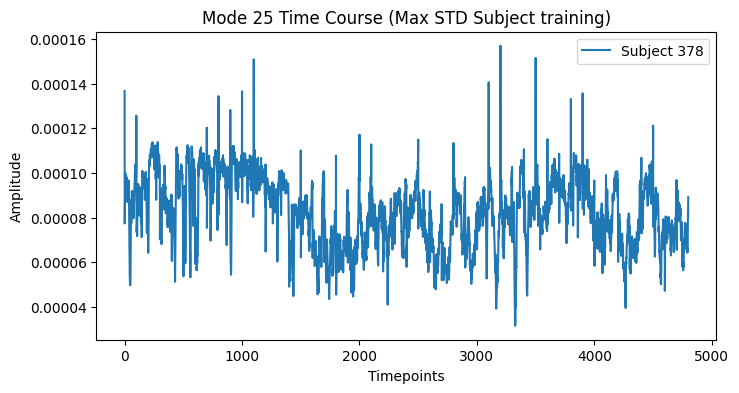

In [49]:
modes_zero_indexed = [m-1 for m in modes_in_red]
    
for mode_idx, original_mode in zip(modes_zero_indexed, modes_in_red):
    # Find subject with maximum standard deviation for this mode
    stds = [np.std(subject[:, mode_idx]) for subject in norm_alpha_train]
    max_std_subj_idx = np.argmax(stds)
    max_std_subj = norm_alpha_train[max_std_subj_idx][:, mode_idx]
        
    # Time course plot
    plt.figure(figsize=(8, 4))
    plt.plot(max_std_subj, label=f'Subject {max_std_subj_idx+1}')
    plt.title(f'Mode {original_mode} Time Course (Max STD Subject training)')
    plt.xlabel('Timepoints')
    plt.ylabel('Amplitude')
    plt.legend()
    plt.show()

session number:1
i=2,ll=-31.638702392578125
i=3,ll=-31.156278610229492
i=4,ll=-31.13860511779785
i=5,ll=-31.04679298400879
i=6,ll=-31.047649383544922
i=7,ll=-30.996267318725586
i=8,ll=-31.036231994628906
i=9,ll=-30.965776443481445
i=10,ll=-30.978792190551758
i=11,ll=-30.917203903198242
i=12,ll=-30.96647834777832
i=13,ll=-30.89788818359375
i=14,ll=-30.864219665527344
i=15,ll=-30.947364807128906
i=16,ll=-30.872772216796875
i=17,ll=-30.888071060180664
i=18,ll=-30.95021629333496
i=19,ll=-30.842805862426758
i=20,ll=-30.863094329833984
i=21,ll=-30.8365478515625
i=22,ll=-30.840112686157227
i=23,ll=-30.825117111206055
i=24,ll=-30.818523406982422
i=25,ll=-30.858598709106445


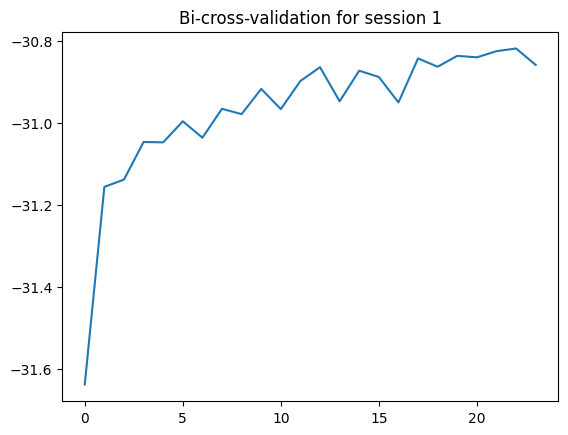

session number:2
i=2,ll=-31.741779327392578
i=3,ll=-31.323974609375
i=4,ll=-31.245647430419922
i=5,ll=-31.185022354125977
i=6,ll=-31.19219398498535
i=7,ll=-31.13385772705078
i=8,ll=-31.12343978881836
i=9,ll=-31.088436126708984
i=10,ll=-31.079174041748047
i=11,ll=-31.029525756835938
i=12,ll=-31.11655616760254
i=13,ll=-31.042573928833008
i=14,ll=-30.988075256347656
i=15,ll=-31.049657821655273
i=16,ll=-31.006855010986328
i=17,ll=-31.01026153564453
i=18,ll=-31.071823120117188
i=19,ll=-30.97728157043457
i=20,ll=-31.00304412841797
i=21,ll=-30.979528427124023
i=22,ll=-30.96976089477539
i=23,ll=-30.963472366333008
i=24,ll=-30.971458435058594
i=25,ll=-30.97842025756836


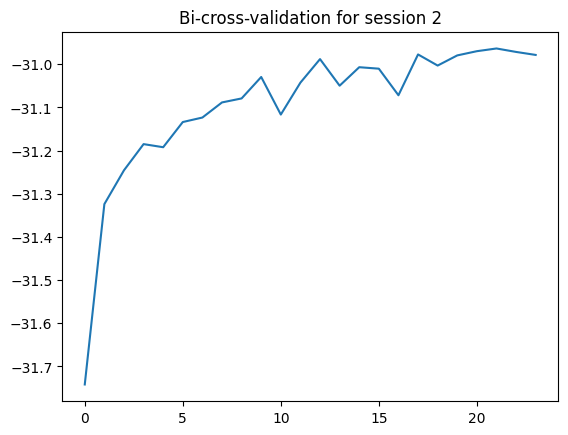

session number:3
i=2,ll=-31.887170791625977
i=3,ll=-31.4974365234375
i=4,ll=-31.464574813842773
i=5,ll=-31.36786460876465
i=6,ll=-31.372072219848633
i=7,ll=-31.340919494628906
i=8,ll=-31.351181030273438
i=9,ll=-31.306673049926758
i=10,ll=-31.282718658447266
i=11,ll=-31.23438835144043
i=12,ll=-31.315448760986328
i=13,ll=-31.25570297241211
i=14,ll=-31.190776824951172
i=15,ll=-31.255657196044922
i=16,ll=-31.21232032775879
i=17,ll=-31.22511863708496
i=18,ll=-31.283113479614258
i=19,ll=-31.18779945373535
i=20,ll=-31.194801330566406
i=21,ll=-31.17450523376465
i=22,ll=-31.17459487915039
i=23,ll=-31.155733108520508
i=24,ll=-31.1763973236084
i=25,ll=-31.185129165649414


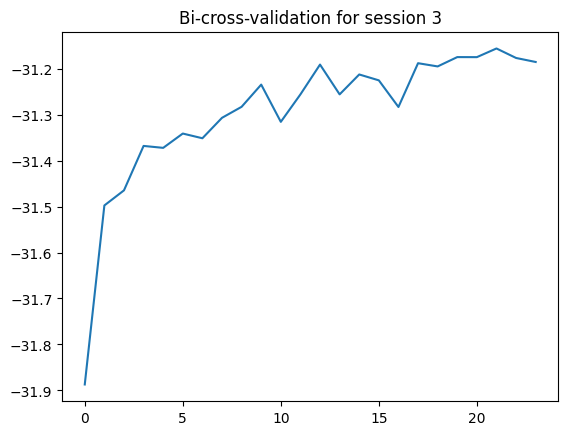

session number:4
i=2,ll=-31.876693725585938
i=3,ll=-31.438316345214844
i=4,ll=-31.44150733947754
i=5,ll=-31.31830406188965
i=6,ll=-31.319215774536133
i=7,ll=-31.292095184326172
i=8,ll=-31.339946746826172
i=9,ll=-31.279415130615234
i=10,ll=-31.278656005859375
i=11,ll=-31.195724487304688
i=12,ll=-31.271255493164062
i=13,ll=-31.213687896728516
i=14,ll=-31.148881912231445
i=15,ll=-31.223548889160156
i=16,ll=-31.16016960144043
i=17,ll=-31.190135955810547
i=18,ll=-31.248994827270508
i=19,ll=-31.140321731567383
i=20,ll=-31.149761199951172
i=21,ll=-31.12163734436035
i=22,ll=-31.146726608276367
i=23,ll=-31.117782592773438
i=24,ll=-31.11345863342285
i=25,ll=-31.152921676635742


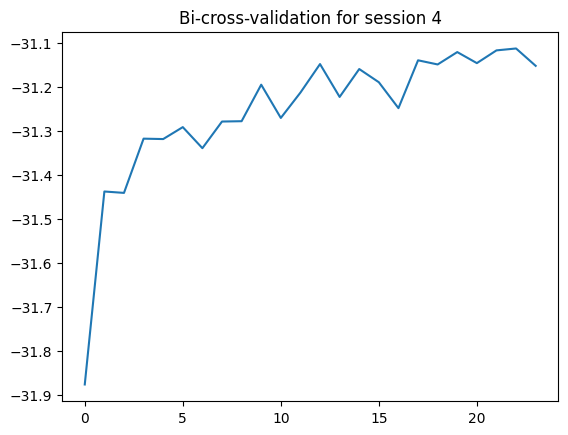

In [21]:
for session in range(1,5):
    print(f'session number:{session}')
    lls = []
    for i in range(2,26):
        # Read the alpha
        with open(f'{root_dir}/dynemo_state_{i}/bcv_3/Y_test/inf_params/alp.pkl','rb') as file:
            alpha = pickle.load(file)
        covs = np.load(f'{root_dir}/dynemo_state_{i}/bcv_3/Y_train/inf_params/covs.npy')
        ll = calculate_log_likelihood(covs,[x[1200*(session-1):1200 * session,:] for x in alpha],[x[1200*(session-1):1200 * session,:] for x in ts])
        print(f'i={i},ll={ll}')
        lls.append(ll)
    plt.plot(lls)
    plt.title(f'Bi-cross-validation for session {session}')
    plt.show()
        

## Update 17th February 2025

Check my Gaussian-weighted least square straightline fitting

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from osl_dynamics.data import Data

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
file_path = '/well/win-midnightsc/projects/ICA/groupICA_50_method_0_dl/node_timeseries/sub-MSC10_ses-func02_timecourses.npy'

(818, 50)


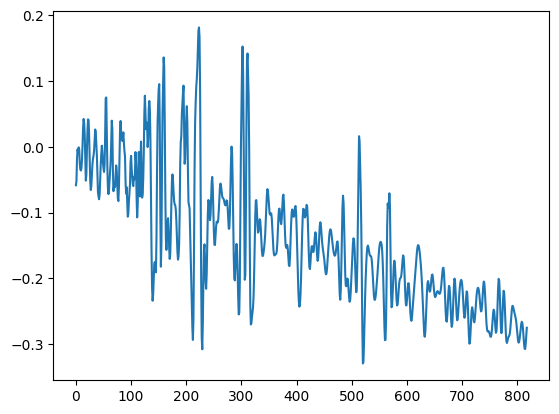

In [3]:
original_signal = np.load(file_path)
print(original_signal.shape)
plt.plot(np.squeeze(original_signal[:,32]))
plt.show()

In [4]:
data = Data(file_path,sampling_frequency=1/2.2)
prepare_with_session = {'filter': {'sigma': 50, 'session_length':5}}
data.prepare(prepare_with_session)
filtered_ts = data.time_series()


Filtering: 100%|█████████████████████████████████| 1/1 [00:00<00:00, 105.64it/s]


In [5]:
print(filtered_ts.shape)

(818, 50)


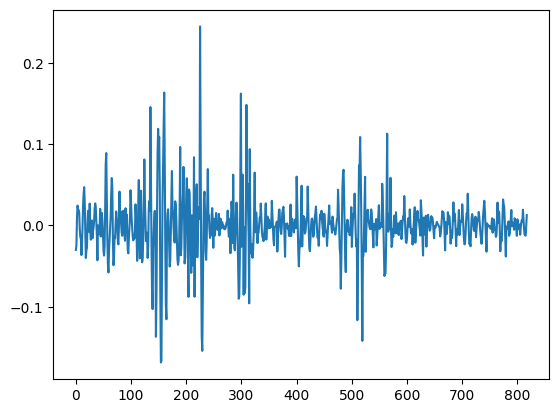

In [6]:
plt.plot(np.squeeze(filtered_ts[:,32]))
plt.show()

## Update 19th February 2025

Check the moment-to-moment rank of covariance matrices

In [6]:
import pickle
import yaml
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

from osl_dynamics.array_ops import cov2corr

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [7]:
save_dir = './results_final/real/ICA_50/dynemo_state_25/repeat_1/inf_params/'

In [8]:
covs = np.load(f'{save_dir}/covs.npy')
with open(f'{save_dir}/alp.pkl', "rb") as f:  # "rb" means read in binary mode
    alpha = pickle.load(f)

In [9]:
example_alpha = alpha[0][:1200,:]

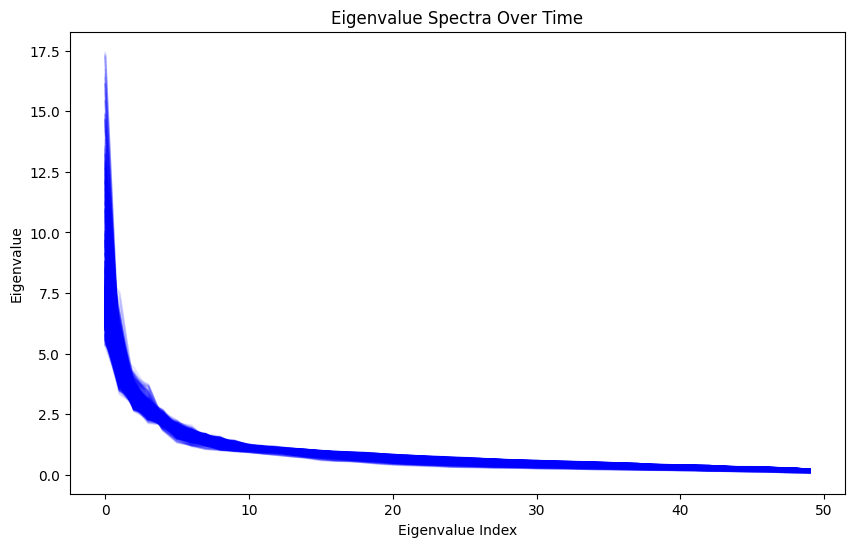

In [10]:
# Compute moment-to-moment covariance matrices
moment_covs = np.einsum('tm,mij->tij', example_alpha, covs)

# Compute eigenvalues for each moment covariance matrix
eigenvalues = np.linalg.eigvalsh(cov2corr(moment_covs))[:, ::-1]  # Sorted from largest to smallest

# Plot all eigenvalue spectra
plt.figure(figsize=(10, 6))
for i in range(len(example_alpha)):
    plt.plot(eigenvalues[i], color='blue', alpha=0.1)  # Semi-transparent lines

plt.xlabel("Eigenvalue Index")
plt.ylabel("Eigenvalue")
plt.title("Eigenvalue Spectra Over Time")
plt.show()

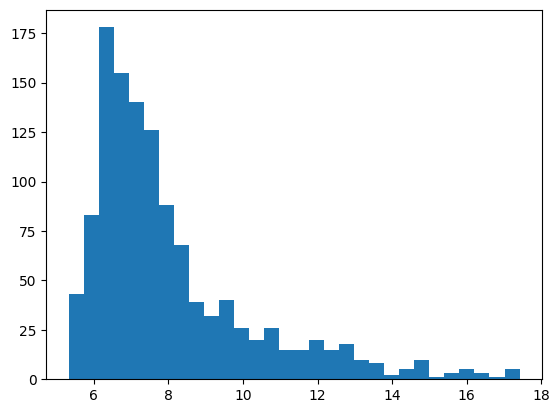

In [12]:
plt.hist(eigenvalues[:,0],bins=30)
plt.show()

In [13]:
hmm_covs = np.load('./results_final/real/ICA_50/hmm_state_9/repeat_1/inf_params/covs.npy')
eigenvalues_hmm = np.linalg.eigvalsh(cov2corr(hmm_covs))[:, ::-1]

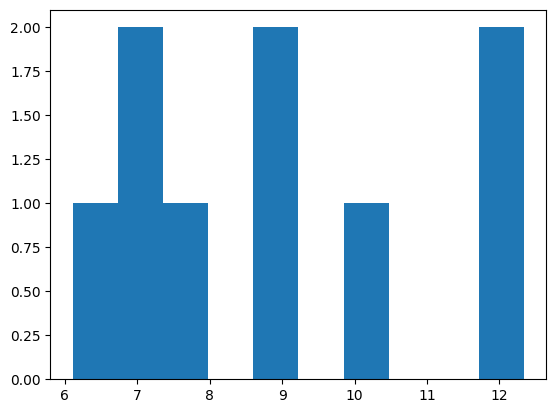

In [14]:
plt.hist(eigenvalues_hmm[:,0])
plt.show()

In [22]:
import seaborn as sns

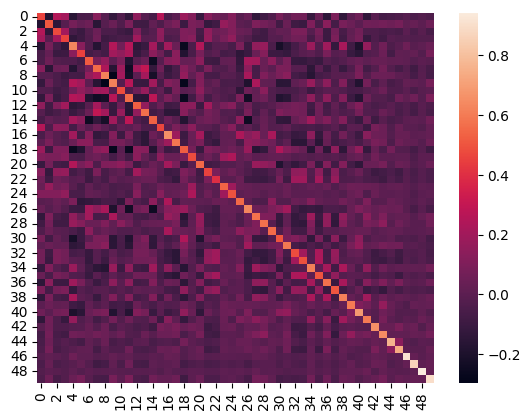

In [24]:
sns.heatmap(moment_covs[100])
plt.show()

OK, now let's select 10 subjects, plot the distribution of correlation eigenvalues.

In [19]:
# Randomly select 10 subjects
selected_subjects = np.random.choice(len(alpha), 10, replace=False)

# Reconstruct and concatenate moment-to-moment covariance matrices
concatenated_corrs = []
for subj in selected_subjects:
    print(f'Currently processing subject:{subj}') 
    moment_covs = np.einsum('tm,mij->tij', alpha[subj], covs)
    moment_corrs = np.array([cov2corr(C) for C in moment_covs])
    concatenated_corrs.append(moment_corrs)

concatenated_corrs = np.concatenate(concatenated_corrs, axis=0)
print(f'concatenated_corrs shape: {concatenated_corrs.shape}') 

Currently processing subject:422
Currently processing subject:119
Currently processing subject:629
Currently processing subject:112
Currently processing subject:780
Currently processing subject:682
Currently processing subject:582
Currently processing subject:399
Currently processing subject:97
Currently processing subject:824
concatenated_corrs shape: (48000, 50, 50)


In [20]:
# Compute eigenvalues for moment-to-moment correlation matrices
eigenvalues = np.linalg.eigvalsh(concatenated_corrs)[:, ::-1]  # Sorted from largest to smallest

In [24]:
# Compute eigenvalues for DyNeMo mode correlation matrices
dynemo_corrs = np.array([cov2corr(C) for C in covs])
dynemo_eigenvalues = np.linalg.eigvalsh(dynemo_corrs)[:, ::-1]

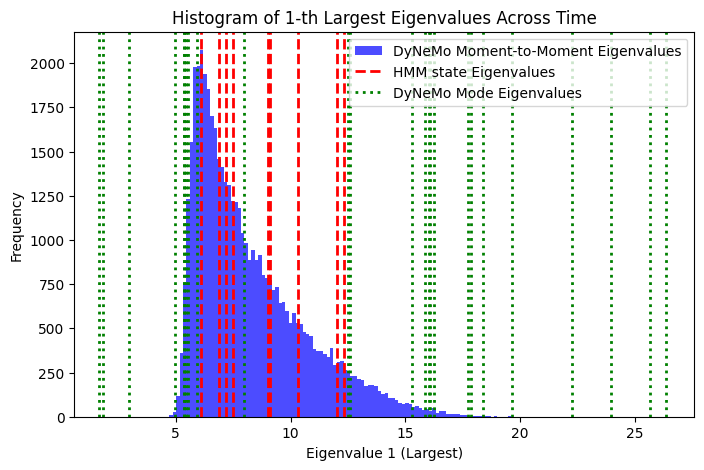

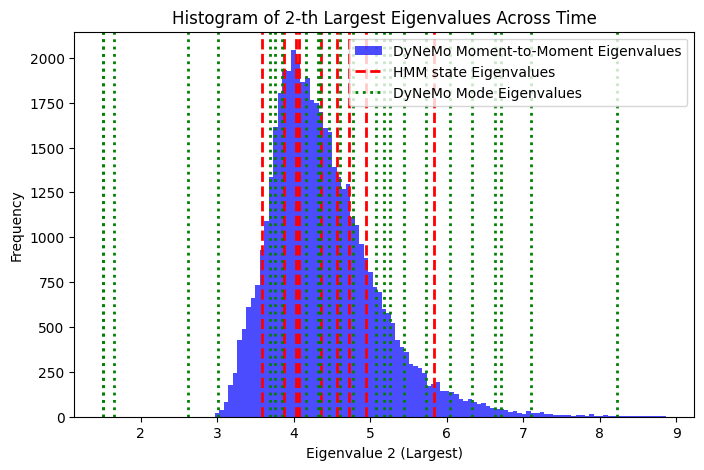

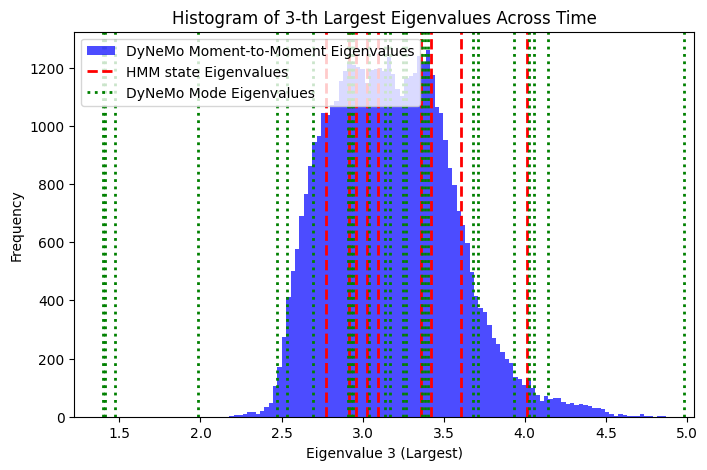

In [25]:
# Plot histograms for first, second, and third eigenvalues
for i in range(3):
    plt.figure(figsize=(8, 5))
    plt.hist(eigenvalues[:, i], bins=100, color='blue', alpha=0.7, label='DyNeMo Moment-to-Moment Eigenvalues')
    for hmm_val in eigenvalues_hmm[:, i]:
        plt.axvline(hmm_val, color='red', linestyle='dashed', linewidth=2, label='HMM state Eigenvalues' if hmm_val == eigenvalues_hmm[0, i] else "")
    for dynemo_val in dynemo_eigenvalues[:, i]:
        plt.axvline(dynemo_val, color='green', linestyle='dotted', linewidth=2, label='DyNeMo Mode Eigenvalues' if dynemo_val == dynemo_eigenvalues[0, i] else "")
    plt.xlabel(f"Eigenvalue {i+1} (Largest)")
    plt.ylabel("Frequency")
    plt.title(f"Histogram of {i+1}-th Largest Eigenvalues Across Time")
    plt.legend()
    plt.show()

### The reproducibility of HMM states

In [71]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
from osl_dynamics.inference.metrics import twopair_riemannian_distance, twopair_fisher_z_correlations
from osl_dynamics.inference.modes import hungarian_pair
from osl_dynamics.utils.plotting import plot_mode_pairing
from osl_dynamics.array_ops import cov2corr

In [112]:
cov_1 = np.load('./results_final/real/ICA_50/hmm_state_9/repeat_1/inf_params/covs.npy')
cov_2 = np.load('./results_final/real/ICA_50_filter_0.05/hmm_state_9/repeat_1/inf_params/covs.npy')
corr_1 = cov2corr(cov_1)
corr_2 = cov2corr(cov_2)

In [113]:
'''
sns.heatmap(np.squeeze(cov_1),cmap='coolwarm')
plt.show()
sns.heatmap(np.squeeze(cov_2),cmap='coolwarm')
plt.show()
'''

"\nsns.heatmap(np.squeeze(cov_1),cmap='coolwarm')\nplt.show()\nsns.heatmap(np.squeeze(cov_2),cmap='coolwarm')\nplt.show()\n"

In [114]:
'''
# Generate a random permutation of channel indices
perm_indices = np.random.permutation(50)

# Apply the permutation to both dimensions of cov_2
cov_2_shuffled = cov_2[:, perm_indices, :][:, :, perm_indices]
corr_2_shuffled = cov2corr(cov_2_shuffled)
'''

'\n# Generate a random permutation of channel indices\nperm_indices = np.random.permutation(50)\n\n# Apply the permutation to both dimensions of cov_2\ncov_2_shuffled = cov_2[:, perm_indices, :][:, :, perm_indices]\ncorr_2_shuffled = cov2corr(cov_2_shuffled)\n'

Compute twopair Fisher-z transformated correlation: 100%|█| 9/9 [00:00<00:00, 58


0.9080660781883139


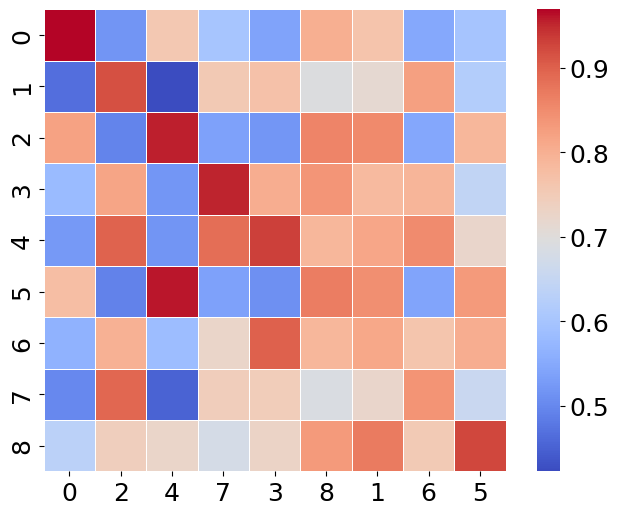

In [115]:
fisher_z = twopair_fisher_z_correlations(corr_1,corr_2)
order,fisher_z_reorder = hungarian_pair(fisher_z,distance=False)
plot_mode_pairing(fisher_z_reorder,order)
print(np.mean(np.diagonal(fisher_z_reorder)))

Computing Riemannian distances: 100%|████████████| 9/9 [00:00<00:00, 195.11it/s]


3.082888675034939


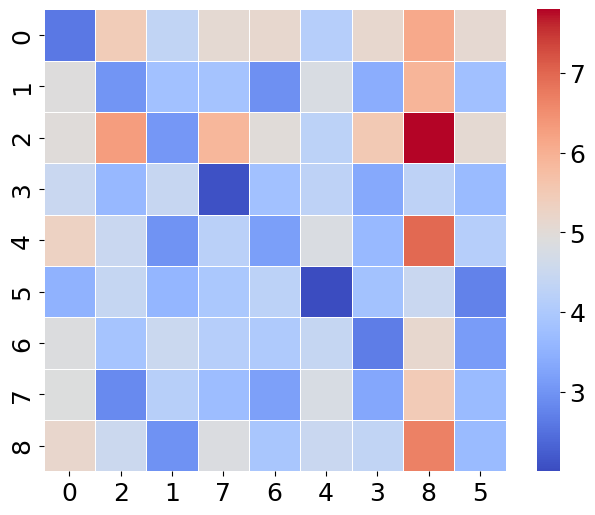

In [116]:
riem = twopair_riemannian_distance(cov_1,cov_2)
order,riem_reorder = hungarian_pair(riem,distance=True)
plot_mode_pairing(riem_reorder,order)
print(np.mean(np.diagonal(riem_reorder)))

## Update 24th Feb 2025

In [124]:
import os
import json
import yaml
import pickle

import numpy as np
from scipy.stats import multivariate_normal
import matplotlib.pyplot as plt
%matplotlib inline

from osl_dynamics.config_api import wrappers
from osl_dynamics.utils.plotting import plot_box, plot_matrices
from osl_dynamics.inference.modes import reweight_alphas

In [125]:
# Root directory
root_dir = './results_final/real/ICA_25_gaussian/'

# Two directories for comparison
save_dir = f'{root_dir}/dynemo_state_12/'

# Covariances used
covs_dir = f'{save_dir}/bcv_3/Y_train/inf_params/covs.npy'

# Time courses used
alp_dir = f'{save_dir}/bcv_3/Y_test/inf_params/alp.pkl'

# Configuration used
config_dir = f'{save_dir}/bcv_3/Y_test/prepared_config.yaml'

In [126]:
# Load the data
with open(config_dir, "r") as file:
    config = yaml.safe_load(file)
load_data_kwargs = config['load_data']
data = wrappers.load_data(**load_data_kwargs)
print(load_data_kwargs)

Standardize: 100%|█████████████████████████| 1003/1003 [00:02<00:00, 349.23it/s]

{'inputs': './data/node_timeseries/3T_HCP1200_MSMAll_d25_ts2/', 'prepare': {'filter': {'sigma': 50, 'session_length': 1200}, 'select': {'timepoints': [0, 4800], 'channels': [1, 3, 4, 5, 6, 8, 9, 11, 12, 15, 19, 22, 23]}, 'standardize': {'session_length': 1200}}, 'kwargs': {'load_memmaps': True, 'sampling_frequency': 1.389, 'store_dir': './results_final/real/ICA_25_gaussian//dynemo_state_12/bcv_3/Y_test//tmp/'}}


In [127]:
keep_list = config['keep_list']
print(len(keep_list))
print('######################')

ts = [data[i] for i in keep_list]
print(len(ts))
print(ts[0].shape)

502
######################
502
(4800, 13)


In [146]:
load_data_kwargs_raw = {'inputs': './data/node_timeseries/3T_HCP1200_MSMAll_d25_ts2/', 'prepare': {'select': {'timepoints': [0, 4800], 'channels': [1, 3, 4, 5, 6, 8, 9, 11, 12, 15, 19, 22, 23]}, 'standardize': {'session_length': 1200}}, 'kwargs': {'load_memmaps': True, 'sampling_frequency': 1.389, 'store_dir': './results_final/real/ICA_25_gaussian//dynemo_state_12/bcv_3/Y_test//tmp_1/'}}

In [147]:
data_raw = wrappers.load_data(**load_data_kwargs_raw)

Standardize: 100%|█████████████████████████| 1003/1003 [00:02<00:00, 350.25it/s]


In [149]:
ts_raw = [data_raw[i] for i in keep_list]

In [152]:
print(len(ts))
print(len(ts_raw))
print(ts[0].shape)
print(ts_raw[0].shape)
print(np.mean(np.abs(ts[0]-ts_raw[0])))

502
502
(4800, 13)
(4800, 13)
0.07698161


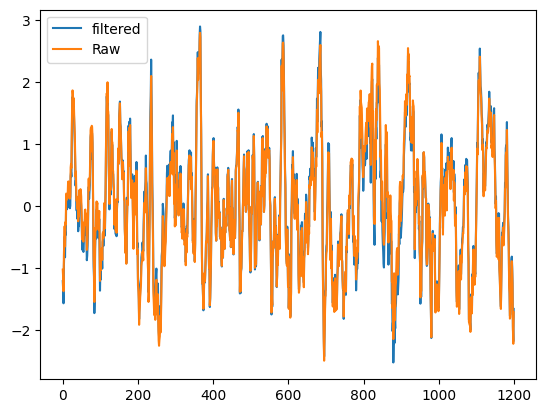

In [157]:
# Load covariances
covs = np.load(covs_dir)

# Load posterior time courses
with open(alp_dir,'rb') as file:
    alp = pickle.load(file)

In [163]:
print(calculate_log_likelihood(covs,alp,ts_raw))

-17.357983


### Update 17th March 2025

Compare the old bi-cross-validation implementations VS new ones.

In [1]:
import json
import numpy as np
import matplotlib.pyplot as plt

In [36]:
save_dir_1 = './results_final/real/ICA_50/swc_state_20/'
save_dir_2 = './results_final/real/ICA_50_many_states/swc_state_20/'

In [37]:
metric_1, metric_2 = [], []

In [38]:
for i in range(100):
    with open(f'{save_dir_1}/bcv_{i+1}/Y_test/metrics.json','r') as file:
        metric_1.append(json.load(file)['log_likelihood'])
    with open(f'{save_dir_2}/bcv_{i+1}/Y_test/metrics.json','r') as file:
        metric_2.append(json.load(file)['log_likelihood'])

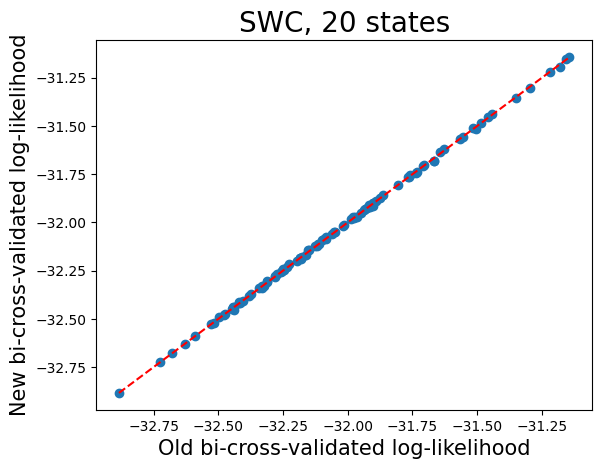

In [39]:
plt.scatter(np.array(metric_1),np.array(metric_2))
# Add y=x reference line
x_vals = np.linspace(min(metric_1 + metric_2), max(metric_1 + metric_2), 100)
plt.plot(x_vals, x_vals, color='red', linestyle='--', label="y = x")

# Labels and legend
plt.xlabel("Old bi-cross-validated log-likelihood",fontsize=15)
plt.ylabel("New bi-cross-validated log-likelihood",fontsize=15)
plt.title('SWC, 20 states',fontsize=20)
plt.show()

### Check DyNeMo's training results.

In [42]:
import pickle
import numpy
import matplotlib.pyplot as plt
%matplotlib inline

from osl_dynamics.inference.metrics import alpha_correlation, twopair_riemannian_distance
from osl_dynamics.inference.modes import hungarian_pair
from osl_dynamics.utils.plotting import plot_alpha, plot_mode_pairing

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [41]:
ground_truth_dir = './data/node_timeseries/simulation_final/soft_mixing/truth/'
ground_truth_alpha = np.load(f'{ground_truth_dir}/10001_mode_time_course.npy')
ground_truth_cov = np.load(f'{ground_truth_dir}/state_covariances.npy')

Computing Riemannian distances: 100%|█████████████| 6/6 [00:00<00:00, 60.02it/s]
/gpfs3/well/win-fmrib-analysis/users/uap971/osl-dynamics/osl_dynamics/utils/plotting.py:72: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(*args, **kwargs)
Computing Riemannian distances: 100%|█████████████| 6/6 [00:00<00:00, 79.29it/s]


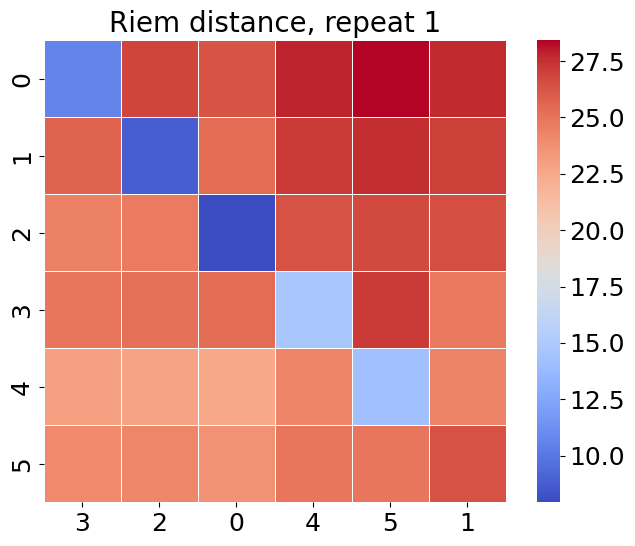

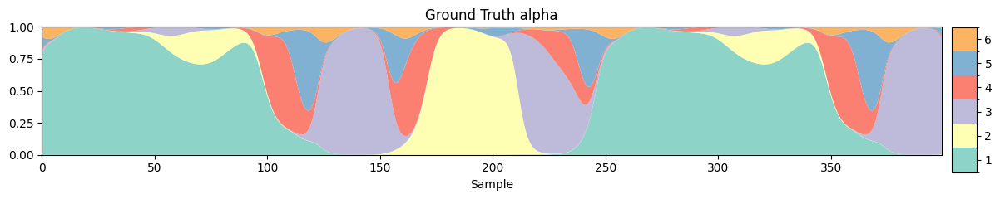

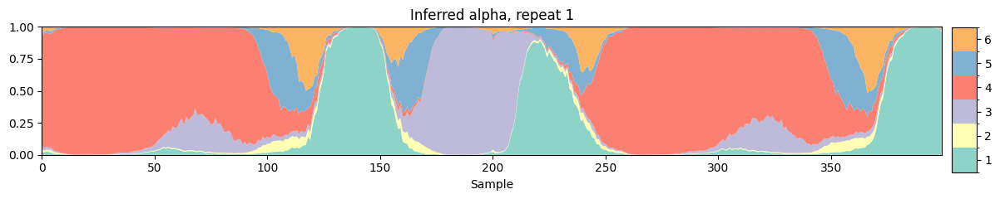

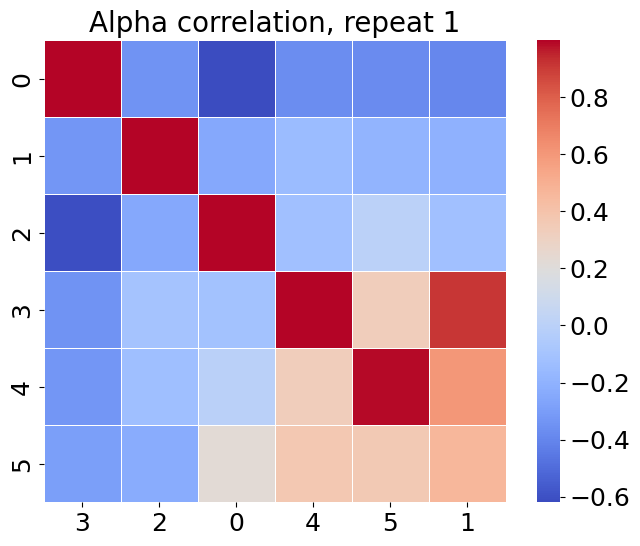

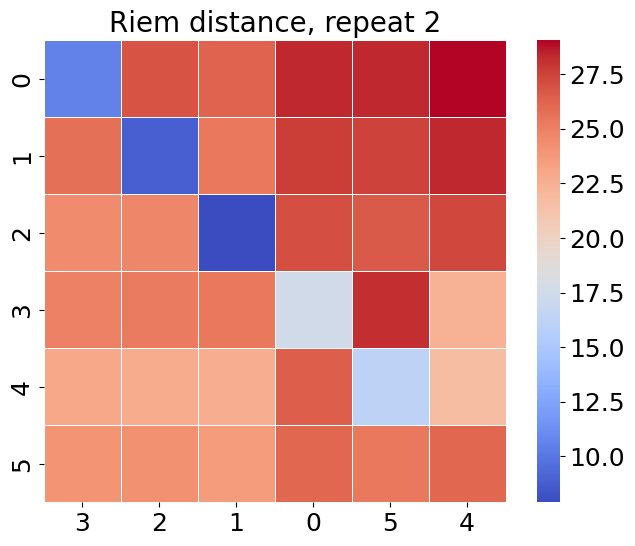

...

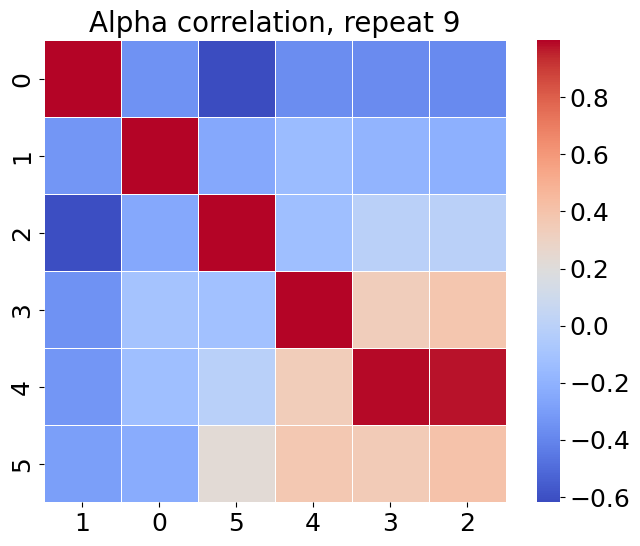

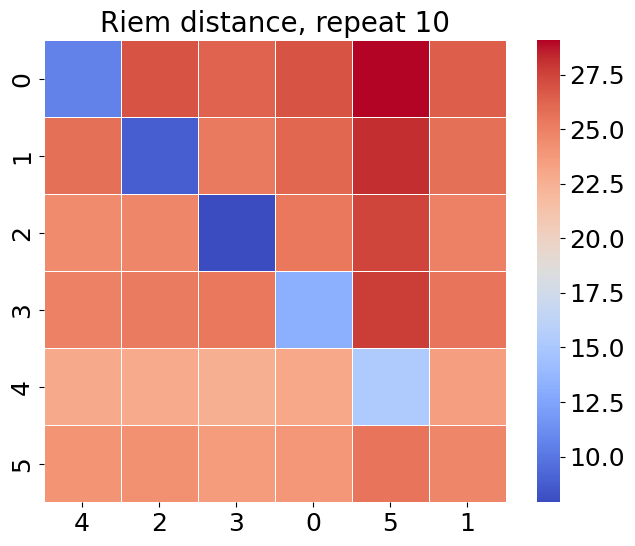

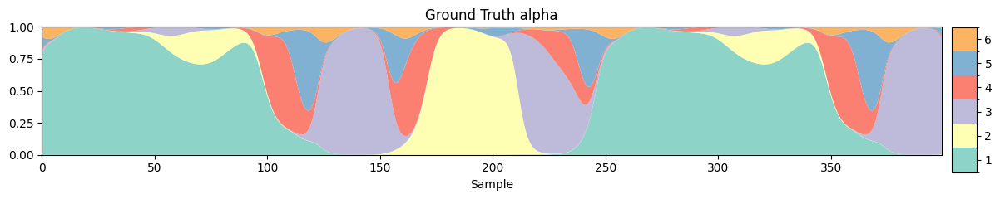

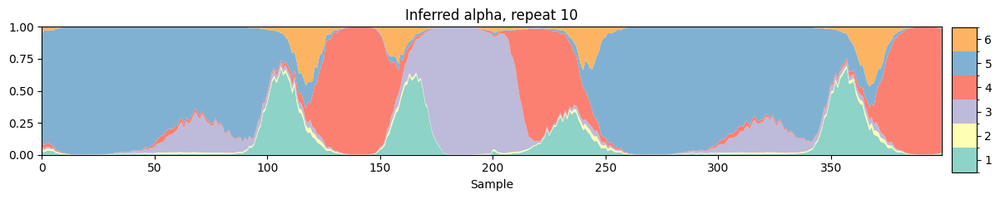

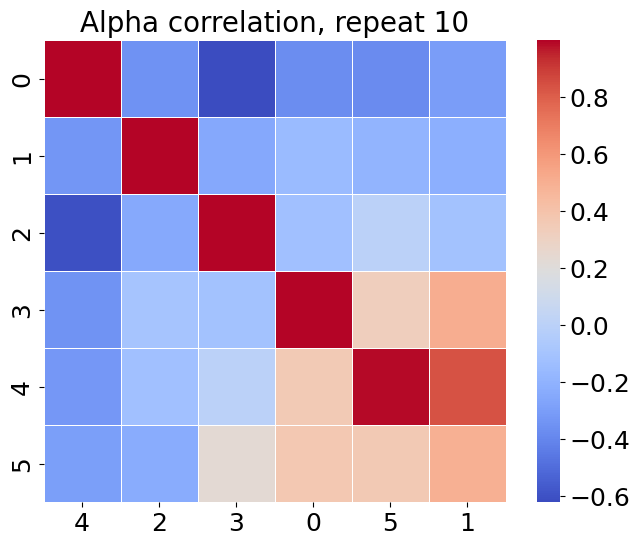

In [45]:
for i in range(10):
    save_dir = f'./results_final/simulation/soft_mixing/dynemo_state_6/repeat_{i+1}/inf_params/'
    with open(f"{save_dir}/alp.pkl", "rb") as f:  # "rb" means read binary mode
        infer_alpha = pickle.load(f)
    infer_cov = np.load(f'{save_dir}/covs.npy')
    riem = twopair_riemannian_distance(ground_truth_cov,infer_cov)
    order, riem_reorder = hungarian_pair(riem,distance=True)
    plot_mode_pairing(riem_reorder,order,title=f'Riem distance, repeat {i+1}')
    plot_alpha(ground_truth_alpha,title='Ground Truth alpha')
    plot_alpha(infer_alpha[0],title=f'Inferred alpha, repeat {i+1}')
    cor = alpha_correlation(ground_truth_alpha,infer_alpha[0],return_diagonal=False)
    order,cor_reorder = hungarian_pair(cor,distance=False)
    plot_mode_pairing(cor_reorder,order,title=f'Alpha correlation, repeat {i+1}')
    

In [1]:
import pickle
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from osl_dynamics.utils.plotting import plot_alpha

/well/win-fmrib-analysis/users/uap971/conda/skylake/envs/osld/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [18]:
data_dir = './data/node_timeseries/simulation_final/dynemo_fair/truth/'
time_course = np.load(f'{data_dir}/10004_mode_time_course.npy')

(<Figure size 1200x250 with 2 Axes>, [<Axes: xlabel='Sample'>])

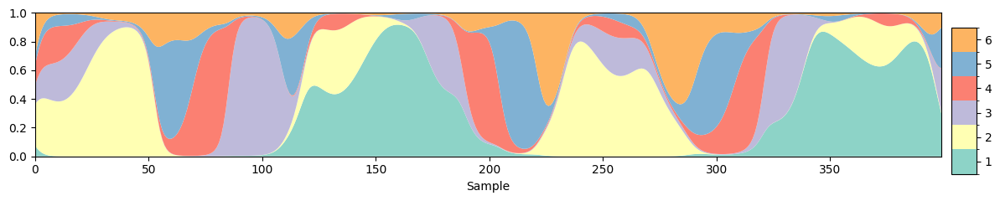

In [19]:
plot_alpha(time_course)